In [1]:
%%javascript
IPython.notebook.kernel.execute(`notebookName = '${IPython.notebook.notebook_name}'`)

<IPython.core.display.Javascript object>

In [2]:
notebookName

'GAN-tfex.ipynb'

In [3]:
# Python ≥3.5 is required
import sys
assert sys.version_info >= (3, 5)

# Scikit-Learn ≥0.20 is required
import sklearn
assert sklearn.__version__ >= "0.20"

# TensorFlow ≥2.0 is required
import tensorflow as tf
from tensorflow import keras
assert tf.__version__ >= "2.0"

# Common imports
import numpy as np
import os

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

import pandas as pd
import time

## Load data

In [4]:
# Mesh size
nl = 10
nc = 10
print('Grid: ', nl, 'x',nc)

Grid:  10 x 10


In [5]:
import joblib
#joblib.dump(pca_compress, "pca_compress_15.pkl") 
#np.savetxt('X_train_1D.csv', X_train_1D, delimiter=',') 
#np.savetxt('X_train_pca.csv', X_train_pca, delimiter=',') 
#np.savetxt('times.csv', times, delimiter=',') 
#with open('groups.txt','w') as f:
#    f.writelines([g + '\n' for g in groups])

#...
pca_compress = joblib.load("pca_compress_15.pkl") 
X_train_compressed = np.loadtxt('X_train_pca.csv', delimiter=',') 

X_train_1D = np.loadtxt('X_train_1D.csv', delimiter=',') 
times  = np.loadtxt('times.csv', delimiter=',') 
with open('groups.txt') as f:
    groups = [g.strip() for g in f.readlines()]

# PCA recovered
X_recovered = pca_compress.inverse_transform(X_train_compressed)

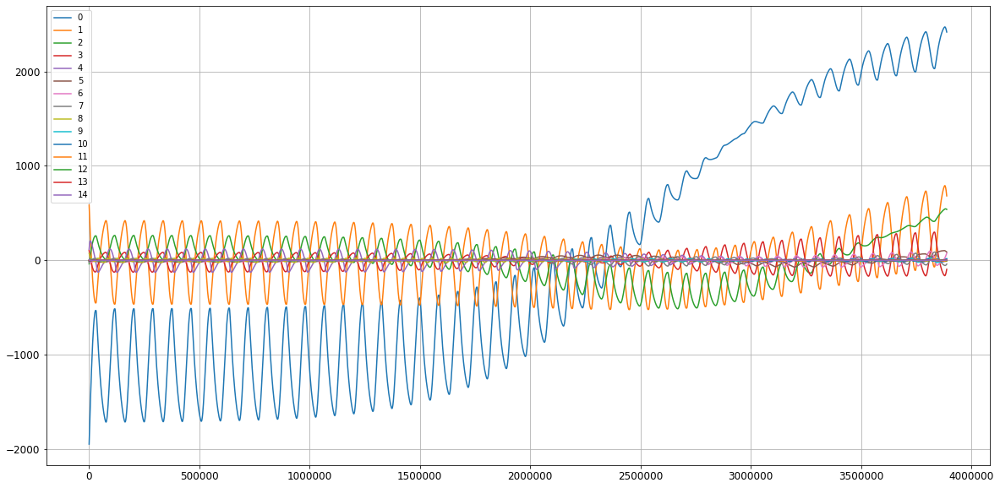

In [6]:
fig, ax = plt.subplots(1,1, figsize=[20,10])
ax.plot(times, X_train_compressed);
ax.grid()
ax.legend(range(15))

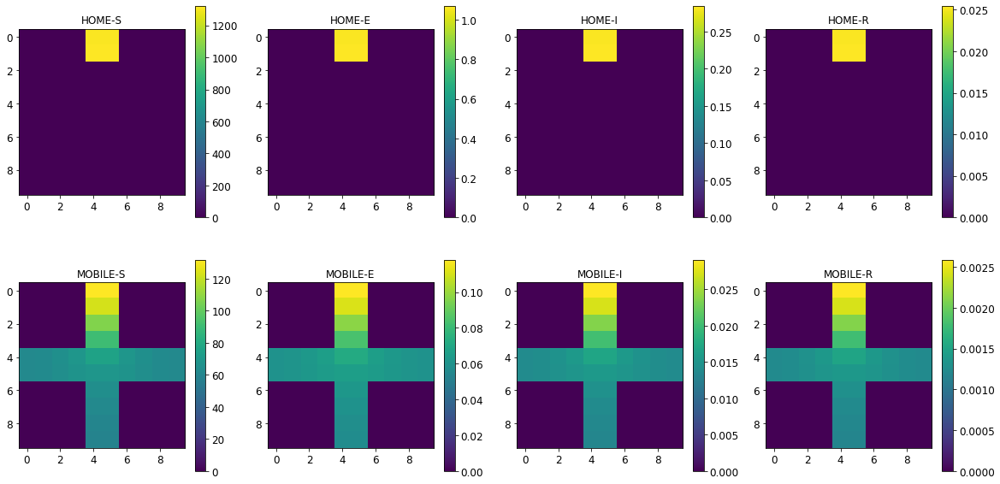

In [7]:
fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    im = ax.flatten()[i].imshow(X_train_1D.reshape(len(times),len(groups),nl,nc)[100,i,:,:])
    fig.colorbar(im, ax=ax.flatten()[i])
    ax.flatten()[i].set_title(group)

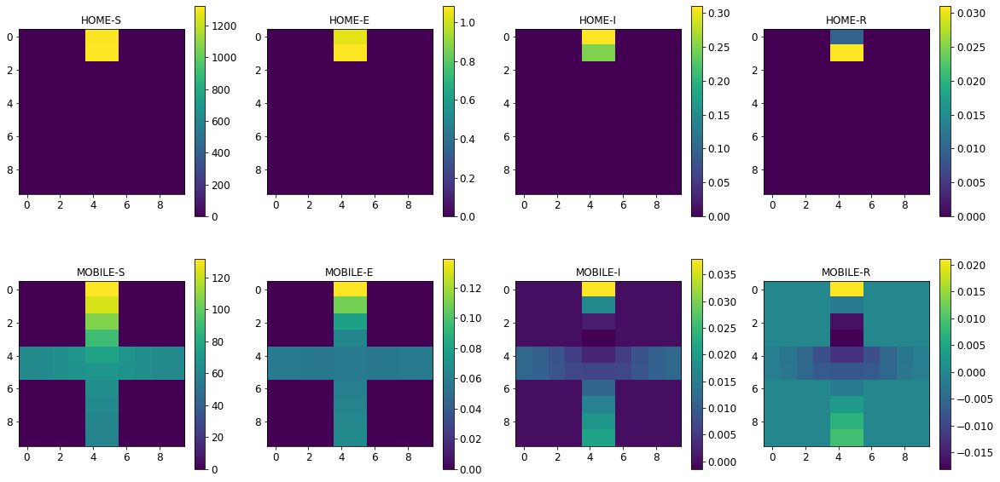

In [8]:
fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    im = ax.flatten()[i].imshow(X_recovered.reshape(len(times),len(groups),nl,nc)[100,i,:,:])
    fig.colorbar(im, ax=ax.flatten()[i])
    ax.flatten()[i].set_title(group)

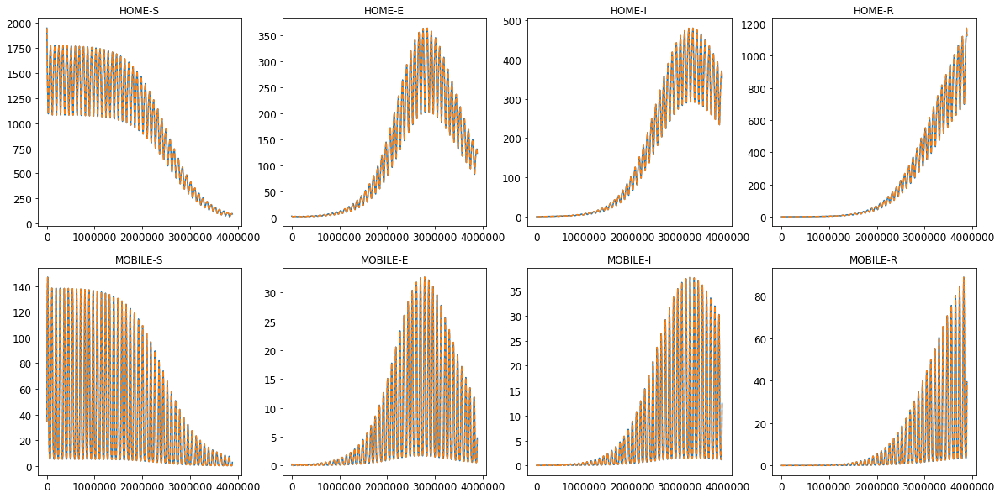

In [9]:
fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    ax.flatten()[i].plot(times, X_train_1D[:,i*nl*nc+4])
    ax.flatten()[i].plot(times, X_recovered[:,i*nl*nc+4],'--')
    ax.flatten()[i].set_title(group)

## Prepare data

In [10]:
codings_size = X_train_compressed.shape[1]
X_train_compressed.shape

(3888, 15)

In [11]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train_compressed)*2 -1
np.allclose(X_train_compressed, scaler.inverse_transform((X_train_scaled+1)/2))

True

In [12]:
def concat_timesteps(X_train, ntimes, step):
    X_train_concat = []
    for i in range(len(X_train) - ntimes*step):
        X_train_concat.append(X_train[i:i+ntimes*step:step])
    return np.array(X_train_concat)

In [13]:
ntimes = 9 # Consecutive times for the GAN
step = 10 # step between times

X_train_concat = concat_timesteps(X_train_scaled, ntimes, step)
X_train_concat_flatten = X_train_concat.reshape(X_train_concat.shape[0], codings_size*ntimes )

(3798, 9, 15)


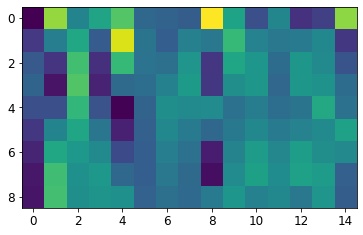

In [14]:
print(X_train_concat.shape)
plt.imshow(X_train_concat[0, :, :])

## Train the GAN

In [15]:
BATCH_SIZE = 256
latent_space = 100

# Create a tensorflow dataset and split it into batches
train_dataset = X_train_concat.reshape(X_train_concat.shape[0], 9, 15, 1).astype('float32')
train_dataset = tf.data.Dataset.from_tensor_slices(train_dataset)
train_dataset = train_dataset.shuffle(len(X_train_concat))
train_dataset = train_dataset.batch(BATCH_SIZE)
for data in train_dataset:
    print(data)
    break

tf.Tensor(
[[[[ 0.54287222]
   [-0.40597166]
   [-0.41630243]
   ...
   [ 0.011323  ]
   [-0.74085683]
   [-0.42086544]]

  [[ 0.53951301]
   [-0.73083624]
   [-0.23319592]
   ...
   [-0.20803256]
   [-0.45834411]
   [-0.34901473]]

  [[ 0.53934479]
   [-0.83558684]
   [-0.16389028]
   ...
   [-0.27172372]
   [ 0.20304858]
   [-0.16956751]]

  ...

  [[ 0.6155273 ]
   [ 0.11942392]
   [-0.60538102]
   ...
   [-0.39858656]
   [ 0.11736545]
   [-0.21297723]]

  [[ 0.62103277]
   [ 0.15253961]
   [-0.58653141]
   ...
   [ 0.16446329]
   [-0.05802259]
   [-0.27977953]]

  [[ 0.6117876 ]
   [-0.10137097]
   [-0.43742801]
   ...
   [ 0.11413307]
   [-0.6930764 ]
   [-0.40938443]]]


 [[[ 0.78845449]
   [ 0.35256636]
   [-0.10455502]
   ...
   [-0.05900947]
   [ 0.05119135]
   [-0.21190886]]

  [[ 0.79967883]
   [ 0.43324635]
   [-0.09331628]
   ...
   [-0.10293482]
   [-0.01513991]
   [-0.28409923]]

  [[ 0.7783713 ]
   [ 0.22122382]
   [-0.01479402]
   ...
   [-0.28832642]
   [-0.48902849]


In [16]:
def make_generator_model():
    model = tf.keras.Sequential()
    model.add(keras.layers.Dense(5*4*256, use_bias=False, input_shape=(latent_space,)))
    model.add(keras.layers.BatchNormalization())
    model.add(keras.layers.LeakyReLU())

    model.add(keras.layers.Reshape((5, 4, 256)))

    model.add(keras.layers.Conv2DTranspose(128, (3, 3), strides=(1, 1), padding='same', use_bias=False))
    model.add(keras.layers.BatchNormalization())
    model.add(keras.layers.LeakyReLU())

    model.add(keras.layers.Conv2DTranspose(64, (3, 3), strides=(1, 2), padding='same', use_bias=False))
    model.add(keras.layers.BatchNormalization())
    model.add(keras.layers.LeakyReLU())

    model.add(keras.layers.Conv2DTranspose(1, (3, 3), strides=(2, 2), padding='same', output_padding=[0,0], use_bias=False, activation='tanh'))

    return model

In [17]:
generator = make_generator_model()
generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 5120)              512000    
_________________________________________________________________
batch_normalization (BatchNo (None, 5120)              20480     
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 5120)              0         
_________________________________________________________________
reshape (Reshape)            (None, 5, 4, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 5, 4, 128)         294912    
_________________________________________________________________
batch_normalization_1 (Batch (None, 5, 4, 128)         512       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 5, 4, 128)         0

(1, 9, 15, 1)


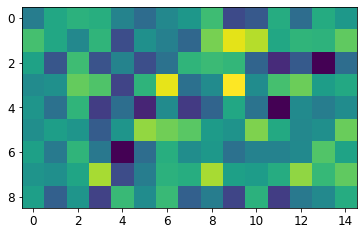

In [24]:
noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)
print(generated_image.shape)
plt.imshow(generated_image[0, :, :, 0])

In [25]:
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(keras.layers.Conv2D(64, (3, 3), strides=(2, 2), padding='same',
                                     input_shape=[9, 15, 1]))
    model.add(keras.layers.LeakyReLU())
    model.add(keras.layers.Dropout(0.3))

    model.add(keras.layers.Conv2D(128, (5, 5), strides=(1, 2), padding='same'))
    model.add(keras.layers.LeakyReLU())
    model.add(keras.layers.Dropout(0.3))

    model.add(keras.layers.Flatten())
    model.add(keras.layers.Dense(1))

    return model

In [26]:
discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 5, 8, 64)          640       
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 5, 8, 64)          0         
_________________________________________________________________
dropout (Dropout)            (None, 5, 8, 64)          0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 5, 4, 128)         204928    
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 5, 4, 128)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 5, 4, 128)         0         
_________________________________________________________________
flatten (Flatten)            (None, 2560)             

In [27]:
decision = discriminator(generated_image)
print (decision)

tf.Tensor([[0.00136952]], shape=(1, 1), dtype=float32)


In [28]:
gan = keras.models.Sequential([generator, discriminator])

In [29]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

generator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)
discriminator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)

In [30]:
# The discriminator and the generator optimizers are different since we will train two networks separately.
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [31]:
# We will reuse this seed overtime 
num_examples_to_generate = 5
seed = tf.random.normal([num_examples_to_generate, latent_space])

In [34]:
# logs to follow losses on tensorboard
#current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
generator_log_dir = './logs/gradient_tape/' + notebookName[:-6] + '/generator'
discriminator_log_dir = './logs/gradient_tape/' + notebookName[:-6] + '/discriminator'

generator_summary_writer = tf.summary.create_file_writer(generator_log_dir)
discriminator_summary_writer = tf.summary.create_file_writer(discriminator_log_dir)

In [35]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(batch):
    noise = tf.random.normal([BATCH_SIZE, latent_space])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        real_output = discriminator(batch, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    generator_mean_loss(gen_loss)
    discriminator_mean_loss(disc_loss)


In [52]:
def train(dataset, epochs):
    hist = []
    for epoch in range(epochs):
        start = time.time()
        print("Epoch {}/{}".format(epoch + 1, epochs))   

        for batch in dataset:
            train_step(batch)
            
        with generator_summary_writer.as_default():
            tf.summary.scalar('loss', generator_mean_loss.result(), step=epoch)

        with discriminator_summary_writer.as_default():
            tf.summary.scalar('loss', discriminator_mean_loss.result(), step=epoch)
        
        hist.append([generator_mean_loss.result().numpy(), discriminator_mean_loss.result().numpy()])

        generator_mean_loss.reset_states()
        discriminator_mean_loss.reset_states()
        
        print("discriminator", "{}: {:.6f}".format(discriminator.metrics_names[0], hist[-1][1]), end=' - ')
        print("generator", "{}: {:.6f}".format(gan.metrics_names[0], hist[-1][0]), end=' - ')    
        print ('{:.0f}s'.format( time.time()-start))

        # Global variables are used below
        if epoch%1000 == 0: 
            # Plot generated data
            X_generated = scaler.inverse_transform((generator.predict(seed).reshape(num_examples_to_generate*ntimes,15)+1)/2)
            X_generated = pca_compress.inverse_transform(X_generated)
            X_generated = X_generated.reshape(num_examples_to_generate, ntimes, len(groups)*nl*nc)
            fig, ax = plt.subplots(num_examples_to_generate*2,len(groups), figsize=[20,num_examples_to_generate*5])
            for j in range(num_examples_to_generate):
                for i, group in enumerate(groups):
                    for k in range(0,10,10): 
                        ax.flatten()[i+2*j*len(groups)].plot(X_generated[j][:,i*nl*nc+4+10*k], '-')
                for i, group in enumerate(groups):
                    im = ax.flatten()[i+(2*j+1)*len(groups)].imshow(X_generated[j].reshape(ntimes,len(groups),nl,nc)[4,i,:,:])
                    fig.colorbar(im, ax=ax.flatten()[i+(2*j+1)*len(groups)])
            plt.show() 
                    
            # Save model
            gan.save('ganmodels/'+notebookName[:-6]+str(epoch)+'.h5')    
            
            # plot loss
            print('Loss: ')
            fig, ax = plt.subplots(1,1, figsize=[20,10])
            ax.plot(hist)
            ax.legend(['loss_gen', 'loss_disc'])
            ax.set_yscale('log')
            ax.grid()
            plt.show()
            
    return hist


Epoch 1/5000
discriminator loss: 1.114884 - generator loss: 0.930616 - 1s


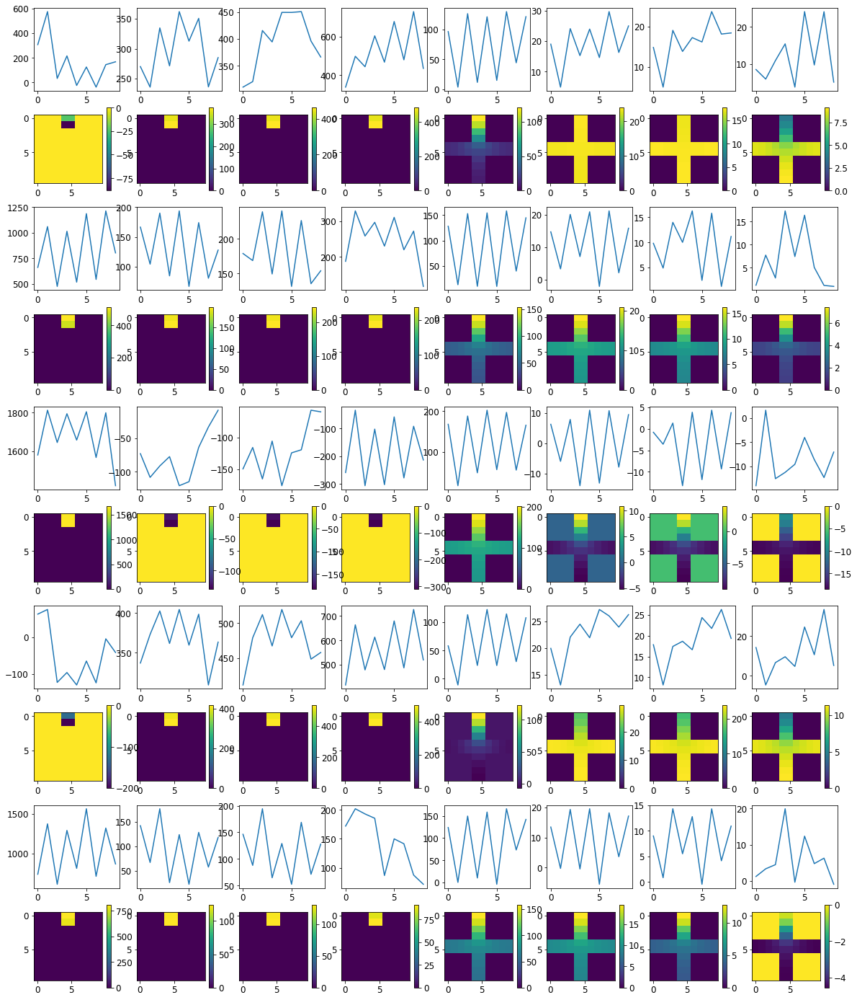

Loss: 


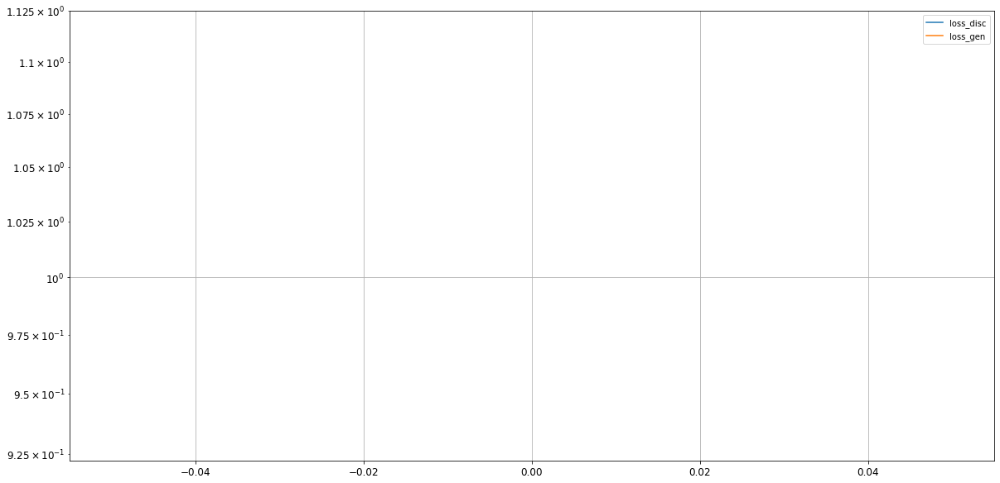

Epoch 2/5000
discriminator loss: 1.376779 - generator loss: 0.705412 - 1s
Epoch 3/5000
discriminator loss: 1.396014 - generator loss: 0.799745 - 1s
Epoch 4/5000
discriminator loss: 1.555467 - generator loss: 0.646406 - 1s
Epoch 5/5000
discriminator loss: 1.721564 - generator loss: 0.453545 - 1s
Epoch 6/5000
discriminator loss: 1.639662 - generator loss: 0.486042 - 1s
Epoch 7/5000
discriminator loss: 1.481149 - generator loss: 0.564022 - 1s
Epoch 8/5000
discriminator loss: 1.427672 - generator loss: 0.567725 - 1s
Epoch 9/5000
discriminator loss: 1.432887 - generator loss: 0.557221 - 1s
Epoch 10/5000
discriminator loss: 1.483215 - generator loss: 0.537461 - 1s
Epoch 11/5000
discriminator loss: 1.533521 - generator loss: 0.532196 - 1s
Epoch 12/5000
discriminator loss: 1.509710 - generator loss: 0.586475 - 1s
Epoch 13/5000
discriminator loss: 1.473238 - generator loss: 0.630313 - 1s
Epoch 14/5000
discriminator loss: 1.447785 - generator loss: 0.634839 - 1s
Epoch 15/5000
discriminator loss:

discriminator loss: 1.100420 - generator loss: 0.871346 - 1s
Epoch 112/5000
discriminator loss: 1.092788 - generator loss: 0.863568 - 1s
Epoch 113/5000
discriminator loss: 1.202884 - generator loss: 0.808417 - 1s
Epoch 114/5000
discriminator loss: 1.170649 - generator loss: 0.934239 - 1s
Epoch 115/5000
discriminator loss: 1.090702 - generator loss: 0.966478 - 1s
Epoch 116/5000
discriminator loss: 1.124929 - generator loss: 0.890152 - 1s
Epoch 117/5000
discriminator loss: 1.203457 - generator loss: 0.799391 - 1s
Epoch 118/5000
discriminator loss: 1.139556 - generator loss: 0.842217 - 1s
Epoch 119/5000
discriminator loss: 1.016314 - generator loss: 0.957902 - 1s
Epoch 120/5000
discriminator loss: 1.082322 - generator loss: 0.872984 - 1s
Epoch 121/5000
discriminator loss: 1.169902 - generator loss: 0.851249 - 1s
Epoch 122/5000
discriminator loss: 1.046690 - generator loss: 1.073451 - 1s
Epoch 123/5000
discriminator loss: 0.914941 - generator loss: 1.119295 - 1s
Epoch 124/5000
discriminato

discriminator loss: 1.027809 - generator loss: 1.067832 - 1s
Epoch 220/5000
discriminator loss: 0.994868 - generator loss: 1.125272 - 1s
Epoch 221/5000
discriminator loss: 1.016816 - generator loss: 1.080621 - 1s
Epoch 222/5000
discriminator loss: 1.022321 - generator loss: 1.048879 - 1s
Epoch 223/5000
discriminator loss: 0.978754 - generator loss: 1.055242 - 1s
Epoch 224/5000
discriminator loss: 0.978405 - generator loss: 1.068608 - 1s
Epoch 225/5000
discriminator loss: 1.022313 - generator loss: 1.063259 - 1s
Epoch 226/5000
discriminator loss: 1.038081 - generator loss: 1.069624 - 1s
Epoch 227/5000
discriminator loss: 1.008013 - generator loss: 1.106078 - 1s
Epoch 228/5000
discriminator loss: 0.997214 - generator loss: 1.099049 - 1s
Epoch 229/5000
discriminator loss: 1.020890 - generator loss: 1.060810 - 1s
Epoch 230/5000
discriminator loss: 0.976388 - generator loss: 1.131115 - 1s
Epoch 231/5000
discriminator loss: 0.979035 - generator loss: 1.113031 - 1s
Epoch 232/5000
discriminato

discriminator loss: 0.982405 - generator loss: 1.138311 - 1s
Epoch 328/5000
discriminator loss: 0.996155 - generator loss: 1.137691 - 1s
Epoch 329/5000
discriminator loss: 1.014483 - generator loss: 1.138445 - 1s
Epoch 330/5000
discriminator loss: 0.978634 - generator loss: 1.164197 - 1s
Epoch 331/5000
discriminator loss: 0.995615 - generator loss: 1.141584 - 1s
Epoch 332/5000
discriminator loss: 1.001019 - generator loss: 1.125648 - 1s
Epoch 333/5000
discriminator loss: 0.986641 - generator loss: 1.124485 - 1s
Epoch 334/5000
discriminator loss: 0.999352 - generator loss: 1.140593 - 1s
Epoch 335/5000
discriminator loss: 1.002700 - generator loss: 1.134912 - 1s
Epoch 336/5000
discriminator loss: 0.990629 - generator loss: 1.119904 - 1s
Epoch 337/5000
discriminator loss: 0.996401 - generator loss: 1.138186 - 1s
Epoch 338/5000
discriminator loss: 0.980961 - generator loss: 1.150991 - 1s
Epoch 339/5000
discriminator loss: 0.978526 - generator loss: 1.141398 - 1s
Epoch 340/5000
discriminato

discriminator loss: 1.066324 - generator loss: 1.070016 - 1s
Epoch 436/5000
discriminator loss: 1.067663 - generator loss: 1.094809 - 1s
Epoch 437/5000
discriminator loss: 1.045553 - generator loss: 1.095330 - 1s
Epoch 438/5000
discriminator loss: 1.070623 - generator loss: 1.072824 - 1s
Epoch 439/5000
discriminator loss: 1.075778 - generator loss: 1.107866 - 1s
Epoch 440/5000
discriminator loss: 1.070393 - generator loss: 1.067438 - 1s
Epoch 441/5000
discriminator loss: 1.079961 - generator loss: 1.073844 - 1s
Epoch 442/5000
discriminator loss: 1.063126 - generator loss: 1.079378 - 1s
Epoch 443/5000
discriminator loss: 1.065015 - generator loss: 1.068535 - 1s
Epoch 444/5000
discriminator loss: 1.086286 - generator loss: 1.064750 - 1s
Epoch 445/5000
discriminator loss: 1.080773 - generator loss: 1.072369 - 1s
Epoch 446/5000
discriminator loss: 1.074175 - generator loss: 1.057448 - 1s
Epoch 447/5000
discriminator loss: 1.075729 - generator loss: 1.064797 - 1s
Epoch 448/5000
discriminato

discriminator loss: 1.172327 - generator loss: 0.986238 - 1s
Epoch 544/5000
discriminator loss: 1.219961 - generator loss: 0.930924 - 1s
Epoch 545/5000
discriminator loss: 1.189226 - generator loss: 0.948394 - 1s
Epoch 546/5000
discriminator loss: 1.184268 - generator loss: 0.965020 - 1s
Epoch 547/5000
discriminator loss: 1.229437 - generator loss: 0.938185 - 1s
Epoch 548/5000
discriminator loss: 1.205235 - generator loss: 0.958601 - 1s
Epoch 549/5000
discriminator loss: 1.160898 - generator loss: 0.998315 - 1s
Epoch 550/5000
discriminator loss: 1.217310 - generator loss: 0.929104 - 1s
Epoch 551/5000
discriminator loss: 1.223288 - generator loss: 0.920224 - 1s
Epoch 552/5000
discriminator loss: 1.171161 - generator loss: 0.967724 - 1s
Epoch 553/5000
discriminator loss: 1.208613 - generator loss: 0.938352 - 1s
Epoch 554/5000
discriminator loss: 1.219519 - generator loss: 0.945130 - 1s
Epoch 555/5000
discriminator loss: 1.161704 - generator loss: 0.992534 - 1s
Epoch 556/5000
discriminato

discriminator loss: 1.203532 - generator loss: 0.913471 - 1s
Epoch 652/5000
discriminator loss: 1.244365 - generator loss: 0.889858 - 1s
Epoch 653/5000
discriminator loss: 1.270883 - generator loss: 0.881765 - 1s
Epoch 654/5000
discriminator loss: 1.208632 - generator loss: 0.933832 - 1s
Epoch 655/5000
discriminator loss: 1.236428 - generator loss: 0.884766 - 1s
Epoch 656/5000
discriminator loss: 1.268610 - generator loss: 0.866669 - 1s
Epoch 657/5000
discriminator loss: 1.201939 - generator loss: 0.912256 - 1s
Epoch 658/5000
discriminator loss: 1.243185 - generator loss: 0.891795 - 1s
Epoch 659/5000
discriminator loss: 1.267621 - generator loss: 0.875270 - 1s
Epoch 660/5000
discriminator loss: 1.207772 - generator loss: 0.936678 - 1s
Epoch 661/5000
discriminator loss: 1.240552 - generator loss: 0.885259 - 1s
Epoch 662/5000
discriminator loss: 1.267569 - generator loss: 0.850435 - 1s
Epoch 663/5000
discriminator loss: 1.205378 - generator loss: 0.914589 - 1s
Epoch 664/5000
discriminato

discriminator loss: 1.294605 - generator loss: 0.829855 - 1s
Epoch 760/5000
discriminator loss: 1.231147 - generator loss: 0.873150 - 1s
Epoch 761/5000
discriminator loss: 1.244458 - generator loss: 0.860534 - 1s
Epoch 762/5000
discriminator loss: 1.297922 - generator loss: 0.851098 - 1s
Epoch 763/5000
discriminator loss: 1.223640 - generator loss: 0.915356 - 1s
Epoch 764/5000
discriminator loss: 1.244274 - generator loss: 0.884355 - 1s
Epoch 765/5000
discriminator loss: 1.299806 - generator loss: 0.823215 - 1s
Epoch 766/5000
discriminator loss: 1.229392 - generator loss: 0.871701 - 1s
Epoch 767/5000
discriminator loss: 1.250172 - generator loss: 0.874956 - 1s
Epoch 768/5000
discriminator loss: 1.299097 - generator loss: 0.849930 - 1s
Epoch 769/5000
discriminator loss: 1.229554 - generator loss: 0.910069 - 1s
Epoch 770/5000
discriminator loss: 1.255281 - generator loss: 0.883325 - 1s
Epoch 771/5000
discriminator loss: 1.286250 - generator loss: 0.828354 - 1s
Epoch 772/5000
discriminato

discriminator loss: 1.260574 - generator loss: 0.841975 - 1s
Epoch 868/5000
discriminator loss: 1.237817 - generator loss: 0.852582 - 1s
Epoch 869/5000
discriminator loss: 1.307398 - generator loss: 0.830229 - 1s
Epoch 870/5000
discriminator loss: 1.254485 - generator loss: 0.878591 - 1s
Epoch 871/5000
discriminator loss: 1.239177 - generator loss: 0.877005 - 1s
Epoch 872/5000
discriminator loss: 1.312129 - generator loss: 0.798931 - 1s
Epoch 873/5000
discriminator loss: 1.253875 - generator loss: 0.839570 - 1s
Epoch 874/5000
discriminator loss: 1.258078 - generator loss: 0.855990 - 1s
Epoch 875/5000
discriminator loss: 1.312533 - generator loss: 0.827994 - 1s
Epoch 876/5000
discriminator loss: 1.238080 - generator loss: 0.895685 - 1s
Epoch 877/5000
discriminator loss: 1.255329 - generator loss: 0.860097 - 1s
Epoch 878/5000
discriminator loss: 1.316020 - generator loss: 0.798121 - 1s
Epoch 879/5000
discriminator loss: 1.237245 - generator loss: 0.854420 - 1s
Epoch 880/5000
discriminato

discriminator loss: 1.262476 - generator loss: 0.876884 - 1s
Epoch 976/5000
discriminator loss: 1.258788 - generator loss: 0.858885 - 1s
Epoch 977/5000
discriminator loss: 1.315362 - generator loss: 0.788646 - 1s
Epoch 978/5000
discriminator loss: 1.250157 - generator loss: 0.853216 - 1s
Epoch 979/5000
discriminator loss: 1.272498 - generator loss: 0.839974 - 1s
Epoch 980/5000
discriminator loss: 1.304671 - generator loss: 0.827771 - 1s
Epoch 981/5000
discriminator loss: 1.239647 - generator loss: 0.871584 - 1s
Epoch 982/5000
discriminator loss: 1.275652 - generator loss: 0.842942 - 1s
Epoch 983/5000
discriminator loss: 1.304255 - generator loss: 0.801675 - 1s
Epoch 984/5000
discriminator loss: 1.241579 - generator loss: 0.846423 - 1s
Epoch 985/5000
discriminator loss: 1.292873 - generator loss: 0.830197 - 1s
Epoch 986/5000
discriminator loss: 1.286764 - generator loss: 0.850320 - 1s
Epoch 987/5000
discriminator loss: 1.243269 - generator loss: 0.868708 - 1s
Epoch 988/5000
discriminato

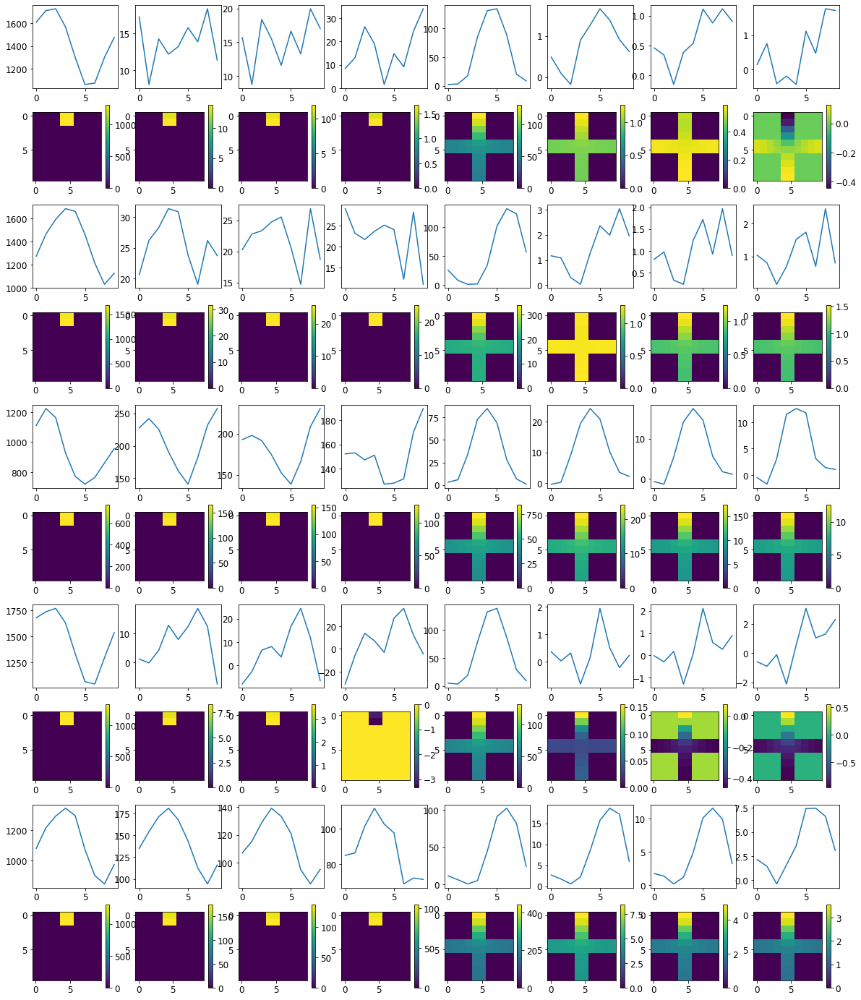

Loss: 


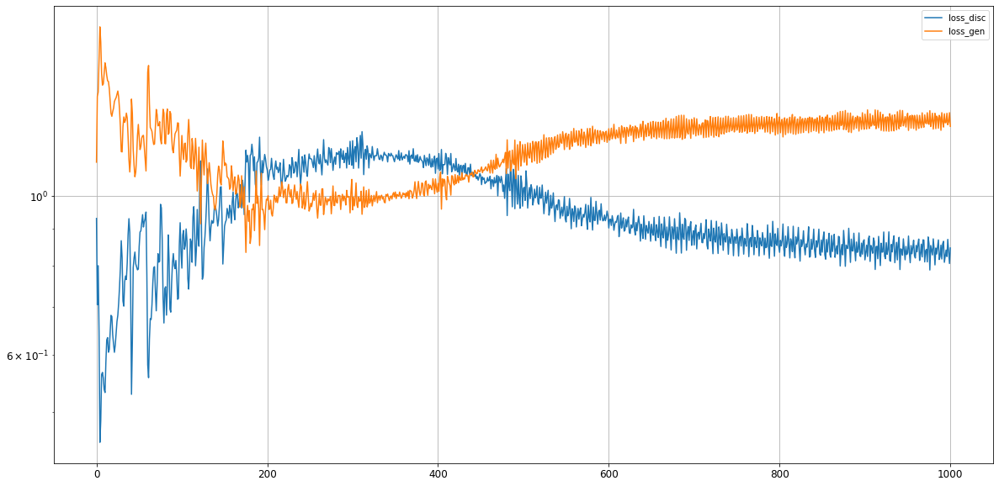

Epoch 1002/5000
discriminator loss: 1.281484 - generator loss: 0.828055 - 1s
Epoch 1003/5000
discriminator loss: 1.298742 - generator loss: 0.823410 - 1s
Epoch 1004/5000
discriminator loss: 1.240589 - generator loss: 0.891190 - 1s
Epoch 1005/5000
discriminator loss: 1.289909 - generator loss: 0.820509 - 1s
Epoch 1006/5000
discriminator loss: 1.291870 - generator loss: 0.806670 - 1s
Epoch 1007/5000
discriminator loss: 1.234107 - generator loss: 0.864115 - 1s
Epoch 1008/5000
discriminator loss: 1.302707 - generator loss: 0.824043 - 1s
Epoch 1009/5000
discriminator loss: 1.289157 - generator loss: 0.839467 - 1s
Epoch 1010/5000
discriminator loss: 1.241285 - generator loss: 0.869411 - 1s
Epoch 1011/5000
discriminator loss: 1.315145 - generator loss: 0.805495 - 1s
Epoch 1012/5000
discriminator loss: 1.268832 - generator loss: 0.823547 - 1s
Epoch 1013/5000
discriminator loss: 1.245603 - generator loss: 0.832806 - 1s
Epoch 1014/5000
discriminator loss: 1.315371 - generator loss: 0.830949 - 1s

discriminator loss: 1.256031 - generator loss: 0.837973 - 1s
Epoch 1110/5000
discriminator loss: 1.295322 - generator loss: 0.823177 - 1s
Epoch 1111/5000
discriminator loss: 1.290624 - generator loss: 0.833230 - 1s
Epoch 1112/5000
discriminator loss: 1.256294 - generator loss: 0.862481 - 1s
Epoch 1113/5000
discriminator loss: 1.296139 - generator loss: 0.811161 - 1s
Epoch 1114/5000
discriminator loss: 1.288610 - generator loss: 0.807959 - 1s
Epoch 1115/5000
discriminator loss: 1.261050 - generator loss: 0.847295 - 1s
Epoch 1116/5000
discriminator loss: 1.309683 - generator loss: 0.809160 - 1s
Epoch 1117/5000
discriminator loss: 1.278622 - generator loss: 0.840723 - 1s
Epoch 1118/5000
discriminator loss: 1.264839 - generator loss: 0.848657 - 1s
Epoch 1119/5000
discriminator loss: 1.313301 - generator loss: 0.786080 - 1s
Epoch 1120/5000
discriminator loss: 1.264508 - generator loss: 0.826742 - 1s
Epoch 1121/5000
discriminator loss: 1.285346 - generator loss: 0.831508 - 1s
Epoch 1122/5000

discriminator loss: 1.319750 - generator loss: 0.803070 - 1s
Epoch 1217/5000
discriminator loss: 1.268917 - generator loss: 0.842506 - 1s
Epoch 1218/5000
discriminator loss: 1.299701 - generator loss: 0.824678 - 1s
Epoch 1219/5000
discriminator loss: 1.326764 - generator loss: 0.782837 - 1s
Epoch 1220/5000
discriminator loss: 1.261341 - generator loss: 0.822782 - 1s
Epoch 1221/5000
discriminator loss: 1.306935 - generator loss: 0.809772 - 1s
Epoch 1222/5000
discriminator loss: 1.300923 - generator loss: 0.827605 - 1s
Epoch 1223/5000
discriminator loss: 1.259255 - generator loss: 0.849141 - 1s
Epoch 1224/5000
discriminator loss: 1.326310 - generator loss: 0.780203 - 1s
Epoch 1225/5000
discriminator loss: 1.294718 - generator loss: 0.823643 - 1s
Epoch 1226/5000
discriminator loss: 1.271273 - generator loss: 0.827277 - 1s
Epoch 1227/5000
discriminator loss: 1.325885 - generator loss: 0.793456 - 1s
Epoch 1228/5000
discriminator loss: 1.262636 - generator loss: 0.852008 - 1s
Epoch 1229/5000

discriminator loss: 1.283735 - generator loss: 0.823430 - 1s
Epoch 1324/5000
discriminator loss: 1.302818 - generator loss: 0.817019 - 1s
Epoch 1325/5000
discriminator loss: 1.302284 - generator loss: 0.808356 - 1s
Epoch 1326/5000
discriminator loss: 1.275599 - generator loss: 0.823421 - 1s
Epoch 1327/5000
discriminator loss: 1.314221 - generator loss: 0.802778 - 1s
Epoch 1328/5000
discriminator loss: 1.281410 - generator loss: 0.822444 - 1s
Epoch 1329/5000
discriminator loss: 1.295234 - generator loss: 0.802803 - 1s
Epoch 1330/5000
discriminator loss: 1.310012 - generator loss: 0.809252 - 1s
Epoch 1331/5000
discriminator loss: 1.284896 - generator loss: 0.837645 - 1s
Epoch 1332/5000
discriminator loss: 1.311867 - generator loss: 0.787592 - 1s
Epoch 1333/5000
discriminator loss: 1.314776 - generator loss: 0.796779 - 1s
Epoch 1334/5000
discriminator loss: 1.281790 - generator loss: 0.830983 - 1s
Epoch 1335/5000
discriminator loss: 1.312143 - generator loss: 0.805570 - 1s
Epoch 1336/5000

discriminator loss: 1.330720 - generator loss: 0.790041 - 1s
Epoch 1431/5000
discriminator loss: 1.278764 - generator loss: 0.844264 - 1s
Epoch 1432/5000
discriminator loss: 1.310377 - generator loss: 0.794211 - 1s
Epoch 1433/5000
discriminator loss: 1.312199 - generator loss: 0.793158 - 1s
Epoch 1434/5000
discriminator loss: 1.284368 - generator loss: 0.823618 - 1s
Epoch 1435/5000
discriminator loss: 1.325207 - generator loss: 0.796158 - 1s
Epoch 1436/5000
discriminator loss: 1.287684 - generator loss: 0.816987 - 1s
Epoch 1437/5000
discriminator loss: 1.313725 - generator loss: 0.800844 - 1s
Epoch 1438/5000
discriminator loss: 1.310816 - generator loss: 0.796743 - 1s
Epoch 1439/5000
discriminator loss: 1.281967 - generator loss: 0.821534 - 1s
Epoch 1440/5000
discriminator loss: 1.320955 - generator loss: 0.784454 - 1s
Epoch 1441/5000
discriminator loss: 1.298948 - generator loss: 0.831347 - 1s
Epoch 1442/5000
discriminator loss: 1.293291 - generator loss: 0.810356 - 1s
Epoch 1443/5000

discriminator loss: 1.321310 - generator loss: 0.806838 - 1s
Epoch 1538/5000
discriminator loss: 1.307719 - generator loss: 0.813021 - 1s
Epoch 1539/5000
discriminator loss: 1.298657 - generator loss: 0.798046 - 1s
Epoch 1540/5000
discriminator loss: 1.326899 - generator loss: 0.784112 - 1s
Epoch 1541/5000
discriminator loss: 1.294197 - generator loss: 0.806788 - 1s
Epoch 1542/5000
discriminator loss: 1.325119 - generator loss: 0.787545 - 1s
Epoch 1543/5000
discriminator loss: 1.316850 - generator loss: 0.822345 - 1s
Epoch 1544/5000
discriminator loss: 1.293094 - generator loss: 0.816543 - 1s
Epoch 1545/5000
discriminator loss: 1.329886 - generator loss: 0.771105 - 1s
Epoch 1546/5000
discriminator loss: 1.288984 - generator loss: 0.834776 - 1s
Epoch 1547/5000
discriminator loss: 1.326832 - generator loss: 0.797605 - 1s
Epoch 1548/5000
discriminator loss: 1.312691 - generator loss: 0.793724 - 1s
Epoch 1549/5000
discriminator loss: 1.304695 - generator loss: 0.802818 - 1s
Epoch 1550/5000

discriminator loss: 1.338487 - generator loss: 0.766442 - 1s
Epoch 1645/5000
discriminator loss: 1.301973 - generator loss: 0.807190 - 1s
Epoch 1646/5000
discriminator loss: 1.328082 - generator loss: 0.794078 - 1s
Epoch 1647/5000
discriminator loss: 1.304711 - generator loss: 0.811504 - 1s
Epoch 1648/5000
discriminator loss: 1.314964 - generator loss: 0.786252 - 1s
Epoch 1649/5000
discriminator loss: 1.328357 - generator loss: 0.778730 - 1s
Epoch 1650/5000
discriminator loss: 1.306112 - generator loss: 0.809355 - 1s
Epoch 1651/5000
discriminator loss: 1.350893 - generator loss: 0.786669 - 1s
Epoch 1652/5000
discriminator loss: 1.292248 - generator loss: 0.825644 - 1s
Epoch 1653/5000
discriminator loss: 1.329824 - generator loss: 0.772907 - 1s
Epoch 1654/5000
discriminator loss: 1.328596 - generator loss: 0.770791 - 1s
Epoch 1655/5000
discriminator loss: 1.299034 - generator loss: 0.811729 - 1s
Epoch 1656/5000
discriminator loss: 1.346489 - generator loss: 0.785364 - 1s
Epoch 1657/5000

discriminator loss: 1.305155 - generator loss: 0.792375 - 1s
Epoch 1752/5000
discriminator loss: 1.319696 - generator loss: 0.796245 - 1s
Epoch 1753/5000
discriminator loss: 1.328590 - generator loss: 0.802852 - 1s
Epoch 1754/5000
discriminator loss: 1.290055 - generator loss: 0.816218 - 1s
Epoch 1755/5000
discriminator loss: 1.338742 - generator loss: 0.757717 - 1s
Epoch 1756/5000
discriminator loss: 1.308800 - generator loss: 0.791287 - 1s
Epoch 1757/5000
discriminator loss: 1.330379 - generator loss: 0.785914 - 1s
Epoch 1758/5000
discriminator loss: 1.331463 - generator loss: 0.798464 - 1s
Epoch 1759/5000
discriminator loss: 1.292412 - generator loss: 0.823802 - 1s
Epoch 1760/5000
discriminator loss: 1.342393 - generator loss: 0.760451 - 1s
Epoch 1761/5000
discriminator loss: 1.306556 - generator loss: 0.784643 - 1s
Epoch 1762/5000
discriminator loss: 1.308700 - generator loss: 0.795958 - 1s
Epoch 1763/5000
discriminator loss: 1.355013 - generator loss: 0.793794 - 1s
Epoch 1764/5000

discriminator loss: 1.347181 - generator loss: 0.755868 - 1s
Epoch 1859/5000
discriminator loss: 1.296918 - generator loss: 0.802372 - 1s
Epoch 1860/5000
discriminator loss: 1.346243 - generator loss: 0.780666 - 1s
Epoch 1861/5000
discriminator loss: 1.309520 - generator loss: 0.812813 - 1s
Epoch 1862/5000
discriminator loss: 1.331486 - generator loss: 0.785398 - 1s
Epoch 1863/5000
discriminator loss: 1.330426 - generator loss: 0.760934 - 1s
Epoch 1864/5000
discriminator loss: 1.294787 - generator loss: 0.800750 - 1s
Epoch 1865/5000
discriminator loss: 1.358469 - generator loss: 0.775307 - 1s
Epoch 1866/5000
discriminator loss: 1.308164 - generator loss: 0.816063 - 1s
Epoch 1867/5000
discriminator loss: 1.302806 - generator loss: 0.794411 - 1s
Epoch 1868/5000
discriminator loss: 1.344757 - generator loss: 0.748833 - 1s
Epoch 1869/5000
discriminator loss: 1.292157 - generator loss: 0.813897 - 1s
Epoch 1870/5000
discriminator loss: 1.349060 - generator loss: 0.773962 - 1s
Epoch 1871/5000

discriminator loss: 1.306322 - generator loss: 0.811045 - 1s
Epoch 1966/5000
discriminator loss: 1.337687 - generator loss: 0.771414 - 1s
Epoch 1967/5000
discriminator loss: 1.337956 - generator loss: 0.762515 - 1s
Epoch 1968/5000
discriminator loss: 1.311529 - generator loss: 0.787130 - 1s
Epoch 1969/5000
discriminator loss: 1.349392 - generator loss: 0.777104 - 1s
Epoch 1970/5000
discriminator loss: 1.308236 - generator loss: 0.819524 - 1s
Epoch 1971/5000
discriminator loss: 1.329408 - generator loss: 0.778288 - 1s
Epoch 1972/5000
discriminator loss: 1.347703 - generator loss: 0.744461 - 1s
Epoch 1973/5000
discriminator loss: 1.305302 - generator loss: 0.797680 - 1s
Epoch 1974/5000
discriminator loss: 1.349256 - generator loss: 0.771181 - 1s
Epoch 1975/5000
discriminator loss: 1.325294 - generator loss: 0.803340 - 1s
Epoch 1976/5000
discriminator loss: 1.310953 - generator loss: 0.793947 - 1s
Epoch 1977/5000
discriminator loss: 1.341405 - generator loss: 0.753425 - 1s
Epoch 1978/5000

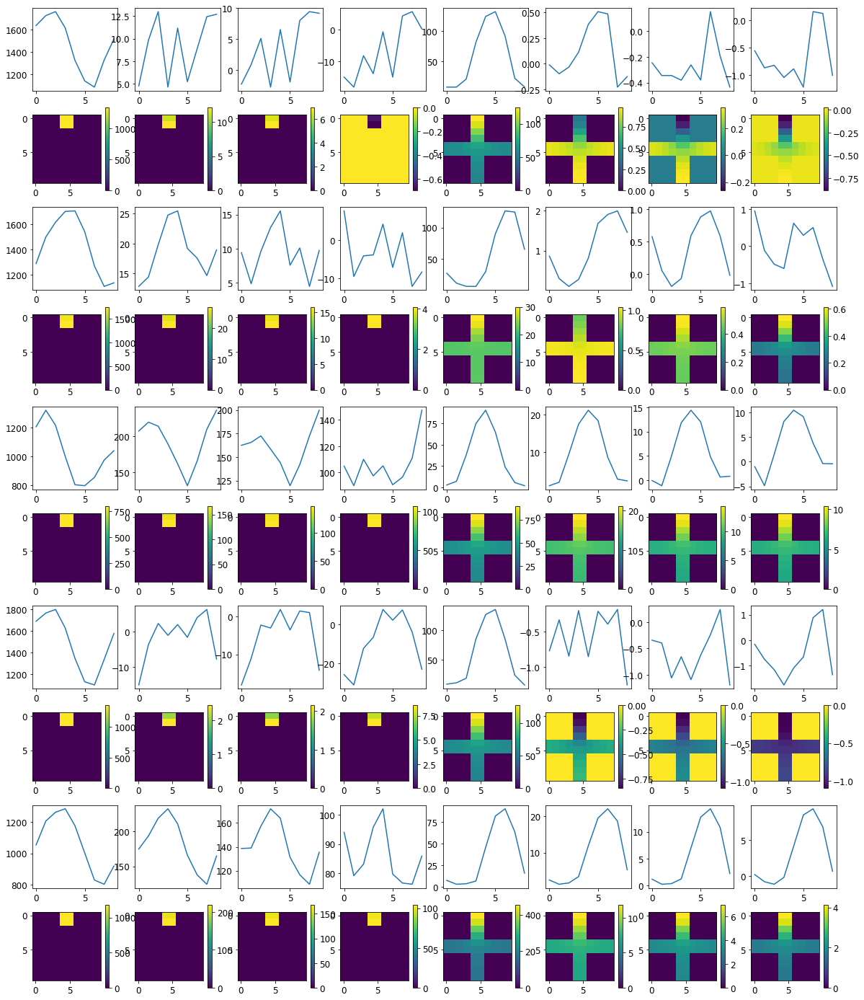

Loss: 


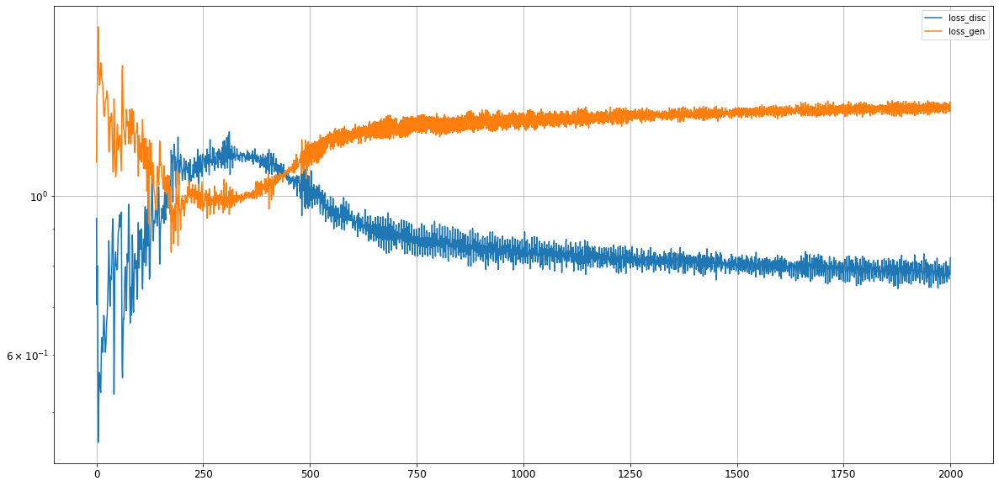

Epoch 2002/5000
discriminator loss: 1.329270 - generator loss: 0.771195 - 1s
Epoch 2003/5000
discriminator loss: 1.351480 - generator loss: 0.761143 - 1s
Epoch 2004/5000
discriminator loss: 1.304016 - generator loss: 0.792110 - 1s
Epoch 2005/5000
discriminator loss: 1.350029 - generator loss: 0.771887 - 1s
Epoch 2006/5000
discriminator loss: 1.309601 - generator loss: 0.807607 - 1s
Epoch 2007/5000
discriminator loss: 1.326606 - generator loss: 0.784629 - 1s
Epoch 2008/5000
discriminator loss: 1.337814 - generator loss: 0.757542 - 1s
Epoch 2009/5000
discriminator loss: 1.307276 - generator loss: 0.795049 - 1s
Epoch 2010/5000
discriminator loss: 1.346078 - generator loss: 0.777929 - 1s
Epoch 2011/5000
discriminator loss: 1.314435 - generator loss: 0.814147 - 1s
Epoch 2012/5000
discriminator loss: 1.324647 - generator loss: 0.780659 - 1s
Epoch 2013/5000
discriminator loss: 1.337912 - generator loss: 0.752713 - 1s
Epoch 2014/5000
discriminator loss: 1.308201 - generator loss: 0.800217 - 1s

discriminator loss: 1.349797 - generator loss: 0.775474 - 1s
Epoch 2110/5000
discriminator loss: 1.328964 - generator loss: 0.796882 - 1s
Epoch 2111/5000
discriminator loss: 1.317847 - generator loss: 0.782476 - 1s
Epoch 2112/5000
discriminator loss: 1.353758 - generator loss: 0.748229 - 1s
Epoch 2113/5000
discriminator loss: 1.310317 - generator loss: 0.792690 - 1s
Epoch 2114/5000
discriminator loss: 1.346148 - generator loss: 0.769298 - 1s
Epoch 2115/5000
discriminator loss: 1.338308 - generator loss: 0.783585 - 1s
Epoch 2116/5000
discriminator loss: 1.331015 - generator loss: 0.790188 - 1s
Epoch 2117/5000
discriminator loss: 1.346642 - generator loss: 0.747833 - 1s
Epoch 2118/5000
discriminator loss: 1.315751 - generator loss: 0.785943 - 1s
Epoch 2119/5000
discriminator loss: 1.340830 - generator loss: 0.774110 - 1s
Epoch 2120/5000
discriminator loss: 1.333024 - generator loss: 0.791546 - 1s
Epoch 2121/5000
discriminator loss: 1.320056 - generator loss: 0.797969 - 1s
Epoch 2122/5000

discriminator loss: 1.339046 - generator loss: 0.759277 - 1s
Epoch 2217/5000
discriminator loss: 1.349186 - generator loss: 0.756693 - 1s
Epoch 2218/5000
discriminator loss: 1.316933 - generator loss: 0.779873 - 1s
Epoch 2219/5000
discriminator loss: 1.361482 - generator loss: 0.767332 - 1s
Epoch 2220/5000
discriminator loss: 1.325054 - generator loss: 0.808394 - 1s
Epoch 2221/5000
discriminator loss: 1.326293 - generator loss: 0.786190 - 1s
Epoch 2222/5000
discriminator loss: 1.359129 - generator loss: 0.740821 - 1s
Epoch 2223/5000
discriminator loss: 1.307660 - generator loss: 0.791697 - 1s
Epoch 2224/5000
discriminator loss: 1.348121 - generator loss: 0.772572 - 1s
Epoch 2225/5000
discriminator loss: 1.331066 - generator loss: 0.788835 - 1s
Epoch 2226/5000
discriminator loss: 1.315267 - generator loss: 0.801171 - 1s
Epoch 2227/5000
discriminator loss: 1.356169 - generator loss: 0.739404 - 1s
Epoch 2228/5000
discriminator loss: 1.316301 - generator loss: 0.780870 - 1s
Epoch 2229/5000

discriminator loss: 1.341444 - generator loss: 0.753252 - 1s
Epoch 2324/5000
discriminator loss: 1.318874 - generator loss: 0.777173 - 1s
Epoch 2325/5000
discriminator loss: 1.345634 - generator loss: 0.768568 - 1s
Epoch 2326/5000
discriminator loss: 1.331720 - generator loss: 0.797567 - 1s
Epoch 2327/5000
discriminator loss: 1.330651 - generator loss: 0.787957 - 1s
Epoch 2328/5000
discriminator loss: 1.354436 - generator loss: 0.743220 - 1s
Epoch 2329/5000
discriminator loss: 1.319881 - generator loss: 0.781317 - 1s
Epoch 2330/5000
discriminator loss: 1.346086 - generator loss: 0.776308 - 1s
Epoch 2331/5000
discriminator loss: 1.343190 - generator loss: 0.778810 - 1s
Epoch 2332/5000
discriminator loss: 1.319031 - generator loss: 0.797295 - 1s
Epoch 2333/5000
discriminator loss: 1.361380 - generator loss: 0.743189 - 1s
Epoch 2334/5000
discriminator loss: 1.321174 - generator loss: 0.771095 - 1s
Epoch 2335/5000
discriminator loss: 1.344040 - generator loss: 0.781241 - 1s
Epoch 2336/5000

discriminator loss: 1.352707 - generator loss: 0.767772 - 1s
Epoch 2431/5000
discriminator loss: 1.309307 - generator loss: 0.804556 - 1s
Epoch 2432/5000
discriminator loss: 1.343053 - generator loss: 0.766843 - 1s
Epoch 2433/5000
discriminator loss: 1.343960 - generator loss: 0.746360 - 1s
Epoch 2434/5000
discriminator loss: 1.319606 - generator loss: 0.779868 - 1s
Epoch 2435/5000
discriminator loss: 1.357452 - generator loss: 0.766859 - 1s
Epoch 2436/5000
discriminator loss: 1.316438 - generator loss: 0.802940 - 1s
Epoch 2437/5000
discriminator loss: 1.336036 - generator loss: 0.765113 - 1s
Epoch 2438/5000
discriminator loss: 1.348025 - generator loss: 0.748665 - 1s
Epoch 2439/5000
discriminator loss: 1.326976 - generator loss: 0.775543 - 1s
Epoch 2440/5000
discriminator loss: 1.343132 - generator loss: 0.762824 - 1s
Epoch 2441/5000
discriminator loss: 1.338816 - generator loss: 0.796150 - 1s
Epoch 2442/5000
discriminator loss: 1.319216 - generator loss: 0.791058 - 1s
Epoch 2443/5000

discriminator loss: 1.360804 - generator loss: 0.772157 - 1s
Epoch 2538/5000
discriminator loss: 1.313284 - generator loss: 0.808161 - 1s
Epoch 2539/5000
discriminator loss: 1.341240 - generator loss: 0.765775 - 1s
Epoch 2540/5000
discriminator loss: 1.357691 - generator loss: 0.728651 - 1s
Epoch 2541/5000
discriminator loss: 1.306562 - generator loss: 0.794933 - 1s
Epoch 2542/5000
discriminator loss: 1.357920 - generator loss: 0.757445 - 1s
Epoch 2543/5000
discriminator loss: 1.336244 - generator loss: 0.794427 - 1s
Epoch 2544/5000
discriminator loss: 1.314812 - generator loss: 0.796179 - 1s
Epoch 2545/5000
discriminator loss: 1.360382 - generator loss: 0.739690 - 1s
Epoch 2546/5000
discriminator loss: 1.329998 - generator loss: 0.757408 - 1s
Epoch 2547/5000
discriminator loss: 1.332637 - generator loss: 0.781566 - 1s
Epoch 2548/5000
discriminator loss: 1.364272 - generator loss: 0.759682 - 1s
Epoch 2549/5000
discriminator loss: 1.315535 - generator loss: 0.813218 - 1s
Epoch 2550/5000

discriminator loss: 1.337913 - generator loss: 0.783335 - 1s
Epoch 2645/5000
discriminator loss: 1.350286 - generator loss: 0.778735 - 1s
Epoch 2646/5000
discriminator loss: 1.315006 - generator loss: 0.801135 - 1s
Epoch 2647/5000
discriminator loss: 1.352635 - generator loss: 0.751967 - 1s
Epoch 2648/5000
discriminator loss: 1.348466 - generator loss: 0.739218 - 1s
Epoch 2649/5000
discriminator loss: 1.318689 - generator loss: 0.779007 - 1s
Epoch 2650/5000
discriminator loss: 1.358462 - generator loss: 0.762437 - 1s
Epoch 2651/5000
discriminator loss: 1.321695 - generator loss: 0.805425 - 1s
Epoch 2652/5000
discriminator loss: 1.325077 - generator loss: 0.774210 - 1s
Epoch 2653/5000
discriminator loss: 1.360096 - generator loss: 0.733888 - 1s
Epoch 2654/5000
discriminator loss: 1.317929 - generator loss: 0.771270 - 1s
Epoch 2655/5000
discriminator loss: 1.348357 - generator loss: 0.764998 - 1s
Epoch 2656/5000
discriminator loss: 1.358525 - generator loss: 0.773449 - 1s
Epoch 2657/5000

discriminator loss: 1.348186 - generator loss: 0.756862 - 1s
Epoch 2752/5000
discriminator loss: 1.345454 - generator loss: 0.743004 - 1s
Epoch 2753/5000
discriminator loss: 1.321871 - generator loss: 0.777946 - 1s
Epoch 2754/5000
discriminator loss: 1.360532 - generator loss: 0.759168 - 1s
Epoch 2755/5000
discriminator loss: 1.327707 - generator loss: 0.793366 - 1s
Epoch 2756/5000
discriminator loss: 1.328889 - generator loss: 0.783637 - 1s
Epoch 2757/5000
discriminator loss: 1.358108 - generator loss: 0.735947 - 1s
Epoch 2758/5000
discriminator loss: 1.331084 - generator loss: 0.758318 - 1s
Epoch 2759/5000
discriminator loss: 1.334887 - generator loss: 0.767657 - 1s
Epoch 2760/5000
discriminator loss: 1.356142 - generator loss: 0.766306 - 1s
Epoch 2761/5000
discriminator loss: 1.311071 - generator loss: 0.803497 - 1s
Epoch 2762/5000
discriminator loss: 1.351050 - generator loss: 0.756617 - 1s
Epoch 2763/5000
discriminator loss: 1.342185 - generator loss: 0.740234 - 1s
Epoch 2764/5000

discriminator loss: 1.329517 - generator loss: 0.794517 - 1s
Epoch 2859/5000
discriminator loss: 1.330105 - generator loss: 0.779012 - 1s
Epoch 2860/5000
discriminator loss: 1.364209 - generator loss: 0.718369 - 1s
Epoch 2861/5000
discriminator loss: 1.315807 - generator loss: 0.777129 - 1s
Epoch 2862/5000
discriminator loss: 1.341375 - generator loss: 0.762988 - 1s
Epoch 2863/5000
discriminator loss: 1.355448 - generator loss: 0.778207 - 1s
Epoch 2864/5000
discriminator loss: 1.310648 - generator loss: 0.810109 - 1s
Epoch 2865/5000
discriminator loss: 1.366753 - generator loss: 0.740933 - 1s
Epoch 2866/5000
discriminator loss: 1.343725 - generator loss: 0.738325 - 1s
Epoch 2867/5000
discriminator loss: 1.319122 - generator loss: 0.775233 - 1s
Epoch 2868/5000
discriminator loss: 1.369240 - generator loss: 0.759056 - 1s
Epoch 2869/5000
discriminator loss: 1.329857 - generator loss: 0.802639 - 1s
Epoch 2870/5000
discriminator loss: 1.324089 - generator loss: 0.786531 - 1s
Epoch 2871/5000

discriminator loss: 1.361041 - generator loss: 0.723429 - 1s
Epoch 2966/5000
discriminator loss: 1.324594 - generator loss: 0.773215 - 1s
Epoch 2967/5000
discriminator loss: 1.359764 - generator loss: 0.762829 - 1s
Epoch 2968/5000
discriminator loss: 1.345829 - generator loss: 0.789133 - 1s
Epoch 2969/5000
discriminator loss: 1.326294 - generator loss: 0.785728 - 1s
Epoch 2970/5000
discriminator loss: 1.362310 - generator loss: 0.737202 - 1s
Epoch 2971/5000
discriminator loss: 1.328556 - generator loss: 0.755417 - 1s
Epoch 2972/5000
discriminator loss: 1.326788 - generator loss: 0.765130 - 1s
Epoch 2973/5000
discriminator loss: 1.358829 - generator loss: 0.770665 - 1s
Epoch 2974/5000
discriminator loss: 1.324226 - generator loss: 0.796962 - 1s
Epoch 2975/5000
discriminator loss: 1.332378 - generator loss: 0.776030 - 1s
Epoch 2976/5000
discriminator loss: 1.355729 - generator loss: 0.727971 - 1s
Epoch 2977/5000
discriminator loss: 1.317758 - generator loss: 0.774123 - 1s
Epoch 2978/5000

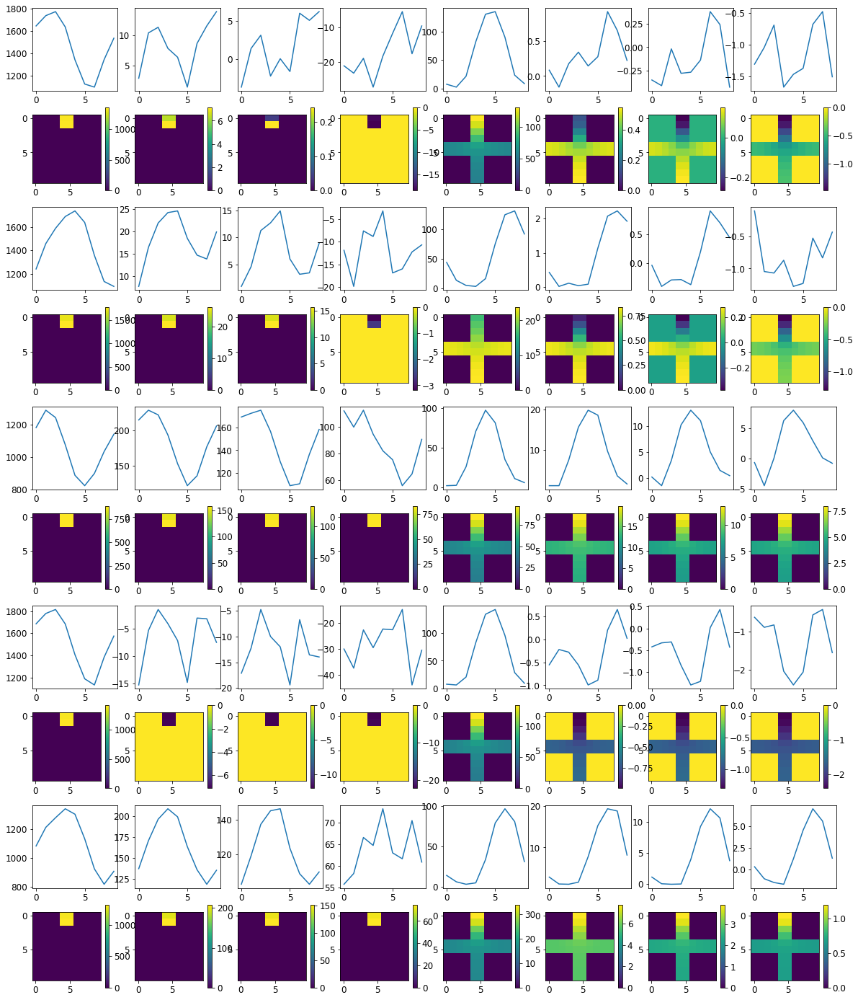

Loss: 


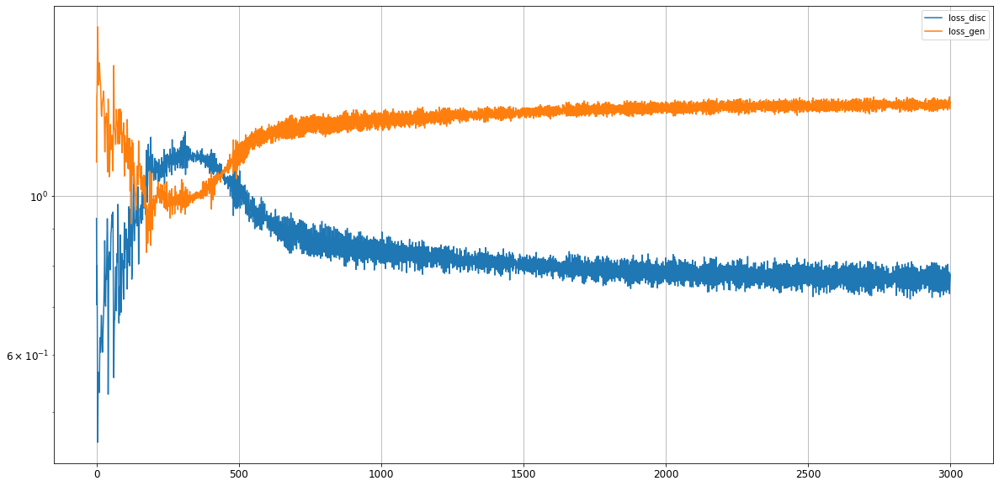

Epoch 3002/5000
discriminator loss: 1.316816 - generator loss: 0.796943 - 1s
Epoch 3003/5000
discriminator loss: 1.352513 - generator loss: 0.752129 - 1s
Epoch 3004/5000
discriminator loss: 1.348104 - generator loss: 0.741874 - 1s
Epoch 3005/5000
discriminator loss: 1.321180 - generator loss: 0.771456 - 1s
Epoch 3006/5000
discriminator loss: 1.356801 - generator loss: 0.760572 - 1s
Epoch 3007/5000
discriminator loss: 1.329948 - generator loss: 0.792308 - 1s
Epoch 3008/5000
discriminator loss: 1.320589 - generator loss: 0.795372 - 1s
Epoch 3009/5000
discriminator loss: 1.367176 - generator loss: 0.726164 - 1s
Epoch 3010/5000
discriminator loss: 1.328084 - generator loss: 0.765653 - 1s
Epoch 3011/5000
discriminator loss: 1.342756 - generator loss: 0.781536 - 1s
Epoch 3012/5000
discriminator loss: 1.371482 - generator loss: 0.752976 - 1s
Epoch 3013/5000
discriminator loss: 1.309905 - generator loss: 0.804577 - 1s
Epoch 3014/5000
discriminator loss: 1.344516 - generator loss: 0.769734 - 1s

discriminator loss: 1.346242 - generator loss: 0.756107 - 1s
Epoch 3110/5000
discriminator loss: 1.351056 - generator loss: 0.741212 - 1s
Epoch 3111/5000
discriminator loss: 1.325472 - generator loss: 0.764394 - 1s
Epoch 3112/5000
discriminator loss: 1.351971 - generator loss: 0.767524 - 1s
Epoch 3113/5000
discriminator loss: 1.341697 - generator loss: 0.787839 - 1s
Epoch 3114/5000
discriminator loss: 1.324793 - generator loss: 0.786440 - 1s
Epoch 3115/5000
discriminator loss: 1.371018 - generator loss: 0.730549 - 1s
Epoch 3116/5000
discriminator loss: 1.325769 - generator loss: 0.751041 - 1s
Epoch 3117/5000
discriminator loss: 1.336527 - generator loss: 0.775328 - 1s
Epoch 3118/5000
discriminator loss: 1.365960 - generator loss: 0.757928 - 1s
Epoch 3119/5000
discriminator loss: 1.317719 - generator loss: 0.803240 - 1s
Epoch 3120/5000
discriminator loss: 1.342100 - generator loss: 0.760493 - 1s
Epoch 3121/5000
discriminator loss: 1.355242 - generator loss: 0.733522 - 1s
Epoch 3122/5000

discriminator loss: 1.345571 - generator loss: 0.758670 - 1s
Epoch 3217/5000
discriminator loss: 1.353035 - generator loss: 0.729028 - 1s
Epoch 3218/5000
discriminator loss: 1.325331 - generator loss: 0.768973 - 1s
Epoch 3219/5000
discriminator loss: 1.343895 - generator loss: 0.759853 - 1s
Epoch 3220/5000
discriminator loss: 1.349971 - generator loss: 0.776516 - 1s
Epoch 3221/5000
discriminator loss: 1.314510 - generator loss: 0.803277 - 1s
Epoch 3222/5000
discriminator loss: 1.364684 - generator loss: 0.730079 - 1s
Epoch 3223/5000
discriminator loss: 1.337834 - generator loss: 0.745477 - 1s
Epoch 3224/5000
discriminator loss: 1.332229 - generator loss: 0.773342 - 1s
Epoch 3225/5000
discriminator loss: 1.359009 - generator loss: 0.760309 - 1s
Epoch 3226/5000
discriminator loss: 1.334126 - generator loss: 0.793956 - 1s
Epoch 3227/5000
discriminator loss: 1.334095 - generator loss: 0.771846 - 1s
Epoch 3228/5000
discriminator loss: 1.357561 - generator loss: 0.734021 - 1s
Epoch 3229/5000

discriminator loss: 1.355009 - generator loss: 0.729430 - 1s
Epoch 3324/5000
discriminator loss: 1.318639 - generator loss: 0.764253 - 1s
Epoch 3325/5000
discriminator loss: 1.360670 - generator loss: 0.760810 - 1s
Epoch 3326/5000
discriminator loss: 1.362184 - generator loss: 0.773166 - 1s
Epoch 3327/5000
discriminator loss: 1.320693 - generator loss: 0.808308 - 1s
Epoch 3328/5000
discriminator loss: 1.366447 - generator loss: 0.736334 - 1s
Epoch 3329/5000
discriminator loss: 1.341410 - generator loss: 0.751158 - 1s
Epoch 3330/5000
discriminator loss: 1.306298 - generator loss: 0.774437 - 1s
Epoch 3331/5000
discriminator loss: 1.367167 - generator loss: 0.753731 - 1s
Epoch 3332/5000
discriminator loss: 1.327956 - generator loss: 0.817562 - 1s
Epoch 3333/5000
discriminator loss: 1.328495 - generator loss: 0.780222 - 1s
Epoch 3334/5000
discriminator loss: 1.366364 - generator loss: 0.725364 - 1s
Epoch 3335/5000
discriminator loss: 1.325408 - generator loss: 0.766930 - 1s
Epoch 3336/5000

discriminator loss: 1.357658 - generator loss: 0.736441 - 1s
Epoch 3431/5000
discriminator loss: 1.335295 - generator loss: 0.748942 - 1s
Epoch 3432/5000
discriminator loss: 1.333105 - generator loss: 0.769429 - 1s
Epoch 3433/5000
discriminator loss: 1.369219 - generator loss: 0.752542 - 1s
Epoch 3434/5000
discriminator loss: 1.331544 - generator loss: 0.788749 - 1s
Epoch 3435/5000
discriminator loss: 1.333719 - generator loss: 0.773478 - 1s
Epoch 3436/5000
discriminator loss: 1.360567 - generator loss: 0.730851 - 1s
Epoch 3437/5000
discriminator loss: 1.320246 - generator loss: 0.762288 - 1s
Epoch 3438/5000
discriminator loss: 1.335916 - generator loss: 0.763341 - 1s
Epoch 3439/5000
discriminator loss: 1.359132 - generator loss: 0.768153 - 1s
Epoch 3440/5000
discriminator loss: 1.320196 - generator loss: 0.793750 - 1s
Epoch 3441/5000
discriminator loss: 1.353732 - generator loss: 0.749236 - 1s
Epoch 3442/5000
discriminator loss: 1.355240 - generator loss: 0.731801 - 1s
Epoch 3443/5000

discriminator loss: 1.333687 - generator loss: 0.785099 - 1s
Epoch 3538/5000
discriminator loss: 1.343918 - generator loss: 0.751774 - 1s
Epoch 3539/5000
discriminator loss: 1.347314 - generator loss: 0.744794 - 1s
Epoch 3540/5000
discriminator loss: 1.333206 - generator loss: 0.762876 - 1s
Epoch 3541/5000
discriminator loss: 1.353934 - generator loss: 0.750325 - 1s
Epoch 3542/5000
discriminator loss: 1.340679 - generator loss: 0.787245 - 1s
Epoch 3543/5000
discriminator loss: 1.332409 - generator loss: 0.790099 - 1s
Epoch 3544/5000
discriminator loss: 1.364584 - generator loss: 0.743395 - 1s
Epoch 3545/5000
discriminator loss: 1.348231 - generator loss: 0.735056 - 1s
Epoch 3546/5000
discriminator loss: 1.338286 - generator loss: 0.773348 - 1s
Epoch 3547/5000
discriminator loss: 1.353218 - generator loss: 0.769280 - 1s
Epoch 3548/5000
discriminator loss: 1.336265 - generator loss: 0.782144 - 1s
Epoch 3549/5000
discriminator loss: 1.335284 - generator loss: 0.777726 - 1s
Epoch 3550/5000

discriminator loss: 1.366514 - generator loss: 0.748649 - 1s
Epoch 3645/5000
discriminator loss: 1.345893 - generator loss: 0.790800 - 1s
Epoch 3646/5000
discriminator loss: 1.333050 - generator loss: 0.774470 - 1s
Epoch 3647/5000
discriminator loss: 1.353151 - generator loss: 0.734552 - 1s
Epoch 3648/5000
discriminator loss: 1.343227 - generator loss: 0.756044 - 1s
Epoch 3649/5000
discriminator loss: 1.341291 - generator loss: 0.758545 - 1s
Epoch 3650/5000
discriminator loss: 1.357719 - generator loss: 0.760336 - 1s
Epoch 3651/5000
discriminator loss: 1.337595 - generator loss: 0.775452 - 1s
Epoch 3652/5000
discriminator loss: 1.348978 - generator loss: 0.754233 - 1s
Epoch 3653/5000
discriminator loss: 1.359729 - generator loss: 0.741894 - 1s
Epoch 3654/5000
discriminator loss: 1.330862 - generator loss: 0.756248 - 1s
Epoch 3655/5000
discriminator loss: 1.347824 - generator loss: 0.758318 - 1s
Epoch 3656/5000
discriminator loss: 1.344354 - generator loss: 0.777063 - 1s
Epoch 3657/5000

discriminator loss: 1.325050 - generator loss: 0.764475 - 1s
Epoch 3752/5000
discriminator loss: 1.355309 - generator loss: 0.748385 - 1s
Epoch 3753/5000
discriminator loss: 1.356609 - generator loss: 0.773779 - 1s
Epoch 3754/5000
discriminator loss: 1.327011 - generator loss: 0.797217 - 1s
Epoch 3755/5000
discriminator loss: 1.337177 - generator loss: 0.754064 - 1s
Epoch 3756/5000
discriminator loss: 1.365992 - generator loss: 0.727095 - 1s
Epoch 3757/5000
discriminator loss: 1.336693 - generator loss: 0.758184 - 1s
Epoch 3758/5000
discriminator loss: 1.342980 - generator loss: 0.762014 - 1s
Epoch 3759/5000
discriminator loss: 1.369665 - generator loss: 0.754433 - 1s
Epoch 3760/5000
discriminator loss: 1.324618 - generator loss: 0.798033 - 1s
Epoch 3761/5000
discriminator loss: 1.349471 - generator loss: 0.751825 - 1s
Epoch 3762/5000
discriminator loss: 1.359065 - generator loss: 0.738027 - 1s
Epoch 3763/5000
discriminator loss: 1.324777 - generator loss: 0.757146 - 1s
Epoch 3764/5000

discriminator loss: 1.336592 - generator loss: 0.784566 - 1s
Epoch 3859/5000
discriminator loss: 1.346193 - generator loss: 0.749691 - 1s
Epoch 3860/5000
discriminator loss: 1.351209 - generator loss: 0.742869 - 1s
Epoch 3861/5000
discriminator loss: 1.344173 - generator loss: 0.751738 - 1s
Epoch 3862/5000
discriminator loss: 1.349366 - generator loss: 0.758435 - 1s
Epoch 3863/5000
discriminator loss: 1.360472 - generator loss: 0.760933 - 1s
Epoch 3864/5000
discriminator loss: 1.328411 - generator loss: 0.784999 - 1s
Epoch 3865/5000
discriminator loss: 1.348435 - generator loss: 0.744045 - 1s
Epoch 3866/5000
discriminator loss: 1.349435 - generator loss: 0.737456 - 1s
Epoch 3867/5000
discriminator loss: 1.329616 - generator loss: 0.762924 - 1s
Epoch 3868/5000
discriminator loss: 1.365290 - generator loss: 0.751369 - 1s
Epoch 3869/5000
discriminator loss: 1.347120 - generator loss: 0.780169 - 1s
Epoch 3870/5000
discriminator loss: 1.336810 - generator loss: 0.769107 - 1s
Epoch 3871/5000

discriminator loss: 1.338254 - generator loss: 0.745403 - 1s
Epoch 3966/5000
discriminator loss: 1.339581 - generator loss: 0.759274 - 1s
Epoch 3967/5000
discriminator loss: 1.358083 - generator loss: 0.751109 - 1s
Epoch 3968/5000
discriminator loss: 1.347886 - generator loss: 0.778093 - 1s
Epoch 3969/5000
discriminator loss: 1.338088 - generator loss: 0.774227 - 1s
Epoch 3970/5000
discriminator loss: 1.358304 - generator loss: 0.735345 - 1s
Epoch 3971/5000
discriminator loss: 1.333972 - generator loss: 0.744118 - 1s
Epoch 3972/5000
discriminator loss: 1.338881 - generator loss: 0.761321 - 1s
Epoch 3973/5000
discriminator loss: 1.370215 - generator loss: 0.757524 - 1s
Epoch 3974/5000
discriminator loss: 1.340973 - generator loss: 0.780318 - 1s
Epoch 3975/5000
discriminator loss: 1.335829 - generator loss: 0.762600 - 1s
Epoch 3976/5000
discriminator loss: 1.360457 - generator loss: 0.736188 - 1s
Epoch 3977/5000
discriminator loss: 1.339272 - generator loss: 0.749093 - 1s
Epoch 3978/5000

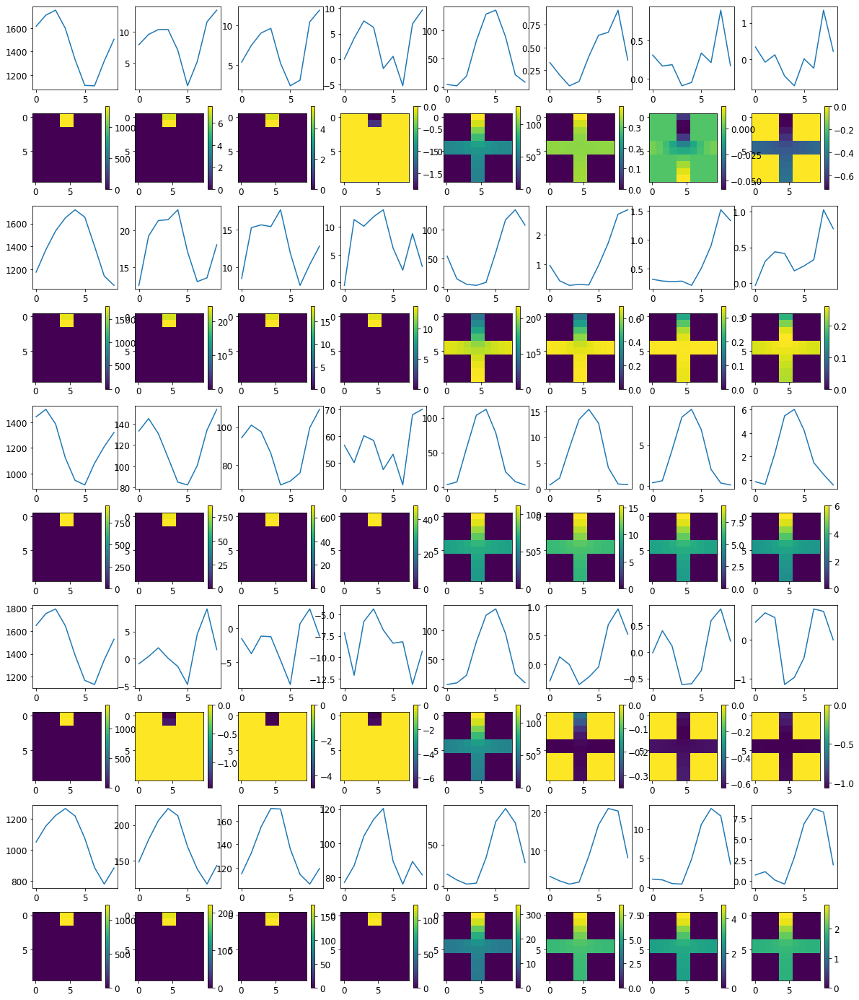

Loss: 


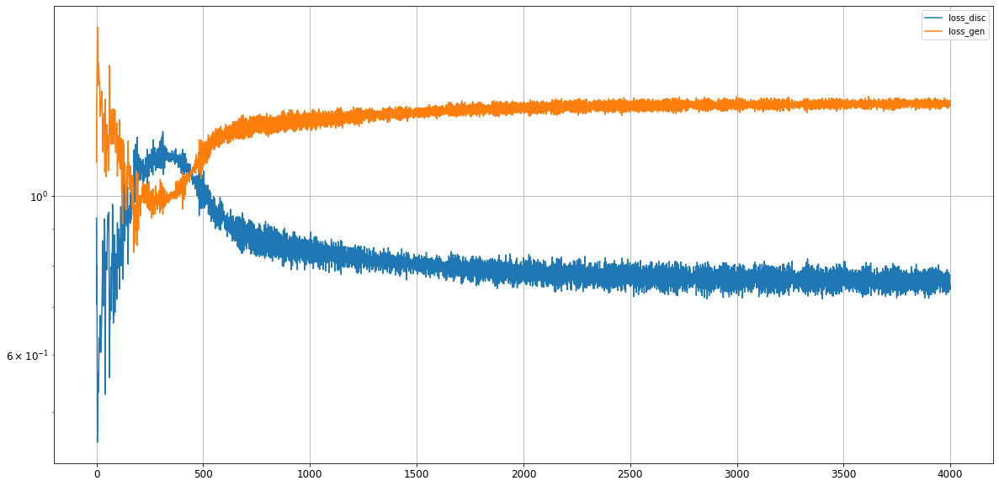

Epoch 4002/5000
discriminator loss: 1.361855 - generator loss: 0.760651 - 1s
Epoch 4003/5000
discriminator loss: 1.344163 - generator loss: 0.773416 - 1s
Epoch 4004/5000
discriminator loss: 1.336169 - generator loss: 0.771667 - 1s
Epoch 4005/5000
discriminator loss: 1.361674 - generator loss: 0.731543 - 1s
Epoch 4006/5000
discriminator loss: 1.330171 - generator loss: 0.751316 - 1s
Epoch 4007/5000
discriminator loss: 1.338455 - generator loss: 0.760796 - 1s
Epoch 4008/5000
discriminator loss: 1.359684 - generator loss: 0.766125 - 1s
Epoch 4009/5000
discriminator loss: 1.334140 - generator loss: 0.776779 - 1s
Epoch 4010/5000
discriminator loss: 1.337887 - generator loss: 0.762985 - 1s
Epoch 4011/5000
discriminator loss: 1.358252 - generator loss: 0.735117 - 1s
Epoch 4012/5000
discriminator loss: 1.335328 - generator loss: 0.757423 - 1s
Epoch 4013/5000
discriminator loss: 1.360206 - generator loss: 0.747207 - 1s
Epoch 4014/5000
discriminator loss: 1.357515 - generator loss: 0.768594 - 1s

discriminator loss: 1.356857 - generator loss: 0.742839 - 1s
Epoch 4110/5000
discriminator loss: 1.360662 - generator loss: 0.725958 - 1s
Epoch 4111/5000
discriminator loss: 1.318819 - generator loss: 0.763143 - 1s
Epoch 4112/5000
discriminator loss: 1.359786 - generator loss: 0.747701 - 1s
Epoch 4113/5000
discriminator loss: 1.360237 - generator loss: 0.779275 - 1s
Epoch 4114/5000
discriminator loss: 1.328222 - generator loss: 0.788418 - 1s
Epoch 4115/5000
discriminator loss: 1.360652 - generator loss: 0.731913 - 1s
Epoch 4116/5000
discriminator loss: 1.352571 - generator loss: 0.731425 - 1s
Epoch 4117/5000
discriminator loss: 1.332139 - generator loss: 0.761741 - 1s
Epoch 4118/5000
discriminator loss: 1.362109 - generator loss: 0.746028 - 1s
Epoch 4119/5000
discriminator loss: 1.345269 - generator loss: 0.789309 - 1s
Epoch 4120/5000
discriminator loss: 1.332918 - generator loss: 0.776104 - 1s
Epoch 4121/5000
discriminator loss: 1.360238 - generator loss: 0.734948 - 1s
Epoch 4122/5000

discriminator loss: 1.355187 - generator loss: 0.732112 - 1s
Epoch 4217/5000
discriminator loss: 1.330316 - generator loss: 0.757972 - 1s
Epoch 4218/5000
discriminator loss: 1.349629 - generator loss: 0.755996 - 1s
Epoch 4219/5000
discriminator loss: 1.353274 - generator loss: 0.767950 - 1s
Epoch 4220/5000
discriminator loss: 1.330935 - generator loss: 0.780922 - 1s
Epoch 4221/5000
discriminator loss: 1.353848 - generator loss: 0.738523 - 1s
Epoch 4222/5000
discriminator loss: 1.347855 - generator loss: 0.739914 - 1s
Epoch 4223/5000
discriminator loss: 1.339656 - generator loss: 0.754417 - 1s
Epoch 4224/5000
discriminator loss: 1.372415 - generator loss: 0.749865 - 1s
Epoch 4225/5000
discriminator loss: 1.336826 - generator loss: 0.784040 - 1s
Epoch 4226/5000
discriminator loss: 1.339859 - generator loss: 0.767247 - 1s
Epoch 4227/5000
discriminator loss: 1.369206 - generator loss: 0.725959 - 1s
Epoch 4228/5000
discriminator loss: 1.326320 - generator loss: 0.746143 - 1s
Epoch 4229/5000

discriminator loss: 1.346430 - generator loss: 0.743568 - 1s
Epoch 4324/5000
discriminator loss: 1.353296 - generator loss: 0.766730 - 1s
Epoch 4325/5000
discriminator loss: 1.340694 - generator loss: 0.775067 - 1s
Epoch 4326/5000
discriminator loss: 1.355139 - generator loss: 0.750645 - 1s
Epoch 4327/5000
discriminator loss: 1.346005 - generator loss: 0.733193 - 1s
Epoch 4328/5000
discriminator loss: 1.343269 - generator loss: 0.755472 - 1s
Epoch 4329/5000
discriminator loss: 1.355727 - generator loss: 0.757248 - 1s
Epoch 4330/5000
discriminator loss: 1.340260 - generator loss: 0.770628 - 1s
Epoch 4331/5000
discriminator loss: 1.350155 - generator loss: 0.763017 - 1s
Epoch 4332/5000
discriminator loss: 1.354303 - generator loss: 0.743710 - 1s
Epoch 4333/5000
discriminator loss: 1.345063 - generator loss: 0.741225 - 1s
Epoch 4334/5000
discriminator loss: 1.340313 - generator loss: 0.759737 - 1s
Epoch 4335/5000
discriminator loss: 1.350803 - generator loss: 0.760807 - 1s
Epoch 4336/5000

discriminator loss: 1.329311 - generator loss: 0.779862 - 1s
Epoch 4431/5000
discriminator loss: 1.339707 - generator loss: 0.769992 - 1s
Epoch 4432/5000
discriminator loss: 1.353749 - generator loss: 0.739978 - 1s
Epoch 4433/5000
discriminator loss: 1.339143 - generator loss: 0.743019 - 1s
Epoch 4434/5000
discriminator loss: 1.353127 - generator loss: 0.750339 - 1s
Epoch 4435/5000
discriminator loss: 1.354644 - generator loss: 0.769495 - 1s
Epoch 4436/5000
discriminator loss: 1.337533 - generator loss: 0.780402 - 1s
Epoch 4437/5000
discriminator loss: 1.346303 - generator loss: 0.755853 - 1s
Epoch 4438/5000
discriminator loss: 1.357164 - generator loss: 0.742245 - 1s
Epoch 4439/5000
discriminator loss: 1.336426 - generator loss: 0.746989 - 1s
Epoch 4440/5000
discriminator loss: 1.345254 - generator loss: 0.753121 - 1s
Epoch 4441/5000
discriminator loss: 1.360798 - generator loss: 0.758933 - 1s
Epoch 4442/5000
discriminator loss: 1.335264 - generator loss: 0.783377 - 1s
Epoch 4443/5000

discriminator loss: 1.363319 - generator loss: 0.727462 - 1s
Epoch 4538/5000
discriminator loss: 1.340558 - generator loss: 0.748210 - 1s
Epoch 4539/5000
discriminator loss: 1.343574 - generator loss: 0.746650 - 1s
Epoch 4540/5000
discriminator loss: 1.359001 - generator loss: 0.767833 - 1s
Epoch 4541/5000
discriminator loss: 1.336552 - generator loss: 0.787962 - 1s
Epoch 4542/5000
discriminator loss: 1.341519 - generator loss: 0.761015 - 1s
Epoch 4543/5000
discriminator loss: 1.359835 - generator loss: 0.723412 - 1s
Epoch 4544/5000
discriminator loss: 1.336021 - generator loss: 0.749142 - 1s
Epoch 4545/5000
discriminator loss: 1.352882 - generator loss: 0.753784 - 1s
Epoch 4546/5000
discriminator loss: 1.359668 - generator loss: 0.767745 - 1s
Epoch 4547/5000
discriminator loss: 1.339779 - generator loss: 0.777130 - 1s
Epoch 4548/5000
discriminator loss: 1.354664 - generator loss: 0.748537 - 1s
Epoch 4549/5000
discriminator loss: 1.355664 - generator loss: 0.726397 - 1s
Epoch 4550/5000

discriminator loss: 1.359103 - generator loss: 0.732464 - 1s
Epoch 4645/5000
discriminator loss: 1.335930 - generator loss: 0.754674 - 1s
Epoch 4646/5000
discriminator loss: 1.353523 - generator loss: 0.756251 - 1s
Epoch 4647/5000
discriminator loss: 1.355089 - generator loss: 0.772289 - 1s
Epoch 4648/5000
discriminator loss: 1.338107 - generator loss: 0.772175 - 1s
Epoch 4649/5000
discriminator loss: 1.358187 - generator loss: 0.741571 - 1s
Epoch 4650/5000
discriminator loss: 1.352567 - generator loss: 0.743382 - 1s
Epoch 4651/5000
discriminator loss: 1.339774 - generator loss: 0.750512 - 1s
Epoch 4652/5000
discriminator loss: 1.351692 - generator loss: 0.745396 - 1s
Epoch 4653/5000
discriminator loss: 1.353039 - generator loss: 0.767669 - 1s
Epoch 4654/5000
discriminator loss: 1.329896 - generator loss: 0.789274 - 1s
Epoch 4655/5000
discriminator loss: 1.355657 - generator loss: 0.742217 - 1s
Epoch 4656/5000
discriminator loss: 1.348373 - generator loss: 0.733952 - 1s
Epoch 4657/5000

discriminator loss: 1.362688 - generator loss: 0.757487 - 1s
Epoch 4752/5000
discriminator loss: 1.354934 - generator loss: 0.768598 - 1s
Epoch 4753/5000
discriminator loss: 1.336990 - generator loss: 0.775718 - 1s
Epoch 4754/5000
discriminator loss: 1.347541 - generator loss: 0.748007 - 1s
Epoch 4755/5000
discriminator loss: 1.352823 - generator loss: 0.733155 - 1s
Epoch 4756/5000
discriminator loss: 1.334200 - generator loss: 0.747087 - 1s
Epoch 4757/5000
discriminator loss: 1.357597 - generator loss: 0.754622 - 1s
Epoch 4758/5000
discriminator loss: 1.359465 - generator loss: 0.773802 - 1s
Epoch 4759/5000
discriminator loss: 1.341471 - generator loss: 0.770563 - 1s
Epoch 4760/5000
discriminator loss: 1.358498 - generator loss: 0.736051 - 1s
Epoch 4761/5000
discriminator loss: 1.351729 - generator loss: 0.734974 - 1s
Epoch 4762/5000
discriminator loss: 1.338354 - generator loss: 0.753734 - 1s
Epoch 4763/5000
discriminator loss: 1.353683 - generator loss: 0.757252 - 1s
Epoch 4764/5000

discriminator loss: 1.351950 - generator loss: 0.758078 - 1s
Epoch 4859/5000
discriminator loss: 1.348353 - generator loss: 0.767647 - 1s
Epoch 4860/5000
discriminator loss: 1.336738 - generator loss: 0.775723 - 1s
Epoch 4861/5000
discriminator loss: 1.354396 - generator loss: 0.735006 - 1s
Epoch 4862/5000
discriminator loss: 1.341967 - generator loss: 0.745624 - 1s
Epoch 4863/5000
discriminator loss: 1.349341 - generator loss: 0.755393 - 1s
Epoch 4864/5000
discriminator loss: 1.351163 - generator loss: 0.767217 - 1s
Epoch 4865/5000
discriminator loss: 1.345488 - generator loss: 0.764866 - 1s
Epoch 4866/5000
discriminator loss: 1.345996 - generator loss: 0.760755 - 1s
Epoch 4867/5000
discriminator loss: 1.355823 - generator loss: 0.735873 - 1s
Epoch 4868/5000
discriminator loss: 1.340533 - generator loss: 0.742414 - 1s
Epoch 4869/5000
discriminator loss: 1.343973 - generator loss: 0.758161 - 1s
Epoch 4870/5000
discriminator loss: 1.354253 - generator loss: 0.762190 - 1s
Epoch 4871/5000

discriminator loss: 1.340909 - generator loss: 0.772703 - 1s
Epoch 4966/5000
discriminator loss: 1.348465 - generator loss: 0.773134 - 1s
Epoch 4967/5000
discriminator loss: 1.348871 - generator loss: 0.750781 - 1s
Epoch 4968/5000
discriminator loss: 1.350844 - generator loss: 0.736057 - 1s
Epoch 4969/5000
discriminator loss: 1.336667 - generator loss: 0.762258 - 1s
Epoch 4970/5000
discriminator loss: 1.359263 - generator loss: 0.759045 - 1s
Epoch 4971/5000
discriminator loss: 1.356294 - generator loss: 0.772703 - 1s
Epoch 4972/5000
discriminator loss: 1.330472 - generator loss: 0.782640 - 1s
Epoch 4973/5000
discriminator loss: 1.351080 - generator loss: 0.742138 - 1s
Epoch 4974/5000
discriminator loss: 1.349236 - generator loss: 0.739354 - 1s
Epoch 4975/5000
discriminator loss: 1.337703 - generator loss: 0.750615 - 1s
Epoch 4976/5000
discriminator loss: 1.356607 - generator loss: 0.754219 - 1s
Epoch 4977/5000
discriminator loss: 1.349392 - generator loss: 0.772084 - 1s
Epoch 4978/5000

In [53]:
hist = train(train_dataset, epochs=5000)

Epoch 1/50000
discriminator loss: 1.344855 - generator loss: 0.770205 - 1s


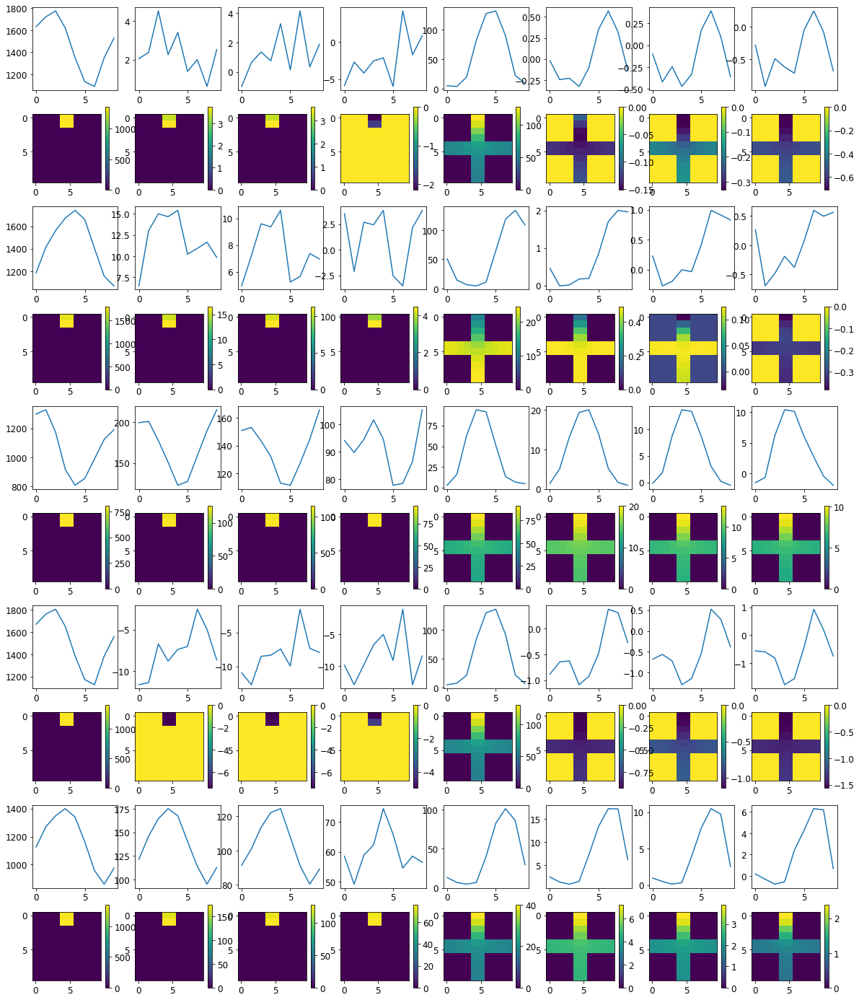

Loss: 


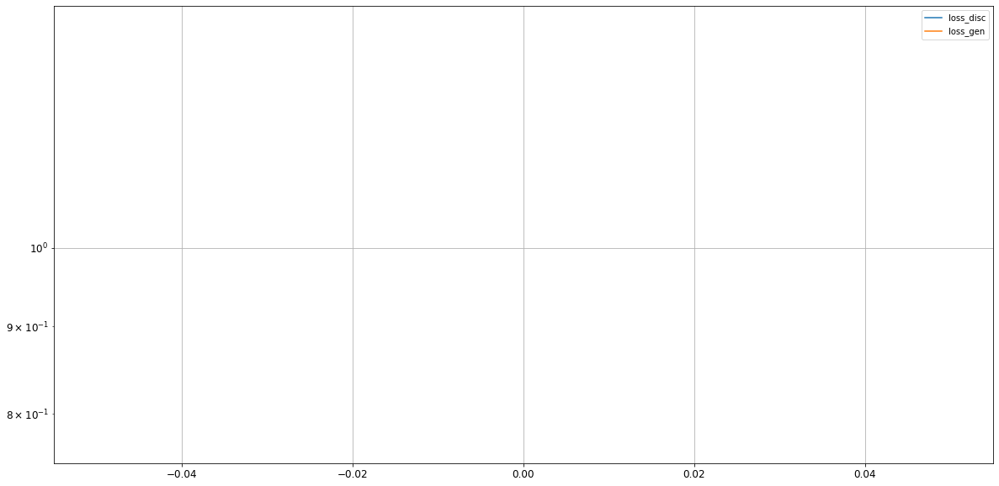

Epoch 2/50000
discriminator loss: 1.348745 - generator loss: 0.754976 - 1s
Epoch 3/50000
discriminator loss: 1.351734 - generator loss: 0.732198 - 1s
Epoch 4/50000
discriminator loss: 1.341208 - generator loss: 0.747948 - 1s
Epoch 5/50000
discriminator loss: 1.349500 - generator loss: 0.753035 - 1s
Epoch 6/50000
discriminator loss: 1.351038 - generator loss: 0.765375 - 1s
Epoch 7/50000
discriminator loss: 1.342155 - generator loss: 0.765450 - 1s
Epoch 8/50000
discriminator loss: 1.347003 - generator loss: 0.745270 - 1s
Epoch 9/50000
discriminator loss: 1.352130 - generator loss: 0.736917 - 1s
Epoch 10/50000
discriminator loss: 1.343380 - generator loss: 0.750497 - 1s
Epoch 11/50000
discriminator loss: 1.355732 - generator loss: 0.751644 - 1s
Epoch 12/50000
discriminator loss: 1.355024 - generator loss: 0.762541 - 1s
Epoch 13/50000
discriminator loss: 1.348164 - generator loss: 0.763093 - 1s
Epoch 14/50000
discriminator loss: 1.358344 - generator loss: 0.736265 - 1s
Epoch 15/50000
discr

discriminator loss: 1.345011 - generator loss: 0.746221 - 1s
Epoch 111/50000
discriminator loss: 1.350469 - generator loss: 0.752437 - 1s
Epoch 112/50000
discriminator loss: 1.354027 - generator loss: 0.763969 - 1s
Epoch 113/50000
discriminator loss: 1.343872 - generator loss: 0.780940 - 1s
Epoch 114/50000
discriminator loss: 1.349312 - generator loss: 0.751009 - 1s
Epoch 115/50000
discriminator loss: 1.358858 - generator loss: 0.743181 - 1s
Epoch 116/50000
discriminator loss: 1.340093 - generator loss: 0.749985 - 1s
Epoch 117/50000
discriminator loss: 1.348480 - generator loss: 0.757163 - 1s
Epoch 118/50000
discriminator loss: 1.359649 - generator loss: 0.750565 - 1s
Epoch 119/50000
discriminator loss: 1.345003 - generator loss: 0.767625 - 1s
Epoch 120/50000
discriminator loss: 1.351271 - generator loss: 0.752833 - 1s
Epoch 121/50000
discriminator loss: 1.352204 - generator loss: 0.744584 - 1s
Epoch 122/50000
discriminator loss: 1.346654 - generator loss: 0.738676 - 1s
Epoch 123/50000

discriminator loss: 1.335849 - generator loss: 0.776029 - 1s
Epoch 218/50000
discriminator loss: 1.361904 - generator loss: 0.740331 - 1s
Epoch 219/50000
discriminator loss: 1.362139 - generator loss: 0.719197 - 1s
Epoch 220/50000
discriminator loss: 1.338752 - generator loss: 0.754728 - 1s
Epoch 221/50000
discriminator loss: 1.354318 - generator loss: 0.747819 - 1s
Epoch 222/50000
discriminator loss: 1.353165 - generator loss: 0.775809 - 1s
Epoch 223/50000
discriminator loss: 1.332064 - generator loss: 0.786624 - 1s
Epoch 224/50000
discriminator loss: 1.366843 - generator loss: 0.732002 - 1s
Epoch 225/50000
discriminator loss: 1.358909 - generator loss: 0.727745 - 1s
Epoch 226/50000
discriminator loss: 1.345245 - generator loss: 0.745466 - 1s
Epoch 227/50000
discriminator loss: 1.356392 - generator loss: 0.753613 - 1s
Epoch 228/50000
discriminator loss: 1.357582 - generator loss: 0.768542 - 1s
Epoch 229/50000
discriminator loss: 1.337229 - generator loss: 0.776147 - 1s
Epoch 230/50000

discriminator loss: 1.359856 - generator loss: 0.755973 - 1s
Epoch 325/50000
discriminator loss: 1.340813 - generator loss: 0.766213 - 1s
Epoch 326/50000
discriminator loss: 1.345206 - generator loss: 0.756404 - 1s
Epoch 327/50000
discriminator loss: 1.350193 - generator loss: 0.740154 - 1s
Epoch 328/50000
discriminator loss: 1.352378 - generator loss: 0.744543 - 1s
Epoch 329/50000
discriminator loss: 1.359001 - generator loss: 0.750808 - 1s
Epoch 330/50000
discriminator loss: 1.358227 - generator loss: 0.759859 - 1s
Epoch 331/50000
discriminator loss: 1.342548 - generator loss: 0.765481 - 1s
Epoch 332/50000
discriminator loss: 1.358911 - generator loss: 0.740846 - 1s
Epoch 333/50000
discriminator loss: 1.357666 - generator loss: 0.737277 - 1s
Epoch 334/50000
discriminator loss: 1.354563 - generator loss: 0.744755 - 1s
Epoch 335/50000
discriminator loss: 1.351869 - generator loss: 0.753085 - 1s
Epoch 336/50000
discriminator loss: 1.356735 - generator loss: 0.755789 - 1s
Epoch 337/50000

discriminator loss: 1.361289 - generator loss: 0.723491 - 1s
Epoch 432/50000
discriminator loss: 1.343656 - generator loss: 0.738972 - 1s
Epoch 433/50000
discriminator loss: 1.345511 - generator loss: 0.761016 - 1s
Epoch 434/50000
discriminator loss: 1.366002 - generator loss: 0.755279 - 1s
Epoch 435/50000
discriminator loss: 1.343228 - generator loss: 0.772547 - 1s
Epoch 436/50000
discriminator loss: 1.350444 - generator loss: 0.759883 - 1s
Epoch 437/50000
discriminator loss: 1.359838 - generator loss: 0.737334 - 1s
Epoch 438/50000
discriminator loss: 1.347402 - generator loss: 0.744710 - 1s
Epoch 439/50000
discriminator loss: 1.349939 - generator loss: 0.747641 - 1s
Epoch 440/50000
discriminator loss: 1.358568 - generator loss: 0.761407 - 1s
Epoch 441/50000
discriminator loss: 1.349388 - generator loss: 0.781340 - 1s
Epoch 442/50000
discriminator loss: 1.350611 - generator loss: 0.749545 - 1s
Epoch 443/50000
discriminator loss: 1.365506 - generator loss: 0.733838 - 1s
Epoch 444/50000

discriminator loss: 1.344079 - generator loss: 0.752704 - 1s
Epoch 539/50000
discriminator loss: 1.354234 - generator loss: 0.745327 - 1s
Epoch 540/50000
discriminator loss: 1.352187 - generator loss: 0.761802 - 1s
Epoch 541/50000
discriminator loss: 1.343117 - generator loss: 0.772123 - 1s
Epoch 542/50000
discriminator loss: 1.350440 - generator loss: 0.749329 - 1s
Epoch 543/50000
discriminator loss: 1.347645 - generator loss: 0.731817 - 1s
Epoch 544/50000
discriminator loss: 1.345268 - generator loss: 0.754009 - 1s
Epoch 545/50000
discriminator loss: 1.350592 - generator loss: 0.761928 - 1s
Epoch 546/50000
discriminator loss: 1.354038 - generator loss: 0.754674 - 1s
Epoch 547/50000
discriminator loss: 1.339867 - generator loss: 0.772910 - 1s
Epoch 548/50000
discriminator loss: 1.354179 - generator loss: 0.742133 - 1s
Epoch 549/50000
discriminator loss: 1.355355 - generator loss: 0.740857 - 1s
Epoch 550/50000
discriminator loss: 1.337855 - generator loss: 0.751858 - 1s
Epoch 551/50000

discriminator loss: 1.356071 - generator loss: 0.753512 - 1s
Epoch 646/50000
discriminator loss: 1.352001 - generator loss: 0.765690 - 1s
Epoch 647/50000
discriminator loss: 1.344835 - generator loss: 0.762624 - 1s
Epoch 648/50000
discriminator loss: 1.355734 - generator loss: 0.734908 - 1s
Epoch 649/50000
discriminator loss: 1.347423 - generator loss: 0.734671 - 1s
Epoch 650/50000
discriminator loss: 1.347112 - generator loss: 0.761336 - 1s
Epoch 651/50000
discriminator loss: 1.357492 - generator loss: 0.748550 - 1s
Epoch 652/50000
discriminator loss: 1.342585 - generator loss: 0.776864 - 1s
Epoch 653/50000
discriminator loss: 1.346601 - generator loss: 0.750017 - 1s
Epoch 654/50000
discriminator loss: 1.354839 - generator loss: 0.741555 - 1s
Epoch 655/50000
discriminator loss: 1.345236 - generator loss: 0.731300 - 1s
Epoch 656/50000
discriminator loss: 1.347712 - generator loss: 0.755162 - 1s
Epoch 657/50000
discriminator loss: 1.353616 - generator loss: 0.767922 - 1s
Epoch 658/50000

discriminator loss: 1.355513 - generator loss: 0.741401 - 1s
Epoch 753/50000
discriminator loss: 1.357545 - generator loss: 0.758649 - 1s
Epoch 754/50000
discriminator loss: 1.353045 - generator loss: 0.758395 - 1s
Epoch 755/50000
discriminator loss: 1.357341 - generator loss: 0.745718 - 1s
Epoch 756/50000
discriminator loss: 1.356158 - generator loss: 0.732755 - 1s
Epoch 757/50000
discriminator loss: 1.350385 - generator loss: 0.743599 - 1s
Epoch 758/50000
discriminator loss: 1.356399 - generator loss: 0.758972 - 1s
Epoch 759/50000
discriminator loss: 1.357166 - generator loss: 0.756992 - 1s
Epoch 760/50000
discriminator loss: 1.346611 - generator loss: 0.756775 - 1s
Epoch 761/50000
discriminator loss: 1.350898 - generator loss: 0.741997 - 1s
Epoch 762/50000
discriminator loss: 1.346020 - generator loss: 0.742158 - 1s
Epoch 763/50000
discriminator loss: 1.349445 - generator loss: 0.740349 - 1s
Epoch 764/50000
discriminator loss: 1.353682 - generator loss: 0.755264 - 1s
Epoch 765/50000

discriminator loss: 1.346542 - generator loss: 0.781825 - 1s
Epoch 860/50000
discriminator loss: 1.352161 - generator loss: 0.753106 - 1s
Epoch 861/50000
discriminator loss: 1.360026 - generator loss: 0.722787 - 1s
Epoch 862/50000
discriminator loss: 1.346334 - generator loss: 0.747088 - 1s
Epoch 863/50000
discriminator loss: 1.340404 - generator loss: 0.750868 - 1s
Epoch 864/50000
discriminator loss: 1.360310 - generator loss: 0.756373 - 1s
Epoch 865/50000
discriminator loss: 1.342252 - generator loss: 0.771043 - 1s
Epoch 866/50000
discriminator loss: 1.343432 - generator loss: 0.753579 - 1s
Epoch 867/50000
discriminator loss: 1.357786 - generator loss: 0.722307 - 1s
Epoch 868/50000
discriminator loss: 1.342220 - generator loss: 0.743856 - 1s
Epoch 869/50000
discriminator loss: 1.352339 - generator loss: 0.755606 - 1s
Epoch 870/50000
discriminator loss: 1.362228 - generator loss: 0.766486 - 1s
Epoch 871/50000
discriminator loss: 1.340159 - generator loss: 0.762613 - 1s
Epoch 872/50000

discriminator loss: 1.348061 - generator loss: 0.765647 - 1s
Epoch 967/50000
discriminator loss: 1.341025 - generator loss: 0.754469 - 1s
Epoch 968/50000
discriminator loss: 1.368403 - generator loss: 0.727030 - 1s
Epoch 969/50000
discriminator loss: 1.344686 - generator loss: 0.746053 - 1s
Epoch 970/50000
discriminator loss: 1.347362 - generator loss: 0.746832 - 1s
Epoch 971/50000
discriminator loss: 1.368419 - generator loss: 0.753478 - 1s
Epoch 972/50000
discriminator loss: 1.337130 - generator loss: 0.775887 - 1s
Epoch 973/50000
discriminator loss: 1.353198 - generator loss: 0.750199 - 1s
Epoch 974/50000
discriminator loss: 1.354806 - generator loss: 0.730746 - 1s
Epoch 975/50000
discriminator loss: 1.337879 - generator loss: 0.749785 - 1s
Epoch 976/50000
discriminator loss: 1.349528 - generator loss: 0.754161 - 1s
Epoch 977/50000
discriminator loss: 1.359407 - generator loss: 0.752284 - 1s
Epoch 978/50000
discriminator loss: 1.338556 - generator loss: 0.773285 - 1s
Epoch 979/50000

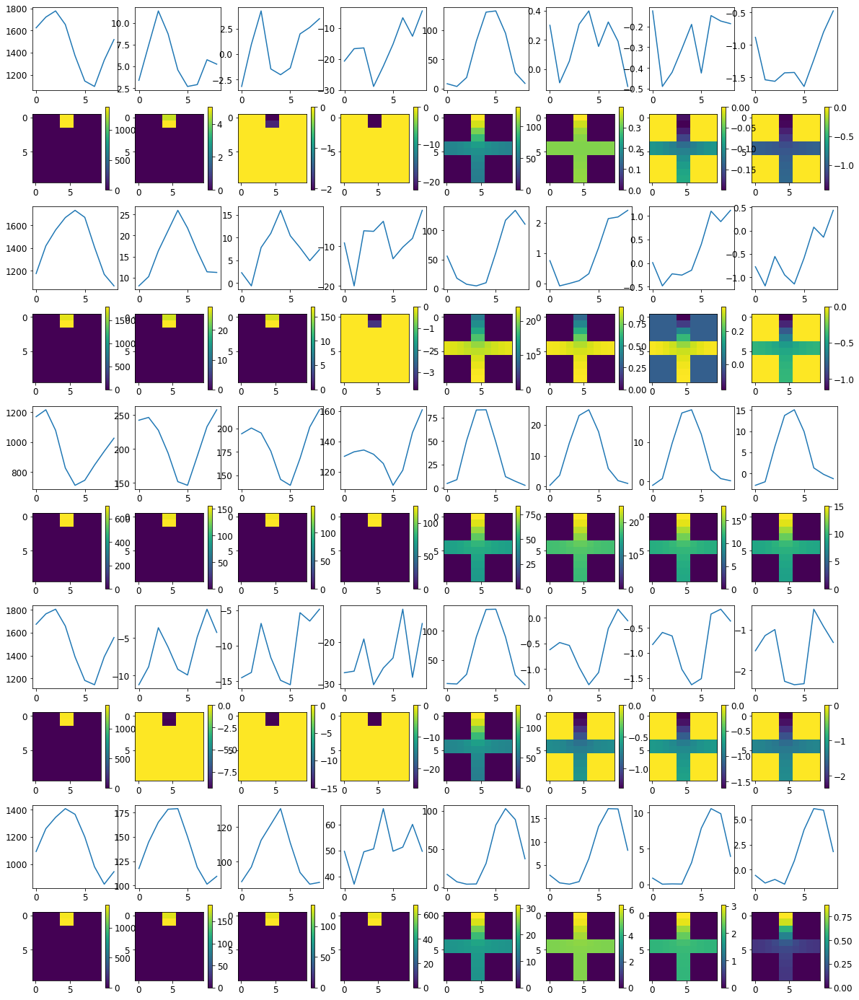

Loss: 


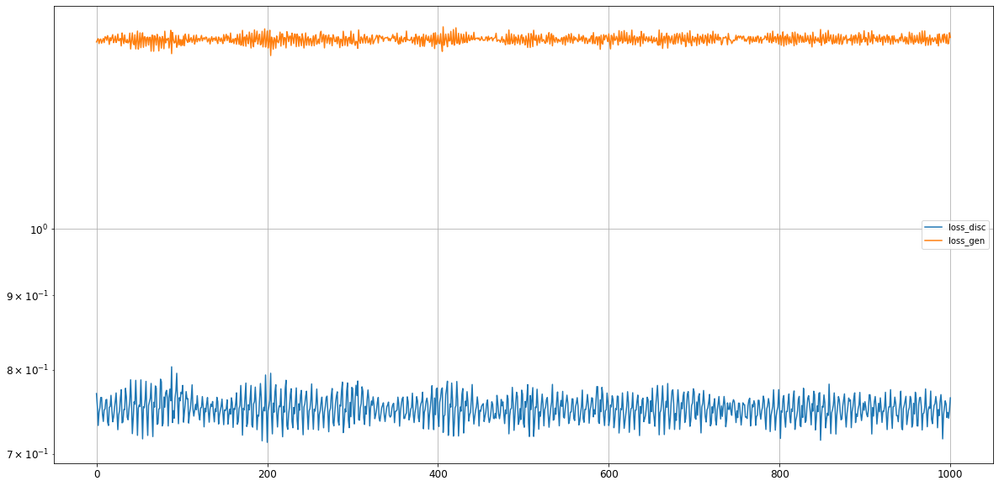

Epoch 1002/50000
discriminator loss: 1.350548 - generator loss: 0.760054 - 1s
Epoch 1003/50000
discriminator loss: 1.353050 - generator loss: 0.744952 - 1s
Epoch 1004/50000
discriminator loss: 1.351917 - generator loss: 0.733282 - 1s
Epoch 1005/50000
discriminator loss: 1.342024 - generator loss: 0.748789 - 1s
Epoch 1006/50000
discriminator loss: 1.354505 - generator loss: 0.746429 - 1s
Epoch 1007/50000
discriminator loss: 1.348706 - generator loss: 0.764901 - 1s
Epoch 1008/50000
discriminator loss: 1.338866 - generator loss: 0.779184 - 1s
Epoch 1009/50000
discriminator loss: 1.361513 - generator loss: 0.732796 - 1s
Epoch 1010/50000
discriminator loss: 1.355298 - generator loss: 0.723329 - 1s
Epoch 1011/50000
discriminator loss: 1.340725 - generator loss: 0.750530 - 1s
Epoch 1012/50000
discriminator loss: 1.366242 - generator loss: 0.748605 - 1s
Epoch 1013/50000
discriminator loss: 1.346120 - generator loss: 0.767330 - 1s
Epoch 1014/50000
discriminator loss: 1.337726 - generator loss: 

discriminator loss: 1.347136 - generator loss: 0.759604 - 1s
Epoch 1108/50000
discriminator loss: 1.338869 - generator loss: 0.777662 - 1s
Epoch 1109/50000
discriminator loss: 1.366560 - generator loss: 0.727195 - 1s
Epoch 1110/50000
discriminator loss: 1.354757 - generator loss: 0.733498 - 1s
Epoch 1111/50000
discriminator loss: 1.340539 - generator loss: 0.742438 - 1s
Epoch 1112/50000
discriminator loss: 1.365245 - generator loss: 0.750405 - 1s
Epoch 1113/50000
discriminator loss: 1.354395 - generator loss: 0.766563 - 1s
Epoch 1114/50000
discriminator loss: 1.339281 - generator loss: 0.773703 - 1s
Epoch 1115/50000
discriminator loss: 1.363588 - generator loss: 0.733135 - 1s
Epoch 1116/50000
discriminator loss: 1.351089 - generator loss: 0.726167 - 1s
Epoch 1117/50000
discriminator loss: 1.334003 - generator loss: 0.761915 - 1s
Epoch 1118/50000
discriminator loss: 1.363656 - generator loss: 0.750390 - 1s
Epoch 1119/50000
discriminator loss: 1.348145 - generator loss: 0.764471 - 1s
Epo

discriminator loss: 1.350525 - generator loss: 0.760364 - 1s
Epoch 1214/50000
discriminator loss: 1.358569 - generator loss: 0.756207 - 1s
Epoch 1215/50000
discriminator loss: 1.343892 - generator loss: 0.763874 - 1s
Epoch 1216/50000
discriminator loss: 1.355636 - generator loss: 0.749998 - 1s
Epoch 1217/50000
discriminator loss: 1.350564 - generator loss: 0.734350 - 1s
Epoch 1218/50000
discriminator loss: 1.341202 - generator loss: 0.741812 - 1s
Epoch 1219/50000
discriminator loss: 1.360930 - generator loss: 0.741369 - 1s
Epoch 1220/50000
discriminator loss: 1.354208 - generator loss: 0.767807 - 1s
Epoch 1221/50000
discriminator loss: 1.343483 - generator loss: 0.763164 - 1s
Epoch 1222/50000
discriminator loss: 1.354845 - generator loss: 0.735119 - 1s
Epoch 1223/50000
discriminator loss: 1.354489 - generator loss: 0.733427 - 1s
Epoch 1224/50000
discriminator loss: 1.342796 - generator loss: 0.751160 - 1s
Epoch 1225/50000
discriminator loss: 1.360573 - generator loss: 0.745980 - 1s
Epo

discriminator loss: 1.348717 - generator loss: 0.750753 - 1s
Epoch 1320/50000
discriminator loss: 1.350521 - generator loss: 0.752119 - 1s
Epoch 1321/50000
discriminator loss: 1.357687 - generator loss: 0.766593 - 1s
Epoch 1322/50000
discriminator loss: 1.347520 - generator loss: 0.750907 - 1s
Epoch 1323/50000
discriminator loss: 1.356808 - generator loss: 0.734355 - 1s
Epoch 1324/50000
discriminator loss: 1.351759 - generator loss: 0.738409 - 1s
Epoch 1325/50000
discriminator loss: 1.348817 - generator loss: 0.740250 - 1s
Epoch 1326/50000
discriminator loss: 1.357977 - generator loss: 0.745714 - 1s
Epoch 1327/50000
discriminator loss: 1.349284 - generator loss: 0.771316 - 1s
Epoch 1328/50000
discriminator loss: 1.352364 - generator loss: 0.754329 - 1s
Epoch 1329/50000
discriminator loss: 1.356509 - generator loss: 0.730377 - 1s
Epoch 1330/50000
discriminator loss: 1.352268 - generator loss: 0.738603 - 1s
Epoch 1331/50000
discriminator loss: 1.348026 - generator loss: 0.742117 - 1s
Epo

discriminator loss: 1.361195 - generator loss: 0.726521 - 1s
Epoch 1426/50000
discriminator loss: 1.349562 - generator loss: 0.736503 - 1s
Epoch 1427/50000
discriminator loss: 1.357170 - generator loss: 0.741045 - 1s
Epoch 1428/50000
discriminator loss: 1.359144 - generator loss: 0.749007 - 1s
Epoch 1429/50000
discriminator loss: 1.350824 - generator loss: 0.768521 - 1s
Epoch 1430/50000
discriminator loss: 1.356115 - generator loss: 0.745621 - 1s
Epoch 1431/50000
discriminator loss: 1.355994 - generator loss: 0.738116 - 1s
Epoch 1432/50000
discriminator loss: 1.347396 - generator loss: 0.736948 - 1s
Epoch 1433/50000
discriminator loss: 1.346234 - generator loss: 0.748212 - 1s
Epoch 1434/50000
discriminator loss: 1.359287 - generator loss: 0.756189 - 1s
Epoch 1435/50000
discriminator loss: 1.354252 - generator loss: 0.752124 - 1s
Epoch 1436/50000
discriminator loss: 1.350723 - generator loss: 0.755918 - 1s
Epoch 1437/50000
discriminator loss: 1.362795 - generator loss: 0.727389 - 1s
Epo

discriminator loss: 1.350044 - generator loss: 0.759784 - 1s
Epoch 1532/50000
discriminator loss: 1.356305 - generator loss: 0.732565 - 1s
Epoch 1533/50000
discriminator loss: 1.350004 - generator loss: 0.732883 - 1s
Epoch 1534/50000
discriminator loss: 1.336971 - generator loss: 0.752165 - 1s
Epoch 1535/50000
discriminator loss: 1.360307 - generator loss: 0.744334 - 1s
Epoch 1536/50000
discriminator loss: 1.354965 - generator loss: 0.768558 - 1s
Epoch 1537/50000
discriminator loss: 1.345615 - generator loss: 0.764305 - 1s
Epoch 1538/50000
discriminator loss: 1.367505 - generator loss: 0.723788 - 1s
Epoch 1539/50000
discriminator loss: 1.358798 - generator loss: 0.723829 - 1s
Epoch 1540/50000
discriminator loss: 1.339002 - generator loss: 0.755463 - 1s
Epoch 1541/50000
discriminator loss: 1.355941 - generator loss: 0.750733 - 1s
Epoch 1542/50000
discriminator loss: 1.355235 - generator loss: 0.761766 - 1s
Epoch 1543/50000
discriminator loss: 1.336805 - generator loss: 0.769205 - 1s
Epo

discriminator loss: 1.353893 - generator loss: 0.748160 - 1s
Epoch 1638/50000
discriminator loss: 1.354272 - generator loss: 0.747955 - 1s
Epoch 1639/50000
discriminator loss: 1.344223 - generator loss: 0.764428 - 1s
Epoch 1640/50000
discriminator loss: 1.350074 - generator loss: 0.742934 - 1s
Epoch 1641/50000
discriminator loss: 1.366187 - generator loss: 0.729678 - 1s
Epoch 1642/50000
discriminator loss: 1.341632 - generator loss: 0.737899 - 1s
Epoch 1643/50000
discriminator loss: 1.354687 - generator loss: 0.745401 - 1s
Epoch 1644/50000
discriminator loss: 1.354633 - generator loss: 0.762420 - 1s
Epoch 1645/50000
discriminator loss: 1.338945 - generator loss: 0.766711 - 1s
Epoch 1646/50000
discriminator loss: 1.351101 - generator loss: 0.746361 - 1s
Epoch 1647/50000
discriminator loss: 1.358358 - generator loss: 0.729885 - 1s
Epoch 1648/50000
discriminator loss: 1.343102 - generator loss: 0.741412 - 1s
Epoch 1649/50000
discriminator loss: 1.356124 - generator loss: 0.748816 - 1s
Epo

discriminator loss: 1.343097 - generator loss: 0.738785 - 1s
Epoch 1744/50000
discriminator loss: 1.351105 - generator loss: 0.750696 - 1s
Epoch 1745/50000
discriminator loss: 1.361139 - generator loss: 0.756169 - 1s
Epoch 1746/50000
discriminator loss: 1.355600 - generator loss: 0.756984 - 1s
Epoch 1747/50000
discriminator loss: 1.341043 - generator loss: 0.754540 - 1s
Epoch 1748/50000
discriminator loss: 1.370494 - generator loss: 0.725467 - 1s
Epoch 1749/50000
discriminator loss: 1.341003 - generator loss: 0.746878 - 1s
Epoch 1750/50000
discriminator loss: 1.359339 - generator loss: 0.738133 - 1s
Epoch 1751/50000
discriminator loss: 1.360613 - generator loss: 0.748136 - 1s
Epoch 1752/50000
discriminator loss: 1.350948 - generator loss: 0.756101 - 1s
Epoch 1753/50000
discriminator loss: 1.346149 - generator loss: 0.761659 - 1s
Epoch 1754/50000
discriminator loss: 1.360406 - generator loss: 0.733595 - 1s
Epoch 1755/50000
discriminator loss: 1.351152 - generator loss: 0.740320 - 1s
Epo

discriminator loss: 1.352746 - generator loss: 0.755601 - 1s
Epoch 1850/50000
discriminator loss: 1.359485 - generator loss: 0.721955 - 1s
Epoch 1851/50000
discriminator loss: 1.349846 - generator loss: 0.742575 - 1s
Epoch 1852/50000
discriminator loss: 1.350737 - generator loss: 0.743570 - 1s
Epoch 1853/50000
discriminator loss: 1.357705 - generator loss: 0.749382 - 1s
Epoch 1854/50000
discriminator loss: 1.354552 - generator loss: 0.765406 - 1s
Epoch 1855/50000
discriminator loss: 1.349155 - generator loss: 0.751853 - 1s
Epoch 1856/50000
discriminator loss: 1.356626 - generator loss: 0.737313 - 1s
Epoch 1857/50000
discriminator loss: 1.351019 - generator loss: 0.730659 - 1s
Epoch 1858/50000
discriminator loss: 1.348872 - generator loss: 0.746523 - 1s
Epoch 1859/50000
discriminator loss: 1.360091 - generator loss: 0.743483 - 1s
Epoch 1860/50000
discriminator loss: 1.344437 - generator loss: 0.762708 - 1s
Epoch 1861/50000
discriminator loss: 1.350271 - generator loss: 0.754461 - 1s
Epo

discriminator loss: 1.349983 - generator loss: 0.749342 - 1s
Epoch 1956/50000
discriminator loss: 1.366383 - generator loss: 0.741482 - 1s
Epoch 1957/50000
discriminator loss: 1.348055 - generator loss: 0.760726 - 1s
Epoch 1958/50000
discriminator loss: 1.350898 - generator loss: 0.753355 - 1s
Epoch 1959/50000
discriminator loss: 1.363596 - generator loss: 0.730647 - 1s
Epoch 1960/50000
discriminator loss: 1.348098 - generator loss: 0.740820 - 1s
Epoch 1961/50000
discriminator loss: 1.343314 - generator loss: 0.745646 - 1s
Epoch 1962/50000
discriminator loss: 1.360959 - generator loss: 0.749054 - 1s
Epoch 1963/50000
discriminator loss: 1.355707 - generator loss: 0.760161 - 1s
Epoch 1964/50000
discriminator loss: 1.343311 - generator loss: 0.758707 - 1s
Epoch 1965/50000
discriminator loss: 1.357929 - generator loss: 0.728063 - 1s
Epoch 1966/50000
discriminator loss: 1.354910 - generator loss: 0.735869 - 1s
Epoch 1967/50000
discriminator loss: 1.346760 - generator loss: 0.739176 - 1s
Epo

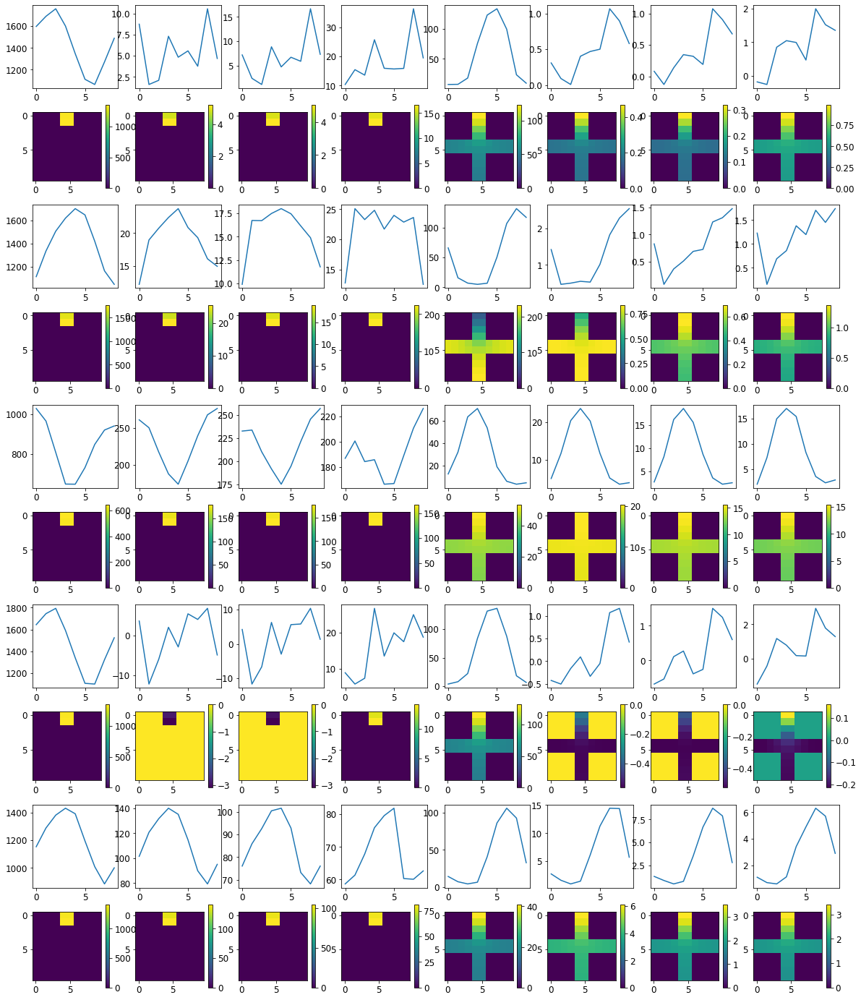

Loss: 


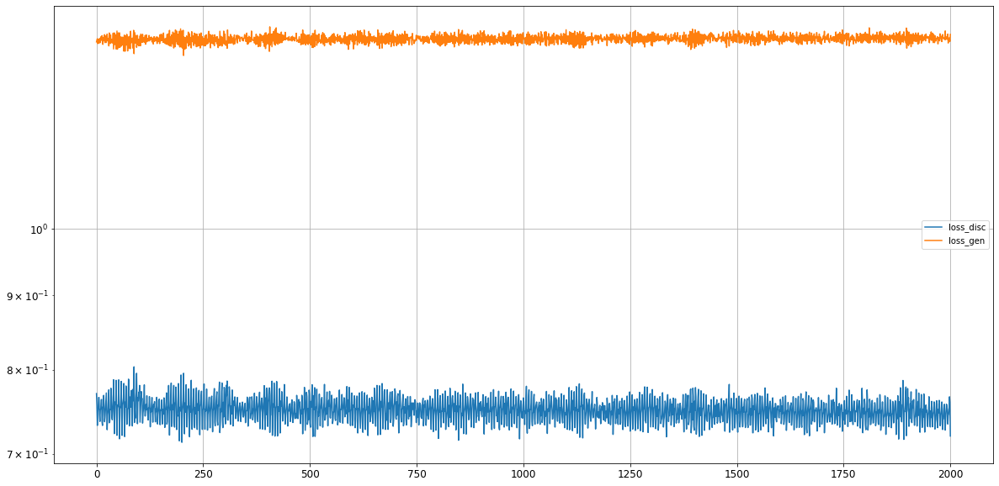

Epoch 2002/50000
discriminator loss: 1.353721 - generator loss: 0.746152 - 1s
Epoch 2003/50000
discriminator loss: 1.350032 - generator loss: 0.755277 - 1s
Epoch 2004/50000
discriminator loss: 1.362407 - generator loss: 0.748050 - 1s
Epoch 2005/50000
discriminator loss: 1.341284 - generator loss: 0.768963 - 1s
Epoch 2006/50000
discriminator loss: 1.354224 - generator loss: 0.746059 - 1s
Epoch 2007/50000
discriminator loss: 1.349436 - generator loss: 0.745597 - 1s
Epoch 2008/50000
discriminator loss: 1.341296 - generator loss: 0.741940 - 1s
Epoch 2009/50000
discriminator loss: 1.347929 - generator loss: 0.755303 - 1s
Epoch 2010/50000
discriminator loss: 1.358470 - generator loss: 0.752643 - 1s
Epoch 2011/50000
discriminator loss: 1.341285 - generator loss: 0.781610 - 1s
Epoch 2012/50000
discriminator loss: 1.359062 - generator loss: 0.744184 - 1s
Epoch 2013/50000
discriminator loss: 1.345778 - generator loss: 0.737561 - 1s
Epoch 2014/50000
discriminator loss: 1.353207 - generator loss: 

discriminator loss: 1.342712 - generator loss: 0.753094 - 1s
Epoch 2108/50000
discriminator loss: 1.361058 - generator loss: 0.724391 - 1s
Epoch 2109/50000
discriminator loss: 1.341526 - generator loss: 0.740919 - 1s
Epoch 2110/50000
discriminator loss: 1.346065 - generator loss: 0.758760 - 1s
Epoch 2111/50000
discriminator loss: 1.360541 - generator loss: 0.749623 - 1s
Epoch 2112/50000
discriminator loss: 1.348625 - generator loss: 0.767479 - 1s
Epoch 2113/50000
discriminator loss: 1.345690 - generator loss: 0.751539 - 1s
Epoch 2114/50000
discriminator loss: 1.371441 - generator loss: 0.719289 - 1s
Epoch 2115/50000
discriminator loss: 1.344974 - generator loss: 0.733729 - 1s
Epoch 2116/50000
discriminator loss: 1.345997 - generator loss: 0.750612 - 1s
Epoch 2117/50000
discriminator loss: 1.366880 - generator loss: 0.745917 - 1s
Epoch 2118/50000
discriminator loss: 1.354307 - generator loss: 0.768895 - 1s
Epoch 2119/50000
discriminator loss: 1.343881 - generator loss: 0.756417 - 1s
Epo

discriminator loss: 1.359896 - generator loss: 0.727479 - 1s
Epoch 2214/50000
discriminator loss: 1.348661 - generator loss: 0.734769 - 1s
Epoch 2215/50000
discriminator loss: 1.359393 - generator loss: 0.752315 - 1s
Epoch 2216/50000
discriminator loss: 1.354349 - generator loss: 0.763270 - 1s
Epoch 2217/50000
discriminator loss: 1.346648 - generator loss: 0.762528 - 1s
Epoch 2218/50000
discriminator loss: 1.355672 - generator loss: 0.737143 - 1s
Epoch 2219/50000
discriminator loss: 1.359302 - generator loss: 0.726994 - 1s
Epoch 2220/50000
discriminator loss: 1.342700 - generator loss: 0.750876 - 1s
Epoch 2221/50000
discriminator loss: 1.353190 - generator loss: 0.744930 - 1s
Epoch 2222/50000
discriminator loss: 1.357235 - generator loss: 0.750764 - 1s
Epoch 2223/50000
discriminator loss: 1.348654 - generator loss: 0.768557 - 1s
Epoch 2224/50000
discriminator loss: 1.344534 - generator loss: 0.752749 - 1s
Epoch 2225/50000
discriminator loss: 1.370197 - generator loss: 0.711740 - 1s
Epo

discriminator loss: 1.354335 - generator loss: 0.743958 - 1s
Epoch 2320/50000
discriminator loss: 1.355667 - generator loss: 0.752288 - 1s
Epoch 2321/50000
discriminator loss: 1.348432 - generator loss: 0.759812 - 1s
Epoch 2322/50000
discriminator loss: 1.344847 - generator loss: 0.752705 - 1s
Epoch 2323/50000
discriminator loss: 1.358410 - generator loss: 0.731608 - 1s
Epoch 2324/50000
discriminator loss: 1.347165 - generator loss: 0.738947 - 1s
Epoch 2325/50000
discriminator loss: 1.347102 - generator loss: 0.754585 - 1s
Epoch 2326/50000
discriminator loss: 1.364609 - generator loss: 0.747631 - 1s
Epoch 2327/50000
discriminator loss: 1.337223 - generator loss: 0.762303 - 1s
Epoch 2328/50000
discriminator loss: 1.349617 - generator loss: 0.752941 - 1s
Epoch 2329/50000
discriminator loss: 1.360919 - generator loss: 0.729340 - 1s
Epoch 2330/50000
discriminator loss: 1.345484 - generator loss: 0.746066 - 1s
Epoch 2331/50000
discriminator loss: 1.353399 - generator loss: 0.745333 - 1s
Epo

discriminator loss: 1.346994 - generator loss: 0.761007 - 1s
Epoch 2426/50000
discriminator loss: 1.350089 - generator loss: 0.755495 - 1s
Epoch 2427/50000
discriminator loss: 1.351270 - generator loss: 0.739807 - 1s
Epoch 2428/50000
discriminator loss: 1.350974 - generator loss: 0.731374 - 1s
Epoch 2429/50000
discriminator loss: 1.343466 - generator loss: 0.745826 - 1s
Epoch 2430/50000
discriminator loss: 1.364004 - generator loss: 0.753641 - 1s
Epoch 2431/50000
discriminator loss: 1.350640 - generator loss: 0.758770 - 1s
Epoch 2432/50000
discriminator loss: 1.350759 - generator loss: 0.756855 - 1s
Epoch 2433/50000
discriminator loss: 1.360907 - generator loss: 0.729675 - 1s
Epoch 2434/50000
discriminator loss: 1.354495 - generator loss: 0.734617 - 1s
Epoch 2435/50000
discriminator loss: 1.346475 - generator loss: 0.748096 - 1s
Epoch 2436/50000
discriminator loss: 1.355456 - generator loss: 0.745086 - 1s
Epoch 2437/50000
discriminator loss: 1.350870 - generator loss: 0.754342 - 1s
Epo

discriminator loss: 1.351034 - generator loss: 0.740875 - 1s
Epoch 2532/50000
discriminator loss: 1.347272 - generator loss: 0.739121 - 1s
Epoch 2533/50000
discriminator loss: 1.351672 - generator loss: 0.746184 - 1s
Epoch 2534/50000
discriminator loss: 1.355880 - generator loss: 0.760460 - 1s
Epoch 2535/50000
discriminator loss: 1.348649 - generator loss: 0.763414 - 1s
Epoch 2536/50000
discriminator loss: 1.350570 - generator loss: 0.739573 - 1s
Epoch 2537/50000
discriminator loss: 1.355768 - generator loss: 0.737743 - 1s
Epoch 2538/50000
discriminator loss: 1.356343 - generator loss: 0.744880 - 1s
Epoch 2539/50000
discriminator loss: 1.354230 - generator loss: 0.742812 - 1s
Epoch 2540/50000
discriminator loss: 1.365798 - generator loss: 0.748036 - 1s
Epoch 2541/50000
discriminator loss: 1.351584 - generator loss: 0.762622 - 1s
Epoch 2542/50000
discriminator loss: 1.351731 - generator loss: 0.751257 - 1s
Epoch 2543/50000
discriminator loss: 1.359593 - generator loss: 0.732500 - 1s
Epo

discriminator loss: 1.346683 - generator loss: 0.748353 - 1s
Epoch 2638/50000
discriminator loss: 1.356814 - generator loss: 0.747989 - 1s
Epoch 2639/50000
discriminator loss: 1.347876 - generator loss: 0.758973 - 1s
Epoch 2640/50000
discriminator loss: 1.343156 - generator loss: 0.758817 - 1s
Epoch 2641/50000
discriminator loss: 1.354250 - generator loss: 0.750129 - 1s
Epoch 2642/50000
discriminator loss: 1.361121 - generator loss: 0.723101 - 1s
Epoch 2643/50000
discriminator loss: 1.351762 - generator loss: 0.743232 - 1s
Epoch 2644/50000
discriminator loss: 1.362136 - generator loss: 0.741740 - 1s
Epoch 2645/50000
discriminator loss: 1.358272 - generator loss: 0.758317 - 1s
Epoch 2646/50000
discriminator loss: 1.351678 - generator loss: 0.764235 - 1s
Epoch 2647/50000
discriminator loss: 1.356469 - generator loss: 0.738743 - 1s
Epoch 2648/50000
discriminator loss: 1.363783 - generator loss: 0.721737 - 1s
Epoch 2649/50000
discriminator loss: 1.349291 - generator loss: 0.740319 - 1s
Epo

discriminator loss: 1.365180 - generator loss: 0.745214 - 1s
Epoch 2744/50000
discriminator loss: 1.343938 - generator loss: 0.762094 - 1s
Epoch 2745/50000
discriminator loss: 1.348704 - generator loss: 0.747438 - 1s
Epoch 2746/50000
discriminator loss: 1.357441 - generator loss: 0.734131 - 1s
Epoch 2747/50000
discriminator loss: 1.353158 - generator loss: 0.735663 - 1s
Epoch 2748/50000
discriminator loss: 1.344310 - generator loss: 0.745707 - 1s
Epoch 2749/50000
discriminator loss: 1.362568 - generator loss: 0.746899 - 1s
Epoch 2750/50000
discriminator loss: 1.347342 - generator loss: 0.759102 - 1s
Epoch 2751/50000
discriminator loss: 1.344656 - generator loss: 0.755740 - 1s
Epoch 2752/50000
discriminator loss: 1.358944 - generator loss: 0.728936 - 1s
Epoch 2753/50000
discriminator loss: 1.358229 - generator loss: 0.726556 - 1s
Epoch 2754/50000
discriminator loss: 1.348828 - generator loss: 0.752264 - 1s
Epoch 2755/50000
discriminator loss: 1.359225 - generator loss: 0.745435 - 1s
Epo

discriminator loss: 1.365970 - generator loss: 0.753588 - 1s
Epoch 2850/50000
discriminator loss: 1.344682 - generator loss: 0.760943 - 1s
Epoch 2851/50000
discriminator loss: 1.358565 - generator loss: 0.736399 - 1s
Epoch 2852/50000
discriminator loss: 1.358648 - generator loss: 0.733304 - 1s
Epoch 2853/50000
discriminator loss: 1.355912 - generator loss: 0.736077 - 1s
Epoch 2854/50000
discriminator loss: 1.345396 - generator loss: 0.748522 - 1s
Epoch 2855/50000
discriminator loss: 1.365024 - generator loss: 0.752311 - 1s
Epoch 2856/50000
discriminator loss: 1.341641 - generator loss: 0.774193 - 1s
Epoch 2857/50000
discriminator loss: 1.355147 - generator loss: 0.750697 - 1s
Epoch 2858/50000
discriminator loss: 1.359716 - generator loss: 0.726121 - 1s
Epoch 2859/50000
discriminator loss: 1.352155 - generator loss: 0.742249 - 1s
Epoch 2860/50000
discriminator loss: 1.340063 - generator loss: 0.756901 - 1s
Epoch 2861/50000
discriminator loss: 1.361725 - generator loss: 0.738488 - 1s
Epo

discriminator loss: 1.365744 - generator loss: 0.726501 - 1s
Epoch 2956/50000
discriminator loss: 1.352460 - generator loss: 0.731139 - 1s
Epoch 2957/50000
discriminator loss: 1.341797 - generator loss: 0.748519 - 1s
Epoch 2958/50000
discriminator loss: 1.351769 - generator loss: 0.754764 - 1s
Epoch 2959/50000
discriminator loss: 1.350200 - generator loss: 0.756471 - 1s
Epoch 2960/50000
discriminator loss: 1.339377 - generator loss: 0.767739 - 1s
Epoch 2961/50000
discriminator loss: 1.367923 - generator loss: 0.724476 - 1s
Epoch 2962/50000
discriminator loss: 1.352621 - generator loss: 0.729105 - 1s
Epoch 2963/50000
discriminator loss: 1.336845 - generator loss: 0.749330 - 1s
Epoch 2964/50000
discriminator loss: 1.361083 - generator loss: 0.750121 - 1s
Epoch 2965/50000
discriminator loss: 1.358676 - generator loss: 0.758393 - 1s
Epoch 2966/50000
discriminator loss: 1.338508 - generator loss: 0.768073 - 1s
Epoch 2967/50000
discriminator loss: 1.369975 - generator loss: 0.724540 - 1s
Epo

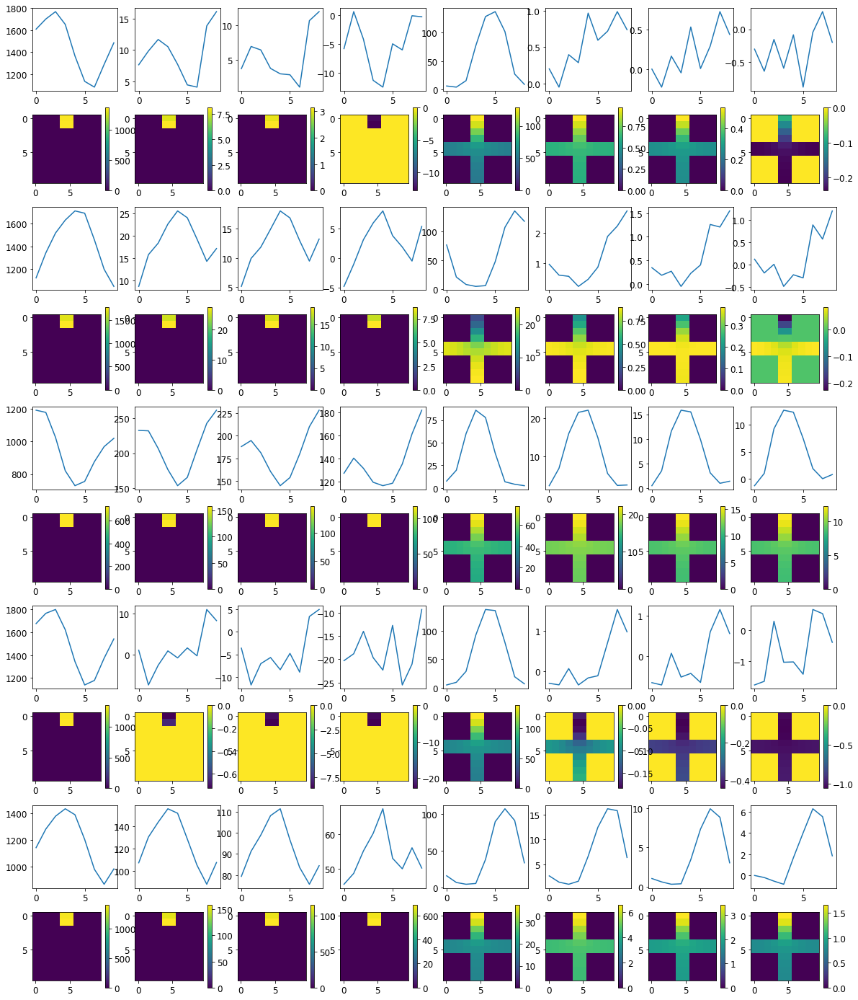

Loss: 


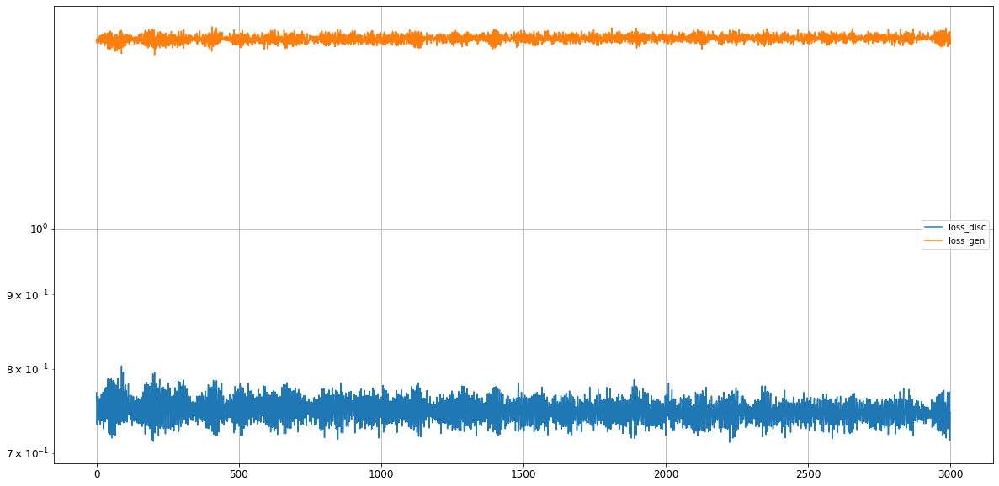

Epoch 3002/50000
discriminator loss: 1.360010 - generator loss: 0.757920 - 1s
Epoch 3003/50000
discriminator loss: 1.351019 - generator loss: 0.756842 - 1s
Epoch 3004/50000
discriminator loss: 1.346084 - generator loss: 0.760712 - 1s
Epoch 3005/50000
discriminator loss: 1.363539 - generator loss: 0.734405 - 1s
Epoch 3006/50000
discriminator loss: 1.348178 - generator loss: 0.725449 - 1s
Epoch 3007/50000
discriminator loss: 1.349751 - generator loss: 0.740147 - 1s
Epoch 3008/50000
discriminator loss: 1.358086 - generator loss: 0.753106 - 1s
Epoch 3009/50000
discriminator loss: 1.362385 - generator loss: 0.752381 - 1s
Epoch 3010/50000
discriminator loss: 1.340362 - generator loss: 0.769966 - 1s
Epoch 3011/50000
discriminator loss: 1.355240 - generator loss: 0.738818 - 1s
Epoch 3012/50000
discriminator loss: 1.364501 - generator loss: 0.726389 - 1s
Epoch 3013/50000
discriminator loss: 1.346733 - generator loss: 0.743632 - 1s
Epoch 3014/50000
discriminator loss: 1.351726 - generator loss: 

discriminator loss: 1.352485 - generator loss: 0.732457 - 1s
Epoch 3108/50000
discriminator loss: 1.351320 - generator loss: 0.738819 - 1s
Epoch 3109/50000
discriminator loss: 1.347401 - generator loss: 0.755132 - 1s
Epoch 3110/50000
discriminator loss: 1.361865 - generator loss: 0.747113 - 1s
Epoch 3111/50000
discriminator loss: 1.344584 - generator loss: 0.765497 - 1s
Epoch 3112/50000
discriminator loss: 1.354917 - generator loss: 0.738571 - 1s
Epoch 3113/50000
discriminator loss: 1.360235 - generator loss: 0.728423 - 1s
Epoch 3114/50000
discriminator loss: 1.353503 - generator loss: 0.738008 - 1s
Epoch 3115/50000
discriminator loss: 1.349297 - generator loss: 0.742886 - 1s
Epoch 3116/50000
discriminator loss: 1.361822 - generator loss: 0.754893 - 1s
Epoch 3117/50000
discriminator loss: 1.344919 - generator loss: 0.766545 - 1s
Epoch 3118/50000
discriminator loss: 1.355165 - generator loss: 0.743374 - 1s
Epoch 3119/50000
discriminator loss: 1.364107 - generator loss: 0.717204 - 1s
Epo

discriminator loss: 1.352153 - generator loss: 0.751021 - 1s
Epoch 3214/50000
discriminator loss: 1.352147 - generator loss: 0.746992 - 1s
Epoch 3215/50000
discriminator loss: 1.364603 - generator loss: 0.724505 - 1s
Epoch 3216/50000
discriminator loss: 1.344970 - generator loss: 0.742447 - 1s
Epoch 3217/50000
discriminator loss: 1.357496 - generator loss: 0.747177 - 1s
Epoch 3218/50000
discriminator loss: 1.358388 - generator loss: 0.747555 - 1s
Epoch 3219/50000
discriminator loss: 1.349390 - generator loss: 0.758117 - 1s
Epoch 3220/50000
discriminator loss: 1.363008 - generator loss: 0.739226 - 1s
Epoch 3221/50000
discriminator loss: 1.361798 - generator loss: 0.732008 - 1s
Epoch 3222/50000
discriminator loss: 1.344215 - generator loss: 0.742265 - 1s
Epoch 3223/50000
discriminator loss: 1.353495 - generator loss: 0.747748 - 1s
Epoch 3224/50000
discriminator loss: 1.362966 - generator loss: 0.745465 - 1s
Epoch 3225/50000
discriminator loss: 1.348681 - generator loss: 0.759260 - 1s
Epo

discriminator loss: 1.344653 - generator loss: 0.761990 - 1s
Epoch 3320/50000
discriminator loss: 1.358901 - generator loss: 0.744122 - 1s
Epoch 3321/50000
discriminator loss: 1.355771 - generator loss: 0.732100 - 1s
Epoch 3322/50000
discriminator loss: 1.350237 - generator loss: 0.731104 - 1s
Epoch 3323/50000
discriminator loss: 1.352444 - generator loss: 0.746329 - 1s
Epoch 3324/50000
discriminator loss: 1.356901 - generator loss: 0.753162 - 1s
Epoch 3325/50000
discriminator loss: 1.357504 - generator loss: 0.754308 - 1s
Epoch 3326/50000
discriminator loss: 1.349889 - generator loss: 0.753253 - 1s
Epoch 3327/50000
discriminator loss: 1.356748 - generator loss: 0.733592 - 1s
Epoch 3328/50000
discriminator loss: 1.353776 - generator loss: 0.740348 - 1s
Epoch 3329/50000
discriminator loss: 1.350230 - generator loss: 0.741588 - 1s
Epoch 3330/50000
discriminator loss: 1.365393 - generator loss: 0.732432 - 1s
Epoch 3331/50000
discriminator loss: 1.355374 - generator loss: 0.760829 - 1s
Epo

discriminator loss: 1.358080 - generator loss: 0.756844 - 1s
Epoch 3426/50000
discriminator loss: 1.351388 - generator loss: 0.747702 - 1s
Epoch 3427/50000
discriminator loss: 1.347040 - generator loss: 0.738677 - 1s
Epoch 3428/50000
discriminator loss: 1.355447 - generator loss: 0.734019 - 1s
Epoch 3429/50000
discriminator loss: 1.340371 - generator loss: 0.747801 - 1s
Epoch 3430/50000
discriminator loss: 1.367858 - generator loss: 0.732482 - 1s
Epoch 3431/50000
discriminator loss: 1.357198 - generator loss: 0.755108 - 1s
Epoch 3432/50000
discriminator loss: 1.341858 - generator loss: 0.759839 - 1s
Epoch 3433/50000
discriminator loss: 1.365093 - generator loss: 0.738761 - 1s
Epoch 3434/50000
discriminator loss: 1.361481 - generator loss: 0.719518 - 1s
Epoch 3435/50000
discriminator loss: 1.341726 - generator loss: 0.745188 - 1s
Epoch 3436/50000
discriminator loss: 1.358010 - generator loss: 0.744751 - 1s
Epoch 3437/50000
discriminator loss: 1.359968 - generator loss: 0.752308 - 1s
Epo

discriminator loss: 1.353778 - generator loss: 0.753674 - 1s
Epoch 3532/50000
discriminator loss: 1.360936 - generator loss: 0.741669 - 1s
Epoch 3533/50000
discriminator loss: 1.349945 - generator loss: 0.767494 - 1s
Epoch 3534/50000
discriminator loss: 1.356738 - generator loss: 0.739975 - 1s
Epoch 3535/50000
discriminator loss: 1.358201 - generator loss: 0.731991 - 1s
Epoch 3536/50000
discriminator loss: 1.354060 - generator loss: 0.733395 - 1s
Epoch 3537/50000
discriminator loss: 1.351588 - generator loss: 0.742116 - 1s
Epoch 3538/50000
discriminator loss: 1.358696 - generator loss: 0.742874 - 1s
Epoch 3539/50000
discriminator loss: 1.361380 - generator loss: 0.758402 - 1s
Epoch 3540/50000
discriminator loss: 1.346021 - generator loss: 0.757730 - 1s
Epoch 3541/50000
discriminator loss: 1.358773 - generator loss: 0.729184 - 1s
Epoch 3542/50000
discriminator loss: 1.354545 - generator loss: 0.737000 - 1s
Epoch 3543/50000
discriminator loss: 1.345800 - generator loss: 0.744682 - 1s
Epo

discriminator loss: 1.349522 - generator loss: 0.757975 - 1s
Epoch 3638/50000
discriminator loss: 1.365302 - generator loss: 0.716173 - 1s
Epoch 3639/50000
discriminator loss: 1.352475 - generator loss: 0.740482 - 1s
Epoch 3640/50000
discriminator loss: 1.351622 - generator loss: 0.753546 - 1s
Epoch 3641/50000
discriminator loss: 1.355190 - generator loss: 0.748213 - 1s
Epoch 3642/50000
discriminator loss: 1.351797 - generator loss: 0.755711 - 1s
Epoch 3643/50000
discriminator loss: 1.352265 - generator loss: 0.755913 - 1s
Epoch 3644/50000
discriminator loss: 1.359007 - generator loss: 0.729363 - 1s
Epoch 3645/50000
discriminator loss: 1.362218 - generator loss: 0.731663 - 1s
Epoch 3646/50000
discriminator loss: 1.351069 - generator loss: 0.741215 - 1s
Epoch 3647/50000
discriminator loss: 1.358408 - generator loss: 0.744372 - 1s
Epoch 3648/50000
discriminator loss: 1.357921 - generator loss: 0.757937 - 1s
Epoch 3649/50000
discriminator loss: 1.346713 - generator loss: 0.758008 - 1s
Epo

discriminator loss: 1.365780 - generator loss: 0.755009 - 1s
Epoch 3744/50000
discriminator loss: 1.341953 - generator loss: 0.768325 - 1s
Epoch 3745/50000
discriminator loss: 1.360089 - generator loss: 0.739647 - 1s
Epoch 3746/50000
discriminator loss: 1.352280 - generator loss: 0.729004 - 1s
Epoch 3747/50000
discriminator loss: 1.356381 - generator loss: 0.735420 - 1s
Epoch 3748/50000
discriminator loss: 1.340116 - generator loss: 0.760301 - 1s
Epoch 3749/50000
discriminator loss: 1.372631 - generator loss: 0.739087 - 1s
Epoch 3750/50000
discriminator loss: 1.334745 - generator loss: 0.773989 - 1s
Epoch 3751/50000
discriminator loss: 1.359163 - generator loss: 0.749962 - 1s
Epoch 3752/50000
discriminator loss: 1.352719 - generator loss: 0.743613 - 1s
Epoch 3753/50000
discriminator loss: 1.357195 - generator loss: 0.730698 - 1s
Epoch 3754/50000
discriminator loss: 1.333106 - generator loss: 0.758276 - 1s
Epoch 3755/50000
discriminator loss: 1.369231 - generator loss: 0.737527 - 1s
Epo

discriminator loss: 1.356880 - generator loss: 0.740121 - 1s
Epoch 3850/50000
discriminator loss: 1.345461 - generator loss: 0.741534 - 1s
Epoch 3851/50000
discriminator loss: 1.354169 - generator loss: 0.742117 - 1s
Epoch 3852/50000
discriminator loss: 1.356313 - generator loss: 0.755161 - 1s
Epoch 3853/50000
discriminator loss: 1.345742 - generator loss: 0.756553 - 1s
Epoch 3854/50000
discriminator loss: 1.351035 - generator loss: 0.748179 - 1s
Epoch 3855/50000
discriminator loss: 1.354809 - generator loss: 0.730533 - 1s
Epoch 3856/50000
discriminator loss: 1.352524 - generator loss: 0.735651 - 1s
Epoch 3857/50000
discriminator loss: 1.352561 - generator loss: 0.746784 - 1s
Epoch 3858/50000
discriminator loss: 1.353678 - generator loss: 0.751531 - 1s
Epoch 3859/50000
discriminator loss: 1.348036 - generator loss: 0.761192 - 1s
Epoch 3860/50000
discriminator loss: 1.349732 - generator loss: 0.751968 - 1s
Epoch 3861/50000
discriminator loss: 1.357449 - generator loss: 0.740647 - 1s
Epo

discriminator loss: 1.360023 - generator loss: 0.742347 - 1s
Epoch 3956/50000
discriminator loss: 1.361200 - generator loss: 0.733931 - 1s
Epoch 3957/50000
discriminator loss: 1.350751 - generator loss: 0.744781 - 1s
Epoch 3958/50000
discriminator loss: 1.348067 - generator loss: 0.742825 - 1s
Epoch 3959/50000
discriminator loss: 1.365041 - generator loss: 0.741497 - 1s
Epoch 3960/50000
discriminator loss: 1.353798 - generator loss: 0.764683 - 1s
Epoch 3961/50000
discriminator loss: 1.348501 - generator loss: 0.760049 - 1s
Epoch 3962/50000
discriminator loss: 1.361652 - generator loss: 0.731575 - 1s
Epoch 3963/50000
discriminator loss: 1.354294 - generator loss: 0.729079 - 1s
Epoch 3964/50000
discriminator loss: 1.344106 - generator loss: 0.745340 - 1s
Epoch 3965/50000
discriminator loss: 1.358032 - generator loss: 0.752370 - 1s
Epoch 3966/50000
discriminator loss: 1.363190 - generator loss: 0.746915 - 1s
Epoch 3967/50000
discriminator loss: 1.338411 - generator loss: 0.761361 - 1s
Epo

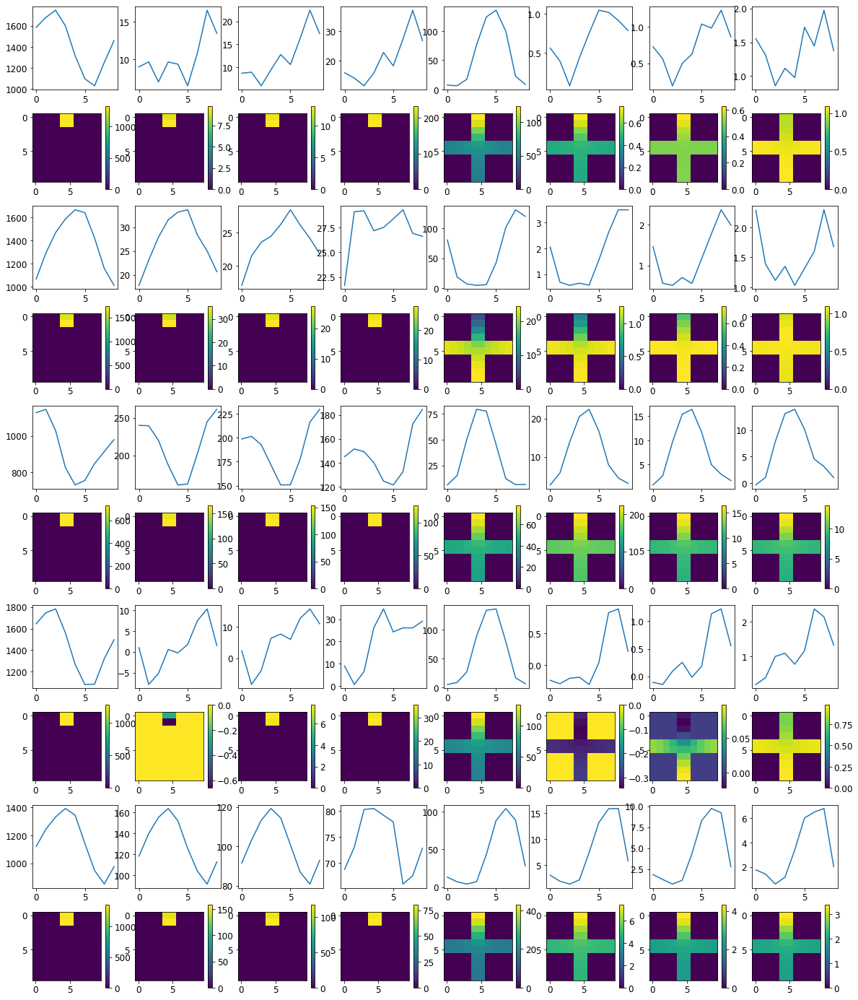

Loss: 


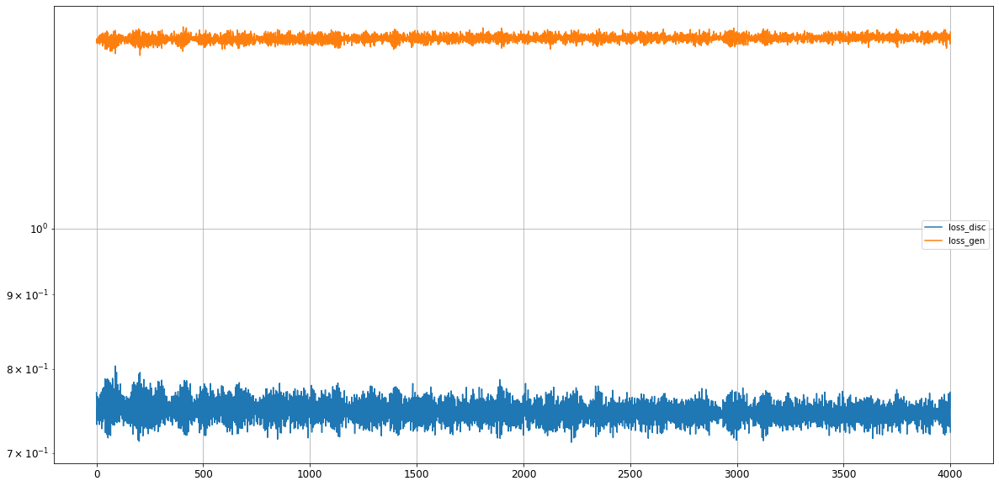

Epoch 4002/50000
discriminator loss: 1.343700 - generator loss: 0.740285 - 1s
Epoch 4003/50000
discriminator loss: 1.338850 - generator loss: 0.748289 - 1s
Epoch 4004/50000
discriminator loss: 1.357384 - generator loss: 0.745518 - 1s
Epoch 4005/50000
discriminator loss: 1.358958 - generator loss: 0.754775 - 1s
Epoch 4006/50000
discriminator loss: 1.340972 - generator loss: 0.766262 - 1s
Epoch 4007/50000
discriminator loss: 1.355956 - generator loss: 0.731206 - 1s
Epoch 4008/50000
discriminator loss: 1.356063 - generator loss: 0.729720 - 1s
Epoch 4009/50000
discriminator loss: 1.346164 - generator loss: 0.752346 - 1s
Epoch 4010/50000
discriminator loss: 1.358273 - generator loss: 0.733217 - 1s
Epoch 4011/50000
discriminator loss: 1.362408 - generator loss: 0.746505 - 1s
Epoch 4012/50000
discriminator loss: 1.345567 - generator loss: 0.765473 - 1s
Epoch 4013/50000
discriminator loss: 1.354081 - generator loss: 0.747338 - 1s
Epoch 4014/50000
discriminator loss: 1.364467 - generator loss: 

discriminator loss: 1.345560 - generator loss: 0.753161 - 1s
Epoch 4108/50000
discriminator loss: 1.365612 - generator loss: 0.742684 - 1s
Epoch 4109/50000
discriminator loss: 1.350795 - generator loss: 0.753555 - 1s
Epoch 4110/50000
discriminator loss: 1.351921 - generator loss: 0.761527 - 1s
Epoch 4111/50000
discriminator loss: 1.355097 - generator loss: 0.737566 - 1s
Epoch 4112/50000
discriminator loss: 1.357438 - generator loss: 0.723696 - 1s
Epoch 4113/50000
discriminator loss: 1.344154 - generator loss: 0.747356 - 1s
Epoch 4114/50000
discriminator loss: 1.345001 - generator loss: 0.762661 - 1s
Epoch 4115/50000
discriminator loss: 1.365781 - generator loss: 0.749511 - 1s
Epoch 4116/50000
discriminator loss: 1.349774 - generator loss: 0.751599 - 1s
Epoch 4117/50000
discriminator loss: 1.352494 - generator loss: 0.745386 - 1s
Epoch 4118/50000
discriminator loss: 1.359072 - generator loss: 0.737131 - 1s
Epoch 4119/50000
discriminator loss: 1.357980 - generator loss: 0.737383 - 1s
Epo

discriminator loss: 1.366484 - generator loss: 0.746882 - 1s
Epoch 4214/50000
discriminator loss: 1.346886 - generator loss: 0.759273 - 1s
Epoch 4215/50000
discriminator loss: 1.352485 - generator loss: 0.745089 - 1s
Epoch 4216/50000
discriminator loss: 1.360888 - generator loss: 0.719034 - 1s
Epoch 4217/50000
discriminator loss: 1.349079 - generator loss: 0.741435 - 1s
Epoch 4218/50000
discriminator loss: 1.349167 - generator loss: 0.747793 - 1s
Epoch 4219/50000
discriminator loss: 1.361230 - generator loss: 0.748782 - 1s
Epoch 4220/50000
discriminator loss: 1.354199 - generator loss: 0.756675 - 1s
Epoch 4221/50000
discriminator loss: 1.353776 - generator loss: 0.747617 - 1s
Epoch 4222/50000
discriminator loss: 1.367222 - generator loss: 0.729626 - 1s
Epoch 4223/50000
discriminator loss: 1.354076 - generator loss: 0.734723 - 1s
Epoch 4224/50000
discriminator loss: 1.347526 - generator loss: 0.739677 - 1s
Epoch 4225/50000
discriminator loss: 1.369469 - generator loss: 0.748027 - 1s
Epo

discriminator loss: 1.349820 - generator loss: 0.749949 - 1s
Epoch 4320/50000
discriminator loss: 1.358486 - generator loss: 0.736570 - 1s
Epoch 4321/50000
discriminator loss: 1.356020 - generator loss: 0.726831 - 1s
Epoch 4322/50000
discriminator loss: 1.344254 - generator loss: 0.748364 - 1s
Epoch 4323/50000
discriminator loss: 1.357144 - generator loss: 0.742522 - 1s
Epoch 4324/50000
discriminator loss: 1.356498 - generator loss: 0.753451 - 1s
Epoch 4325/50000
discriminator loss: 1.342606 - generator loss: 0.761006 - 1s
Epoch 4326/50000
discriminator loss: 1.362285 - generator loss: 0.737220 - 1s
Epoch 4327/50000
discriminator loss: 1.354281 - generator loss: 0.727049 - 1s
Epoch 4328/50000
discriminator loss: 1.350656 - generator loss: 0.738421 - 1s
Epoch 4329/50000
discriminator loss: 1.354356 - generator loss: 0.748244 - 1s
Epoch 4330/50000
discriminator loss: 1.361585 - generator loss: 0.740512 - 1s
Epoch 4331/50000
discriminator loss: 1.353289 - generator loss: 0.756882 - 1s
Epo

discriminator loss: 1.352283 - generator loss: 0.744251 - 1s
Epoch 4426/50000
discriminator loss: 1.345500 - generator loss: 0.736764 - 1s
Epoch 4427/50000
discriminator loss: 1.346336 - generator loss: 0.741143 - 1s
Epoch 4428/50000
discriminator loss: 1.346554 - generator loss: 0.749280 - 1s
Epoch 4429/50000
discriminator loss: 1.365474 - generator loss: 0.743040 - 1s
Epoch 4430/50000
discriminator loss: 1.347146 - generator loss: 0.763861 - 1s
Epoch 4431/50000
discriminator loss: 1.349516 - generator loss: 0.750521 - 1s
Epoch 4432/50000
discriminator loss: 1.351656 - generator loss: 0.733137 - 1s
Epoch 4433/50000
discriminator loss: 1.350074 - generator loss: 0.736462 - 1s
Epoch 4434/50000
discriminator loss: 1.344293 - generator loss: 0.744434 - 1s
Epoch 4435/50000
discriminator loss: 1.356254 - generator loss: 0.747735 - 1s
Epoch 4436/50000
discriminator loss: 1.364542 - generator loss: 0.749028 - 1s
Epoch 4437/50000
discriminator loss: 1.351574 - generator loss: 0.754485 - 1s
Epo

discriminator loss: 1.356833 - generator loss: 0.744529 - 1s
Epoch 4532/50000
discriminator loss: 1.357094 - generator loss: 0.731135 - 1s
Epoch 4533/50000
discriminator loss: 1.346135 - generator loss: 0.739838 - 1s
Epoch 4534/50000
discriminator loss: 1.351457 - generator loss: 0.741771 - 1s
Epoch 4535/50000
discriminator loss: 1.358521 - generator loss: 0.740527 - 1s
Epoch 4536/50000
discriminator loss: 1.353185 - generator loss: 0.761636 - 1s
Epoch 4537/50000
discriminator loss: 1.346031 - generator loss: 0.756454 - 1s
Epoch 4538/50000
discriminator loss: 1.354058 - generator loss: 0.742402 - 1s
Epoch 4539/50000
discriminator loss: 1.356090 - generator loss: 0.730908 - 1s
Epoch 4540/50000
discriminator loss: 1.349059 - generator loss: 0.735577 - 1s
Epoch 4541/50000
discriminator loss: 1.351735 - generator loss: 0.748173 - 1s
Epoch 4542/50000
discriminator loss: 1.354882 - generator loss: 0.750971 - 1s
Epoch 4543/50000
discriminator loss: 1.354040 - generator loss: 0.750085 - 1s
Epo

discriminator loss: 1.350865 - generator loss: 0.742919 - 1s
Epoch 4638/50000
discriminator loss: 1.350824 - generator loss: 0.737914 - 1s
Epoch 4639/50000
discriminator loss: 1.352678 - generator loss: 0.734386 - 1s
Epoch 4640/50000
discriminator loss: 1.344401 - generator loss: 0.742298 - 1s
Epoch 4641/50000
discriminator loss: 1.355348 - generator loss: 0.747414 - 1s
Epoch 4642/50000
discriminator loss: 1.358534 - generator loss: 0.746124 - 1s
Epoch 4643/50000
discriminator loss: 1.352576 - generator loss: 0.753765 - 1s
Epoch 4644/50000
discriminator loss: 1.355207 - generator loss: 0.738552 - 1s
Epoch 4645/50000
discriminator loss: 1.364245 - generator loss: 0.731548 - 1s
Epoch 4646/50000
discriminator loss: 1.348825 - generator loss: 0.738219 - 1s
Epoch 4647/50000
discriminator loss: 1.355248 - generator loss: 0.749605 - 1s
Epoch 4648/50000
discriminator loss: 1.359681 - generator loss: 0.735440 - 1s
Epoch 4649/50000
discriminator loss: 1.354851 - generator loss: 0.753904 - 1s
Epo

discriminator loss: 1.358532 - generator loss: 0.741056 - 1s
Epoch 4744/50000
discriminator loss: 1.356776 - generator loss: 0.731847 - 1s
Epoch 4745/50000
discriminator loss: 1.346224 - generator loss: 0.736723 - 1s
Epoch 4746/50000
discriminator loss: 1.348727 - generator loss: 0.745569 - 1s
Epoch 4747/50000
discriminator loss: 1.359754 - generator loss: 0.744589 - 1s
Epoch 4748/50000
discriminator loss: 1.349756 - generator loss: 0.756643 - 1s
Epoch 4749/50000
discriminator loss: 1.352421 - generator loss: 0.749049 - 1s
Epoch 4750/50000
discriminator loss: 1.351163 - generator loss: 0.744932 - 1s
Epoch 4751/50000
discriminator loss: 1.360730 - generator loss: 0.728643 - 1s
Epoch 4752/50000
discriminator loss: 1.343105 - generator loss: 0.745777 - 1s
Epoch 4753/50000
discriminator loss: 1.352205 - generator loss: 0.745992 - 1s
Epoch 4754/50000
discriminator loss: 1.362947 - generator loss: 0.739975 - 1s
Epoch 4755/50000
discriminator loss: 1.344665 - generator loss: 0.766402 - 1s
Epo

discriminator loss: 1.358380 - generator loss: 0.736194 - 1s
Epoch 4850/50000
discriminator loss: 1.352964 - generator loss: 0.730387 - 1s
Epoch 4851/50000
discriminator loss: 1.342953 - generator loss: 0.746089 - 1s
Epoch 4852/50000
discriminator loss: 1.355132 - generator loss: 0.741064 - 1s
Epoch 4853/50000
discriminator loss: 1.363445 - generator loss: 0.752760 - 1s
Epoch 4854/50000
discriminator loss: 1.346179 - generator loss: 0.761589 - 1s
Epoch 4855/50000
discriminator loss: 1.348642 - generator loss: 0.750802 - 1s
Epoch 4856/50000
discriminator loss: 1.358597 - generator loss: 0.728650 - 1s
Epoch 4857/50000
discriminator loss: 1.358237 - generator loss: 0.729549 - 1s
Epoch 4858/50000
discriminator loss: 1.340985 - generator loss: 0.749176 - 1s
Epoch 4859/50000
discriminator loss: 1.363201 - generator loss: 0.740421 - 1s
Epoch 4860/50000
discriminator loss: 1.361581 - generator loss: 0.750723 - 1s
Epoch 4861/50000
discriminator loss: 1.348421 - generator loss: 0.760891 - 1s
Epo

discriminator loss: 1.350934 - generator loss: 0.744815 - 1s
Epoch 4956/50000
discriminator loss: 1.355913 - generator loss: 0.732359 - 1s
Epoch 4957/50000
discriminator loss: 1.353106 - generator loss: 0.741851 - 1s
Epoch 4958/50000
discriminator loss: 1.346886 - generator loss: 0.746275 - 1s
Epoch 4959/50000
discriminator loss: 1.357032 - generator loss: 0.746048 - 1s
Epoch 4960/50000
discriminator loss: 1.356024 - generator loss: 0.750646 - 1s
Epoch 4961/50000
discriminator loss: 1.350156 - generator loss: 0.750748 - 1s
Epoch 4962/50000
discriminator loss: 1.359025 - generator loss: 0.736580 - 1s
Epoch 4963/50000
discriminator loss: 1.354235 - generator loss: 0.733240 - 1s
Epoch 4964/50000
discriminator loss: 1.346827 - generator loss: 0.738058 - 1s
Epoch 4965/50000
discriminator loss: 1.355866 - generator loss: 0.750729 - 1s
Epoch 4966/50000
discriminator loss: 1.364554 - generator loss: 0.742665 - 1s
Epoch 4967/50000
discriminator loss: 1.354727 - generator loss: 0.750299 - 1s
Epo

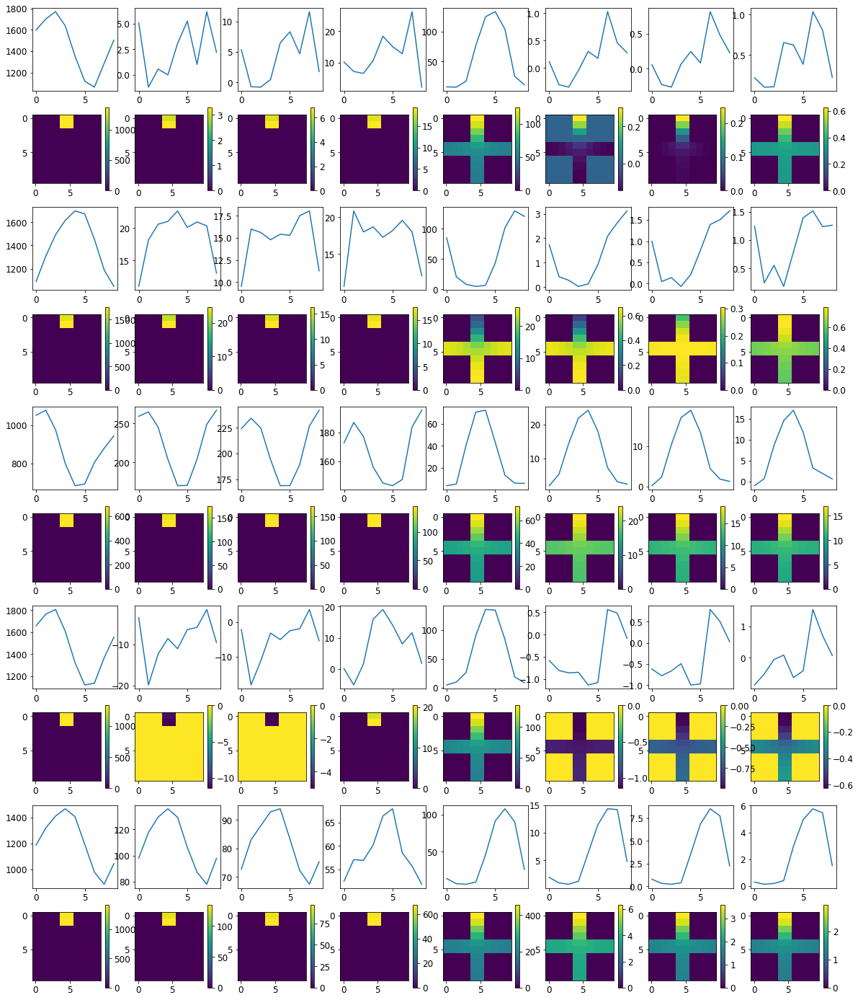

Loss: 


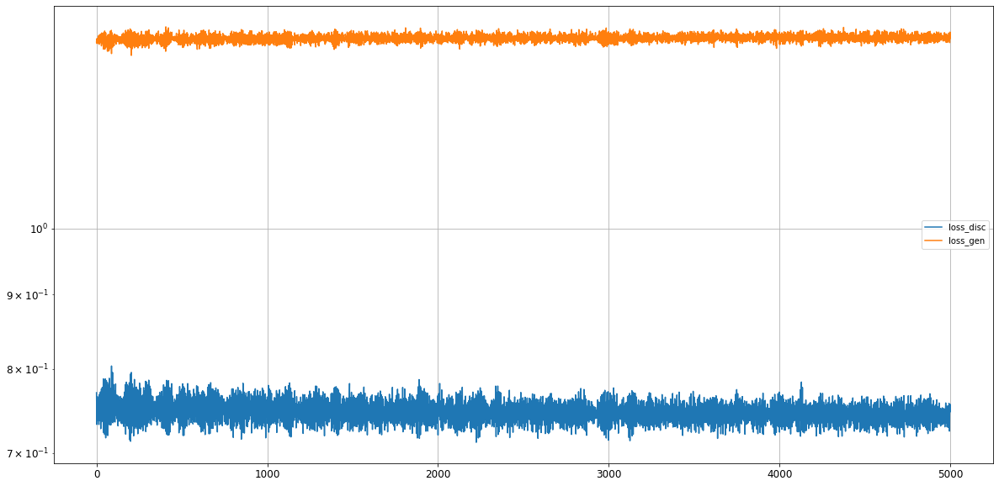

Epoch 5002/50000
discriminator loss: 1.365573 - generator loss: 0.728499 - 1s
Epoch 5003/50000
discriminator loss: 1.346064 - generator loss: 0.743562 - 1s
Epoch 5004/50000
discriminator loss: 1.346079 - generator loss: 0.743092 - 1s
Epoch 5005/50000
discriminator loss: 1.351162 - generator loss: 0.747362 - 1s
Epoch 5006/50000
discriminator loss: 1.352934 - generator loss: 0.757846 - 1s
Epoch 5007/50000
discriminator loss: 1.345702 - generator loss: 0.761145 - 1s
Epoch 5008/50000
discriminator loss: 1.351896 - generator loss: 0.748957 - 1s
Epoch 5009/50000
discriminator loss: 1.373382 - generator loss: 0.718469 - 1s
Epoch 5010/50000
discriminator loss: 1.348626 - generator loss: 0.742167 - 1s
Epoch 5011/50000
discriminator loss: 1.351987 - generator loss: 0.744978 - 1s
Epoch 5012/50000
discriminator loss: 1.355081 - generator loss: 0.751283 - 1s
Epoch 5013/50000
discriminator loss: 1.361822 - generator loss: 0.754417 - 1s
Epoch 5014/50000
discriminator loss: 1.337339 - generator loss: 

discriminator loss: 1.343247 - generator loss: 0.754446 - 1s
Epoch 5108/50000
discriminator loss: 1.361159 - generator loss: 0.733885 - 1s
Epoch 5109/50000
discriminator loss: 1.354958 - generator loss: 0.731820 - 1s
Epoch 5110/50000
discriminator loss: 1.343364 - generator loss: 0.745291 - 1s
Epoch 5111/50000
discriminator loss: 1.353588 - generator loss: 0.748305 - 1s
Epoch 5112/50000
discriminator loss: 1.362034 - generator loss: 0.743674 - 1s
Epoch 5113/50000
discriminator loss: 1.348798 - generator loss: 0.756734 - 1s
Epoch 5114/50000
discriminator loss: 1.352707 - generator loss: 0.751587 - 1s
Epoch 5115/50000
discriminator loss: 1.358868 - generator loss: 0.727617 - 1s
Epoch 5116/50000
discriminator loss: 1.358816 - generator loss: 0.732807 - 1s
Epoch 5117/50000
discriminator loss: 1.353850 - generator loss: 0.743935 - 1s
Epoch 5118/50000
discriminator loss: 1.359789 - generator loss: 0.740840 - 1s
Epoch 5119/50000
discriminator loss: 1.359194 - generator loss: 0.745942 - 1s
Epo

discriminator loss: 1.353346 - generator loss: 0.767514 - 1s
Epoch 5214/50000
discriminator loss: 1.348569 - generator loss: 0.752835 - 1s
Epoch 5215/50000
discriminator loss: 1.357065 - generator loss: 0.730675 - 1s
Epoch 5216/50000
discriminator loss: 1.367483 - generator loss: 0.728967 - 1s
Epoch 5217/50000
discriminator loss: 1.340348 - generator loss: 0.752110 - 1s
Epoch 5218/50000
discriminator loss: 1.368068 - generator loss: 0.734180 - 1s
Epoch 5219/50000
discriminator loss: 1.362703 - generator loss: 0.746522 - 1s
Epoch 5220/50000
discriminator loss: 1.353011 - generator loss: 0.762661 - 1s
Epoch 5221/50000
discriminator loss: 1.346595 - generator loss: 0.771006 - 1s
Epoch 5222/50000
discriminator loss: 1.362661 - generator loss: 0.733970 - 1s
Epoch 5223/50000
discriminator loss: 1.356309 - generator loss: 0.726396 - 1s
Epoch 5224/50000
discriminator loss: 1.344814 - generator loss: 0.744563 - 1s
Epoch 5225/50000
discriminator loss: 1.351979 - generator loss: 0.749809 - 1s
Epo

discriminator loss: 1.348830 - generator loss: 0.751109 - 1s
Epoch 5320/50000
discriminator loss: 1.364684 - generator loss: 0.738855 - 1s
Epoch 5321/50000
discriminator loss: 1.357998 - generator loss: 0.749618 - 1s
Epoch 5322/50000
discriminator loss: 1.342132 - generator loss: 0.764749 - 1s
Epoch 5323/50000
discriminator loss: 1.359737 - generator loss: 0.735608 - 1s
Epoch 5324/50000
discriminator loss: 1.364403 - generator loss: 0.722100 - 1s
Epoch 5325/50000
discriminator loss: 1.344581 - generator loss: 0.741951 - 1s
Epoch 5326/50000
discriminator loss: 1.352172 - generator loss: 0.742605 - 1s
Epoch 5327/50000
discriminator loss: 1.364092 - generator loss: 0.748312 - 1s
Epoch 5328/50000
discriminator loss: 1.361763 - generator loss: 0.751804 - 1s
Epoch 5329/50000
discriminator loss: 1.341939 - generator loss: 0.765550 - 1s
Epoch 5330/50000
discriminator loss: 1.367421 - generator loss: 0.725249 - 1s
Epoch 5331/50000
discriminator loss: 1.358923 - generator loss: 0.722322 - 1s
Epo

discriminator loss: 1.359844 - generator loss: 0.730481 - 1s
Epoch 5426/50000
discriminator loss: 1.348054 - generator loss: 0.737343 - 1s
Epoch 5427/50000
discriminator loss: 1.352304 - generator loss: 0.746412 - 1s
Epoch 5428/50000
discriminator loss: 1.355418 - generator loss: 0.745661 - 1s
Epoch 5429/50000
discriminator loss: 1.360604 - generator loss: 0.742668 - 1s
Epoch 5430/50000
discriminator loss: 1.349048 - generator loss: 0.756954 - 1s
Epoch 5431/50000
discriminator loss: 1.358422 - generator loss: 0.750469 - 1s
Epoch 5432/50000
discriminator loss: 1.363073 - generator loss: 0.722964 - 1s
Epoch 5433/50000
discriminator loss: 1.350664 - generator loss: 0.736879 - 1s
Epoch 5434/50000
discriminator loss: 1.353010 - generator loss: 0.746357 - 1s
Epoch 5435/50000
discriminator loss: 1.362495 - generator loss: 0.745355 - 1s
Epoch 5436/50000
discriminator loss: 1.355784 - generator loss: 0.753329 - 1s
Epoch 5437/50000
discriminator loss: 1.351812 - generator loss: 0.749520 - 1s
Epo

discriminator loss: 1.359183 - generator loss: 0.747980 - 1s
Epoch 5532/50000
discriminator loss: 1.352121 - generator loss: 0.736899 - 1s
Epoch 5533/50000
discriminator loss: 1.351777 - generator loss: 0.741866 - 1s
Epoch 5534/50000
discriminator loss: 1.352610 - generator loss: 0.739520 - 1s
Epoch 5535/50000
discriminator loss: 1.352535 - generator loss: 0.739896 - 1s
Epoch 5536/50000
discriminator loss: 1.364025 - generator loss: 0.744598 - 1s
Epoch 5537/50000
discriminator loss: 1.347652 - generator loss: 0.760336 - 1s
Epoch 5538/50000
discriminator loss: 1.355175 - generator loss: 0.744552 - 1s
Epoch 5539/50000
discriminator loss: 1.356492 - generator loss: 0.739388 - 1s
Epoch 5540/50000
discriminator loss: 1.366337 - generator loss: 0.722334 - 1s
Epoch 5541/50000
discriminator loss: 1.346496 - generator loss: 0.747720 - 1s
Epoch 5542/50000
discriminator loss: 1.359962 - generator loss: 0.739928 - 1s
Epoch 5543/50000
discriminator loss: 1.359801 - generator loss: 0.751660 - 1s
Epo

discriminator loss: 1.372520 - generator loss: 0.735221 - 1s
Epoch 5638/50000
discriminator loss: 1.353252 - generator loss: 0.762134 - 1s
Epoch 5639/50000
discriminator loss: 1.335210 - generator loss: 0.757752 - 1s
Epoch 5640/50000
discriminator loss: 1.353207 - generator loss: 0.737900 - 1s
Epoch 5641/50000
discriminator loss: 1.367346 - generator loss: 0.726482 - 1s
Epoch 5642/50000
discriminator loss: 1.349715 - generator loss: 0.739924 - 1s
Epoch 5643/50000
discriminator loss: 1.348100 - generator loss: 0.745506 - 1s
Epoch 5644/50000
discriminator loss: 1.366838 - generator loss: 0.736905 - 1s
Epoch 5645/50000
discriminator loss: 1.355143 - generator loss: 0.752074 - 1s
Epoch 5646/50000
discriminator loss: 1.350925 - generator loss: 0.755992 - 1s
Epoch 5647/50000
discriminator loss: 1.355896 - generator loss: 0.740936 - 1s
Epoch 5648/50000
discriminator loss: 1.368667 - generator loss: 0.721428 - 1s
Epoch 5649/50000
discriminator loss: 1.349480 - generator loss: 0.740839 - 1s
Epo

discriminator loss: 1.348892 - generator loss: 0.734271 - 1s
Epoch 5744/50000
discriminator loss: 1.354104 - generator loss: 0.745141 - 1s
Epoch 5745/50000
discriminator loss: 1.350883 - generator loss: 0.758567 - 1s
Epoch 5746/50000
discriminator loss: 1.362533 - generator loss: 0.740345 - 1s
Epoch 5747/50000
discriminator loss: 1.341036 - generator loss: 0.763771 - 1s
Epoch 5748/50000
discriminator loss: 1.365394 - generator loss: 0.735230 - 1s
Epoch 5749/50000
discriminator loss: 1.346150 - generator loss: 0.744148 - 1s
Epoch 5750/50000
discriminator loss: 1.351392 - generator loss: 0.735172 - 1s
Epoch 5751/50000
discriminator loss: 1.354557 - generator loss: 0.739614 - 1s
Epoch 5752/50000
discriminator loss: 1.361612 - generator loss: 0.750037 - 1s
Epoch 5753/50000
discriminator loss: 1.352114 - generator loss: 0.755769 - 1s
Epoch 5754/50000
discriminator loss: 1.352757 - generator loss: 0.758576 - 1s
Epoch 5755/50000
discriminator loss: 1.359115 - generator loss: 0.727970 - 1s
Epo

discriminator loss: 1.347637 - generator loss: 0.749471 - 1s
Epoch 5850/50000
discriminator loss: 1.366076 - generator loss: 0.728871 - 1s
Epoch 5851/50000
discriminator loss: 1.355220 - generator loss: 0.734318 - 1s
Epoch 5852/50000
discriminator loss: 1.355773 - generator loss: 0.738015 - 1s
Epoch 5853/50000
discriminator loss: 1.363438 - generator loss: 0.732328 - 1s
Epoch 5854/50000
discriminator loss: 1.359083 - generator loss: 0.756550 - 1s
Epoch 5855/50000
discriminator loss: 1.337591 - generator loss: 0.765730 - 1s
Epoch 5856/50000
discriminator loss: 1.352950 - generator loss: 0.741662 - 1s
Epoch 5857/50000
discriminator loss: 1.363891 - generator loss: 0.728998 - 1s
Epoch 5858/50000
discriminator loss: 1.347877 - generator loss: 0.734985 - 1s
Epoch 5859/50000
discriminator loss: 1.353356 - generator loss: 0.741656 - 1s
Epoch 5860/50000
discriminator loss: 1.362319 - generator loss: 0.735198 - 1s
Epoch 5861/50000
discriminator loss: 1.367128 - generator loss: 0.748050 - 1s
Epo

discriminator loss: 1.352417 - generator loss: 0.742283 - 1s
Epoch 5956/50000
discriminator loss: 1.355572 - generator loss: 0.740543 - 1s
Epoch 5957/50000
discriminator loss: 1.350474 - generator loss: 0.754722 - 1s
Epoch 5958/50000
discriminator loss: 1.349023 - generator loss: 0.752974 - 1s
Epoch 5959/50000
discriminator loss: 1.353916 - generator loss: 0.747272 - 1s
Epoch 5960/50000
discriminator loss: 1.353770 - generator loss: 0.736298 - 1s
Epoch 5961/50000
discriminator loss: 1.356265 - generator loss: 0.735295 - 1s
Epoch 5962/50000
discriminator loss: 1.354831 - generator loss: 0.740860 - 1s
Epoch 5963/50000
discriminator loss: 1.349877 - generator loss: 0.748331 - 1s
Epoch 5964/50000
discriminator loss: 1.359863 - generator loss: 0.744317 - 1s
Epoch 5965/50000
discriminator loss: 1.350627 - generator loss: 0.757185 - 1s
Epoch 5966/50000
discriminator loss: 1.356249 - generator loss: 0.743168 - 1s
Epoch 5967/50000
discriminator loss: 1.354595 - generator loss: 0.735053 - 1s
Epo

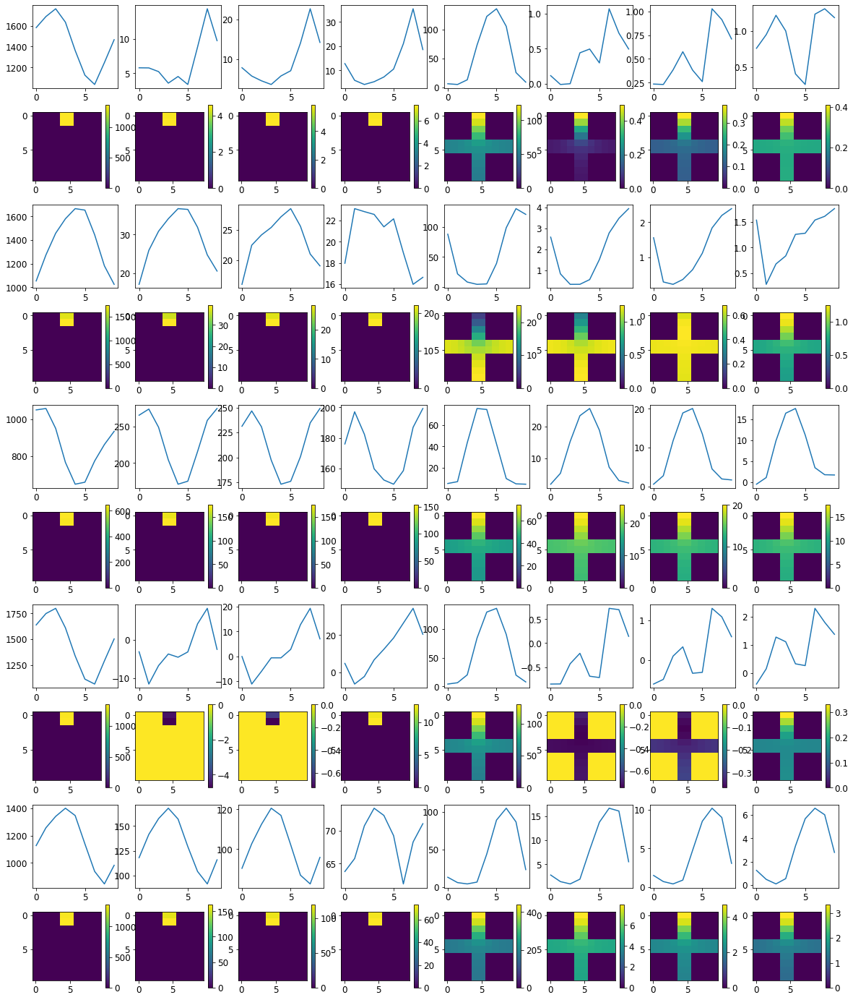

Loss: 


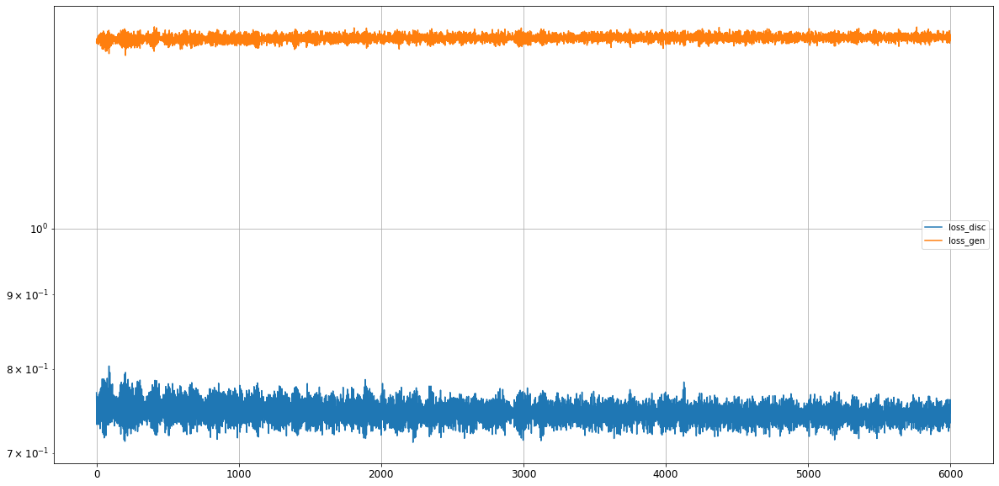

Epoch 6002/50000
discriminator loss: 1.360465 - generator loss: 0.725108 - 1s
Epoch 6003/50000
discriminator loss: 1.352904 - generator loss: 0.735975 - 1s
Epoch 6004/50000
discriminator loss: 1.368413 - generator loss: 0.740001 - 1s
Epoch 6005/50000
discriminator loss: 1.363670 - generator loss: 0.749747 - 1s
Epoch 6006/50000
discriminator loss: 1.357063 - generator loss: 0.751024 - 1s
Epoch 6007/50000
discriminator loss: 1.349472 - generator loss: 0.753081 - 1s
Epoch 6008/50000
discriminator loss: 1.358652 - generator loss: 0.735952 - 1s
Epoch 6009/50000
discriminator loss: 1.358443 - generator loss: 0.721008 - 1s
Epoch 6010/50000
discriminator loss: 1.346827 - generator loss: 0.747748 - 1s
Epoch 6011/50000
discriminator loss: 1.359885 - generator loss: 0.741973 - 1s
Epoch 6012/50000
discriminator loss: 1.366695 - generator loss: 0.749336 - 1s
Epoch 6013/50000
discriminator loss: 1.347516 - generator loss: 0.757366 - 1s
Epoch 6014/50000
discriminator loss: 1.341850 - generator loss: 

discriminator loss: 1.360357 - generator loss: 0.727165 - 1s
Epoch 6108/50000
discriminator loss: 1.340033 - generator loss: 0.749155 - 1s
Epoch 6109/50000
discriminator loss: 1.359541 - generator loss: 0.744347 - 1s
Epoch 6110/50000
discriminator loss: 1.367518 - generator loss: 0.735180 - 1s
Epoch 6111/50000
discriminator loss: 1.355866 - generator loss: 0.757038 - 1s
Epoch 6112/50000
discriminator loss: 1.350939 - generator loss: 0.755402 - 1s
Epoch 6113/50000
discriminator loss: 1.365263 - generator loss: 0.723848 - 1s
Epoch 6114/50000
discriminator loss: 1.355752 - generator loss: 0.732560 - 1s
Epoch 6115/50000
discriminator loss: 1.355313 - generator loss: 0.738319 - 1s
Epoch 6116/50000
discriminator loss: 1.354275 - generator loss: 0.747690 - 1s
Epoch 6117/50000
discriminator loss: 1.363830 - generator loss: 0.740503 - 1s
Epoch 6118/50000
discriminator loss: 1.353606 - generator loss: 0.752218 - 1s
Epoch 6119/50000
discriminator loss: 1.349546 - generator loss: 0.749125 - 1s
Epo

discriminator loss: 1.349612 - generator loss: 0.742401 - 1s
Epoch 6214/50000
discriminator loss: 1.359669 - generator loss: 0.743189 - 1s
Epoch 6215/50000
discriminator loss: 1.357647 - generator loss: 0.749998 - 1s
Epoch 6216/50000
discriminator loss: 1.349768 - generator loss: 0.756784 - 1s
Epoch 6217/50000
discriminator loss: 1.360430 - generator loss: 0.732436 - 1s
Epoch 6218/50000
discriminator loss: 1.346488 - generator loss: 0.741853 - 1s
Epoch 6219/50000
discriminator loss: 1.349662 - generator loss: 0.739146 - 1s
Epoch 6220/50000
discriminator loss: 1.343326 - generator loss: 0.748831 - 1s
Epoch 6221/50000
discriminator loss: 1.348164 - generator loss: 0.751514 - 1s
Epoch 6222/50000
discriminator loss: 1.357435 - generator loss: 0.744599 - 1s
Epoch 6223/50000
discriminator loss: 1.356447 - generator loss: 0.745325 - 1s
Epoch 6224/50000
discriminator loss: 1.347665 - generator loss: 0.745859 - 1s
Epoch 6225/50000
discriminator loss: 1.363378 - generator loss: 0.727292 - 1s
Epo

discriminator loss: 1.366577 - generator loss: 0.724725 - 1s
Epoch 6320/50000
discriminator loss: 1.353472 - generator loss: 0.736862 - 1s
Epoch 6321/50000
discriminator loss: 1.338423 - generator loss: 0.747671 - 1s
Epoch 6322/50000
discriminator loss: 1.361523 - generator loss: 0.737004 - 1s
Epoch 6323/50000
discriminator loss: 1.356192 - generator loss: 0.757502 - 1s
Epoch 6324/50000
discriminator loss: 1.353632 - generator loss: 0.764344 - 1s
Epoch 6325/50000
discriminator loss: 1.338146 - generator loss: 0.763409 - 1s
Epoch 6326/50000
discriminator loss: 1.370505 - generator loss: 0.723452 - 1s
Epoch 6327/50000
discriminator loss: 1.352378 - generator loss: 0.730184 - 1s
Epoch 6328/50000
discriminator loss: 1.340229 - generator loss: 0.750978 - 1s
Epoch 6329/50000
discriminator loss: 1.358299 - generator loss: 0.745885 - 1s
Epoch 6330/50000
discriminator loss: 1.361349 - generator loss: 0.754266 - 1s
Epoch 6331/50000
discriminator loss: 1.351431 - generator loss: 0.751913 - 1s
Epo

discriminator loss: 1.352565 - generator loss: 0.735340 - 1s
Epoch 6426/50000
discriminator loss: 1.354903 - generator loss: 0.736288 - 1s
Epoch 6427/50000
discriminator loss: 1.351096 - generator loss: 0.737599 - 1s
Epoch 6428/50000
discriminator loss: 1.356579 - generator loss: 0.752172 - 1s
Epoch 6429/50000
discriminator loss: 1.353959 - generator loss: 0.753963 - 1s
Epoch 6430/50000
discriminator loss: 1.348947 - generator loss: 0.760719 - 1s
Epoch 6431/50000
discriminator loss: 1.362058 - generator loss: 0.727789 - 1s
Epoch 6432/50000
discriminator loss: 1.352779 - generator loss: 0.733035 - 1s
Epoch 6433/50000
discriminator loss: 1.354785 - generator loss: 0.733881 - 1s
Epoch 6434/50000
discriminator loss: 1.351161 - generator loss: 0.747920 - 1s
Epoch 6435/50000
discriminator loss: 1.361311 - generator loss: 0.744158 - 1s
Epoch 6436/50000
discriminator loss: 1.347518 - generator loss: 0.763021 - 1s
Epoch 6437/50000
discriminator loss: 1.337691 - generator loss: 0.756067 - 1s
Epo

discriminator loss: 1.358220 - generator loss: 0.736456 - 1s
Epoch 6532/50000
discriminator loss: 1.348938 - generator loss: 0.739015 - 1s
Epoch 6533/50000
discriminator loss: 1.354258 - generator loss: 0.741587 - 1s
Epoch 6534/50000
discriminator loss: 1.355630 - generator loss: 0.745140 - 1s
Epoch 6535/50000
discriminator loss: 1.356906 - generator loss: 0.751990 - 1s
Epoch 6536/50000
discriminator loss: 1.346397 - generator loss: 0.756372 - 1s
Epoch 6537/50000
discriminator loss: 1.352690 - generator loss: 0.739261 - 1s
Epoch 6538/50000
discriminator loss: 1.359451 - generator loss: 0.732524 - 1s
Epoch 6539/50000
discriminator loss: 1.350990 - generator loss: 0.739763 - 1s
Epoch 6540/50000
discriminator loss: 1.346412 - generator loss: 0.744527 - 1s
Epoch 6541/50000
discriminator loss: 1.362694 - generator loss: 0.747564 - 1s
Epoch 6542/50000
discriminator loss: 1.354620 - generator loss: 0.742724 - 1s
Epoch 6543/50000
discriminator loss: 1.346833 - generator loss: 0.760714 - 1s
Epo

discriminator loss: 1.365656 - generator loss: 0.742969 - 1s
Epoch 6638/50000
discriminator loss: 1.353208 - generator loss: 0.754286 - 1s
Epoch 6639/50000
discriminator loss: 1.350432 - generator loss: 0.753263 - 1s
Epoch 6640/50000
discriminator loss: 1.366399 - generator loss: 0.728812 - 1s
Epoch 6641/50000
discriminator loss: 1.348149 - generator loss: 0.732562 - 1s
Epoch 6642/50000
discriminator loss: 1.346793 - generator loss: 0.750553 - 1s
Epoch 6643/50000
discriminator loss: 1.348726 - generator loss: 0.742953 - 1s
Epoch 6644/50000
discriminator loss: 1.363539 - generator loss: 0.741969 - 1s
Epoch 6645/50000
discriminator loss: 1.354739 - generator loss: 0.758156 - 1s
Epoch 6646/50000
discriminator loss: 1.341862 - generator loss: 0.759607 - 1s
Epoch 6647/50000
discriminator loss: 1.364779 - generator loss: 0.734142 - 1s
Epoch 6648/50000
discriminator loss: 1.361440 - generator loss: 0.717819 - 1s
Epoch 6649/50000
discriminator loss: 1.345097 - generator loss: 0.742929 - 1s
Epo

discriminator loss: 1.356379 - generator loss: 0.756568 - 1s
Epoch 6744/50000
discriminator loss: 1.344815 - generator loss: 0.760137 - 1s
Epoch 6745/50000
discriminator loss: 1.357554 - generator loss: 0.743733 - 1s
Epoch 6746/50000
discriminator loss: 1.368167 - generator loss: 0.728141 - 1s
Epoch 6747/50000
discriminator loss: 1.354124 - generator loss: 0.729277 - 1s
Epoch 6748/50000
discriminator loss: 1.351530 - generator loss: 0.741233 - 1s
Epoch 6749/50000
discriminator loss: 1.365726 - generator loss: 0.741983 - 1s
Epoch 6750/50000
discriminator loss: 1.361968 - generator loss: 0.748310 - 1s
Epoch 6751/50000
discriminator loss: 1.347992 - generator loss: 0.754705 - 1s
Epoch 6752/50000
discriminator loss: 1.349440 - generator loss: 0.752421 - 1s
Epoch 6753/50000
discriminator loss: 1.364159 - generator loss: 0.719923 - 1s
Epoch 6754/50000
discriminator loss: 1.357426 - generator loss: 0.731009 - 1s
Epoch 6755/50000
discriminator loss: 1.352905 - generator loss: 0.745778 - 1s
Epo

discriminator loss: 1.358727 - generator loss: 0.742453 - 1s
Epoch 6850/50000
discriminator loss: 1.357328 - generator loss: 0.744079 - 1s
Epoch 6851/50000
discriminator loss: 1.350996 - generator loss: 0.754195 - 1s
Epoch 6852/50000
discriminator loss: 1.357893 - generator loss: 0.743042 - 1s
Epoch 6853/50000
discriminator loss: 1.356733 - generator loss: 0.737434 - 1s
Epoch 6854/50000
discriminator loss: 1.357660 - generator loss: 0.731609 - 1s
Epoch 6855/50000
discriminator loss: 1.357286 - generator loss: 0.736811 - 1s
Epoch 6856/50000
discriminator loss: 1.356427 - generator loss: 0.741389 - 1s
Epoch 6857/50000
discriminator loss: 1.367970 - generator loss: 0.746959 - 1s
Epoch 6858/50000
discriminator loss: 1.349326 - generator loss: 0.752734 - 1s
Epoch 6859/50000
discriminator loss: 1.352533 - generator loss: 0.748442 - 1s
Epoch 6860/50000
discriminator loss: 1.361043 - generator loss: 0.735531 - 1s
Epoch 6861/50000
discriminator loss: 1.351085 - generator loss: 0.732899 - 1s
Epo

discriminator loss: 1.348221 - generator loss: 0.765284 - 1s
Epoch 6956/50000
discriminator loss: 1.346362 - generator loss: 0.755602 - 1s
Epoch 6957/50000
discriminator loss: 1.358671 - generator loss: 0.724379 - 1s
Epoch 6958/50000
discriminator loss: 1.355098 - generator loss: 0.730206 - 1s
Epoch 6959/50000
discriminator loss: 1.348199 - generator loss: 0.743463 - 1s
Epoch 6960/50000
discriminator loss: 1.348264 - generator loss: 0.744353 - 1s
Epoch 6961/50000
discriminator loss: 1.371165 - generator loss: 0.740803 - 1s
Epoch 6962/50000
discriminator loss: 1.357526 - generator loss: 0.755425 - 1s
Epoch 6963/50000
discriminator loss: 1.342739 - generator loss: 0.764018 - 1s
Epoch 6964/50000
discriminator loss: 1.367893 - generator loss: 0.728494 - 1s
Epoch 6965/50000
discriminator loss: 1.359699 - generator loss: 0.727440 - 1s
Epoch 6966/50000
discriminator loss: 1.341540 - generator loss: 0.738951 - 1s
Epoch 6967/50000
discriminator loss: 1.352965 - generator loss: 0.743317 - 1s
Epo

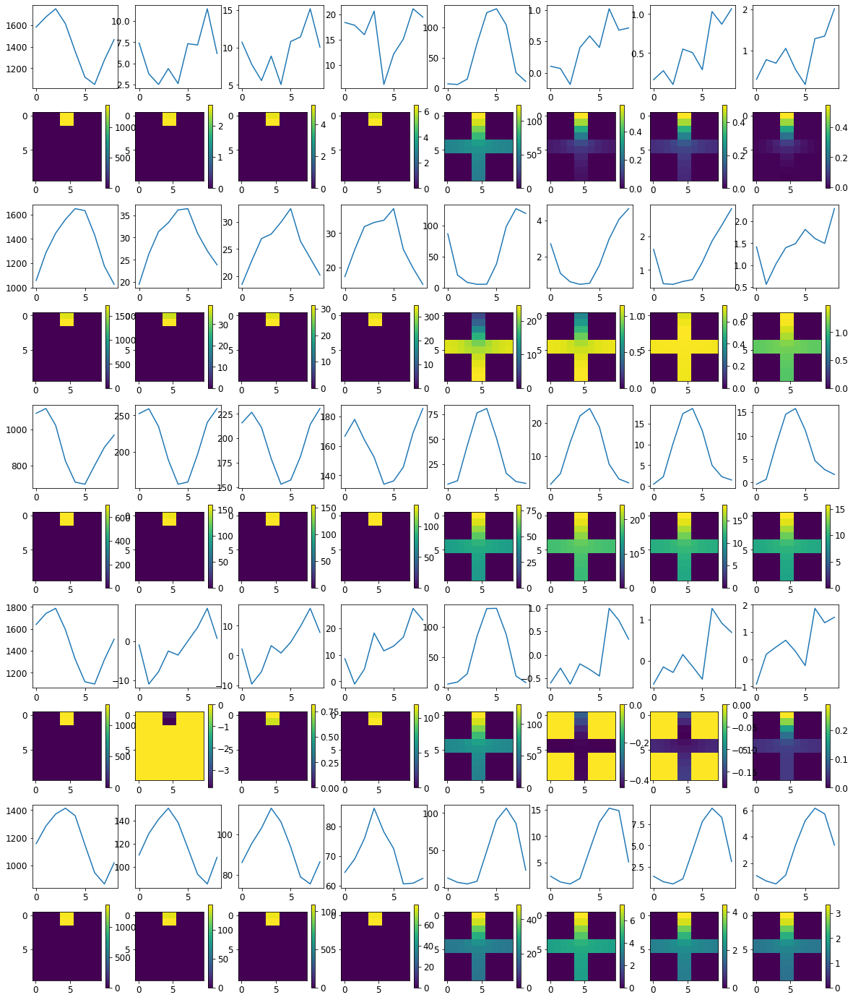

Loss: 


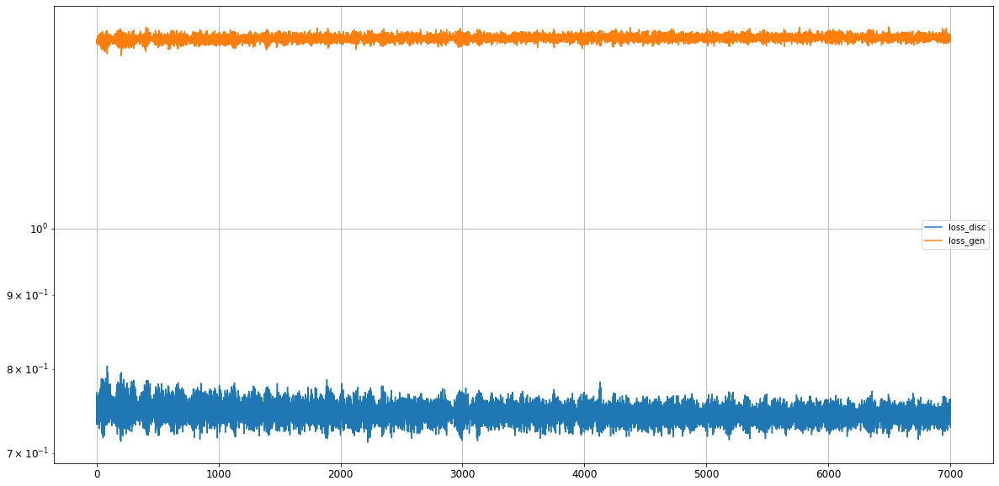

Epoch 7002/50000
discriminator loss: 1.352615 - generator loss: 0.734921 - 1s
Epoch 7003/50000
discriminator loss: 1.347525 - generator loss: 0.750553 - 1s
Epoch 7004/50000
discriminator loss: 1.363540 - generator loss: 0.732764 - 1s
Epoch 7005/50000
discriminator loss: 1.346734 - generator loss: 0.762013 - 1s
Epoch 7006/50000
discriminator loss: 1.344281 - generator loss: 0.761179 - 1s
Epoch 7007/50000
discriminator loss: 1.358663 - generator loss: 0.739150 - 1s
Epoch 7008/50000
discriminator loss: 1.369527 - generator loss: 0.720240 - 1s
Epoch 7009/50000
discriminator loss: 1.364713 - generator loss: 0.729401 - 1s
Epoch 7010/50000
discriminator loss: 1.345127 - generator loss: 0.744491 - 1s
Epoch 7011/50000
discriminator loss: 1.357923 - generator loss: 0.745409 - 1s
Epoch 7012/50000
discriminator loss: 1.355028 - generator loss: 0.753202 - 1s
Epoch 7013/50000
discriminator loss: 1.347868 - generator loss: 0.758469 - 1s
Epoch 7014/50000
discriminator loss: 1.346839 - generator loss: 

discriminator loss: 1.357366 - generator loss: 0.742719 - 1s
Epoch 7108/50000
discriminator loss: 1.356631 - generator loss: 0.726825 - 1s
Epoch 7109/50000
discriminator loss: 1.349068 - generator loss: 0.742979 - 1s
Epoch 7110/50000
discriminator loss: 1.353014 - generator loss: 0.744152 - 1s
Epoch 7111/50000
discriminator loss: 1.356563 - generator loss: 0.745742 - 1s
Epoch 7112/50000
discriminator loss: 1.358109 - generator loss: 0.744716 - 1s
Epoch 7113/50000
discriminator loss: 1.348225 - generator loss: 0.761289 - 1s
Epoch 7114/50000
discriminator loss: 1.359179 - generator loss: 0.738774 - 1s
Epoch 7115/50000
discriminator loss: 1.362761 - generator loss: 0.729156 - 1s
Epoch 7116/50000
discriminator loss: 1.350883 - generator loss: 0.735844 - 1s
Epoch 7117/50000
discriminator loss: 1.351536 - generator loss: 0.744823 - 1s
Epoch 7118/50000
discriminator loss: 1.358902 - generator loss: 0.746886 - 1s
Epoch 7119/50000
discriminator loss: 1.347990 - generator loss: 0.757254 - 1s
Epo

discriminator loss: 1.355752 - generator loss: 0.729431 - 1s
Epoch 7214/50000
discriminator loss: 1.351241 - generator loss: 0.744254 - 1s
Epoch 7215/50000
discriminator loss: 1.363172 - generator loss: 0.740602 - 1s
Epoch 7216/50000
discriminator loss: 1.362366 - generator loss: 0.743032 - 1s
Epoch 7217/50000
discriminator loss: 1.349579 - generator loss: 0.757148 - 1s
Epoch 7218/50000
discriminator loss: 1.351351 - generator loss: 0.763267 - 1s
Epoch 7219/50000
discriminator loss: 1.373879 - generator loss: 0.717049 - 1s
Epoch 7220/50000
discriminator loss: 1.348891 - generator loss: 0.737990 - 1s
Epoch 7221/50000
discriminator loss: 1.353216 - generator loss: 0.748376 - 1s
Epoch 7222/50000
discriminator loss: 1.347717 - generator loss: 0.752803 - 1s
Epoch 7223/50000
discriminator loss: 1.365478 - generator loss: 0.739488 - 1s
Epoch 7224/50000
discriminator loss: 1.336907 - generator loss: 0.769017 - 1s
Epoch 7225/50000
discriminator loss: 1.351046 - generator loss: 0.753390 - 1s
Epo

discriminator loss: 1.356373 - generator loss: 0.727464 - 1s
Epoch 7320/50000
discriminator loss: 1.354920 - generator loss: 0.739774 - 1s
Epoch 7321/50000
discriminator loss: 1.354731 - generator loss: 0.741871 - 1s
Epoch 7322/50000
discriminator loss: 1.362215 - generator loss: 0.744007 - 1s
Epoch 7323/50000
discriminator loss: 1.346927 - generator loss: 0.761917 - 1s
Epoch 7324/50000
discriminator loss: 1.353403 - generator loss: 0.744021 - 1s
Epoch 7325/50000
discriminator loss: 1.369113 - generator loss: 0.726968 - 1s
Epoch 7326/50000
discriminator loss: 1.355729 - generator loss: 0.737417 - 1s
Epoch 7327/50000
discriminator loss: 1.352039 - generator loss: 0.750297 - 1s
Epoch 7328/50000
discriminator loss: 1.353384 - generator loss: 0.734225 - 1s
Epoch 7329/50000
discriminator loss: 1.359093 - generator loss: 0.747924 - 1s
Epoch 7330/50000
discriminator loss: 1.346692 - generator loss: 0.768968 - 1s
Epoch 7331/50000
discriminator loss: 1.358769 - generator loss: 0.747783 - 1s
Epo

discriminator loss: 1.350244 - generator loss: 0.742792 - 1s
Epoch 7426/50000
discriminator loss: 1.355418 - generator loss: 0.736147 - 1s
Epoch 7427/50000
discriminator loss: 1.346706 - generator loss: 0.755877 - 1s
Epoch 7428/50000
discriminator loss: 1.357166 - generator loss: 0.754274 - 1s
Epoch 7429/50000
discriminator loss: 1.360305 - generator loss: 0.742506 - 1s
Epoch 7430/50000
discriminator loss: 1.359209 - generator loss: 0.734134 - 1s
Epoch 7431/50000
discriminator loss: 1.359293 - generator loss: 0.737422 - 1s
Epoch 7432/50000
discriminator loss: 1.351465 - generator loss: 0.733365 - 1s
Epoch 7433/50000
discriminator loss: 1.354883 - generator loss: 0.746488 - 1s
Epoch 7434/50000
discriminator loss: 1.363412 - generator loss: 0.738052 - 1s
Epoch 7435/50000
discriminator loss: 1.353347 - generator loss: 0.750929 - 1s
Epoch 7436/50000
discriminator loss: 1.351722 - generator loss: 0.755854 - 1s
Epoch 7437/50000
discriminator loss: 1.363903 - generator loss: 0.734566 - 1s
Epo

discriminator loss: 1.343375 - generator loss: 0.746355 - 1s
Epoch 7532/50000
discriminator loss: 1.355273 - generator loss: 0.741968 - 1s
Epoch 7533/50000
discriminator loss: 1.358561 - generator loss: 0.746455 - 1s
Epoch 7534/50000
discriminator loss: 1.350660 - generator loss: 0.758999 - 1s
Epoch 7535/50000
discriminator loss: 1.354389 - generator loss: 0.746037 - 1s
Epoch 7536/50000
discriminator loss: 1.360686 - generator loss: 0.738026 - 1s
Epoch 7537/50000
discriminator loss: 1.358792 - generator loss: 0.726801 - 1s
Epoch 7538/50000
discriminator loss: 1.351065 - generator loss: 0.740267 - 1s
Epoch 7539/50000
discriminator loss: 1.348208 - generator loss: 0.748709 - 1s
Epoch 7540/50000
discriminator loss: 1.359516 - generator loss: 0.744218 - 1s
Epoch 7541/50000
discriminator loss: 1.356137 - generator loss: 0.752573 - 1s
Epoch 7542/50000
discriminator loss: 1.348992 - generator loss: 0.753451 - 1s
Epoch 7543/50000
discriminator loss: 1.359362 - generator loss: 0.729931 - 1s
Epo

discriminator loss: 1.345449 - generator loss: 0.745109 - 1s
Epoch 7638/50000
discriminator loss: 1.361454 - generator loss: 0.740957 - 1s
Epoch 7639/50000
discriminator loss: 1.359176 - generator loss: 0.746853 - 1s
Epoch 7640/50000
discriminator loss: 1.356375 - generator loss: 0.752163 - 1s
Epoch 7641/50000
discriminator loss: 1.347591 - generator loss: 0.751216 - 1s
Epoch 7642/50000
discriminator loss: 1.355760 - generator loss: 0.731752 - 1s
Epoch 7643/50000
discriminator loss: 1.361343 - generator loss: 0.733012 - 1s
Epoch 7644/50000
discriminator loss: 1.340531 - generator loss: 0.740954 - 1s
Epoch 7645/50000
discriminator loss: 1.347636 - generator loss: 0.748564 - 1s
Epoch 7646/50000
discriminator loss: 1.362618 - generator loss: 0.748295 - 1s
Epoch 7647/50000
discriminator loss: 1.355441 - generator loss: 0.752817 - 1s
Epoch 7648/50000
discriminator loss: 1.338457 - generator loss: 0.756397 - 1s
Epoch 7649/50000
discriminator loss: 1.356263 - generator loss: 0.733697 - 1s
Epo

discriminator loss: 1.357098 - generator loss: 0.727755 - 1s
Epoch 7744/50000
discriminator loss: 1.353599 - generator loss: 0.745740 - 1s
Epoch 7745/50000
discriminator loss: 1.343470 - generator loss: 0.743207 - 1s
Epoch 7746/50000
discriminator loss: 1.358788 - generator loss: 0.743688 - 1s
Epoch 7747/50000
discriminator loss: 1.359519 - generator loss: 0.751953 - 1s
Epoch 7748/50000
discriminator loss: 1.349474 - generator loss: 0.757512 - 1s
Epoch 7749/50000
discriminator loss: 1.352290 - generator loss: 0.741645 - 1s
Epoch 7750/50000
discriminator loss: 1.366034 - generator loss: 0.729391 - 1s
Epoch 7751/50000
discriminator loss: 1.352316 - generator loss: 0.736648 - 1s
Epoch 7752/50000
discriminator loss: 1.347975 - generator loss: 0.741760 - 1s
Epoch 7753/50000
discriminator loss: 1.348497 - generator loss: 0.748867 - 1s
Epoch 7754/50000
discriminator loss: 1.357538 - generator loss: 0.748134 - 1s
Epoch 7755/50000
discriminator loss: 1.343374 - generator loss: 0.757883 - 1s
Epo

discriminator loss: 1.347283 - generator loss: 0.749005 - 1s
Epoch 7850/50000
discriminator loss: 1.360439 - generator loss: 0.734583 - 1s
Epoch 7851/50000
discriminator loss: 1.351803 - generator loss: 0.733024 - 1s
Epoch 7852/50000
discriminator loss: 1.349403 - generator loss: 0.739085 - 1s
Epoch 7853/50000
discriminator loss: 1.354308 - generator loss: 0.743473 - 1s
Epoch 7854/50000
discriminator loss: 1.358694 - generator loss: 0.744038 - 1s
Epoch 7855/50000
discriminator loss: 1.352724 - generator loss: 0.750035 - 1s
Epoch 7856/50000
discriminator loss: 1.349123 - generator loss: 0.759248 - 1s
Epoch 7857/50000
discriminator loss: 1.355261 - generator loss: 0.740626 - 1s
Epoch 7858/50000
discriminator loss: 1.355785 - generator loss: 0.728265 - 1s
Epoch 7859/50000
discriminator loss: 1.341882 - generator loss: 0.741704 - 1s
Epoch 7860/50000
discriminator loss: 1.343601 - generator loss: 0.755374 - 1s
Epoch 7861/50000
discriminator loss: 1.363970 - generator loss: 0.738002 - 1s
Epo

discriminator loss: 1.356019 - generator loss: 0.746349 - 1s
Epoch 7956/50000
discriminator loss: 1.357706 - generator loss: 0.737917 - 1s
Epoch 7957/50000
discriminator loss: 1.352425 - generator loss: 0.755203 - 1s
Epoch 7958/50000
discriminator loss: 1.354533 - generator loss: 0.746220 - 1s
Epoch 7959/50000
discriminator loss: 1.354704 - generator loss: 0.741299 - 1s
Epoch 7960/50000
discriminator loss: 1.368001 - generator loss: 0.725109 - 1s
Epoch 7961/50000
discriminator loss: 1.359757 - generator loss: 0.734030 - 1s
Epoch 7962/50000
discriminator loss: 1.355085 - generator loss: 0.741436 - 1s
Epoch 7963/50000
discriminator loss: 1.360163 - generator loss: 0.747102 - 1s
Epoch 7964/50000
discriminator loss: 1.364387 - generator loss: 0.746555 - 1s
Epoch 7965/50000
discriminator loss: 1.356874 - generator loss: 0.741941 - 1s
Epoch 7966/50000
discriminator loss: 1.357353 - generator loss: 0.739044 - 1s
Epoch 7967/50000
discriminator loss: 1.361539 - generator loss: 0.736714 - 1s
Epo

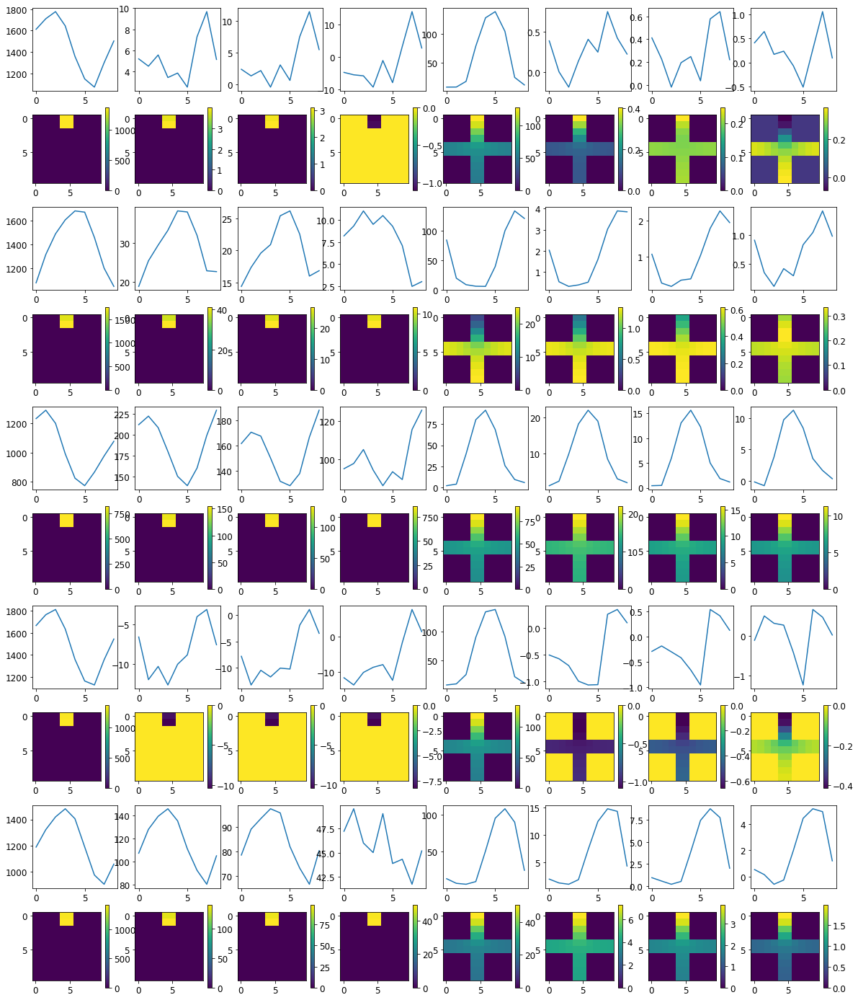

Loss: 


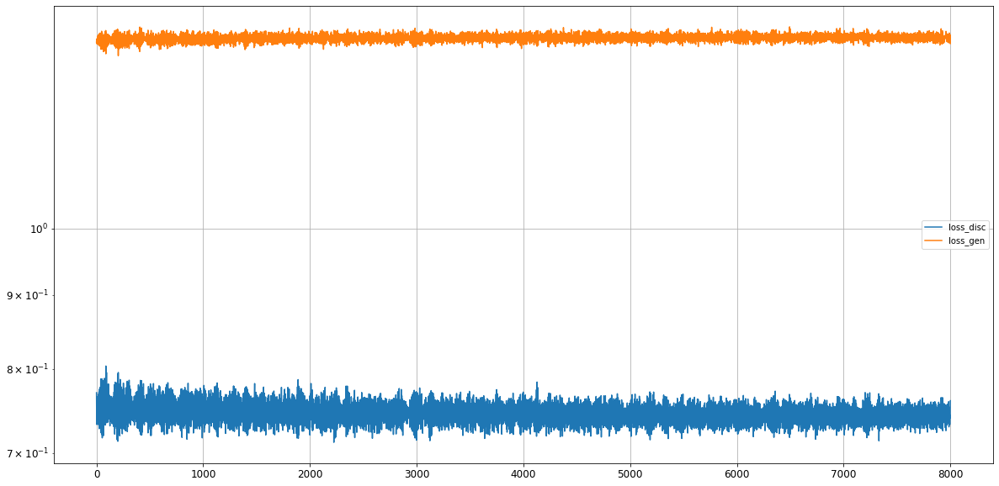

Epoch 8002/50000
discriminator loss: 1.361305 - generator loss: 0.729865 - 1s
Epoch 8003/50000
discriminator loss: 1.354217 - generator loss: 0.731881 - 1s
Epoch 8004/50000
discriminator loss: 1.349954 - generator loss: 0.745784 - 1s
Epoch 8005/50000
discriminator loss: 1.356423 - generator loss: 0.746770 - 1s
Epoch 8006/50000
discriminator loss: 1.360252 - generator loss: 0.740358 - 1s
Epoch 8007/50000
discriminator loss: 1.353544 - generator loss: 0.753870 - 1s
Epoch 8008/50000
discriminator loss: 1.341336 - generator loss: 0.754569 - 1s
Epoch 8009/50000
discriminator loss: 1.364568 - generator loss: 0.736408 - 1s
Epoch 8010/50000
discriminator loss: 1.354573 - generator loss: 0.731453 - 1s
Epoch 8011/50000
discriminator loss: 1.348807 - generator loss: 0.736408 - 1s
Epoch 8012/50000
discriminator loss: 1.354019 - generator loss: 0.749041 - 1s
Epoch 8013/50000
discriminator loss: 1.349886 - generator loss: 0.754723 - 1s
Epoch 8014/50000
discriminator loss: 1.350578 - generator loss: 

discriminator loss: 1.364588 - generator loss: 0.750639 - 1s
Epoch 8108/50000
discriminator loss: 1.355808 - generator loss: 0.758284 - 1s
Epoch 8109/50000
discriminator loss: 1.344223 - generator loss: 0.756540 - 1s
Epoch 8110/50000
discriminator loss: 1.356652 - generator loss: 0.734618 - 1s
Epoch 8111/50000
discriminator loss: 1.360975 - generator loss: 0.727155 - 1s
Epoch 8112/50000
discriminator loss: 1.349800 - generator loss: 0.748035 - 1s
Epoch 8113/50000
discriminator loss: 1.351053 - generator loss: 0.744854 - 1s
Epoch 8114/50000
discriminator loss: 1.360849 - generator loss: 0.743018 - 1s
Epoch 8115/50000
discriminator loss: 1.362894 - generator loss: 0.744616 - 1s
Epoch 8116/50000
discriminator loss: 1.349094 - generator loss: 0.764442 - 1s
Epoch 8117/50000
discriminator loss: 1.357610 - generator loss: 0.741850 - 1s
Epoch 8118/50000
discriminator loss: 1.356754 - generator loss: 0.733517 - 1s
Epoch 8119/50000
discriminator loss: 1.354816 - generator loss: 0.737080 - 1s
Epo

discriminator loss: 1.349985 - generator loss: 0.745172 - 1s
Epoch 8214/50000
discriminator loss: 1.358866 - generator loss: 0.744103 - 1s
Epoch 8215/50000
discriminator loss: 1.355840 - generator loss: 0.755031 - 1s
Epoch 8216/50000
discriminator loss: 1.344921 - generator loss: 0.754529 - 1s
Epoch 8217/50000
discriminator loss: 1.357606 - generator loss: 0.735737 - 1s
Epoch 8218/50000
discriminator loss: 1.361212 - generator loss: 0.727613 - 1s
Epoch 8219/50000
discriminator loss: 1.352657 - generator loss: 0.739542 - 1s
Epoch 8220/50000
discriminator loss: 1.346260 - generator loss: 0.743776 - 1s
Epoch 8221/50000
discriminator loss: 1.367007 - generator loss: 0.746063 - 1s
Epoch 8222/50000
discriminator loss: 1.354298 - generator loss: 0.749591 - 1s
Epoch 8223/50000
discriminator loss: 1.356659 - generator loss: 0.751291 - 1s
Epoch 8224/50000
discriminator loss: 1.364100 - generator loss: 0.743570 - 1s
Epoch 8225/50000
discriminator loss: 1.355705 - generator loss: 0.726378 - 1s
Epo

discriminator loss: 1.356791 - generator loss: 0.736192 - 1s
Epoch 8320/50000
discriminator loss: 1.352092 - generator loss: 0.737235 - 1s
Epoch 8321/50000
discriminator loss: 1.342957 - generator loss: 0.744152 - 1s
Epoch 8322/50000
discriminator loss: 1.353308 - generator loss: 0.747957 - 1s
Epoch 8323/50000
discriminator loss: 1.359748 - generator loss: 0.744530 - 1s
Epoch 8324/50000
discriminator loss: 1.347992 - generator loss: 0.758465 - 1s
Epoch 8325/50000
discriminator loss: 1.349084 - generator loss: 0.752994 - 1s
Epoch 8326/50000
discriminator loss: 1.350761 - generator loss: 0.745231 - 1s
Epoch 8327/50000
discriminator loss: 1.358346 - generator loss: 0.724848 - 1s
Epoch 8328/50000
discriminator loss: 1.351182 - generator loss: 0.738659 - 1s
Epoch 8329/50000
discriminator loss: 1.349449 - generator loss: 0.743375 - 1s
Epoch 8330/50000
discriminator loss: 1.359198 - generator loss: 0.750869 - 1s
Epoch 8331/50000
discriminator loss: 1.358819 - generator loss: 0.740139 - 1s
Epo

discriminator loss: 1.360091 - generator loss: 0.743170 - 1s
Epoch 8426/50000
discriminator loss: 1.357529 - generator loss: 0.750181 - 1s
Epoch 8427/50000
discriminator loss: 1.360704 - generator loss: 0.745272 - 1s
Epoch 8428/50000
discriminator loss: 1.352945 - generator loss: 0.749952 - 1s
Epoch 8429/50000
discriminator loss: 1.355888 - generator loss: 0.742983 - 1s
Epoch 8430/50000
discriminator loss: 1.361933 - generator loss: 0.732255 - 1s
Epoch 8431/50000
discriminator loss: 1.363687 - generator loss: 0.731963 - 1s
Epoch 8432/50000
discriminator loss: 1.356510 - generator loss: 0.742135 - 1s
Epoch 8433/50000
discriminator loss: 1.357323 - generator loss: 0.743731 - 1s
Epoch 8434/50000
discriminator loss: 1.360225 - generator loss: 0.749536 - 1s
Epoch 8435/50000
discriminator loss: 1.337835 - generator loss: 0.767193 - 1s
Epoch 8436/50000
discriminator loss: 1.355687 - generator loss: 0.747287 - 1s
Epoch 8437/50000
discriminator loss: 1.358925 - generator loss: 0.733322 - 1s
Epo

discriminator loss: 1.364587 - generator loss: 0.731116 - 1s
Epoch 8532/50000
discriminator loss: 1.354761 - generator loss: 0.728346 - 1s
Epoch 8533/50000
discriminator loss: 1.344367 - generator loss: 0.753339 - 1s
Epoch 8534/50000
discriminator loss: 1.367203 - generator loss: 0.737108 - 1s
Epoch 8535/50000
discriminator loss: 1.355347 - generator loss: 0.755833 - 1s
Epoch 8536/50000
discriminator loss: 1.346344 - generator loss: 0.761634 - 1s
Epoch 8537/50000
discriminator loss: 1.354579 - generator loss: 0.739257 - 1s
Epoch 8538/50000
discriminator loss: 1.367063 - generator loss: 0.724804 - 1s
Epoch 8539/50000
discriminator loss: 1.354206 - generator loss: 0.733531 - 1s
Epoch 8540/50000
discriminator loss: 1.344082 - generator loss: 0.744727 - 1s
Epoch 8541/50000
discriminator loss: 1.363102 - generator loss: 0.740559 - 1s
Epoch 8542/50000
discriminator loss: 1.365251 - generator loss: 0.742953 - 1s
Epoch 8543/50000
discriminator loss: 1.348389 - generator loss: 0.764872 - 1s
Epo

discriminator loss: 1.346679 - generator loss: 0.748169 - 1s
Epoch 8638/50000
discriminator loss: 1.360300 - generator loss: 0.746277 - 1s
Epoch 8639/50000
discriminator loss: 1.358486 - generator loss: 0.743384 - 1s
Epoch 8640/50000
discriminator loss: 1.358818 - generator loss: 0.750131 - 1s
Epoch 8641/50000
discriminator loss: 1.350308 - generator loss: 0.749750 - 1s
Epoch 8642/50000
discriminator loss: 1.357907 - generator loss: 0.734086 - 1s
Epoch 8643/50000
discriminator loss: 1.351959 - generator loss: 0.737039 - 1s
Epoch 8644/50000
discriminator loss: 1.346699 - generator loss: 0.740567 - 1s
Epoch 8645/50000
discriminator loss: 1.357557 - generator loss: 0.745447 - 1s
Epoch 8646/50000
discriminator loss: 1.353848 - generator loss: 0.749963 - 1s
Epoch 8647/50000
discriminator loss: 1.357992 - generator loss: 0.750934 - 1s
Epoch 8648/50000
discriminator loss: 1.357298 - generator loss: 0.742676 - 1s
Epoch 8649/50000
discriminator loss: 1.356874 - generator loss: 0.734818 - 1s
Epo

discriminator loss: 1.350973 - generator loss: 0.758242 - 1s
Epoch 8744/50000
discriminator loss: 1.356104 - generator loss: 0.738810 - 1s
Epoch 8745/50000
discriminator loss: 1.360336 - generator loss: 0.729788 - 1s
Epoch 8746/50000
discriminator loss: 1.352304 - generator loss: 0.739254 - 1s
Epoch 8747/50000
discriminator loss: 1.344233 - generator loss: 0.749519 - 1s
Epoch 8748/50000
discriminator loss: 1.355351 - generator loss: 0.739768 - 1s
Epoch 8749/50000
discriminator loss: 1.365735 - generator loss: 0.737161 - 1s
Epoch 8750/50000
discriminator loss: 1.347663 - generator loss: 0.762257 - 1s
Epoch 8751/50000
discriminator loss: 1.346418 - generator loss: 0.748963 - 1s
Epoch 8752/50000
discriminator loss: 1.361215 - generator loss: 0.736194 - 1s
Epoch 8753/50000
discriminator loss: 1.360457 - generator loss: 0.722345 - 1s
Epoch 8754/50000
discriminator loss: 1.352684 - generator loss: 0.735681 - 1s
Epoch 8755/50000
discriminator loss: 1.345976 - generator loss: 0.753808 - 1s
Epo

discriminator loss: 1.360022 - generator loss: 0.734922 - 1s
Epoch 8850/50000
discriminator loss: 1.349470 - generator loss: 0.743705 - 1s
Epoch 8851/50000
discriminator loss: 1.350359 - generator loss: 0.745615 - 1s
Epoch 8852/50000
discriminator loss: 1.356191 - generator loss: 0.746604 - 1s
Epoch 8853/50000
discriminator loss: 1.357342 - generator loss: 0.750770 - 1s
Epoch 8854/50000
discriminator loss: 1.347675 - generator loss: 0.750800 - 1s
Epoch 8855/50000
discriminator loss: 1.354578 - generator loss: 0.746274 - 1s
Epoch 8856/50000
discriminator loss: 1.360477 - generator loss: 0.730502 - 1s
Epoch 8857/50000
discriminator loss: 1.348930 - generator loss: 0.733835 - 1s
Epoch 8858/50000
discriminator loss: 1.359184 - generator loss: 0.736552 - 1s
Epoch 8859/50000
discriminator loss: 1.367040 - generator loss: 0.745381 - 1s
Epoch 8860/50000
discriminator loss: 1.356843 - generator loss: 0.751148 - 1s
Epoch 8861/50000
discriminator loss: 1.354085 - generator loss: 0.756937 - 1s
Epo

discriminator loss: 1.346991 - generator loss: 0.744402 - 1s
Epoch 8956/50000
discriminator loss: 1.357438 - generator loss: 0.744365 - 1s
Epoch 8957/50000
discriminator loss: 1.352353 - generator loss: 0.749632 - 1s
Epoch 8958/50000
discriminator loss: 1.349893 - generator loss: 0.751745 - 1s
Epoch 8959/50000
discriminator loss: 1.349895 - generator loss: 0.747708 - 1s
Epoch 8960/50000
discriminator loss: 1.358019 - generator loss: 0.729317 - 1s
Epoch 8961/50000
discriminator loss: 1.351730 - generator loss: 0.741786 - 1s
Epoch 8962/50000
discriminator loss: 1.346658 - generator loss: 0.741356 - 1s
Epoch 8963/50000
discriminator loss: 1.361474 - generator loss: 0.736902 - 1s
Epoch 8964/50000
discriminator loss: 1.354269 - generator loss: 0.758315 - 1s
Epoch 8965/50000
discriminator loss: 1.354858 - generator loss: 0.750996 - 1s
Epoch 8966/50000
discriminator loss: 1.354757 - generator loss: 0.747407 - 1s
Epoch 8967/50000
discriminator loss: 1.358941 - generator loss: 0.733859 - 1s
Epo

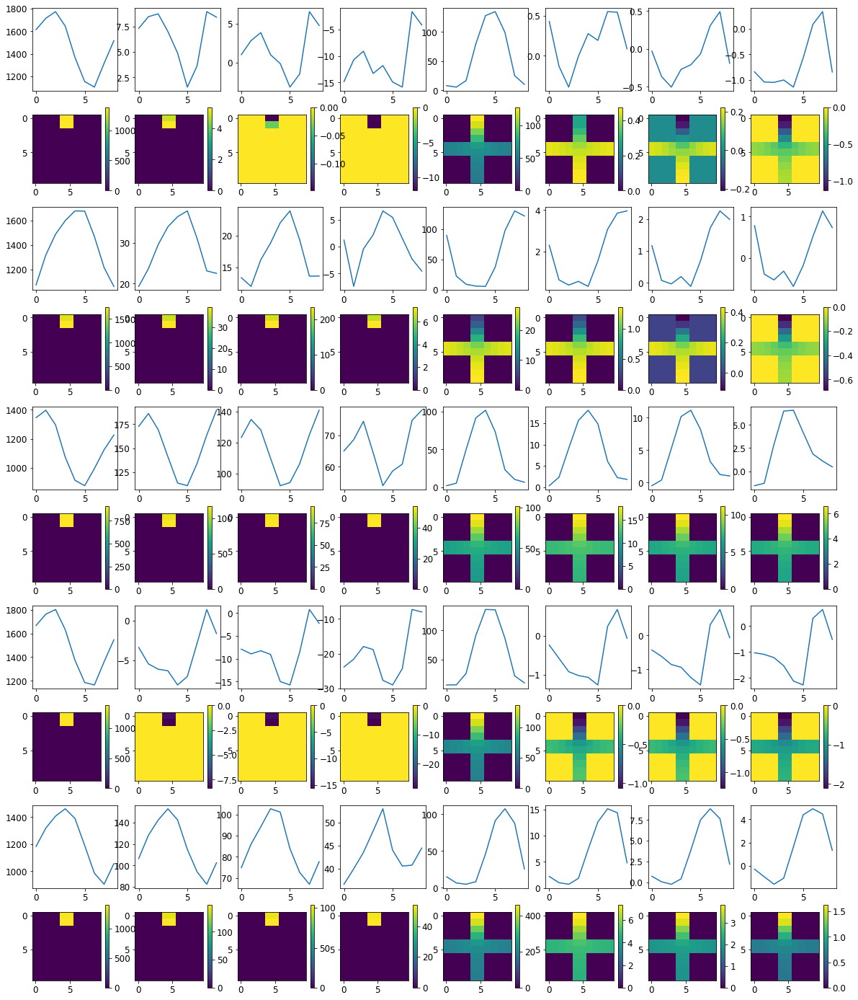

Loss: 


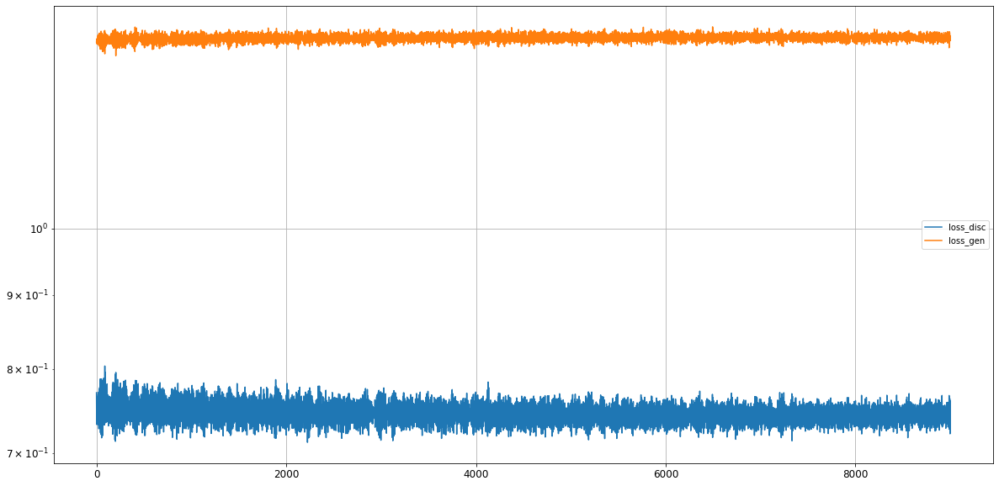

Epoch 9002/50000
discriminator loss: 1.360763 - generator loss: 0.747857 - 1s
Epoch 9003/50000
discriminator loss: 1.334107 - generator loss: 0.757750 - 1s
Epoch 9004/50000
discriminator loss: 1.357755 - generator loss: 0.739702 - 1s
Epoch 9005/50000
discriminator loss: 1.362284 - generator loss: 0.730221 - 1s
Epoch 9006/50000
discriminator loss: 1.348251 - generator loss: 0.737198 - 1s
Epoch 9007/50000
discriminator loss: 1.348812 - generator loss: 0.742671 - 1s
Epoch 9008/50000
discriminator loss: 1.358850 - generator loss: 0.750939 - 1s
Epoch 9009/50000
discriminator loss: 1.363460 - generator loss: 0.738923 - 1s
Epoch 9010/50000
discriminator loss: 1.357789 - generator loss: 0.758878 - 1s
Epoch 9011/50000
discriminator loss: 1.349701 - generator loss: 0.747911 - 1s
Epoch 9012/50000
discriminator loss: 1.357061 - generator loss: 0.735922 - 1s
Epoch 9013/50000
discriminator loss: 1.358503 - generator loss: 0.729121 - 1s
Epoch 9014/50000
discriminator loss: 1.352860 - generator loss: 

discriminator loss: 1.359316 - generator loss: 0.744944 - 1s
Epoch 9108/50000
discriminator loss: 1.353242 - generator loss: 0.753328 - 1s
Epoch 9109/50000
discriminator loss: 1.358301 - generator loss: 0.735743 - 1s
Epoch 9110/50000
discriminator loss: 1.351075 - generator loss: 0.736213 - 1s
Epoch 9111/50000
discriminator loss: 1.348722 - generator loss: 0.738287 - 1s
Epoch 9112/50000
discriminator loss: 1.360168 - generator loss: 0.747372 - 1s
Epoch 9113/50000
discriminator loss: 1.357509 - generator loss: 0.747494 - 1s
Epoch 9114/50000
discriminator loss: 1.363576 - generator loss: 0.742475 - 1s
Epoch 9115/50000
discriminator loss: 1.342962 - generator loss: 0.755192 - 1s
Epoch 9116/50000
discriminator loss: 1.355095 - generator loss: 0.741500 - 1s
Epoch 9117/50000
discriminator loss: 1.354701 - generator loss: 0.735459 - 1s
Epoch 9118/50000
discriminator loss: 1.349033 - generator loss: 0.735842 - 1s
Epoch 9119/50000
discriminator loss: 1.351008 - generator loss: 0.749408 - 1s
Epo

discriminator loss: 1.357161 - generator loss: 0.726597 - 1s
Epoch 9214/50000
discriminator loss: 1.337136 - generator loss: 0.753421 - 1s
Epoch 9215/50000
discriminator loss: 1.343812 - generator loss: 0.753968 - 1s
Epoch 9216/50000
discriminator loss: 1.350890 - generator loss: 0.741433 - 1s
Epoch 9217/50000
discriminator loss: 1.355581 - generator loss: 0.746382 - 1s
Epoch 9218/50000
discriminator loss: 1.351065 - generator loss: 0.755972 - 1s
Epoch 9219/50000
discriminator loss: 1.349908 - generator loss: 0.744132 - 1s
Epoch 9220/50000
discriminator loss: 1.351466 - generator loss: 0.739606 - 1s
Epoch 9221/50000
discriminator loss: 1.357380 - generator loss: 0.727167 - 1s
Epoch 9222/50000
discriminator loss: 1.347503 - generator loss: 0.744105 - 1s
Epoch 9223/50000
discriminator loss: 1.351146 - generator loss: 0.749586 - 1s
Epoch 9224/50000
discriminator loss: 1.351232 - generator loss: 0.752977 - 1s
Epoch 9225/50000
discriminator loss: 1.353433 - generator loss: 0.753484 - 1s
Epo

discriminator loss: 1.358173 - generator loss: 0.732771 - 1s
Epoch 9320/50000
discriminator loss: 1.341516 - generator loss: 0.742522 - 1s
Epoch 9321/50000
discriminator loss: 1.351378 - generator loss: 0.739844 - 1s
Epoch 9322/50000
discriminator loss: 1.356441 - generator loss: 0.748522 - 1s
Epoch 9323/50000
discriminator loss: 1.361897 - generator loss: 0.748253 - 1s
Epoch 9324/50000
discriminator loss: 1.346658 - generator loss: 0.755504 - 1s
Epoch 9325/50000
discriminator loss: 1.350495 - generator loss: 0.743865 - 1s
Epoch 9326/50000
discriminator loss: 1.355399 - generator loss: 0.742608 - 1s
Epoch 9327/50000
discriminator loss: 1.359171 - generator loss: 0.729041 - 1s
Epoch 9328/50000
discriminator loss: 1.351919 - generator loss: 0.732950 - 1s
Epoch 9329/50000
discriminator loss: 1.353532 - generator loss: 0.745210 - 1s
Epoch 9330/50000
discriminator loss: 1.352903 - generator loss: 0.748631 - 1s
Epoch 9331/50000
discriminator loss: 1.356521 - generator loss: 0.751208 - 1s
Epo

discriminator loss: 1.360584 - generator loss: 0.727518 - 1s
Epoch 9426/50000
discriminator loss: 1.345631 - generator loss: 0.739400 - 1s
Epoch 9427/50000
discriminator loss: 1.346495 - generator loss: 0.750178 - 1s
Epoch 9428/50000
discriminator loss: 1.366481 - generator loss: 0.742667 - 1s
Epoch 9429/50000
discriminator loss: 1.359104 - generator loss: 0.744327 - 1s
Epoch 9430/50000
discriminator loss: 1.346322 - generator loss: 0.757455 - 1s
Epoch 9431/50000
discriminator loss: 1.356300 - generator loss: 0.740905 - 1s
Epoch 9432/50000
discriminator loss: 1.356174 - generator loss: 0.733314 - 1s
Epoch 9433/50000
discriminator loss: 1.347646 - generator loss: 0.739064 - 1s
Epoch 9434/50000
discriminator loss: 1.353945 - generator loss: 0.745711 - 1s
Epoch 9435/50000
discriminator loss: 1.358277 - generator loss: 0.744125 - 1s
Epoch 9436/50000
discriminator loss: 1.353613 - generator loss: 0.749190 - 1s
Epoch 9437/50000
discriminator loss: 1.347731 - generator loss: 0.755557 - 1s
Epo

discriminator loss: 1.360464 - generator loss: 0.730306 - 1s
Epoch 9532/50000
discriminator loss: 1.349498 - generator loss: 0.734288 - 1s
Epoch 9533/50000
discriminator loss: 1.354331 - generator loss: 0.743802 - 1s
Epoch 9534/50000
discriminator loss: 1.349855 - generator loss: 0.743058 - 1s
Epoch 9535/50000
discriminator loss: 1.360321 - generator loss: 0.749712 - 1s
Epoch 9536/50000
discriminator loss: 1.355384 - generator loss: 0.753396 - 1s
Epoch 9537/50000
discriminator loss: 1.352035 - generator loss: 0.741959 - 1s
Epoch 9538/50000
discriminator loss: 1.349853 - generator loss: 0.746500 - 1s
Epoch 9539/50000
discriminator loss: 1.350800 - generator loss: 0.737040 - 1s
Epoch 9540/50000
discriminator loss: 1.346177 - generator loss: 0.736348 - 1s
Epoch 9541/50000
discriminator loss: 1.353964 - generator loss: 0.750150 - 1s
Epoch 9542/50000
discriminator loss: 1.358955 - generator loss: 0.749162 - 1s
Epoch 9543/50000
discriminator loss: 1.365271 - generator loss: 0.743588 - 1s
Epo

discriminator loss: 1.361236 - generator loss: 0.734685 - 1s
Epoch 9638/50000
discriminator loss: 1.351836 - generator loss: 0.734674 - 1s
Epoch 9639/50000
discriminator loss: 1.344203 - generator loss: 0.743411 - 1s
Epoch 9640/50000
discriminator loss: 1.355320 - generator loss: 0.747846 - 1s
Epoch 9641/50000
discriminator loss: 1.359841 - generator loss: 0.749330 - 1s
Epoch 9642/50000
discriminator loss: 1.345043 - generator loss: 0.756647 - 1s
Epoch 9643/50000
discriminator loss: 1.347811 - generator loss: 0.749320 - 1s
Epoch 9644/50000
discriminator loss: 1.355539 - generator loss: 0.741308 - 1s
Epoch 9645/50000
discriminator loss: 1.362998 - generator loss: 0.728607 - 1s
Epoch 9646/50000
discriminator loss: 1.347297 - generator loss: 0.740547 - 1s
Epoch 9647/50000
discriminator loss: 1.341545 - generator loss: 0.750492 - 1s
Epoch 9648/50000
discriminator loss: 1.360276 - generator loss: 0.744544 - 1s
Epoch 9649/50000
discriminator loss: 1.354205 - generator loss: 0.755278 - 1s
Epo

discriminator loss: 1.351197 - generator loss: 0.741808 - 1s
Epoch 9744/50000
discriminator loss: 1.343112 - generator loss: 0.742624 - 1s
Epoch 9745/50000
discriminator loss: 1.351638 - generator loss: 0.748018 - 1s
Epoch 9746/50000
discriminator loss: 1.355980 - generator loss: 0.744682 - 1s
Epoch 9747/50000
discriminator loss: 1.351291 - generator loss: 0.756987 - 1s
Epoch 9748/50000
discriminator loss: 1.347629 - generator loss: 0.757768 - 1s
Epoch 9749/50000
discriminator loss: 1.353335 - generator loss: 0.738141 - 1s
Epoch 9750/50000
discriminator loss: 1.355664 - generator loss: 0.728769 - 1s
Epoch 9751/50000
discriminator loss: 1.341297 - generator loss: 0.745704 - 1s
Epoch 9752/50000
discriminator loss: 1.351146 - generator loss: 0.755981 - 1s
Epoch 9753/50000
discriminator loss: 1.355409 - generator loss: 0.742932 - 1s
Epoch 9754/50000
discriminator loss: 1.363148 - generator loss: 0.737924 - 1s
Epoch 9755/50000
discriminator loss: 1.352790 - generator loss: 0.763034 - 1s
Epo

discriminator loss: 1.351965 - generator loss: 0.733242 - 1s
Epoch 9850/50000
discriminator loss: 1.360504 - generator loss: 0.740158 - 1s
Epoch 9851/50000
discriminator loss: 1.355978 - generator loss: 0.749438 - 1s
Epoch 9852/50000
discriminator loss: 1.350656 - generator loss: 0.752686 - 1s
Epoch 9853/50000
discriminator loss: 1.338191 - generator loss: 0.758141 - 1s
Epoch 9854/50000
discriminator loss: 1.354900 - generator loss: 0.742927 - 1s
Epoch 9855/50000
discriminator loss: 1.367299 - generator loss: 0.727675 - 1s
Epoch 9856/50000
discriminator loss: 1.359786 - generator loss: 0.730366 - 1s
Epoch 9857/50000
discriminator loss: 1.345366 - generator loss: 0.745865 - 1s
Epoch 9858/50000
discriminator loss: 1.362381 - generator loss: 0.737536 - 1s
Epoch 9859/50000
discriminator loss: 1.368896 - generator loss: 0.738881 - 1s
Epoch 9860/50000
discriminator loss: 1.347080 - generator loss: 0.760277 - 1s
Epoch 9861/50000
discriminator loss: 1.346618 - generator loss: 0.759875 - 1s
Epo

discriminator loss: 1.350548 - generator loss: 0.743181 - 1s
Epoch 9956/50000
discriminator loss: 1.359412 - generator loss: 0.740682 - 1s
Epoch 9957/50000
discriminator loss: 1.362449 - generator loss: 0.752007 - 1s
Epoch 9958/50000
discriminator loss: 1.350468 - generator loss: 0.752222 - 1s
Epoch 9959/50000
discriminator loss: 1.346463 - generator loss: 0.749495 - 1s
Epoch 9960/50000
discriminator loss: 1.353203 - generator loss: 0.742357 - 1s
Epoch 9961/50000
discriminator loss: 1.353670 - generator loss: 0.734099 - 1s
Epoch 9962/50000
discriminator loss: 1.348010 - generator loss: 0.745002 - 1s
Epoch 9963/50000
discriminator loss: 1.358038 - generator loss: 0.742729 - 1s
Epoch 9964/50000
discriminator loss: 1.359944 - generator loss: 0.743489 - 1s
Epoch 9965/50000
discriminator loss: 1.366392 - generator loss: 0.743557 - 1s
Epoch 9966/50000
discriminator loss: 1.348288 - generator loss: 0.747660 - 1s
Epoch 9967/50000
discriminator loss: 1.347896 - generator loss: 0.748680 - 1s
Epo

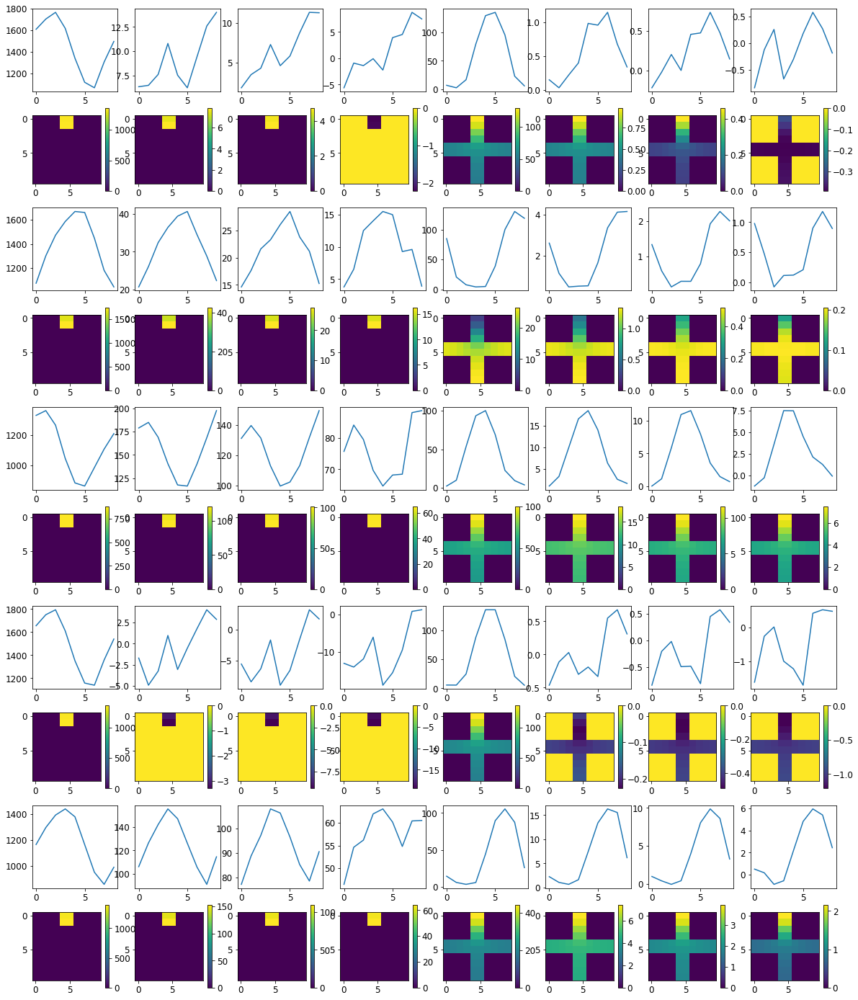

Loss: 


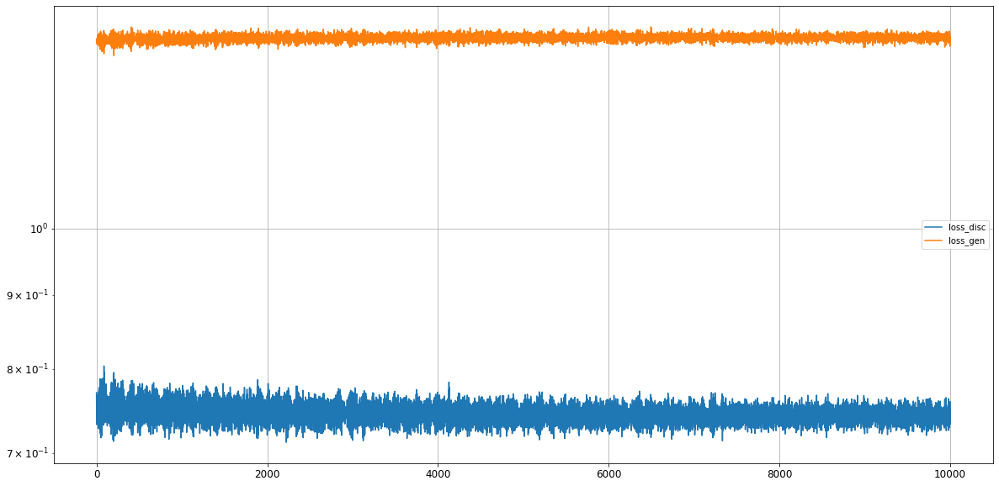

Epoch 10002/50000
discriminator loss: 1.368420 - generator loss: 0.741222 - 1s
Epoch 10003/50000
discriminator loss: 1.347870 - generator loss: 0.753050 - 1s
Epoch 10004/50000
discriminator loss: 1.351190 - generator loss: 0.753115 - 1s
Epoch 10005/50000
discriminator loss: 1.364777 - generator loss: 0.730405 - 1s
Epoch 10006/50000
discriminator loss: 1.352963 - generator loss: 0.741450 - 1s
Epoch 10007/50000
discriminator loss: 1.349498 - generator loss: 0.734726 - 1s
Epoch 10008/50000
discriminator loss: 1.340650 - generator loss: 0.748491 - 1s
Epoch 10009/50000
discriminator loss: 1.357386 - generator loss: 0.746812 - 1s
Epoch 10010/50000
discriminator loss: 1.360412 - generator loss: 0.748640 - 1s
Epoch 10011/50000
discriminator loss: 1.356108 - generator loss: 0.748361 - 1s
Epoch 10012/50000
discriminator loss: 1.358123 - generator loss: 0.743854 - 1s
Epoch 10013/50000
discriminator loss: 1.361231 - generator loss: 0.738138 - 1s
Epoch 10014/50000
discriminator loss: 1.360137 - gen

discriminator loss: 1.351649 - generator loss: 0.731772 - 1s
Epoch 10107/50000
discriminator loss: 1.358462 - generator loss: 0.737085 - 1s
Epoch 10108/50000
discriminator loss: 1.345905 - generator loss: 0.747270 - 1s
Epoch 10109/50000
discriminator loss: 1.360874 - generator loss: 0.736090 - 1s
Epoch 10110/50000
discriminator loss: 1.365202 - generator loss: 0.735842 - 1s
Epoch 10111/50000
discriminator loss: 1.358161 - generator loss: 0.749503 - 1s
Epoch 10112/50000
discriminator loss: 1.358049 - generator loss: 0.752869 - 1s
Epoch 10113/50000
discriminator loss: 1.350367 - generator loss: 0.748431 - 1s
Epoch 10114/50000
discriminator loss: 1.365397 - generator loss: 0.727453 - 1s
Epoch 10115/50000
discriminator loss: 1.363871 - generator loss: 0.726911 - 1s
Epoch 10116/50000
discriminator loss: 1.351498 - generator loss: 0.740414 - 1s
Epoch 10117/50000
discriminator loss: 1.356453 - generator loss: 0.747232 - 1s
Epoch 10118/50000
discriminator loss: 1.363750 - generator loss: 0.744

discriminator loss: 1.357030 - generator loss: 0.739898 - 1s
Epoch 10211/50000
discriminator loss: 1.355045 - generator loss: 0.754666 - 1s
Epoch 10212/50000
discriminator loss: 1.355088 - generator loss: 0.736327 - 1s
Epoch 10213/50000
discriminator loss: 1.356012 - generator loss: 0.733888 - 1s
Epoch 10214/50000
discriminator loss: 1.354540 - generator loss: 0.733062 - 1s
Epoch 10215/50000
discriminator loss: 1.354262 - generator loss: 0.748310 - 1s
Epoch 10216/50000
discriminator loss: 1.362246 - generator loss: 0.737085 - 1s
Epoch 10217/50000
discriminator loss: 1.356101 - generator loss: 0.745255 - 1s
Epoch 10218/50000
discriminator loss: 1.355492 - generator loss: 0.751510 - 1s
Epoch 10219/50000
discriminator loss: 1.359279 - generator loss: 0.735368 - 1s
Epoch 10220/50000
discriminator loss: 1.358286 - generator loss: 0.740047 - 1s
Epoch 10221/50000
discriminator loss: 1.353473 - generator loss: 0.735422 - 1s
Epoch 10222/50000
discriminator loss: 1.352131 - generator loss: 0.737

discriminator loss: 1.360680 - generator loss: 0.750185 - 1s
Epoch 10315/50000
discriminator loss: 1.354171 - generator loss: 0.752478 - 1s
Epoch 10316/50000
discriminator loss: 1.350091 - generator loss: 0.739387 - 1s
Epoch 10317/50000
discriminator loss: 1.362183 - generator loss: 0.731897 - 1s
Epoch 10318/50000
discriminator loss: 1.348839 - generator loss: 0.740119 - 1s
Epoch 10319/50000
discriminator loss: 1.349453 - generator loss: 0.742327 - 1s
Epoch 10320/50000
discriminator loss: 1.360377 - generator loss: 0.738860 - 1s
Epoch 10321/50000
discriminator loss: 1.363476 - generator loss: 0.747720 - 1s
Epoch 10322/50000
discriminator loss: 1.345294 - generator loss: 0.759395 - 1s
Epoch 10323/50000
discriminator loss: 1.346185 - generator loss: 0.756985 - 1s
Epoch 10324/50000
discriminator loss: 1.358623 - generator loss: 0.732848 - 1s
Epoch 10325/50000
discriminator loss: 1.354245 - generator loss: 0.724706 - 1s
Epoch 10326/50000
discriminator loss: 1.348667 - generator loss: 0.746

discriminator loss: 1.350309 - generator loss: 0.741329 - 1s
Epoch 10419/50000
discriminator loss: 1.362405 - generator loss: 0.733936 - 1s
Epoch 10420/50000
discriminator loss: 1.345490 - generator loss: 0.750064 - 1s
Epoch 10421/50000
discriminator loss: 1.360164 - generator loss: 0.746540 - 1s
Epoch 10422/50000
discriminator loss: 1.352757 - generator loss: 0.753452 - 1s
Epoch 10423/50000
discriminator loss: 1.357745 - generator loss: 0.741064 - 1s
Epoch 10424/50000
discriminator loss: 1.356114 - generator loss: 0.736364 - 1s
Epoch 10425/50000
discriminator loss: 1.353459 - generator loss: 0.737907 - 1s
Epoch 10426/50000
discriminator loss: 1.344115 - generator loss: 0.747531 - 1s
Epoch 10427/50000
discriminator loss: 1.356924 - generator loss: 0.744500 - 1s
Epoch 10428/50000
discriminator loss: 1.358186 - generator loss: 0.739884 - 1s
Epoch 10429/50000
discriminator loss: 1.354984 - generator loss: 0.758082 - 1s
Epoch 10430/50000
discriminator loss: 1.349447 - generator loss: 0.746

discriminator loss: 1.353983 - generator loss: 0.745443 - 1s
Epoch 10523/50000
discriminator loss: 1.366121 - generator loss: 0.722698 - 1s
Epoch 10524/50000
discriminator loss: 1.357182 - generator loss: 0.733936 - 1s
Epoch 10525/50000
discriminator loss: 1.353986 - generator loss: 0.738719 - 1s
Epoch 10526/50000
discriminator loss: 1.355810 - generator loss: 0.748611 - 1s
Epoch 10527/50000
discriminator loss: 1.362962 - generator loss: 0.742494 - 1s
Epoch 10528/50000
discriminator loss: 1.354101 - generator loss: 0.759200 - 1s
Epoch 10529/50000
discriminator loss: 1.347329 - generator loss: 0.749327 - 1s
Epoch 10530/50000
discriminator loss: 1.361710 - generator loss: 0.734870 - 1s
Epoch 10531/50000
discriminator loss: 1.363660 - generator loss: 0.724711 - 1s
Epoch 10532/50000
discriminator loss: 1.355076 - generator loss: 0.732912 - 1s
Epoch 10533/50000
discriminator loss: 1.343668 - generator loss: 0.748820 - 1s
Epoch 10534/50000
discriminator loss: 1.358558 - generator loss: 0.741

discriminator loss: 1.340627 - generator loss: 0.748152 - 1s
Epoch 10627/50000
discriminator loss: 1.362153 - generator loss: 0.738739 - 1s
Epoch 10628/50000
discriminator loss: 1.354847 - generator loss: 0.754288 - 1s
Epoch 10629/50000
discriminator loss: 1.367996 - generator loss: 0.735125 - 1s
Epoch 10630/50000
discriminator loss: 1.351760 - generator loss: 0.748888 - 1s
Epoch 10631/50000
discriminator loss: 1.360429 - generator loss: 0.744603 - 1s
Epoch 10632/50000
discriminator loss: 1.362703 - generator loss: 0.728956 - 1s
Epoch 10633/50000
discriminator loss: 1.354369 - generator loss: 0.735441 - 1s
Epoch 10634/50000
discriminator loss: 1.349326 - generator loss: 0.742760 - 1s
Epoch 10635/50000
discriminator loss: 1.356144 - generator loss: 0.747041 - 1s
Epoch 10636/50000
discriminator loss: 1.356928 - generator loss: 0.743786 - 1s
Epoch 10637/50000
discriminator loss: 1.349555 - generator loss: 0.753231 - 1s
Epoch 10638/50000
discriminator loss: 1.349705 - generator loss: 0.748

discriminator loss: 1.350909 - generator loss: 0.747347 - 1s
Epoch 10731/50000
discriminator loss: 1.353159 - generator loss: 0.740792 - 1s
Epoch 10732/50000
discriminator loss: 1.357168 - generator loss: 0.735450 - 1s
Epoch 10733/50000
discriminator loss: 1.349524 - generator loss: 0.736680 - 1s
Epoch 10734/50000
discriminator loss: 1.355556 - generator loss: 0.742865 - 1s
Epoch 10735/50000
discriminator loss: 1.354304 - generator loss: 0.747930 - 1s
Epoch 10736/50000
discriminator loss: 1.362683 - generator loss: 0.747882 - 1s
Epoch 10737/50000
discriminator loss: 1.345520 - generator loss: 0.755668 - 1s
Epoch 10738/50000
discriminator loss: 1.352091 - generator loss: 0.750692 - 1s
Epoch 10739/50000
discriminator loss: 1.358759 - generator loss: 0.738196 - 1s
Epoch 10740/50000
discriminator loss: 1.354381 - generator loss: 0.728827 - 1s
Epoch 10741/50000
discriminator loss: 1.350288 - generator loss: 0.743785 - 1s
Epoch 10742/50000
discriminator loss: 1.353567 - generator loss: 0.744

discriminator loss: 1.358766 - generator loss: 0.739357 - 1s
Epoch 10835/50000
discriminator loss: 1.352568 - generator loss: 0.746845 - 1s
Epoch 10836/50000
discriminator loss: 1.348661 - generator loss: 0.755967 - 1s
Epoch 10837/50000
discriminator loss: 1.361815 - generator loss: 0.733877 - 1s
Epoch 10838/50000
discriminator loss: 1.359424 - generator loss: 0.733418 - 1s
Epoch 10839/50000
discriminator loss: 1.357249 - generator loss: 0.732154 - 1s
Epoch 10840/50000
discriminator loss: 1.354160 - generator loss: 0.740765 - 1s
Epoch 10841/50000
discriminator loss: 1.355576 - generator loss: 0.751178 - 1s
Epoch 10842/50000
discriminator loss: 1.358563 - generator loss: 0.743292 - 1s
Epoch 10843/50000
discriminator loss: 1.343586 - generator loss: 0.756658 - 1s
Epoch 10844/50000
discriminator loss: 1.342263 - generator loss: 0.754327 - 1s
Epoch 10845/50000
discriminator loss: 1.353573 - generator loss: 0.738445 - 1s
Epoch 10846/50000
discriminator loss: 1.357218 - generator loss: 0.736

discriminator loss: 1.354279 - generator loss: 0.734633 - 1s
Epoch 10939/50000
discriminator loss: 1.347510 - generator loss: 0.743360 - 1s
Epoch 10940/50000
discriminator loss: 1.354264 - generator loss: 0.737473 - 1s
Epoch 10941/50000
discriminator loss: 1.361841 - generator loss: 0.745485 - 1s
Epoch 10942/50000
discriminator loss: 1.356232 - generator loss: 0.746349 - 1s
Epoch 10943/50000
discriminator loss: 1.354206 - generator loss: 0.746062 - 1s
Epoch 10944/50000
discriminator loss: 1.359769 - generator loss: 0.744124 - 1s
Epoch 10945/50000
discriminator loss: 1.355156 - generator loss: 0.734885 - 1s
Epoch 10946/50000
discriminator loss: 1.355152 - generator loss: 0.738799 - 1s
Epoch 10947/50000
discriminator loss: 1.352674 - generator loss: 0.737156 - 1s
Epoch 10948/50000
discriminator loss: 1.352364 - generator loss: 0.744141 - 1s
Epoch 10949/50000
discriminator loss: 1.356274 - generator loss: 0.752696 - 1s
Epoch 10950/50000
discriminator loss: 1.359012 - generator loss: 0.744

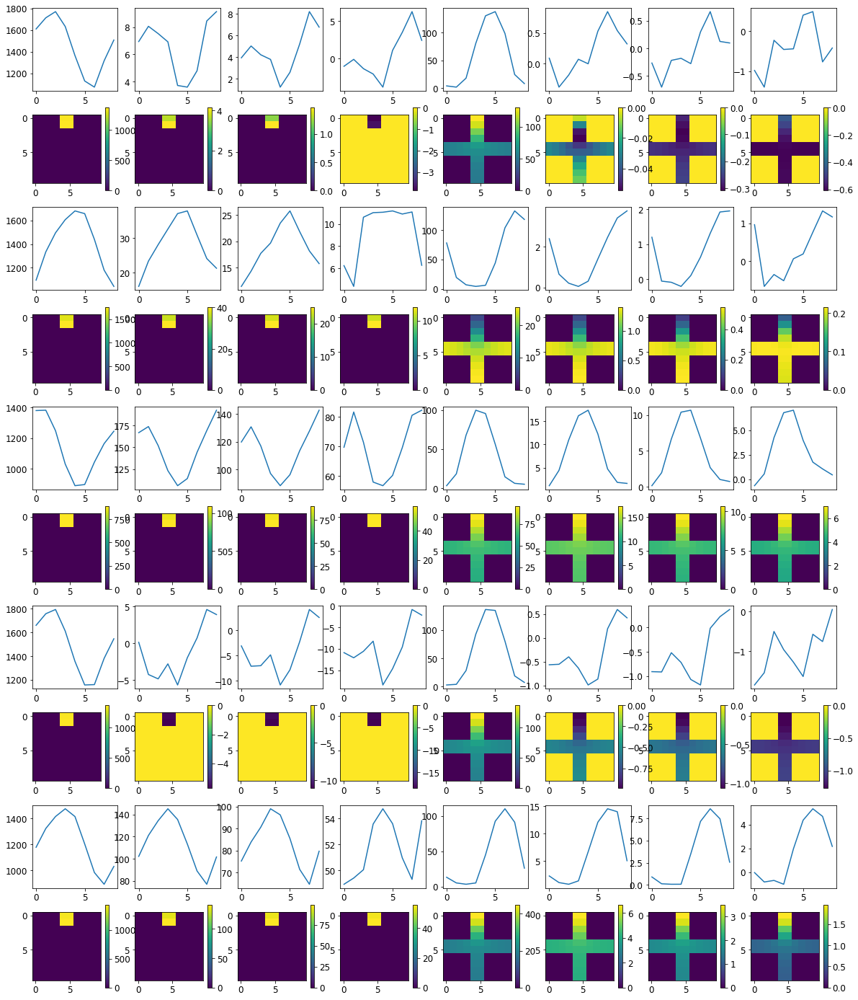

Loss: 


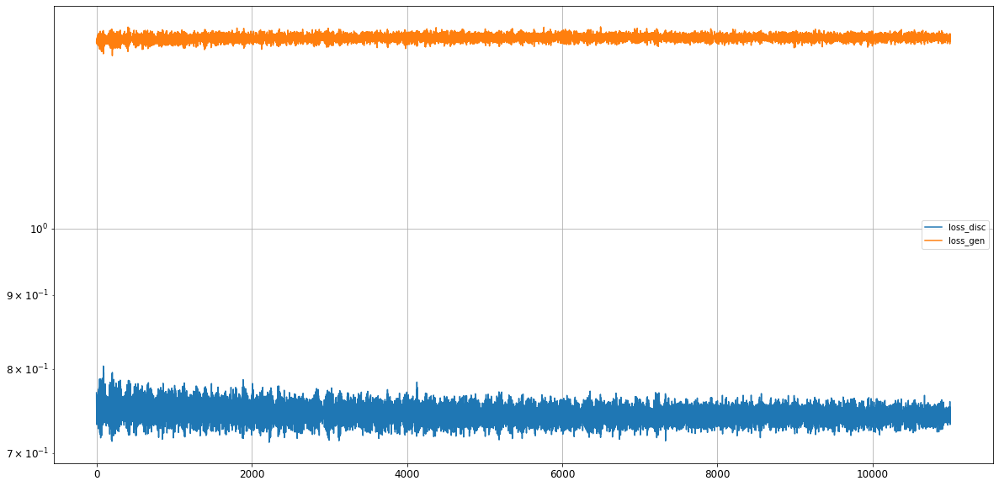

Epoch 11002/50000
discriminator loss: 1.351403 - generator loss: 0.754638 - 1s
Epoch 11003/50000
discriminator loss: 1.346962 - generator loss: 0.753048 - 1s
Epoch 11004/50000
discriminator loss: 1.351408 - generator loss: 0.744125 - 1s
Epoch 11005/50000
discriminator loss: 1.353623 - generator loss: 0.739750 - 1s
Epoch 11006/50000
discriminator loss: 1.356691 - generator loss: 0.737047 - 1s
Epoch 11007/50000
discriminator loss: 1.361334 - generator loss: 0.733833 - 1s
Epoch 11008/50000
discriminator loss: 1.348246 - generator loss: 0.740035 - 1s
Epoch 11009/50000
discriminator loss: 1.353425 - generator loss: 0.744656 - 1s
Epoch 11010/50000
discriminator loss: 1.357291 - generator loss: 0.753506 - 1s
Epoch 11011/50000
discriminator loss: 1.347023 - generator loss: 0.752406 - 1s
Epoch 11012/50000
discriminator loss: 1.346948 - generator loss: 0.742785 - 1s
Epoch 11013/50000
discriminator loss: 1.357598 - generator loss: 0.737398 - 1s
Epoch 11014/50000
discriminator loss: 1.359861 - gen

discriminator loss: 1.353004 - generator loss: 0.730946 - 1s
Epoch 11107/50000
discriminator loss: 1.349263 - generator loss: 0.751890 - 1s
Epoch 11108/50000
discriminator loss: 1.358448 - generator loss: 0.743811 - 1s
Epoch 11109/50000
discriminator loss: 1.356823 - generator loss: 0.754517 - 1s
Epoch 11110/50000
discriminator loss: 1.347021 - generator loss: 0.753228 - 1s
Epoch 11111/50000
discriminator loss: 1.353241 - generator loss: 0.739759 - 1s
Epoch 11112/50000
discriminator loss: 1.355229 - generator loss: 0.734821 - 1s
Epoch 11113/50000
discriminator loss: 1.353480 - generator loss: 0.736149 - 1s
Epoch 11114/50000
discriminator loss: 1.346663 - generator loss: 0.749506 - 1s
Epoch 11115/50000
discriminator loss: 1.352955 - generator loss: 0.743564 - 1s
Epoch 11116/50000
discriminator loss: 1.356456 - generator loss: 0.747301 - 1s
Epoch 11117/50000
discriminator loss: 1.340428 - generator loss: 0.754713 - 1s
Epoch 11118/50000
discriminator loss: 1.348959 - generator loss: 0.754

discriminator loss: 1.353790 - generator loss: 0.754660 - 1s
Epoch 11211/50000
discriminator loss: 1.359277 - generator loss: 0.746864 - 1s
Epoch 11212/50000
discriminator loss: 1.359150 - generator loss: 0.733284 - 1s
Epoch 11213/50000
discriminator loss: 1.357995 - generator loss: 0.734644 - 1s
Epoch 11214/50000
discriminator loss: 1.352549 - generator loss: 0.737442 - 1s
Epoch 11215/50000
discriminator loss: 1.345295 - generator loss: 0.747992 - 1s
Epoch 11216/50000
discriminator loss: 1.359263 - generator loss: 0.740400 - 1s
Epoch 11217/50000
discriminator loss: 1.359847 - generator loss: 0.745401 - 1s
Epoch 11218/50000
discriminator loss: 1.357568 - generator loss: 0.746756 - 1s
Epoch 11219/50000
discriminator loss: 1.342705 - generator loss: 0.751196 - 1s
Epoch 11220/50000
discriminator loss: 1.359913 - generator loss: 0.733631 - 1s
Epoch 11221/50000
discriminator loss: 1.355720 - generator loss: 0.740378 - 1s
Epoch 11222/50000
discriminator loss: 1.346144 - generator loss: 0.744

discriminator loss: 1.356869 - generator loss: 0.747266 - 1s
Epoch 11315/50000
discriminator loss: 1.353785 - generator loss: 0.750475 - 1s
Epoch 11316/50000
discriminator loss: 1.353954 - generator loss: 0.755255 - 1s
Epoch 11317/50000
discriminator loss: 1.363223 - generator loss: 0.728431 - 1s
Epoch 11318/50000
discriminator loss: 1.351600 - generator loss: 0.739490 - 1s
Epoch 11319/50000
discriminator loss: 1.354418 - generator loss: 0.738162 - 1s
Epoch 11320/50000
discriminator loss: 1.349916 - generator loss: 0.747856 - 1s
Epoch 11321/50000
discriminator loss: 1.360556 - generator loss: 0.737473 - 1s
Epoch 11322/50000
discriminator loss: 1.369389 - generator loss: 0.746571 - 1s
Epoch 11323/50000
discriminator loss: 1.350624 - generator loss: 0.755200 - 1s
Epoch 11324/50000
discriminator loss: 1.353920 - generator loss: 0.748469 - 1s
Epoch 11325/50000
discriminator loss: 1.358830 - generator loss: 0.736472 - 1s
Epoch 11326/50000
discriminator loss: 1.368795 - generator loss: 0.719

discriminator loss: 1.353129 - generator loss: 0.736091 - 1s
Epoch 11419/50000
discriminator loss: 1.361514 - generator loss: 0.735395 - 1s
Epoch 11420/50000
discriminator loss: 1.356778 - generator loss: 0.732740 - 1s
Epoch 11421/50000
discriminator loss: 1.346380 - generator loss: 0.745260 - 1s
Epoch 11422/50000
discriminator loss: 1.360022 - generator loss: 0.743262 - 1s
Epoch 11423/50000
discriminator loss: 1.356366 - generator loss: 0.751435 - 1s
Epoch 11424/50000
discriminator loss: 1.347757 - generator loss: 0.753809 - 1s
Epoch 11425/50000
discriminator loss: 1.355285 - generator loss: 0.745821 - 1s
Epoch 11426/50000
discriminator loss: 1.350142 - generator loss: 0.742733 - 1s
Epoch 11427/50000
discriminator loss: 1.360194 - generator loss: 0.730373 - 1s
Epoch 11428/50000
discriminator loss: 1.346516 - generator loss: 0.747044 - 1s
Epoch 11429/50000
discriminator loss: 1.350091 - generator loss: 0.742309 - 1s
Epoch 11430/50000
discriminator loss: 1.356324 - generator loss: 0.747

discriminator loss: 1.334469 - generator loss: 0.749456 - 1s
Epoch 11523/50000
discriminator loss: 1.361457 - generator loss: 0.741048 - 1s
Epoch 11524/50000
discriminator loss: 1.358090 - generator loss: 0.746327 - 1s
Epoch 11525/50000
discriminator loss: 1.351984 - generator loss: 0.751544 - 1s
Epoch 11526/50000
discriminator loss: 1.351551 - generator loss: 0.749294 - 1s
Epoch 11527/50000
discriminator loss: 1.359338 - generator loss: 0.733746 - 1s
Epoch 11528/50000
discriminator loss: 1.356590 - generator loss: 0.736076 - 1s
Epoch 11529/50000
discriminator loss: 1.351181 - generator loss: 0.739724 - 1s
Epoch 11530/50000
discriminator loss: 1.355165 - generator loss: 0.742188 - 1s
Epoch 11531/50000
discriminator loss: 1.360490 - generator loss: 0.745797 - 1s
Epoch 11532/50000
discriminator loss: 1.344191 - generator loss: 0.753915 - 1s
Epoch 11533/50000
discriminator loss: 1.354527 - generator loss: 0.747126 - 1s
Epoch 11534/50000
discriminator loss: 1.345846 - generator loss: 0.751

discriminator loss: 1.344030 - generator loss: 0.763343 - 1s
Epoch 11627/50000
discriminator loss: 1.343037 - generator loss: 0.759042 - 1s
Epoch 11628/50000
discriminator loss: 1.363449 - generator loss: 0.730661 - 1s
Epoch 11629/50000
discriminator loss: 1.358715 - generator loss: 0.724221 - 1s
Epoch 11630/50000
discriminator loss: 1.345123 - generator loss: 0.743324 - 1s
Epoch 11631/50000
discriminator loss: 1.352014 - generator loss: 0.741113 - 1s
Epoch 11632/50000
discriminator loss: 1.367955 - generator loss: 0.740006 - 1s
Epoch 11633/50000
discriminator loss: 1.362180 - generator loss: 0.756579 - 1s
Epoch 11634/50000
discriminator loss: 1.353473 - generator loss: 0.753662 - 1s
Epoch 11635/50000
discriminator loss: 1.346984 - generator loss: 0.750396 - 1s
Epoch 11636/50000
discriminator loss: 1.361527 - generator loss: 0.725439 - 1s
Epoch 11637/50000
discriminator loss: 1.365325 - generator loss: 0.722186 - 1s
Epoch 11638/50000
discriminator loss: 1.344236 - generator loss: 0.747

discriminator loss: 1.355011 - generator loss: 0.750080 - 1s
Epoch 11731/50000
discriminator loss: 1.352196 - generator loss: 0.741149 - 1s
Epoch 11732/50000
discriminator loss: 1.358346 - generator loss: 0.738637 - 1s
Epoch 11733/50000
discriminator loss: 1.359246 - generator loss: 0.736978 - 1s
Epoch 11734/50000
discriminator loss: 1.350236 - generator loss: 0.743903 - 1s
Epoch 11735/50000
discriminator loss: 1.356578 - generator loss: 0.742304 - 1s
Epoch 11736/50000
discriminator loss: 1.350006 - generator loss: 0.747545 - 1s
Epoch 11737/50000
discriminator loss: 1.358035 - generator loss: 0.742369 - 1s
Epoch 11738/50000
discriminator loss: 1.347666 - generator loss: 0.756180 - 1s
Epoch 11739/50000
discriminator loss: 1.348977 - generator loss: 0.747552 - 1s
Epoch 11740/50000
discriminator loss: 1.353176 - generator loss: 0.740273 - 1s
Epoch 11741/50000
discriminator loss: 1.360383 - generator loss: 0.731883 - 1s
Epoch 11742/50000
discriminator loss: 1.352687 - generator loss: 0.741

discriminator loss: 1.350729 - generator loss: 0.740169 - 1s
Epoch 11835/50000
discriminator loss: 1.350488 - generator loss: 0.744465 - 1s
Epoch 11836/50000
discriminator loss: 1.361761 - generator loss: 0.742063 - 1s
Epoch 11837/50000
discriminator loss: 1.350432 - generator loss: 0.754060 - 1s
Epoch 11838/50000
discriminator loss: 1.340084 - generator loss: 0.759158 - 1s
Epoch 11839/50000
discriminator loss: 1.349848 - generator loss: 0.746946 - 1s
Epoch 11840/50000
discriminator loss: 1.358355 - generator loss: 0.734063 - 1s
Epoch 11841/50000
discriminator loss: 1.355475 - generator loss: 0.732610 - 1s
Epoch 11842/50000
discriminator loss: 1.339187 - generator loss: 0.742739 - 1s
Epoch 11843/50000
discriminator loss: 1.348259 - generator loss: 0.750888 - 1s
Epoch 11844/50000
discriminator loss: 1.353947 - generator loss: 0.747988 - 1s
Epoch 11845/50000
discriminator loss: 1.351400 - generator loss: 0.753610 - 1s
Epoch 11846/50000
discriminator loss: 1.340939 - generator loss: 0.764

discriminator loss: 1.361741 - generator loss: 0.749233 - 1s
Epoch 11939/50000
discriminator loss: 1.348051 - generator loss: 0.761095 - 1s
Epoch 11940/50000
discriminator loss: 1.345708 - generator loss: 0.765673 - 1s
Epoch 11941/50000
discriminator loss: 1.349427 - generator loss: 0.754481 - 1s
Epoch 11942/50000
discriminator loss: 1.365381 - generator loss: 0.724219 - 1s
Epoch 11943/50000
discriminator loss: 1.354647 - generator loss: 0.729600 - 1s
Epoch 11944/50000
discriminator loss: 1.345067 - generator loss: 0.745776 - 1s
Epoch 11945/50000
discriminator loss: 1.350919 - generator loss: 0.746362 - 1s
Epoch 11946/50000
discriminator loss: 1.367918 - generator loss: 0.749091 - 1s
Epoch 11947/50000
discriminator loss: 1.354333 - generator loss: 0.747914 - 1s
Epoch 11948/50000
discriminator loss: 1.349714 - generator loss: 0.763323 - 1s
Epoch 11949/50000
discriminator loss: 1.351542 - generator loss: 0.747549 - 1s
Epoch 11950/50000
discriminator loss: 1.367086 - generator loss: 0.725

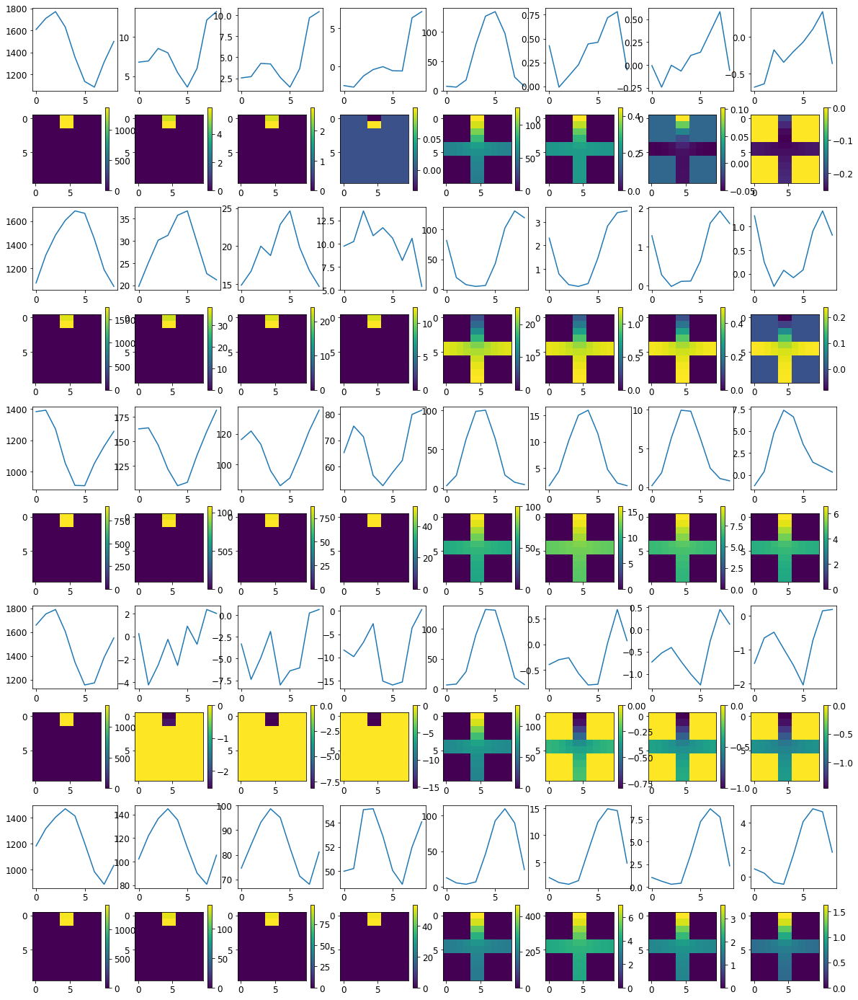

Loss: 


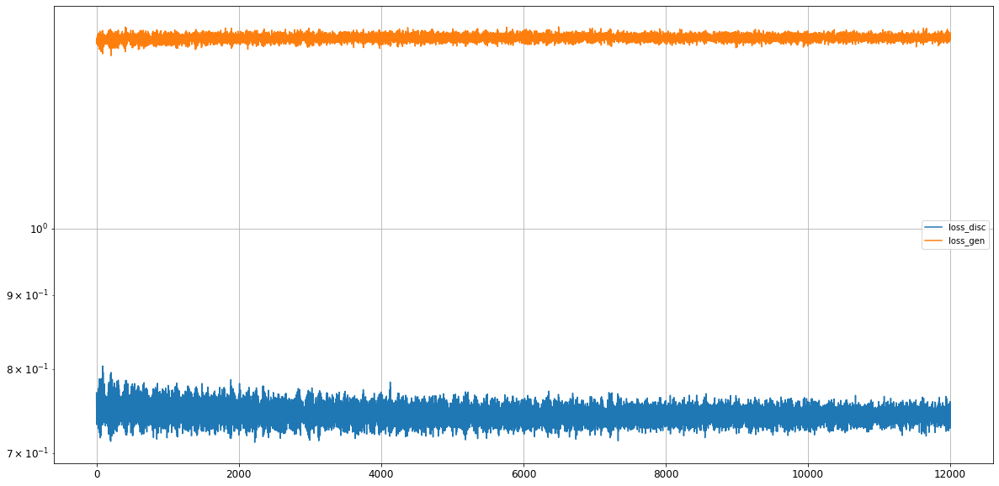

Epoch 12002/50000
discriminator loss: 1.354870 - generator loss: 0.748349 - 1s
Epoch 12003/50000
discriminator loss: 1.359167 - generator loss: 0.748883 - 1s
Epoch 12004/50000
discriminator loss: 1.351769 - generator loss: 0.747312 - 1s
Epoch 12005/50000
discriminator loss: 1.351134 - generator loss: 0.738468 - 1s
Epoch 12006/50000
discriminator loss: 1.358872 - generator loss: 0.735695 - 1s
Epoch 12007/50000
discriminator loss: 1.357230 - generator loss: 0.737271 - 1s
Epoch 12008/50000
discriminator loss: 1.342550 - generator loss: 0.747590 - 1s
Epoch 12009/50000
discriminator loss: 1.355653 - generator loss: 0.747543 - 1s
Epoch 12010/50000
discriminator loss: 1.366734 - generator loss: 0.737103 - 1s
Epoch 12011/50000
discriminator loss: 1.357016 - generator loss: 0.745840 - 1s
Epoch 12012/50000
discriminator loss: 1.358804 - generator loss: 0.743048 - 1s
Epoch 12013/50000
discriminator loss: 1.353457 - generator loss: 0.741433 - 1s
Epoch 12014/50000
discriminator loss: 1.354028 - gen

discriminator loss: 1.349172 - generator loss: 0.754305 - 1s
Epoch 12107/50000
discriminator loss: 1.340975 - generator loss: 0.750774 - 1s
Epoch 12108/50000
discriminator loss: 1.357832 - generator loss: 0.739127 - 1s
Epoch 12109/50000
discriminator loss: 1.355351 - generator loss: 0.740925 - 1s
Epoch 12110/50000
discriminator loss: 1.350206 - generator loss: 0.736583 - 1s
Epoch 12111/50000
discriminator loss: 1.353775 - generator loss: 0.743834 - 1s
Epoch 12112/50000
discriminator loss: 1.360956 - generator loss: 0.739279 - 1s
Epoch 12113/50000
discriminator loss: 1.354958 - generator loss: 0.749788 - 1s
Epoch 12114/50000
discriminator loss: 1.355819 - generator loss: 0.751536 - 1s
Epoch 12115/50000
discriminator loss: 1.354073 - generator loss: 0.741941 - 1s
Epoch 12116/50000
discriminator loss: 1.354514 - generator loss: 0.740715 - 1s
Epoch 12117/50000
discriminator loss: 1.355788 - generator loss: 0.739654 - 1s
Epoch 12118/50000
discriminator loss: 1.355369 - generator loss: 0.734

discriminator loss: 1.355629 - generator loss: 0.734007 - 1s
Epoch 12211/50000
discriminator loss: 1.353451 - generator loss: 0.739080 - 1s
Epoch 12212/50000
discriminator loss: 1.350781 - generator loss: 0.735725 - 1s
Epoch 12213/50000
discriminator loss: 1.349684 - generator loss: 0.749305 - 1s
Epoch 12214/50000
discriminator loss: 1.361397 - generator loss: 0.746417 - 1s
Epoch 12215/50000
discriminator loss: 1.359655 - generator loss: 0.740911 - 1s
Epoch 12216/50000
discriminator loss: 1.344474 - generator loss: 0.760855 - 1s
Epoch 12217/50000
discriminator loss: 1.345948 - generator loss: 0.750072 - 1s
Epoch 12218/50000
discriminator loss: 1.360170 - generator loss: 0.734642 - 1s
Epoch 12219/50000
discriminator loss: 1.357303 - generator loss: 0.730185 - 1s
Epoch 12220/50000
discriminator loss: 1.353612 - generator loss: 0.742838 - 1s
Epoch 12221/50000
discriminator loss: 1.352029 - generator loss: 0.737203 - 1s
Epoch 12222/50000
discriminator loss: 1.357182 - generator loss: 0.749

discriminator loss: 1.356700 - generator loss: 0.734956 - 1s
Epoch 12315/50000
discriminator loss: 1.361203 - generator loss: 0.734902 - 1s
Epoch 12316/50000
discriminator loss: 1.347501 - generator loss: 0.750031 - 1s
Epoch 12317/50000
discriminator loss: 1.344657 - generator loss: 0.747559 - 1s
Epoch 12318/50000
discriminator loss: 1.353020 - generator loss: 0.749169 - 1s
Epoch 12319/50000
discriminator loss: 1.356990 - generator loss: 0.747453 - 1s
Epoch 12320/50000
discriminator loss: 1.351335 - generator loss: 0.745580 - 1s
Epoch 12321/50000
discriminator loss: 1.353990 - generator loss: 0.744427 - 1s
Epoch 12322/50000
discriminator loss: 1.357821 - generator loss: 0.732343 - 1s
Epoch 12323/50000
discriminator loss: 1.354851 - generator loss: 0.740135 - 1s
Epoch 12324/50000
discriminator loss: 1.362744 - generator loss: 0.734743 - 1s
Epoch 12325/50000
discriminator loss: 1.352619 - generator loss: 0.746928 - 1s
Epoch 12326/50000
discriminator loss: 1.358895 - generator loss: 0.743

discriminator loss: 1.358334 - generator loss: 0.736241 - 1s
Epoch 12419/50000
discriminator loss: 1.357123 - generator loss: 0.729653 - 1s
Epoch 12420/50000
discriminator loss: 1.346796 - generator loss: 0.747980 - 1s
Epoch 12421/50000
discriminator loss: 1.351339 - generator loss: 0.743111 - 1s
Epoch 12422/50000
discriminator loss: 1.358667 - generator loss: 0.744764 - 1s
Epoch 12423/50000
discriminator loss: 1.358290 - generator loss: 0.745924 - 1s
Epoch 12424/50000
discriminator loss: 1.355206 - generator loss: 0.750691 - 1s
Epoch 12425/50000
discriminator loss: 1.354682 - generator loss: 0.740418 - 1s
Epoch 12426/50000
discriminator loss: 1.357101 - generator loss: 0.734988 - 1s
Epoch 12427/50000
discriminator loss: 1.357199 - generator loss: 0.742449 - 1s
Epoch 12428/50000
discriminator loss: 1.346370 - generator loss: 0.741382 - 1s
Epoch 12429/50000
discriminator loss: 1.349306 - generator loss: 0.744882 - 1s
Epoch 12430/50000
discriminator loss: 1.353826 - generator loss: 0.744

discriminator loss: 1.348877 - generator loss: 0.735277 - 1s
Epoch 12523/50000
discriminator loss: 1.350437 - generator loss: 0.740603 - 1s
Epoch 12524/50000
discriminator loss: 1.358820 - generator loss: 0.749114 - 1s
Epoch 12525/50000
discriminator loss: 1.359171 - generator loss: 0.746440 - 1s
Epoch 12526/50000
discriminator loss: 1.348883 - generator loss: 0.756593 - 1s
Epoch 12527/50000
discriminator loss: 1.349314 - generator loss: 0.751388 - 1s
Epoch 12528/50000
discriminator loss: 1.358641 - generator loss: 0.740376 - 1s
Epoch 12529/50000
discriminator loss: 1.357161 - generator loss: 0.733435 - 1s
Epoch 12530/50000
discriminator loss: 1.345839 - generator loss: 0.746725 - 1s
Epoch 12531/50000
discriminator loss: 1.339205 - generator loss: 0.743286 - 1s
Epoch 12532/50000
discriminator loss: 1.360692 - generator loss: 0.744538 - 1s
Epoch 12533/50000
discriminator loss: 1.353783 - generator loss: 0.753296 - 1s
Epoch 12534/50000
discriminator loss: 1.348674 - generator loss: 0.754

discriminator loss: 1.343432 - generator loss: 0.747043 - 1s
Epoch 12627/50000
discriminator loss: 1.346849 - generator loss: 0.747130 - 1s
Epoch 12628/50000
discriminator loss: 1.359684 - generator loss: 0.739700 - 1s
Epoch 12629/50000
discriminator loss: 1.350159 - generator loss: 0.751806 - 1s
Epoch 12630/50000
discriminator loss: 1.358891 - generator loss: 0.745221 - 1s
Epoch 12631/50000
discriminator loss: 1.347849 - generator loss: 0.740270 - 1s
Epoch 12632/50000
discriminator loss: 1.363792 - generator loss: 0.735641 - 1s
Epoch 12633/50000
discriminator loss: 1.360038 - generator loss: 0.735626 - 1s
Epoch 12634/50000
discriminator loss: 1.353800 - generator loss: 0.741944 - 1s
Epoch 12635/50000
discriminator loss: 1.353443 - generator loss: 0.746884 - 1s
Epoch 12636/50000
discriminator loss: 1.357707 - generator loss: 0.742762 - 1s
Epoch 12637/50000
discriminator loss: 1.352729 - generator loss: 0.743180 - 1s
Epoch 12638/50000
discriminator loss: 1.362262 - generator loss: 0.744

discriminator loss: 1.348133 - generator loss: 0.759136 - 1s
Epoch 12731/50000
discriminator loss: 1.351508 - generator loss: 0.749928 - 1s
Epoch 12732/50000
discriminator loss: 1.361585 - generator loss: 0.732965 - 1s
Epoch 12733/50000
discriminator loss: 1.367782 - generator loss: 0.720431 - 1s
Epoch 12734/50000
discriminator loss: 1.361270 - generator loss: 0.733814 - 1s
Epoch 12735/50000
discriminator loss: 1.342467 - generator loss: 0.755507 - 1s
Epoch 12736/50000
discriminator loss: 1.357638 - generator loss: 0.743958 - 1s
Epoch 12737/50000
discriminator loss: 1.364124 - generator loss: 0.741372 - 1s
Epoch 12738/50000
discriminator loss: 1.347647 - generator loss: 0.756644 - 1s
Epoch 12739/50000
discriminator loss: 1.350089 - generator loss: 0.753296 - 1s
Epoch 12740/50000
discriminator loss: 1.357016 - generator loss: 0.741417 - 1s
Epoch 12741/50000
discriminator loss: 1.366330 - generator loss: 0.721852 - 1s
Epoch 12742/50000
discriminator loss: 1.342811 - generator loss: 0.750

discriminator loss: 1.355237 - generator loss: 0.739874 - 1s
Epoch 12835/50000
discriminator loss: 1.355028 - generator loss: 0.752637 - 1s
Epoch 12836/50000
discriminator loss: 1.354819 - generator loss: 0.746140 - 1s
Epoch 12837/50000
discriminator loss: 1.358848 - generator loss: 0.734929 - 1s
Epoch 12838/50000
discriminator loss: 1.352530 - generator loss: 0.742956 - 1s
Epoch 12839/50000
discriminator loss: 1.354858 - generator loss: 0.737912 - 1s
Epoch 12840/50000
discriminator loss: 1.350599 - generator loss: 0.743351 - 1s
Epoch 12841/50000
discriminator loss: 1.357344 - generator loss: 0.740326 - 1s
Epoch 12842/50000
discriminator loss: 1.364269 - generator loss: 0.740288 - 1s
Epoch 12843/50000
discriminator loss: 1.360085 - generator loss: 0.739032 - 1s
Epoch 12844/50000
discriminator loss: 1.352244 - generator loss: 0.750638 - 1s
Epoch 12845/50000
discriminator loss: 1.357900 - generator loss: 0.745735 - 1s
Epoch 12846/50000
discriminator loss: 1.362868 - generator loss: 0.739

discriminator loss: 1.359640 - generator loss: 0.743396 - 1s
Epoch 12939/50000
discriminator loss: 1.365080 - generator loss: 0.741366 - 1s
Epoch 12940/50000
discriminator loss: 1.345290 - generator loss: 0.757275 - 1s
Epoch 12941/50000
discriminator loss: 1.349710 - generator loss: 0.748861 - 1s
Epoch 12942/50000
discriminator loss: 1.347189 - generator loss: 0.743672 - 1s
Epoch 12943/50000
discriminator loss: 1.354175 - generator loss: 0.730926 - 1s
Epoch 12944/50000
discriminator loss: 1.346891 - generator loss: 0.741870 - 1s
Epoch 12945/50000
discriminator loss: 1.345212 - generator loss: 0.752230 - 1s
Epoch 12946/50000
discriminator loss: 1.357087 - generator loss: 0.747803 - 1s
Epoch 12947/50000
discriminator loss: 1.364411 - generator loss: 0.738607 - 1s
Epoch 12948/50000
discriminator loss: 1.346555 - generator loss: 0.752808 - 1s
Epoch 12949/50000
discriminator loss: 1.349216 - generator loss: 0.757006 - 1s
Epoch 12950/50000
discriminator loss: 1.367353 - generator loss: 0.733

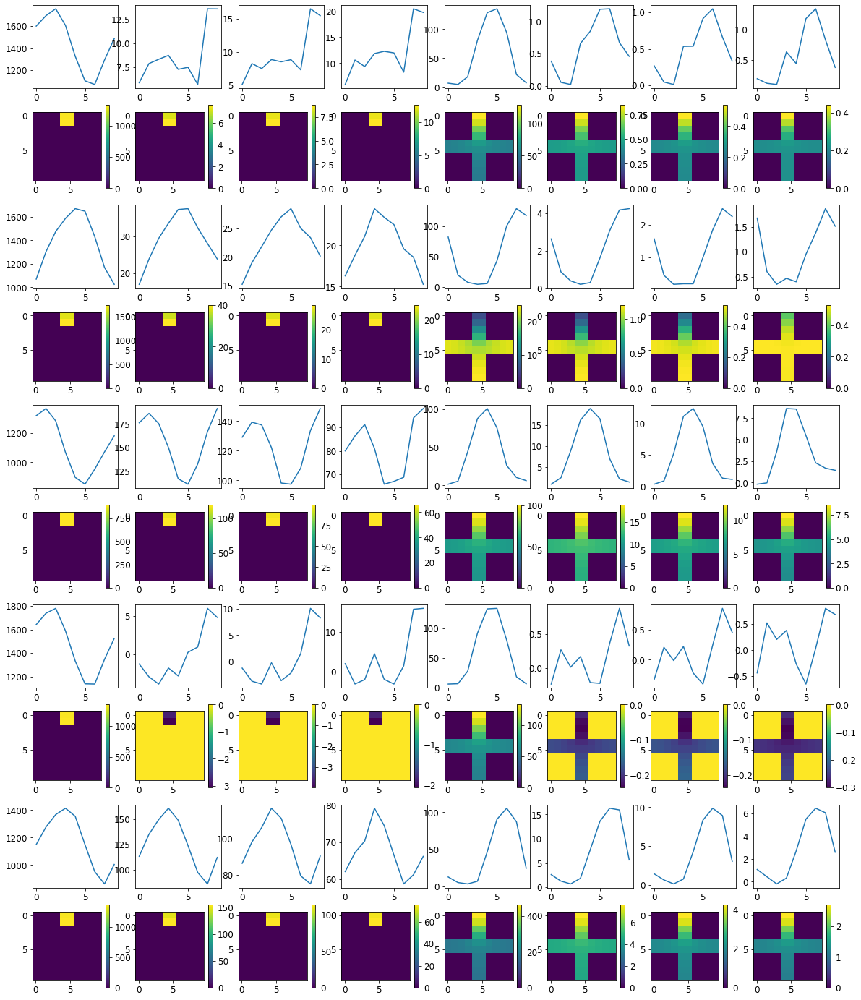

Loss: 


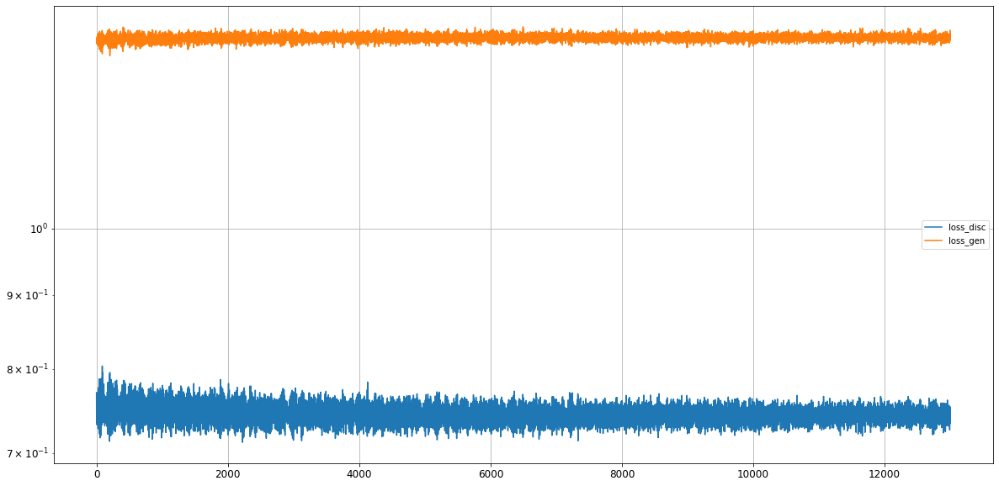

Epoch 13002/50000
discriminator loss: 1.356661 - generator loss: 0.740585 - 1s
Epoch 13003/50000
discriminator loss: 1.356881 - generator loss: 0.748118 - 1s
Epoch 13004/50000
discriminator loss: 1.359378 - generator loss: 0.737086 - 1s
Epoch 13005/50000
discriminator loss: 1.347729 - generator loss: 0.760920 - 1s
Epoch 13006/50000
discriminator loss: 1.350122 - generator loss: 0.741354 - 1s
Epoch 13007/50000
discriminator loss: 1.361115 - generator loss: 0.731191 - 1s
Epoch 13008/50000
discriminator loss: 1.349960 - generator loss: 0.738919 - 1s
Epoch 13009/50000
discriminator loss: 1.345004 - generator loss: 0.750893 - 1s
Epoch 13010/50000
discriminator loss: 1.353477 - generator loss: 0.744163 - 1s
Epoch 13011/50000
discriminator loss: 1.356675 - generator loss: 0.741888 - 1s
Epoch 13012/50000
discriminator loss: 1.347072 - generator loss: 0.756080 - 1s
Epoch 13013/50000
discriminator loss: 1.349041 - generator loss: 0.749956 - 1s
Epoch 13014/50000
discriminator loss: 1.352062 - gen

discriminator loss: 1.352583 - generator loss: 0.750439 - 1s
Epoch 13107/50000
discriminator loss: 1.362614 - generator loss: 0.748293 - 1s
Epoch 13108/50000
discriminator loss: 1.356714 - generator loss: 0.749610 - 1s
Epoch 13109/50000
discriminator loss: 1.348727 - generator loss: 0.751500 - 1s
Epoch 13110/50000
discriminator loss: 1.357174 - generator loss: 0.739831 - 1s
Epoch 13111/50000
discriminator loss: 1.358025 - generator loss: 0.737683 - 1s
Epoch 13112/50000
discriminator loss: 1.354004 - generator loss: 0.733353 - 1s
Epoch 13113/50000
discriminator loss: 1.346139 - generator loss: 0.741733 - 1s
Epoch 13114/50000
discriminator loss: 1.346006 - generator loss: 0.750067 - 1s
Epoch 13115/50000
discriminator loss: 1.352448 - generator loss: 0.751772 - 1s
Epoch 13116/50000
discriminator loss: 1.350909 - generator loss: 0.749242 - 1s
Epoch 13117/50000
discriminator loss: 1.347638 - generator loss: 0.756485 - 1s
Epoch 13118/50000
discriminator loss: 1.349717 - generator loss: 0.747

discriminator loss: 1.356179 - generator loss: 0.746287 - 1s
Epoch 13211/50000
discriminator loss: 1.361789 - generator loss: 0.743219 - 1s
Epoch 13212/50000
discriminator loss: 1.363537 - generator loss: 0.746137 - 1s
Epoch 13213/50000
discriminator loss: 1.346735 - generator loss: 0.753413 - 1s
Epoch 13214/50000
discriminator loss: 1.353423 - generator loss: 0.748091 - 1s
Epoch 13215/50000
discriminator loss: 1.360574 - generator loss: 0.730778 - 1s
Epoch 13216/50000
discriminator loss: 1.355268 - generator loss: 0.739071 - 1s
Epoch 13217/50000
discriminator loss: 1.350824 - generator loss: 0.749881 - 1s
Epoch 13218/50000
discriminator loss: 1.357632 - generator loss: 0.741334 - 1s
Epoch 13219/50000
discriminator loss: 1.356652 - generator loss: 0.739611 - 1s
Epoch 13220/50000
discriminator loss: 1.359165 - generator loss: 0.745378 - 1s
Epoch 13221/50000
discriminator loss: 1.335467 - generator loss: 0.763328 - 1s
Epoch 13222/50000
discriminator loss: 1.352107 - generator loss: 0.745

discriminator loss: 1.356899 - generator loss: 0.744329 - 1s
Epoch 13315/50000
discriminator loss: 1.357818 - generator loss: 0.752977 - 1s
Epoch 13316/50000
discriminator loss: 1.352282 - generator loss: 0.748961 - 1s
Epoch 13317/50000
discriminator loss: 1.351708 - generator loss: 0.749475 - 1s
Epoch 13318/50000
discriminator loss: 1.368313 - generator loss: 0.728517 - 1s
Epoch 13319/50000
discriminator loss: 1.351136 - generator loss: 0.736256 - 1s
Epoch 13320/50000
discriminator loss: 1.350433 - generator loss: 0.744090 - 1s
Epoch 13321/50000
discriminator loss: 1.360830 - generator loss: 0.739581 - 1s
Epoch 13322/50000
discriminator loss: 1.363749 - generator loss: 0.739919 - 1s
Epoch 13323/50000
discriminator loss: 1.354588 - generator loss: 0.747925 - 1s
Epoch 13324/50000
discriminator loss: 1.345876 - generator loss: 0.752780 - 1s
Epoch 13325/50000
discriminator loss: 1.352946 - generator loss: 0.740858 - 1s
Epoch 13326/50000
discriminator loss: 1.362817 - generator loss: 0.730

discriminator loss: 1.346163 - generator loss: 0.747102 - 1s
Epoch 13419/50000
discriminator loss: 1.361196 - generator loss: 0.740282 - 1s
Epoch 13420/50000
discriminator loss: 1.359385 - generator loss: 0.752832 - 1s
Epoch 13421/50000
discriminator loss: 1.348365 - generator loss: 0.754185 - 1s
Epoch 13422/50000
discriminator loss: 1.349023 - generator loss: 0.744716 - 1s
Epoch 13423/50000
discriminator loss: 1.358471 - generator loss: 0.741161 - 1s
Epoch 13424/50000
discriminator loss: 1.353484 - generator loss: 0.736224 - 1s
Epoch 13425/50000
discriminator loss: 1.361309 - generator loss: 0.735965 - 1s
Epoch 13426/50000
discriminator loss: 1.346274 - generator loss: 0.746467 - 1s
Epoch 13427/50000
discriminator loss: 1.369710 - generator loss: 0.740422 - 1s
Epoch 13428/50000
discriminator loss: 1.361781 - generator loss: 0.745314 - 1s
Epoch 13429/50000
discriminator loss: 1.353855 - generator loss: 0.757328 - 1s
Epoch 13430/50000
discriminator loss: 1.349755 - generator loss: 0.744

discriminator loss: 1.352888 - generator loss: 0.741640 - 1s
Epoch 13523/50000
discriminator loss: 1.363053 - generator loss: 0.732835 - 1s
Epoch 13524/50000
discriminator loss: 1.364768 - generator loss: 0.747371 - 1s
Epoch 13525/50000
discriminator loss: 1.353970 - generator loss: 0.748611 - 1s
Epoch 13526/50000
discriminator loss: 1.348005 - generator loss: 0.753433 - 1s
Epoch 13527/50000
discriminator loss: 1.357735 - generator loss: 0.734471 - 1s
Epoch 13528/50000
discriminator loss: 1.357422 - generator loss: 0.736185 - 1s
Epoch 13529/50000
discriminator loss: 1.352442 - generator loss: 0.737494 - 1s
Epoch 13530/50000
discriminator loss: 1.353853 - generator loss: 0.743916 - 1s
Epoch 13531/50000
discriminator loss: 1.358349 - generator loss: 0.736160 - 1s
Epoch 13532/50000
discriminator loss: 1.363706 - generator loss: 0.750392 - 1s
Epoch 13533/50000
discriminator loss: 1.351432 - generator loss: 0.748728 - 1s
Epoch 13534/50000
discriminator loss: 1.360130 - generator loss: 0.743

discriminator loss: 1.353818 - generator loss: 0.732876 - 1s
Epoch 13627/50000
discriminator loss: 1.350596 - generator loss: 0.741968 - 1s
Epoch 13628/50000
discriminator loss: 1.363995 - generator loss: 0.743104 - 1s
Epoch 13629/50000
discriminator loss: 1.365274 - generator loss: 0.739373 - 1s
Epoch 13630/50000
discriminator loss: 1.349534 - generator loss: 0.762105 - 1s
Epoch 13631/50000
discriminator loss: 1.341651 - generator loss: 0.754028 - 1s
Epoch 13632/50000
discriminator loss: 1.353113 - generator loss: 0.746639 - 1s
Epoch 13633/50000
discriminator loss: 1.365676 - generator loss: 0.727571 - 1s
Epoch 13634/50000
discriminator loss: 1.348672 - generator loss: 0.734085 - 1s
Epoch 13635/50000
discriminator loss: 1.343536 - generator loss: 0.749186 - 1s
Epoch 13636/50000
discriminator loss: 1.357717 - generator loss: 0.738930 - 1s
Epoch 13637/50000
discriminator loss: 1.368850 - generator loss: 0.740596 - 1s
Epoch 13638/50000
discriminator loss: 1.351034 - generator loss: 0.755

discriminator loss: 1.344197 - generator loss: 0.757884 - 1s
Epoch 13731/50000
discriminator loss: 1.361646 - generator loss: 0.738878 - 1s
Epoch 13732/50000
discriminator loss: 1.356433 - generator loss: 0.736287 - 1s
Epoch 13733/50000
discriminator loss: 1.362689 - generator loss: 0.727658 - 1s
Epoch 13734/50000
discriminator loss: 1.339328 - generator loss: 0.754616 - 1s
Epoch 13735/50000
discriminator loss: 1.355243 - generator loss: 0.741482 - 1s
Epoch 13736/50000
discriminator loss: 1.362177 - generator loss: 0.747247 - 1s
Epoch 13737/50000
discriminator loss: 1.354919 - generator loss: 0.756639 - 1s
Epoch 13738/50000
discriminator loss: 1.347130 - generator loss: 0.750239 - 1s
Epoch 13739/50000
discriminator loss: 1.357168 - generator loss: 0.745334 - 1s
Epoch 13740/50000
discriminator loss: 1.357354 - generator loss: 0.739136 - 1s
Epoch 13741/50000
discriminator loss: 1.360874 - generator loss: 0.728760 - 1s
Epoch 13742/50000
discriminator loss: 1.344978 - generator loss: 0.742

discriminator loss: 1.340984 - generator loss: 0.748079 - 1s
Epoch 13835/50000
discriminator loss: 1.367204 - generator loss: 0.735111 - 1s
Epoch 13836/50000
discriminator loss: 1.369341 - generator loss: 0.742002 - 1s
Epoch 13837/50000
discriminator loss: 1.360924 - generator loss: 0.750636 - 1s
Epoch 13838/50000
discriminator loss: 1.354155 - generator loss: 0.740868 - 1s
Epoch 13839/50000
discriminator loss: 1.355451 - generator loss: 0.737103 - 1s
Epoch 13840/50000
discriminator loss: 1.361267 - generator loss: 0.733056 - 1s
Epoch 13841/50000
discriminator loss: 1.348904 - generator loss: 0.743437 - 1s
Epoch 13842/50000
discriminator loss: 1.348861 - generator loss: 0.744917 - 1s
Epoch 13843/50000
discriminator loss: 1.364243 - generator loss: 0.737439 - 1s
Epoch 13844/50000
discriminator loss: 1.360003 - generator loss: 0.742260 - 1s
Epoch 13845/50000
discriminator loss: 1.361484 - generator loss: 0.741012 - 1s
Epoch 13846/50000
discriminator loss: 1.351535 - generator loss: 0.751

discriminator loss: 1.340651 - generator loss: 0.742137 - 1s
Epoch 13939/50000
discriminator loss: 1.352310 - generator loss: 0.748298 - 1s
Epoch 13940/50000
discriminator loss: 1.357746 - generator loss: 0.741759 - 1s
Epoch 13941/50000
discriminator loss: 1.358757 - generator loss: 0.747733 - 1s
Epoch 13942/50000
discriminator loss: 1.351433 - generator loss: 0.751975 - 1s
Epoch 13943/50000
discriminator loss: 1.348844 - generator loss: 0.750082 - 1s
Epoch 13944/50000
discriminator loss: 1.362530 - generator loss: 0.734935 - 1s
Epoch 13945/50000
discriminator loss: 1.358378 - generator loss: 0.723304 - 1s
Epoch 13946/50000
discriminator loss: 1.353093 - generator loss: 0.740749 - 1s
Epoch 13947/50000
discriminator loss: 1.359374 - generator loss: 0.742376 - 1s
Epoch 13948/50000
discriminator loss: 1.360121 - generator loss: 0.742989 - 1s
Epoch 13949/50000
discriminator loss: 1.358993 - generator loss: 0.751000 - 1s
Epoch 13950/50000
discriminator loss: 1.348855 - generator loss: 0.752

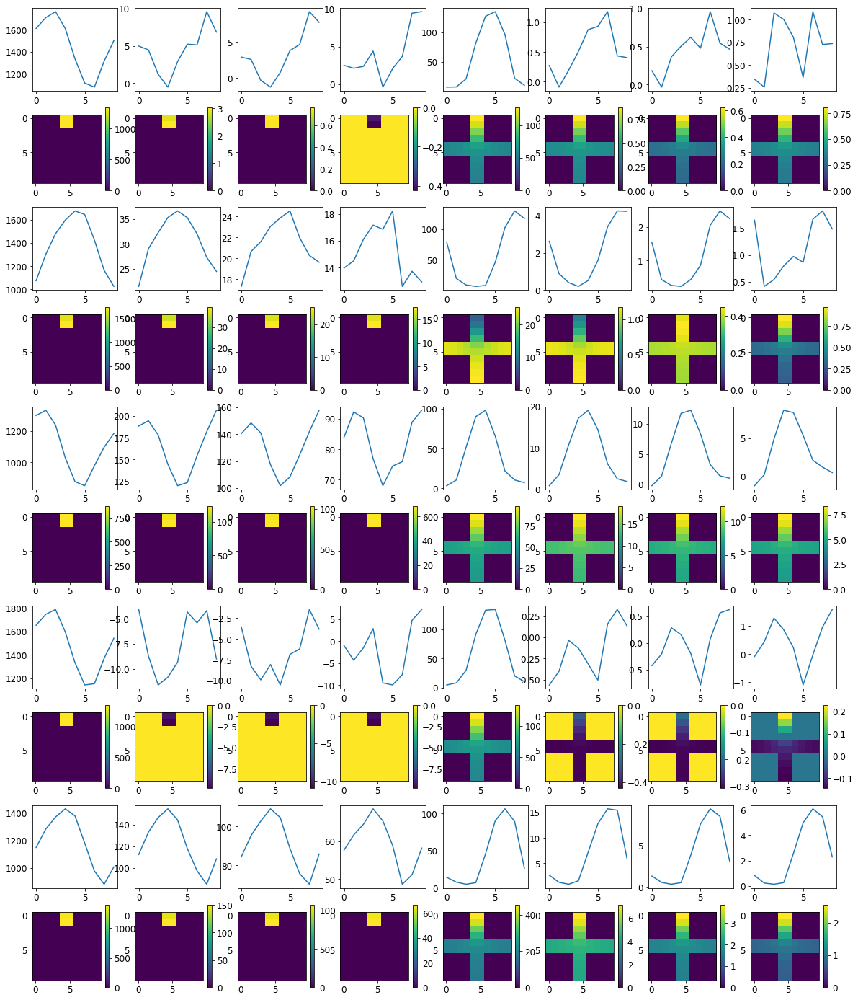

Loss: 


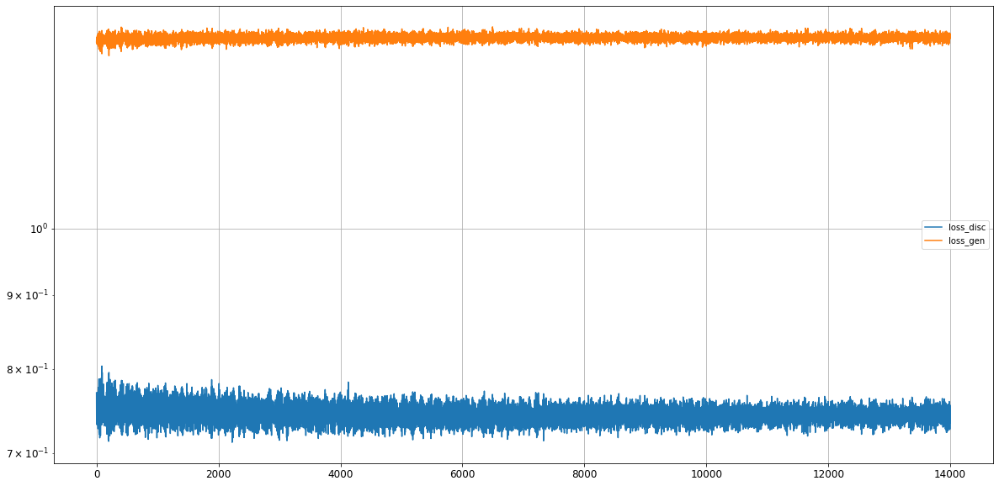

Epoch 14002/50000
discriminator loss: 1.360945 - generator loss: 0.732083 - 1s
Epoch 14003/50000
discriminator loss: 1.351906 - generator loss: 0.739731 - 1s
Epoch 14004/50000
discriminator loss: 1.351663 - generator loss: 0.744063 - 1s
Epoch 14005/50000
discriminator loss: 1.354685 - generator loss: 0.748179 - 1s
Epoch 14006/50000
discriminator loss: 1.360307 - generator loss: 0.745244 - 1s
Epoch 14007/50000
discriminator loss: 1.349377 - generator loss: 0.757912 - 1s
Epoch 14008/50000
discriminator loss: 1.358109 - generator loss: 0.743720 - 1s
Epoch 14009/50000
discriminator loss: 1.357605 - generator loss: 0.741531 - 1s
Epoch 14010/50000
discriminator loss: 1.359617 - generator loss: 0.730419 - 1s
Epoch 14011/50000
discriminator loss: 1.351865 - generator loss: 0.737225 - 1s
Epoch 14012/50000
discriminator loss: 1.352693 - generator loss: 0.743087 - 1s
Epoch 14013/50000
discriminator loss: 1.352334 - generator loss: 0.747142 - 1s
Epoch 14014/50000
discriminator loss: 1.349328 - gen

discriminator loss: 1.352688 - generator loss: 0.741958 - 1s
Epoch 14107/50000
discriminator loss: 1.359796 - generator loss: 0.730719 - 1s
Epoch 14108/50000
discriminator loss: 1.355456 - generator loss: 0.736370 - 1s
Epoch 14109/50000
discriminator loss: 1.349411 - generator loss: 0.748095 - 1s
Epoch 14110/50000
discriminator loss: 1.356986 - generator loss: 0.741568 - 1s
Epoch 14111/50000
discriminator loss: 1.354545 - generator loss: 0.742863 - 1s
Epoch 14112/50000
discriminator loss: 1.363580 - generator loss: 0.738095 - 1s
Epoch 14113/50000
discriminator loss: 1.348024 - generator loss: 0.759283 - 1s
Epoch 14114/50000
discriminator loss: 1.352453 - generator loss: 0.743520 - 1s
Epoch 14115/50000
discriminator loss: 1.357266 - generator loss: 0.736223 - 1s
Epoch 14116/50000
discriminator loss: 1.357968 - generator loss: 0.734530 - 1s
Epoch 14117/50000
discriminator loss: 1.355176 - generator loss: 0.746036 - 1s
Epoch 14118/50000
discriminator loss: 1.345269 - generator loss: 0.749

discriminator loss: 1.354117 - generator loss: 0.748829 - 1s
Epoch 14211/50000
discriminator loss: 1.358658 - generator loss: 0.749801 - 1s
Epoch 14212/50000
discriminator loss: 1.341293 - generator loss: 0.752934 - 1s
Epoch 14213/50000
discriminator loss: 1.361580 - generator loss: 0.736557 - 1s
Epoch 14214/50000
discriminator loss: 1.359874 - generator loss: 0.739794 - 1s
Epoch 14215/50000
discriminator loss: 1.358722 - generator loss: 0.728971 - 1s
Epoch 14216/50000
discriminator loss: 1.358973 - generator loss: 0.741093 - 1s
Epoch 14217/50000
discriminator loss: 1.349706 - generator loss: 0.748222 - 1s
Epoch 14218/50000
discriminator loss: 1.355627 - generator loss: 0.743859 - 1s
Epoch 14219/50000
discriminator loss: 1.352606 - generator loss: 0.750465 - 1s
Epoch 14220/50000
discriminator loss: 1.353419 - generator loss: 0.753183 - 1s
Epoch 14221/50000
discriminator loss: 1.354293 - generator loss: 0.745801 - 1s
Epoch 14222/50000
discriminator loss: 1.356335 - generator loss: 0.730

discriminator loss: 1.353093 - generator loss: 0.741876 - 1s
Epoch 14315/50000
discriminator loss: 1.344082 - generator loss: 0.745916 - 1s
Epoch 14316/50000
discriminator loss: 1.359766 - generator loss: 0.749269 - 1s
Epoch 14317/50000
discriminator loss: 1.366782 - generator loss: 0.735942 - 1s
Epoch 14318/50000
discriminator loss: 1.350761 - generator loss: 0.747644 - 1s
Epoch 14319/50000
discriminator loss: 1.355607 - generator loss: 0.749628 - 1s
Epoch 14320/50000
discriminator loss: 1.361708 - generator loss: 0.738720 - 1s
Epoch 14321/50000
discriminator loss: 1.351985 - generator loss: 0.735595 - 1s
Epoch 14322/50000
discriminator loss: 1.345297 - generator loss: 0.746996 - 1s
Epoch 14323/50000
discriminator loss: 1.346892 - generator loss: 0.745572 - 1s
Epoch 14324/50000
discriminator loss: 1.349012 - generator loss: 0.747954 - 1s
Epoch 14325/50000
discriminator loss: 1.353915 - generator loss: 0.747579 - 1s
Epoch 14326/50000
discriminator loss: 1.362741 - generator loss: 0.742

discriminator loss: 1.356656 - generator loss: 0.727832 - 1s
Epoch 14419/50000
discriminator loss: 1.356715 - generator loss: 0.735549 - 1s
Epoch 14420/50000
discriminator loss: 1.346152 - generator loss: 0.744407 - 1s
Epoch 14421/50000
discriminator loss: 1.356851 - generator loss: 0.745678 - 1s
Epoch 14422/50000
discriminator loss: 1.369628 - generator loss: 0.736627 - 1s
Epoch 14423/50000
discriminator loss: 1.358335 - generator loss: 0.752455 - 1s
Epoch 14424/50000
discriminator loss: 1.342913 - generator loss: 0.760441 - 1s
Epoch 14425/50000
discriminator loss: 1.355507 - generator loss: 0.747490 - 1s
Epoch 14426/50000
discriminator loss: 1.367783 - generator loss: 0.726867 - 1s
Epoch 14427/50000
discriminator loss: 1.361284 - generator loss: 0.730439 - 1s
Epoch 14428/50000
discriminator loss: 1.349254 - generator loss: 0.737748 - 1s
Epoch 14429/50000
discriminator loss: 1.347017 - generator loss: 0.745070 - 1s
Epoch 14430/50000
discriminator loss: 1.363281 - generator loss: 0.743

discriminator loss: 1.353158 - generator loss: 0.742941 - 1s
Epoch 14523/50000
discriminator loss: 1.357806 - generator loss: 0.743648 - 1s
Epoch 14524/50000
discriminator loss: 1.350048 - generator loss: 0.752499 - 1s
Epoch 14525/50000
discriminator loss: 1.350818 - generator loss: 0.747037 - 1s
Epoch 14526/50000
discriminator loss: 1.359931 - generator loss: 0.737471 - 1s
Epoch 14527/50000
discriminator loss: 1.356145 - generator loss: 0.737062 - 1s
Epoch 14528/50000
discriminator loss: 1.359333 - generator loss: 0.741767 - 1s
Epoch 14529/50000
discriminator loss: 1.356846 - generator loss: 0.741481 - 1s
Epoch 14530/50000
discriminator loss: 1.356487 - generator loss: 0.737967 - 1s
Epoch 14531/50000
discriminator loss: 1.357345 - generator loss: 0.750065 - 1s
Epoch 14532/50000
discriminator loss: 1.360078 - generator loss: 0.735552 - 1s
Epoch 14533/50000
discriminator loss: 1.342033 - generator loss: 0.760296 - 1s
Epoch 14534/50000
discriminator loss: 1.356836 - generator loss: 0.738

discriminator loss: 1.347895 - generator loss: 0.745838 - 1s
Epoch 14627/50000
discriminator loss: 1.363195 - generator loss: 0.739240 - 1s
Epoch 14628/50000
discriminator loss: 1.358206 - generator loss: 0.746931 - 1s
Epoch 14629/50000
discriminator loss: 1.349290 - generator loss: 0.760316 - 1s
Epoch 14630/50000
discriminator loss: 1.345054 - generator loss: 0.753915 - 1s
Epoch 14631/50000
discriminator loss: 1.353562 - generator loss: 0.735382 - 1s
Epoch 14632/50000
discriminator loss: 1.366578 - generator loss: 0.729967 - 1s
Epoch 14633/50000
discriminator loss: 1.359389 - generator loss: 0.735184 - 1s
Epoch 14634/50000
discriminator loss: 1.350404 - generator loss: 0.744731 - 1s
Epoch 14635/50000
discriminator loss: 1.358617 - generator loss: 0.743158 - 1s
Epoch 14636/50000
discriminator loss: 1.349357 - generator loss: 0.747859 - 1s
Epoch 14637/50000
discriminator loss: 1.353416 - generator loss: 0.748097 - 1s
Epoch 14638/50000
discriminator loss: 1.353359 - generator loss: 0.749

discriminator loss: 1.346710 - generator loss: 0.760433 - 1s
Epoch 14731/50000
discriminator loss: 1.345302 - generator loss: 0.749322 - 1s
Epoch 14732/50000
discriminator loss: 1.361861 - generator loss: 0.737779 - 1s
Epoch 14733/50000
discriminator loss: 1.359819 - generator loss: 0.726000 - 1s
Epoch 14734/50000
discriminator loss: 1.358175 - generator loss: 0.730883 - 1s
Epoch 14735/50000
discriminator loss: 1.342123 - generator loss: 0.756562 - 1s
Epoch 14736/50000
discriminator loss: 1.357833 - generator loss: 0.743111 - 1s
Epoch 14737/50000
discriminator loss: 1.360170 - generator loss: 0.743063 - 1s
Epoch 14738/50000
discriminator loss: 1.359068 - generator loss: 0.751085 - 1s
Epoch 14739/50000
discriminator loss: 1.352505 - generator loss: 0.740234 - 1s
Epoch 14740/50000
discriminator loss: 1.347039 - generator loss: 0.747414 - 1s
Epoch 14741/50000
discriminator loss: 1.371450 - generator loss: 0.726659 - 1s
Epoch 14742/50000
discriminator loss: 1.349471 - generator loss: 0.743

discriminator loss: 1.349456 - generator loss: 0.744230 - 1s
Epoch 14835/50000
discriminator loss: 1.355585 - generator loss: 0.741110 - 1s
Epoch 14836/50000
discriminator loss: 1.355549 - generator loss: 0.749754 - 1s
Epoch 14837/50000
discriminator loss: 1.353386 - generator loss: 0.744846 - 1s
Epoch 14838/50000
discriminator loss: 1.353184 - generator loss: 0.748776 - 1s
Epoch 14839/50000
discriminator loss: 1.354194 - generator loss: 0.751623 - 1s
Epoch 14840/50000
discriminator loss: 1.362643 - generator loss: 0.726394 - 1s
Epoch 14841/50000
discriminator loss: 1.364733 - generator loss: 0.727782 - 1s
Epoch 14842/50000
discriminator loss: 1.358274 - generator loss: 0.740518 - 1s
Epoch 14843/50000
discriminator loss: 1.347635 - generator loss: 0.746972 - 1s
Epoch 14844/50000
discriminator loss: 1.357343 - generator loss: 0.740641 - 1s
Epoch 14845/50000
discriminator loss: 1.355106 - generator loss: 0.737381 - 1s
Epoch 14846/50000
discriminator loss: 1.344355 - generator loss: 0.766

discriminator loss: 1.360602 - generator loss: 0.746721 - 1s
Epoch 14939/50000
discriminator loss: 1.351003 - generator loss: 0.751020 - 1s
Epoch 14940/50000
discriminator loss: 1.345685 - generator loss: 0.748749 - 1s
Epoch 14941/50000
discriminator loss: 1.348868 - generator loss: 0.746900 - 1s
Epoch 14942/50000
discriminator loss: 1.355780 - generator loss: 0.734000 - 1s
Epoch 14943/50000
discriminator loss: 1.348277 - generator loss: 0.741932 - 1s
Epoch 14944/50000
discriminator loss: 1.353564 - generator loss: 0.739981 - 1s
Epoch 14945/50000
discriminator loss: 1.360125 - generator loss: 0.739137 - 1s
Epoch 14946/50000
discriminator loss: 1.360746 - generator loss: 0.742986 - 1s
Epoch 14947/50000
discriminator loss: 1.363458 - generator loss: 0.743214 - 1s
Epoch 14948/50000
discriminator loss: 1.356783 - generator loss: 0.748202 - 1s
Epoch 14949/50000
discriminator loss: 1.353689 - generator loss: 0.747872 - 1s
Epoch 14950/50000
discriminator loss: 1.363623 - generator loss: 0.729

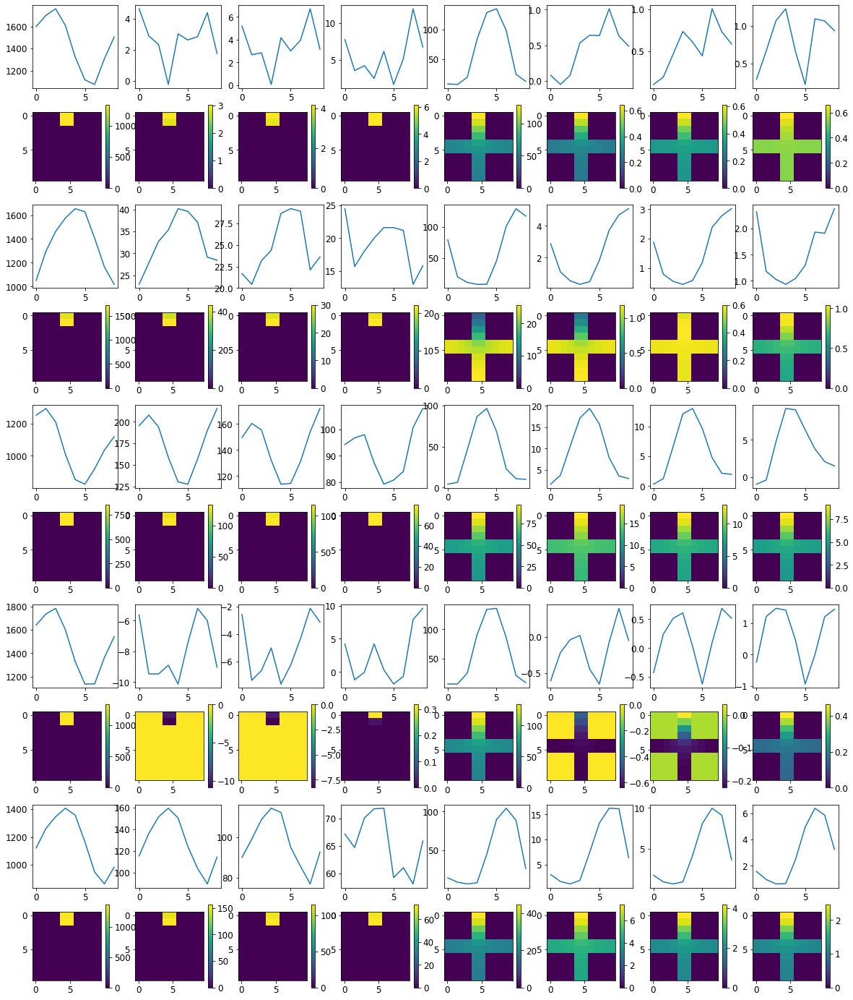

Loss: 


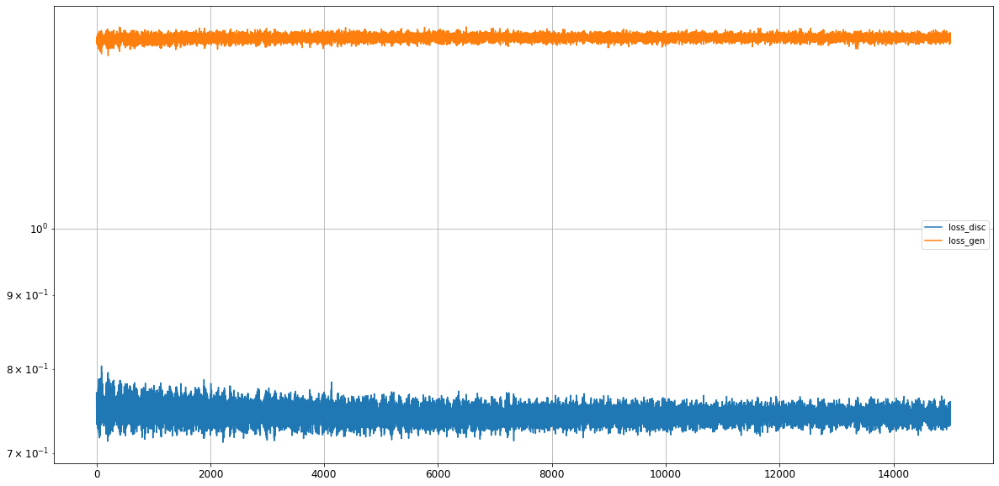

Epoch 15002/50000
discriminator loss: 1.347093 - generator loss: 0.737006 - 1s
Epoch 15003/50000
discriminator loss: 1.351686 - generator loss: 0.741853 - 1s
Epoch 15004/50000
discriminator loss: 1.356575 - generator loss: 0.751322 - 1s
Epoch 15005/50000
discriminator loss: 1.362004 - generator loss: 0.737690 - 1s
Epoch 15006/50000
discriminator loss: 1.354409 - generator loss: 0.751184 - 1s
Epoch 15007/50000
discriminator loss: 1.347470 - generator loss: 0.756580 - 1s
Epoch 15008/50000
discriminator loss: 1.356148 - generator loss: 0.740889 - 1s
Epoch 15009/50000
discriminator loss: 1.365924 - generator loss: 0.722951 - 1s
Epoch 15010/50000
discriminator loss: 1.352535 - generator loss: 0.738783 - 1s
Epoch 15011/50000
discriminator loss: 1.345427 - generator loss: 0.746284 - 1s
Epoch 15012/50000
discriminator loss: 1.349157 - generator loss: 0.744108 - 1s
Epoch 15013/50000
discriminator loss: 1.357237 - generator loss: 0.751045 - 1s
Epoch 15014/50000
discriminator loss: 1.364152 - gen

discriminator loss: 1.352049 - generator loss: 0.749700 - 1s
Epoch 15107/50000
discriminator loss: 1.346499 - generator loss: 0.753276 - 1s
Epoch 15108/50000
discriminator loss: 1.345764 - generator loss: 0.752349 - 1s
Epoch 15109/50000
discriminator loss: 1.359130 - generator loss: 0.734079 - 1s
Epoch 15110/50000
discriminator loss: 1.356196 - generator loss: 0.736061 - 1s
Epoch 15111/50000
discriminator loss: 1.359717 - generator loss: 0.733250 - 1s
Epoch 15112/50000
discriminator loss: 1.348791 - generator loss: 0.744147 - 1s
Epoch 15113/50000
discriminator loss: 1.351311 - generator loss: 0.746755 - 1s
Epoch 15114/50000
discriminator loss: 1.350821 - generator loss: 0.748304 - 1s
Epoch 15115/50000
discriminator loss: 1.362651 - generator loss: 0.743987 - 1s
Epoch 15116/50000
discriminator loss: 1.344681 - generator loss: 0.756824 - 1s
Epoch 15117/50000
discriminator loss: 1.342757 - generator loss: 0.749762 - 1s
Epoch 15118/50000
discriminator loss: 1.356287 - generator loss: 0.734

discriminator loss: 1.362912 - generator loss: 0.733759 - 1s
Epoch 15211/50000
discriminator loss: 1.364202 - generator loss: 0.726735 - 1s
Epoch 15212/50000
discriminator loss: 1.350325 - generator loss: 0.735260 - 1s
Epoch 15213/50000
discriminator loss: 1.352833 - generator loss: 0.739775 - 1s
Epoch 15214/50000
discriminator loss: 1.350990 - generator loss: 0.750299 - 1s
Epoch 15215/50000
discriminator loss: 1.369972 - generator loss: 0.741144 - 1s
Epoch 15216/50000
discriminator loss: 1.344899 - generator loss: 0.761533 - 1s
Epoch 15217/50000
discriminator loss: 1.341174 - generator loss: 0.755253 - 1s
Epoch 15218/50000
discriminator loss: 1.359449 - generator loss: 0.734713 - 1s
Epoch 15219/50000
discriminator loss: 1.357641 - generator loss: 0.730171 - 1s
Epoch 15220/50000
discriminator loss: 1.356433 - generator loss: 0.734766 - 1s
Epoch 15221/50000
discriminator loss: 1.347880 - generator loss: 0.744478 - 1s
Epoch 15222/50000
discriminator loss: 1.348814 - generator loss: 0.756

discriminator loss: 1.357997 - generator loss: 0.733795 - 1s
Epoch 15315/50000
discriminator loss: 1.352619 - generator loss: 0.732258 - 1s
Epoch 15316/50000
discriminator loss: 1.353031 - generator loss: 0.745882 - 1s
Epoch 15317/50000
discriminator loss: 1.360497 - generator loss: 0.744822 - 1s
Epoch 15318/50000
discriminator loss: 1.365692 - generator loss: 0.742985 - 1s
Epoch 15319/50000
discriminator loss: 1.355269 - generator loss: 0.744239 - 1s
Epoch 15320/50000
discriminator loss: 1.350585 - generator loss: 0.747620 - 1s
Epoch 15321/50000
discriminator loss: 1.349026 - generator loss: 0.748342 - 1s
Epoch 15322/50000
discriminator loss: 1.364957 - generator loss: 0.726160 - 1s
Epoch 15323/50000
discriminator loss: 1.361566 - generator loss: 0.730497 - 1s
Epoch 15324/50000
discriminator loss: 1.355063 - generator loss: 0.740674 - 1s
Epoch 15325/50000
discriminator loss: 1.355097 - generator loss: 0.739842 - 1s
Epoch 15326/50000
discriminator loss: 1.361580 - generator loss: 0.742

discriminator loss: 1.356677 - generator loss: 0.743308 - 1s
Epoch 15419/50000
discriminator loss: 1.351209 - generator loss: 0.746058 - 1s
Epoch 15420/50000
discriminator loss: 1.359698 - generator loss: 0.739703 - 1s
Epoch 15421/50000
discriminator loss: 1.356171 - generator loss: 0.743478 - 1s
Epoch 15422/50000
discriminator loss: 1.353437 - generator loss: 0.746060 - 1s
Epoch 15423/50000
discriminator loss: 1.355641 - generator loss: 0.740377 - 1s
Epoch 15424/50000
discriminator loss: 1.354409 - generator loss: 0.739223 - 1s
Epoch 15425/50000
discriminator loss: 1.347435 - generator loss: 0.748786 - 1s
Epoch 15426/50000
discriminator loss: 1.355394 - generator loss: 0.747208 - 1s
Epoch 15427/50000
discriminator loss: 1.357345 - generator loss: 0.754375 - 1s
Epoch 15428/50000
discriminator loss: 1.348089 - generator loss: 0.750244 - 1s
Epoch 15429/50000
discriminator loss: 1.348975 - generator loss: 0.745960 - 1s
Epoch 15430/50000
discriminator loss: 1.352433 - generator loss: 0.742

discriminator loss: 1.359960 - generator loss: 0.731023 - 1s
Epoch 15523/50000
discriminator loss: 1.350602 - generator loss: 0.738691 - 1s
Epoch 15524/50000
discriminator loss: 1.349010 - generator loss: 0.741697 - 1s
Epoch 15525/50000
discriminator loss: 1.357103 - generator loss: 0.745377 - 1s
Epoch 15526/50000
discriminator loss: 1.357412 - generator loss: 0.744349 - 1s
Epoch 15527/50000
discriminator loss: 1.355822 - generator loss: 0.755450 - 1s
Epoch 15528/50000
discriminator loss: 1.351347 - generator loss: 0.749497 - 1s
Epoch 15529/50000
discriminator loss: 1.342836 - generator loss: 0.756575 - 1s
Epoch 15530/50000
discriminator loss: 1.363426 - generator loss: 0.732911 - 1s
Epoch 15531/50000
discriminator loss: 1.357316 - generator loss: 0.737289 - 1s
Epoch 15532/50000
discriminator loss: 1.361827 - generator loss: 0.732949 - 1s
Epoch 15533/50000
discriminator loss: 1.348184 - generator loss: 0.741877 - 1s
Epoch 15534/50000
discriminator loss: 1.348325 - generator loss: 0.746

discriminator loss: 1.352612 - generator loss: 0.739685 - 1s
Epoch 15627/50000
discriminator loss: 1.351021 - generator loss: 0.737111 - 1s
Epoch 15628/50000
discriminator loss: 1.354255 - generator loss: 0.745133 - 1s
Epoch 15629/50000
discriminator loss: 1.358538 - generator loss: 0.745801 - 1s
Epoch 15630/50000
discriminator loss: 1.353796 - generator loss: 0.747008 - 1s
Epoch 15631/50000
discriminator loss: 1.356866 - generator loss: 0.745800 - 1s
Epoch 15632/50000
discriminator loss: 1.357810 - generator loss: 0.741480 - 1s
Epoch 15633/50000
discriminator loss: 1.353579 - generator loss: 0.737091 - 1s
Epoch 15634/50000
discriminator loss: 1.357477 - generator loss: 0.735839 - 1s
Epoch 15635/50000
discriminator loss: 1.351842 - generator loss: 0.742764 - 1s
Epoch 15636/50000
discriminator loss: 1.349145 - generator loss: 0.744089 - 1s
Epoch 15637/50000
discriminator loss: 1.355280 - generator loss: 0.740981 - 1s
Epoch 15638/50000
discriminator loss: 1.353924 - generator loss: 0.744

discriminator loss: 1.363789 - generator loss: 0.746264 - 1s
Epoch 15731/50000
discriminator loss: 1.356363 - generator loss: 0.753713 - 1s
Epoch 15732/50000
discriminator loss: 1.353739 - generator loss: 0.743358 - 1s
Epoch 15733/50000
discriminator loss: 1.349487 - generator loss: 0.748880 - 1s
Epoch 15734/50000
discriminator loss: 1.360751 - generator loss: 0.732179 - 1s
Epoch 15735/50000
discriminator loss: 1.358236 - generator loss: 0.736164 - 1s
Epoch 15736/50000
discriminator loss: 1.351115 - generator loss: 0.732318 - 1s
Epoch 15737/50000
discriminator loss: 1.348854 - generator loss: 0.748033 - 1s
Epoch 15738/50000
discriminator loss: 1.351245 - generator loss: 0.748423 - 1s
Epoch 15739/50000
discriminator loss: 1.353227 - generator loss: 0.748492 - 1s
Epoch 15740/50000
discriminator loss: 1.353216 - generator loss: 0.752014 - 1s
Epoch 15741/50000
discriminator loss: 1.347850 - generator loss: 0.750039 - 1s
Epoch 15742/50000
discriminator loss: 1.358216 - generator loss: 0.739

discriminator loss: 1.351515 - generator loss: 0.741798 - 1s
Epoch 15835/50000
discriminator loss: 1.364589 - generator loss: 0.737157 - 1s
Epoch 15836/50000
discriminator loss: 1.354163 - generator loss: 0.728929 - 1s
Epoch 15837/50000
discriminator loss: 1.357428 - generator loss: 0.744548 - 1s
Epoch 15838/50000
discriminator loss: 1.355255 - generator loss: 0.746855 - 1s
Epoch 15839/50000
discriminator loss: 1.358733 - generator loss: 0.740603 - 1s
Epoch 15840/50000
discriminator loss: 1.349808 - generator loss: 0.751129 - 1s
Epoch 15841/50000
discriminator loss: 1.350522 - generator loss: 0.748574 - 1s
Epoch 15842/50000
discriminator loss: 1.353346 - generator loss: 0.744258 - 1s
Epoch 15843/50000
discriminator loss: 1.356358 - generator loss: 0.732559 - 1s
Epoch 15844/50000
discriminator loss: 1.359047 - generator loss: 0.739519 - 1s
Epoch 15845/50000
discriminator loss: 1.355661 - generator loss: 0.741873 - 1s
Epoch 15846/50000
discriminator loss: 1.348433 - generator loss: 0.749

discriminator loss: 1.365890 - generator loss: 0.739094 - 1s
Epoch 15939/50000
discriminator loss: 1.362486 - generator loss: 0.742935 - 1s
Epoch 15940/50000
discriminator loss: 1.341084 - generator loss: 0.759743 - 1s
Epoch 15941/50000
discriminator loss: 1.355895 - generator loss: 0.741996 - 1s
Epoch 15942/50000
discriminator loss: 1.357606 - generator loss: 0.749118 - 1s
Epoch 15943/50000
discriminator loss: 1.367874 - generator loss: 0.726136 - 1s
Epoch 15944/50000
discriminator loss: 1.358141 - generator loss: 0.736062 - 1s
Epoch 15945/50000
discriminator loss: 1.345483 - generator loss: 0.742179 - 1s
Epoch 15946/50000
discriminator loss: 1.354153 - generator loss: 0.742400 - 1s
Epoch 15947/50000
discriminator loss: 1.349273 - generator loss: 0.749142 - 1s
Epoch 15948/50000
discriminator loss: 1.350478 - generator loss: 0.757253 - 1s
Epoch 15949/50000
discriminator loss: 1.344566 - generator loss: 0.761618 - 1s
Epoch 15950/50000
discriminator loss: 1.350502 - generator loss: 0.744

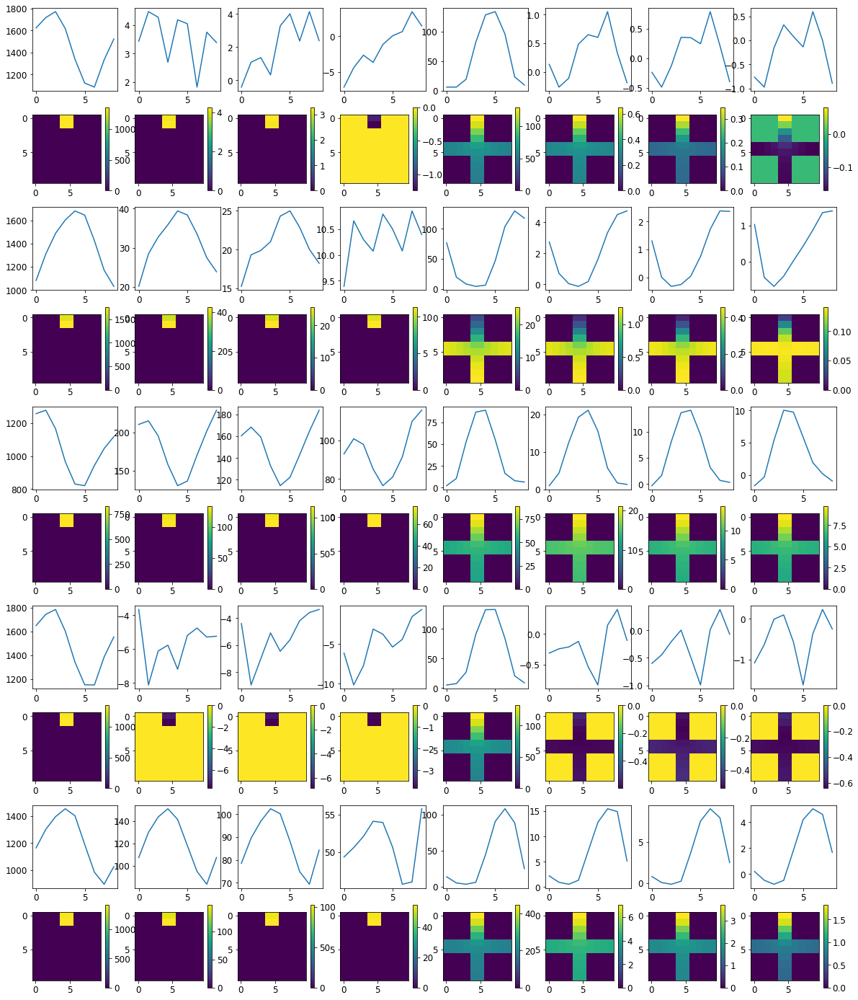

Loss: 


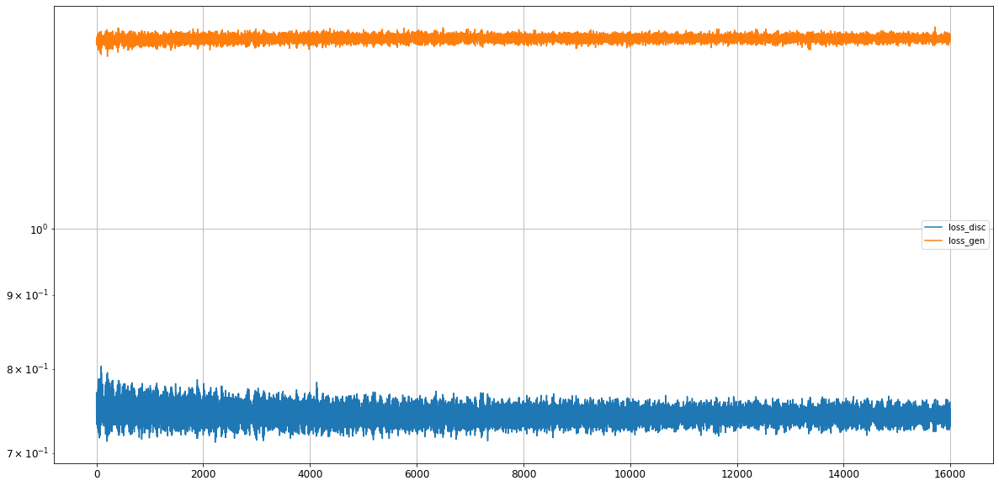

Epoch 16002/50000
discriminator loss: 1.352373 - generator loss: 0.741287 - 1s
Epoch 16003/50000
discriminator loss: 1.355934 - generator loss: 0.740546 - 1s
Epoch 16004/50000
discriminator loss: 1.359002 - generator loss: 0.735099 - 1s
Epoch 16005/50000
discriminator loss: 1.350475 - generator loss: 0.741009 - 1s
Epoch 16006/50000
discriminator loss: 1.354434 - generator loss: 0.741285 - 1s
Epoch 16007/50000
discriminator loss: 1.358542 - generator loss: 0.748074 - 1s
Epoch 16008/50000
discriminator loss: 1.361023 - generator loss: 0.745292 - 1s
Epoch 16009/50000
discriminator loss: 1.351878 - generator loss: 0.754046 - 1s
Epoch 16010/50000
discriminator loss: 1.352041 - generator loss: 0.742084 - 1s
Epoch 16011/50000
discriminator loss: 1.363599 - generator loss: 0.730693 - 1s
Epoch 16012/50000
discriminator loss: 1.356902 - generator loss: 0.733204 - 1s
Epoch 16013/50000
discriminator loss: 1.354468 - generator loss: 0.734965 - 1s
Epoch 16014/50000
discriminator loss: 1.357580 - gen

discriminator loss: 1.352913 - generator loss: 0.737781 - 1s
Epoch 16107/50000
discriminator loss: 1.344739 - generator loss: 0.747610 - 1s
Epoch 16108/50000
discriminator loss: 1.363362 - generator loss: 0.741547 - 1s
Epoch 16109/50000
discriminator loss: 1.361548 - generator loss: 0.739096 - 1s
Epoch 16110/50000
discriminator loss: 1.353621 - generator loss: 0.746773 - 1s
Epoch 16111/50000
discriminator loss: 1.355507 - generator loss: 0.753633 - 1s
Epoch 16112/50000
discriminator loss: 1.355106 - generator loss: 0.741737 - 1s
Epoch 16113/50000
discriminator loss: 1.352813 - generator loss: 0.737222 - 1s
Epoch 16114/50000
discriminator loss: 1.350532 - generator loss: 0.739738 - 1s
Epoch 16115/50000
discriminator loss: 1.342618 - generator loss: 0.742762 - 1s
Epoch 16116/50000
discriminator loss: 1.354497 - generator loss: 0.745889 - 1s
Epoch 16117/50000
discriminator loss: 1.361820 - generator loss: 0.736805 - 1s
Epoch 16118/50000
discriminator loss: 1.364063 - generator loss: 0.738

discriminator loss: 1.347181 - generator loss: 0.740732 - 1s
Epoch 16211/50000
discriminator loss: 1.353697 - generator loss: 0.742492 - 1s
Epoch 16212/50000
discriminator loss: 1.352775 - generator loss: 0.754426 - 1s
Epoch 16213/50000
discriminator loss: 1.349941 - generator loss: 0.751359 - 1s
Epoch 16214/50000
discriminator loss: 1.341000 - generator loss: 0.757712 - 1s
Epoch 16215/50000
discriminator loss: 1.356019 - generator loss: 0.745541 - 1s
Epoch 16216/50000
discriminator loss: 1.350890 - generator loss: 0.736519 - 1s
Epoch 16217/50000
discriminator loss: 1.354267 - generator loss: 0.735462 - 1s
Epoch 16218/50000
discriminator loss: 1.351755 - generator loss: 0.743862 - 1s
Epoch 16219/50000
discriminator loss: 1.349514 - generator loss: 0.747094 - 1s
Epoch 16220/50000
discriminator loss: 1.365495 - generator loss: 0.733366 - 1s
Epoch 16221/50000
discriminator loss: 1.364548 - generator loss: 0.745742 - 1s
Epoch 16222/50000
discriminator loss: 1.347279 - generator loss: 0.757

discriminator loss: 1.368024 - generator loss: 0.735798 - 1s
Epoch 16315/50000
discriminator loss: 1.357473 - generator loss: 0.746942 - 1s
Epoch 16316/50000
discriminator loss: 1.350155 - generator loss: 0.751816 - 1s
Epoch 16317/50000
discriminator loss: 1.357401 - generator loss: 0.741377 - 1s
Epoch 16318/50000
discriminator loss: 1.357978 - generator loss: 0.734507 - 1s
Epoch 16319/50000
discriminator loss: 1.350575 - generator loss: 0.742245 - 1s
Epoch 16320/50000
discriminator loss: 1.348282 - generator loss: 0.742289 - 1s
Epoch 16321/50000
discriminator loss: 1.355875 - generator loss: 0.741059 - 1s
Epoch 16322/50000
discriminator loss: 1.359422 - generator loss: 0.745057 - 1s
Epoch 16323/50000
discriminator loss: 1.358078 - generator loss: 0.751014 - 1s
Epoch 16324/50000
discriminator loss: 1.355718 - generator loss: 0.749904 - 1s
Epoch 16325/50000
discriminator loss: 1.352944 - generator loss: 0.745204 - 1s
Epoch 16326/50000
discriminator loss: 1.364977 - generator loss: 0.727

discriminator loss: 1.357668 - generator loss: 0.733882 - 1s
Epoch 16419/50000
discriminator loss: 1.360943 - generator loss: 0.736318 - 1s
Epoch 16420/50000
discriminator loss: 1.355868 - generator loss: 0.731708 - 1s
Epoch 16421/50000
discriminator loss: 1.348030 - generator loss: 0.746741 - 1s
Epoch 16422/50000
discriminator loss: 1.355924 - generator loss: 0.742449 - 1s
Epoch 16423/50000
discriminator loss: 1.349536 - generator loss: 0.749071 - 1s
Epoch 16424/50000
discriminator loss: 1.346713 - generator loss: 0.751914 - 1s
Epoch 16425/50000
discriminator loss: 1.348689 - generator loss: 0.751269 - 1s
Epoch 16426/50000
discriminator loss: 1.350341 - generator loss: 0.751249 - 1s
Epoch 16427/50000
discriminator loss: 1.348796 - generator loss: 0.739000 - 1s
Epoch 16428/50000
discriminator loss: 1.359433 - generator loss: 0.735545 - 1s
Epoch 16429/50000
discriminator loss: 1.355152 - generator loss: 0.738390 - 1s
Epoch 16430/50000
discriminator loss: 1.350097 - generator loss: 0.739

discriminator loss: 1.354532 - generator loss: 0.742063 - 1s
Epoch 16523/50000
discriminator loss: 1.354206 - generator loss: 0.735200 - 1s
Epoch 16524/50000
discriminator loss: 1.347039 - generator loss: 0.744645 - 1s
Epoch 16525/50000
discriminator loss: 1.348411 - generator loss: 0.747549 - 1s
Epoch 16526/50000
discriminator loss: 1.348246 - generator loss: 0.747651 - 1s
Epoch 16527/50000
discriminator loss: 1.351722 - generator loss: 0.751825 - 1s
Epoch 16528/50000
discriminator loss: 1.348224 - generator loss: 0.752672 - 1s
Epoch 16529/50000
discriminator loss: 1.355895 - generator loss: 0.742923 - 1s
Epoch 16530/50000
discriminator loss: 1.357662 - generator loss: 0.734084 - 1s
Epoch 16531/50000
discriminator loss: 1.360332 - generator loss: 0.727710 - 1s
Epoch 16532/50000
discriminator loss: 1.344023 - generator loss: 0.749012 - 1s
Epoch 16533/50000
discriminator loss: 1.354665 - generator loss: 0.741774 - 1s
Epoch 16534/50000
discriminator loss: 1.360367 - generator loss: 0.746

discriminator loss: 1.358159 - generator loss: 0.742170 - 1s
Epoch 16627/50000
discriminator loss: 1.342878 - generator loss: 0.745273 - 1s
Epoch 16628/50000
discriminator loss: 1.356794 - generator loss: 0.734087 - 1s
Epoch 16629/50000
discriminator loss: 1.360925 - generator loss: 0.740999 - 1s
Epoch 16630/50000
discriminator loss: 1.352964 - generator loss: 0.750204 - 1s
Epoch 16631/50000
discriminator loss: 1.342619 - generator loss: 0.757219 - 1s
Epoch 16632/50000
discriminator loss: 1.353945 - generator loss: 0.743306 - 1s
Epoch 16633/50000
discriminator loss: 1.351847 - generator loss: 0.745303 - 1s
Epoch 16634/50000
discriminator loss: 1.364319 - generator loss: 0.729851 - 1s
Epoch 16635/50000
discriminator loss: 1.345736 - generator loss: 0.739578 - 1s
Epoch 16636/50000
discriminator loss: 1.348909 - generator loss: 0.747371 - 1s
Epoch 16637/50000
discriminator loss: 1.357155 - generator loss: 0.748089 - 1s
Epoch 16638/50000
discriminator loss: 1.349743 - generator loss: 0.746

discriminator loss: 1.365005 - generator loss: 0.736368 - 1s
Epoch 16731/50000
discriminator loss: 1.353117 - generator loss: 0.743462 - 1s
Epoch 16732/50000
discriminator loss: 1.346347 - generator loss: 0.751310 - 1s
Epoch 16733/50000
discriminator loss: 1.356232 - generator loss: 0.752724 - 1s
Epoch 16734/50000
discriminator loss: 1.356413 - generator loss: 0.743531 - 1s
Epoch 16735/50000
discriminator loss: 1.356559 - generator loss: 0.738971 - 1s
Epoch 16736/50000
discriminator loss: 1.352135 - generator loss: 0.738311 - 1s
Epoch 16737/50000
discriminator loss: 1.348635 - generator loss: 0.749126 - 1s
Epoch 16738/50000
discriminator loss: 1.350104 - generator loss: 0.745776 - 1s
Epoch 16739/50000
discriminator loss: 1.357377 - generator loss: 0.742795 - 1s
Epoch 16740/50000
discriminator loss: 1.359425 - generator loss: 0.748838 - 1s
Epoch 16741/50000
discriminator loss: 1.351451 - generator loss: 0.752364 - 1s
Epoch 16742/50000
discriminator loss: 1.353963 - generator loss: 0.745

discriminator loss: 1.362791 - generator loss: 0.742139 - 1s
Epoch 16835/50000
discriminator loss: 1.357145 - generator loss: 0.743731 - 1s
Epoch 16836/50000
discriminator loss: 1.351820 - generator loss: 0.759133 - 1s
Epoch 16837/50000
discriminator loss: 1.349086 - generator loss: 0.745075 - 1s
Epoch 16838/50000
discriminator loss: 1.358387 - generator loss: 0.734963 - 1s
Epoch 16839/50000
discriminator loss: 1.350611 - generator loss: 0.740117 - 1s
Epoch 16840/50000
discriminator loss: 1.342854 - generator loss: 0.747274 - 1s
Epoch 16841/50000
discriminator loss: 1.346028 - generator loss: 0.748711 - 1s
Epoch 16842/50000
discriminator loss: 1.354783 - generator loss: 0.744670 - 1s
Epoch 16843/50000
discriminator loss: 1.358325 - generator loss: 0.747639 - 1s
Epoch 16844/50000
discriminator loss: 1.354516 - generator loss: 0.742387 - 1s
Epoch 16845/50000
discriminator loss: 1.341811 - generator loss: 0.757186 - 1s
Epoch 16846/50000
discriminator loss: 1.356888 - generator loss: 0.748

discriminator loss: 1.353573 - generator loss: 0.744129 - 1s
Epoch 16939/50000
discriminator loss: 1.359752 - generator loss: 0.737439 - 1s
Epoch 16940/50000
discriminator loss: 1.365015 - generator loss: 0.732641 - 1s
Epoch 16941/50000
discriminator loss: 1.356378 - generator loss: 0.752041 - 1s
Epoch 16942/50000
discriminator loss: 1.347492 - generator loss: 0.748932 - 1s
Epoch 16943/50000
discriminator loss: 1.359501 - generator loss: 0.747797 - 1s
Epoch 16944/50000
discriminator loss: 1.356654 - generator loss: 0.737597 - 1s
Epoch 16945/50000
discriminator loss: 1.350129 - generator loss: 0.736637 - 1s
Epoch 16946/50000
discriminator loss: 1.345656 - generator loss: 0.741404 - 1s
Epoch 16947/50000
discriminator loss: 1.350116 - generator loss: 0.747630 - 1s
Epoch 16948/50000
discriminator loss: 1.354878 - generator loss: 0.747997 - 1s
Epoch 16949/50000
discriminator loss: 1.354984 - generator loss: 0.755092 - 1s
Epoch 16950/50000
discriminator loss: 1.346460 - generator loss: 0.753

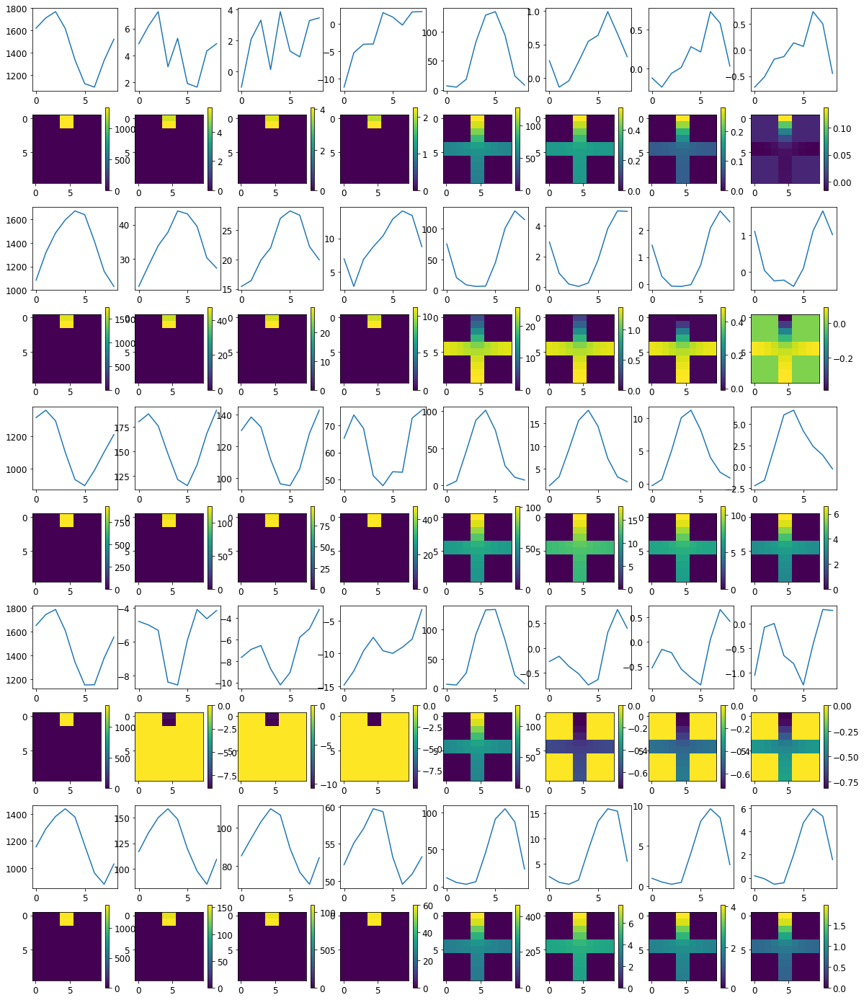

Loss: 


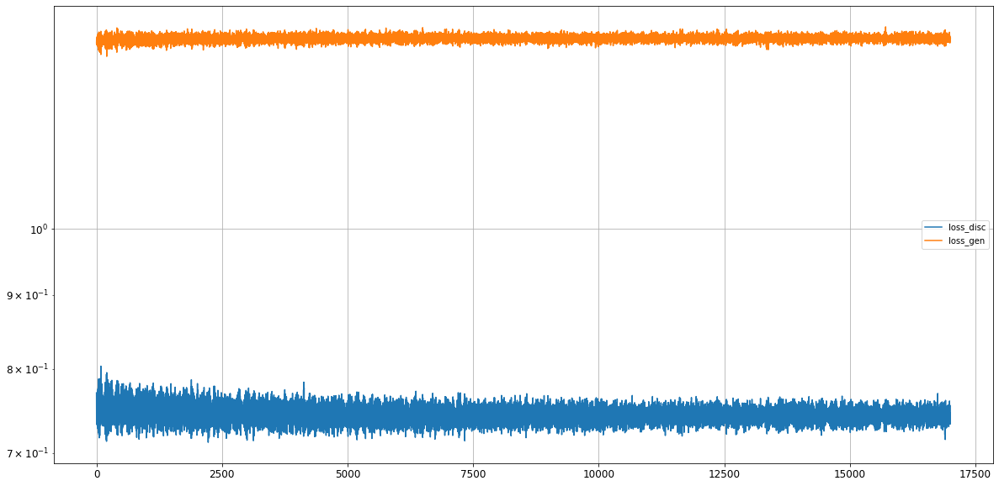

Epoch 17002/50000
discriminator loss: 1.353379 - generator loss: 0.751833 - 1s
Epoch 17003/50000
discriminator loss: 1.367267 - generator loss: 0.737802 - 1s
Epoch 17004/50000
discriminator loss: 1.347760 - generator loss: 0.741417 - 1s
Epoch 17005/50000
discriminator loss: 1.355155 - generator loss: 0.741229 - 1s
Epoch 17006/50000
discriminator loss: 1.350269 - generator loss: 0.745325 - 1s
Epoch 17007/50000
discriminator loss: 1.354402 - generator loss: 0.739461 - 1s
Epoch 17008/50000
discriminator loss: 1.351393 - generator loss: 0.746367 - 1s
Epoch 17009/50000
discriminator loss: 1.354154 - generator loss: 0.747132 - 1s
Epoch 17010/50000
discriminator loss: 1.357530 - generator loss: 0.747109 - 1s
Epoch 17011/50000
discriminator loss: 1.356486 - generator loss: 0.740918 - 1s
Epoch 17012/50000
discriminator loss: 1.357329 - generator loss: 0.735660 - 1s
Epoch 17013/50000
discriminator loss: 1.353025 - generator loss: 0.739123 - 1s
Epoch 17014/50000
discriminator loss: 1.350088 - gen

discriminator loss: 1.344984 - generator loss: 0.741250 - 1s
Epoch 17107/50000
discriminator loss: 1.353843 - generator loss: 0.744346 - 1s
Epoch 17108/50000
discriminator loss: 1.354581 - generator loss: 0.745704 - 1s
Epoch 17109/50000
discriminator loss: 1.356164 - generator loss: 0.748264 - 1s
Epoch 17110/50000
discriminator loss: 1.345193 - generator loss: 0.759841 - 1s
Epoch 17111/50000
discriminator loss: 1.355370 - generator loss: 0.744848 - 1s
Epoch 17112/50000
discriminator loss: 1.361253 - generator loss: 0.738772 - 1s
Epoch 17113/50000
discriminator loss: 1.354186 - generator loss: 0.730896 - 1s
Epoch 17114/50000
discriminator loss: 1.352386 - generator loss: 0.736319 - 1s
Epoch 17115/50000
discriminator loss: 1.346546 - generator loss: 0.752069 - 1s
Epoch 17116/50000
discriminator loss: 1.351953 - generator loss: 0.749603 - 1s
Epoch 17117/50000
discriminator loss: 1.367108 - generator loss: 0.737630 - 1s
Epoch 17118/50000
discriminator loss: 1.351863 - generator loss: 0.756

discriminator loss: 1.348648 - generator loss: 0.747095 - 1s
Epoch 17211/50000
discriminator loss: 1.365542 - generator loss: 0.735980 - 1s
Epoch 17212/50000
discriminator loss: 1.353876 - generator loss: 0.755245 - 1s
Epoch 17213/50000
discriminator loss: 1.355568 - generator loss: 0.740631 - 1s
Epoch 17214/50000
discriminator loss: 1.356753 - generator loss: 0.748545 - 1s
Epoch 17215/50000
discriminator loss: 1.351180 - generator loss: 0.747461 - 1s
Epoch 17216/50000
discriminator loss: 1.354698 - generator loss: 0.734596 - 1s
Epoch 17217/50000
discriminator loss: 1.343496 - generator loss: 0.749678 - 1s
Epoch 17218/50000
discriminator loss: 1.346868 - generator loss: 0.745423 - 1s
Epoch 17219/50000
discriminator loss: 1.357358 - generator loss: 0.742742 - 1s
Epoch 17220/50000
discriminator loss: 1.355336 - generator loss: 0.741206 - 1s
Epoch 17221/50000
discriminator loss: 1.348781 - generator loss: 0.754704 - 1s
Epoch 17222/50000
discriminator loss: 1.347703 - generator loss: 0.750

discriminator loss: 1.354053 - generator loss: 0.752839 - 1s
Epoch 17315/50000
discriminator loss: 1.344468 - generator loss: 0.752256 - 1s
Epoch 17316/50000
discriminator loss: 1.346286 - generator loss: 0.755485 - 1s
Epoch 17317/50000
discriminator loss: 1.359415 - generator loss: 0.735370 - 1s
Epoch 17318/50000
discriminator loss: 1.354193 - generator loss: 0.738047 - 1s
Epoch 17319/50000
discriminator loss: 1.356971 - generator loss: 0.740096 - 1s
Epoch 17320/50000
discriminator loss: 1.348278 - generator loss: 0.741431 - 1s
Epoch 17321/50000
discriminator loss: 1.356716 - generator loss: 0.744370 - 1s
Epoch 17322/50000
discriminator loss: 1.362486 - generator loss: 0.742738 - 1s
Epoch 17323/50000
discriminator loss: 1.360167 - generator loss: 0.747140 - 1s
Epoch 17324/50000
discriminator loss: 1.346605 - generator loss: 0.755015 - 1s
Epoch 17325/50000
discriminator loss: 1.359966 - generator loss: 0.740685 - 1s
Epoch 17326/50000
discriminator loss: 1.355289 - generator loss: 0.738

discriminator loss: 1.351369 - generator loss: 0.737381 - 1s
Epoch 17419/50000
discriminator loss: 1.355567 - generator loss: 0.743670 - 1s
Epoch 17420/50000
discriminator loss: 1.356829 - generator loss: 0.741316 - 1s
Epoch 17421/50000
discriminator loss: 1.352777 - generator loss: 0.741461 - 1s
Epoch 17422/50000
discriminator loss: 1.354130 - generator loss: 0.741594 - 1s
Epoch 17423/50000
discriminator loss: 1.353714 - generator loss: 0.748493 - 1s
Epoch 17424/50000
discriminator loss: 1.357880 - generator loss: 0.746372 - 1s
Epoch 17425/50000
discriminator loss: 1.352648 - generator loss: 0.747853 - 1s
Epoch 17426/50000
discriminator loss: 1.360978 - generator loss: 0.740539 - 1s
Epoch 17427/50000
discriminator loss: 1.352586 - generator loss: 0.745869 - 1s
Epoch 17428/50000
discriminator loss: 1.359807 - generator loss: 0.735223 - 1s
Epoch 17429/50000
discriminator loss: 1.350228 - generator loss: 0.746131 - 1s
Epoch 17430/50000
discriminator loss: 1.354563 - generator loss: 0.741

discriminator loss: 1.349156 - generator loss: 0.740977 - 1s
Epoch 17523/50000
discriminator loss: 1.339775 - generator loss: 0.744829 - 1s
Epoch 17524/50000
discriminator loss: 1.357164 - generator loss: 0.743624 - 1s
Epoch 17525/50000
discriminator loss: 1.370655 - generator loss: 0.739252 - 1s
Epoch 17526/50000
discriminator loss: 1.350317 - generator loss: 0.759847 - 1s
Epoch 17527/50000
discriminator loss: 1.346920 - generator loss: 0.757679 - 1s
Epoch 17528/50000
discriminator loss: 1.345239 - generator loss: 0.752343 - 1s
Epoch 17529/50000
discriminator loss: 1.354993 - generator loss: 0.738291 - 1s
Epoch 17530/50000
discriminator loss: 1.363611 - generator loss: 0.730709 - 1s
Epoch 17531/50000
discriminator loss: 1.347538 - generator loss: 0.737883 - 1s
Epoch 17532/50000
discriminator loss: 1.342012 - generator loss: 0.751452 - 1s
Epoch 17533/50000
discriminator loss: 1.360689 - generator loss: 0.748602 - 1s
Epoch 17534/50000
discriminator loss: 1.362873 - generator loss: 0.738

discriminator loss: 1.354385 - generator loss: 0.744150 - 1s
Epoch 17627/50000
discriminator loss: 1.348049 - generator loss: 0.748991 - 1s
Epoch 17628/50000
discriminator loss: 1.357449 - generator loss: 0.733165 - 1s
Epoch 17629/50000
discriminator loss: 1.351977 - generator loss: 0.740769 - 1s
Epoch 17630/50000
discriminator loss: 1.353349 - generator loss: 0.743774 - 1s
Epoch 17631/50000
discriminator loss: 1.359399 - generator loss: 0.740942 - 1s
Epoch 17632/50000
discriminator loss: 1.360440 - generator loss: 0.735273 - 1s
Epoch 17633/50000
discriminator loss: 1.360215 - generator loss: 0.746687 - 1s
Epoch 17634/50000
discriminator loss: 1.356288 - generator loss: 0.753979 - 1s
Epoch 17635/50000
discriminator loss: 1.348742 - generator loss: 0.747041 - 1s
Epoch 17636/50000
discriminator loss: 1.363126 - generator loss: 0.730435 - 1s
Epoch 17637/50000
discriminator loss: 1.363379 - generator loss: 0.732063 - 1s
Epoch 17638/50000
discriminator loss: 1.355270 - generator loss: 0.741

discriminator loss: 1.357908 - generator loss: 0.750143 - 1s
Epoch 17731/50000
discriminator loss: 1.351330 - generator loss: 0.746689 - 1s
Epoch 17732/50000
discriminator loss: 1.345929 - generator loss: 0.757083 - 1s
Epoch 17733/50000
discriminator loss: 1.351576 - generator loss: 0.744094 - 1s
Epoch 17734/50000
discriminator loss: 1.355309 - generator loss: 0.740250 - 1s
Epoch 17735/50000
discriminator loss: 1.351442 - generator loss: 0.734409 - 1s
Epoch 17736/50000
discriminator loss: 1.345965 - generator loss: 0.749260 - 1s
Epoch 17737/50000
discriminator loss: 1.345775 - generator loss: 0.745253 - 1s
Epoch 17738/50000
discriminator loss: 1.355533 - generator loss: 0.749080 - 1s
Epoch 17739/50000
discriminator loss: 1.359675 - generator loss: 0.742268 - 1s
Epoch 17740/50000
discriminator loss: 1.354921 - generator loss: 0.752953 - 1s
Epoch 17741/50000
discriminator loss: 1.352783 - generator loss: 0.740814 - 1s
Epoch 17742/50000
discriminator loss: 1.355013 - generator loss: 0.745

discriminator loss: 1.366950 - generator loss: 0.740251 - 1s
Epoch 17835/50000
discriminator loss: 1.355870 - generator loss: 0.753516 - 1s
Epoch 17836/50000
discriminator loss: 1.348669 - generator loss: 0.747295 - 1s
Epoch 17837/50000
discriminator loss: 1.349168 - generator loss: 0.750879 - 1s
Epoch 17838/50000
discriminator loss: 1.366050 - generator loss: 0.726793 - 1s
Epoch 17839/50000
discriminator loss: 1.354746 - generator loss: 0.735353 - 1s
Epoch 17840/50000
discriminator loss: 1.351645 - generator loss: 0.745988 - 1s
Epoch 17841/50000
discriminator loss: 1.354182 - generator loss: 0.742134 - 1s
Epoch 17842/50000
discriminator loss: 1.362345 - generator loss: 0.735744 - 1s
Epoch 17843/50000
discriminator loss: 1.344643 - generator loss: 0.750749 - 1s
Epoch 17844/50000
discriminator loss: 1.347930 - generator loss: 0.759714 - 1s
Epoch 17845/50000
discriminator loss: 1.352052 - generator loss: 0.749766 - 1s
Epoch 17846/50000
discriminator loss: 1.359913 - generator loss: 0.734

discriminator loss: 1.357817 - generator loss: 0.755029 - 1s
Epoch 17939/50000
discriminator loss: 1.351524 - generator loss: 0.755407 - 1s
Epoch 17940/50000
discriminator loss: 1.344774 - generator loss: 0.753025 - 1s
Epoch 17941/50000
discriminator loss: 1.345739 - generator loss: 0.745225 - 1s
Epoch 17942/50000
discriminator loss: 1.354506 - generator loss: 0.736640 - 1s
Epoch 17943/50000
discriminator loss: 1.358546 - generator loss: 0.737175 - 1s
Epoch 17944/50000
discriminator loss: 1.345666 - generator loss: 0.748289 - 1s
Epoch 17945/50000
discriminator loss: 1.343115 - generator loss: 0.757456 - 1s
Epoch 17946/50000
discriminator loss: 1.356442 - generator loss: 0.736925 - 1s
Epoch 17947/50000
discriminator loss: 1.360685 - generator loss: 0.746442 - 1s
Epoch 17948/50000
discriminator loss: 1.355543 - generator loss: 0.751879 - 1s
Epoch 17949/50000
discriminator loss: 1.342671 - generator loss: 0.757511 - 1s
Epoch 17950/50000
discriminator loss: 1.357475 - generator loss: 0.738

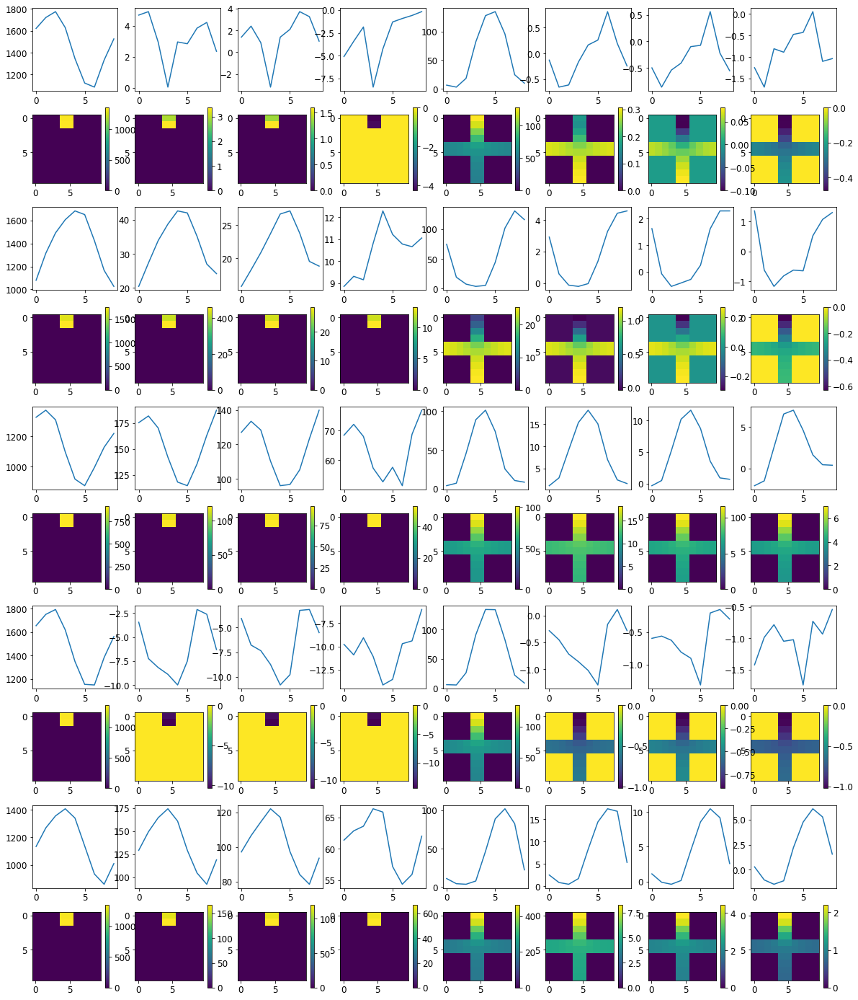

Loss: 


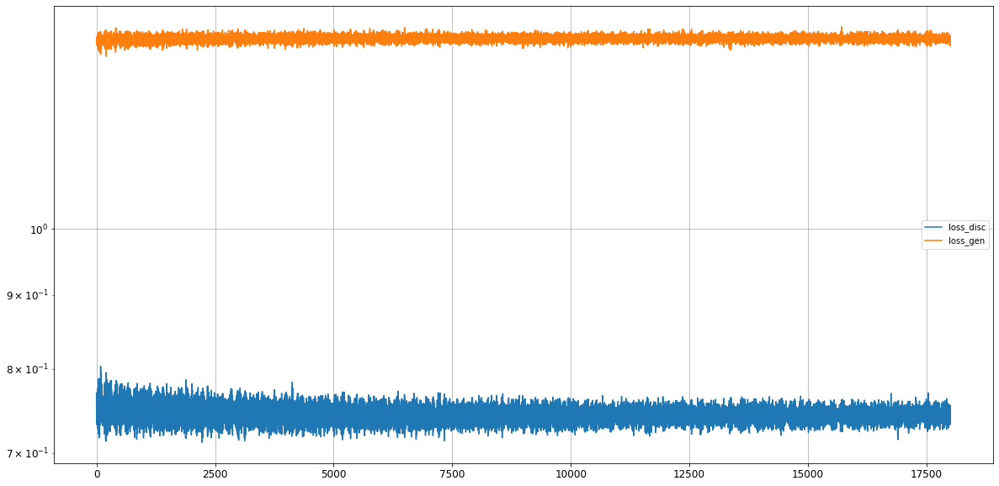

Epoch 18002/50000
discriminator loss: 1.351055 - generator loss: 0.749843 - 1s
Epoch 18003/50000
discriminator loss: 1.364586 - generator loss: 0.736844 - 1s
Epoch 18004/50000
discriminator loss: 1.353674 - generator loss: 0.742316 - 1s
Epoch 18005/50000
discriminator loss: 1.354182 - generator loss: 0.733298 - 2s
Epoch 18006/50000
discriminator loss: 1.351928 - generator loss: 0.746063 - 1s
Epoch 18007/50000
discriminator loss: 1.351785 - generator loss: 0.743794 - 1s
Epoch 18008/50000
discriminator loss: 1.357580 - generator loss: 0.742160 - 1s
Epoch 18009/50000
discriminator loss: 1.354921 - generator loss: 0.749386 - 1s
Epoch 18010/50000
discriminator loss: 1.354173 - generator loss: 0.746380 - 1s
Epoch 18011/50000
discriminator loss: 1.346404 - generator loss: 0.754813 - 1s
Epoch 18012/50000
discriminator loss: 1.354119 - generator loss: 0.740542 - 1s
Epoch 18013/50000
discriminator loss: 1.357670 - generator loss: 0.738180 - 1s
Epoch 18014/50000
discriminator loss: 1.344757 - gen

discriminator loss: 1.348198 - generator loss: 0.749075 - 1s
Epoch 18107/50000
discriminator loss: 1.354890 - generator loss: 0.738953 - 1s
Epoch 18108/50000
discriminator loss: 1.352739 - generator loss: 0.741444 - 1s
Epoch 18109/50000
discriminator loss: 1.353962 - generator loss: 0.739244 - 1s
Epoch 18110/50000
discriminator loss: 1.349128 - generator loss: 0.745922 - 1s
Epoch 18111/50000
discriminator loss: 1.355523 - generator loss: 0.739803 - 1s
Epoch 18112/50000
discriminator loss: 1.363649 - generator loss: 0.749849 - 1s
Epoch 18113/50000
discriminator loss: 1.354241 - generator loss: 0.746987 - 1s
Epoch 18114/50000
discriminator loss: 1.349655 - generator loss: 0.750063 - 1s
Epoch 18115/50000
discriminator loss: 1.351446 - generator loss: 0.742840 - 1s
Epoch 18116/50000
discriminator loss: 1.357828 - generator loss: 0.735942 - 1s
Epoch 18117/50000
discriminator loss: 1.352957 - generator loss: 0.741729 - 1s
Epoch 18118/50000
discriminator loss: 1.347427 - generator loss: 0.745

discriminator loss: 1.342592 - generator loss: 0.747683 - 1s
Epoch 18211/50000
discriminator loss: 1.361841 - generator loss: 0.741497 - 1s
Epoch 18212/50000
discriminator loss: 1.358344 - generator loss: 0.736715 - 1s
Epoch 18213/50000
discriminator loss: 1.356727 - generator loss: 0.743573 - 1s
Epoch 18214/50000
discriminator loss: 1.347562 - generator loss: 0.747310 - 1s
Epoch 18215/50000
discriminator loss: 1.349661 - generator loss: 0.739555 - 1s
Epoch 18216/50000
discriminator loss: 1.355550 - generator loss: 0.748763 - 1s
Epoch 18217/50000
discriminator loss: 1.359920 - generator loss: 0.749026 - 1s
Epoch 18218/50000
discriminator loss: 1.351565 - generator loss: 0.750251 - 1s
Epoch 18219/50000
discriminator loss: 1.352174 - generator loss: 0.743979 - 1s
Epoch 18220/50000
discriminator loss: 1.359387 - generator loss: 0.736729 - 1s
Epoch 18221/50000
discriminator loss: 1.362628 - generator loss: 0.731996 - 1s
Epoch 18222/50000
discriminator loss: 1.365153 - generator loss: 0.738

discriminator loss: 1.352642 - generator loss: 0.733541 - 1s
Epoch 18315/50000
discriminator loss: 1.360998 - generator loss: 0.733566 - 1s
Epoch 18316/50000
discriminator loss: 1.346272 - generator loss: 0.752344 - 1s
Epoch 18317/50000
discriminator loss: 1.350190 - generator loss: 0.742609 - 1s
Epoch 18318/50000
discriminator loss: 1.354142 - generator loss: 0.742791 - 1s
Epoch 18319/50000
discriminator loss: 1.345725 - generator loss: 0.759146 - 1s
Epoch 18320/50000
discriminator loss: 1.351497 - generator loss: 0.746119 - 1s
Epoch 18321/50000
discriminator loss: 1.354926 - generator loss: 0.741058 - 1s
Epoch 18322/50000
discriminator loss: 1.352956 - generator loss: 0.745485 - 1s
Epoch 18323/50000
discriminator loss: 1.357620 - generator loss: 0.736496 - 1s
Epoch 18324/50000
discriminator loss: 1.352478 - generator loss: 0.735172 - 1s
Epoch 18325/50000
discriminator loss: 1.351938 - generator loss: 0.747043 - 1s
Epoch 18326/50000
discriminator loss: 1.352749 - generator loss: 0.740

discriminator loss: 1.360382 - generator loss: 0.730826 - 1s
Epoch 18419/50000
discriminator loss: 1.358185 - generator loss: 0.731668 - 1s
Epoch 18420/50000
discriminator loss: 1.350234 - generator loss: 0.741001 - 1s
Epoch 18421/50000
discriminator loss: 1.349741 - generator loss: 0.750098 - 1s
Epoch 18422/50000
discriminator loss: 1.370209 - generator loss: 0.733945 - 1s
Epoch 18423/50000
discriminator loss: 1.357809 - generator loss: 0.747477 - 1s
Epoch 18424/50000
discriminator loss: 1.357772 - generator loss: 0.751880 - 1s
Epoch 18425/50000
discriminator loss: 1.343428 - generator loss: 0.756628 - 1s
Epoch 18426/50000
discriminator loss: 1.350833 - generator loss: 0.749118 - 1s
Epoch 18427/50000
discriminator loss: 1.359115 - generator loss: 0.737093 - 1s
Epoch 18428/50000
discriminator loss: 1.359829 - generator loss: 0.731148 - 1s
Epoch 18429/50000
discriminator loss: 1.357585 - generator loss: 0.743468 - 1s
Epoch 18430/50000
discriminator loss: 1.342552 - generator loss: 0.744

discriminator loss: 1.348058 - generator loss: 0.752472 - 1s
Epoch 18523/50000
discriminator loss: 1.358767 - generator loss: 0.743720 - 1s
Epoch 18524/50000
discriminator loss: 1.356335 - generator loss: 0.742367 - 1s
Epoch 18525/50000
discriminator loss: 1.357675 - generator loss: 0.733912 - 1s
Epoch 18526/50000
discriminator loss: 1.361536 - generator loss: 0.732886 - 1s
Epoch 18527/50000
discriminator loss: 1.354773 - generator loss: 0.742142 - 1s
Epoch 18528/50000
discriminator loss: 1.354509 - generator loss: 0.741476 - 1s
Epoch 18529/50000
discriminator loss: 1.363956 - generator loss: 0.739336 - 1s
Epoch 18530/50000
discriminator loss: 1.351952 - generator loss: 0.752485 - 1s
Epoch 18531/50000
discriminator loss: 1.352100 - generator loss: 0.753848 - 1s
Epoch 18532/50000
discriminator loss: 1.350984 - generator loss: 0.744331 - 1s
Epoch 18533/50000
discriminator loss: 1.360348 - generator loss: 0.731791 - 1s
Epoch 18534/50000
discriminator loss: 1.354501 - generator loss: 0.738

discriminator loss: 1.354487 - generator loss: 0.742759 - 1s
Epoch 18627/50000
discriminator loss: 1.350649 - generator loss: 0.745325 - 1s
Epoch 18628/50000
discriminator loss: 1.348688 - generator loss: 0.757163 - 1s
Epoch 18629/50000
discriminator loss: 1.346006 - generator loss: 0.749276 - 1s
Epoch 18630/50000
discriminator loss: 1.355485 - generator loss: 0.746409 - 1s
Epoch 18631/50000
discriminator loss: 1.350388 - generator loss: 0.739896 - 1s
Epoch 18632/50000
discriminator loss: 1.355495 - generator loss: 0.735705 - 1s
Epoch 18633/50000
discriminator loss: 1.347504 - generator loss: 0.752756 - 1s
Epoch 18634/50000
discriminator loss: 1.355772 - generator loss: 0.743687 - 1s
Epoch 18635/50000
discriminator loss: 1.354751 - generator loss: 0.742037 - 1s
Epoch 18636/50000
discriminator loss: 1.348028 - generator loss: 0.748628 - 1s
Epoch 18637/50000
discriminator loss: 1.349820 - generator loss: 0.756953 - 1s
Epoch 18638/50000
discriminator loss: 1.341800 - generator loss: 0.757

discriminator loss: 1.351901 - generator loss: 0.750409 - 1s
Epoch 18731/50000
discriminator loss: 1.354381 - generator loss: 0.745485 - 2s
Epoch 18732/50000
discriminator loss: 1.353670 - generator loss: 0.749135 - 1s
Epoch 18733/50000
discriminator loss: 1.356632 - generator loss: 0.740788 - 1s
Epoch 18734/50000
discriminator loss: 1.346686 - generator loss: 0.751884 - 1s
Epoch 18735/50000
discriminator loss: 1.359952 - generator loss: 0.733995 - 1s
Epoch 18736/50000
discriminator loss: 1.349376 - generator loss: 0.743749 - 1s
Epoch 18737/50000
discriminator loss: 1.356424 - generator loss: 0.735610 - 1s
Epoch 18738/50000
discriminator loss: 1.363949 - generator loss: 0.742087 - 1s
Epoch 18739/50000
discriminator loss: 1.354100 - generator loss: 0.746846 - 1s
Epoch 18740/50000
discriminator loss: 1.356644 - generator loss: 0.749592 - 1s
Epoch 18741/50000
discriminator loss: 1.354822 - generator loss: 0.741719 - 1s
Epoch 18742/50000
discriminator loss: 1.354873 - generator loss: 0.746

discriminator loss: 1.347786 - generator loss: 0.758332 - 1s
Epoch 18835/50000
discriminator loss: 1.353693 - generator loss: 0.737887 - 1s
Epoch 18836/50000
discriminator loss: 1.364013 - generator loss: 0.739008 - 1s
Epoch 18837/50000
discriminator loss: 1.360660 - generator loss: 0.729845 - 1s
Epoch 18838/50000
discriminator loss: 1.349338 - generator loss: 0.741099 - 1s
Epoch 18839/50000
discriminator loss: 1.351455 - generator loss: 0.752380 - 1s
Epoch 18840/50000
discriminator loss: 1.376861 - generator loss: 0.729181 - 1s
Epoch 18841/50000
discriminator loss: 1.354842 - generator loss: 0.749288 - 1s
Epoch 18842/50000
discriminator loss: 1.354228 - generator loss: 0.755138 - 1s
Epoch 18843/50000
discriminator loss: 1.342744 - generator loss: 0.759878 - 1s
Epoch 18844/50000
discriminator loss: 1.352671 - generator loss: 0.742909 - 2s
Epoch 18845/50000
discriminator loss: 1.369381 - generator loss: 0.723954 - 1s
Epoch 18846/50000
discriminator loss: 1.346019 - generator loss: 0.742

discriminator loss: 1.354069 - generator loss: 0.752143 - 1s
Epoch 18939/50000
discriminator loss: 1.359843 - generator loss: 0.738942 - 1s
Epoch 18940/50000
discriminator loss: 1.348482 - generator loss: 0.753314 - 1s
Epoch 18941/50000
discriminator loss: 1.351095 - generator loss: 0.759062 - 1s
Epoch 18942/50000
discriminator loss: 1.349645 - generator loss: 0.747523 - 1s
Epoch 18943/50000
discriminator loss: 1.356070 - generator loss: 0.738443 - 1s
Epoch 18944/50000
discriminator loss: 1.358638 - generator loss: 0.737071 - 1s
Epoch 18945/50000
discriminator loss: 1.352545 - generator loss: 0.741822 - 1s
Epoch 18946/50000
discriminator loss: 1.349623 - generator loss: 0.742134 - 1s
Epoch 18947/50000
discriminator loss: 1.355267 - generator loss: 0.749142 - 1s
Epoch 18948/50000
discriminator loss: 1.355106 - generator loss: 0.756074 - 1s
Epoch 18949/50000
discriminator loss: 1.349807 - generator loss: 0.756504 - 1s
Epoch 18950/50000
discriminator loss: 1.353753 - generator loss: 0.743

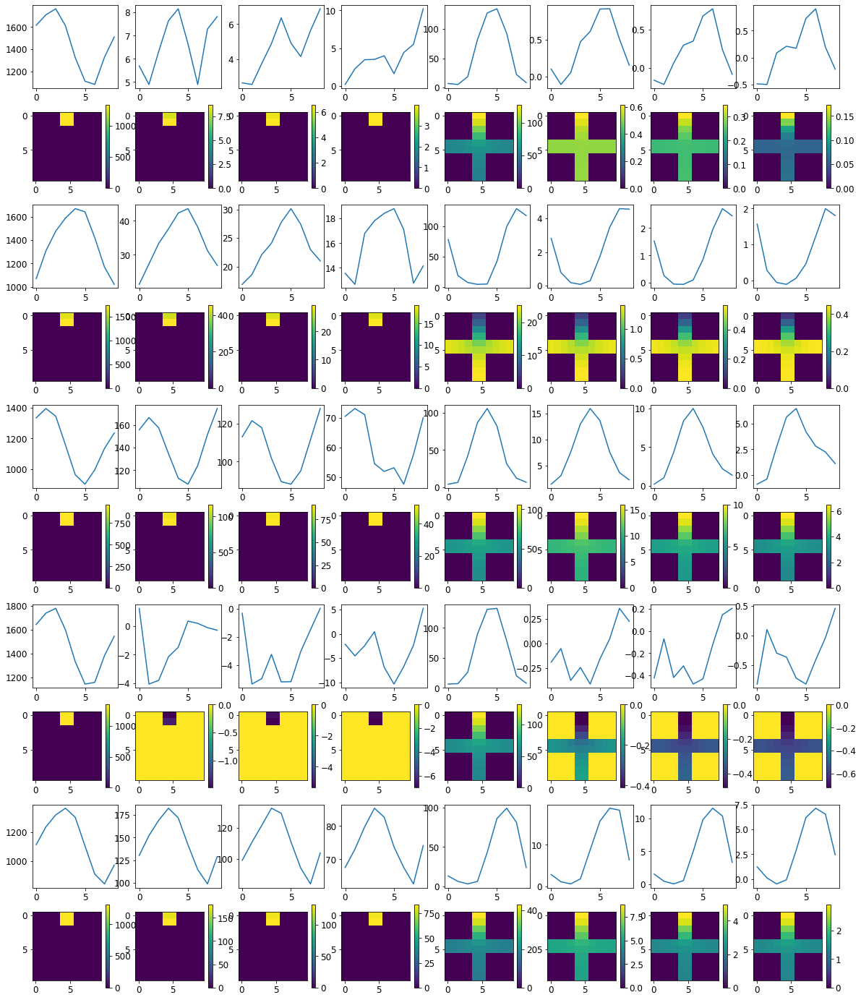

Loss: 


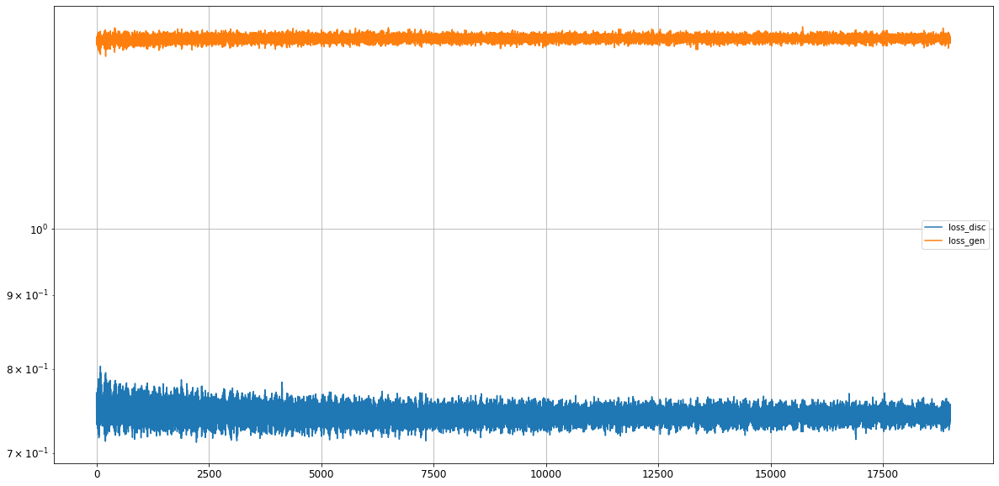

Epoch 19002/50000
discriminator loss: 1.351251 - generator loss: 0.752313 - 1s
Epoch 19003/50000
discriminator loss: 1.352816 - generator loss: 0.750563 - 1s
Epoch 19004/50000
discriminator loss: 1.350820 - generator loss: 0.746668 - 1s
Epoch 19005/50000
discriminator loss: 1.358216 - generator loss: 0.740945 - 1s
Epoch 19006/50000
discriminator loss: 1.355147 - generator loss: 0.739341 - 1s
Epoch 19007/50000
discriminator loss: 1.362322 - generator loss: 0.736021 - 1s
Epoch 19008/50000
discriminator loss: 1.357555 - generator loss: 0.733238 - 1s
Epoch 19009/50000
discriminator loss: 1.350843 - generator loss: 0.750583 - 1s
Epoch 19010/50000
discriminator loss: 1.343470 - generator loss: 0.751329 - 1s
Epoch 19011/50000
discriminator loss: 1.358072 - generator loss: 0.731903 - 1s
Epoch 19012/50000
discriminator loss: 1.353368 - generator loss: 0.750924 - 1s
Epoch 19013/50000
discriminator loss: 1.353549 - generator loss: 0.751773 - 1s
Epoch 19014/50000
discriminator loss: 1.345935 - gen

discriminator loss: 1.345568 - generator loss: 0.743768 - 1s
Epoch 19107/50000
discriminator loss: 1.355454 - generator loss: 0.742360 - 1s
Epoch 19108/50000
discriminator loss: 1.345825 - generator loss: 0.746589 - 1s
Epoch 19109/50000
discriminator loss: 1.356900 - generator loss: 0.743921 - 1s
Epoch 19110/50000
discriminator loss: 1.355228 - generator loss: 0.744306 - 1s
Epoch 19111/50000
discriminator loss: 1.353447 - generator loss: 0.745669 - 1s
Epoch 19112/50000
discriminator loss: 1.346950 - generator loss: 0.749137 - 1s
Epoch 19113/50000
discriminator loss: 1.360231 - generator loss: 0.738594 - 1s
Epoch 19114/50000
discriminator loss: 1.360082 - generator loss: 0.737168 - 1s
Epoch 19115/50000
discriminator loss: 1.358823 - generator loss: 0.736852 - 1s
Epoch 19116/50000
discriminator loss: 1.346745 - generator loss: 0.746885 - 1s
Epoch 19117/50000
discriminator loss: 1.361575 - generator loss: 0.735299 - 1s
Epoch 19118/50000
discriminator loss: 1.358195 - generator loss: 0.743

discriminator loss: 1.361182 - generator loss: 0.730307 - 1s
Epoch 19211/50000
discriminator loss: 1.353813 - generator loss: 0.742180 - 1s
Epoch 19212/50000
discriminator loss: 1.352203 - generator loss: 0.743914 - 1s
Epoch 19213/50000
discriminator loss: 1.347061 - generator loss: 0.742421 - 1s
Epoch 19214/50000
discriminator loss: 1.354356 - generator loss: 0.742668 - 1s
Epoch 19215/50000
discriminator loss: 1.370159 - generator loss: 0.735482 - 1s
Epoch 19216/50000
discriminator loss: 1.354541 - generator loss: 0.753050 - 1s
Epoch 19217/50000
discriminator loss: 1.345469 - generator loss: 0.753082 - 1s
Epoch 19218/50000
discriminator loss: 1.343084 - generator loss: 0.764675 - 1s
Epoch 19219/50000
discriminator loss: 1.356900 - generator loss: 0.732050 - 1s
Epoch 19220/50000
discriminator loss: 1.359057 - generator loss: 0.732267 - 1s
Epoch 19221/50000
discriminator loss: 1.352287 - generator loss: 0.739564 - 1s
Epoch 19222/50000
discriminator loss: 1.348731 - generator loss: 0.749

discriminator loss: 1.355391 - generator loss: 0.747981 - 1s
Epoch 19315/50000
discriminator loss: 1.347493 - generator loss: 0.751605 - 1s
Epoch 19316/50000
discriminator loss: 1.358449 - generator loss: 0.740338 - 1s
Epoch 19317/50000
discriminator loss: 1.364186 - generator loss: 0.736324 - 1s
Epoch 19318/50000
discriminator loss: 1.359074 - generator loss: 0.736183 - 1s
Epoch 19319/50000
discriminator loss: 1.356871 - generator loss: 0.743499 - 1s
Epoch 19320/50000
discriminator loss: 1.350511 - generator loss: 0.738571 - 1s
Epoch 19321/50000
discriminator loss: 1.368187 - generator loss: 0.732975 - 1s
Epoch 19322/50000
discriminator loss: 1.371132 - generator loss: 0.735130 - 1s
Epoch 19323/50000
discriminator loss: 1.358830 - generator loss: 0.749203 - 1s
Epoch 19324/50000
discriminator loss: 1.345446 - generator loss: 0.751177 - 1s
Epoch 19325/50000
discriminator loss: 1.362119 - generator loss: 0.736481 - 1s
Epoch 19326/50000
discriminator loss: 1.357187 - generator loss: 0.745

discriminator loss: 1.350261 - generator loss: 0.744326 - 1s
Epoch 19419/50000
discriminator loss: 1.363828 - generator loss: 0.741445 - 1s
Epoch 19420/50000
discriminator loss: 1.360467 - generator loss: 0.737265 - 1s
Epoch 19421/50000
discriminator loss: 1.359992 - generator loss: 0.745829 - 1s
Epoch 19422/50000
discriminator loss: 1.345430 - generator loss: 0.753434 - 1s
Epoch 19423/50000
discriminator loss: 1.352067 - generator loss: 0.748012 - 1s
Epoch 19424/50000
discriminator loss: 1.360201 - generator loss: 0.734360 - 1s
Epoch 19425/50000
discriminator loss: 1.357849 - generator loss: 0.733809 - 1s
Epoch 19426/50000
discriminator loss: 1.349943 - generator loss: 0.739361 - 1s
Epoch 19427/50000
discriminator loss: 1.344934 - generator loss: 0.749188 - 1s
Epoch 19428/50000
discriminator loss: 1.363303 - generator loss: 0.735424 - 1s
Epoch 19429/50000
discriminator loss: 1.356790 - generator loss: 0.747024 - 1s
Epoch 19430/50000
discriminator loss: 1.357432 - generator loss: 0.750

discriminator loss: 1.357202 - generator loss: 0.743531 - 1s
Epoch 19523/50000
discriminator loss: 1.348489 - generator loss: 0.758981 - 1s
Epoch 19524/50000
discriminator loss: 1.350774 - generator loss: 0.751575 - 1s
Epoch 19525/50000
discriminator loss: 1.348875 - generator loss: 0.744110 - 1s
Epoch 19526/50000
discriminator loss: 1.362566 - generator loss: 0.733672 - 1s
Epoch 19527/50000
discriminator loss: 1.359212 - generator loss: 0.736397 - 1s
Epoch 19528/50000
discriminator loss: 1.353236 - generator loss: 0.735467 - 1s
Epoch 19529/50000
discriminator loss: 1.359787 - generator loss: 0.745289 - 1s
Epoch 19530/50000
discriminator loss: 1.355450 - generator loss: 0.748678 - 1s
Epoch 19531/50000
discriminator loss: 1.358874 - generator loss: 0.741663 - 1s
Epoch 19532/50000
discriminator loss: 1.347804 - generator loss: 0.753562 - 1s
Epoch 19533/50000
discriminator loss: 1.351278 - generator loss: 0.742037 - 1s
Epoch 19534/50000
discriminator loss: 1.354022 - generator loss: 0.747

discriminator loss: 1.353245 - generator loss: 0.747302 - 1s
Epoch 19627/50000
discriminator loss: 1.354491 - generator loss: 0.739202 - 1s
Epoch 19628/50000
discriminator loss: 1.359635 - generator loss: 0.748055 - 1s
Epoch 19629/50000
discriminator loss: 1.343101 - generator loss: 0.748993 - 1s
Epoch 19630/50000
discriminator loss: 1.348156 - generator loss: 0.754046 - 1s
Epoch 19631/50000
discriminator loss: 1.347188 - generator loss: 0.749133 - 1s
Epoch 19632/50000
discriminator loss: 1.339475 - generator loss: 0.754389 - 1s
Epoch 19633/50000
discriminator loss: 1.353177 - generator loss: 0.737322 - 1s
Epoch 19634/50000
discriminator loss: 1.352488 - generator loss: 0.738377 - 1s
Epoch 19635/50000
discriminator loss: 1.358961 - generator loss: 0.733956 - 2s
Epoch 19636/50000
discriminator loss: 1.351688 - generator loss: 0.742250 - 1s
Epoch 19637/50000
discriminator loss: 1.356472 - generator loss: 0.748091 - 1s
Epoch 19638/50000
discriminator loss: 1.354818 - generator loss: 0.748

discriminator loss: 1.361015 - generator loss: 0.734946 - 1s
Epoch 19731/50000
discriminator loss: 1.350440 - generator loss: 0.737074 - 1s
Epoch 19732/50000
discriminator loss: 1.357358 - generator loss: 0.732317 - 1s
Epoch 19733/50000
discriminator loss: 1.344490 - generator loss: 0.750477 - 1s
Epoch 19734/50000
discriminator loss: 1.355073 - generator loss: 0.741827 - 1s
Epoch 19735/50000
discriminator loss: 1.352025 - generator loss: 0.747531 - 1s
Epoch 19736/50000
discriminator loss: 1.362983 - generator loss: 0.744004 - 1s
Epoch 19737/50000
discriminator loss: 1.355838 - generator loss: 0.742699 - 1s
Epoch 19738/50000
discriminator loss: 1.348368 - generator loss: 0.751595 - 1s
Epoch 19739/50000
discriminator loss: 1.354492 - generator loss: 0.740213 - 1s
Epoch 19740/50000
discriminator loss: 1.352363 - generator loss: 0.740171 - 1s
Epoch 19741/50000
discriminator loss: 1.355238 - generator loss: 0.735623 - 1s
Epoch 19742/50000
discriminator loss: 1.354515 - generator loss: 0.739

discriminator loss: 1.357412 - generator loss: 0.749687 - 1s
Epoch 19835/50000
discriminator loss: 1.349984 - generator loss: 0.744481 - 1s
Epoch 19836/50000
discriminator loss: 1.359545 - generator loss: 0.749766 - 1s
Epoch 19837/50000
discriminator loss: 1.346866 - generator loss: 0.741675 - 1s
Epoch 19838/50000
discriminator loss: 1.355673 - generator loss: 0.742966 - 1s
Epoch 19839/50000
discriminator loss: 1.358934 - generator loss: 0.738216 - 1s
Epoch 19840/50000
discriminator loss: 1.354705 - generator loss: 0.740991 - 2s
Epoch 19841/50000
discriminator loss: 1.355242 - generator loss: 0.740751 - 1s
Epoch 19842/50000
discriminator loss: 1.357370 - generator loss: 0.741632 - 1s
Epoch 19843/50000
discriminator loss: 1.354908 - generator loss: 0.741488 - 2s
Epoch 19844/50000
discriminator loss: 1.354440 - generator loss: 0.743408 - 1s
Epoch 19845/50000
discriminator loss: 1.351767 - generator loss: 0.756232 - 1s
Epoch 19846/50000
discriminator loss: 1.357701 - generator loss: 0.748

discriminator loss: 1.356192 - generator loss: 0.744196 - 1s
Epoch 19939/50000
discriminator loss: 1.346023 - generator loss: 0.748961 - 1s
Epoch 19940/50000
discriminator loss: 1.353977 - generator loss: 0.738564 - 1s
Epoch 19941/50000
discriminator loss: 1.363576 - generator loss: 0.737723 - 1s
Epoch 19942/50000
discriminator loss: 1.356246 - generator loss: 0.751211 - 1s
Epoch 19943/50000
discriminator loss: 1.348333 - generator loss: 0.754454 - 1s
Epoch 19944/50000
discriminator loss: 1.357285 - generator loss: 0.749644 - 1s
Epoch 19945/50000
discriminator loss: 1.356582 - generator loss: 0.735642 - 1s
Epoch 19946/50000
discriminator loss: 1.354585 - generator loss: 0.733305 - 1s
Epoch 19947/50000
discriminator loss: 1.348420 - generator loss: 0.741433 - 1s
Epoch 19948/50000
discriminator loss: 1.343202 - generator loss: 0.753090 - 1s
Epoch 19949/50000
discriminator loss: 1.358401 - generator loss: 0.739351 - 1s
Epoch 19950/50000
discriminator loss: 1.353803 - generator loss: 0.748

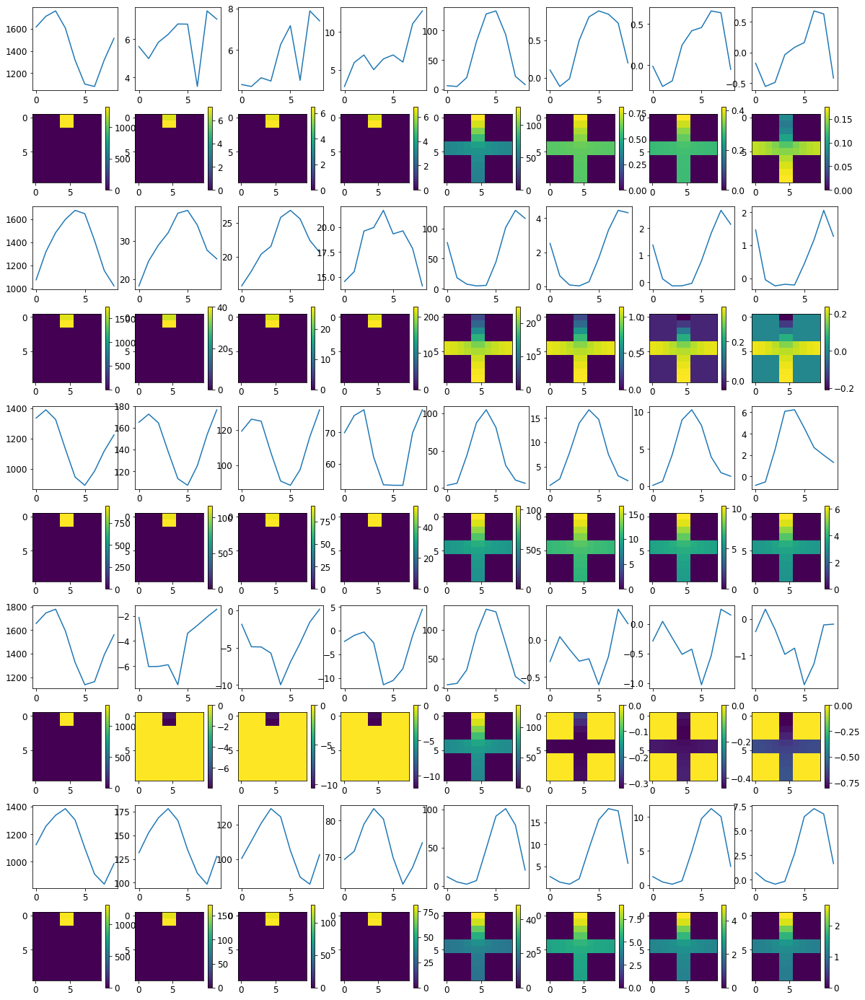

Loss: 


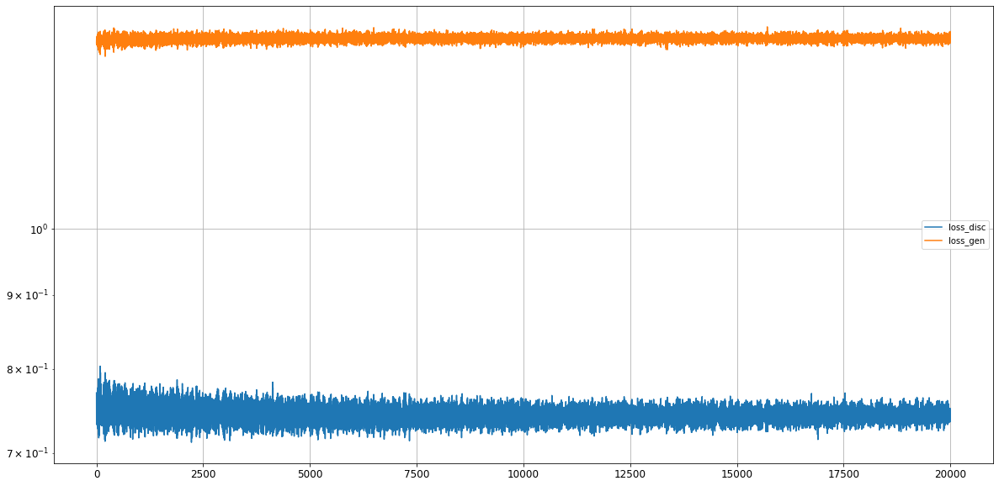

Epoch 20002/50000
discriminator loss: 1.353766 - generator loss: 0.747496 - 1s
Epoch 20003/50000
discriminator loss: 1.357542 - generator loss: 0.749385 - 1s
Epoch 20004/50000
discriminator loss: 1.355626 - generator loss: 0.744842 - 1s
Epoch 20005/50000
discriminator loss: 1.354416 - generator loss: 0.748914 - 1s
Epoch 20006/50000
discriminator loss: 1.363199 - generator loss: 0.735434 - 1s
Epoch 20007/50000
discriminator loss: 1.351992 - generator loss: 0.744060 - 1s
Epoch 20008/50000
discriminator loss: 1.359001 - generator loss: 0.732133 - 1s
Epoch 20009/50000
discriminator loss: 1.347665 - generator loss: 0.746327 - 1s
Epoch 20010/50000
discriminator loss: 1.348703 - generator loss: 0.746020 - 1s
Epoch 20011/50000
discriminator loss: 1.362741 - generator loss: 0.739565 - 1s
Epoch 20012/50000
discriminator loss: 1.359035 - generator loss: 0.747034 - 1s
Epoch 20013/50000
discriminator loss: 1.355468 - generator loss: 0.752296 - 1s
Epoch 20014/50000
discriminator loss: 1.349785 - gen

discriminator loss: 1.357791 - generator loss: 0.732655 - 1s
Epoch 20107/50000
discriminator loss: 1.355047 - generator loss: 0.740245 - 1s
Epoch 20108/50000
discriminator loss: 1.348567 - generator loss: 0.747453 - 1s
Epoch 20109/50000
discriminator loss: 1.351934 - generator loss: 0.736990 - 1s
Epoch 20110/50000
discriminator loss: 1.350195 - generator loss: 0.745210 - 1s
Epoch 20111/50000
discriminator loss: 1.359756 - generator loss: 0.742689 - 1s
Epoch 20112/50000
discriminator loss: 1.347094 - generator loss: 0.761188 - 1s
Epoch 20113/50000
discriminator loss: 1.354817 - generator loss: 0.754347 - 2s
Epoch 20114/50000
discriminator loss: 1.359459 - generator loss: 0.744561 - 1s
Epoch 20115/50000
discriminator loss: 1.364206 - generator loss: 0.727078 - 1s
Epoch 20116/50000
discriminator loss: 1.354189 - generator loss: 0.730368 - 1s
Epoch 20117/50000
discriminator loss: 1.339186 - generator loss: 0.752672 - 1s
Epoch 20118/50000
discriminator loss: 1.346018 - generator loss: 0.755

discriminator loss: 1.359782 - generator loss: 0.740548 - 1s
Epoch 20211/50000
discriminator loss: 1.364128 - generator loss: 0.742878 - 1s
Epoch 20212/50000
discriminator loss: 1.355169 - generator loss: 0.749877 - 1s
Epoch 20213/50000
discriminator loss: 1.348598 - generator loss: 0.750857 - 1s
Epoch 20214/50000
discriminator loss: 1.361115 - generator loss: 0.739385 - 1s
Epoch 20215/50000
discriminator loss: 1.367145 - generator loss: 0.733848 - 1s
Epoch 20216/50000
discriminator loss: 1.355530 - generator loss: 0.729701 - 1s
Epoch 20217/50000
discriminator loss: 1.351315 - generator loss: 0.747747 - 1s
Epoch 20218/50000
discriminator loss: 1.348370 - generator loss: 0.749500 - 1s
Epoch 20219/50000
discriminator loss: 1.353897 - generator loss: 0.741152 - 2s
Epoch 20220/50000
discriminator loss: 1.346021 - generator loss: 0.746975 - 1s
Epoch 20221/50000
discriminator loss: 1.360551 - generator loss: 0.741536 - 1s
Epoch 20222/50000
discriminator loss: 1.355415 - generator loss: 0.753

discriminator loss: 1.353736 - generator loss: 0.750698 - 1s
Epoch 20315/50000
discriminator loss: 1.357919 - generator loss: 0.735336 - 1s
Epoch 20316/50000
discriminator loss: 1.360520 - generator loss: 0.740854 - 1s
Epoch 20317/50000
discriminator loss: 1.349190 - generator loss: 0.740093 - 1s
Epoch 20318/50000
discriminator loss: 1.356668 - generator loss: 0.738458 - 1s
Epoch 20319/50000
discriminator loss: 1.353648 - generator loss: 0.748604 - 1s
Epoch 20320/50000
discriminator loss: 1.362829 - generator loss: 0.736924 - 1s
Epoch 20321/50000
discriminator loss: 1.363230 - generator loss: 0.742841 - 1s
Epoch 20322/50000
discriminator loss: 1.344835 - generator loss: 0.762620 - 1s
Epoch 20323/50000
discriminator loss: 1.351046 - generator loss: 0.750014 - 1s
Epoch 20324/50000
discriminator loss: 1.351311 - generator loss: 0.747301 - 1s
Epoch 20325/50000
discriminator loss: 1.363759 - generator loss: 0.723433 - 1s
Epoch 20326/50000
discriminator loss: 1.354405 - generator loss: 0.739

discriminator loss: 1.354716 - generator loss: 0.737690 - 1s
Epoch 20419/50000
discriminator loss: 1.340397 - generator loss: 0.748717 - 1s
Epoch 20420/50000
discriminator loss: 1.344384 - generator loss: 0.751899 - 1s
Epoch 20421/50000
discriminator loss: 1.354938 - generator loss: 0.747396 - 2s
Epoch 20422/50000
discriminator loss: 1.358802 - generator loss: 0.739897 - 1s
Epoch 20423/50000
discriminator loss: 1.357149 - generator loss: 0.745234 - 1s
Epoch 20424/50000
discriminator loss: 1.344596 - generator loss: 0.752998 - 1s
Epoch 20425/50000
discriminator loss: 1.356516 - generator loss: 0.750863 - 1s
Epoch 20426/50000
discriminator loss: 1.353729 - generator loss: 0.739210 - 1s
Epoch 20427/50000
discriminator loss: 1.350386 - generator loss: 0.737769 - 1s
Epoch 20428/50000
discriminator loss: 1.349944 - generator loss: 0.741146 - 1s
Epoch 20429/50000
discriminator loss: 1.349686 - generator loss: 0.743355 - 1s
Epoch 20430/50000
discriminator loss: 1.352080 - generator loss: 0.741

discriminator loss: 1.359547 - generator loss: 0.739901 - 1s
Epoch 20523/50000
discriminator loss: 1.359224 - generator loss: 0.743652 - 1s
Epoch 20524/50000
discriminator loss: 1.345910 - generator loss: 0.757717 - 1s
Epoch 20525/50000
discriminator loss: 1.352974 - generator loss: 0.747211 - 1s
Epoch 20526/50000
discriminator loss: 1.353867 - generator loss: 0.740865 - 1s
Epoch 20527/50000
discriminator loss: 1.352477 - generator loss: 0.742314 - 1s
Epoch 20528/50000
discriminator loss: 1.350267 - generator loss: 0.738240 - 1s
Epoch 20529/50000
discriminator loss: 1.347788 - generator loss: 0.750575 - 1s
Epoch 20530/50000
discriminator loss: 1.348769 - generator loss: 0.745720 - 1s
Epoch 20531/50000
discriminator loss: 1.349692 - generator loss: 0.753273 - 1s
Epoch 20532/50000
discriminator loss: 1.351677 - generator loss: 0.750550 - 1s
Epoch 20533/50000
discriminator loss: 1.343268 - generator loss: 0.757722 - 1s
Epoch 20534/50000
discriminator loss: 1.348548 - generator loss: 0.749

discriminator loss: 1.370646 - generator loss: 0.738566 - 1s
Epoch 20627/50000
discriminator loss: 1.356889 - generator loss: 0.738125 - 1s
Epoch 20628/50000
discriminator loss: 1.355390 - generator loss: 0.734033 - 1s
Epoch 20629/50000
discriminator loss: 1.347593 - generator loss: 0.746575 - 1s
Epoch 20630/50000
discriminator loss: 1.354503 - generator loss: 0.745651 - 1s
Epoch 20631/50000
discriminator loss: 1.348214 - generator loss: 0.745012 - 1s
Epoch 20632/50000
discriminator loss: 1.360232 - generator loss: 0.740645 - 1s
Epoch 20633/50000
discriminator loss: 1.353643 - generator loss: 0.748680 - 1s
Epoch 20634/50000
discriminator loss: 1.351193 - generator loss: 0.750413 - 1s
Epoch 20635/50000
discriminator loss: 1.351161 - generator loss: 0.743966 - 1s
Epoch 20636/50000
discriminator loss: 1.357740 - generator loss: 0.732915 - 1s
Epoch 20637/50000
discriminator loss: 1.350687 - generator loss: 0.741739 - 1s
Epoch 20638/50000
discriminator loss: 1.350457 - generator loss: 0.745

discriminator loss: 1.360927 - generator loss: 0.746389 - 1s
Epoch 20731/50000
discriminator loss: 1.348646 - generator loss: 0.746166 - 1s
Epoch 20732/50000
discriminator loss: 1.348846 - generator loss: 0.752514 - 1s
Epoch 20733/50000
discriminator loss: 1.358023 - generator loss: 0.733730 - 1s
Epoch 20734/50000
discriminator loss: 1.354264 - generator loss: 0.737752 - 1s
Epoch 20735/50000
discriminator loss: 1.349658 - generator loss: 0.739688 - 1s
Epoch 20736/50000
discriminator loss: 1.357303 - generator loss: 0.743585 - 1s
Epoch 20737/50000
discriminator loss: 1.355010 - generator loss: 0.742945 - 1s
Epoch 20738/50000
discriminator loss: 1.351597 - generator loss: 0.754327 - 1s
Epoch 20739/50000
discriminator loss: 1.354782 - generator loss: 0.739960 - 1s
Epoch 20740/50000
discriminator loss: 1.354399 - generator loss: 0.748941 - 1s
Epoch 20741/50000
discriminator loss: 1.359451 - generator loss: 0.740252 - 1s
Epoch 20742/50000
discriminator loss: 1.362558 - generator loss: 0.734

discriminator loss: 1.354601 - generator loss: 0.727695 - 1s
Epoch 20835/50000
discriminator loss: 1.353516 - generator loss: 0.743315 - 1s
Epoch 20836/50000
discriminator loss: 1.345644 - generator loss: 0.746938 - 1s
Epoch 20837/50000
discriminator loss: 1.354199 - generator loss: 0.748002 - 1s
Epoch 20838/50000
discriminator loss: 1.362235 - generator loss: 0.735274 - 1s
Epoch 20839/50000
discriminator loss: 1.351834 - generator loss: 0.749805 - 1s
Epoch 20840/50000
discriminator loss: 1.349432 - generator loss: 0.750872 - 1s
Epoch 20841/50000
discriminator loss: 1.349825 - generator loss: 0.754884 - 1s
Epoch 20842/50000
discriminator loss: 1.353060 - generator loss: 0.741887 - 1s
Epoch 20843/50000
discriminator loss: 1.368380 - generator loss: 0.737272 - 1s
Epoch 20844/50000
discriminator loss: 1.350220 - generator loss: 0.739946 - 1s
Epoch 20845/50000
discriminator loss: 1.351192 - generator loss: 0.741937 - 1s
Epoch 20846/50000
discriminator loss: 1.354053 - generator loss: 0.743

discriminator loss: 1.348638 - generator loss: 0.743701 - 1s
Epoch 20939/50000
discriminator loss: 1.362181 - generator loss: 0.743758 - 1s
Epoch 20940/50000
discriminator loss: 1.353948 - generator loss: 0.751666 - 1s
Epoch 20941/50000
discriminator loss: 1.352164 - generator loss: 0.751900 - 1s
Epoch 20942/50000
discriminator loss: 1.353597 - generator loss: 0.746152 - 1s
Epoch 20943/50000
discriminator loss: 1.354274 - generator loss: 0.739730 - 1s
Epoch 20944/50000
discriminator loss: 1.356313 - generator loss: 0.736668 - 1s
Epoch 20945/50000
discriminator loss: 1.356668 - generator loss: 0.736477 - 1s
Epoch 20946/50000
discriminator loss: 1.347588 - generator loss: 0.750895 - 1s
Epoch 20947/50000
discriminator loss: 1.354189 - generator loss: 0.743063 - 1s
Epoch 20948/50000
discriminator loss: 1.358957 - generator loss: 0.744541 - 1s
Epoch 20949/50000
discriminator loss: 1.352539 - generator loss: 0.748439 - 1s
Epoch 20950/50000
discriminator loss: 1.350251 - generator loss: 0.749

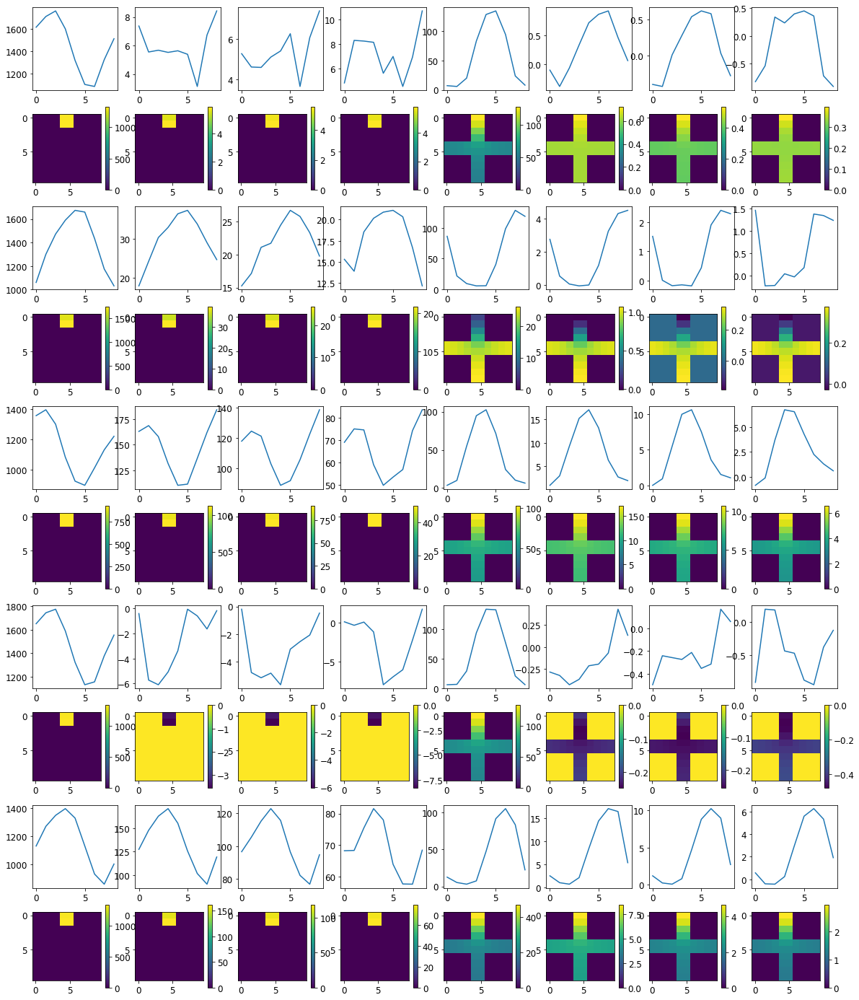

Loss: 


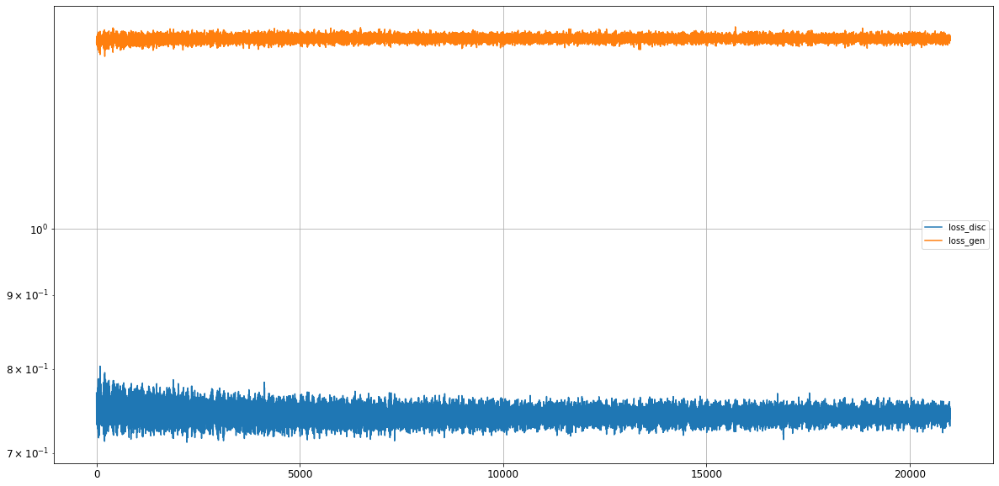

Epoch 21002/50000
discriminator loss: 1.359159 - generator loss: 0.742423 - 1s
Epoch 21003/50000
discriminator loss: 1.369886 - generator loss: 0.736275 - 1s
Epoch 21004/50000
discriminator loss: 1.356424 - generator loss: 0.759173 - 1s
Epoch 21005/50000
discriminator loss: 1.338322 - generator loss: 0.748492 - 1s
Epoch 21006/50000
discriminator loss: 1.350394 - generator loss: 0.752253 - 1s
Epoch 21007/50000
discriminator loss: 1.360184 - generator loss: 0.737477 - 1s
Epoch 21008/50000
discriminator loss: 1.356873 - generator loss: 0.734451 - 1s
Epoch 21009/50000
discriminator loss: 1.353807 - generator loss: 0.734569 - 1s
Epoch 21010/50000
discriminator loss: 1.349106 - generator loss: 0.746312 - 1s
Epoch 21011/50000
discriminator loss: 1.356301 - generator loss: 0.740686 - 1s
Epoch 21012/50000
discriminator loss: 1.372193 - generator loss: 0.738049 - 1s
Epoch 21013/50000
discriminator loss: 1.353556 - generator loss: 0.755886 - 1s
Epoch 21014/50000
discriminator loss: 1.344596 - gen

discriminator loss: 1.359800 - generator loss: 0.740023 - 1s
Epoch 21107/50000
discriminator loss: 1.349550 - generator loss: 0.755708 - 1s
Epoch 21108/50000
discriminator loss: 1.338556 - generator loss: 0.756953 - 1s
Epoch 21109/50000
discriminator loss: 1.359528 - generator loss: 0.737458 - 1s
Epoch 21110/50000
discriminator loss: 1.354880 - generator loss: 0.734177 - 1s
Epoch 21111/50000
discriminator loss: 1.355934 - generator loss: 0.742833 - 1s
Epoch 21112/50000
discriminator loss: 1.347381 - generator loss: 0.746071 - 1s
Epoch 21113/50000
discriminator loss: 1.352622 - generator loss: 0.743660 - 1s
Epoch 21114/50000
discriminator loss: 1.351298 - generator loss: 0.750147 - 1s
Epoch 21115/50000
discriminator loss: 1.346584 - generator loss: 0.755422 - 1s
Epoch 21116/50000
discriminator loss: 1.359923 - generator loss: 0.739898 - 1s
Epoch 21117/50000
discriminator loss: 1.353946 - generator loss: 0.748546 - 1s
Epoch 21118/50000
discriminator loss: 1.358663 - generator loss: 0.741

discriminator loss: 1.363926 - generator loss: 0.735109 - 1s
Epoch 21211/50000
discriminator loss: 1.360022 - generator loss: 0.734586 - 1s
Epoch 21212/50000
discriminator loss: 1.353561 - generator loss: 0.741297 - 1s
Epoch 21213/50000
discriminator loss: 1.350474 - generator loss: 0.744143 - 1s
Epoch 21214/50000
discriminator loss: 1.348732 - generator loss: 0.743543 - 1s
Epoch 21215/50000
discriminator loss: 1.361330 - generator loss: 0.742925 - 1s
Epoch 21216/50000
discriminator loss: 1.353684 - generator loss: 0.747065 - 1s
Epoch 21217/50000
discriminator loss: 1.341466 - generator loss: 0.756598 - 1s
Epoch 21218/50000
discriminator loss: 1.348096 - generator loss: 0.747102 - 1s
Epoch 21219/50000
discriminator loss: 1.355427 - generator loss: 0.747476 - 1s
Epoch 21220/50000
discriminator loss: 1.358255 - generator loss: 0.736577 - 1s
Epoch 21221/50000
discriminator loss: 1.350652 - generator loss: 0.736146 - 1s
Epoch 21222/50000
discriminator loss: 1.359593 - generator loss: 0.738

discriminator loss: 1.350085 - generator loss: 0.742954 - 1s
Epoch 21315/50000
discriminator loss: 1.357256 - generator loss: 0.746638 - 1s
Epoch 21316/50000
discriminator loss: 1.352286 - generator loss: 0.746561 - 1s
Epoch 21317/50000
discriminator loss: 1.345033 - generator loss: 0.753217 - 1s
Epoch 21318/50000
discriminator loss: 1.360777 - generator loss: 0.746035 - 1s
Epoch 21319/50000
discriminator loss: 1.354773 - generator loss: 0.736503 - 1s
Epoch 21320/50000
discriminator loss: 1.353712 - generator loss: 0.744013 - 1s
Epoch 21321/50000
discriminator loss: 1.358408 - generator loss: 0.734646 - 1s
Epoch 21322/50000
discriminator loss: 1.353429 - generator loss: 0.739762 - 1s
Epoch 21323/50000
discriminator loss: 1.352313 - generator loss: 0.746773 - 1s
Epoch 21324/50000
discriminator loss: 1.357119 - generator loss: 0.740662 - 1s
Epoch 21325/50000
discriminator loss: 1.351014 - generator loss: 0.756534 - 1s
Epoch 21326/50000
discriminator loss: 1.351255 - generator loss: 0.746

discriminator loss: 1.351333 - generator loss: 0.739966 - 1s
Epoch 21419/50000
discriminator loss: 1.346958 - generator loss: 0.741870 - 1s
Epoch 21420/50000
discriminator loss: 1.351238 - generator loss: 0.737642 - 1s
Epoch 21421/50000
discriminator loss: 1.351889 - generator loss: 0.744252 - 1s
Epoch 21422/50000
discriminator loss: 1.361503 - generator loss: 0.741314 - 1s
Epoch 21423/50000
discriminator loss: 1.350883 - generator loss: 0.745657 - 1s
Epoch 21424/50000
discriminator loss: 1.348555 - generator loss: 0.758557 - 1s
Epoch 21425/50000
discriminator loss: 1.350046 - generator loss: 0.744309 - 1s
Epoch 21426/50000
discriminator loss: 1.347849 - generator loss: 0.749354 - 1s
Epoch 21427/50000
discriminator loss: 1.345812 - generator loss: 0.750862 - 1s
Epoch 21428/50000
discriminator loss: 1.357034 - generator loss: 0.733110 - 1s
Epoch 21429/50000
discriminator loss: 1.350520 - generator loss: 0.751061 - 1s
Epoch 21430/50000
discriminator loss: 1.343231 - generator loss: 0.749

discriminator loss: 1.364901 - generator loss: 0.741449 - 1s
Epoch 21523/50000
discriminator loss: 1.351771 - generator loss: 0.748964 - 1s
Epoch 21524/50000
discriminator loss: 1.350465 - generator loss: 0.754254 - 1s
Epoch 21525/50000
discriminator loss: 1.354005 - generator loss: 0.745150 - 1s
Epoch 21526/50000
discriminator loss: 1.348543 - generator loss: 0.738339 - 1s
Epoch 21527/50000
discriminator loss: 1.350539 - generator loss: 0.733097 - 1s
Epoch 21528/50000
discriminator loss: 1.352540 - generator loss: 0.744157 - 1s
Epoch 21529/50000
discriminator loss: 1.357064 - generator loss: 0.748261 - 1s
Epoch 21530/50000
discriminator loss: 1.354090 - generator loss: 0.744609 - 1s
Epoch 21531/50000
discriminator loss: 1.356369 - generator loss: 0.743381 - 1s
Epoch 21532/50000
discriminator loss: 1.347393 - generator loss: 0.758758 - 1s
Epoch 21533/50000
discriminator loss: 1.345447 - generator loss: 0.750073 - 1s
Epoch 21534/50000
discriminator loss: 1.352752 - generator loss: 0.744

discriminator loss: 1.349017 - generator loss: 0.745407 - 1s
Epoch 21627/50000
discriminator loss: 1.351082 - generator loss: 0.732897 - 1s
Epoch 21628/50000
discriminator loss: 1.349276 - generator loss: 0.745714 - 1s
Epoch 21629/50000
discriminator loss: 1.353281 - generator loss: 0.746983 - 1s
Epoch 21630/50000
discriminator loss: 1.355406 - generator loss: 0.742707 - 1s
Epoch 21631/50000
discriminator loss: 1.363310 - generator loss: 0.739332 - 1s
Epoch 21632/50000
discriminator loss: 1.361376 - generator loss: 0.740350 - 1s
Epoch 21633/50000
discriminator loss: 1.346889 - generator loss: 0.753436 - 1s
Epoch 21634/50000
discriminator loss: 1.350789 - generator loss: 0.752595 - 1s
Epoch 21635/50000
discriminator loss: 1.356966 - generator loss: 0.740042 - 1s
Epoch 21636/50000
discriminator loss: 1.364302 - generator loss: 0.735554 - 1s
Epoch 21637/50000
discriminator loss: 1.351050 - generator loss: 0.742419 - 1s
Epoch 21638/50000
discriminator loss: 1.341706 - generator loss: 0.749

discriminator loss: 1.358535 - generator loss: 0.743115 - 1s
Epoch 21731/50000
discriminator loss: 1.355084 - generator loss: 0.741281 - 1s
Epoch 21732/50000
discriminator loss: 1.345189 - generator loss: 0.758814 - 1s
Epoch 21733/50000
discriminator loss: 1.352664 - generator loss: 0.755198 - 1s
Epoch 21734/50000
discriminator loss: 1.362941 - generator loss: 0.734772 - 1s
Epoch 21735/50000
discriminator loss: 1.356295 - generator loss: 0.730115 - 1s
Epoch 21736/50000
discriminator loss: 1.350665 - generator loss: 0.749483 - 1s
Epoch 21737/50000
discriminator loss: 1.344774 - generator loss: 0.754989 - 1s
Epoch 21738/50000
discriminator loss: 1.356786 - generator loss: 0.737638 - 1s
Epoch 21739/50000
discriminator loss: 1.370809 - generator loss: 0.735873 - 1s
Epoch 21740/50000
discriminator loss: 1.358361 - generator loss: 0.748325 - 1s
Epoch 21741/50000
discriminator loss: 1.349809 - generator loss: 0.758026 - 1s
Epoch 21742/50000
discriminator loss: 1.346643 - generator loss: 0.750

discriminator loss: 1.347310 - generator loss: 0.756027 - 1s
Epoch 21835/50000
discriminator loss: 1.355942 - generator loss: 0.742802 - 1s
Epoch 21836/50000
discriminator loss: 1.355481 - generator loss: 0.745123 - 1s
Epoch 21837/50000
discriminator loss: 1.360227 - generator loss: 0.730313 - 1s
Epoch 21838/50000
discriminator loss: 1.355504 - generator loss: 0.742637 - 1s
Epoch 21839/50000
discriminator loss: 1.353831 - generator loss: 0.744132 - 1s
Epoch 21840/50000
discriminator loss: 1.349413 - generator loss: 0.743024 - 1s
Epoch 21841/50000
discriminator loss: 1.360626 - generator loss: 0.737063 - 1s
Epoch 21842/50000
discriminator loss: 1.351078 - generator loss: 0.754432 - 1s
Epoch 21843/50000
discriminator loss: 1.352549 - generator loss: 0.758521 - 1s
Epoch 21844/50000
discriminator loss: 1.341478 - generator loss: 0.751629 - 1s
Epoch 21845/50000
discriminator loss: 1.344444 - generator loss: 0.745577 - 1s
Epoch 21846/50000
discriminator loss: 1.363726 - generator loss: 0.732

discriminator loss: 1.357055 - generator loss: 0.743116 - 1s
Epoch 21939/50000
discriminator loss: 1.361149 - generator loss: 0.738123 - 1s
Epoch 21940/50000
discriminator loss: 1.354082 - generator loss: 0.735605 - 1s
Epoch 21941/50000
discriminator loss: 1.343031 - generator loss: 0.756606 - 1s
Epoch 21942/50000
discriminator loss: 1.355784 - generator loss: 0.746870 - 1s
Epoch 21943/50000
discriminator loss: 1.358500 - generator loss: 0.740925 - 1s
Epoch 21944/50000
discriminator loss: 1.347868 - generator loss: 0.748909 - 1s
Epoch 21945/50000
discriminator loss: 1.344500 - generator loss: 0.752461 - 1s
Epoch 21946/50000
discriminator loss: 1.343314 - generator loss: 0.751070 - 1s
Epoch 21947/50000
discriminator loss: 1.348198 - generator loss: 0.746263 - 1s
Epoch 21948/50000
discriminator loss: 1.358696 - generator loss: 0.739414 - 1s
Epoch 21949/50000
discriminator loss: 1.360820 - generator loss: 0.741850 - 1s
Epoch 21950/50000
discriminator loss: 1.350821 - generator loss: 0.742

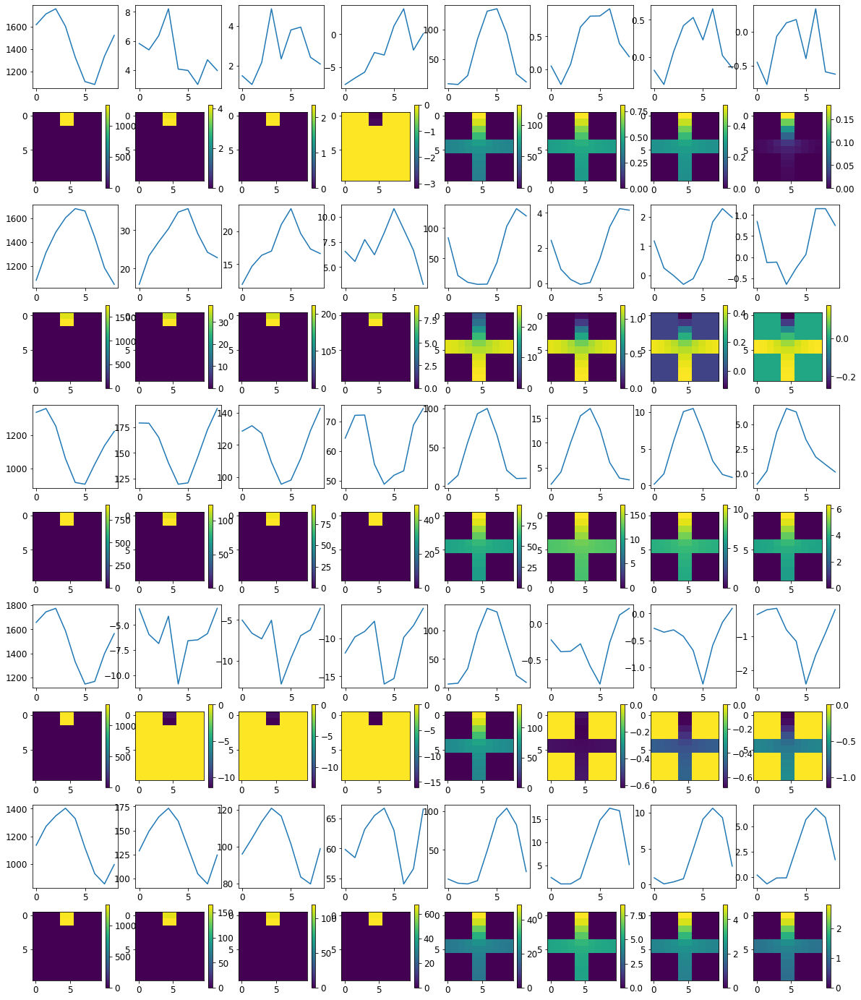

Loss: 


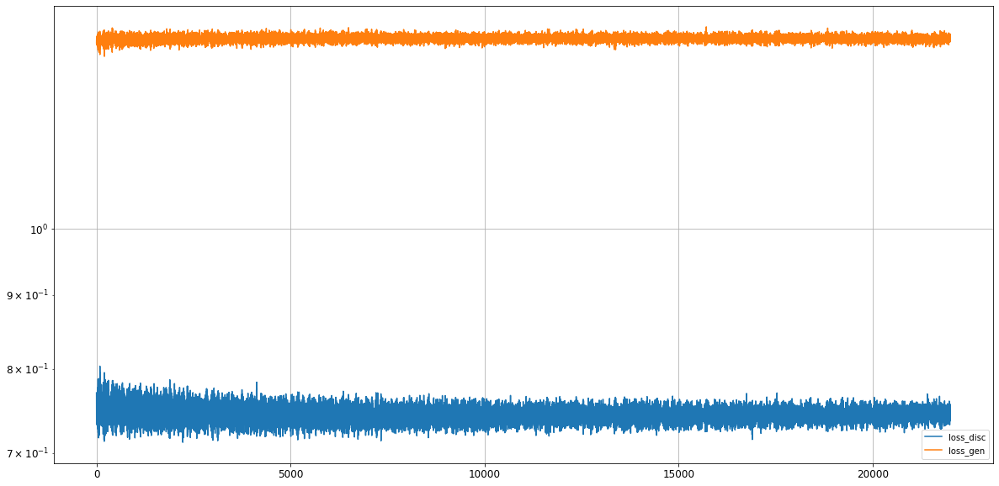

Epoch 22002/50000
discriminator loss: 1.354380 - generator loss: 0.745235 - 1s
Epoch 22003/50000
discriminator loss: 1.355878 - generator loss: 0.735827 - 1s
Epoch 22004/50000
discriminator loss: 1.359811 - generator loss: 0.735186 - 1s
Epoch 22005/50000
discriminator loss: 1.359565 - generator loss: 0.735771 - 1s
Epoch 22006/50000
discriminator loss: 1.355198 - generator loss: 0.745254 - 1s
Epoch 22007/50000
discriminator loss: 1.349962 - generator loss: 0.745143 - 1s
Epoch 22008/50000
discriminator loss: 1.357068 - generator loss: 0.746842 - 1s
Epoch 22009/50000
discriminator loss: 1.359936 - generator loss: 0.741731 - 1s
Epoch 22010/50000
discriminator loss: 1.355807 - generator loss: 0.743200 - 1s
Epoch 22011/50000
discriminator loss: 1.350013 - generator loss: 0.751124 - 1s
Epoch 22012/50000
discriminator loss: 1.363545 - generator loss: 0.735839 - 1s
Epoch 22013/50000
discriminator loss: 1.360096 - generator loss: 0.731636 - 1s
Epoch 22014/50000
discriminator loss: 1.355433 - gen

discriminator loss: 1.351056 - generator loss: 0.742152 - 1s
Epoch 22107/50000
discriminator loss: 1.347818 - generator loss: 0.742326 - 1s
Epoch 22108/50000
discriminator loss: 1.358205 - generator loss: 0.748151 - 1s
Epoch 22109/50000
discriminator loss: 1.353624 - generator loss: 0.751084 - 1s
Epoch 22110/50000
discriminator loss: 1.341821 - generator loss: 0.759737 - 1s
Epoch 22111/50000
discriminator loss: 1.352202 - generator loss: 0.749451 - 1s
Epoch 22112/50000
discriminator loss: 1.358249 - generator loss: 0.741508 - 1s
Epoch 22113/50000
discriminator loss: 1.361902 - generator loss: 0.729593 - 1s
Epoch 22114/50000
discriminator loss: 1.356206 - generator loss: 0.740264 - 1s
Epoch 22115/50000
discriminator loss: 1.351840 - generator loss: 0.743315 - 1s
Epoch 22116/50000
discriminator loss: 1.363428 - generator loss: 0.737825 - 1s
Epoch 22117/50000
discriminator loss: 1.357067 - generator loss: 0.743080 - 1s
Epoch 22118/50000
discriminator loss: 1.351166 - generator loss: 0.758

discriminator loss: 1.362018 - generator loss: 0.744092 - 1s
Epoch 22211/50000
discriminator loss: 1.345051 - generator loss: 0.756727 - 1s
Epoch 22212/50000
discriminator loss: 1.340227 - generator loss: 0.752993 - 1s
Epoch 22213/50000
discriminator loss: 1.351214 - generator loss: 0.749322 - 1s
Epoch 22214/50000
discriminator loss: 1.349740 - generator loss: 0.743781 - 1s
Epoch 22215/50000
discriminator loss: 1.352034 - generator loss: 0.737213 - 1s
Epoch 22216/50000
discriminator loss: 1.350968 - generator loss: 0.744251 - 1s
Epoch 22217/50000
discriminator loss: 1.347684 - generator loss: 0.743096 - 1s
Epoch 22218/50000
discriminator loss: 1.356413 - generator loss: 0.748910 - 1s
Epoch 22219/50000
discriminator loss: 1.361841 - generator loss: 0.741731 - 1s
Epoch 22220/50000
discriminator loss: 1.350210 - generator loss: 0.754996 - 1s
Epoch 22221/50000
discriminator loss: 1.343041 - generator loss: 0.755978 - 1s
Epoch 22222/50000
discriminator loss: 1.361003 - generator loss: 0.749

discriminator loss: 1.354906 - generator loss: 0.745510 - 1s
Epoch 22315/50000
discriminator loss: 1.351364 - generator loss: 0.750925 - 1s
Epoch 22316/50000
discriminator loss: 1.348807 - generator loss: 0.742374 - 1s
Epoch 22317/50000
discriminator loss: 1.356011 - generator loss: 0.741998 - 1s
Epoch 22318/50000
discriminator loss: 1.362166 - generator loss: 0.735443 - 1s
Epoch 22319/50000
discriminator loss: 1.352717 - generator loss: 0.743631 - 1s
Epoch 22320/50000
discriminator loss: 1.345926 - generator loss: 0.752763 - 1s
Epoch 22321/50000
discriminator loss: 1.349159 - generator loss: 0.747152 - 1s
Epoch 22322/50000
discriminator loss: 1.356599 - generator loss: 0.741203 - 1s
Epoch 22323/50000
discriminator loss: 1.351537 - generator loss: 0.742968 - 1s
Epoch 22324/50000
discriminator loss: 1.347146 - generator loss: 0.757832 - 1s
Epoch 22325/50000
discriminator loss: 1.354115 - generator loss: 0.745219 - 1s
Epoch 22326/50000
discriminator loss: 1.357957 - generator loss: 0.741

discriminator loss: 1.358145 - generator loss: 0.731949 - 1s
Epoch 22419/50000
discriminator loss: 1.350837 - generator loss: 0.740481 - 1s
Epoch 22420/50000
discriminator loss: 1.351057 - generator loss: 0.746502 - 1s
Epoch 22421/50000
discriminator loss: 1.356484 - generator loss: 0.742439 - 1s
Epoch 22422/50000
discriminator loss: 1.360208 - generator loss: 0.737057 - 1s
Epoch 22423/50000
discriminator loss: 1.352923 - generator loss: 0.749593 - 1s
Epoch 22424/50000
discriminator loss: 1.353125 - generator loss: 0.749421 - 1s
Epoch 22425/50000
discriminator loss: 1.345441 - generator loss: 0.757774 - 1s
Epoch 22426/50000
discriminator loss: 1.354464 - generator loss: 0.742361 - 1s
Epoch 22427/50000
discriminator loss: 1.364760 - generator loss: 0.730488 - 1s
Epoch 22428/50000
discriminator loss: 1.350280 - generator loss: 0.741372 - 1s
Epoch 22429/50000
discriminator loss: 1.346914 - generator loss: 0.743186 - 1s
Epoch 22430/50000
discriminator loss: 1.351992 - generator loss: 0.749

discriminator loss: 1.347504 - generator loss: 0.745577 - 1s
Epoch 22523/50000
discriminator loss: 1.346752 - generator loss: 0.745817 - 1s
Epoch 22524/50000
discriminator loss: 1.344132 - generator loss: 0.750303 - 1s
Epoch 22525/50000
discriminator loss: 1.351774 - generator loss: 0.745867 - 1s
Epoch 22526/50000
discriminator loss: 1.358302 - generator loss: 0.741979 - 1s
Epoch 22527/50000
discriminator loss: 1.354709 - generator loss: 0.760117 - 1s
Epoch 22528/50000
discriminator loss: 1.343591 - generator loss: 0.747428 - 1s
Epoch 22529/50000
discriminator loss: 1.346600 - generator loss: 0.754853 - 1s
Epoch 22530/50000
discriminator loss: 1.364371 - generator loss: 0.734976 - 1s
Epoch 22531/50000
discriminator loss: 1.351797 - generator loss: 0.750369 - 1s
Epoch 22532/50000
discriminator loss: 1.357177 - generator loss: 0.733837 - 1s
Epoch 22533/50000
discriminator loss: 1.351019 - generator loss: 0.741737 - 1s
Epoch 22534/50000
discriminator loss: 1.355977 - generator loss: 0.743

discriminator loss: 1.356022 - generator loss: 0.738434 - 1s
Epoch 22627/50000
discriminator loss: 1.346416 - generator loss: 0.744427 - 1s
Epoch 22628/50000
discriminator loss: 1.343958 - generator loss: 0.745407 - 1s
Epoch 22629/50000
discriminator loss: 1.345246 - generator loss: 0.745979 - 1s
Epoch 22630/50000
discriminator loss: 1.359941 - generator loss: 0.744508 - 1s
Epoch 22631/50000
discriminator loss: 1.357780 - generator loss: 0.748317 - 1s
Epoch 22632/50000
discriminator loss: 1.348714 - generator loss: 0.755874 - 1s
Epoch 22633/50000
discriminator loss: 1.347881 - generator loss: 0.741972 - 1s
Epoch 22634/50000
discriminator loss: 1.349231 - generator loss: 0.743119 - 1s
Epoch 22635/50000
discriminator loss: 1.358919 - generator loss: 0.738040 - 1s
Epoch 22636/50000
discriminator loss: 1.366142 - generator loss: 0.733586 - 1s
Epoch 22637/50000
discriminator loss: 1.351605 - generator loss: 0.743961 - 1s
Epoch 22638/50000
discriminator loss: 1.349984 - generator loss: 0.741

discriminator loss: 1.359456 - generator loss: 0.731700 - 1s
Epoch 22731/50000
discriminator loss: 1.365069 - generator loss: 0.727689 - 1s
Epoch 22732/50000
discriminator loss: 1.350610 - generator loss: 0.744236 - 1s
Epoch 22733/50000
discriminator loss: 1.343466 - generator loss: 0.755134 - 1s
Epoch 22734/50000
discriminator loss: 1.358647 - generator loss: 0.749852 - 1s
Epoch 22735/50000
discriminator loss: 1.364848 - generator loss: 0.741022 - 1s
Epoch 22736/50000
discriminator loss: 1.349065 - generator loss: 0.749818 - 1s
Epoch 22737/50000
discriminator loss: 1.352610 - generator loss: 0.747043 - 1s
Epoch 22738/50000
discriminator loss: 1.346080 - generator loss: 0.750368 - 1s
Epoch 22739/50000
discriminator loss: 1.354425 - generator loss: 0.738634 - 1s
Epoch 22740/50000
discriminator loss: 1.358119 - generator loss: 0.734910 - 1s
Epoch 22741/50000
discriminator loss: 1.351571 - generator loss: 0.747325 - 1s
Epoch 22742/50000
discriminator loss: 1.351084 - generator loss: 0.741

discriminator loss: 1.340583 - generator loss: 0.751110 - 1s
Epoch 22835/50000
discriminator loss: 1.352373 - generator loss: 0.741136 - 1s
Epoch 22836/50000
discriminator loss: 1.355618 - generator loss: 0.738882 - 1s
Epoch 22837/50000
discriminator loss: 1.351890 - generator loss: 0.744907 - 1s
Epoch 22838/50000
discriminator loss: 1.349955 - generator loss: 0.749647 - 1s
Epoch 22839/50000
discriminator loss: 1.358513 - generator loss: 0.741767 - 1s
Epoch 22840/50000
discriminator loss: 1.357840 - generator loss: 0.742842 - 1s
Epoch 22841/50000
discriminator loss: 1.353515 - generator loss: 0.755284 - 1s
Epoch 22842/50000
discriminator loss: 1.357996 - generator loss: 0.739928 - 1s
Epoch 22843/50000
discriminator loss: 1.345618 - generator loss: 0.752705 - 1s
Epoch 22844/50000
discriminator loss: 1.356712 - generator loss: 0.745352 - 1s
Epoch 22845/50000
discriminator loss: 1.354960 - generator loss: 0.734426 - 1s
Epoch 22846/50000
discriminator loss: 1.357573 - generator loss: 0.734

discriminator loss: 1.357184 - generator loss: 0.744498 - 1s
Epoch 22939/50000
discriminator loss: 1.347091 - generator loss: 0.743997 - 1s
Epoch 22940/50000
discriminator loss: 1.346448 - generator loss: 0.742592 - 1s
Epoch 22941/50000
discriminator loss: 1.353871 - generator loss: 0.741580 - 1s
Epoch 22942/50000
discriminator loss: 1.353996 - generator loss: 0.743204 - 1s
Epoch 22943/50000
discriminator loss: 1.356807 - generator loss: 0.744632 - 1s
Epoch 22944/50000
discriminator loss: 1.357841 - generator loss: 0.750945 - 1s
Epoch 22945/50000
discriminator loss: 1.346346 - generator loss: 0.752992 - 1s
Epoch 22946/50000
discriminator loss: 1.341119 - generator loss: 0.756952 - 1s
Epoch 22947/50000
discriminator loss: 1.348369 - generator loss: 0.741270 - 1s
Epoch 22948/50000
discriminator loss: 1.343722 - generator loss: 0.740755 - 1s
Epoch 22949/50000
discriminator loss: 1.349959 - generator loss: 0.737488 - 1s
Epoch 22950/50000
discriminator loss: 1.345245 - generator loss: 0.752

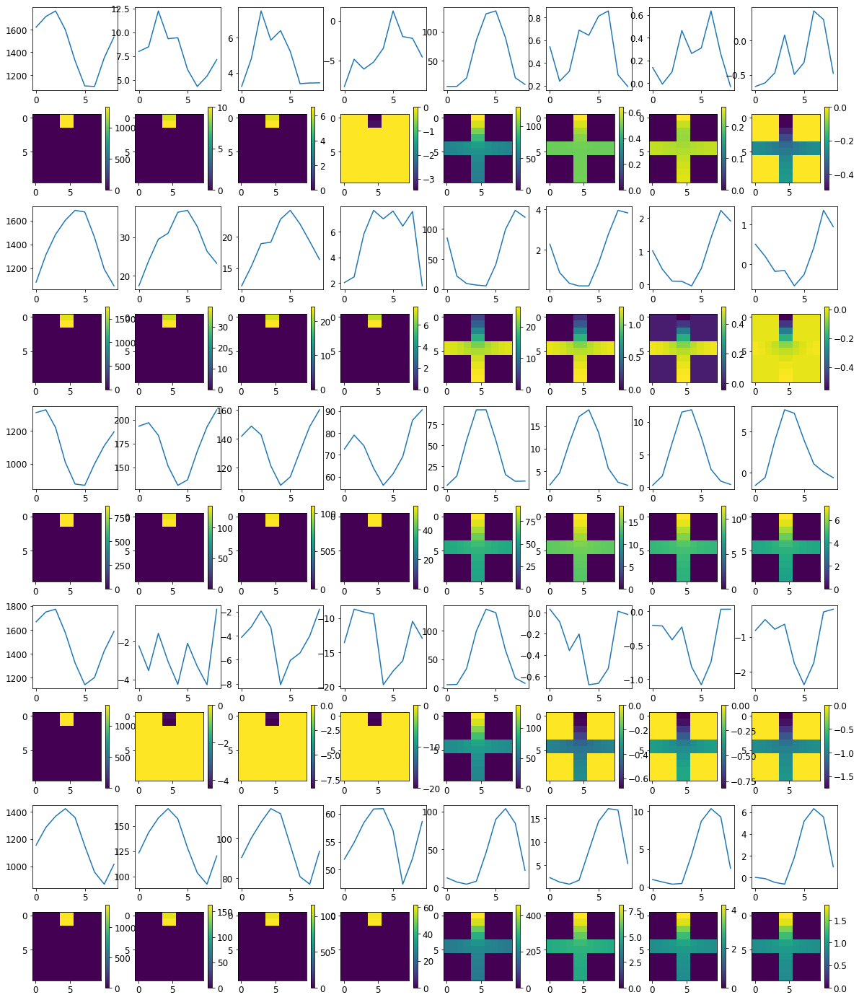

Loss: 


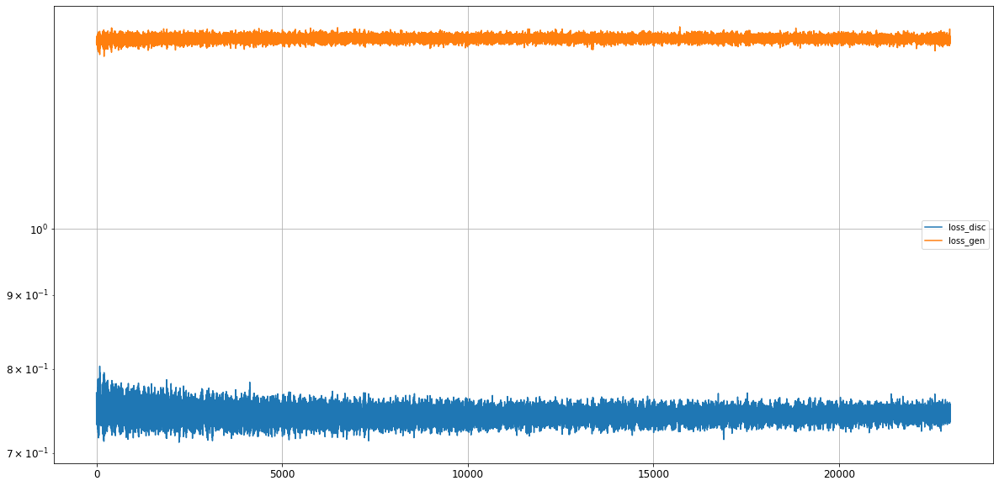

Epoch 23002/50000
discriminator loss: 1.355424 - generator loss: 0.744387 - 1s
Epoch 23003/50000
discriminator loss: 1.358231 - generator loss: 0.736638 - 1s
Epoch 23004/50000
discriminator loss: 1.359260 - generator loss: 0.738687 - 1s
Epoch 23005/50000
discriminator loss: 1.348823 - generator loss: 0.746486 - 1s
Epoch 23006/50000
discriminator loss: 1.347404 - generator loss: 0.740824 - 1s
Epoch 23007/50000
discriminator loss: 1.352818 - generator loss: 0.747852 - 1s
Epoch 23008/50000
discriminator loss: 1.356019 - generator loss: 0.742499 - 1s
Epoch 23009/50000
discriminator loss: 1.363381 - generator loss: 0.739483 - 1s
Epoch 23010/50000
discriminator loss: 1.355776 - generator loss: 0.746185 - 1s
Epoch 23011/50000
discriminator loss: 1.348004 - generator loss: 0.753168 - 1s
Epoch 23012/50000
discriminator loss: 1.340187 - generator loss: 0.756995 - 1s
Epoch 23013/50000
discriminator loss: 1.345040 - generator loss: 0.746894 - 1s
Epoch 23014/50000
discriminator loss: 1.356632 - gen

discriminator loss: 1.354139 - generator loss: 0.749272 - 1s
Epoch 23107/50000
discriminator loss: 1.354046 - generator loss: 0.744350 - 1s
Epoch 23108/50000
discriminator loss: 1.349665 - generator loss: 0.745984 - 1s
Epoch 23109/50000
discriminator loss: 1.351955 - generator loss: 0.742961 - 1s
Epoch 23110/50000
discriminator loss: 1.348703 - generator loss: 0.746116 - 1s
Epoch 23111/50000
discriminator loss: 1.350156 - generator loss: 0.745459 - 1s
Epoch 23112/50000
discriminator loss: 1.352329 - generator loss: 0.747322 - 1s
Epoch 23113/50000
discriminator loss: 1.351253 - generator loss: 0.746725 - 1s
Epoch 23114/50000
discriminator loss: 1.361177 - generator loss: 0.740750 - 1s
Epoch 23115/50000
discriminator loss: 1.350559 - generator loss: 0.747605 - 1s
Epoch 23116/50000
discriminator loss: 1.343525 - generator loss: 0.752420 - 1s
Epoch 23117/50000
discriminator loss: 1.356196 - generator loss: 0.742948 - 1s
Epoch 23118/50000
discriminator loss: 1.348114 - generator loss: 0.742

discriminator loss: 1.345160 - generator loss: 0.746096 - 1s
Epoch 23211/50000
discriminator loss: 1.356666 - generator loss: 0.742947 - 1s
Epoch 23212/50000
discriminator loss: 1.365373 - generator loss: 0.736166 - 1s
Epoch 23213/50000
discriminator loss: 1.353656 - generator loss: 0.744369 - 1s
Epoch 23214/50000
discriminator loss: 1.345989 - generator loss: 0.755345 - 1s
Epoch 23215/50000
discriminator loss: 1.351203 - generator loss: 0.750406 - 1s
Epoch 23216/50000
discriminator loss: 1.366480 - generator loss: 0.736403 - 1s
Epoch 23217/50000
discriminator loss: 1.366236 - generator loss: 0.728405 - 1s
Epoch 23218/50000
discriminator loss: 1.347040 - generator loss: 0.746230 - 1s
Epoch 23219/50000
discriminator loss: 1.347066 - generator loss: 0.747608 - 1s
Epoch 23220/50000
discriminator loss: 1.356726 - generator loss: 0.741776 - 1s
Epoch 23221/50000
discriminator loss: 1.355087 - generator loss: 0.742858 - 1s
Epoch 23222/50000
discriminator loss: 1.356422 - generator loss: 0.758

discriminator loss: 1.339814 - generator loss: 0.749885 - 1s
Epoch 23315/50000
discriminator loss: 1.359113 - generator loss: 0.741695 - 1s
Epoch 23316/50000
discriminator loss: 1.357566 - generator loss: 0.742590 - 1s
Epoch 23317/50000
discriminator loss: 1.351767 - generator loss: 0.750816 - 1s
Epoch 23318/50000
discriminator loss: 1.347195 - generator loss: 0.755442 - 1s
Epoch 23319/50000
discriminator loss: 1.355508 - generator loss: 0.749384 - 1s
Epoch 23320/50000
discriminator loss: 1.347978 - generator loss: 0.739539 - 1s
Epoch 23321/50000
discriminator loss: 1.354803 - generator loss: 0.740545 - 1s
Epoch 23322/50000
discriminator loss: 1.348120 - generator loss: 0.742662 - 1s
Epoch 23323/50000
discriminator loss: 1.346932 - generator loss: 0.747598 - 1s
Epoch 23324/50000
discriminator loss: 1.354506 - generator loss: 0.747673 - 1s
Epoch 23325/50000
discriminator loss: 1.364501 - generator loss: 0.740416 - 1s
Epoch 23326/50000
discriminator loss: 1.351467 - generator loss: 0.750

discriminator loss: 1.353766 - generator loss: 0.745295 - 1s
Epoch 23419/50000
discriminator loss: 1.348423 - generator loss: 0.746908 - 1s
Epoch 23420/50000
discriminator loss: 1.349003 - generator loss: 0.748786 - 1s
Epoch 23421/50000
discriminator loss: 1.367915 - generator loss: 0.736346 - 1s
Epoch 23422/50000
discriminator loss: 1.353254 - generator loss: 0.752008 - 1s
Epoch 23423/50000
discriminator loss: 1.350714 - generator loss: 0.756409 - 1s
Epoch 23424/50000
discriminator loss: 1.345813 - generator loss: 0.754734 - 1s
Epoch 23425/50000
discriminator loss: 1.347423 - generator loss: 0.745793 - 1s
Epoch 23426/50000
discriminator loss: 1.367453 - generator loss: 0.728990 - 1s
Epoch 23427/50000
discriminator loss: 1.358608 - generator loss: 0.739098 - 1s
Epoch 23428/50000
discriminator loss: 1.351956 - generator loss: 0.745425 - 1s
Epoch 23429/50000
discriminator loss: 1.340579 - generator loss: 0.753068 - 1s
Epoch 23430/50000
discriminator loss: 1.359534 - generator loss: 0.738

discriminator loss: 1.354267 - generator loss: 0.743512 - 1s
Epoch 23523/50000
discriminator loss: 1.360900 - generator loss: 0.738250 - 1s
Epoch 23524/50000
discriminator loss: 1.347364 - generator loss: 0.745361 - 1s
Epoch 23525/50000
discriminator loss: 1.351703 - generator loss: 0.748874 - 1s
Epoch 23526/50000
discriminator loss: 1.345546 - generator loss: 0.742430 - 1s
Epoch 23527/50000
discriminator loss: 1.361832 - generator loss: 0.743476 - 1s
Epoch 23528/50000
discriminator loss: 1.355290 - generator loss: 0.743630 - 1s
Epoch 23529/50000
discriminator loss: 1.342661 - generator loss: 0.759669 - 1s
Epoch 23530/50000
discriminator loss: 1.350918 - generator loss: 0.751841 - 1s
Epoch 23531/50000
discriminator loss: 1.351038 - generator loss: 0.741306 - 1s
Epoch 23532/50000
discriminator loss: 1.350307 - generator loss: 0.746902 - 1s
Epoch 23533/50000
discriminator loss: 1.354707 - generator loss: 0.743219 - 1s
Epoch 23534/50000
discriminator loss: 1.353646 - generator loss: 0.741

discriminator loss: 1.358813 - generator loss: 0.733591 - 1s
Epoch 23627/50000
discriminator loss: 1.355501 - generator loss: 0.742296 - 1s
Epoch 23628/50000
discriminator loss: 1.339145 - generator loss: 0.748418 - 1s
Epoch 23629/50000
discriminator loss: 1.343861 - generator loss: 0.751822 - 1s
Epoch 23630/50000
discriminator loss: 1.357643 - generator loss: 0.743945 - 1s
Epoch 23631/50000
discriminator loss: 1.347650 - generator loss: 0.755323 - 1s
Epoch 23632/50000
discriminator loss: 1.359788 - generator loss: 0.750649 - 1s
Epoch 23633/50000
discriminator loss: 1.342857 - generator loss: 0.750619 - 1s
Epoch 23634/50000
discriminator loss: 1.352952 - generator loss: 0.746182 - 1s
Epoch 23635/50000
discriminator loss: 1.357788 - generator loss: 0.733620 - 1s
Epoch 23636/50000
discriminator loss: 1.355330 - generator loss: 0.736086 - 1s
Epoch 23637/50000
discriminator loss: 1.352156 - generator loss: 0.746421 - 1s
Epoch 23638/50000
discriminator loss: 1.340336 - generator loss: 0.760

discriminator loss: 1.357375 - generator loss: 0.740014 - 1s
Epoch 23731/50000
discriminator loss: 1.354711 - generator loss: 0.738294 - 1s
Epoch 23732/50000
discriminator loss: 1.348404 - generator loss: 0.744301 - 1s
Epoch 23733/50000
discriminator loss: 1.355325 - generator loss: 0.740691 - 1s
Epoch 23734/50000
discriminator loss: 1.353895 - generator loss: 0.744237 - 1s
Epoch 23735/50000
discriminator loss: 1.359175 - generator loss: 0.745488 - 1s
Epoch 23736/50000
discriminator loss: 1.349136 - generator loss: 0.747412 - 1s
Epoch 23737/50000
discriminator loss: 1.354009 - generator loss: 0.742030 - 1s
Epoch 23738/50000
discriminator loss: 1.349135 - generator loss: 0.760325 - 1s
Epoch 23739/50000
discriminator loss: 1.360956 - generator loss: 0.732169 - 1s
Epoch 23740/50000
discriminator loss: 1.349579 - generator loss: 0.743396 - 1s
Epoch 23741/50000
discriminator loss: 1.353299 - generator loss: 0.744083 - 1s
Epoch 23742/50000
discriminator loss: 1.346679 - generator loss: 0.749

discriminator loss: 1.356228 - generator loss: 0.746147 - 1s
Epoch 23835/50000
discriminator loss: 1.355352 - generator loss: 0.741186 - 1s
Epoch 23836/50000
discriminator loss: 1.360674 - generator loss: 0.737006 - 1s
Epoch 23837/50000
discriminator loss: 1.350372 - generator loss: 0.741915 - 1s
Epoch 23838/50000
discriminator loss: 1.344809 - generator loss: 0.751195 - 1s
Epoch 23839/50000
discriminator loss: 1.352592 - generator loss: 0.745840 - 1s
Epoch 23840/50000
discriminator loss: 1.355495 - generator loss: 0.744806 - 1s
Epoch 23841/50000
discriminator loss: 1.360098 - generator loss: 0.739657 - 1s
Epoch 23842/50000
discriminator loss: 1.350374 - generator loss: 0.751329 - 1s
Epoch 23843/50000
discriminator loss: 1.340393 - generator loss: 0.756449 - 1s
Epoch 23844/50000
discriminator loss: 1.353915 - generator loss: 0.749417 - 1s
Epoch 23845/50000
discriminator loss: 1.358158 - generator loss: 0.735693 - 1s
Epoch 23846/50000
discriminator loss: 1.354712 - generator loss: 0.738

discriminator loss: 1.353754 - generator loss: 0.745167 - 1s
Epoch 23939/50000
discriminator loss: 1.353855 - generator loss: 0.749643 - 1s
Epoch 23940/50000
discriminator loss: 1.358133 - generator loss: 0.741537 - 1s
Epoch 23941/50000
discriminator loss: 1.348509 - generator loss: 0.743746 - 1s
Epoch 23942/50000
discriminator loss: 1.354106 - generator loss: 0.744859 - 1s
Epoch 23943/50000
discriminator loss: 1.349395 - generator loss: 0.741529 - 1s
Epoch 23944/50000
discriminator loss: 1.348703 - generator loss: 0.742193 - 1s
Epoch 23945/50000
discriminator loss: 1.365847 - generator loss: 0.739381 - 1s
Epoch 23946/50000
discriminator loss: 1.362008 - generator loss: 0.747205 - 1s
Epoch 23947/50000
discriminator loss: 1.353784 - generator loss: 0.751630 - 1s
Epoch 23948/50000
discriminator loss: 1.358405 - generator loss: 0.739553 - 1s
Epoch 23949/50000
discriminator loss: 1.356539 - generator loss: 0.740434 - 1s
Epoch 23950/50000
discriminator loss: 1.359556 - generator loss: 0.734

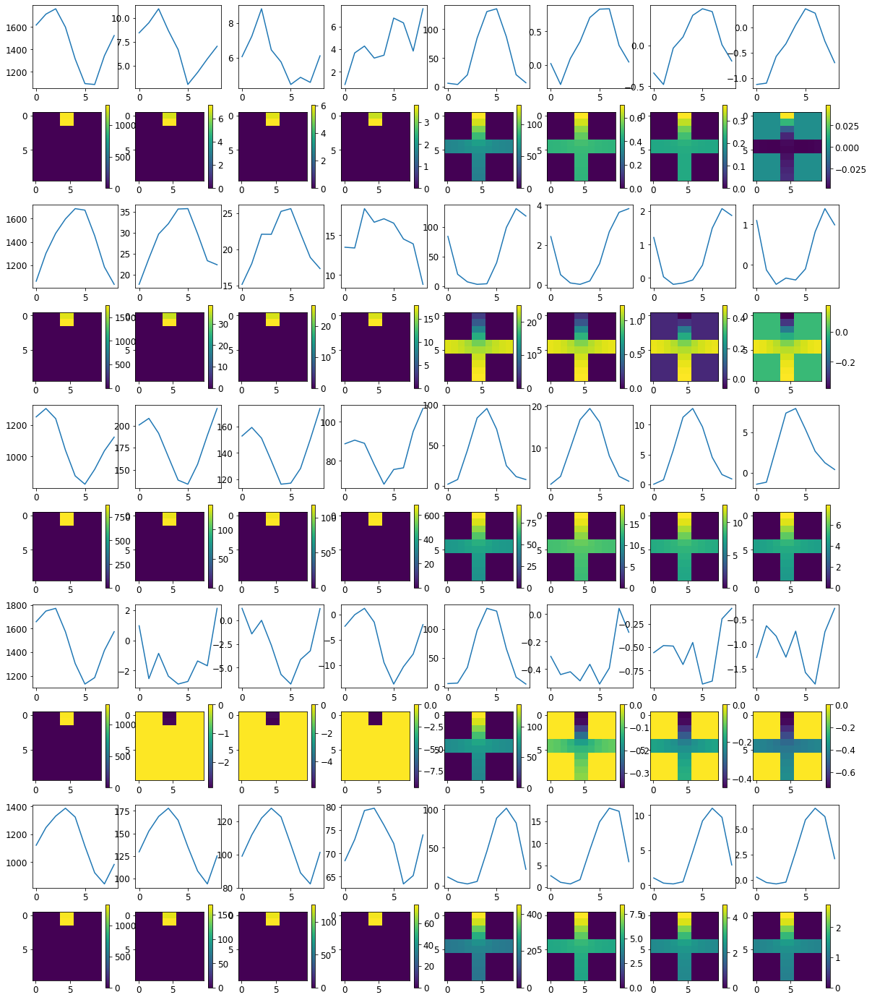

Loss: 


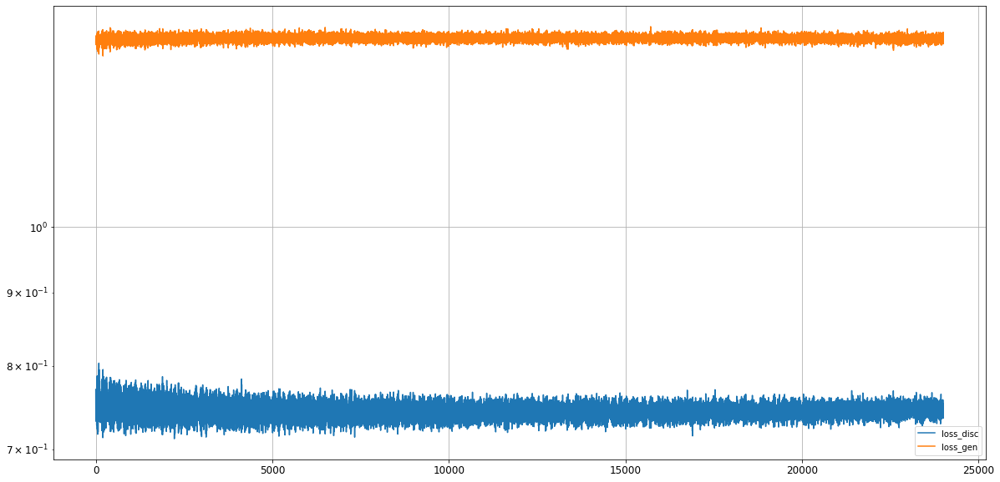

Epoch 24002/50000
discriminator loss: 1.350446 - generator loss: 0.745875 - 1s
Epoch 24003/50000
discriminator loss: 1.359164 - generator loss: 0.746139 - 1s
Epoch 24004/50000
discriminator loss: 1.346715 - generator loss: 0.758006 - 1s
Epoch 24005/50000
discriminator loss: 1.344421 - generator loss: 0.750133 - 1s
Epoch 24006/50000
discriminator loss: 1.355014 - generator loss: 0.749694 - 1s
Epoch 24007/50000
discriminator loss: 1.358415 - generator loss: 0.733470 - 1s
Epoch 24008/50000
discriminator loss: 1.354153 - generator loss: 0.737195 - 1s
Epoch 24009/50000
discriminator loss: 1.345481 - generator loss: 0.746234 - 1s
Epoch 24010/50000
discriminator loss: 1.365712 - generator loss: 0.739208 - 1s
Epoch 24011/50000
discriminator loss: 1.356232 - generator loss: 0.739602 - 1s
Epoch 24012/50000
discriminator loss: 1.360413 - generator loss: 0.745312 - 1s
Epoch 24013/50000
discriminator loss: 1.355594 - generator loss: 0.749677 - 1s
Epoch 24014/50000
discriminator loss: 1.345150 - gen

discriminator loss: 1.342515 - generator loss: 0.749639 - 1s
Epoch 24107/50000
discriminator loss: 1.340238 - generator loss: 0.759108 - 1s
Epoch 24108/50000
discriminator loss: 1.353442 - generator loss: 0.740580 - 1s
Epoch 24109/50000
discriminator loss: 1.356831 - generator loss: 0.748652 - 1s
Epoch 24110/50000
discriminator loss: 1.351581 - generator loss: 0.748977 - 1s
Epoch 24111/50000
discriminator loss: 1.342603 - generator loss: 0.756328 - 1s
Epoch 24112/50000
discriminator loss: 1.350003 - generator loss: 0.743424 - 1s
Epoch 24113/50000
discriminator loss: 1.353834 - generator loss: 0.741732 - 1s
Epoch 24114/50000
discriminator loss: 1.354154 - generator loss: 0.738086 - 1s
Epoch 24115/50000
discriminator loss: 1.353916 - generator loss: 0.742108 - 1s
Epoch 24116/50000
discriminator loss: 1.342156 - generator loss: 0.752812 - 1s
Epoch 24117/50000
discriminator loss: 1.341953 - generator loss: 0.750845 - 1s
Epoch 24118/50000
discriminator loss: 1.356759 - generator loss: 0.743

discriminator loss: 1.352482 - generator loss: 0.753018 - 1s
Epoch 24211/50000
discriminator loss: 1.364803 - generator loss: 0.735993 - 1s
Epoch 24212/50000
discriminator loss: 1.368388 - generator loss: 0.728843 - 1s
Epoch 24213/50000
discriminator loss: 1.347070 - generator loss: 0.749177 - 1s
Epoch 24214/50000
discriminator loss: 1.339864 - generator loss: 0.752549 - 1s
Epoch 24215/50000
discriminator loss: 1.354869 - generator loss: 0.743677 - 1s
Epoch 24216/50000
discriminator loss: 1.367016 - generator loss: 0.733569 - 1s
Epoch 24217/50000
discriminator loss: 1.358410 - generator loss: 0.745897 - 1s
Epoch 24218/50000
discriminator loss: 1.343582 - generator loss: 0.759889 - 1s
Epoch 24219/50000
discriminator loss: 1.342659 - generator loss: 0.762457 - 1s
Epoch 24220/50000
discriminator loss: 1.344239 - generator loss: 0.753985 - 1s
Epoch 24221/50000
discriminator loss: 1.358443 - generator loss: 0.742036 - 1s
Epoch 24222/50000
discriminator loss: 1.354036 - generator loss: 0.737

discriminator loss: 1.351875 - generator loss: 0.744548 - 1s
Epoch 24315/50000
discriminator loss: 1.359442 - generator loss: 0.742072 - 1s
Epoch 24316/50000
discriminator loss: 1.358226 - generator loss: 0.744853 - 1s
Epoch 24317/50000
discriminator loss: 1.344522 - generator loss: 0.752944 - 1s
Epoch 24318/50000
discriminator loss: 1.344351 - generator loss: 0.758909 - 1s
Epoch 24319/50000
discriminator loss: 1.349570 - generator loss: 0.744647 - 1s
Epoch 24320/50000
discriminator loss: 1.356238 - generator loss: 0.742322 - 1s
Epoch 24321/50000
discriminator loss: 1.356523 - generator loss: 0.737579 - 1s
Epoch 24322/50000
discriminator loss: 1.345862 - generator loss: 0.745850 - 1s
Epoch 24323/50000
discriminator loss: 1.353868 - generator loss: 0.748931 - 1s
Epoch 24324/50000
discriminator loss: 1.352651 - generator loss: 0.745393 - 1s
Epoch 24325/50000
discriminator loss: 1.356011 - generator loss: 0.745521 - 1s
Epoch 24326/50000
discriminator loss: 1.354105 - generator loss: 0.747

discriminator loss: 1.361104 - generator loss: 0.738959 - 1s
Epoch 24419/50000
discriminator loss: 1.347730 - generator loss: 0.753326 - 1s
Epoch 24420/50000
discriminator loss: 1.359138 - generator loss: 0.738664 - 1s
Epoch 24421/50000
discriminator loss: 1.352120 - generator loss: 0.740791 - 1s
Epoch 24422/50000
discriminator loss: 1.352672 - generator loss: 0.744837 - 1s
Epoch 24423/50000
discriminator loss: 1.356813 - generator loss: 0.750068 - 1s
Epoch 24424/50000
discriminator loss: 1.354375 - generator loss: 0.755311 - 1s
Epoch 24425/50000
discriminator loss: 1.358112 - generator loss: 0.740683 - 1s
Epoch 24426/50000
discriminator loss: 1.355814 - generator loss: 0.740151 - 1s
Epoch 24427/50000
discriminator loss: 1.351773 - generator loss: 0.745753 - 1s
Epoch 24428/50000
discriminator loss: 1.348153 - generator loss: 0.747307 - 1s
Epoch 24429/50000
discriminator loss: 1.361207 - generator loss: 0.742618 - 1s
Epoch 24430/50000
discriminator loss: 1.359071 - generator loss: 0.732

discriminator loss: 1.343840 - generator loss: 0.751116 - 1s
Epoch 24523/50000
discriminator loss: 1.353953 - generator loss: 0.740525 - 1s
Epoch 24524/50000
discriminator loss: 1.357366 - generator loss: 0.739909 - 1s
Epoch 24525/50000
discriminator loss: 1.363192 - generator loss: 0.730505 - 1s
Epoch 24526/50000
discriminator loss: 1.350013 - generator loss: 0.748635 - 1s
Epoch 24527/50000
discriminator loss: 1.346239 - generator loss: 0.750595 - 1s
Epoch 24528/50000
discriminator loss: 1.352022 - generator loss: 0.748369 - 1s
Epoch 24529/50000
discriminator loss: 1.357422 - generator loss: 0.745078 - 1s
Epoch 24530/50000
discriminator loss: 1.353342 - generator loss: 0.750184 - 1s
Epoch 24531/50000
discriminator loss: 1.342223 - generator loss: 0.755829 - 1s
Epoch 24532/50000
discriminator loss: 1.350282 - generator loss: 0.748567 - 1s
Epoch 24533/50000
discriminator loss: 1.356165 - generator loss: 0.744789 - 1s
Epoch 24534/50000
discriminator loss: 1.358121 - generator loss: 0.731

discriminator loss: 1.358231 - generator loss: 0.735401 - 1s
Epoch 24627/50000
discriminator loss: 1.347942 - generator loss: 0.747659 - 1s
Epoch 24628/50000
discriminator loss: 1.360992 - generator loss: 0.733020 - 1s
Epoch 24629/50000
discriminator loss: 1.350322 - generator loss: 0.751796 - 1s
Epoch 24630/50000
discriminator loss: 1.358908 - generator loss: 0.744322 - 1s
Epoch 24631/50000
discriminator loss: 1.349647 - generator loss: 0.752921 - 1s
Epoch 24632/50000
discriminator loss: 1.347621 - generator loss: 0.749193 - 1s
Epoch 24633/50000
discriminator loss: 1.342606 - generator loss: 0.751077 - 1s
Epoch 24634/50000
discriminator loss: 1.349837 - generator loss: 0.741160 - 1s
Epoch 24635/50000
discriminator loss: 1.355555 - generator loss: 0.742142 - 1s
Epoch 24636/50000
discriminator loss: 1.349865 - generator loss: 0.742036 - 1s
Epoch 24637/50000
discriminator loss: 1.358061 - generator loss: 0.743176 - 1s
Epoch 24638/50000
discriminator loss: 1.355088 - generator loss: 0.754

discriminator loss: 1.350552 - generator loss: 0.744643 - 1s
Epoch 24731/50000
discriminator loss: 1.364825 - generator loss: 0.732005 - 1s
Epoch 24732/50000
discriminator loss: 1.348396 - generator loss: 0.751917 - 1s
Epoch 24733/50000
discriminator loss: 1.356814 - generator loss: 0.744194 - 1s
Epoch 24734/50000
discriminator loss: 1.347089 - generator loss: 0.755360 - 1s
Epoch 24735/50000
discriminator loss: 1.342661 - generator loss: 0.757867 - 1s
Epoch 24736/50000
discriminator loss: 1.350975 - generator loss: 0.743347 - 1s
Epoch 24737/50000
discriminator loss: 1.357651 - generator loss: 0.733618 - 1s
Epoch 24738/50000
discriminator loss: 1.351597 - generator loss: 0.749144 - 1s
Epoch 24739/50000
discriminator loss: 1.354682 - generator loss: 0.742065 - 1s
Epoch 24740/50000
discriminator loss: 1.350758 - generator loss: 0.749724 - 1s
Epoch 24741/50000
discriminator loss: 1.352525 - generator loss: 0.748105 - 1s
Epoch 24742/50000
discriminator loss: 1.348694 - generator loss: 0.753

discriminator loss: 1.353857 - generator loss: 0.744703 - 1s
Epoch 24835/50000
discriminator loss: 1.356013 - generator loss: 0.743529 - 1s
Epoch 24836/50000
discriminator loss: 1.355052 - generator loss: 0.752434 - 1s
Epoch 24837/50000
discriminator loss: 1.349961 - generator loss: 0.758290 - 1s
Epoch 24838/50000
discriminator loss: 1.348756 - generator loss: 0.750886 - 1s
Epoch 24839/50000
discriminator loss: 1.355888 - generator loss: 0.744422 - 1s
Epoch 24840/50000
discriminator loss: 1.354168 - generator loss: 0.736111 - 1s
Epoch 24841/50000
discriminator loss: 1.352575 - generator loss: 0.740838 - 1s
Epoch 24842/50000
discriminator loss: 1.354037 - generator loss: 0.739153 - 1s
Epoch 24843/50000
discriminator loss: 1.341994 - generator loss: 0.758858 - 1s
Epoch 24844/50000
discriminator loss: 1.347397 - generator loss: 0.757017 - 1s
Epoch 24845/50000
discriminator loss: 1.349248 - generator loss: 0.754124 - 1s
Epoch 24846/50000
discriminator loss: 1.346888 - generator loss: 0.745

discriminator loss: 1.352953 - generator loss: 0.751022 - 1s
Epoch 24939/50000
discriminator loss: 1.355194 - generator loss: 0.743748 - 1s
Epoch 24940/50000
discriminator loss: 1.349948 - generator loss: 0.746018 - 1s
Epoch 24941/50000
discriminator loss: 1.338548 - generator loss: 0.757842 - 1s
Epoch 24942/50000
discriminator loss: 1.353247 - generator loss: 0.746602 - 1s
Epoch 24943/50000
discriminator loss: 1.358076 - generator loss: 0.745861 - 1s
Epoch 24944/50000
discriminator loss: 1.352265 - generator loss: 0.741955 - 1s
Epoch 24945/50000
discriminator loss: 1.352787 - generator loss: 0.745868 - 1s
Epoch 24946/50000
discriminator loss: 1.353401 - generator loss: 0.741232 - 1s
Epoch 24947/50000
discriminator loss: 1.357241 - generator loss: 0.736790 - 1s
Epoch 24948/50000
discriminator loss: 1.360130 - generator loss: 0.741592 - 1s
Epoch 24949/50000
discriminator loss: 1.353039 - generator loss: 0.746394 - 1s
Epoch 24950/50000
discriminator loss: 1.353852 - generator loss: 0.747

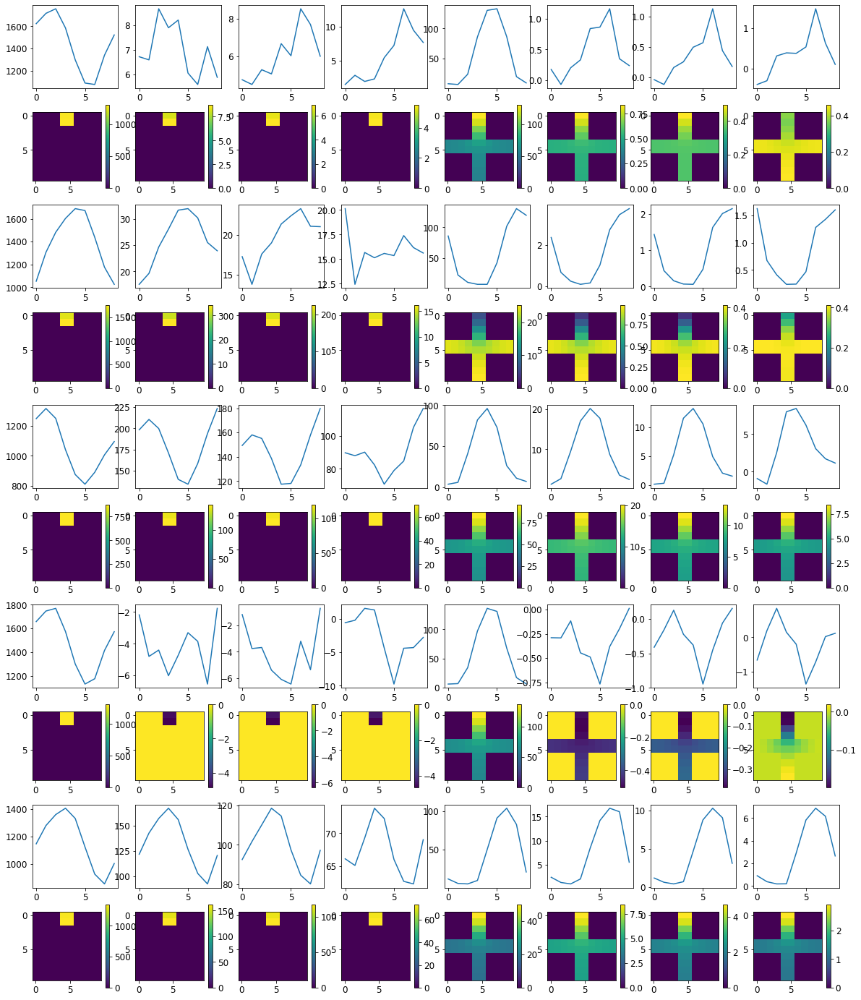

Loss: 


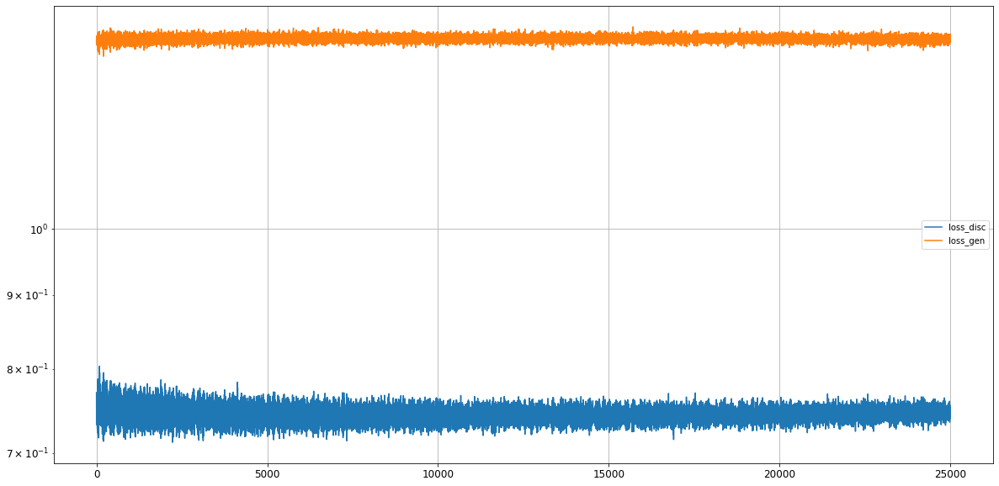

Epoch 25002/50000
discriminator loss: 1.350921 - generator loss: 0.744231 - 1s
Epoch 25003/50000
discriminator loss: 1.348335 - generator loss: 0.750562 - 1s
Epoch 25004/50000
discriminator loss: 1.348420 - generator loss: 0.753057 - 1s
Epoch 25005/50000
discriminator loss: 1.361058 - generator loss: 0.736508 - 1s
Epoch 25006/50000
discriminator loss: 1.346076 - generator loss: 0.753193 - 1s
Epoch 25007/50000
discriminator loss: 1.348393 - generator loss: 0.749238 - 1s
Epoch 25008/50000
discriminator loss: 1.352903 - generator loss: 0.743666 - 1s
Epoch 25009/50000
discriminator loss: 1.340757 - generator loss: 0.754753 - 1s
Epoch 25010/50000
discriminator loss: 1.351352 - generator loss: 0.741095 - 1s
Epoch 25011/50000
discriminator loss: 1.347512 - generator loss: 0.749924 - 1s
Epoch 25012/50000
discriminator loss: 1.354177 - generator loss: 0.744118 - 1s
Epoch 25013/50000
discriminator loss: 1.352921 - generator loss: 0.746504 - 1s
Epoch 25014/50000
discriminator loss: 1.356571 - gen

discriminator loss: 1.331544 - generator loss: 0.751123 - 1s
Epoch 25107/50000
discriminator loss: 1.346460 - generator loss: 0.751208 - 1s
Epoch 25108/50000
discriminator loss: 1.357162 - generator loss: 0.744980 - 1s
Epoch 25109/50000
discriminator loss: 1.361826 - generator loss: 0.732035 - 1s
Epoch 25110/50000
discriminator loss: 1.351120 - generator loss: 0.754151 - 1s
Epoch 25111/50000
discriminator loss: 1.355504 - generator loss: 0.752705 - 1s
Epoch 25112/50000
discriminator loss: 1.344642 - generator loss: 0.750907 - 1s
Epoch 25113/50000
discriminator loss: 1.358583 - generator loss: 0.735522 - 1s
Epoch 25114/50000
discriminator loss: 1.362103 - generator loss: 0.735116 - 1s
Epoch 25115/50000
discriminator loss: 1.352914 - generator loss: 0.739967 - 1s
Epoch 25116/50000
discriminator loss: 1.350261 - generator loss: 0.752577 - 1s
Epoch 25117/50000
discriminator loss: 1.364887 - generator loss: 0.735564 - 1s
Epoch 25118/50000
discriminator loss: 1.360502 - generator loss: 0.739

discriminator loss: 1.348722 - generator loss: 0.756297 - 1s
Epoch 25211/50000
discriminator loss: 1.359941 - generator loss: 0.742684 - 1s
Epoch 25212/50000
discriminator loss: 1.354382 - generator loss: 0.739093 - 1s
Epoch 25213/50000
discriminator loss: 1.345530 - generator loss: 0.747022 - 1s
Epoch 25214/50000
discriminator loss: 1.343183 - generator loss: 0.744417 - 1s
Epoch 25215/50000
discriminator loss: 1.350850 - generator loss: 0.755622 - 1s
Epoch 25216/50000
discriminator loss: 1.351725 - generator loss: 0.747621 - 1s
Epoch 25217/50000
discriminator loss: 1.337664 - generator loss: 0.757131 - 1s
Epoch 25218/50000
discriminator loss: 1.345795 - generator loss: 0.752174 - 1s
Epoch 25219/50000
discriminator loss: 1.341807 - generator loss: 0.752344 - 1s
Epoch 25220/50000
discriminator loss: 1.350107 - generator loss: 0.739426 - 1s
Epoch 25221/50000
discriminator loss: 1.344223 - generator loss: 0.749571 - 1s
Epoch 25222/50000
discriminator loss: 1.353369 - generator loss: 0.743

discriminator loss: 1.349853 - generator loss: 0.756735 - 1s
Epoch 25315/50000
discriminator loss: 1.344830 - generator loss: 0.757767 - 1s
Epoch 25316/50000
discriminator loss: 1.350888 - generator loss: 0.740946 - 1s
Epoch 25317/50000
discriminator loss: 1.355188 - generator loss: 0.744517 - 1s
Epoch 25318/50000
discriminator loss: 1.356357 - generator loss: 0.740972 - 1s
Epoch 25319/50000
discriminator loss: 1.340400 - generator loss: 0.749109 - 1s
Epoch 25320/50000
discriminator loss: 1.354207 - generator loss: 0.747592 - 1s
Epoch 25321/50000
discriminator loss: 1.355912 - generator loss: 0.745393 - 1s
Epoch 25322/50000
discriminator loss: 1.352402 - generator loss: 0.751513 - 1s
Epoch 25323/50000
discriminator loss: 1.342272 - generator loss: 0.756437 - 1s
Epoch 25324/50000
discriminator loss: 1.347506 - generator loss: 0.750819 - 1s
Epoch 25325/50000
discriminator loss: 1.349806 - generator loss: 0.745165 - 1s
Epoch 25326/50000
discriminator loss: 1.354591 - generator loss: 0.743

discriminator loss: 1.344974 - generator loss: 0.746245 - 1s
Epoch 25419/50000
discriminator loss: 1.350931 - generator loss: 0.747319 - 1s
Epoch 25420/50000
discriminator loss: 1.348687 - generator loss: 0.757160 - 1s
Epoch 25421/50000
discriminator loss: 1.348582 - generator loss: 0.756595 - 1s
Epoch 25422/50000
discriminator loss: 1.349412 - generator loss: 0.748264 - 1s
Epoch 25423/50000
discriminator loss: 1.340008 - generator loss: 0.754122 - 1s
Epoch 25424/50000
discriminator loss: 1.344572 - generator loss: 0.753784 - 1s
Epoch 25425/50000
discriminator loss: 1.348761 - generator loss: 0.743244 - 1s
Epoch 25426/50000
discriminator loss: 1.357180 - generator loss: 0.744767 - 1s
Epoch 25427/50000
discriminator loss: 1.353144 - generator loss: 0.741809 - 1s
Epoch 25428/50000
discriminator loss: 1.337714 - generator loss: 0.757099 - 1s
Epoch 25429/50000
discriminator loss: 1.357925 - generator loss: 0.745810 - 1s
Epoch 25430/50000
discriminator loss: 1.357358 - generator loss: 0.743

discriminator loss: 1.353661 - generator loss: 0.745068 - 1s
Epoch 25523/50000
discriminator loss: 1.356247 - generator loss: 0.739884 - 1s
Epoch 25524/50000
discriminator loss: 1.357277 - generator loss: 0.738307 - 1s
Epoch 25525/50000
discriminator loss: 1.354746 - generator loss: 0.741220 - 1s
Epoch 25526/50000
discriminator loss: 1.344586 - generator loss: 0.756234 - 1s
Epoch 25527/50000
discriminator loss: 1.347172 - generator loss: 0.749413 - 1s
Epoch 25528/50000
discriminator loss: 1.354614 - generator loss: 0.744534 - 1s
Epoch 25529/50000
discriminator loss: 1.350912 - generator loss: 0.752817 - 1s
Epoch 25530/50000
discriminator loss: 1.346678 - generator loss: 0.749755 - 1s
Epoch 25531/50000
discriminator loss: 1.340523 - generator loss: 0.755888 - 1s
Epoch 25532/50000
discriminator loss: 1.343092 - generator loss: 0.753875 - 1s
Epoch 25533/50000
discriminator loss: 1.349535 - generator loss: 0.744715 - 1s
Epoch 25534/50000
discriminator loss: 1.358279 - generator loss: 0.738

discriminator loss: 1.351567 - generator loss: 0.744376 - 1s
Epoch 25627/50000
discriminator loss: 1.361010 - generator loss: 0.734278 - 1s
Epoch 25628/50000
discriminator loss: 1.348914 - generator loss: 0.754535 - 1s
Epoch 25629/50000
discriminator loss: 1.347641 - generator loss: 0.750156 - 1s
Epoch 25630/50000
discriminator loss: 1.349472 - generator loss: 0.746137 - 1s
Epoch 25631/50000
discriminator loss: 1.358164 - generator loss: 0.744309 - 1s
Epoch 25632/50000
discriminator loss: 1.344346 - generator loss: 0.747735 - 1s
Epoch 25633/50000
discriminator loss: 1.353397 - generator loss: 0.742821 - 1s
Epoch 25634/50000
discriminator loss: 1.354044 - generator loss: 0.740275 - 1s
Epoch 25635/50000
discriminator loss: 1.345194 - generator loss: 0.745122 - 1s
Epoch 25636/50000
discriminator loss: 1.357002 - generator loss: 0.747356 - 1s
Epoch 25637/50000
discriminator loss: 1.350600 - generator loss: 0.750532 - 1s
Epoch 25638/50000
discriminator loss: 1.350128 - generator loss: 0.754

discriminator loss: 1.350099 - generator loss: 0.746064 - 1s
Epoch 25731/50000
discriminator loss: 1.350654 - generator loss: 0.740407 - 1s
Epoch 25732/50000
discriminator loss: 1.350719 - generator loss: 0.744271 - 1s
Epoch 25733/50000
discriminator loss: 1.347787 - generator loss: 0.758237 - 1s
Epoch 25734/50000
discriminator loss: 1.357653 - generator loss: 0.739537 - 1s
Epoch 25735/50000
discriminator loss: 1.357230 - generator loss: 0.744082 - 1s
Epoch 25736/50000
discriminator loss: 1.349602 - generator loss: 0.747346 - 1s
Epoch 25737/50000
discriminator loss: 1.346334 - generator loss: 0.755982 - 1s
Epoch 25738/50000
discriminator loss: 1.349784 - generator loss: 0.751106 - 1s
Epoch 25739/50000
discriminator loss: 1.353149 - generator loss: 0.745376 - 1s
Epoch 25740/50000
discriminator loss: 1.351516 - generator loss: 0.739422 - 1s
Epoch 25741/50000
discriminator loss: 1.345310 - generator loss: 0.741530 - 1s
Epoch 25742/50000
discriminator loss: 1.343663 - generator loss: 0.754

discriminator loss: 1.341036 - generator loss: 0.760812 - 1s
Epoch 25835/50000
discriminator loss: 1.352360 - generator loss: 0.751149 - 1s
Epoch 25836/50000
discriminator loss: 1.351360 - generator loss: 0.738684 - 1s
Epoch 25837/50000
discriminator loss: 1.346916 - generator loss: 0.743020 - 1s
Epoch 25838/50000
discriminator loss: 1.351412 - generator loss: 0.746924 - 1s
Epoch 25839/50000
discriminator loss: 1.346926 - generator loss: 0.752348 - 1s
Epoch 25840/50000
discriminator loss: 1.354912 - generator loss: 0.743997 - 1s
Epoch 25841/50000
discriminator loss: 1.349451 - generator loss: 0.751731 - 1s
Epoch 25842/50000
discriminator loss: 1.354521 - generator loss: 0.755459 - 1s
Epoch 25843/50000
discriminator loss: 1.348449 - generator loss: 0.751111 - 1s
Epoch 25844/50000
discriminator loss: 1.347766 - generator loss: 0.749068 - 1s
Epoch 25845/50000
discriminator loss: 1.355419 - generator loss: 0.737198 - 1s
Epoch 25846/50000
discriminator loss: 1.356807 - generator loss: 0.741

discriminator loss: 1.353801 - generator loss: 0.742376 - 1s
Epoch 25939/50000
discriminator loss: 1.348520 - generator loss: 0.754662 - 1s
Epoch 25940/50000
discriminator loss: 1.360605 - generator loss: 0.744004 - 1s
Epoch 25941/50000
discriminator loss: 1.341946 - generator loss: 0.762558 - 1s
Epoch 25942/50000
discriminator loss: 1.344497 - generator loss: 0.759244 - 1s
Epoch 25943/50000
discriminator loss: 1.355532 - generator loss: 0.743042 - 1s
Epoch 25944/50000
discriminator loss: 1.357230 - generator loss: 0.737145 - 1s
Epoch 25945/50000
discriminator loss: 1.348413 - generator loss: 0.742862 - 1s
Epoch 25946/50000
discriminator loss: 1.344027 - generator loss: 0.747230 - 1s
Epoch 25947/50000
discriminator loss: 1.345453 - generator loss: 0.750901 - 1s
Epoch 25948/50000
discriminator loss: 1.348448 - generator loss: 0.747722 - 1s
Epoch 25949/50000
discriminator loss: 1.348907 - generator loss: 0.758215 - 1s
Epoch 25950/50000
discriminator loss: 1.355339 - generator loss: 0.751

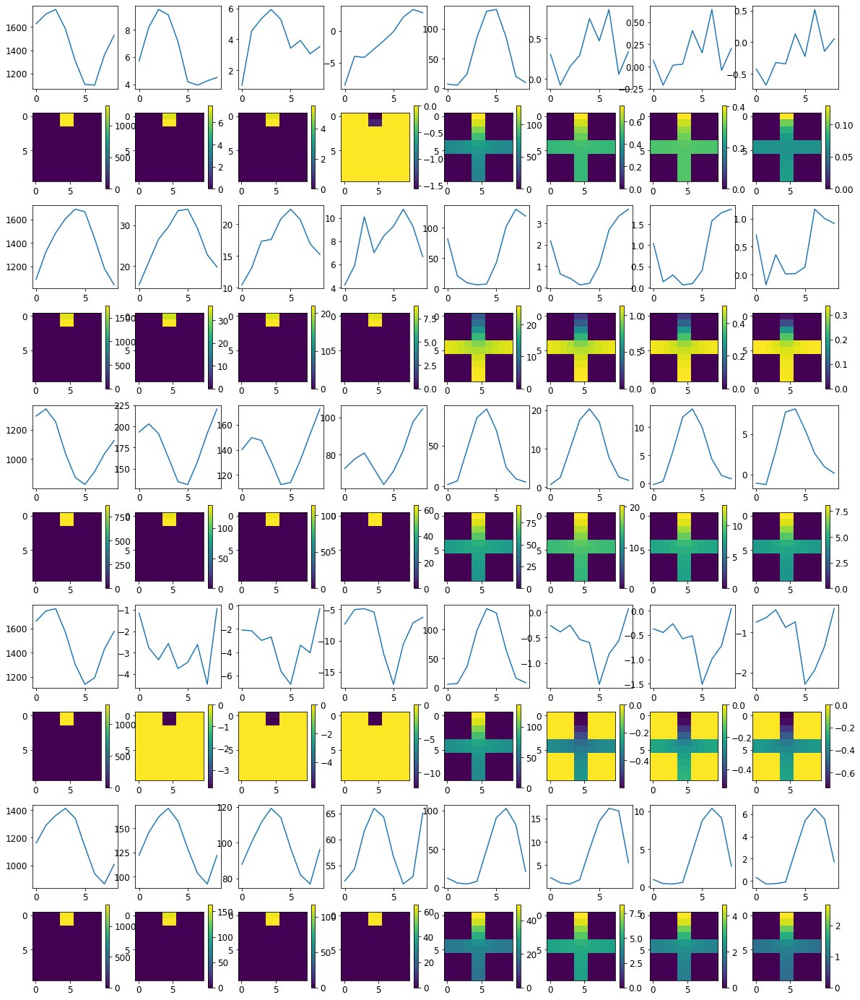

Loss: 


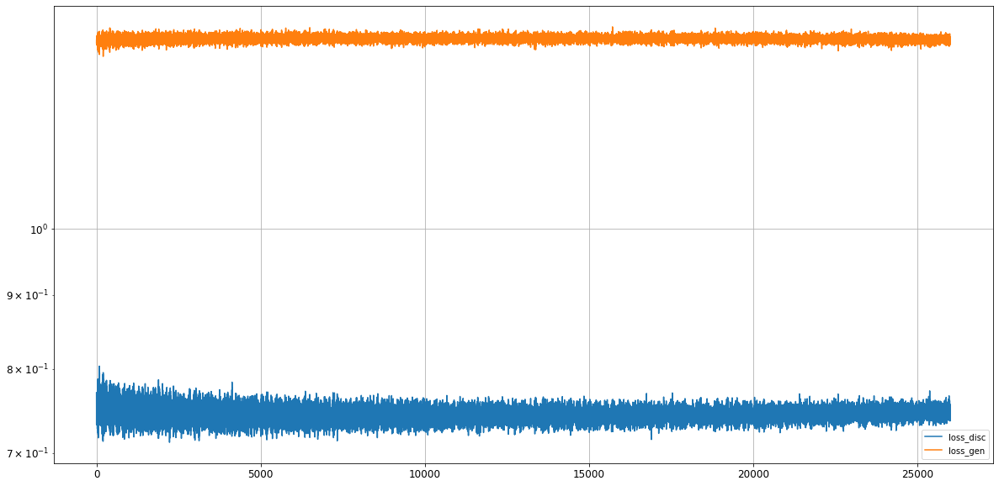

Epoch 26002/50000
discriminator loss: 1.346612 - generator loss: 0.748869 - 1s
Epoch 26003/50000
discriminator loss: 1.357793 - generator loss: 0.741525 - 1s
Epoch 26004/50000
discriminator loss: 1.352485 - generator loss: 0.742202 - 1s
Epoch 26005/50000
discriminator loss: 1.342476 - generator loss: 0.744567 - 1s
Epoch 26006/50000
discriminator loss: 1.339620 - generator loss: 0.753446 - 1s
Epoch 26007/50000
discriminator loss: 1.350068 - generator loss: 0.747624 - 1s
Epoch 26008/50000
discriminator loss: 1.356619 - generator loss: 0.745311 - 1s
Epoch 26009/50000
discriminator loss: 1.346929 - generator loss: 0.754552 - 1s
Epoch 26010/50000
discriminator loss: 1.354863 - generator loss: 0.744375 - 1s
Epoch 26011/50000
discriminator loss: 1.346907 - generator loss: 0.753565 - 1s
Epoch 26012/50000
discriminator loss: 1.348251 - generator loss: 0.746670 - 1s
Epoch 26013/50000
discriminator loss: 1.355361 - generator loss: 0.746687 - 1s
Epoch 26014/50000
discriminator loss: 1.350776 - gen

discriminator loss: 1.350418 - generator loss: 0.740309 - 1s
Epoch 26107/50000
discriminator loss: 1.354899 - generator loss: 0.749406 - 1s
Epoch 26108/50000
discriminator loss: 1.345632 - generator loss: 0.754393 - 1s
Epoch 26109/50000
discriminator loss: 1.337666 - generator loss: 0.764786 - 1s
Epoch 26110/50000
discriminator loss: 1.350299 - generator loss: 0.748043 - 1s
Epoch 26111/50000
discriminator loss: 1.350037 - generator loss: 0.743987 - 1s
Epoch 26112/50000
discriminator loss: 1.352261 - generator loss: 0.736814 - 1s
Epoch 26113/50000
discriminator loss: 1.348873 - generator loss: 0.750107 - 1s
Epoch 26114/50000
discriminator loss: 1.345551 - generator loss: 0.748258 - 1s
Epoch 26115/50000
discriminator loss: 1.349379 - generator loss: 0.752436 - 1s
Epoch 26116/50000
discriminator loss: 1.353226 - generator loss: 0.749585 - 1s
Epoch 26117/50000
discriminator loss: 1.358716 - generator loss: 0.744926 - 1s
Epoch 26118/50000
discriminator loss: 1.352634 - generator loss: 0.755

discriminator loss: 1.355067 - generator loss: 0.739460 - 1s
Epoch 26211/50000
discriminator loss: 1.356368 - generator loss: 0.743336 - 1s
Epoch 26212/50000
discriminator loss: 1.345690 - generator loss: 0.742898 - 1s
Epoch 26213/50000
discriminator loss: 1.351456 - generator loss: 0.747479 - 1s
Epoch 26214/50000
discriminator loss: 1.352766 - generator loss: 0.746606 - 1s
Epoch 26215/50000
discriminator loss: 1.351173 - generator loss: 0.749262 - 1s
Epoch 26216/50000
discriminator loss: 1.358726 - generator loss: 0.740619 - 1s
Epoch 26217/50000
discriminator loss: 1.354564 - generator loss: 0.756943 - 1s
Epoch 26218/50000
discriminator loss: 1.348163 - generator loss: 0.747766 - 1s
Epoch 26219/50000
discriminator loss: 1.353958 - generator loss: 0.742470 - 1s
Epoch 26220/50000
discriminator loss: 1.350827 - generator loss: 0.747255 - 1s
Epoch 26221/50000
discriminator loss: 1.355103 - generator loss: 0.745828 - 1s
Epoch 26222/50000
discriminator loss: 1.361887 - generator loss: 0.738

discriminator loss: 1.354761 - generator loss: 0.750258 - 1s
Epoch 26315/50000
discriminator loss: 1.358551 - generator loss: 0.745537 - 1s
Epoch 26316/50000
discriminator loss: 1.349156 - generator loss: 0.756344 - 1s
Epoch 26317/50000
discriminator loss: 1.342693 - generator loss: 0.757084 - 1s
Epoch 26318/50000
discriminator loss: 1.342031 - generator loss: 0.757264 - 1s
Epoch 26319/50000
discriminator loss: 1.353140 - generator loss: 0.736153 - 1s
Epoch 26320/50000
discriminator loss: 1.360256 - generator loss: 0.733705 - 1s
Epoch 26321/50000
discriminator loss: 1.351787 - generator loss: 0.752618 - 1s
Epoch 26322/50000
discriminator loss: 1.345040 - generator loss: 0.756105 - 1s
Epoch 26323/50000
discriminator loss: 1.340368 - generator loss: 0.750463 - 1s
Epoch 26324/50000
discriminator loss: 1.354177 - generator loss: 0.738703 - 1s
Epoch 26325/50000
discriminator loss: 1.355022 - generator loss: 0.751695 - 1s
Epoch 26326/50000
discriminator loss: 1.353637 - generator loss: 0.748

discriminator loss: 1.348612 - generator loss: 0.746436 - 1s
Epoch 26419/50000
discriminator loss: 1.364938 - generator loss: 0.738539 - 1s
Epoch 26420/50000
discriminator loss: 1.351457 - generator loss: 0.742542 - 1s
Epoch 26421/50000
discriminator loss: 1.352191 - generator loss: 0.741710 - 1s
Epoch 26422/50000
discriminator loss: 1.342957 - generator loss: 0.755025 - 1s
Epoch 26423/50000
discriminator loss: 1.349070 - generator loss: 0.744165 - 1s
Epoch 26424/50000
discriminator loss: 1.356817 - generator loss: 0.744769 - 1s
Epoch 26425/50000
discriminator loss: 1.362130 - generator loss: 0.744225 - 1s
Epoch 26426/50000
discriminator loss: 1.346863 - generator loss: 0.756948 - 1s
Epoch 26427/50000
discriminator loss: 1.349356 - generator loss: 0.758523 - 1s
Epoch 26428/50000
discriminator loss: 1.347517 - generator loss: 0.750158 - 1s
Epoch 26429/50000
discriminator loss: 1.347803 - generator loss: 0.744287 - 1s
Epoch 26430/50000
discriminator loss: 1.353581 - generator loss: 0.744

discriminator loss: 1.341045 - generator loss: 0.760104 - 1s
Epoch 26523/50000
discriminator loss: 1.353957 - generator loss: 0.750146 - 1s
Epoch 26524/50000
discriminator loss: 1.354963 - generator loss: 0.744954 - 1s
Epoch 26525/50000
discriminator loss: 1.360594 - generator loss: 0.737421 - 1s
Epoch 26526/50000
discriminator loss: 1.349450 - generator loss: 0.750697 - 1s
Epoch 26527/50000
discriminator loss: 1.348332 - generator loss: 0.757470 - 1s
Epoch 26528/50000
discriminator loss: 1.347815 - generator loss: 0.748595 - 1s
Epoch 26529/50000
discriminator loss: 1.357800 - generator loss: 0.744490 - 1s
Epoch 26530/50000
discriminator loss: 1.340326 - generator loss: 0.753412 - 1s
Epoch 26531/50000
discriminator loss: 1.348645 - generator loss: 0.739171 - 1s
Epoch 26532/50000
discriminator loss: 1.347509 - generator loss: 0.758003 - 1s
Epoch 26533/50000
discriminator loss: 1.360371 - generator loss: 0.736568 - 1s
Epoch 26534/50000
discriminator loss: 1.345850 - generator loss: 0.752

discriminator loss: 1.345889 - generator loss: 0.750001 - 1s
Epoch 26627/50000
discriminator loss: 1.351091 - generator loss: 0.753289 - 1s
Epoch 26628/50000
discriminator loss: 1.360077 - generator loss: 0.744785 - 1s
Epoch 26629/50000
discriminator loss: 1.352392 - generator loss: 0.751098 - 1s
Epoch 26630/50000
discriminator loss: 1.354049 - generator loss: 0.737046 - 1s
Epoch 26631/50000
discriminator loss: 1.349672 - generator loss: 0.742117 - 1s
Epoch 26632/50000
discriminator loss: 1.346766 - generator loss: 0.746886 - 1s
Epoch 26633/50000
discriminator loss: 1.355206 - generator loss: 0.747845 - 1s
Epoch 26634/50000
discriminator loss: 1.354641 - generator loss: 0.746457 - 1s
Epoch 26635/50000
discriminator loss: 1.346946 - generator loss: 0.755651 - 1s
Epoch 26636/50000
discriminator loss: 1.341361 - generator loss: 0.759381 - 1s
Epoch 26637/50000
discriminator loss: 1.339363 - generator loss: 0.748774 - 1s
Epoch 26638/50000
discriminator loss: 1.347191 - generator loss: 0.748

discriminator loss: 1.350569 - generator loss: 0.742597 - 1s
Epoch 26731/50000
discriminator loss: 1.355105 - generator loss: 0.750062 - 1s
Epoch 26732/50000
discriminator loss: 1.363707 - generator loss: 0.737931 - 1s
Epoch 26733/50000
discriminator loss: 1.353183 - generator loss: 0.752233 - 1s
Epoch 26734/50000
discriminator loss: 1.351879 - generator loss: 0.749273 - 1s
Epoch 26735/50000
discriminator loss: 1.348406 - generator loss: 0.755775 - 1s
Epoch 26736/50000
discriminator loss: 1.351728 - generator loss: 0.751749 - 1s
Epoch 26737/50000
discriminator loss: 1.355416 - generator loss: 0.743019 - 1s
Epoch 26738/50000
discriminator loss: 1.363964 - generator loss: 0.740116 - 1s
Epoch 26739/50000
discriminator loss: 1.341448 - generator loss: 0.750529 - 1s
Epoch 26740/50000
discriminator loss: 1.334049 - generator loss: 0.758288 - 1s
Epoch 26741/50000
discriminator loss: 1.352482 - generator loss: 0.740474 - 1s
Epoch 26742/50000
discriminator loss: 1.356001 - generator loss: 0.739

discriminator loss: 1.365377 - generator loss: 0.738082 - 1s
Epoch 26835/50000
discriminator loss: 1.351795 - generator loss: 0.750214 - 1s
Epoch 26836/50000
discriminator loss: 1.348501 - generator loss: 0.748602 - 1s
Epoch 26837/50000
discriminator loss: 1.348436 - generator loss: 0.755505 - 1s
Epoch 26838/50000
discriminator loss: 1.357922 - generator loss: 0.746651 - 1s
Epoch 26839/50000
discriminator loss: 1.348598 - generator loss: 0.750608 - 1s
Epoch 26840/50000
discriminator loss: 1.354392 - generator loss: 0.736686 - 1s
Epoch 26841/50000
discriminator loss: 1.354122 - generator loss: 0.749066 - 1s
Epoch 26842/50000
discriminator loss: 1.352726 - generator loss: 0.745173 - 1s
Epoch 26843/50000
discriminator loss: 1.351397 - generator loss: 0.745932 - 1s
Epoch 26844/50000
discriminator loss: 1.360011 - generator loss: 0.738979 - 1s
Epoch 26845/50000
discriminator loss: 1.358121 - generator loss: 0.747979 - 1s
Epoch 26846/50000
discriminator loss: 1.353827 - generator loss: 0.752

discriminator loss: 1.331501 - generator loss: 0.769217 - 1s
Epoch 26939/50000
discriminator loss: 1.340510 - generator loss: 0.755809 - 1s
Epoch 26940/50000
discriminator loss: 1.346361 - generator loss: 0.752393 - 1s
Epoch 26941/50000
discriminator loss: 1.354162 - generator loss: 0.748590 - 1s
Epoch 26942/50000
discriminator loss: 1.352544 - generator loss: 0.737862 - 1s
Epoch 26943/50000
discriminator loss: 1.344363 - generator loss: 0.747466 - 1s
Epoch 26944/50000
discriminator loss: 1.344038 - generator loss: 0.750198 - 1s
Epoch 26945/50000
discriminator loss: 1.346271 - generator loss: 0.749619 - 1s
Epoch 26946/50000
discriminator loss: 1.359592 - generator loss: 0.742019 - 1s
Epoch 26947/50000
discriminator loss: 1.363420 - generator loss: 0.742045 - 1s
Epoch 26948/50000
discriminator loss: 1.351007 - generator loss: 0.753102 - 1s
Epoch 26949/50000
discriminator loss: 1.348348 - generator loss: 0.751821 - 1s
Epoch 26950/50000
discriminator loss: 1.348612 - generator loss: 0.748

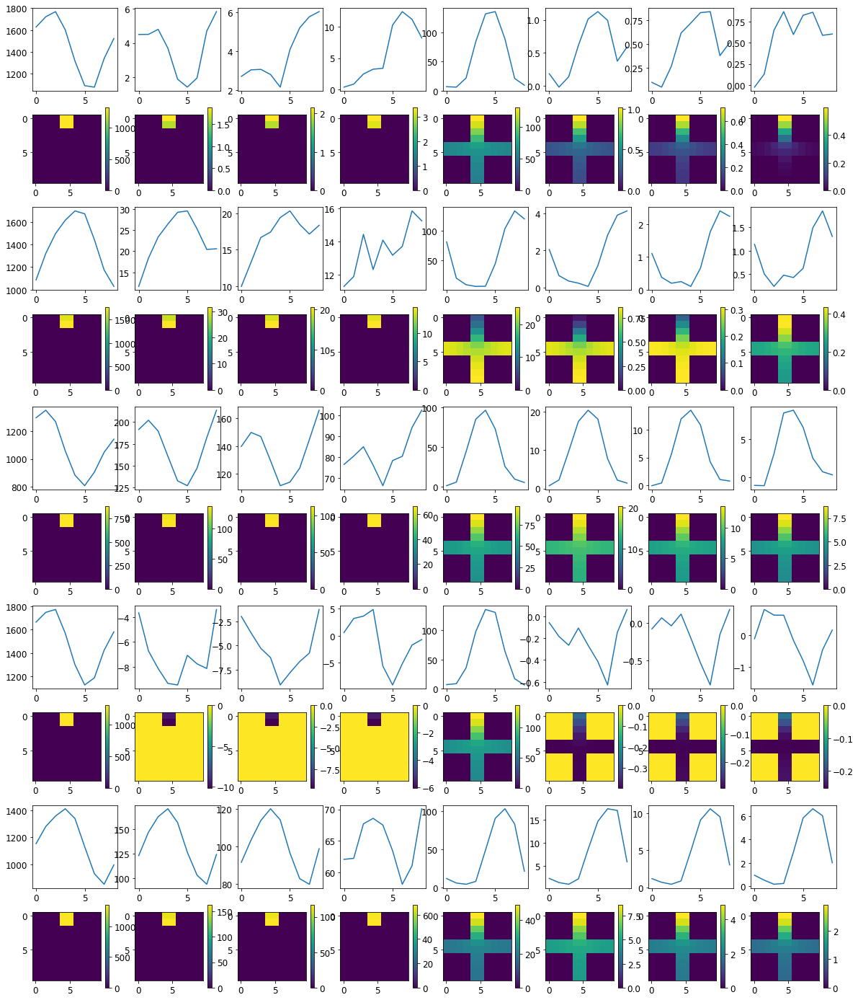

Loss: 


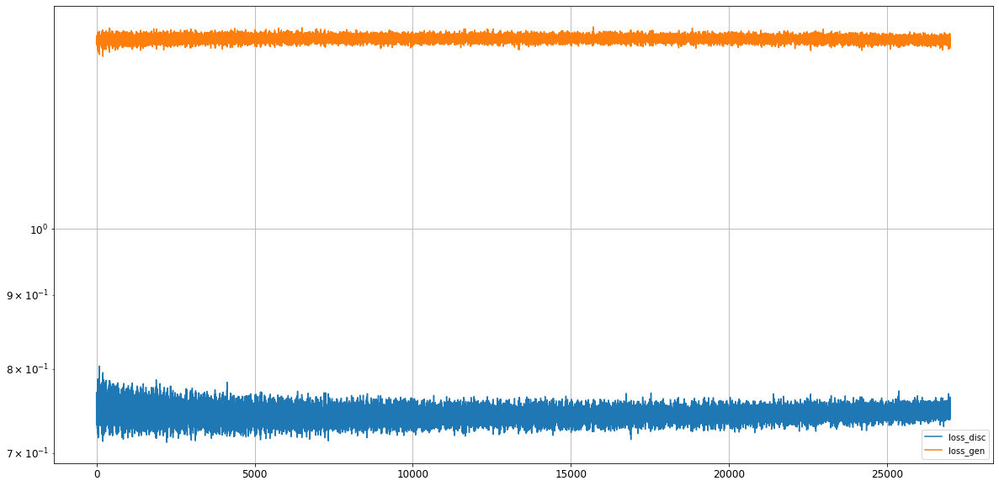

Epoch 27002/50000
discriminator loss: 1.346435 - generator loss: 0.751877 - 1s
Epoch 27003/50000
discriminator loss: 1.346369 - generator loss: 0.742190 - 1s
Epoch 27004/50000
discriminator loss: 1.331858 - generator loss: 0.755541 - 1s
Epoch 27005/50000
discriminator loss: 1.342253 - generator loss: 0.760588 - 1s
Epoch 27006/50000
discriminator loss: 1.350600 - generator loss: 0.741491 - 1s
Epoch 27007/50000
discriminator loss: 1.365191 - generator loss: 0.738433 - 1s
Epoch 27008/50000
discriminator loss: 1.342553 - generator loss: 0.762118 - 1s
Epoch 27009/50000
discriminator loss: 1.330333 - generator loss: 0.766245 - 1s
Epoch 27010/50000
discriminator loss: 1.346426 - generator loss: 0.753750 - 1s
Epoch 27011/50000
discriminator loss: 1.349114 - generator loss: 0.749705 - 1s
Epoch 27012/50000
discriminator loss: 1.358084 - generator loss: 0.744343 - 1s
Epoch 27013/50000
discriminator loss: 1.351612 - generator loss: 0.739962 - 1s
Epoch 27014/50000
discriminator loss: 1.344627 - gen

discriminator loss: 1.342495 - generator loss: 0.753656 - 1s
Epoch 27107/50000
discriminator loss: 1.348308 - generator loss: 0.750638 - 1s
Epoch 27108/50000
discriminator loss: 1.351330 - generator loss: 0.746828 - 1s
Epoch 27109/50000
discriminator loss: 1.341694 - generator loss: 0.756919 - 1s
Epoch 27110/50000
discriminator loss: 1.356430 - generator loss: 0.745966 - 1s
Epoch 27111/50000
discriminator loss: 1.353045 - generator loss: 0.749050 - 1s
Epoch 27112/50000
discriminator loss: 1.343634 - generator loss: 0.752914 - 1s
Epoch 27113/50000
discriminator loss: 1.348987 - generator loss: 0.748695 - 1s
Epoch 27114/50000
discriminator loss: 1.362561 - generator loss: 0.742641 - 1s
Epoch 27115/50000
discriminator loss: 1.349510 - generator loss: 0.750596 - 1s
Epoch 27116/50000
discriminator loss: 1.353066 - generator loss: 0.743148 - 1s
Epoch 27117/50000
discriminator loss: 1.341374 - generator loss: 0.749696 - 1s
Epoch 27118/50000
discriminator loss: 1.359311 - generator loss: 0.746

discriminator loss: 1.357950 - generator loss: 0.744059 - 1s
Epoch 27211/50000
discriminator loss: 1.353665 - generator loss: 0.756608 - 1s
Epoch 27212/50000
discriminator loss: 1.350679 - generator loss: 0.745991 - 1s
Epoch 27213/50000
discriminator loss: 1.359795 - generator loss: 0.743714 - 1s
Epoch 27214/50000
discriminator loss: 1.357069 - generator loss: 0.734940 - 1s
Epoch 27215/50000
discriminator loss: 1.351216 - generator loss: 0.749710 - 1s
Epoch 27216/50000
discriminator loss: 1.354426 - generator loss: 0.744951 - 1s
Epoch 27217/50000
discriminator loss: 1.343539 - generator loss: 0.752572 - 1s
Epoch 27218/50000
discriminator loss: 1.351828 - generator loss: 0.745423 - 1s
Epoch 27219/50000
discriminator loss: 1.362842 - generator loss: 0.740989 - 1s
Epoch 27220/50000
discriminator loss: 1.355781 - generator loss: 0.746131 - 1s
Epoch 27221/50000
discriminator loss: 1.340449 - generator loss: 0.758337 - 1s
Epoch 27222/50000
discriminator loss: 1.342864 - generator loss: 0.757

discriminator loss: 1.347003 - generator loss: 0.749610 - 1s
Epoch 27315/50000
discriminator loss: 1.357496 - generator loss: 0.736551 - 1s
Epoch 27316/50000
discriminator loss: 1.356792 - generator loss: 0.741658 - 1s
Epoch 27317/50000
discriminator loss: 1.348441 - generator loss: 0.749019 - 1s
Epoch 27318/50000
discriminator loss: 1.341313 - generator loss: 0.752159 - 1s
Epoch 27319/50000
discriminator loss: 1.352060 - generator loss: 0.753748 - 1s
Epoch 27320/50000
discriminator loss: 1.354356 - generator loss: 0.739811 - 1s
Epoch 27321/50000
discriminator loss: 1.358675 - generator loss: 0.743990 - 1s
Epoch 27322/50000
discriminator loss: 1.355225 - generator loss: 0.748599 - 1s
Epoch 27323/50000
discriminator loss: 1.346004 - generator loss: 0.752397 - 1s
Epoch 27324/50000
discriminator loss: 1.351171 - generator loss: 0.752045 - 1s
Epoch 27325/50000
discriminator loss: 1.348667 - generator loss: 0.745891 - 1s
Epoch 27326/50000
discriminator loss: 1.362685 - generator loss: 0.736

discriminator loss: 1.347742 - generator loss: 0.745732 - 1s
Epoch 27419/50000
discriminator loss: 1.352429 - generator loss: 0.752469 - 1s
Epoch 27420/50000
discriminator loss: 1.354221 - generator loss: 0.747014 - 1s
Epoch 27421/50000
discriminator loss: 1.354446 - generator loss: 0.744419 - 1s
Epoch 27422/50000
discriminator loss: 1.349620 - generator loss: 0.749563 - 1s
Epoch 27423/50000
discriminator loss: 1.351050 - generator loss: 0.752510 - 1s
Epoch 27424/50000
discriminator loss: 1.343947 - generator loss: 0.747509 - 1s
Epoch 27425/50000
discriminator loss: 1.353950 - generator loss: 0.747596 - 1s
Epoch 27426/50000
discriminator loss: 1.355810 - generator loss: 0.746185 - 1s
Epoch 27427/50000
discriminator loss: 1.347602 - generator loss: 0.748815 - 1s
Epoch 27428/50000
discriminator loss: 1.338758 - generator loss: 0.756717 - 1s
Epoch 27429/50000
discriminator loss: 1.341808 - generator loss: 0.744539 - 1s
Epoch 27430/50000
discriminator loss: 1.344580 - generator loss: 0.747

discriminator loss: 1.348491 - generator loss: 0.755015 - 1s
Epoch 27523/50000
discriminator loss: 1.340323 - generator loss: 0.759777 - 1s
Epoch 27524/50000
discriminator loss: 1.344318 - generator loss: 0.758554 - 1s
Epoch 27525/50000
discriminator loss: 1.358306 - generator loss: 0.749686 - 1s
Epoch 27526/50000
discriminator loss: 1.348805 - generator loss: 0.751867 - 1s
Epoch 27527/50000
discriminator loss: 1.348502 - generator loss: 0.735714 - 1s
Epoch 27528/50000
discriminator loss: 1.344433 - generator loss: 0.756906 - 1s
Epoch 27529/50000
discriminator loss: 1.342687 - generator loss: 0.750226 - 1s
Epoch 27530/50000
discriminator loss: 1.345244 - generator loss: 0.758132 - 1s
Epoch 27531/50000
discriminator loss: 1.362334 - generator loss: 0.735979 - 1s
Epoch 27532/50000
discriminator loss: 1.358597 - generator loss: 0.756336 - 1s
Epoch 27533/50000
discriminator loss: 1.355230 - generator loss: 0.750428 - 1s
Epoch 27534/50000
discriminator loss: 1.350308 - generator loss: 0.751

discriminator loss: 1.354022 - generator loss: 0.748833 - 1s
Epoch 27627/50000
discriminator loss: 1.341393 - generator loss: 0.761348 - 1s
Epoch 27628/50000
discriminator loss: 1.340438 - generator loss: 0.757477 - 1s
Epoch 27629/50000
discriminator loss: 1.350384 - generator loss: 0.743694 - 1s
Epoch 27630/50000
discriminator loss: 1.353595 - generator loss: 0.735486 - 1s
Epoch 27631/50000
discriminator loss: 1.358576 - generator loss: 0.744876 - 1s
Epoch 27632/50000
discriminator loss: 1.338694 - generator loss: 0.752612 - 1s
Epoch 27633/50000
discriminator loss: 1.347689 - generator loss: 0.749510 - 1s
Epoch 27634/50000
discriminator loss: 1.356550 - generator loss: 0.739875 - 1s
Epoch 27635/50000
discriminator loss: 1.361989 - generator loss: 0.744196 - 1s
Epoch 27636/50000
discriminator loss: 1.351390 - generator loss: 0.756740 - 1s
Epoch 27637/50000
discriminator loss: 1.338760 - generator loss: 0.760170 - 1s
Epoch 27638/50000
discriminator loss: 1.354810 - generator loss: 0.747

discriminator loss: 1.349653 - generator loss: 0.745935 - 1s
Epoch 27731/50000
discriminator loss: 1.356770 - generator loss: 0.744085 - 1s
Epoch 27732/50000
discriminator loss: 1.351722 - generator loss: 0.748855 - 1s
Epoch 27733/50000
discriminator loss: 1.353965 - generator loss: 0.747909 - 1s
Epoch 27734/50000
discriminator loss: 1.348892 - generator loss: 0.752745 - 1s
Epoch 27735/50000
discriminator loss: 1.342483 - generator loss: 0.752378 - 1s
Epoch 27736/50000
discriminator loss: 1.352256 - generator loss: 0.749611 - 1s
Epoch 27737/50000
discriminator loss: 1.352367 - generator loss: 0.740237 - 1s
Epoch 27738/50000
discriminator loss: 1.358661 - generator loss: 0.741988 - 1s
Epoch 27739/50000
discriminator loss: 1.345058 - generator loss: 0.754360 - 1s
Epoch 27740/50000
discriminator loss: 1.346201 - generator loss: 0.750346 - 1s
Epoch 27741/50000
discriminator loss: 1.353044 - generator loss: 0.749019 - 1s
Epoch 27742/50000
discriminator loss: 1.354773 - generator loss: 0.743

discriminator loss: 1.352046 - generator loss: 0.738491 - 1s
Epoch 27835/50000
discriminator loss: 1.344541 - generator loss: 0.751856 - 1s
Epoch 27836/50000
discriminator loss: 1.344298 - generator loss: 0.754887 - 1s
Epoch 27837/50000
discriminator loss: 1.344349 - generator loss: 0.752917 - 1s
Epoch 27838/50000
discriminator loss: 1.348491 - generator loss: 0.743086 - 1s
Epoch 27839/50000
discriminator loss: 1.342921 - generator loss: 0.759498 - 1s
Epoch 27840/50000
discriminator loss: 1.349479 - generator loss: 0.749397 - 1s
Epoch 27841/50000
discriminator loss: 1.340422 - generator loss: 0.758964 - 1s
Epoch 27842/50000
discriminator loss: 1.349749 - generator loss: 0.744599 - 1s
Epoch 27843/50000
discriminator loss: 1.350810 - generator loss: 0.752851 - 1s
Epoch 27844/50000
discriminator loss: 1.348441 - generator loss: 0.746118 - 1s
Epoch 27845/50000
discriminator loss: 1.349670 - generator loss: 0.753941 - 1s
Epoch 27846/50000
discriminator loss: 1.346845 - generator loss: 0.745

discriminator loss: 1.349920 - generator loss: 0.744863 - 1s
Epoch 27939/50000
discriminator loss: 1.346143 - generator loss: 0.750138 - 1s
Epoch 27940/50000
discriminator loss: 1.351673 - generator loss: 0.748583 - 1s
Epoch 27941/50000
discriminator loss: 1.348763 - generator loss: 0.746825 - 1s
Epoch 27942/50000
discriminator loss: 1.344050 - generator loss: 0.756652 - 1s
Epoch 27943/50000
discriminator loss: 1.356335 - generator loss: 0.746559 - 1s
Epoch 27944/50000
discriminator loss: 1.356409 - generator loss: 0.746105 - 1s
Epoch 27945/50000
discriminator loss: 1.351992 - generator loss: 0.748193 - 1s
Epoch 27946/50000
discriminator loss: 1.352209 - generator loss: 0.744343 - 1s
Epoch 27947/50000
discriminator loss: 1.354178 - generator loss: 0.743849 - 1s
Epoch 27948/50000
discriminator loss: 1.347759 - generator loss: 0.748124 - 1s
Epoch 27949/50000
discriminator loss: 1.342301 - generator loss: 0.758476 - 1s
Epoch 27950/50000
discriminator loss: 1.354951 - generator loss: 0.743

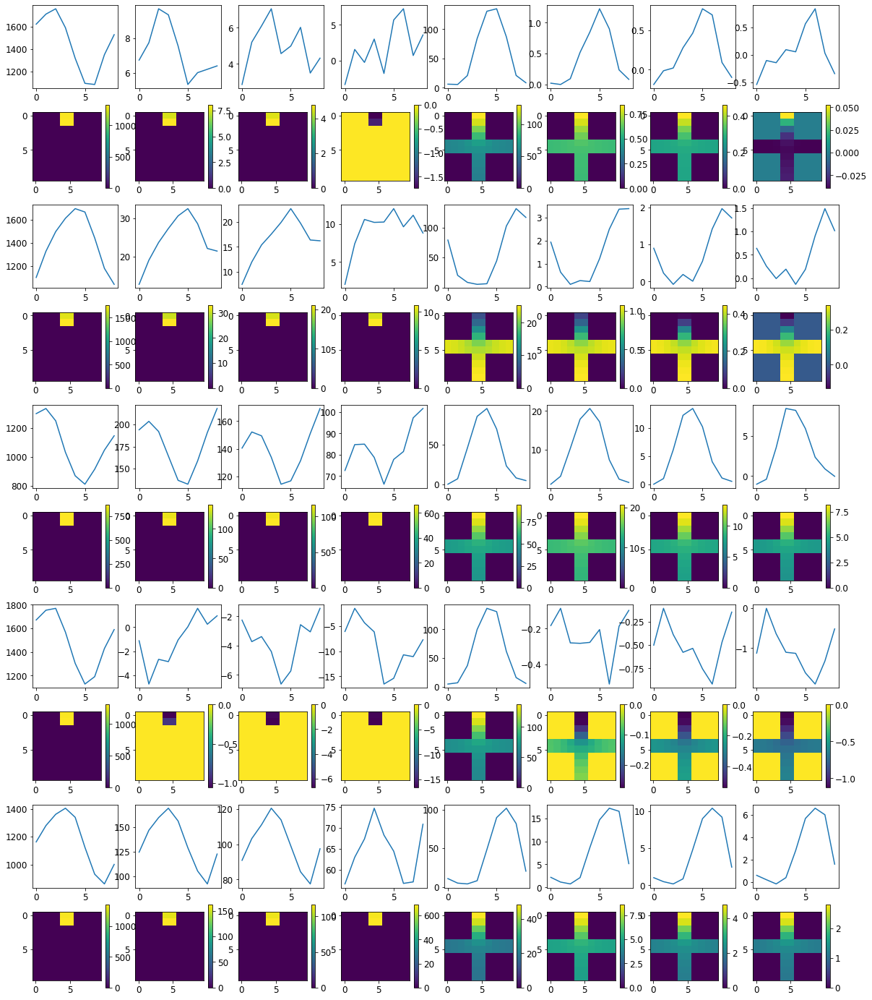

Loss: 


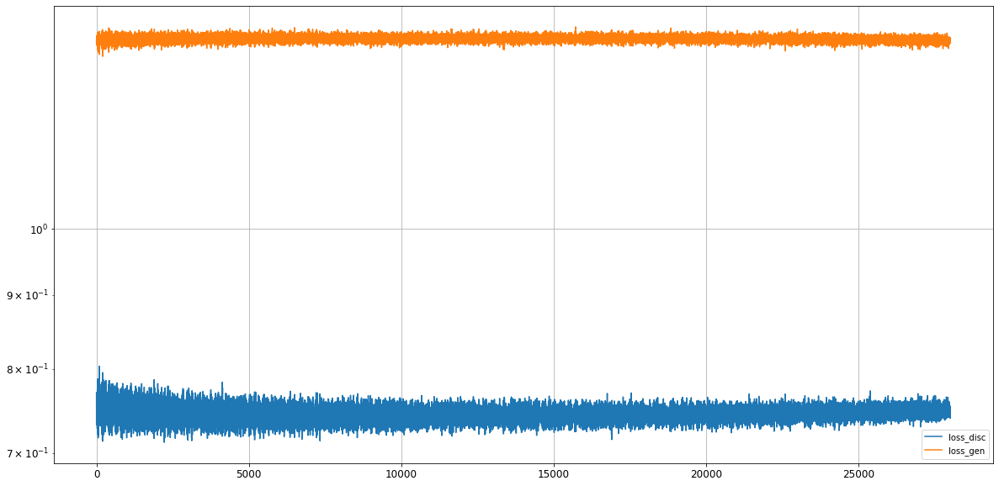

Epoch 28002/50000
discriminator loss: 1.354794 - generator loss: 0.752732 - 1s
Epoch 28003/50000
discriminator loss: 1.354541 - generator loss: 0.749221 - 1s
Epoch 28004/50000
discriminator loss: 1.354183 - generator loss: 0.744927 - 1s
Epoch 28005/50000
discriminator loss: 1.349838 - generator loss: 0.749153 - 1s
Epoch 28006/50000
discriminator loss: 1.355270 - generator loss: 0.743030 - 1s
Epoch 28007/50000
discriminator loss: 1.341482 - generator loss: 0.756625 - 1s
Epoch 28008/50000
discriminator loss: 1.340827 - generator loss: 0.753236 - 1s
Epoch 28009/50000
discriminator loss: 1.344232 - generator loss: 0.748497 - 1s
Epoch 28010/50000
discriminator loss: 1.351562 - generator loss: 0.751169 - 1s
Epoch 28011/50000
discriminator loss: 1.346492 - generator loss: 0.750238 - 1s
Epoch 28012/50000
discriminator loss: 1.354030 - generator loss: 0.748613 - 1s
Epoch 28013/50000
discriminator loss: 1.348107 - generator loss: 0.753451 - 1s
Epoch 28014/50000
discriminator loss: 1.360576 - gen

discriminator loss: 1.351233 - generator loss: 0.754637 - 1s
Epoch 28107/50000
discriminator loss: 1.345697 - generator loss: 0.743328 - 1s
Epoch 28108/50000
discriminator loss: 1.349998 - generator loss: 0.742731 - 1s
Epoch 28109/50000
discriminator loss: 1.345259 - generator loss: 0.749341 - 1s
Epoch 28110/50000
discriminator loss: 1.350009 - generator loss: 0.748366 - 1s
Epoch 28111/50000
discriminator loss: 1.352587 - generator loss: 0.745346 - 1s
Epoch 28112/50000
discriminator loss: 1.356785 - generator loss: 0.743019 - 1s
Epoch 28113/50000
discriminator loss: 1.351729 - generator loss: 0.757709 - 1s
Epoch 28114/50000
discriminator loss: 1.349761 - generator loss: 0.749778 - 1s
Epoch 28115/50000
discriminator loss: 1.346598 - generator loss: 0.752278 - 1s
Epoch 28116/50000
discriminator loss: 1.339314 - generator loss: 0.758182 - 1s
Epoch 28117/50000
discriminator loss: 1.351008 - generator loss: 0.747738 - 1s
Epoch 28118/50000
discriminator loss: 1.356686 - generator loss: 0.739

discriminator loss: 1.342921 - generator loss: 0.756358 - 1s
Epoch 28211/50000
discriminator loss: 1.342865 - generator loss: 0.748623 - 1s
Epoch 28212/50000
discriminator loss: 1.342078 - generator loss: 0.751571 - 1s
Epoch 28213/50000
discriminator loss: 1.352206 - generator loss: 0.746574 - 1s
Epoch 28214/50000
discriminator loss: 1.356047 - generator loss: 0.745103 - 1s
Epoch 28215/50000
discriminator loss: 1.347692 - generator loss: 0.759546 - 1s
Epoch 28216/50000
discriminator loss: 1.345836 - generator loss: 0.755750 - 1s
Epoch 28217/50000
discriminator loss: 1.349014 - generator loss: 0.751376 - 1s
Epoch 28218/50000
discriminator loss: 1.342751 - generator loss: 0.747977 - 1s
Epoch 28219/50000
discriminator loss: 1.353434 - generator loss: 0.744320 - 1s
Epoch 28220/50000
discriminator loss: 1.351426 - generator loss: 0.750855 - 1s
Epoch 28221/50000
discriminator loss: 1.351441 - generator loss: 0.748158 - 1s
Epoch 28222/50000
discriminator loss: 1.344217 - generator loss: 0.750

discriminator loss: 1.353418 - generator loss: 0.749940 - 1s
Epoch 28315/50000
discriminator loss: 1.351078 - generator loss: 0.751570 - 1s
Epoch 28316/50000
discriminator loss: 1.345401 - generator loss: 0.756341 - 1s
Epoch 28317/50000
discriminator loss: 1.351780 - generator loss: 0.745393 - 1s
Epoch 28318/50000
discriminator loss: 1.345819 - generator loss: 0.749147 - 1s
Epoch 28319/50000
discriminator loss: 1.352858 - generator loss: 0.746120 - 1s
Epoch 28320/50000
discriminator loss: 1.346620 - generator loss: 0.751810 - 1s
Epoch 28321/50000
discriminator loss: 1.347673 - generator loss: 0.744979 - 1s
Epoch 28322/50000
discriminator loss: 1.341733 - generator loss: 0.753398 - 1s
Epoch 28323/50000
discriminator loss: 1.348112 - generator loss: 0.753281 - 1s
Epoch 28324/50000
discriminator loss: 1.344940 - generator loss: 0.754436 - 1s
Epoch 28325/50000
discriminator loss: 1.345723 - generator loss: 0.752939 - 1s
Epoch 28326/50000
discriminator loss: 1.345144 - generator loss: 0.751

discriminator loss: 1.352584 - generator loss: 0.746323 - 1s
Epoch 28419/50000
discriminator loss: 1.341477 - generator loss: 0.749835 - 1s
Epoch 28420/50000
discriminator loss: 1.341007 - generator loss: 0.756312 - 1s
Epoch 28421/50000
discriminator loss: 1.347495 - generator loss: 0.748654 - 1s
Epoch 28422/50000
discriminator loss: 1.357814 - generator loss: 0.750992 - 1s
Epoch 28423/50000
discriminator loss: 1.352672 - generator loss: 0.753480 - 1s
Epoch 28424/50000
discriminator loss: 1.339866 - generator loss: 0.758699 - 1s
Epoch 28425/50000
discriminator loss: 1.350783 - generator loss: 0.750779 - 1s
Epoch 28426/50000
discriminator loss: 1.346991 - generator loss: 0.746832 - 1s
Epoch 28427/50000
discriminator loss: 1.360429 - generator loss: 0.742369 - 1s
Epoch 28428/50000
discriminator loss: 1.352586 - generator loss: 0.743553 - 1s
Epoch 28429/50000
discriminator loss: 1.346712 - generator loss: 0.751957 - 1s
Epoch 28430/50000
discriminator loss: 1.345175 - generator loss: 0.756

discriminator loss: 1.353200 - generator loss: 0.743501 - 1s
Epoch 28523/50000
discriminator loss: 1.340752 - generator loss: 0.760130 - 1s
Epoch 28524/50000
discriminator loss: 1.345829 - generator loss: 0.746571 - 1s
Epoch 28525/50000
discriminator loss: 1.346932 - generator loss: 0.753025 - 1s
Epoch 28526/50000
discriminator loss: 1.355167 - generator loss: 0.749681 - 1s
Epoch 28527/50000
discriminator loss: 1.339142 - generator loss: 0.755380 - 1s
Epoch 28528/50000
discriminator loss: 1.345698 - generator loss: 0.752613 - 1s
Epoch 28529/50000
discriminator loss: 1.354439 - generator loss: 0.751504 - 1s
Epoch 28530/50000
discriminator loss: 1.339491 - generator loss: 0.754514 - 1s
Epoch 28531/50000
discriminator loss: 1.348418 - generator loss: 0.749300 - 1s
Epoch 28532/50000
discriminator loss: 1.352101 - generator loss: 0.750461 - 1s
Epoch 28533/50000
discriminator loss: 1.339530 - generator loss: 0.751120 - 1s
Epoch 28534/50000
discriminator loss: 1.342630 - generator loss: 0.753

discriminator loss: 1.349030 - generator loss: 0.750356 - 1s
Epoch 28627/50000
discriminator loss: 1.349940 - generator loss: 0.750367 - 1s
Epoch 28628/50000
discriminator loss: 1.349746 - generator loss: 0.752155 - 1s
Epoch 28629/50000
discriminator loss: 1.351561 - generator loss: 0.755868 - 1s
Epoch 28630/50000
discriminator loss: 1.341297 - generator loss: 0.752993 - 1s
Epoch 28631/50000
discriminator loss: 1.350317 - generator loss: 0.746880 - 1s
Epoch 28632/50000
discriminator loss: 1.343874 - generator loss: 0.749024 - 1s
Epoch 28633/50000
discriminator loss: 1.347430 - generator loss: 0.746562 - 1s
Epoch 28634/50000
discriminator loss: 1.339997 - generator loss: 0.757513 - 1s
Epoch 28635/50000
discriminator loss: 1.354738 - generator loss: 0.749455 - 1s
Epoch 28636/50000
discriminator loss: 1.358948 - generator loss: 0.749082 - 1s
Epoch 28637/50000
discriminator loss: 1.342105 - generator loss: 0.752146 - 1s
Epoch 28638/50000
discriminator loss: 1.338334 - generator loss: 0.764

discriminator loss: 1.340356 - generator loss: 0.756418 - 1s
Epoch 28731/50000
discriminator loss: 1.334466 - generator loss: 0.763549 - 1s
Epoch 28732/50000
discriminator loss: 1.349518 - generator loss: 0.739425 - 1s
Epoch 28733/50000
discriminator loss: 1.354457 - generator loss: 0.744392 - 1s
Epoch 28734/50000
discriminator loss: 1.358063 - generator loss: 0.748415 - 1s
Epoch 28735/50000
discriminator loss: 1.348325 - generator loss: 0.750844 - 1s
Epoch 28736/50000
discriminator loss: 1.352801 - generator loss: 0.751073 - 1s
Epoch 28737/50000
discriminator loss: 1.348859 - generator loss: 0.752100 - 1s
Epoch 28738/50000
discriminator loss: 1.351338 - generator loss: 0.740844 - 1s
Epoch 28739/50000
discriminator loss: 1.351453 - generator loss: 0.758772 - 1s
Epoch 28740/50000
discriminator loss: 1.340839 - generator loss: 0.751942 - 1s
Epoch 28741/50000
discriminator loss: 1.347551 - generator loss: 0.752224 - 1s
Epoch 28742/50000
discriminator loss: 1.354487 - generator loss: 0.748

discriminator loss: 1.352469 - generator loss: 0.749742 - 1s
Epoch 28835/50000
discriminator loss: 1.352701 - generator loss: 0.743671 - 1s
Epoch 28836/50000
discriminator loss: 1.349854 - generator loss: 0.746572 - 1s
Epoch 28837/50000
discriminator loss: 1.352459 - generator loss: 0.750164 - 1s
Epoch 28838/50000
discriminator loss: 1.352100 - generator loss: 0.750787 - 1s
Epoch 28839/50000
discriminator loss: 1.343463 - generator loss: 0.747861 - 1s
Epoch 28840/50000
discriminator loss: 1.342444 - generator loss: 0.759003 - 1s
Epoch 28841/50000
discriminator loss: 1.346090 - generator loss: 0.748714 - 1s
Epoch 28842/50000
discriminator loss: 1.343947 - generator loss: 0.755826 - 1s
Epoch 28843/50000
discriminator loss: 1.351701 - generator loss: 0.749758 - 1s
Epoch 28844/50000
discriminator loss: 1.352034 - generator loss: 0.750010 - 1s
Epoch 28845/50000
discriminator loss: 1.345627 - generator loss: 0.746712 - 1s
Epoch 28846/50000
discriminator loss: 1.350457 - generator loss: 0.753

discriminator loss: 1.347253 - generator loss: 0.755525 - 1s
Epoch 28939/50000
discriminator loss: 1.345900 - generator loss: 0.752467 - 1s
Epoch 28940/50000
discriminator loss: 1.356132 - generator loss: 0.748562 - 1s
Epoch 28941/50000
discriminator loss: 1.347422 - generator loss: 0.746846 - 1s
Epoch 28942/50000
discriminator loss: 1.350551 - generator loss: 0.746336 - 1s
Epoch 28943/50000
discriminator loss: 1.345268 - generator loss: 0.750892 - 1s
Epoch 28944/50000
discriminator loss: 1.340968 - generator loss: 0.757397 - 1s
Epoch 28945/50000
discriminator loss: 1.358598 - generator loss: 0.745284 - 1s
Epoch 28946/50000
discriminator loss: 1.347885 - generator loss: 0.752333 - 1s
Epoch 28947/50000
discriminator loss: 1.341532 - generator loss: 0.758054 - 1s
Epoch 28948/50000
discriminator loss: 1.357791 - generator loss: 0.742413 - 1s
Epoch 28949/50000
discriminator loss: 1.347483 - generator loss: 0.753588 - 1s
Epoch 28950/50000
discriminator loss: 1.346800 - generator loss: 0.743

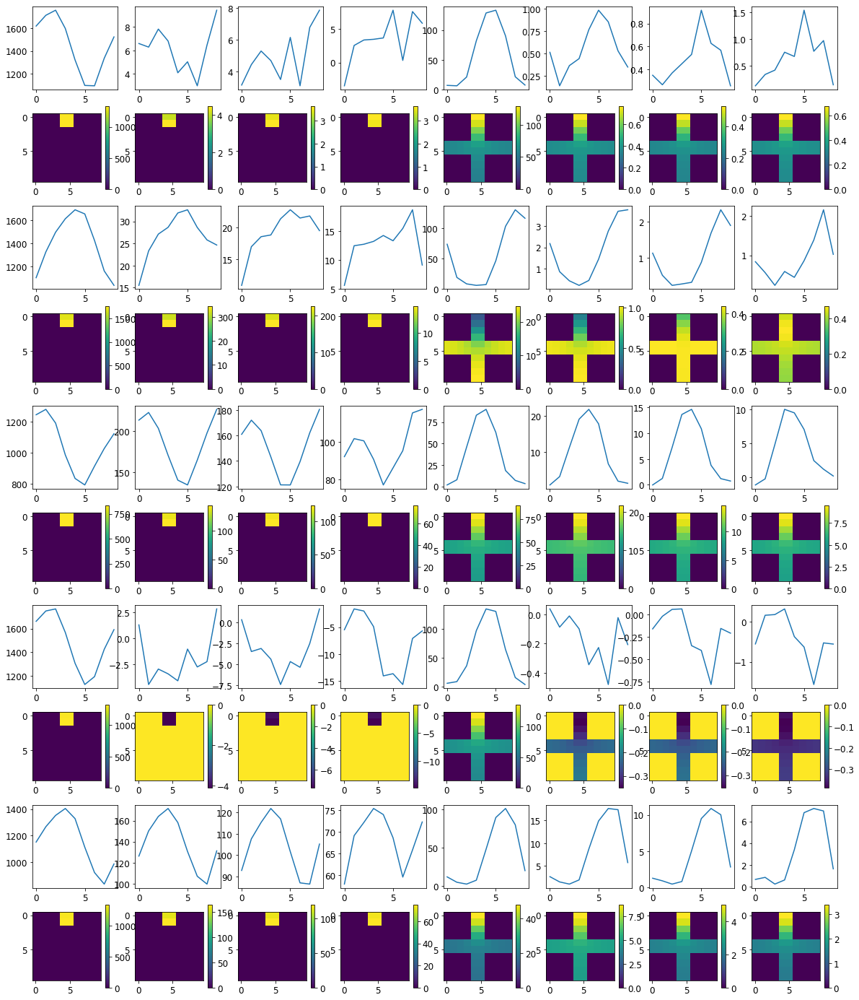

Loss: 


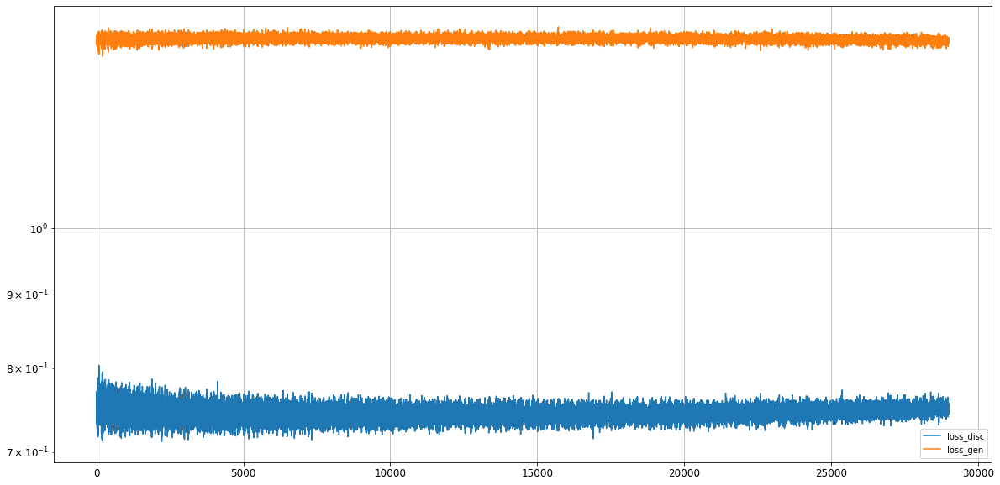

Epoch 29002/50000
discriminator loss: 1.351868 - generator loss: 0.753105 - 1s
Epoch 29003/50000
discriminator loss: 1.352123 - generator loss: 0.753232 - 1s
Epoch 29004/50000
discriminator loss: 1.341358 - generator loss: 0.764257 - 1s
Epoch 29005/50000
discriminator loss: 1.341637 - generator loss: 0.752549 - 1s
Epoch 29006/50000
discriminator loss: 1.341794 - generator loss: 0.752717 - 1s
Epoch 29007/50000
discriminator loss: 1.355231 - generator loss: 0.742469 - 1s
Epoch 29008/50000
discriminator loss: 1.346272 - generator loss: 0.753921 - 1s
Epoch 29009/50000
discriminator loss: 1.348937 - generator loss: 0.741387 - 1s
Epoch 29010/50000
discriminator loss: 1.344117 - generator loss: 0.762856 - 1s
Epoch 29011/50000
discriminator loss: 1.352187 - generator loss: 0.746949 - 1s
Epoch 29012/50000
discriminator loss: 1.354449 - generator loss: 0.754703 - 1s
Epoch 29013/50000
discriminator loss: 1.348935 - generator loss: 0.747387 - 1s
Epoch 29014/50000
discriminator loss: 1.346418 - gen

discriminator loss: 1.359072 - generator loss: 0.739422 - 1s
Epoch 29107/50000
discriminator loss: 1.346345 - generator loss: 0.749717 - 1s
Epoch 29108/50000
discriminator loss: 1.343318 - generator loss: 0.752310 - 1s
Epoch 29109/50000
discriminator loss: 1.338030 - generator loss: 0.754948 - 1s
Epoch 29110/50000
discriminator loss: 1.353370 - generator loss: 0.748866 - 1s
Epoch 29111/50000
discriminator loss: 1.358746 - generator loss: 0.742173 - 1s
Epoch 29112/50000
discriminator loss: 1.344536 - generator loss: 0.757137 - 1s
Epoch 29113/50000
discriminator loss: 1.351988 - generator loss: 0.753355 - 1s
Epoch 29114/50000
discriminator loss: 1.348293 - generator loss: 0.750901 - 1s
Epoch 29115/50000
discriminator loss: 1.349346 - generator loss: 0.752342 - 1s
Epoch 29116/50000
discriminator loss: 1.345515 - generator loss: 0.747860 - 1s
Epoch 29117/50000
discriminator loss: 1.345061 - generator loss: 0.749904 - 1s
Epoch 29118/50000
discriminator loss: 1.341829 - generator loss: 0.753

discriminator loss: 1.350523 - generator loss: 0.754437 - 1s
Epoch 29211/50000
discriminator loss: 1.340883 - generator loss: 0.753248 - 1s
Epoch 29212/50000
discriminator loss: 1.351472 - generator loss: 0.746587 - 1s
Epoch 29213/50000
discriminator loss: 1.345728 - generator loss: 0.755253 - 1s
Epoch 29214/50000
discriminator loss: 1.347750 - generator loss: 0.755003 - 1s
Epoch 29215/50000
discriminator loss: 1.350696 - generator loss: 0.750083 - 1s
Epoch 29216/50000
discriminator loss: 1.345223 - generator loss: 0.752390 - 1s
Epoch 29217/50000
discriminator loss: 1.342938 - generator loss: 0.749247 - 1s
Epoch 29218/50000
discriminator loss: 1.351668 - generator loss: 0.756003 - 1s
Epoch 29219/50000
discriminator loss: 1.336401 - generator loss: 0.752349 - 1s
Epoch 29220/50000
discriminator loss: 1.346213 - generator loss: 0.752717 - 1s
Epoch 29221/50000
discriminator loss: 1.342679 - generator loss: 0.749828 - 1s
Epoch 29222/50000
discriminator loss: 1.346926 - generator loss: 0.750

discriminator loss: 1.349640 - generator loss: 0.753260 - 1s
Epoch 29315/50000
discriminator loss: 1.354481 - generator loss: 0.746045 - 1s
Epoch 29316/50000
discriminator loss: 1.347651 - generator loss: 0.752721 - 1s
Epoch 29317/50000
discriminator loss: 1.353504 - generator loss: 0.745357 - 1s
Epoch 29318/50000
discriminator loss: 1.343545 - generator loss: 0.758586 - 1s
Epoch 29319/50000
discriminator loss: 1.351573 - generator loss: 0.743580 - 1s
Epoch 29320/50000
discriminator loss: 1.348864 - generator loss: 0.753906 - 1s
Epoch 29321/50000
discriminator loss: 1.354294 - generator loss: 0.742415 - 1s
Epoch 29322/50000
discriminator loss: 1.345071 - generator loss: 0.753105 - 1s
Epoch 29323/50000
discriminator loss: 1.344889 - generator loss: 0.751917 - 1s
Epoch 29324/50000
discriminator loss: 1.342865 - generator loss: 0.750436 - 1s
Epoch 29325/50000
discriminator loss: 1.352176 - generator loss: 0.749805 - 1s
Epoch 29326/50000
discriminator loss: 1.354513 - generator loss: 0.747

discriminator loss: 1.347883 - generator loss: 0.756987 - 1s
Epoch 29419/50000
discriminator loss: 1.349567 - generator loss: 0.751805 - 1s
Epoch 29420/50000
discriminator loss: 1.346583 - generator loss: 0.752332 - 1s
Epoch 29421/50000
discriminator loss: 1.349472 - generator loss: 0.748048 - 1s
Epoch 29422/50000
discriminator loss: 1.351902 - generator loss: 0.755787 - 1s
Epoch 29423/50000
discriminator loss: 1.338650 - generator loss: 0.752213 - 1s
Epoch 29424/50000
discriminator loss: 1.341180 - generator loss: 0.754340 - 1s
Epoch 29425/50000
discriminator loss: 1.341897 - generator loss: 0.749034 - 1s
Epoch 29426/50000
discriminator loss: 1.351807 - generator loss: 0.749518 - 1s
Epoch 29427/50000
discriminator loss: 1.360140 - generator loss: 0.754320 - 1s
Epoch 29428/50000
discriminator loss: 1.356301 - generator loss: 0.743547 - 1s
Epoch 29429/50000
discriminator loss: 1.338735 - generator loss: 0.763388 - 1s
Epoch 29430/50000
discriminator loss: 1.343993 - generator loss: 0.754

discriminator loss: 1.345987 - generator loss: 0.752133 - 1s
Epoch 29523/50000
discriminator loss: 1.345809 - generator loss: 0.752424 - 1s
Epoch 29524/50000
discriminator loss: 1.345374 - generator loss: 0.754387 - 1s
Epoch 29525/50000
discriminator loss: 1.340483 - generator loss: 0.755628 - 1s
Epoch 29526/50000
discriminator loss: 1.345729 - generator loss: 0.747346 - 1s
Epoch 29527/50000
discriminator loss: 1.343656 - generator loss: 0.756241 - 1s
Epoch 29528/50000
discriminator loss: 1.349165 - generator loss: 0.755813 - 1s
Epoch 29529/50000
discriminator loss: 1.339135 - generator loss: 0.766751 - 1s
Epoch 29530/50000
discriminator loss: 1.347262 - generator loss: 0.751785 - 1s
Epoch 29531/50000
discriminator loss: 1.357693 - generator loss: 0.744502 - 1s
Epoch 29532/50000
discriminator loss: 1.348806 - generator loss: 0.747470 - 1s
Epoch 29533/50000
discriminator loss: 1.344083 - generator loss: 0.758097 - 1s
Epoch 29534/50000
discriminator loss: 1.342326 - generator loss: 0.756

discriminator loss: 1.346058 - generator loss: 0.754083 - 1s
Epoch 29627/50000
discriminator loss: 1.339210 - generator loss: 0.750679 - 1s
Epoch 29628/50000
discriminator loss: 1.351053 - generator loss: 0.758232 - 1s
Epoch 29629/50000
discriminator loss: 1.346745 - generator loss: 0.758571 - 1s
Epoch 29630/50000
discriminator loss: 1.348613 - generator loss: 0.752023 - 1s
Epoch 29631/50000
discriminator loss: 1.354128 - generator loss: 0.745796 - 1s
Epoch 29632/50000
discriminator loss: 1.356550 - generator loss: 0.748541 - 1s
Epoch 29633/50000
discriminator loss: 1.350505 - generator loss: 0.741499 - 1s
Epoch 29634/50000
discriminator loss: 1.353404 - generator loss: 0.757191 - 1s
Epoch 29635/50000
discriminator loss: 1.350101 - generator loss: 0.749933 - 1s
Epoch 29636/50000
discriminator loss: 1.348587 - generator loss: 0.751383 - 1s
Epoch 29637/50000
discriminator loss: 1.343965 - generator loss: 0.753033 - 1s
Epoch 29638/50000
discriminator loss: 1.345692 - generator loss: 0.754

discriminator loss: 1.349537 - generator loss: 0.751835 - 1s
Epoch 29731/50000
discriminator loss: 1.347356 - generator loss: 0.748230 - 1s
Epoch 29732/50000
discriminator loss: 1.356939 - generator loss: 0.745023 - 1s
Epoch 29733/50000
discriminator loss: 1.350112 - generator loss: 0.752479 - 1s
Epoch 29734/50000
discriminator loss: 1.334309 - generator loss: 0.772290 - 1s
Epoch 29735/50000
discriminator loss: 1.342774 - generator loss: 0.751121 - 1s
Epoch 29736/50000
discriminator loss: 1.352674 - generator loss: 0.748743 - 1s
Epoch 29737/50000
discriminator loss: 1.350096 - generator loss: 0.757538 - 1s
Epoch 29738/50000
discriminator loss: 1.351579 - generator loss: 0.747550 - 1s
Epoch 29739/50000
discriminator loss: 1.346707 - generator loss: 0.745239 - 1s
Epoch 29740/50000
discriminator loss: 1.346177 - generator loss: 0.756119 - 1s
Epoch 29741/50000
discriminator loss: 1.355886 - generator loss: 0.744493 - 1s
Epoch 29742/50000
discriminator loss: 1.346729 - generator loss: 0.758

discriminator loss: 1.333436 - generator loss: 0.758773 - 1s
Epoch 29835/50000
discriminator loss: 1.344264 - generator loss: 0.755900 - 1s
Epoch 29836/50000
discriminator loss: 1.343836 - generator loss: 0.766575 - 1s
Epoch 29837/50000
discriminator loss: 1.338662 - generator loss: 0.756848 - 1s
Epoch 29838/50000
discriminator loss: 1.339884 - generator loss: 0.754512 - 1s
Epoch 29839/50000
discriminator loss: 1.355842 - generator loss: 0.742238 - 1s
Epoch 29840/50000
discriminator loss: 1.347340 - generator loss: 0.752050 - 1s
Epoch 29841/50000
discriminator loss: 1.345890 - generator loss: 0.752706 - 1s
Epoch 29842/50000
discriminator loss: 1.345298 - generator loss: 0.748549 - 1s
Epoch 29843/50000
discriminator loss: 1.350055 - generator loss: 0.749087 - 1s
Epoch 29844/50000
discriminator loss: 1.340464 - generator loss: 0.763365 - 1s
Epoch 29845/50000
discriminator loss: 1.332083 - generator loss: 0.764972 - 1s
Epoch 29846/50000
discriminator loss: 1.351879 - generator loss: 0.753

discriminator loss: 1.350167 - generator loss: 0.759670 - 1s
Epoch 29939/50000
discriminator loss: 1.355746 - generator loss: 0.750851 - 1s
Epoch 29940/50000
discriminator loss: 1.347377 - generator loss: 0.751297 - 1s
Epoch 29941/50000
discriminator loss: 1.340103 - generator loss: 0.761498 - 1s
Epoch 29942/50000
discriminator loss: 1.352805 - generator loss: 0.746740 - 1s
Epoch 29943/50000
discriminator loss: 1.339875 - generator loss: 0.745578 - 1s
Epoch 29944/50000
discriminator loss: 1.338278 - generator loss: 0.753707 - 1s
Epoch 29945/50000
discriminator loss: 1.343025 - generator loss: 0.753889 - 1s
Epoch 29946/50000
discriminator loss: 1.340793 - generator loss: 0.761814 - 1s
Epoch 29947/50000
discriminator loss: 1.355751 - generator loss: 0.742151 - 1s
Epoch 29948/50000
discriminator loss: 1.352955 - generator loss: 0.748545 - 1s
Epoch 29949/50000
discriminator loss: 1.345016 - generator loss: 0.756085 - 1s
Epoch 29950/50000
discriminator loss: 1.336430 - generator loss: 0.754

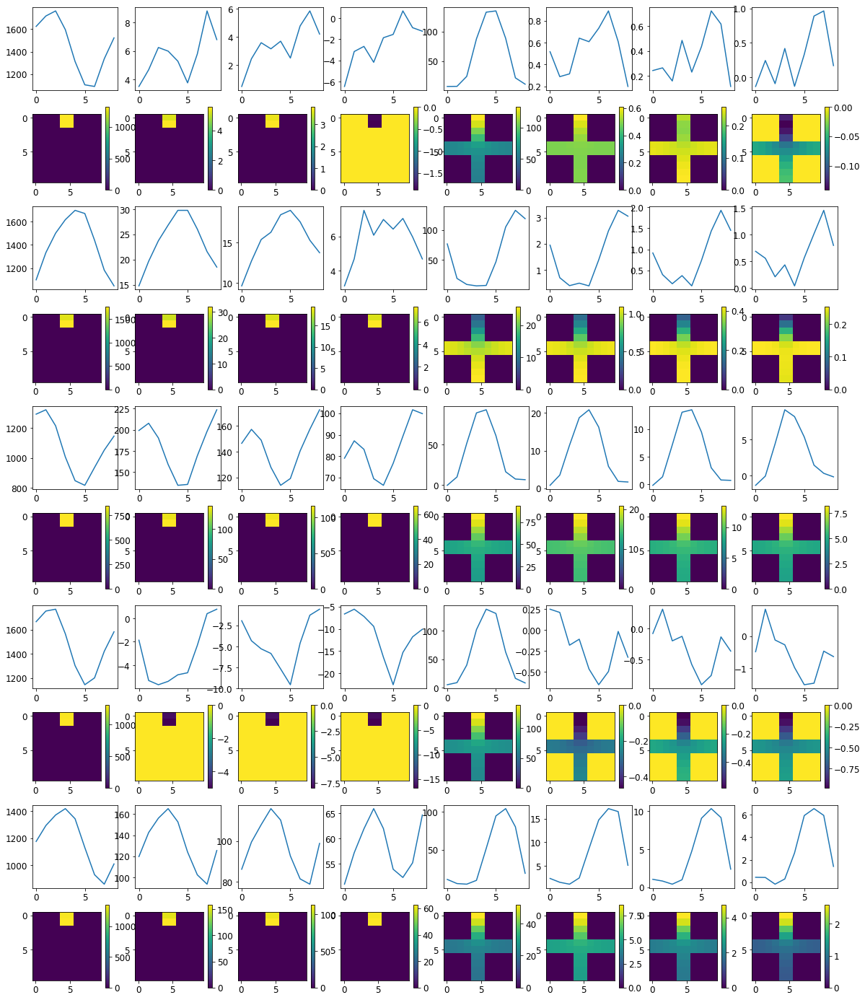

Loss: 


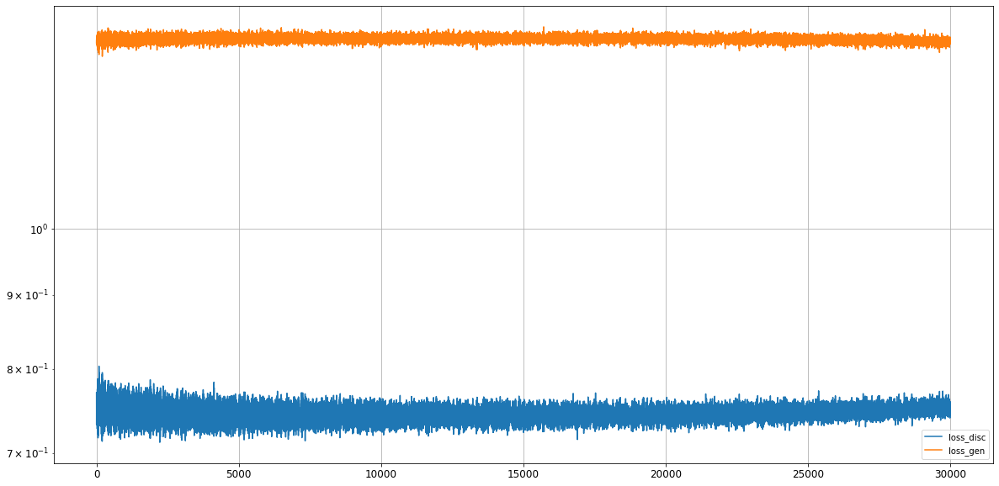

Epoch 30002/50000
discriminator loss: 1.341718 - generator loss: 0.756397 - 1s
Epoch 30003/50000
discriminator loss: 1.347157 - generator loss: 0.754586 - 1s
Epoch 30004/50000
discriminator loss: 1.357742 - generator loss: 0.741369 - 1s
Epoch 30005/50000
discriminator loss: 1.350826 - generator loss: 0.749212 - 1s
Epoch 30006/50000
discriminator loss: 1.351979 - generator loss: 0.743552 - 1s
Epoch 30007/50000
discriminator loss: 1.337929 - generator loss: 0.755391 - 1s
Epoch 30008/50000
discriminator loss: 1.340051 - generator loss: 0.753348 - 1s
Epoch 30009/50000
discriminator loss: 1.350089 - generator loss: 0.750518 - 1s
Epoch 30010/50000
discriminator loss: 1.354676 - generator loss: 0.752250 - 1s
Epoch 30011/50000
discriminator loss: 1.349812 - generator loss: 0.759494 - 1s
Epoch 30012/50000
discriminator loss: 1.348603 - generator loss: 0.744045 - 1s
Epoch 30013/50000
discriminator loss: 1.343887 - generator loss: 0.754688 - 1s
Epoch 30014/50000
discriminator loss: 1.356163 - gen

discriminator loss: 1.353951 - generator loss: 0.757351 - 1s
Epoch 30107/50000
discriminator loss: 1.347613 - generator loss: 0.745168 - 1s
Epoch 30108/50000
discriminator loss: 1.348450 - generator loss: 0.751914 - 1s
Epoch 30109/50000
discriminator loss: 1.344995 - generator loss: 0.747404 - 1s
Epoch 30110/50000
discriminator loss: 1.342863 - generator loss: 0.750304 - 1s
Epoch 30111/50000
discriminator loss: 1.351099 - generator loss: 0.746604 - 1s
Epoch 30112/50000
discriminator loss: 1.345735 - generator loss: 0.751185 - 1s
Epoch 30113/50000
discriminator loss: 1.352219 - generator loss: 0.755045 - 1s
Epoch 30114/50000
discriminator loss: 1.344971 - generator loss: 0.761414 - 1s
Epoch 30115/50000
discriminator loss: 1.340025 - generator loss: 0.751964 - 1s
Epoch 30116/50000
discriminator loss: 1.341478 - generator loss: 0.753322 - 1s
Epoch 30117/50000
discriminator loss: 1.351832 - generator loss: 0.745522 - 1s
Epoch 30118/50000
discriminator loss: 1.352236 - generator loss: 0.743

discriminator loss: 1.348268 - generator loss: 0.743783 - 1s
Epoch 30211/50000
discriminator loss: 1.355480 - generator loss: 0.750383 - 1s
Epoch 30212/50000
discriminator loss: 1.343817 - generator loss: 0.758781 - 1s
Epoch 30213/50000
discriminator loss: 1.351907 - generator loss: 0.745133 - 1s
Epoch 30214/50000
discriminator loss: 1.352369 - generator loss: 0.752747 - 1s
Epoch 30215/50000
discriminator loss: 1.347500 - generator loss: 0.756511 - 1s
Epoch 30216/50000
discriminator loss: 1.343681 - generator loss: 0.757430 - 1s
Epoch 30217/50000
discriminator loss: 1.343634 - generator loss: 0.748481 - 1s
Epoch 30218/50000
discriminator loss: 1.357986 - generator loss: 0.745685 - 1s
Epoch 30219/50000
discriminator loss: 1.346120 - generator loss: 0.748696 - 1s
Epoch 30220/50000
discriminator loss: 1.352911 - generator loss: 0.749882 - 1s
Epoch 30221/50000
discriminator loss: 1.346855 - generator loss: 0.755529 - 1s
Epoch 30222/50000
discriminator loss: 1.340800 - generator loss: 0.751

discriminator loss: 1.342356 - generator loss: 0.760206 - 1s
Epoch 30315/50000
discriminator loss: 1.344321 - generator loss: 0.755032 - 1s
Epoch 30316/50000
discriminator loss: 1.348400 - generator loss: 0.751675 - 1s
Epoch 30317/50000
discriminator loss: 1.348365 - generator loss: 0.749389 - 1s
Epoch 30318/50000
discriminator loss: 1.350385 - generator loss: 0.750107 - 1s
Epoch 30319/50000
discriminator loss: 1.352898 - generator loss: 0.743738 - 1s
Epoch 30320/50000
discriminator loss: 1.346927 - generator loss: 0.758787 - 1s
Epoch 30321/50000
discriminator loss: 1.341104 - generator loss: 0.756615 - 1s
Epoch 30322/50000
discriminator loss: 1.339472 - generator loss: 0.763091 - 1s
Epoch 30323/50000
discriminator loss: 1.351831 - generator loss: 0.747954 - 1s
Epoch 30324/50000
discriminator loss: 1.341317 - generator loss: 0.758969 - 1s
Epoch 30325/50000
discriminator loss: 1.337224 - generator loss: 0.760297 - 1s
Epoch 30326/50000
discriminator loss: 1.352604 - generator loss: 0.746

discriminator loss: 1.353541 - generator loss: 0.751421 - 1s
Epoch 30419/50000
discriminator loss: 1.347006 - generator loss: 0.756772 - 1s
Epoch 30420/50000
discriminator loss: 1.354044 - generator loss: 0.744144 - 1s
Epoch 30421/50000
discriminator loss: 1.344381 - generator loss: 0.757972 - 1s
Epoch 30422/50000
discriminator loss: 1.350454 - generator loss: 0.750185 - 1s
Epoch 30423/50000
discriminator loss: 1.350310 - generator loss: 0.752013 - 1s
Epoch 30424/50000
discriminator loss: 1.351072 - generator loss: 0.756175 - 1s
Epoch 30425/50000
discriminator loss: 1.353899 - generator loss: 0.750299 - 1s
Epoch 30426/50000
discriminator loss: 1.345165 - generator loss: 0.753497 - 1s
Epoch 30427/50000
discriminator loss: 1.355211 - generator loss: 0.748050 - 1s
Epoch 30428/50000
discriminator loss: 1.344803 - generator loss: 0.750105 - 1s
Epoch 30429/50000
discriminator loss: 1.338428 - generator loss: 0.760240 - 1s
Epoch 30430/50000
discriminator loss: 1.340808 - generator loss: 0.755

discriminator loss: 1.349252 - generator loss: 0.754925 - 1s
Epoch 30523/50000
discriminator loss: 1.349091 - generator loss: 0.745536 - 1s
Epoch 30524/50000
discriminator loss: 1.345097 - generator loss: 0.751519 - 1s
Epoch 30525/50000
discriminator loss: 1.346472 - generator loss: 0.758860 - 1s
Epoch 30526/50000
discriminator loss: 1.345051 - generator loss: 0.755582 - 1s
Epoch 30527/50000
discriminator loss: 1.344880 - generator loss: 0.751135 - 1s
Epoch 30528/50000
discriminator loss: 1.355742 - generator loss: 0.753964 - 1s
Epoch 30529/50000
discriminator loss: 1.355117 - generator loss: 0.744559 - 1s
Epoch 30530/50000
discriminator loss: 1.346740 - generator loss: 0.752857 - 1s
Epoch 30531/50000
discriminator loss: 1.349583 - generator loss: 0.748014 - 1s
Epoch 30532/50000
discriminator loss: 1.352047 - generator loss: 0.748870 - 1s
Epoch 30533/50000
discriminator loss: 1.337526 - generator loss: 0.761634 - 1s
Epoch 30534/50000
discriminator loss: 1.344557 - generator loss: 0.756

discriminator loss: 1.349292 - generator loss: 0.745423 - 1s
Epoch 30627/50000
discriminator loss: 1.339128 - generator loss: 0.764814 - 1s
Epoch 30628/50000
discriminator loss: 1.352948 - generator loss: 0.754308 - 1s
Epoch 30629/50000
discriminator loss: 1.346612 - generator loss: 0.750909 - 1s
Epoch 30630/50000
discriminator loss: 1.344032 - generator loss: 0.752266 - 1s
Epoch 30631/50000
discriminator loss: 1.343299 - generator loss: 0.753729 - 1s
Epoch 30632/50000
discriminator loss: 1.347201 - generator loss: 0.746197 - 1s
Epoch 30633/50000
discriminator loss: 1.354598 - generator loss: 0.747486 - 1s
Epoch 30634/50000
discriminator loss: 1.354489 - generator loss: 0.747802 - 1s
Epoch 30635/50000
discriminator loss: 1.336476 - generator loss: 0.765006 - 1s
Epoch 30636/50000
discriminator loss: 1.343440 - generator loss: 0.762404 - 1s
Epoch 30637/50000
discriminator loss: 1.349186 - generator loss: 0.749475 - 1s
Epoch 30638/50000
discriminator loss: 1.351292 - generator loss: 0.747

discriminator loss: 1.361641 - generator loss: 0.740171 - 1s
Epoch 30731/50000
discriminator loss: 1.342074 - generator loss: 0.755102 - 1s
Epoch 30732/50000
discriminator loss: 1.337073 - generator loss: 0.760658 - 1s
Epoch 30733/50000
discriminator loss: 1.340194 - generator loss: 0.758697 - 1s
Epoch 30734/50000
discriminator loss: 1.344295 - generator loss: 0.748193 - 1s
Epoch 30735/50000
discriminator loss: 1.345502 - generator loss: 0.751865 - 1s
Epoch 30736/50000
discriminator loss: 1.355245 - generator loss: 0.749836 - 1s
Epoch 30737/50000
discriminator loss: 1.342448 - generator loss: 0.763357 - 1s
Epoch 30738/50000
discriminator loss: 1.340790 - generator loss: 0.757121 - 1s
Epoch 30739/50000
discriminator loss: 1.337109 - generator loss: 0.754302 - 1s
Epoch 30740/50000
discriminator loss: 1.354869 - generator loss: 0.747670 - 1s
Epoch 30741/50000
discriminator loss: 1.338065 - generator loss: 0.760815 - 1s
Epoch 30742/50000
discriminator loss: 1.337570 - generator loss: 0.750

discriminator loss: 1.348636 - generator loss: 0.747853 - 1s
Epoch 30835/50000
discriminator loss: 1.344736 - generator loss: 0.752883 - 1s
Epoch 30836/50000
discriminator loss: 1.343821 - generator loss: 0.754714 - 1s
Epoch 30837/50000
discriminator loss: 1.345614 - generator loss: 0.755240 - 1s
Epoch 30838/50000
discriminator loss: 1.342476 - generator loss: 0.759005 - 1s
Epoch 30839/50000
discriminator loss: 1.343627 - generator loss: 0.760146 - 1s
Epoch 30840/50000
discriminator loss: 1.347262 - generator loss: 0.752960 - 1s
Epoch 30841/50000
discriminator loss: 1.348315 - generator loss: 0.746164 - 1s
Epoch 30842/50000
discriminator loss: 1.344728 - generator loss: 0.749940 - 1s
Epoch 30843/50000
discriminator loss: 1.342648 - generator loss: 0.759844 - 1s
Epoch 30844/50000
discriminator loss: 1.352957 - generator loss: 0.751172 - 1s
Epoch 30845/50000
discriminator loss: 1.347315 - generator loss: 0.746620 - 1s
Epoch 30846/50000
discriminator loss: 1.349043 - generator loss: 0.753

discriminator loss: 1.344442 - generator loss: 0.752282 - 1s
Epoch 30939/50000
discriminator loss: 1.341911 - generator loss: 0.756239 - 1s
Epoch 30940/50000
discriminator loss: 1.344216 - generator loss: 0.753432 - 1s
Epoch 30941/50000
discriminator loss: 1.333050 - generator loss: 0.754819 - 1s
Epoch 30942/50000
discriminator loss: 1.345142 - generator loss: 0.757340 - 1s
Epoch 30943/50000
discriminator loss: 1.351384 - generator loss: 0.754192 - 1s
Epoch 30944/50000
discriminator loss: 1.340268 - generator loss: 0.758773 - 1s
Epoch 30945/50000
discriminator loss: 1.340101 - generator loss: 0.755657 - 1s
Epoch 30946/50000
discriminator loss: 1.351622 - generator loss: 0.746148 - 1s
Epoch 30947/50000
discriminator loss: 1.340030 - generator loss: 0.755353 - 1s
Epoch 30948/50000
discriminator loss: 1.360786 - generator loss: 0.748452 - 1s
Epoch 30949/50000
discriminator loss: 1.345739 - generator loss: 0.761101 - 1s
Epoch 30950/50000
discriminator loss: 1.344527 - generator loss: 0.757

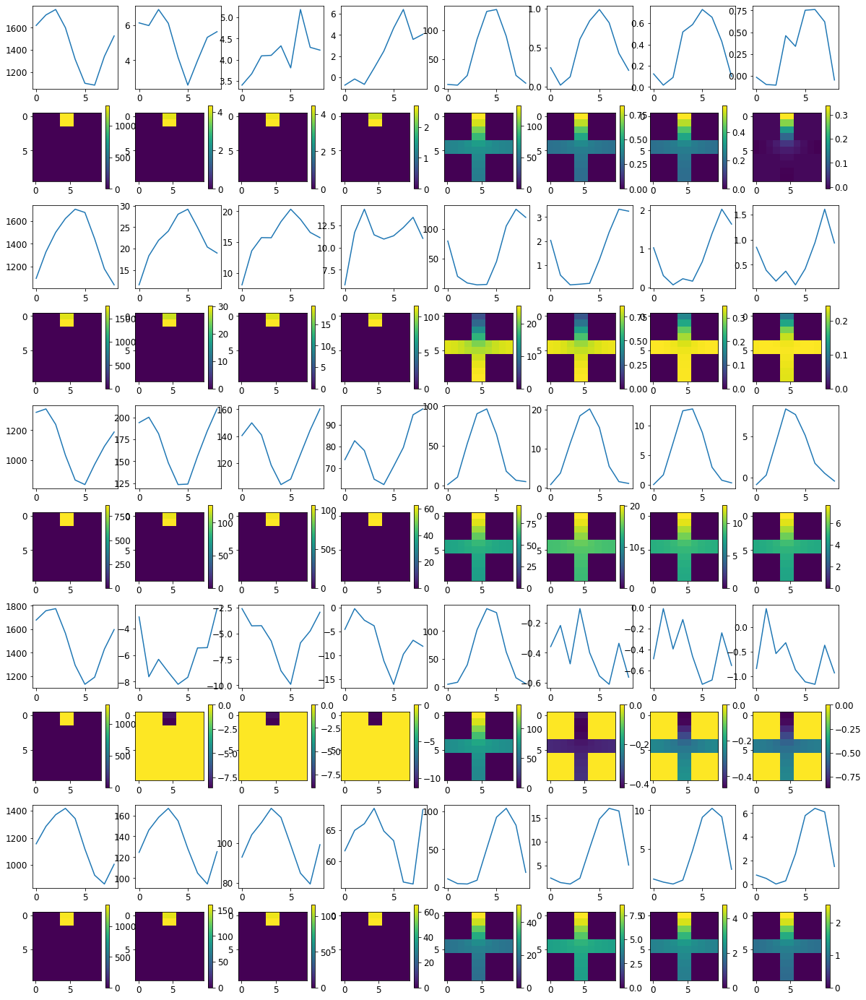

Loss: 


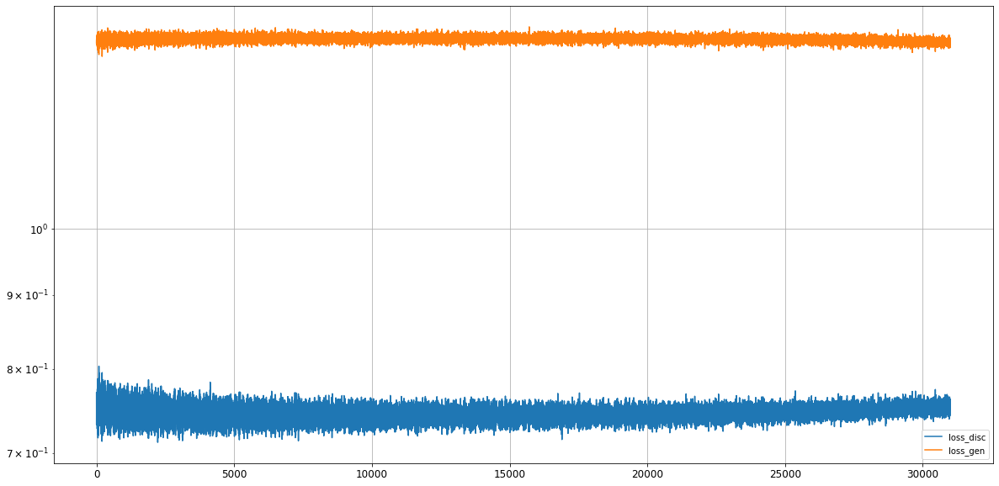

Epoch 31002/50000
discriminator loss: 1.335057 - generator loss: 0.757738 - 1s
Epoch 31003/50000
discriminator loss: 1.339860 - generator loss: 0.755391 - 1s
Epoch 31004/50000
discriminator loss: 1.352626 - generator loss: 0.748274 - 1s
Epoch 31005/50000
discriminator loss: 1.342180 - generator loss: 0.757826 - 1s
Epoch 31006/50000
discriminator loss: 1.349476 - generator loss: 0.751750 - 1s
Epoch 31007/50000
discriminator loss: 1.343125 - generator loss: 0.753984 - 1s
Epoch 31008/50000
discriminator loss: 1.353283 - generator loss: 0.750086 - 1s
Epoch 31009/50000
discriminator loss: 1.342727 - generator loss: 0.752236 - 1s
Epoch 31010/50000
discriminator loss: 1.353208 - generator loss: 0.759048 - 1s
Epoch 31011/50000
discriminator loss: 1.341862 - generator loss: 0.752248 - 1s
Epoch 31012/50000
discriminator loss: 1.340094 - generator loss: 0.753763 - 1s
Epoch 31013/50000
discriminator loss: 1.346277 - generator loss: 0.756453 - 1s
Epoch 31014/50000
discriminator loss: 1.343980 - gen

discriminator loss: 1.343091 - generator loss: 0.755959 - 1s
Epoch 31107/50000
discriminator loss: 1.335144 - generator loss: 0.754094 - 1s
Epoch 31108/50000
discriminator loss: 1.348203 - generator loss: 0.757614 - 1s
Epoch 31109/50000
discriminator loss: 1.351372 - generator loss: 0.750547 - 1s
Epoch 31110/50000
discriminator loss: 1.346846 - generator loss: 0.756295 - 1s
Epoch 31111/50000
discriminator loss: 1.344873 - generator loss: 0.751611 - 1s
Epoch 31112/50000
discriminator loss: 1.357982 - generator loss: 0.744794 - 1s
Epoch 31113/50000
discriminator loss: 1.346818 - generator loss: 0.760755 - 1s
Epoch 31114/50000
discriminator loss: 1.347295 - generator loss: 0.747327 - 1s
Epoch 31115/50000
discriminator loss: 1.350155 - generator loss: 0.750139 - 1s
Epoch 31116/50000
discriminator loss: 1.344626 - generator loss: 0.759630 - 1s
Epoch 31117/50000
discriminator loss: 1.352186 - generator loss: 0.748641 - 1s
Epoch 31118/50000
discriminator loss: 1.348260 - generator loss: 0.748

discriminator loss: 1.345979 - generator loss: 0.753867 - 1s
Epoch 31211/50000
discriminator loss: 1.343727 - generator loss: 0.758026 - 1s
Epoch 31212/50000
discriminator loss: 1.347205 - generator loss: 0.755973 - 1s
Epoch 31213/50000
discriminator loss: 1.346827 - generator loss: 0.747320 - 1s
Epoch 31214/50000
discriminator loss: 1.349604 - generator loss: 0.756948 - 1s
Epoch 31215/50000
discriminator loss: 1.343673 - generator loss: 0.749041 - 1s
Epoch 31216/50000
discriminator loss: 1.348730 - generator loss: 0.756537 - 1s
Epoch 31217/50000
discriminator loss: 1.354573 - generator loss: 0.751190 - 1s
Epoch 31218/50000
discriminator loss: 1.344727 - generator loss: 0.752351 - 1s
Epoch 31219/50000
discriminator loss: 1.351960 - generator loss: 0.749350 - 1s
Epoch 31220/50000
discriminator loss: 1.353444 - generator loss: 0.747403 - 1s
Epoch 31221/50000
discriminator loss: 1.345618 - generator loss: 0.751668 - 1s
Epoch 31222/50000
discriminator loss: 1.347112 - generator loss: 0.750

discriminator loss: 1.351117 - generator loss: 0.752593 - 1s
Epoch 31315/50000
discriminator loss: 1.350083 - generator loss: 0.746360 - 1s
Epoch 31316/50000
discriminator loss: 1.349636 - generator loss: 0.746726 - 1s
Epoch 31317/50000
discriminator loss: 1.340050 - generator loss: 0.764789 - 1s
Epoch 31318/50000
discriminator loss: 1.350741 - generator loss: 0.751439 - 1s
Epoch 31319/50000
discriminator loss: 1.341257 - generator loss: 0.754968 - 1s
Epoch 31320/50000
discriminator loss: 1.353146 - generator loss: 0.751688 - 1s
Epoch 31321/50000
discriminator loss: 1.346430 - generator loss: 0.756053 - 1s
Epoch 31322/50000
discriminator loss: 1.343106 - generator loss: 0.748005 - 1s
Epoch 31323/50000
discriminator loss: 1.337135 - generator loss: 0.761997 - 1s
Epoch 31324/50000
discriminator loss: 1.344245 - generator loss: 0.752706 - 1s
Epoch 31325/50000
discriminator loss: 1.350172 - generator loss: 0.758609 - 1s
Epoch 31326/50000
discriminator loss: 1.340309 - generator loss: 0.755

discriminator loss: 1.341427 - generator loss: 0.761673 - 1s
Epoch 31419/50000
discriminator loss: 1.344883 - generator loss: 0.751274 - 1s
Epoch 31420/50000
discriminator loss: 1.350184 - generator loss: 0.758826 - 1s
Epoch 31421/50000
discriminator loss: 1.341776 - generator loss: 0.756828 - 1s
Epoch 31422/50000
discriminator loss: 1.354479 - generator loss: 0.744133 - 1s
Epoch 31423/50000
discriminator loss: 1.345922 - generator loss: 0.748990 - 1s
Epoch 31424/50000
discriminator loss: 1.335874 - generator loss: 0.762178 - 1s
Epoch 31425/50000
discriminator loss: 1.334838 - generator loss: 0.759205 - 1s
Epoch 31426/50000
discriminator loss: 1.345341 - generator loss: 0.757708 - 1s
Epoch 31427/50000
discriminator loss: 1.345479 - generator loss: 0.753997 - 1s
Epoch 31428/50000
discriminator loss: 1.353092 - generator loss: 0.747104 - 1s
Epoch 31429/50000
discriminator loss: 1.349369 - generator loss: 0.754371 - 1s
Epoch 31430/50000
discriminator loss: 1.334643 - generator loss: 0.766

discriminator loss: 1.350253 - generator loss: 0.755163 - 1s
Epoch 31523/50000
discriminator loss: 1.345247 - generator loss: 0.760883 - 1s
Epoch 31524/50000
discriminator loss: 1.345660 - generator loss: 0.755479 - 1s
Epoch 31525/50000
discriminator loss: 1.348171 - generator loss: 0.751193 - 1s
Epoch 31526/50000
discriminator loss: 1.349168 - generator loss: 0.756227 - 1s
Epoch 31527/50000
discriminator loss: 1.352413 - generator loss: 0.741843 - 1s
Epoch 31528/50000
discriminator loss: 1.347676 - generator loss: 0.754713 - 1s
Epoch 31529/50000
discriminator loss: 1.350199 - generator loss: 0.755725 - 1s
Epoch 31530/50000
discriminator loss: 1.347855 - generator loss: 0.749067 - 1s
Epoch 31531/50000
discriminator loss: 1.350039 - generator loss: 0.753790 - 1s
Epoch 31532/50000
discriminator loss: 1.353912 - generator loss: 0.754374 - 1s
Epoch 31533/50000
discriminator loss: 1.342600 - generator loss: 0.763787 - 1s
Epoch 31534/50000
discriminator loss: 1.345697 - generator loss: 0.753

discriminator loss: 1.355726 - generator loss: 0.751291 - 1s
Epoch 31627/50000
discriminator loss: 1.343237 - generator loss: 0.754294 - 1s
Epoch 31628/50000
discriminator loss: 1.346122 - generator loss: 0.745947 - 1s
Epoch 31629/50000
discriminator loss: 1.347917 - generator loss: 0.751189 - 1s
Epoch 31630/50000
discriminator loss: 1.341329 - generator loss: 0.757674 - 1s
Epoch 31631/50000
discriminator loss: 1.348710 - generator loss: 0.756337 - 1s
Epoch 31632/50000
discriminator loss: 1.348061 - generator loss: 0.756204 - 1s
Epoch 31633/50000
discriminator loss: 1.343910 - generator loss: 0.749079 - 1s
Epoch 31634/50000
discriminator loss: 1.345420 - generator loss: 0.753690 - 1s
Epoch 31635/50000
discriminator loss: 1.347386 - generator loss: 0.752079 - 1s
Epoch 31636/50000
discriminator loss: 1.345492 - generator loss: 0.751839 - 1s
Epoch 31637/50000
discriminator loss: 1.336624 - generator loss: 0.763718 - 1s
Epoch 31638/50000
discriminator loss: 1.337423 - generator loss: 0.755

discriminator loss: 1.357032 - generator loss: 0.746543 - 1s
Epoch 31731/50000
discriminator loss: 1.344553 - generator loss: 0.760654 - 1s
Epoch 31732/50000
discriminator loss: 1.336274 - generator loss: 0.755410 - 1s
Epoch 31733/50000
discriminator loss: 1.329381 - generator loss: 0.762435 - 1s
Epoch 31734/50000
discriminator loss: 1.345999 - generator loss: 0.756867 - 1s
Epoch 31735/50000
discriminator loss: 1.351439 - generator loss: 0.752113 - 1s
Epoch 31736/50000
discriminator loss: 1.345856 - generator loss: 0.757128 - 1s
Epoch 31737/50000
discriminator loss: 1.338482 - generator loss: 0.760392 - 1s
Epoch 31738/50000
discriminator loss: 1.346828 - generator loss: 0.753403 - 1s
Epoch 31739/50000
discriminator loss: 1.349308 - generator loss: 0.745086 - 1s
Epoch 31740/50000
discriminator loss: 1.336949 - generator loss: 0.760982 - 1s
Epoch 31741/50000
discriminator loss: 1.341679 - generator loss: 0.752827 - 1s
Epoch 31742/50000
discriminator loss: 1.343793 - generator loss: 0.762

discriminator loss: 1.351265 - generator loss: 0.754872 - 1s
Epoch 31835/50000
discriminator loss: 1.344767 - generator loss: 0.750743 - 1s
Epoch 31836/50000
discriminator loss: 1.340887 - generator loss: 0.761697 - 1s
Epoch 31837/50000
discriminator loss: 1.338727 - generator loss: 0.755260 - 1s
Epoch 31838/50000
discriminator loss: 1.354339 - generator loss: 0.748192 - 1s
Epoch 31839/50000
discriminator loss: 1.343235 - generator loss: 0.756185 - 1s
Epoch 31840/50000
discriminator loss: 1.351039 - generator loss: 0.748957 - 1s
Epoch 31841/50000
discriminator loss: 1.345099 - generator loss: 0.761244 - 1s
Epoch 31842/50000
discriminator loss: 1.349014 - generator loss: 0.748268 - 1s
Epoch 31843/50000
discriminator loss: 1.350122 - generator loss: 0.754804 - 1s
Epoch 31844/50000
discriminator loss: 1.335579 - generator loss: 0.772114 - 1s
Epoch 31845/50000
discriminator loss: 1.347322 - generator loss: 0.754009 - 1s
Epoch 31846/50000
discriminator loss: 1.341637 - generator loss: 0.756

discriminator loss: 1.350365 - generator loss: 0.751910 - 1s
Epoch 31939/50000
discriminator loss: 1.352449 - generator loss: 0.747769 - 1s
Epoch 31940/50000
discriminator loss: 1.349432 - generator loss: 0.754391 - 1s
Epoch 31941/50000
discriminator loss: 1.342189 - generator loss: 0.755579 - 1s
Epoch 31942/50000
discriminator loss: 1.338213 - generator loss: 0.762051 - 1s
Epoch 31943/50000
discriminator loss: 1.339836 - generator loss: 0.754830 - 1s
Epoch 31944/50000
discriminator loss: 1.351083 - generator loss: 0.753660 - 1s
Epoch 31945/50000
discriminator loss: 1.350094 - generator loss: 0.755944 - 1s
Epoch 31946/50000
discriminator loss: 1.348698 - generator loss: 0.753440 - 1s
Epoch 31947/50000
discriminator loss: 1.343819 - generator loss: 0.756045 - 1s
Epoch 31948/50000
discriminator loss: 1.343183 - generator loss: 0.758301 - 1s
Epoch 31949/50000
discriminator loss: 1.355967 - generator loss: 0.746555 - 1s
Epoch 31950/50000
discriminator loss: 1.353942 - generator loss: 0.743

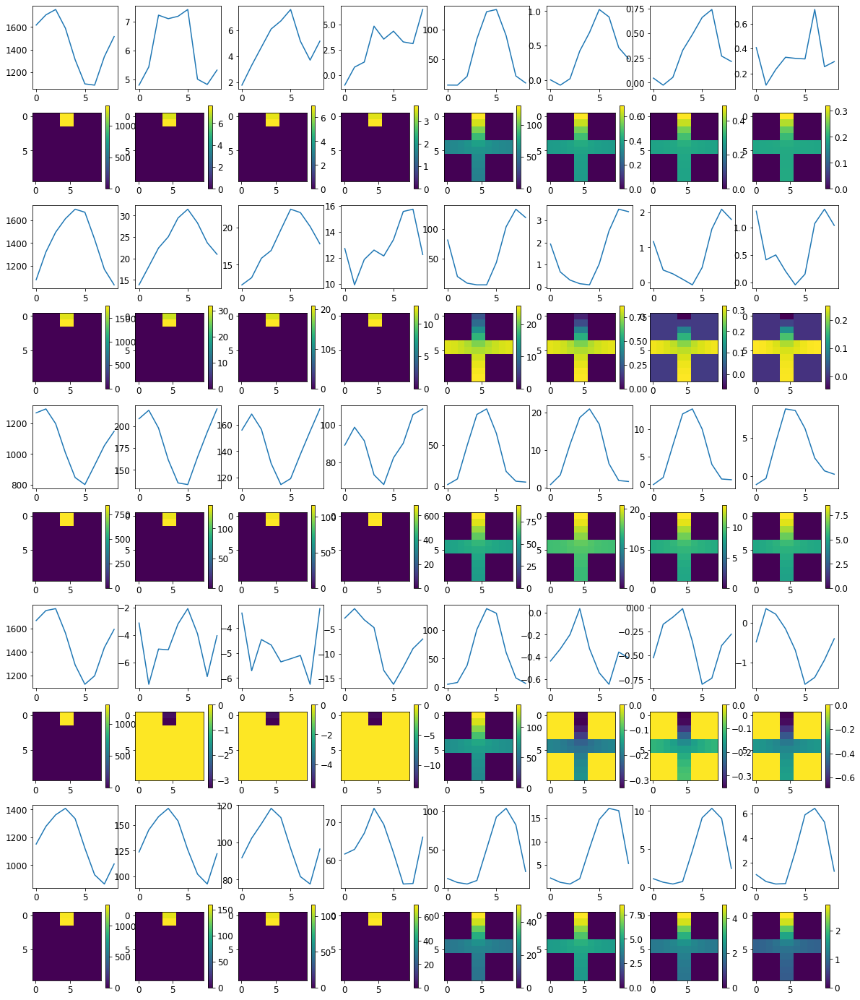

Loss: 


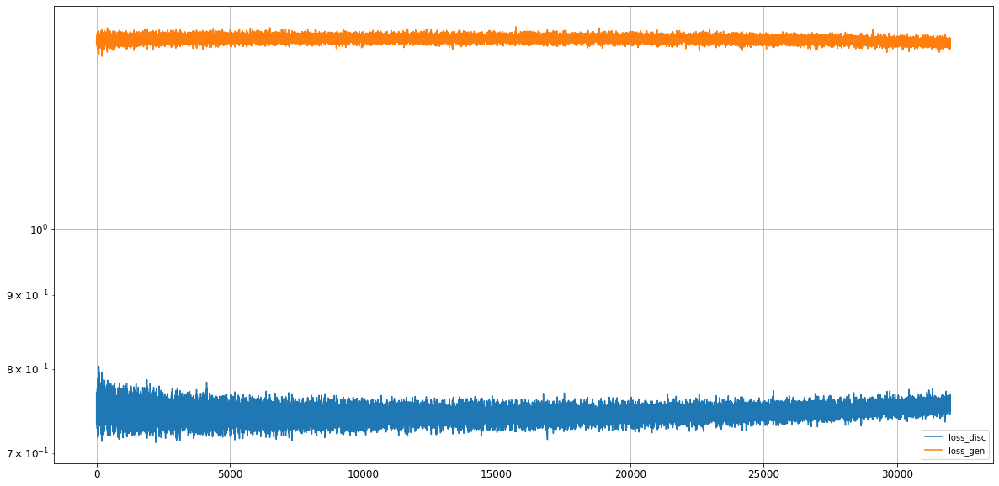

Epoch 32002/50000
discriminator loss: 1.349770 - generator loss: 0.748892 - 1s
Epoch 32003/50000
discriminator loss: 1.348295 - generator loss: 0.747840 - 1s
Epoch 32004/50000
discriminator loss: 1.342219 - generator loss: 0.759220 - 1s
Epoch 32005/50000
discriminator loss: 1.353233 - generator loss: 0.756259 - 1s
Epoch 32006/50000
discriminator loss: 1.350687 - generator loss: 0.751187 - 1s
Epoch 32007/50000
discriminator loss: 1.351180 - generator loss: 0.751101 - 1s
Epoch 32008/50000
discriminator loss: 1.348003 - generator loss: 0.756830 - 1s
Epoch 32009/50000
discriminator loss: 1.345927 - generator loss: 0.757212 - 1s
Epoch 32010/50000
discriminator loss: 1.343381 - generator loss: 0.759355 - 1s
Epoch 32011/50000
discriminator loss: 1.344255 - generator loss: 0.752290 - 1s
Epoch 32012/50000
discriminator loss: 1.350300 - generator loss: 0.753332 - 1s
Epoch 32013/50000
discriminator loss: 1.342614 - generator loss: 0.754287 - 1s
Epoch 32014/50000
discriminator loss: 1.346414 - gen

discriminator loss: 1.342276 - generator loss: 0.759357 - 1s
Epoch 32107/50000
discriminator loss: 1.337341 - generator loss: 0.763186 - 1s
Epoch 32108/50000
discriminator loss: 1.347716 - generator loss: 0.746353 - 1s
Epoch 32109/50000
discriminator loss: 1.346439 - generator loss: 0.751736 - 1s
Epoch 32110/50000
discriminator loss: 1.347649 - generator loss: 0.753465 - 1s
Epoch 32111/50000
discriminator loss: 1.340470 - generator loss: 0.760053 - 1s
Epoch 32112/50000
discriminator loss: 1.336603 - generator loss: 0.759054 - 1s
Epoch 32113/50000
discriminator loss: 1.346468 - generator loss: 0.755215 - 1s
Epoch 32114/50000
discriminator loss: 1.338078 - generator loss: 0.762271 - 1s
Epoch 32115/50000
discriminator loss: 1.355071 - generator loss: 0.744180 - 1s
Epoch 32116/50000
discriminator loss: 1.349678 - generator loss: 0.747577 - 1s
Epoch 32117/50000
discriminator loss: 1.340208 - generator loss: 0.757793 - 1s
Epoch 32118/50000
discriminator loss: 1.347860 - generator loss: 0.753

discriminator loss: 1.350566 - generator loss: 0.754331 - 1s
Epoch 32211/50000
discriminator loss: 1.353630 - generator loss: 0.745894 - 1s
Epoch 32212/50000
discriminator loss: 1.341852 - generator loss: 0.771055 - 1s
Epoch 32213/50000
discriminator loss: 1.341251 - generator loss: 0.759946 - 1s
Epoch 32214/50000
discriminator loss: 1.340299 - generator loss: 0.754240 - 1s
Epoch 32215/50000
discriminator loss: 1.338245 - generator loss: 0.754459 - 1s
Epoch 32216/50000
discriminator loss: 1.348405 - generator loss: 0.748759 - 1s
Epoch 32217/50000
discriminator loss: 1.350348 - generator loss: 0.753643 - 1s
Epoch 32218/50000
discriminator loss: 1.344209 - generator loss: 0.755541 - 1s
Epoch 32219/50000
discriminator loss: 1.344831 - generator loss: 0.759450 - 1s
Epoch 32220/50000
discriminator loss: 1.343322 - generator loss: 0.756596 - 1s
Epoch 32221/50000
discriminator loss: 1.352429 - generator loss: 0.748294 - 1s
Epoch 32222/50000
discriminator loss: 1.350617 - generator loss: 0.757

discriminator loss: 1.346455 - generator loss: 0.753409 - 1s
Epoch 32315/50000
discriminator loss: 1.337465 - generator loss: 0.762834 - 1s
Epoch 32316/50000
discriminator loss: 1.338330 - generator loss: 0.757788 - 1s
Epoch 32317/50000
discriminator loss: 1.355285 - generator loss: 0.738439 - 1s
Epoch 32318/50000
discriminator loss: 1.348099 - generator loss: 0.751826 - 1s
Epoch 32319/50000
discriminator loss: 1.351498 - generator loss: 0.749861 - 1s
Epoch 32320/50000
discriminator loss: 1.345054 - generator loss: 0.760313 - 1s
Epoch 32321/50000
discriminator loss: 1.345917 - generator loss: 0.753555 - 1s
Epoch 32322/50000
discriminator loss: 1.349533 - generator loss: 0.751542 - 1s
Epoch 32323/50000
discriminator loss: 1.347479 - generator loss: 0.759963 - 1s
Epoch 32324/50000
discriminator loss: 1.337365 - generator loss: 0.756618 - 1s
Epoch 32325/50000
discriminator loss: 1.349193 - generator loss: 0.751460 - 1s
Epoch 32326/50000
discriminator loss: 1.349469 - generator loss: 0.755

discriminator loss: 1.351813 - generator loss: 0.749417 - 1s
Epoch 32419/50000
discriminator loss: 1.345027 - generator loss: 0.754422 - 1s
Epoch 32420/50000
discriminator loss: 1.343049 - generator loss: 0.760611 - 1s
Epoch 32421/50000
discriminator loss: 1.354136 - generator loss: 0.752910 - 1s
Epoch 32422/50000
discriminator loss: 1.327930 - generator loss: 0.768951 - 1s
Epoch 32423/50000
discriminator loss: 1.335574 - generator loss: 0.755748 - 1s
Epoch 32424/50000
discriminator loss: 1.335542 - generator loss: 0.756480 - 1s
Epoch 32425/50000
discriminator loss: 1.354909 - generator loss: 0.743647 - 1s
Epoch 32426/50000
discriminator loss: 1.349178 - generator loss: 0.752390 - 1s
Epoch 32427/50000
discriminator loss: 1.337732 - generator loss: 0.769152 - 1s
Epoch 32428/50000
discriminator loss: 1.337610 - generator loss: 0.766308 - 1s
Epoch 32429/50000
discriminator loss: 1.339760 - generator loss: 0.766570 - 1s
Epoch 32430/50000
discriminator loss: 1.348379 - generator loss: 0.751

discriminator loss: 1.343172 - generator loss: 0.761727 - 1s
Epoch 32523/50000
discriminator loss: 1.330540 - generator loss: 0.768195 - 1s
Epoch 32524/50000
discriminator loss: 1.338808 - generator loss: 0.759692 - 1s
Epoch 32525/50000
discriminator loss: 1.348488 - generator loss: 0.753046 - 1s
Epoch 32526/50000
discriminator loss: 1.348839 - generator loss: 0.753264 - 1s
Epoch 32527/50000
discriminator loss: 1.346355 - generator loss: 0.752252 - 1s
Epoch 32528/50000
discriminator loss: 1.342676 - generator loss: 0.756485 - 1s
Epoch 32529/50000
discriminator loss: 1.344633 - generator loss: 0.753754 - 1s
Epoch 32530/50000
discriminator loss: 1.351326 - generator loss: 0.751334 - 1s
Epoch 32531/50000
discriminator loss: 1.348468 - generator loss: 0.751756 - 1s
Epoch 32532/50000
discriminator loss: 1.344089 - generator loss: 0.764247 - 1s
Epoch 32533/50000
discriminator loss: 1.333281 - generator loss: 0.771460 - 1s
Epoch 32534/50000
discriminator loss: 1.330245 - generator loss: 0.764

discriminator loss: 1.352558 - generator loss: 0.756819 - 1s
Epoch 32627/50000
discriminator loss: 1.341352 - generator loss: 0.765329 - 1s
Epoch 32628/50000
discriminator loss: 1.342647 - generator loss: 0.751924 - 1s
Epoch 32629/50000
discriminator loss: 1.346040 - generator loss: 0.758188 - 1s
Epoch 32630/50000
discriminator loss: 1.344192 - generator loss: 0.753245 - 1s
Epoch 32631/50000
discriminator loss: 1.356263 - generator loss: 0.744194 - 1s
Epoch 32632/50000
discriminator loss: 1.355864 - generator loss: 0.746177 - 1s
Epoch 32633/50000
discriminator loss: 1.339943 - generator loss: 0.757950 - 1s
Epoch 32634/50000
discriminator loss: 1.344723 - generator loss: 0.751071 - 1s
Epoch 32635/50000
discriminator loss: 1.343608 - generator loss: 0.764673 - 1s
Epoch 32636/50000
discriminator loss: 1.347966 - generator loss: 0.757120 - 1s
Epoch 32637/50000
discriminator loss: 1.344116 - generator loss: 0.752387 - 1s
Epoch 32638/50000
discriminator loss: 1.348399 - generator loss: 0.752

discriminator loss: 1.349149 - generator loss: 0.749972 - 1s
Epoch 32731/50000
discriminator loss: 1.332978 - generator loss: 0.767693 - 1s
Epoch 32732/50000
discriminator loss: 1.346834 - generator loss: 0.750935 - 1s
Epoch 32733/50000
discriminator loss: 1.345850 - generator loss: 0.767845 - 1s
Epoch 32734/50000
discriminator loss: 1.336214 - generator loss: 0.758879 - 1s
Epoch 32735/50000
discriminator loss: 1.336625 - generator loss: 0.755931 - 1s
Epoch 32736/50000
discriminator loss: 1.343056 - generator loss: 0.756754 - 1s
Epoch 32737/50000
discriminator loss: 1.342697 - generator loss: 0.752819 - 1s
Epoch 32738/50000
discriminator loss: 1.344868 - generator loss: 0.754755 - 1s
Epoch 32739/50000
discriminator loss: 1.344404 - generator loss: 0.760609 - 1s
Epoch 32740/50000
discriminator loss: 1.349587 - generator loss: 0.752056 - 1s
Epoch 32741/50000
discriminator loss: 1.346544 - generator loss: 0.756935 - 1s
Epoch 32742/50000
discriminator loss: 1.343180 - generator loss: 0.758

discriminator loss: 1.351038 - generator loss: 0.760047 - 1s
Epoch 32835/50000
discriminator loss: 1.344464 - generator loss: 0.758273 - 1s
Epoch 32836/50000
discriminator loss: 1.342028 - generator loss: 0.757721 - 1s
Epoch 32837/50000
discriminator loss: 1.336353 - generator loss: 0.758428 - 1s
Epoch 32838/50000
discriminator loss: 1.346793 - generator loss: 0.755982 - 1s
Epoch 32839/50000
discriminator loss: 1.336997 - generator loss: 0.759930 - 1s
Epoch 32840/50000
discriminator loss: 1.342821 - generator loss: 0.757849 - 1s
Epoch 32841/50000
discriminator loss: 1.345936 - generator loss: 0.759782 - 1s
Epoch 32842/50000
discriminator loss: 1.338177 - generator loss: 0.762672 - 1s
Epoch 32843/50000
discriminator loss: 1.334720 - generator loss: 0.762852 - 1s
Epoch 32844/50000
discriminator loss: 1.339401 - generator loss: 0.758586 - 1s
Epoch 32845/50000
discriminator loss: 1.362706 - generator loss: 0.741050 - 1s
Epoch 32846/50000
discriminator loss: 1.340164 - generator loss: 0.762

discriminator loss: 1.342466 - generator loss: 0.759283 - 1s
Epoch 32939/50000
discriminator loss: 1.350502 - generator loss: 0.750128 - 1s
Epoch 32940/50000
discriminator loss: 1.355094 - generator loss: 0.748942 - 1s
Epoch 32941/50000
discriminator loss: 1.358421 - generator loss: 0.751248 - 1s
Epoch 32942/50000
discriminator loss: 1.335949 - generator loss: 0.760688 - 1s
Epoch 32943/50000
discriminator loss: 1.336826 - generator loss: 0.766140 - 1s
Epoch 32944/50000
discriminator loss: 1.343465 - generator loss: 0.754425 - 1s
Epoch 32945/50000
discriminator loss: 1.343495 - generator loss: 0.753229 - 1s
Epoch 32946/50000
discriminator loss: 1.349544 - generator loss: 0.753733 - 1s
Epoch 32947/50000
discriminator loss: 1.339112 - generator loss: 0.760018 - 1s
Epoch 32948/50000
discriminator loss: 1.343285 - generator loss: 0.754333 - 1s
Epoch 32949/50000
discriminator loss: 1.336284 - generator loss: 0.766642 - 1s
Epoch 32950/50000
discriminator loss: 1.337078 - generator loss: 0.754

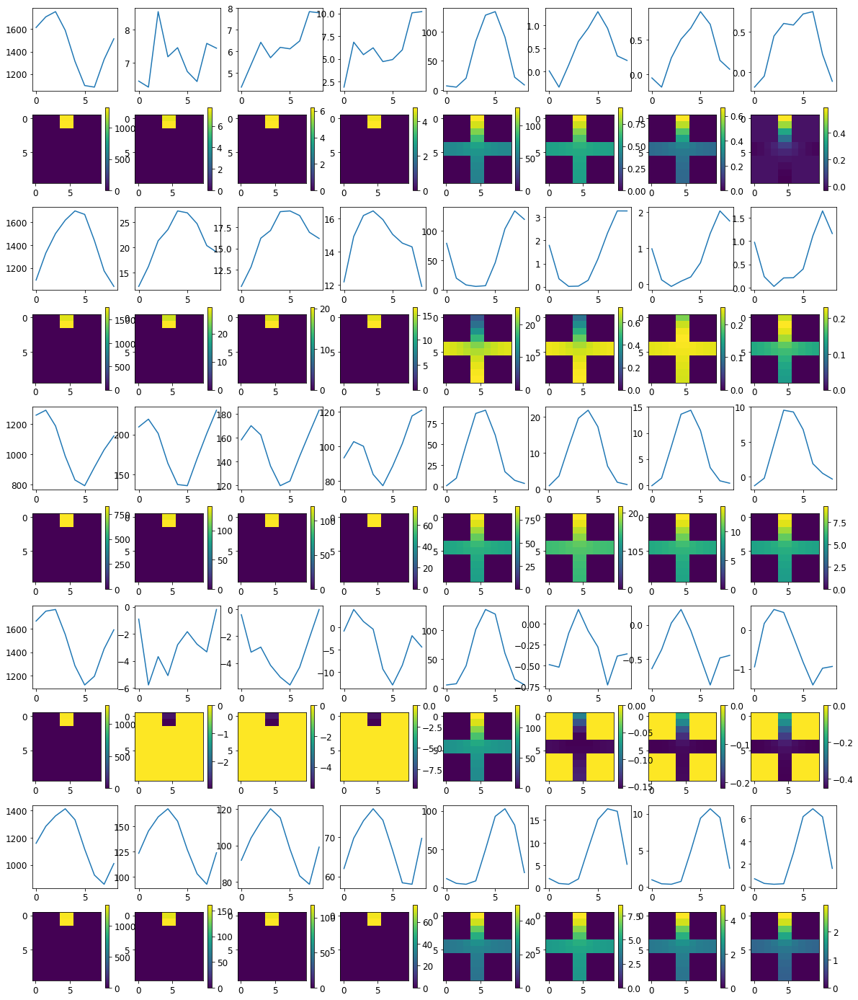

Loss: 


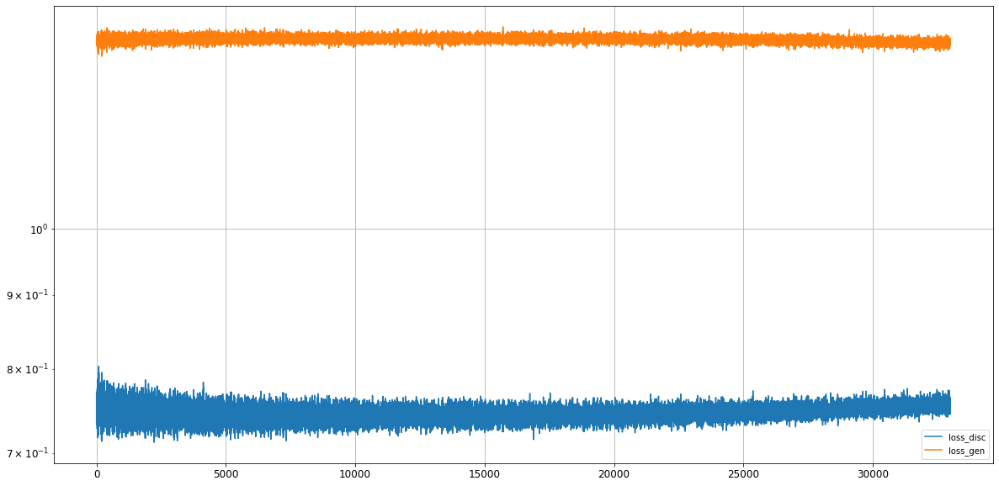

Epoch 33002/50000
discriminator loss: 1.354664 - generator loss: 0.743595 - 1s
Epoch 33003/50000
discriminator loss: 1.344848 - generator loss: 0.766485 - 1s
Epoch 33004/50000
discriminator loss: 1.348901 - generator loss: 0.754372 - 1s
Epoch 33005/50000
discriminator loss: 1.339933 - generator loss: 0.755547 - 1s
Epoch 33006/50000
discriminator loss: 1.346448 - generator loss: 0.756834 - 1s
Epoch 33007/50000
discriminator loss: 1.337151 - generator loss: 0.753302 - 1s
Epoch 33008/50000
discriminator loss: 1.341247 - generator loss: 0.763550 - 1s
Epoch 33009/50000
discriminator loss: 1.338813 - generator loss: 0.762891 - 1s
Epoch 33010/50000
discriminator loss: 1.342831 - generator loss: 0.759091 - 1s
Epoch 33011/50000
discriminator loss: 1.340551 - generator loss: 0.754957 - 1s
Epoch 33012/50000
discriminator loss: 1.346968 - generator loss: 0.754136 - 1s
Epoch 33013/50000
discriminator loss: 1.349822 - generator loss: 0.758814 - 1s
Epoch 33014/50000
discriminator loss: 1.341882 - gen

discriminator loss: 1.351643 - generator loss: 0.750346 - 1s
Epoch 33107/50000
discriminator loss: 1.351829 - generator loss: 0.751513 - 1s
Epoch 33108/50000
discriminator loss: 1.342252 - generator loss: 0.760809 - 1s
Epoch 33109/50000
discriminator loss: 1.348059 - generator loss: 0.753448 - 1s
Epoch 33110/50000
discriminator loss: 1.346698 - generator loss: 0.748242 - 1s
Epoch 33111/50000
discriminator loss: 1.349881 - generator loss: 0.759494 - 1s
Epoch 33112/50000
discriminator loss: 1.347738 - generator loss: 0.761329 - 1s
Epoch 33113/50000
discriminator loss: 1.339394 - generator loss: 0.753789 - 1s
Epoch 33114/50000
discriminator loss: 1.341419 - generator loss: 0.765715 - 1s
Epoch 33115/50000
discriminator loss: 1.339680 - generator loss: 0.759030 - 1s
Epoch 33116/50000
discriminator loss: 1.346399 - generator loss: 0.763786 - 1s
Epoch 33117/50000
discriminator loss: 1.350665 - generator loss: 0.744382 - 1s
Epoch 33118/50000
discriminator loss: 1.347484 - generator loss: 0.762

discriminator loss: 1.347825 - generator loss: 0.750381 - 1s
Epoch 33211/50000
discriminator loss: 1.352773 - generator loss: 0.755080 - 1s
Epoch 33212/50000
discriminator loss: 1.353410 - generator loss: 0.745094 - 1s
Epoch 33213/50000
discriminator loss: 1.336597 - generator loss: 0.762404 - 1s
Epoch 33214/50000
discriminator loss: 1.341282 - generator loss: 0.765211 - 1s
Epoch 33215/50000
discriminator loss: 1.345634 - generator loss: 0.754508 - 1s
Epoch 33216/50000
discriminator loss: 1.352448 - generator loss: 0.749886 - 1s
Epoch 33217/50000
discriminator loss: 1.349402 - generator loss: 0.743823 - 1s
Epoch 33218/50000
discriminator loss: 1.343426 - generator loss: 0.764478 - 1s
Epoch 33219/50000
discriminator loss: 1.330685 - generator loss: 0.760686 - 1s
Epoch 33220/50000
discriminator loss: 1.348314 - generator loss: 0.759021 - 1s
Epoch 33221/50000
discriminator loss: 1.343807 - generator loss: 0.757503 - 1s
Epoch 33222/50000
discriminator loss: 1.347541 - generator loss: 0.757

discriminator loss: 1.347365 - generator loss: 0.749553 - 1s
Epoch 33315/50000
discriminator loss: 1.347546 - generator loss: 0.754238 - 1s
Epoch 33316/50000
discriminator loss: 1.345570 - generator loss: 0.766160 - 1s
Epoch 33317/50000
discriminator loss: 1.336785 - generator loss: 0.757912 - 1s
Epoch 33318/50000
discriminator loss: 1.347910 - generator loss: 0.759912 - 1s
Epoch 33319/50000
discriminator loss: 1.346656 - generator loss: 0.755132 - 1s
Epoch 33320/50000
discriminator loss: 1.339239 - generator loss: 0.752328 - 1s
Epoch 33321/50000
discriminator loss: 1.337030 - generator loss: 0.765835 - 1s
Epoch 33322/50000
discriminator loss: 1.345043 - generator loss: 0.755260 - 1s
Epoch 33323/50000
discriminator loss: 1.340098 - generator loss: 0.767475 - 1s
Epoch 33324/50000
discriminator loss: 1.340931 - generator loss: 0.762259 - 1s
Epoch 33325/50000
discriminator loss: 1.339559 - generator loss: 0.756229 - 1s
Epoch 33326/50000
discriminator loss: 1.339241 - generator loss: 0.766

discriminator loss: 1.338027 - generator loss: 0.758713 - 1s
Epoch 33419/50000
discriminator loss: 1.334951 - generator loss: 0.758143 - 1s
Epoch 33420/50000
discriminator loss: 1.342877 - generator loss: 0.758551 - 1s
Epoch 33421/50000
discriminator loss: 1.342234 - generator loss: 0.757419 - 1s
Epoch 33422/50000
discriminator loss: 1.347700 - generator loss: 0.761153 - 1s
Epoch 33423/50000
discriminator loss: 1.340136 - generator loss: 0.755814 - 1s
Epoch 33424/50000
discriminator loss: 1.343147 - generator loss: 0.753157 - 1s
Epoch 33425/50000
discriminator loss: 1.344867 - generator loss: 0.760141 - 1s
Epoch 33426/50000
discriminator loss: 1.338949 - generator loss: 0.758664 - 1s
Epoch 33427/50000
discriminator loss: 1.345309 - generator loss: 0.759424 - 1s
Epoch 33428/50000
discriminator loss: 1.329870 - generator loss: 0.766187 - 1s
Epoch 33429/50000
discriminator loss: 1.346646 - generator loss: 0.751441 - 1s
Epoch 33430/50000
discriminator loss: 1.339832 - generator loss: 0.757

discriminator loss: 1.339335 - generator loss: 0.762736 - 1s
Epoch 33523/50000
discriminator loss: 1.352252 - generator loss: 0.755903 - 1s
Epoch 33524/50000
discriminator loss: 1.343330 - generator loss: 0.763224 - 1s
Epoch 33525/50000
discriminator loss: 1.340021 - generator loss: 0.752474 - 1s
Epoch 33526/50000
discriminator loss: 1.347499 - generator loss: 0.752932 - 1s
Epoch 33527/50000
discriminator loss: 1.338266 - generator loss: 0.755962 - 1s
Epoch 33528/50000
discriminator loss: 1.340339 - generator loss: 0.763577 - 1s
Epoch 33529/50000
discriminator loss: 1.345198 - generator loss: 0.755285 - 1s
Epoch 33530/50000
discriminator loss: 1.338591 - generator loss: 0.765115 - 1s
Epoch 33531/50000
discriminator loss: 1.352558 - generator loss: 0.756876 - 1s
Epoch 33532/50000
discriminator loss: 1.348762 - generator loss: 0.749977 - 1s
Epoch 33533/50000
discriminator loss: 1.347751 - generator loss: 0.755750 - 1s
Epoch 33534/50000
discriminator loss: 1.348267 - generator loss: 0.748

discriminator loss: 1.352057 - generator loss: 0.746605 - 1s
Epoch 33627/50000
discriminator loss: 1.352266 - generator loss: 0.755472 - 1s
Epoch 33628/50000
discriminator loss: 1.346834 - generator loss: 0.753876 - 1s
Epoch 33629/50000
discriminator loss: 1.340531 - generator loss: 0.761767 - 1s
Epoch 33630/50000
discriminator loss: 1.342467 - generator loss: 0.756703 - 1s
Epoch 33631/50000
discriminator loss: 1.342484 - generator loss: 0.754203 - 1s
Epoch 33632/50000
discriminator loss: 1.341138 - generator loss: 0.756352 - 1s
Epoch 33633/50000
discriminator loss: 1.355524 - generator loss: 0.751606 - 1s
Epoch 33634/50000
discriminator loss: 1.343714 - generator loss: 0.754508 - 1s
Epoch 33635/50000
discriminator loss: 1.349735 - generator loss: 0.755050 - 1s
Epoch 33636/50000
discriminator loss: 1.336347 - generator loss: 0.764688 - 1s
Epoch 33637/50000
discriminator loss: 1.347454 - generator loss: 0.756197 - 1s
Epoch 33638/50000
discriminator loss: 1.344977 - generator loss: 0.746

discriminator loss: 1.345076 - generator loss: 0.756571 - 1s
Epoch 33731/50000
discriminator loss: 1.346965 - generator loss: 0.758720 - 1s
Epoch 33732/50000
discriminator loss: 1.349993 - generator loss: 0.753882 - 1s
Epoch 33733/50000
discriminator loss: 1.340654 - generator loss: 0.758148 - 1s
Epoch 33734/50000
discriminator loss: 1.341467 - generator loss: 0.753112 - 1s
Epoch 33735/50000
discriminator loss: 1.337255 - generator loss: 0.758517 - 1s
Epoch 33736/50000
discriminator loss: 1.339606 - generator loss: 0.767900 - 1s
Epoch 33737/50000
discriminator loss: 1.345233 - generator loss: 0.755510 - 1s
Epoch 33738/50000
discriminator loss: 1.329067 - generator loss: 0.777407 - 1s
Epoch 33739/50000
discriminator loss: 1.341361 - generator loss: 0.763335 - 1s
Epoch 33740/50000
discriminator loss: 1.348858 - generator loss: 0.756359 - 1s
Epoch 33741/50000
discriminator loss: 1.337507 - generator loss: 0.755900 - 1s
Epoch 33742/50000
discriminator loss: 1.342638 - generator loss: 0.754

discriminator loss: 1.341894 - generator loss: 0.753233 - 1s
Epoch 33835/50000
discriminator loss: 1.350702 - generator loss: 0.755788 - 1s
Epoch 33836/50000
discriminator loss: 1.348469 - generator loss: 0.763919 - 1s
Epoch 33837/50000
discriminator loss: 1.341367 - generator loss: 0.760820 - 1s
Epoch 33838/50000
discriminator loss: 1.346999 - generator loss: 0.749768 - 1s
Epoch 33839/50000
discriminator loss: 1.336140 - generator loss: 0.765270 - 1s
Epoch 33840/50000
discriminator loss: 1.337622 - generator loss: 0.759458 - 1s
Epoch 33841/50000
discriminator loss: 1.341808 - generator loss: 0.760990 - 1s
Epoch 33842/50000
discriminator loss: 1.348304 - generator loss: 0.755766 - 1s
Epoch 33843/50000
discriminator loss: 1.343143 - generator loss: 0.758190 - 1s
Epoch 33844/50000
discriminator loss: 1.339602 - generator loss: 0.758109 - 1s
Epoch 33845/50000
discriminator loss: 1.347866 - generator loss: 0.754591 - 1s
Epoch 33846/50000
discriminator loss: 1.340755 - generator loss: 0.755

discriminator loss: 1.338530 - generator loss: 0.764921 - 1s
Epoch 33939/50000
discriminator loss: 1.341077 - generator loss: 0.756370 - 1s
Epoch 33940/50000
discriminator loss: 1.334380 - generator loss: 0.759078 - 1s
Epoch 33941/50000
discriminator loss: 1.341716 - generator loss: 0.759736 - 1s
Epoch 33942/50000
discriminator loss: 1.339752 - generator loss: 0.757370 - 1s
Epoch 33943/50000
discriminator loss: 1.354212 - generator loss: 0.747842 - 1s
Epoch 33944/50000
discriminator loss: 1.340822 - generator loss: 0.759859 - 1s
Epoch 33945/50000
discriminator loss: 1.340373 - generator loss: 0.758764 - 1s
Epoch 33946/50000
discriminator loss: 1.345764 - generator loss: 0.759483 - 1s
Epoch 33947/50000
discriminator loss: 1.340590 - generator loss: 0.755296 - 1s
Epoch 33948/50000
discriminator loss: 1.337063 - generator loss: 0.765592 - 1s
Epoch 33949/50000
discriminator loss: 1.338672 - generator loss: 0.763778 - 1s
Epoch 33950/50000
discriminator loss: 1.329305 - generator loss: 0.766

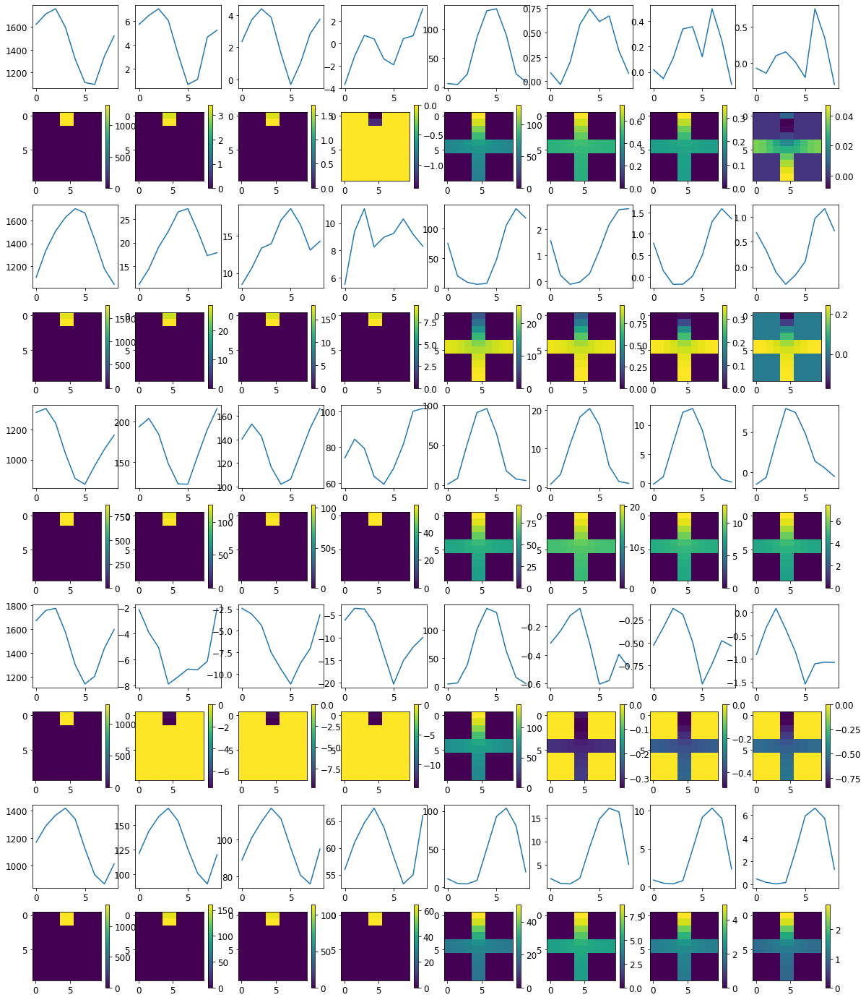

Loss: 


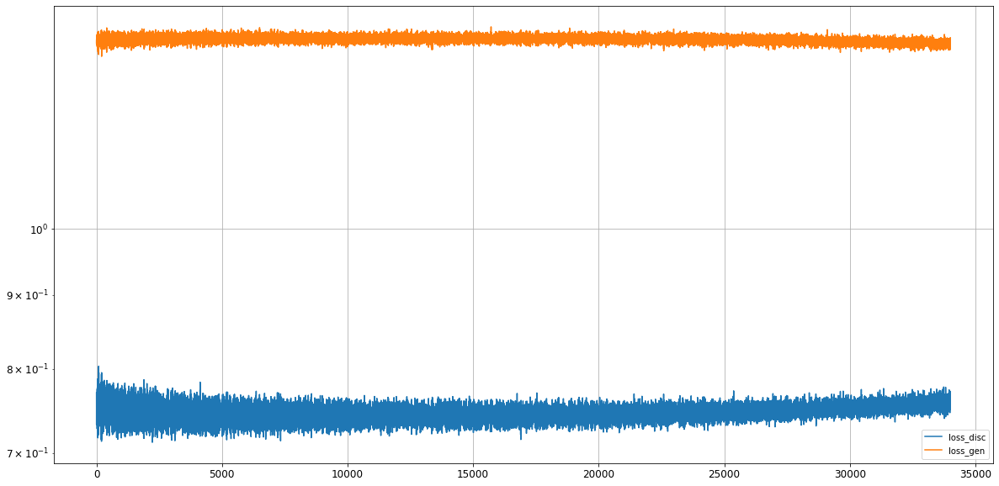

Epoch 34002/50000
discriminator loss: 1.346447 - generator loss: 0.761199 - 1s
Epoch 34003/50000
discriminator loss: 1.348857 - generator loss: 0.758959 - 1s
Epoch 34004/50000
discriminator loss: 1.342364 - generator loss: 0.757748 - 1s
Epoch 34005/50000
discriminator loss: 1.331267 - generator loss: 0.757197 - 1s
Epoch 34006/50000
discriminator loss: 1.333353 - generator loss: 0.760689 - 1s
Epoch 34007/50000
discriminator loss: 1.342480 - generator loss: 0.763902 - 1s
Epoch 34008/50000
discriminator loss: 1.343462 - generator loss: 0.758189 - 1s
Epoch 34009/50000
discriminator loss: 1.351204 - generator loss: 0.754504 - 1s
Epoch 34010/50000
discriminator loss: 1.345830 - generator loss: 0.758876 - 1s
Epoch 34011/50000
discriminator loss: 1.338194 - generator loss: 0.766458 - 1s
Epoch 34012/50000
discriminator loss: 1.332796 - generator loss: 0.767467 - 1s
Epoch 34013/50000
discriminator loss: 1.337804 - generator loss: 0.763306 - 1s
Epoch 34014/50000
discriminator loss: 1.352596 - gen

discriminator loss: 1.345558 - generator loss: 0.758528 - 1s
Epoch 34107/50000
discriminator loss: 1.347432 - generator loss: 0.754560 - 1s
Epoch 34108/50000
discriminator loss: 1.344505 - generator loss: 0.749986 - 1s
Epoch 34109/50000
discriminator loss: 1.340925 - generator loss: 0.763350 - 1s
Epoch 34110/50000
discriminator loss: 1.346529 - generator loss: 0.767463 - 1s
Epoch 34111/50000
discriminator loss: 1.341525 - generator loss: 0.763681 - 1s
Epoch 34112/50000
discriminator loss: 1.344803 - generator loss: 0.757064 - 1s
Epoch 34113/50000
discriminator loss: 1.342602 - generator loss: 0.757173 - 1s
Epoch 34114/50000
discriminator loss: 1.337423 - generator loss: 0.759457 - 1s
Epoch 34115/50000
discriminator loss: 1.348476 - generator loss: 0.750092 - 1s
Epoch 34116/50000
discriminator loss: 1.333736 - generator loss: 0.763804 - 1s
Epoch 34117/50000
discriminator loss: 1.347491 - generator loss: 0.754573 - 1s
Epoch 34118/50000
discriminator loss: 1.341690 - generator loss: 0.769

discriminator loss: 1.339676 - generator loss: 0.762100 - 1s
Epoch 34211/50000
discriminator loss: 1.337319 - generator loss: 0.763655 - 1s
Epoch 34212/50000
discriminator loss: 1.341486 - generator loss: 0.757217 - 1s
Epoch 34213/50000
discriminator loss: 1.336211 - generator loss: 0.767465 - 1s
Epoch 34214/50000
discriminator loss: 1.344060 - generator loss: 0.763883 - 1s
Epoch 34215/50000
discriminator loss: 1.323245 - generator loss: 0.766888 - 1s
Epoch 34216/50000
discriminator loss: 1.335137 - generator loss: 0.764703 - 1s
Epoch 34217/50000
discriminator loss: 1.339154 - generator loss: 0.763583 - 1s
Epoch 34218/50000
discriminator loss: 1.340030 - generator loss: 0.765023 - 1s
Epoch 34219/50000
discriminator loss: 1.353081 - generator loss: 0.752031 - 1s
Epoch 34220/50000
discriminator loss: 1.341268 - generator loss: 0.759880 - 1s
Epoch 34221/50000
discriminator loss: 1.347360 - generator loss: 0.748494 - 1s
Epoch 34222/50000
discriminator loss: 1.338956 - generator loss: 0.762

discriminator loss: 1.340617 - generator loss: 0.758606 - 1s
Epoch 34315/50000
discriminator loss: 1.344585 - generator loss: 0.755227 - 1s
Epoch 34316/50000
discriminator loss: 1.341741 - generator loss: 0.766172 - 1s
Epoch 34317/50000
discriminator loss: 1.340263 - generator loss: 0.761998 - 1s
Epoch 34318/50000
discriminator loss: 1.343687 - generator loss: 0.759445 - 1s
Epoch 34319/50000
discriminator loss: 1.340647 - generator loss: 0.760564 - 1s
Epoch 34320/50000
discriminator loss: 1.345143 - generator loss: 0.758280 - 1s
Epoch 34321/50000
discriminator loss: 1.344122 - generator loss: 0.754296 - 1s
Epoch 34322/50000
discriminator loss: 1.351649 - generator loss: 0.760310 - 1s
Epoch 34323/50000
discriminator loss: 1.334602 - generator loss: 0.766203 - 1s
Epoch 34324/50000
discriminator loss: 1.336107 - generator loss: 0.762591 - 1s
Epoch 34325/50000
discriminator loss: 1.351433 - generator loss: 0.752552 - 1s
Epoch 34326/50000
discriminator loss: 1.349388 - generator loss: 0.754

discriminator loss: 1.342063 - generator loss: 0.749138 - 1s
Epoch 34419/50000
discriminator loss: 1.344529 - generator loss: 0.757131 - 1s
Epoch 34420/50000
discriminator loss: 1.340971 - generator loss: 0.751279 - 1s
Epoch 34421/50000
discriminator loss: 1.349594 - generator loss: 0.755591 - 1s
Epoch 34422/50000
discriminator loss: 1.340244 - generator loss: 0.766796 - 1s
Epoch 34423/50000
discriminator loss: 1.345253 - generator loss: 0.759269 - 1s
Epoch 34424/50000
discriminator loss: 1.346253 - generator loss: 0.760699 - 1s
Epoch 34425/50000
discriminator loss: 1.347064 - generator loss: 0.755089 - 1s
Epoch 34426/50000
discriminator loss: 1.349469 - generator loss: 0.756288 - 1s
Epoch 34427/50000
discriminator loss: 1.346026 - generator loss: 0.748756 - 1s
Epoch 34428/50000
discriminator loss: 1.337237 - generator loss: 0.764191 - 1s
Epoch 34429/50000
discriminator loss: 1.346612 - generator loss: 0.760731 - 1s
Epoch 34430/50000
discriminator loss: 1.339761 - generator loss: 0.765

discriminator loss: 1.327593 - generator loss: 0.765459 - 1s
Epoch 34523/50000
discriminator loss: 1.344738 - generator loss: 0.756377 - 1s
Epoch 34524/50000
discriminator loss: 1.349363 - generator loss: 0.751678 - 1s
Epoch 34525/50000
discriminator loss: 1.344203 - generator loss: 0.757605 - 1s
Epoch 34526/50000
discriminator loss: 1.345264 - generator loss: 0.758187 - 1s
Epoch 34527/50000
discriminator loss: 1.349156 - generator loss: 0.756096 - 1s
Epoch 34528/50000
discriminator loss: 1.350766 - generator loss: 0.757807 - 1s
Epoch 34529/50000
discriminator loss: 1.346098 - generator loss: 0.761957 - 1s
Epoch 34530/50000
discriminator loss: 1.341454 - generator loss: 0.768740 - 1s
Epoch 34531/50000
discriminator loss: 1.341887 - generator loss: 0.751705 - 1s
Epoch 34532/50000
discriminator loss: 1.354601 - generator loss: 0.754439 - 1s
Epoch 34533/50000
discriminator loss: 1.350554 - generator loss: 0.754461 - 1s
Epoch 34534/50000
discriminator loss: 1.340312 - generator loss: 0.760

discriminator loss: 1.339824 - generator loss: 0.762498 - 1s
Epoch 34627/50000
discriminator loss: 1.338526 - generator loss: 0.771491 - 1s
Epoch 34628/50000
discriminator loss: 1.344460 - generator loss: 0.760389 - 1s
Epoch 34629/50000
discriminator loss: 1.337432 - generator loss: 0.763171 - 1s
Epoch 34630/50000
discriminator loss: 1.347628 - generator loss: 0.747864 - 1s
Epoch 34631/50000
discriminator loss: 1.347653 - generator loss: 0.748111 - 1s
Epoch 34632/50000
discriminator loss: 1.332515 - generator loss: 0.768497 - 1s
Epoch 34633/50000
discriminator loss: 1.344958 - generator loss: 0.764736 - 1s
Epoch 34634/50000
discriminator loss: 1.336114 - generator loss: 0.763952 - 1s
Epoch 34635/50000
discriminator loss: 1.349287 - generator loss: 0.745789 - 1s
Epoch 34636/50000
discriminator loss: 1.341653 - generator loss: 0.768417 - 1s
Epoch 34637/50000
discriminator loss: 1.342102 - generator loss: 0.753886 - 1s
Epoch 34638/50000
discriminator loss: 1.331179 - generator loss: 0.767

discriminator loss: 1.345069 - generator loss: 0.766813 - 1s
Epoch 34731/50000
discriminator loss: 1.348358 - generator loss: 0.757321 - 1s
Epoch 34732/50000
discriminator loss: 1.342011 - generator loss: 0.756465 - 1s
Epoch 34733/50000
discriminator loss: 1.334784 - generator loss: 0.765743 - 1s
Epoch 34734/50000
discriminator loss: 1.340219 - generator loss: 0.756727 - 1s
Epoch 34735/50000
discriminator loss: 1.337224 - generator loss: 0.767045 - 1s
Epoch 34736/50000
discriminator loss: 1.341313 - generator loss: 0.753062 - 1s
Epoch 34737/50000
discriminator loss: 1.332335 - generator loss: 0.768326 - 1s
Epoch 34738/50000
discriminator loss: 1.346029 - generator loss: 0.760402 - 1s
Epoch 34739/50000
discriminator loss: 1.329255 - generator loss: 0.772928 - 1s
Epoch 34740/50000
discriminator loss: 1.338493 - generator loss: 0.760466 - 1s
Epoch 34741/50000
discriminator loss: 1.349024 - generator loss: 0.751632 - 1s
Epoch 34742/50000
discriminator loss: 1.347232 - generator loss: 0.761

discriminator loss: 1.340080 - generator loss: 0.759501 - 1s
Epoch 34835/50000
discriminator loss: 1.351756 - generator loss: 0.754951 - 1s
Epoch 34836/50000
discriminator loss: 1.335061 - generator loss: 0.768532 - 1s
Epoch 34837/50000
discriminator loss: 1.346078 - generator loss: 0.758097 - 1s
Epoch 34838/50000
discriminator loss: 1.341999 - generator loss: 0.764735 - 1s
Epoch 34839/50000
discriminator loss: 1.333853 - generator loss: 0.773371 - 1s
Epoch 34840/50000
discriminator loss: 1.342972 - generator loss: 0.756625 - 1s
Epoch 34841/50000
discriminator loss: 1.343102 - generator loss: 0.756906 - 1s
Epoch 34842/50000
discriminator loss: 1.344554 - generator loss: 0.752281 - 1s
Epoch 34843/50000
discriminator loss: 1.346884 - generator loss: 0.755369 - 1s
Epoch 34844/50000
discriminator loss: 1.332725 - generator loss: 0.771117 - 1s
Epoch 34845/50000
discriminator loss: 1.337836 - generator loss: 0.762206 - 1s
Epoch 34846/50000
discriminator loss: 1.345041 - generator loss: 0.757

discriminator loss: 1.348403 - generator loss: 0.749563 - 1s
Epoch 34939/50000
discriminator loss: 1.344343 - generator loss: 0.759391 - 1s
Epoch 34940/50000
discriminator loss: 1.332647 - generator loss: 0.765670 - 1s
Epoch 34941/50000
discriminator loss: 1.342160 - generator loss: 0.766569 - 1s
Epoch 34942/50000
discriminator loss: 1.347808 - generator loss: 0.757420 - 1s
Epoch 34943/50000
discriminator loss: 1.335218 - generator loss: 0.763432 - 1s
Epoch 34944/50000
discriminator loss: 1.331940 - generator loss: 0.769643 - 1s
Epoch 34945/50000
discriminator loss: 1.341590 - generator loss: 0.759591 - 1s
Epoch 34946/50000
discriminator loss: 1.338766 - generator loss: 0.767648 - 1s
Epoch 34947/50000
discriminator loss: 1.335564 - generator loss: 0.763394 - 1s
Epoch 34948/50000
discriminator loss: 1.341910 - generator loss: 0.754744 - 1s
Epoch 34949/50000
discriminator loss: 1.346561 - generator loss: 0.762248 - 1s
Epoch 34950/50000
discriminator loss: 1.346163 - generator loss: 0.756

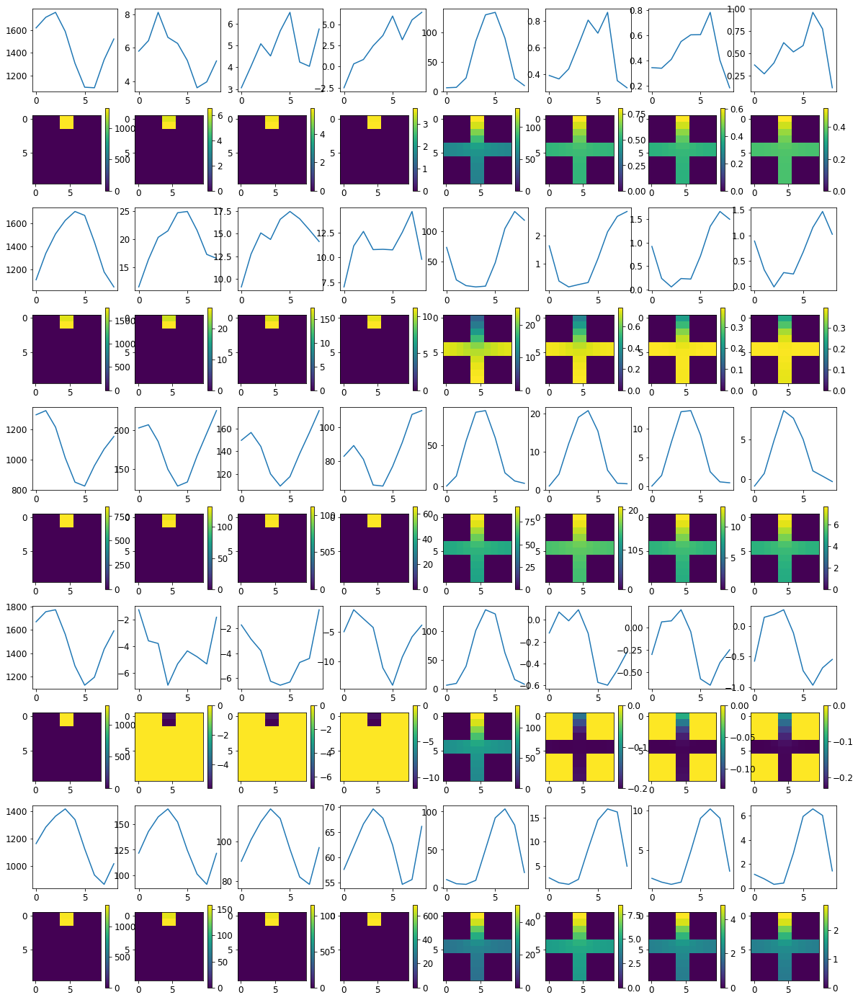

Loss: 


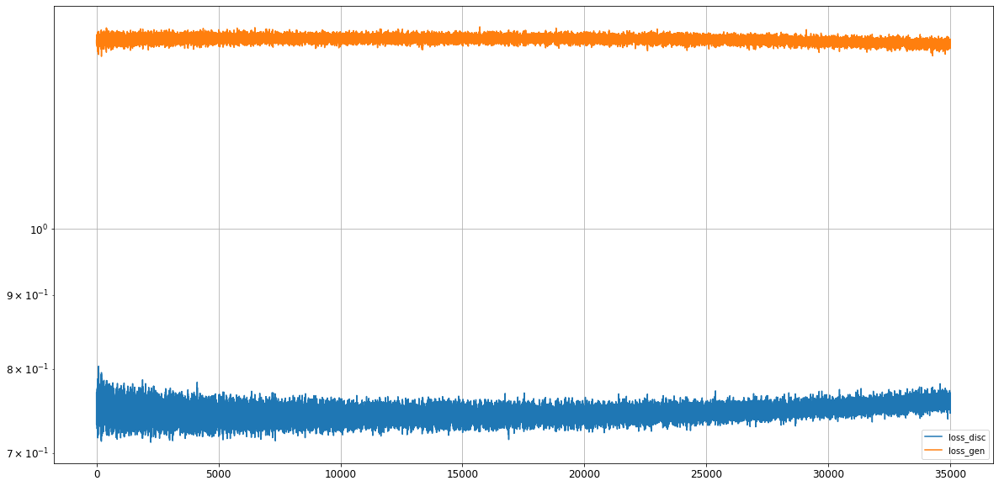

Epoch 35002/50000
discriminator loss: 1.334012 - generator loss: 0.758844 - 1s
Epoch 35003/50000
discriminator loss: 1.328112 - generator loss: 0.768170 - 1s
Epoch 35004/50000
discriminator loss: 1.346025 - generator loss: 0.758548 - 1s
Epoch 35005/50000
discriminator loss: 1.346022 - generator loss: 0.758439 - 1s
Epoch 35006/50000
discriminator loss: 1.338229 - generator loss: 0.766046 - 1s
Epoch 35007/50000
discriminator loss: 1.347902 - generator loss: 0.754105 - 1s
Epoch 35008/50000
discriminator loss: 1.342108 - generator loss: 0.758496 - 1s
Epoch 35009/50000
discriminator loss: 1.337867 - generator loss: 0.764719 - 1s
Epoch 35010/50000
discriminator loss: 1.338750 - generator loss: 0.757912 - 1s
Epoch 35011/50000
discriminator loss: 1.347511 - generator loss: 0.757589 - 1s
Epoch 35012/50000
discriminator loss: 1.344445 - generator loss: 0.763495 - 1s
Epoch 35013/50000
discriminator loss: 1.337268 - generator loss: 0.759002 - 1s
Epoch 35014/50000
discriminator loss: 1.330168 - gen

discriminator loss: 1.346620 - generator loss: 0.761881 - 1s
Epoch 35107/50000
discriminator loss: 1.346786 - generator loss: 0.755178 - 1s
Epoch 35108/50000
discriminator loss: 1.350366 - generator loss: 0.756937 - 1s
Epoch 35109/50000
discriminator loss: 1.344849 - generator loss: 0.755821 - 1s
Epoch 35110/50000
discriminator loss: 1.337078 - generator loss: 0.763905 - 1s
Epoch 35111/50000
discriminator loss: 1.342578 - generator loss: 0.757215 - 1s
Epoch 35112/50000
discriminator loss: 1.333734 - generator loss: 0.765234 - 1s
Epoch 35113/50000
discriminator loss: 1.338557 - generator loss: 0.768302 - 1s
Epoch 35114/50000
discriminator loss: 1.338109 - generator loss: 0.763996 - 1s
Epoch 35115/50000
discriminator loss: 1.354656 - generator loss: 0.755316 - 1s
Epoch 35116/50000
discriminator loss: 1.331927 - generator loss: 0.758905 - 1s
Epoch 35117/50000
discriminator loss: 1.348529 - generator loss: 0.757527 - 1s
Epoch 35118/50000
discriminator loss: 1.347267 - generator loss: 0.758

discriminator loss: 1.349892 - generator loss: 0.763861 - 1s
Epoch 35211/50000
discriminator loss: 1.343247 - generator loss: 0.756982 - 1s
Epoch 35212/50000
discriminator loss: 1.349846 - generator loss: 0.750539 - 1s
Epoch 35213/50000
discriminator loss: 1.335814 - generator loss: 0.765660 - 1s
Epoch 35214/50000
discriminator loss: 1.342502 - generator loss: 0.760307 - 1s
Epoch 35215/50000
discriminator loss: 1.343569 - generator loss: 0.762524 - 1s
Epoch 35216/50000
discriminator loss: 1.350910 - generator loss: 0.754546 - 1s
Epoch 35217/50000
discriminator loss: 1.345102 - generator loss: 0.757444 - 1s
Epoch 35218/50000
discriminator loss: 1.331567 - generator loss: 0.770816 - 1s
Epoch 35219/50000
discriminator loss: 1.345240 - generator loss: 0.761246 - 1s
Epoch 35220/50000
discriminator loss: 1.349601 - generator loss: 0.750093 - 1s
Epoch 35221/50000
discriminator loss: 1.348678 - generator loss: 0.760837 - 1s
Epoch 35222/50000
discriminator loss: 1.332480 - generator loss: 0.757

discriminator loss: 1.340896 - generator loss: 0.763155 - 1s
Epoch 35315/50000
discriminator loss: 1.337154 - generator loss: 0.757316 - 1s
Epoch 35316/50000
discriminator loss: 1.345984 - generator loss: 0.754665 - 1s
Epoch 35317/50000
discriminator loss: 1.343572 - generator loss: 0.765652 - 1s
Epoch 35318/50000
discriminator loss: 1.338481 - generator loss: 0.766736 - 1s
Epoch 35319/50000
discriminator loss: 1.343042 - generator loss: 0.755749 - 1s
Epoch 35320/50000
discriminator loss: 1.336895 - generator loss: 0.768291 - 1s
Epoch 35321/50000
discriminator loss: 1.343510 - generator loss: 0.756126 - 1s
Epoch 35322/50000
discriminator loss: 1.350897 - generator loss: 0.751283 - 1s
Epoch 35323/50000
discriminator loss: 1.343528 - generator loss: 0.759888 - 1s
Epoch 35324/50000
discriminator loss: 1.340233 - generator loss: 0.762612 - 1s
Epoch 35325/50000
discriminator loss: 1.341349 - generator loss: 0.768725 - 1s
Epoch 35326/50000
discriminator loss: 1.344897 - generator loss: 0.764

discriminator loss: 1.343588 - generator loss: 0.760945 - 1s
Epoch 35419/50000
discriminator loss: 1.347676 - generator loss: 0.752703 - 1s
Epoch 35420/50000
discriminator loss: 1.341528 - generator loss: 0.761428 - 1s
Epoch 35421/50000
discriminator loss: 1.340681 - generator loss: 0.762137 - 1s
Epoch 35422/50000
discriminator loss: 1.344846 - generator loss: 0.755354 - 1s
Epoch 35423/50000
discriminator loss: 1.335249 - generator loss: 0.766592 - 1s
Epoch 35424/50000
discriminator loss: 1.338357 - generator loss: 0.760544 - 1s
Epoch 35425/50000
discriminator loss: 1.343101 - generator loss: 0.759670 - 1s
Epoch 35426/50000
discriminator loss: 1.346485 - generator loss: 0.754438 - 1s
Epoch 35427/50000
discriminator loss: 1.352827 - generator loss: 0.757147 - 1s
Epoch 35428/50000
discriminator loss: 1.346794 - generator loss: 0.762452 - 1s
Epoch 35429/50000
discriminator loss: 1.341548 - generator loss: 0.754333 - 1s
Epoch 35430/50000
discriminator loss: 1.346080 - generator loss: 0.759

discriminator loss: 1.341475 - generator loss: 0.760028 - 1s
Epoch 35523/50000
discriminator loss: 1.334865 - generator loss: 0.771120 - 1s
Epoch 35524/50000
discriminator loss: 1.350946 - generator loss: 0.759048 - 1s
Epoch 35525/50000
discriminator loss: 1.350144 - generator loss: 0.753387 - 1s
Epoch 35526/50000
discriminator loss: 1.325936 - generator loss: 0.769306 - 1s
Epoch 35527/50000
discriminator loss: 1.336182 - generator loss: 0.760281 - 1s
Epoch 35528/50000
discriminator loss: 1.340793 - generator loss: 0.761998 - 1s
Epoch 35529/50000
discriminator loss: 1.355224 - generator loss: 0.753959 - 1s
Epoch 35530/50000
discriminator loss: 1.356340 - generator loss: 0.752426 - 1s
Epoch 35531/50000
discriminator loss: 1.334028 - generator loss: 0.761997 - 1s
Epoch 35532/50000
discriminator loss: 1.340340 - generator loss: 0.763824 - 1s
Epoch 35533/50000
discriminator loss: 1.340450 - generator loss: 0.762957 - 1s
Epoch 35534/50000
discriminator loss: 1.343838 - generator loss: 0.752

discriminator loss: 1.340190 - generator loss: 0.759562 - 1s
Epoch 35627/50000
discriminator loss: 1.327595 - generator loss: 0.767099 - 1s
Epoch 35628/50000
discriminator loss: 1.344234 - generator loss: 0.760279 - 1s
Epoch 35629/50000
discriminator loss: 1.344891 - generator loss: 0.764695 - 1s
Epoch 35630/50000
discriminator loss: 1.347942 - generator loss: 0.760407 - 1s
Epoch 35631/50000
discriminator loss: 1.346919 - generator loss: 0.755413 - 1s
Epoch 35632/50000
discriminator loss: 1.344343 - generator loss: 0.756563 - 1s
Epoch 35633/50000
discriminator loss: 1.342752 - generator loss: 0.757576 - 1s
Epoch 35634/50000
discriminator loss: 1.335708 - generator loss: 0.766310 - 1s
Epoch 35635/50000
discriminator loss: 1.343539 - generator loss: 0.761350 - 1s
Epoch 35636/50000
discriminator loss: 1.351122 - generator loss: 0.761023 - 1s
Epoch 35637/50000
discriminator loss: 1.345625 - generator loss: 0.751885 - 1s
Epoch 35638/50000
discriminator loss: 1.343879 - generator loss: 0.763

discriminator loss: 1.350079 - generator loss: 0.757286 - 1s
Epoch 35731/50000
discriminator loss: 1.338260 - generator loss: 0.760578 - 1s
Epoch 35732/50000
discriminator loss: 1.335270 - generator loss: 0.764519 - 1s
Epoch 35733/50000
discriminator loss: 1.345967 - generator loss: 0.763541 - 1s
Epoch 35734/50000
discriminator loss: 1.337530 - generator loss: 0.763017 - 1s
Epoch 35735/50000
discriminator loss: 1.342993 - generator loss: 0.757262 - 1s
Epoch 35736/50000
discriminator loss: 1.335737 - generator loss: 0.768240 - 1s
Epoch 35737/50000
discriminator loss: 1.344939 - generator loss: 0.753751 - 1s
Epoch 35738/50000
discriminator loss: 1.333979 - generator loss: 0.768441 - 1s
Epoch 35739/50000
discriminator loss: 1.338646 - generator loss: 0.757404 - 1s
Epoch 35740/50000
discriminator loss: 1.349095 - generator loss: 0.762854 - 1s
Epoch 35741/50000
discriminator loss: 1.342665 - generator loss: 0.762693 - 1s
Epoch 35742/50000
discriminator loss: 1.346874 - generator loss: 0.752

discriminator loss: 1.330907 - generator loss: 0.766823 - 1s
Epoch 35835/50000
discriminator loss: 1.336775 - generator loss: 0.758141 - 1s
Epoch 35836/50000
discriminator loss: 1.331993 - generator loss: 0.774529 - 1s
Epoch 35837/50000
discriminator loss: 1.325080 - generator loss: 0.762083 - 1s
Epoch 35838/50000
discriminator loss: 1.340349 - generator loss: 0.766448 - 1s
Epoch 35839/50000
discriminator loss: 1.339639 - generator loss: 0.764846 - 1s
Epoch 35840/50000
discriminator loss: 1.346835 - generator loss: 0.754587 - 1s
Epoch 35841/50000
discriminator loss: 1.347726 - generator loss: 0.756674 - 1s
Epoch 35842/50000
discriminator loss: 1.343178 - generator loss: 0.758865 - 1s
Epoch 35843/50000
discriminator loss: 1.340874 - generator loss: 0.765974 - 1s
Epoch 35844/50000
discriminator loss: 1.335854 - generator loss: 0.765055 - 1s
Epoch 35845/50000
discriminator loss: 1.336155 - generator loss: 0.767224 - 1s
Epoch 35846/50000
discriminator loss: 1.341076 - generator loss: 0.757

discriminator loss: 1.352594 - generator loss: 0.751312 - 1s
Epoch 35939/50000
discriminator loss: 1.343867 - generator loss: 0.761840 - 1s
Epoch 35940/50000
discriminator loss: 1.337819 - generator loss: 0.768113 - 1s
Epoch 35941/50000
discriminator loss: 1.343512 - generator loss: 0.763576 - 1s
Epoch 35942/50000
discriminator loss: 1.352100 - generator loss: 0.752938 - 1s
Epoch 35943/50000
discriminator loss: 1.341895 - generator loss: 0.756357 - 1s
Epoch 35944/50000
discriminator loss: 1.347451 - generator loss: 0.759014 - 1s
Epoch 35945/50000
discriminator loss: 1.343945 - generator loss: 0.758990 - 1s
Epoch 35946/50000
discriminator loss: 1.341206 - generator loss: 0.767935 - 1s
Epoch 35947/50000
discriminator loss: 1.338527 - generator loss: 0.762008 - 1s
Epoch 35948/50000
discriminator loss: 1.335014 - generator loss: 0.760596 - 1s
Epoch 35949/50000
discriminator loss: 1.336310 - generator loss: 0.766543 - 1s
Epoch 35950/50000
discriminator loss: 1.344368 - generator loss: 0.760

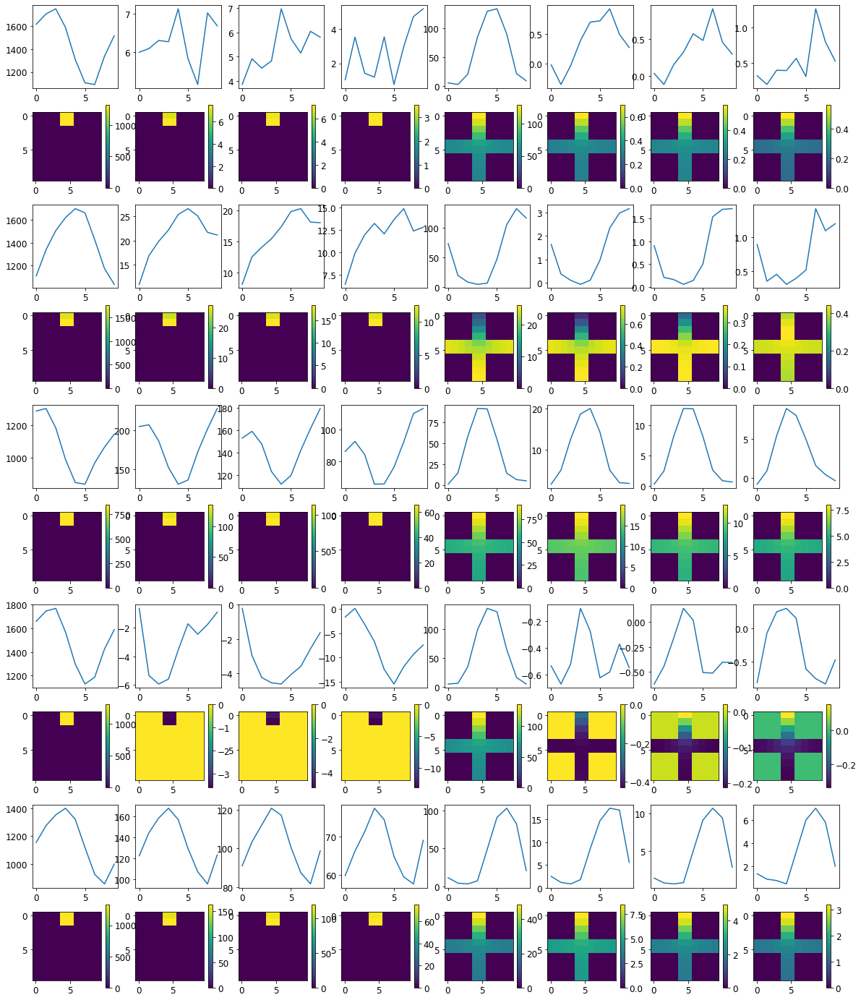

Loss: 


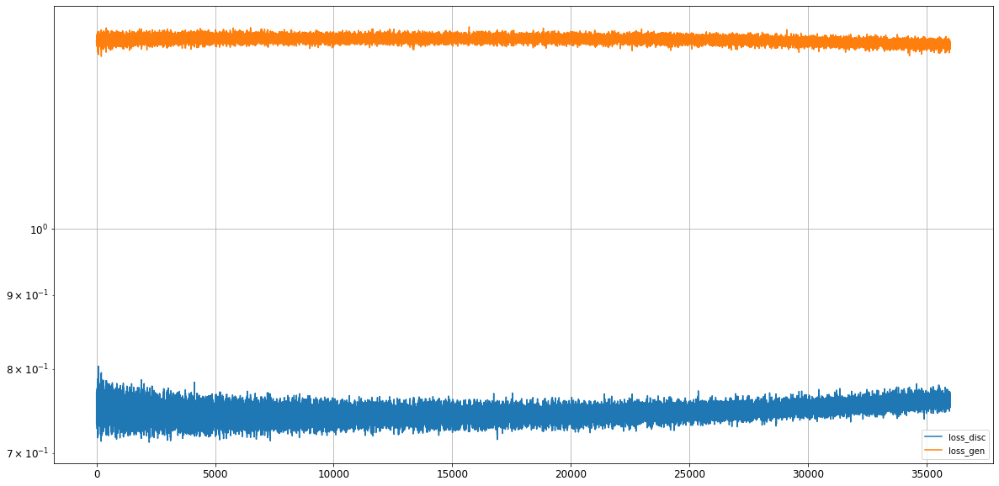

Epoch 36002/50000
discriminator loss: 1.349443 - generator loss: 0.754534 - 1s
Epoch 36003/50000
discriminator loss: 1.334422 - generator loss: 0.766907 - 1s
Epoch 36004/50000
discriminator loss: 1.342587 - generator loss: 0.762070 - 1s
Epoch 36005/50000
discriminator loss: 1.342057 - generator loss: 0.759031 - 1s
Epoch 36006/50000
discriminator loss: 1.339220 - generator loss: 0.761750 - 1s
Epoch 36007/50000
discriminator loss: 1.332371 - generator loss: 0.765898 - 1s
Epoch 36008/50000
discriminator loss: 1.332988 - generator loss: 0.772597 - 1s
Epoch 36009/50000
discriminator loss: 1.346672 - generator loss: 0.758464 - 1s
Epoch 36010/50000
discriminator loss: 1.333836 - generator loss: 0.765324 - 1s
Epoch 36011/50000
discriminator loss: 1.340523 - generator loss: 0.761183 - 1s
Epoch 36012/50000
discriminator loss: 1.338484 - generator loss: 0.761197 - 1s
Epoch 36013/50000
discriminator loss: 1.345258 - generator loss: 0.758310 - 1s
Epoch 36014/50000
discriminator loss: 1.345094 - gen

discriminator loss: 1.329526 - generator loss: 0.766644 - 1s
Epoch 36107/50000
discriminator loss: 1.347082 - generator loss: 0.758180 - 1s
Epoch 36108/50000
discriminator loss: 1.339715 - generator loss: 0.773368 - 1s
Epoch 36109/50000
discriminator loss: 1.344406 - generator loss: 0.761073 - 1s
Epoch 36110/50000
discriminator loss: 1.345758 - generator loss: 0.754392 - 1s
Epoch 36111/50000
discriminator loss: 1.342112 - generator loss: 0.764408 - 1s
Epoch 36112/50000
discriminator loss: 1.350892 - generator loss: 0.754209 - 1s
Epoch 36113/50000
discriminator loss: 1.341165 - generator loss: 0.762600 - 1s
Epoch 36114/50000
discriminator loss: 1.344951 - generator loss: 0.761246 - 1s
Epoch 36115/50000
discriminator loss: 1.337119 - generator loss: 0.763403 - 1s
Epoch 36116/50000
discriminator loss: 1.335297 - generator loss: 0.772104 - 1s
Epoch 36117/50000
discriminator loss: 1.327498 - generator loss: 0.770396 - 1s
Epoch 36118/50000
discriminator loss: 1.335496 - generator loss: 0.765

discriminator loss: 1.344990 - generator loss: 0.756477 - 1s
Epoch 36211/50000
discriminator loss: 1.349303 - generator loss: 0.752150 - 1s
Epoch 36212/50000
discriminator loss: 1.339908 - generator loss: 0.759657 - 1s
Epoch 36213/50000
discriminator loss: 1.339397 - generator loss: 0.751924 - 1s
Epoch 36214/50000
discriminator loss: 1.349295 - generator loss: 0.759911 - 1s
Epoch 36215/50000
discriminator loss: 1.344499 - generator loss: 0.771136 - 1s
Epoch 36216/50000
discriminator loss: 1.338911 - generator loss: 0.765260 - 1s
Epoch 36217/50000
discriminator loss: 1.346377 - generator loss: 0.765882 - 1s
Epoch 36218/50000
discriminator loss: 1.346815 - generator loss: 0.753871 - 1s
Epoch 36219/50000
discriminator loss: 1.339610 - generator loss: 0.757278 - 1s
Epoch 36220/50000
discriminator loss: 1.345020 - generator loss: 0.756983 - 1s
Epoch 36221/50000
discriminator loss: 1.351447 - generator loss: 0.755470 - 1s
Epoch 36222/50000
discriminator loss: 1.342851 - generator loss: 0.762

discriminator loss: 1.334976 - generator loss: 0.770747 - 1s
Epoch 36315/50000
discriminator loss: 1.328737 - generator loss: 0.764372 - 1s
Epoch 36316/50000
discriminator loss: 1.340033 - generator loss: 0.767751 - 1s
Epoch 36317/50000
discriminator loss: 1.339714 - generator loss: 0.765999 - 1s
Epoch 36318/50000
discriminator loss: 1.342141 - generator loss: 0.763997 - 1s
Epoch 36319/50000
discriminator loss: 1.350554 - generator loss: 0.759637 - 1s
Epoch 36320/50000
discriminator loss: 1.335059 - generator loss: 0.756997 - 1s
Epoch 36321/50000
discriminator loss: 1.331079 - generator loss: 0.765225 - 1s
Epoch 36322/50000
discriminator loss: 1.343994 - generator loss: 0.765663 - 1s
Epoch 36323/50000
discriminator loss: 1.332373 - generator loss: 0.772706 - 1s
Epoch 36324/50000
discriminator loss: 1.339221 - generator loss: 0.759583 - 1s
Epoch 36325/50000
discriminator loss: 1.338720 - generator loss: 0.766815 - 1s
Epoch 36326/50000
discriminator loss: 1.341546 - generator loss: 0.764

discriminator loss: 1.338419 - generator loss: 0.755683 - 1s
Epoch 36419/50000
discriminator loss: 1.346487 - generator loss: 0.768708 - 1s
Epoch 36420/50000
discriminator loss: 1.343660 - generator loss: 0.759850 - 1s
Epoch 36421/50000
discriminator loss: 1.339502 - generator loss: 0.762811 - 1s
Epoch 36422/50000
discriminator loss: 1.337919 - generator loss: 0.767236 - 1s
Epoch 36423/50000
discriminator loss: 1.336494 - generator loss: 0.768263 - 1s
Epoch 36424/50000
discriminator loss: 1.342857 - generator loss: 0.760814 - 1s
Epoch 36425/50000
discriminator loss: 1.347744 - generator loss: 0.755712 - 1s
Epoch 36426/50000
discriminator loss: 1.339310 - generator loss: 0.755838 - 1s
Epoch 36427/50000
discriminator loss: 1.343071 - generator loss: 0.765177 - 1s
Epoch 36428/50000
discriminator loss: 1.340039 - generator loss: 0.766256 - 1s
Epoch 36429/50000
discriminator loss: 1.333603 - generator loss: 0.766204 - 1s
Epoch 36430/50000
discriminator loss: 1.332541 - generator loss: 0.770

discriminator loss: 1.340052 - generator loss: 0.765814 - 1s
Epoch 36523/50000
discriminator loss: 1.348254 - generator loss: 0.754000 - 1s
Epoch 36524/50000
discriminator loss: 1.340703 - generator loss: 0.763486 - 1s
Epoch 36525/50000
discriminator loss: 1.348794 - generator loss: 0.760784 - 1s
Epoch 36526/50000
discriminator loss: 1.346110 - generator loss: 0.766353 - 1s
Epoch 36527/50000
discriminator loss: 1.346767 - generator loss: 0.750204 - 1s
Epoch 36528/50000
discriminator loss: 1.345849 - generator loss: 0.753749 - 1s
Epoch 36529/50000
discriminator loss: 1.355301 - generator loss: 0.757121 - 1s
Epoch 36530/50000
discriminator loss: 1.341623 - generator loss: 0.768420 - 1s
Epoch 36531/50000
discriminator loss: 1.335068 - generator loss: 0.768979 - 1s
Epoch 36532/50000
discriminator loss: 1.342070 - generator loss: 0.765308 - 1s
Epoch 36533/50000
discriminator loss: 1.340256 - generator loss: 0.761133 - 1s
Epoch 36534/50000
discriminator loss: 1.346413 - generator loss: 0.751

discriminator loss: 1.341314 - generator loss: 0.756509 - 1s
Epoch 36627/50000
discriminator loss: 1.341818 - generator loss: 0.754850 - 1s
Epoch 36628/50000
discriminator loss: 1.338066 - generator loss: 0.766762 - 1s
Epoch 36629/50000
discriminator loss: 1.335963 - generator loss: 0.762055 - 1s
Epoch 36630/50000
discriminator loss: 1.347301 - generator loss: 0.758081 - 1s
Epoch 36631/50000
discriminator loss: 1.348065 - generator loss: 0.760184 - 1s
Epoch 36632/50000
discriminator loss: 1.342266 - generator loss: 0.756954 - 1s
Epoch 36633/50000
discriminator loss: 1.334885 - generator loss: 0.770870 - 1s
Epoch 36634/50000
discriminator loss: 1.335223 - generator loss: 0.772904 - 1s
Epoch 36635/50000
discriminator loss: 1.330869 - generator loss: 0.759773 - 1s
Epoch 36636/50000
discriminator loss: 1.344264 - generator loss: 0.766430 - 1s
Epoch 36637/50000
discriminator loss: 1.343174 - generator loss: 0.757453 - 1s
Epoch 36638/50000
discriminator loss: 1.326340 - generator loss: 0.770

discriminator loss: 1.334864 - generator loss: 0.767345 - 1s
Epoch 36731/50000
discriminator loss: 1.334108 - generator loss: 0.769111 - 1s
Epoch 36732/50000
discriminator loss: 1.346621 - generator loss: 0.759588 - 1s
Epoch 36733/50000
discriminator loss: 1.330616 - generator loss: 0.761271 - 1s
Epoch 36734/50000
discriminator loss: 1.349199 - generator loss: 0.750298 - 1s
Epoch 36735/50000
discriminator loss: 1.336081 - generator loss: 0.763435 - 1s
Epoch 36736/50000
discriminator loss: 1.341238 - generator loss: 0.764036 - 1s
Epoch 36737/50000
discriminator loss: 1.332302 - generator loss: 0.768245 - 1s
Epoch 36738/50000
discriminator loss: 1.336910 - generator loss: 0.769203 - 1s
Epoch 36739/50000
discriminator loss: 1.332769 - generator loss: 0.764065 - 1s
Epoch 36740/50000
discriminator loss: 1.345522 - generator loss: 0.758253 - 1s
Epoch 36741/50000
discriminator loss: 1.338961 - generator loss: 0.760508 - 1s
Epoch 36742/50000
discriminator loss: 1.342300 - generator loss: 0.762

discriminator loss: 1.329390 - generator loss: 0.777894 - 1s
Epoch 36835/50000
discriminator loss: 1.333563 - generator loss: 0.770771 - 1s
Epoch 36836/50000
discriminator loss: 1.345793 - generator loss: 0.762387 - 1s
Epoch 36837/50000
discriminator loss: 1.327848 - generator loss: 0.770865 - 1s
Epoch 36838/50000
discriminator loss: 1.338290 - generator loss: 0.762149 - 1s
Epoch 36839/50000
discriminator loss: 1.331173 - generator loss: 0.774697 - 1s
Epoch 36840/50000
discriminator loss: 1.344707 - generator loss: 0.755424 - 1s
Epoch 36841/50000
discriminator loss: 1.345884 - generator loss: 0.759548 - 1s
Epoch 36842/50000
discriminator loss: 1.333555 - generator loss: 0.775579 - 1s
Epoch 36843/50000
discriminator loss: 1.348280 - generator loss: 0.758208 - 1s
Epoch 36844/50000
discriminator loss: 1.338514 - generator loss: 0.772600 - 1s
Epoch 36845/50000
discriminator loss: 1.345877 - generator loss: 0.750913 - 1s
Epoch 36846/50000
discriminator loss: 1.337734 - generator loss: 0.761

discriminator loss: 1.338753 - generator loss: 0.766514 - 1s
Epoch 36939/50000
discriminator loss: 1.344871 - generator loss: 0.759519 - 1s
Epoch 36940/50000
discriminator loss: 1.352499 - generator loss: 0.756823 - 1s
Epoch 36941/50000
discriminator loss: 1.339644 - generator loss: 0.760848 - 1s
Epoch 36942/50000
discriminator loss: 1.328846 - generator loss: 0.757408 - 1s
Epoch 36943/50000
discriminator loss: 1.334154 - generator loss: 0.772227 - 1s
Epoch 36944/50000
discriminator loss: 1.345309 - generator loss: 0.765375 - 1s
Epoch 36945/50000
discriminator loss: 1.341359 - generator loss: 0.765269 - 1s
Epoch 36946/50000
discriminator loss: 1.333642 - generator loss: 0.768514 - 1s
Epoch 36947/50000
discriminator loss: 1.338251 - generator loss: 0.763426 - 1s
Epoch 36948/50000
discriminator loss: 1.340087 - generator loss: 0.755849 - 1s
Epoch 36949/50000
discriminator loss: 1.351651 - generator loss: 0.758535 - 1s
Epoch 36950/50000
discriminator loss: 1.336052 - generator loss: 0.761

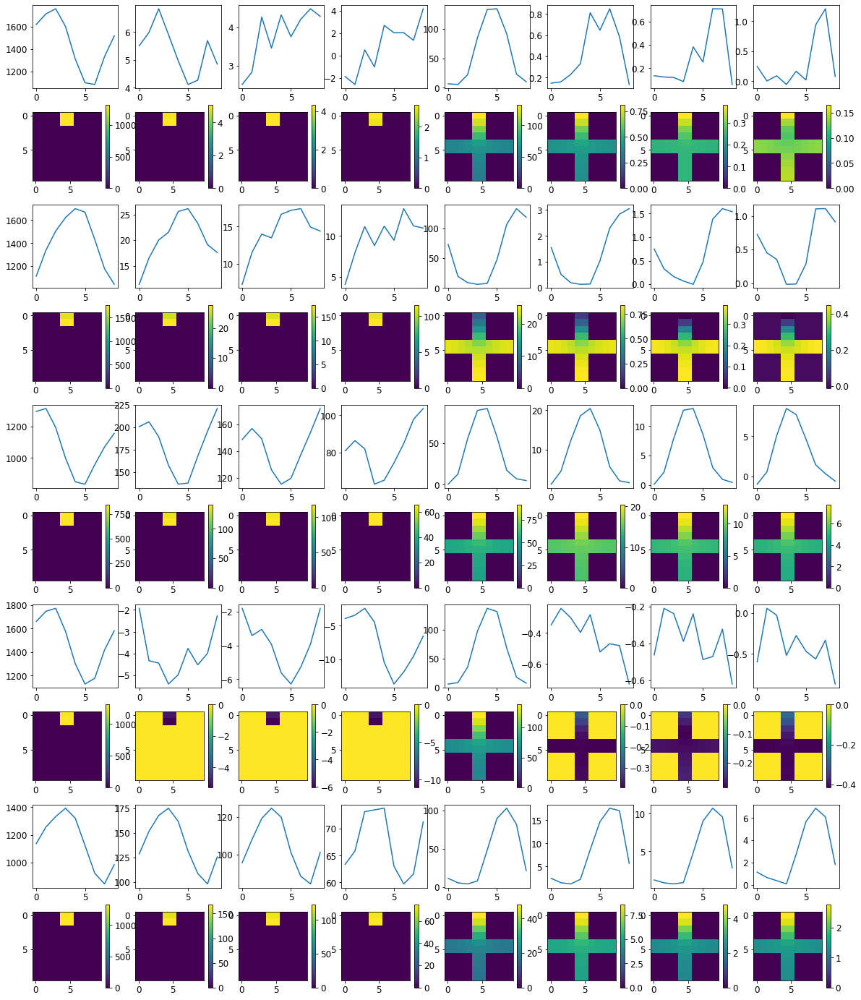

Loss: 


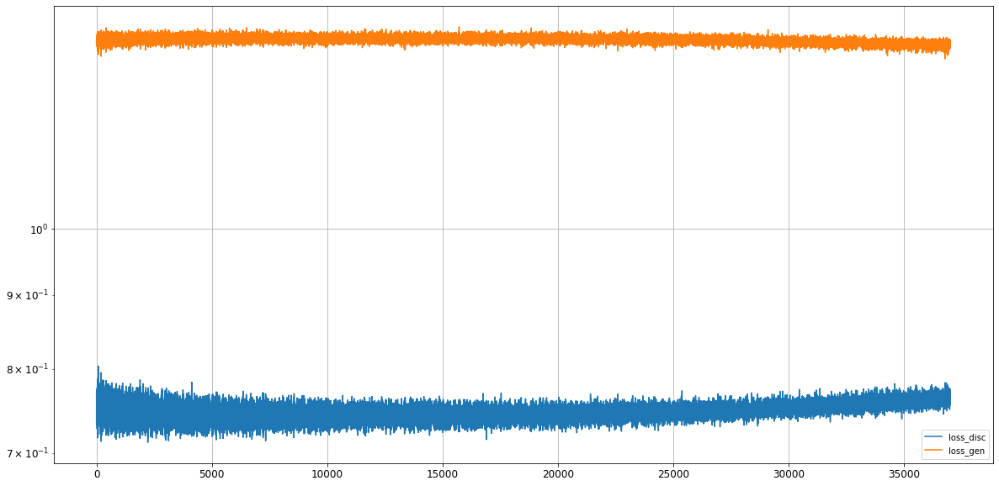

Epoch 37002/50000
discriminator loss: 1.350378 - generator loss: 0.754658 - 1s
Epoch 37003/50000
discriminator loss: 1.349998 - generator loss: 0.752227 - 1s
Epoch 37004/50000
discriminator loss: 1.337517 - generator loss: 0.770908 - 1s
Epoch 37005/50000
discriminator loss: 1.350406 - generator loss: 0.754656 - 1s
Epoch 37006/50000
discriminator loss: 1.336619 - generator loss: 0.767847 - 1s
Epoch 37007/50000
discriminator loss: 1.351041 - generator loss: 0.756681 - 1s
Epoch 37008/50000
discriminator loss: 1.339461 - generator loss: 0.762865 - 1s
Epoch 37009/50000
discriminator loss: 1.342003 - generator loss: 0.760067 - 1s
Epoch 37010/50000
discriminator loss: 1.346327 - generator loss: 0.765701 - 1s
Epoch 37011/50000
discriminator loss: 1.346013 - generator loss: 0.765511 - 1s
Epoch 37012/50000
discriminator loss: 1.339264 - generator loss: 0.757848 - 1s
Epoch 37013/50000
discriminator loss: 1.333294 - generator loss: 0.759533 - 1s
Epoch 37014/50000
discriminator loss: 1.346477 - gen

discriminator loss: 1.342263 - generator loss: 0.757168 - 1s
Epoch 37107/50000
discriminator loss: 1.335966 - generator loss: 0.766894 - 1s
Epoch 37108/50000
discriminator loss: 1.338010 - generator loss: 0.767848 - 1s
Epoch 37109/50000
discriminator loss: 1.338024 - generator loss: 0.763394 - 1s
Epoch 37110/50000
discriminator loss: 1.351640 - generator loss: 0.749055 - 1s
Epoch 37111/50000
discriminator loss: 1.344336 - generator loss: 0.759831 - 1s
Epoch 37112/50000
discriminator loss: 1.333048 - generator loss: 0.766727 - 1s
Epoch 37113/50000
discriminator loss: 1.340453 - generator loss: 0.766452 - 1s
Epoch 37114/50000
discriminator loss: 1.334563 - generator loss: 0.771032 - 1s
Epoch 37115/50000
discriminator loss: 1.334944 - generator loss: 0.764188 - 1s
Epoch 37116/50000
discriminator loss: 1.343665 - generator loss: 0.759074 - 1s
Epoch 37117/50000
discriminator loss: 1.335585 - generator loss: 0.770712 - 1s
Epoch 37118/50000
discriminator loss: 1.343876 - generator loss: 0.757

discriminator loss: 1.335709 - generator loss: 0.771217 - 1s
Epoch 37211/50000
discriminator loss: 1.339440 - generator loss: 0.768849 - 1s
Epoch 37212/50000
discriminator loss: 1.336998 - generator loss: 0.765411 - 1s
Epoch 37213/50000
discriminator loss: 1.340680 - generator loss: 0.765978 - 1s
Epoch 37214/50000
discriminator loss: 1.339101 - generator loss: 0.766517 - 1s
Epoch 37215/50000
discriminator loss: 1.341705 - generator loss: 0.760540 - 1s
Epoch 37216/50000
discriminator loss: 1.328803 - generator loss: 0.764970 - 1s
Epoch 37217/50000
discriminator loss: 1.347640 - generator loss: 0.759006 - 1s
Epoch 37218/50000
discriminator loss: 1.335275 - generator loss: 0.768397 - 1s
Epoch 37219/50000
discriminator loss: 1.337405 - generator loss: 0.768531 - 1s
Epoch 37220/50000
discriminator loss: 1.348784 - generator loss: 0.759318 - 1s
Epoch 37221/50000
discriminator loss: 1.343272 - generator loss: 0.767398 - 1s
Epoch 37222/50000
discriminator loss: 1.341316 - generator loss: 0.765

discriminator loss: 1.354455 - generator loss: 0.758721 - 1s
Epoch 37315/50000
discriminator loss: 1.331569 - generator loss: 0.775760 - 1s
Epoch 37316/50000
discriminator loss: 1.336588 - generator loss: 0.767674 - 1s
Epoch 37317/50000
discriminator loss: 1.341334 - generator loss: 0.758876 - 1s
Epoch 37318/50000
discriminator loss: 1.328439 - generator loss: 0.768072 - 1s
Epoch 37319/50000
discriminator loss: 1.336976 - generator loss: 0.766821 - 1s
Epoch 37320/50000
discriminator loss: 1.333027 - generator loss: 0.771902 - 1s
Epoch 37321/50000
discriminator loss: 1.337412 - generator loss: 0.766894 - 1s
Epoch 37322/50000
discriminator loss: 1.340444 - generator loss: 0.766122 - 1s
Epoch 37323/50000
discriminator loss: 1.332352 - generator loss: 0.771702 - 1s
Epoch 37324/50000
discriminator loss: 1.333418 - generator loss: 0.766606 - 1s
Epoch 37325/50000
discriminator loss: 1.327735 - generator loss: 0.767672 - 1s
Epoch 37326/50000
discriminator loss: 1.335338 - generator loss: 0.765

discriminator loss: 1.345001 - generator loss: 0.754844 - 1s
Epoch 37419/50000
discriminator loss: 1.345047 - generator loss: 0.762758 - 1s
Epoch 37420/50000
discriminator loss: 1.342246 - generator loss: 0.758537 - 1s
Epoch 37421/50000
discriminator loss: 1.340612 - generator loss: 0.762035 - 1s
Epoch 37422/50000
discriminator loss: 1.351977 - generator loss: 0.758430 - 1s
Epoch 37423/50000
discriminator loss: 1.340721 - generator loss: 0.769354 - 1s
Epoch 37424/50000
discriminator loss: 1.342834 - generator loss: 0.762912 - 1s
Epoch 37425/50000
discriminator loss: 1.339434 - generator loss: 0.762202 - 1s
Epoch 37426/50000
discriminator loss: 1.337303 - generator loss: 0.766158 - 1s
Epoch 37427/50000
discriminator loss: 1.337721 - generator loss: 0.765620 - 1s
Epoch 37428/50000
discriminator loss: 1.336069 - generator loss: 0.768617 - 1s
Epoch 37429/50000
discriminator loss: 1.335465 - generator loss: 0.766878 - 1s
Epoch 37430/50000
discriminator loss: 1.335825 - generator loss: 0.761

discriminator loss: 1.335534 - generator loss: 0.764595 - 1s
Epoch 37523/50000
discriminator loss: 1.336039 - generator loss: 0.759134 - 1s
Epoch 37524/50000
discriminator loss: 1.325690 - generator loss: 0.775502 - 1s
Epoch 37525/50000
discriminator loss: 1.347056 - generator loss: 0.762092 - 1s
Epoch 37526/50000
discriminator loss: 1.338853 - generator loss: 0.769217 - 1s
Epoch 37527/50000
discriminator loss: 1.344177 - generator loss: 0.766708 - 1s
Epoch 37528/50000
discriminator loss: 1.350734 - generator loss: 0.757267 - 1s
Epoch 37529/50000
discriminator loss: 1.315947 - generator loss: 0.780052 - 1s
Epoch 37530/50000
discriminator loss: 1.348725 - generator loss: 0.762091 - 1s
Epoch 37531/50000
discriminator loss: 1.345947 - generator loss: 0.758960 - 1s
Epoch 37532/50000
discriminator loss: 1.339901 - generator loss: 0.766892 - 1s
Epoch 37533/50000
discriminator loss: 1.333565 - generator loss: 0.768444 - 1s
Epoch 37534/50000
discriminator loss: 1.337984 - generator loss: 0.767

discriminator loss: 1.344706 - generator loss: 0.761438 - 1s
Epoch 37627/50000
discriminator loss: 1.332033 - generator loss: 0.777169 - 1s
Epoch 37628/50000
discriminator loss: 1.339589 - generator loss: 0.761905 - 1s
Epoch 37629/50000
discriminator loss: 1.336990 - generator loss: 0.761895 - 1s
Epoch 37630/50000
discriminator loss: 1.335350 - generator loss: 0.761382 - 1s
Epoch 37631/50000
discriminator loss: 1.335140 - generator loss: 0.756688 - 1s
Epoch 37632/50000
discriminator loss: 1.325601 - generator loss: 0.775793 - 1s
Epoch 37633/50000
discriminator loss: 1.332946 - generator loss: 0.774818 - 1s
Epoch 37634/50000
discriminator loss: 1.326351 - generator loss: 0.783205 - 1s
Epoch 37635/50000
discriminator loss: 1.322144 - generator loss: 0.782038 - 1s
Epoch 37636/50000
discriminator loss: 1.338060 - generator loss: 0.766648 - 1s
Epoch 37637/50000
discriminator loss: 1.344432 - generator loss: 0.759815 - 1s
Epoch 37638/50000
discriminator loss: 1.342883 - generator loss: 0.751

discriminator loss: 1.339340 - generator loss: 0.776158 - 1s
Epoch 37731/50000
discriminator loss: 1.337475 - generator loss: 0.762702 - 1s
Epoch 37732/50000
discriminator loss: 1.340331 - generator loss: 0.759232 - 1s
Epoch 37733/50000
discriminator loss: 1.337541 - generator loss: 0.768803 - 1s
Epoch 37734/50000
discriminator loss: 1.337180 - generator loss: 0.769280 - 1s
Epoch 37735/50000
discriminator loss: 1.340069 - generator loss: 0.765781 - 1s
Epoch 37736/50000
discriminator loss: 1.325821 - generator loss: 0.771038 - 1s
Epoch 37737/50000
discriminator loss: 1.347724 - generator loss: 0.753497 - 1s
Epoch 37738/50000
discriminator loss: 1.343433 - generator loss: 0.764880 - 1s
Epoch 37739/50000
discriminator loss: 1.356684 - generator loss: 0.756965 - 1s
Epoch 37740/50000
discriminator loss: 1.348926 - generator loss: 0.764601 - 1s
Epoch 37741/50000
discriminator loss: 1.343257 - generator loss: 0.757152 - 1s
Epoch 37742/50000
discriminator loss: 1.336920 - generator loss: 0.766

discriminator loss: 1.353059 - generator loss: 0.751199 - 1s
Epoch 37835/50000
discriminator loss: 1.335690 - generator loss: 0.761443 - 1s
Epoch 37836/50000
discriminator loss: 1.340936 - generator loss: 0.767444 - 1s
Epoch 37837/50000
discriminator loss: 1.348331 - generator loss: 0.764844 - 1s
Epoch 37838/50000
discriminator loss: 1.332326 - generator loss: 0.770812 - 1s
Epoch 37839/50000
discriminator loss: 1.337739 - generator loss: 0.766369 - 1s
Epoch 37840/50000
discriminator loss: 1.339735 - generator loss: 0.762520 - 1s
Epoch 37841/50000
discriminator loss: 1.337997 - generator loss: 0.761732 - 1s
Epoch 37842/50000
discriminator loss: 1.337587 - generator loss: 0.764740 - 1s
Epoch 37843/50000
discriminator loss: 1.349250 - generator loss: 0.759055 - 1s
Epoch 37844/50000
discriminator loss: 1.340758 - generator loss: 0.765775 - 1s
Epoch 37845/50000
discriminator loss: 1.339446 - generator loss: 0.774545 - 1s
Epoch 37846/50000
discriminator loss: 1.331697 - generator loss: 0.764

discriminator loss: 1.340032 - generator loss: 0.770413 - 1s
Epoch 37939/50000
discriminator loss: 1.344642 - generator loss: 0.757535 - 1s
Epoch 37940/50000
discriminator loss: 1.345126 - generator loss: 0.759714 - 1s
Epoch 37941/50000
discriminator loss: 1.348224 - generator loss: 0.759499 - 1s
Epoch 37942/50000
discriminator loss: 1.342398 - generator loss: 0.764304 - 1s
Epoch 37943/50000
discriminator loss: 1.339685 - generator loss: 0.766757 - 1s
Epoch 37944/50000
discriminator loss: 1.334641 - generator loss: 0.762189 - 1s
Epoch 37945/50000
discriminator loss: 1.336094 - generator loss: 0.763951 - 1s
Epoch 37946/50000
discriminator loss: 1.344585 - generator loss: 0.762115 - 1s
Epoch 37947/50000
discriminator loss: 1.338062 - generator loss: 0.767895 - 1s
Epoch 37948/50000
discriminator loss: 1.330137 - generator loss: 0.775663 - 1s
Epoch 37949/50000
discriminator loss: 1.340049 - generator loss: 0.760132 - 1s
Epoch 37950/50000
discriminator loss: 1.333393 - generator loss: 0.770

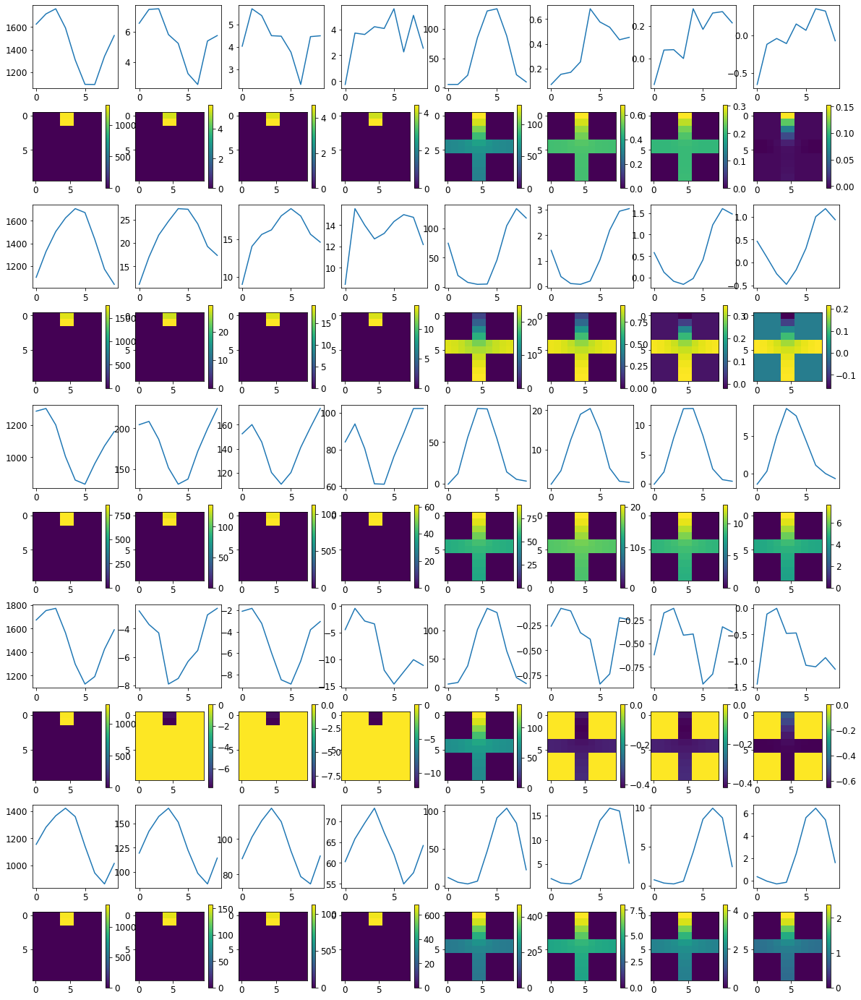

Loss: 


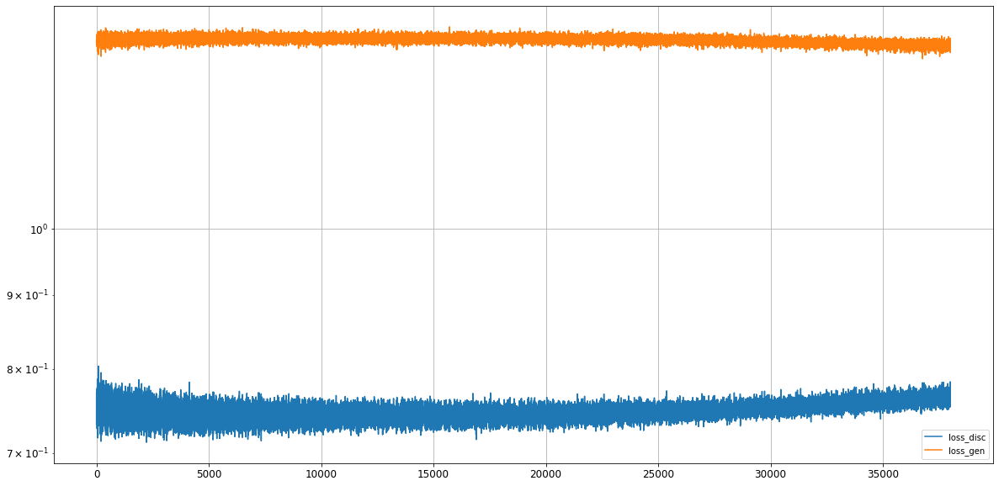

Epoch 38002/50000
discriminator loss: 1.342356 - generator loss: 0.766041 - 1s
Epoch 38003/50000
discriminator loss: 1.343319 - generator loss: 0.763146 - 1s
Epoch 38004/50000
discriminator loss: 1.339199 - generator loss: 0.763043 - 1s
Epoch 38005/50000
discriminator loss: 1.349110 - generator loss: 0.758803 - 1s
Epoch 38006/50000
discriminator loss: 1.336283 - generator loss: 0.762629 - 1s
Epoch 38007/50000
discriminator loss: 1.337934 - generator loss: 0.771190 - 1s
Epoch 38008/50000
discriminator loss: 1.329203 - generator loss: 0.766976 - 1s
Epoch 38009/50000
discriminator loss: 1.343412 - generator loss: 0.757626 - 1s
Epoch 38010/50000
discriminator loss: 1.332362 - generator loss: 0.770487 - 1s
Epoch 38011/50000
discriminator loss: 1.335980 - generator loss: 0.772078 - 1s
Epoch 38012/50000
discriminator loss: 1.324831 - generator loss: 0.771993 - 1s
Epoch 38013/50000
discriminator loss: 1.330039 - generator loss: 0.774093 - 1s
Epoch 38014/50000
discriminator loss: 1.331787 - gen

discriminator loss: 1.333441 - generator loss: 0.769963 - 1s
Epoch 38107/50000
discriminator loss: 1.339830 - generator loss: 0.772565 - 1s
Epoch 38108/50000
discriminator loss: 1.333810 - generator loss: 0.764380 - 1s
Epoch 38109/50000
discriminator loss: 1.347627 - generator loss: 0.754337 - 1s
Epoch 38110/50000
discriminator loss: 1.335635 - generator loss: 0.759883 - 1s
Epoch 38111/50000
discriminator loss: 1.340371 - generator loss: 0.767773 - 1s
Epoch 38112/50000
discriminator loss: 1.340275 - generator loss: 0.773446 - 1s
Epoch 38113/50000
discriminator loss: 1.339498 - generator loss: 0.767572 - 1s
Epoch 38114/50000
discriminator loss: 1.341448 - generator loss: 0.771202 - 1s
Epoch 38115/50000
discriminator loss: 1.343892 - generator loss: 0.756960 - 1s
Epoch 38116/50000
discriminator loss: 1.331283 - generator loss: 0.767718 - 1s
Epoch 38117/50000
discriminator loss: 1.331786 - generator loss: 0.763751 - 1s
Epoch 38118/50000
discriminator loss: 1.344548 - generator loss: 0.769

discriminator loss: 1.339450 - generator loss: 0.766522 - 1s
Epoch 38211/50000
discriminator loss: 1.335764 - generator loss: 0.771719 - 1s
Epoch 38212/50000
discriminator loss: 1.335218 - generator loss: 0.769329 - 1s
Epoch 38213/50000
discriminator loss: 1.344262 - generator loss: 0.763114 - 1s
Epoch 38214/50000
discriminator loss: 1.347103 - generator loss: 0.757478 - 1s
Epoch 38215/50000
discriminator loss: 1.333513 - generator loss: 0.764788 - 1s
Epoch 38216/50000
discriminator loss: 1.348836 - generator loss: 0.754265 - 1s
Epoch 38217/50000
discriminator loss: 1.339615 - generator loss: 0.770299 - 1s
Epoch 38218/50000
discriminator loss: 1.350676 - generator loss: 0.757044 - 1s
Epoch 38219/50000
discriminator loss: 1.339394 - generator loss: 0.767144 - 1s
Epoch 38220/50000
discriminator loss: 1.340149 - generator loss: 0.767759 - 1s
Epoch 38221/50000
discriminator loss: 1.339418 - generator loss: 0.760049 - 1s
Epoch 38222/50000
discriminator loss: 1.331436 - generator loss: 0.769

discriminator loss: 1.335087 - generator loss: 0.769471 - 1s
Epoch 38315/50000
discriminator loss: 1.341866 - generator loss: 0.762842 - 1s
Epoch 38316/50000
discriminator loss: 1.337059 - generator loss: 0.772363 - 1s
Epoch 38317/50000
discriminator loss: 1.346019 - generator loss: 0.757288 - 1s
Epoch 38318/50000
discriminator loss: 1.339762 - generator loss: 0.765505 - 1s
Epoch 38319/50000
discriminator loss: 1.334003 - generator loss: 0.774007 - 1s
Epoch 38320/50000
discriminator loss: 1.344982 - generator loss: 0.761073 - 1s
Epoch 38321/50000
discriminator loss: 1.346094 - generator loss: 0.756362 - 1s
Epoch 38322/50000
discriminator loss: 1.331208 - generator loss: 0.760513 - 1s
Epoch 38323/50000
discriminator loss: 1.351085 - generator loss: 0.754462 - 1s
Epoch 38324/50000
discriminator loss: 1.347003 - generator loss: 0.765974 - 1s
Epoch 38325/50000
discriminator loss: 1.342281 - generator loss: 0.773381 - 1s
Epoch 38326/50000
discriminator loss: 1.350306 - generator loss: 0.760

discriminator loss: 1.346092 - generator loss: 0.766126 - 1s
Epoch 38419/50000
discriminator loss: 1.338807 - generator loss: 0.761557 - 1s
Epoch 38420/50000
discriminator loss: 1.338629 - generator loss: 0.763384 - 1s
Epoch 38421/50000
discriminator loss: 1.334676 - generator loss: 0.771286 - 1s
Epoch 38422/50000
discriminator loss: 1.339976 - generator loss: 0.767306 - 1s
Epoch 38423/50000
discriminator loss: 1.343704 - generator loss: 0.758609 - 1s
Epoch 38424/50000
discriminator loss: 1.339106 - generator loss: 0.766747 - 1s
Epoch 38425/50000
discriminator loss: 1.344225 - generator loss: 0.753913 - 1s
Epoch 38426/50000
discriminator loss: 1.342494 - generator loss: 0.767112 - 1s
Epoch 38427/50000
discriminator loss: 1.339713 - generator loss: 0.767442 - 1s
Epoch 38428/50000
discriminator loss: 1.338160 - generator loss: 0.770498 - 1s
Epoch 38429/50000
discriminator loss: 1.336583 - generator loss: 0.769155 - 1s
Epoch 38430/50000
discriminator loss: 1.344024 - generator loss: 0.751

discriminator loss: 1.343491 - generator loss: 0.763018 - 1s
Epoch 38523/50000
discriminator loss: 1.350798 - generator loss: 0.755128 - 1s
Epoch 38524/50000
discriminator loss: 1.336745 - generator loss: 0.763122 - 1s
Epoch 38525/50000
discriminator loss: 1.346862 - generator loss: 0.764100 - 1s
Epoch 38526/50000
discriminator loss: 1.337572 - generator loss: 0.765142 - 1s
Epoch 38527/50000
discriminator loss: 1.345497 - generator loss: 0.760290 - 1s
Epoch 38528/50000
discriminator loss: 1.336610 - generator loss: 0.765985 - 1s
Epoch 38529/50000
discriminator loss: 1.336285 - generator loss: 0.768969 - 1s
Epoch 38530/50000
discriminator loss: 1.341708 - generator loss: 0.765019 - 1s
Epoch 38531/50000
discriminator loss: 1.342326 - generator loss: 0.761174 - 1s
Epoch 38532/50000
discriminator loss: 1.342346 - generator loss: 0.759935 - 1s
Epoch 38533/50000
discriminator loss: 1.333538 - generator loss: 0.773225 - 1s
Epoch 38534/50000
discriminator loss: 1.327746 - generator loss: 0.769

discriminator loss: 1.331104 - generator loss: 0.769251 - 1s
Epoch 38627/50000
discriminator loss: 1.340308 - generator loss: 0.771166 - 1s
Epoch 38628/50000
discriminator loss: 1.343801 - generator loss: 0.761339 - 1s
Epoch 38629/50000
discriminator loss: 1.341313 - generator loss: 0.769450 - 1s
Epoch 38630/50000
discriminator loss: 1.337635 - generator loss: 0.766613 - 1s
Epoch 38631/50000
discriminator loss: 1.343230 - generator loss: 0.761357 - 1s
Epoch 38632/50000
discriminator loss: 1.328692 - generator loss: 0.766913 - 1s
Epoch 38633/50000
discriminator loss: 1.350890 - generator loss: 0.756468 - 1s
Epoch 38634/50000
discriminator loss: 1.340857 - generator loss: 0.762837 - 1s
Epoch 38635/50000
discriminator loss: 1.343989 - generator loss: 0.763614 - 1s
Epoch 38636/50000
discriminator loss: 1.336160 - generator loss: 0.779111 - 1s
Epoch 38637/50000
discriminator loss: 1.338885 - generator loss: 0.759482 - 1s
Epoch 38638/50000
discriminator loss: 1.330592 - generator loss: 0.772

discriminator loss: 1.340246 - generator loss: 0.763627 - 1s
Epoch 38731/50000
discriminator loss: 1.344494 - generator loss: 0.770124 - 1s
Epoch 38732/50000
discriminator loss: 1.331061 - generator loss: 0.759687 - 1s
Epoch 38733/50000
discriminator loss: 1.331232 - generator loss: 0.772970 - 1s
Epoch 38734/50000
discriminator loss: 1.336656 - generator loss: 0.773295 - 1s
Epoch 38735/50000
discriminator loss: 1.337799 - generator loss: 0.760033 - 1s
Epoch 38736/50000
discriminator loss: 1.338506 - generator loss: 0.769882 - 1s
Epoch 38737/50000
discriminator loss: 1.341893 - generator loss: 0.761540 - 1s
Epoch 38738/50000
discriminator loss: 1.338431 - generator loss: 0.763895 - 1s
Epoch 38739/50000
discriminator loss: 1.333926 - generator loss: 0.773057 - 1s
Epoch 38740/50000
discriminator loss: 1.332949 - generator loss: 0.771291 - 1s
Epoch 38741/50000
discriminator loss: 1.341028 - generator loss: 0.763384 - 1s
Epoch 38742/50000
discriminator loss: 1.335644 - generator loss: 0.768

discriminator loss: 1.331473 - generator loss: 0.771025 - 1s
Epoch 38835/50000
discriminator loss: 1.332440 - generator loss: 0.767049 - 1s
Epoch 38836/50000
discriminator loss: 1.341453 - generator loss: 0.765982 - 1s
Epoch 38837/50000
discriminator loss: 1.344350 - generator loss: 0.753740 - 1s
Epoch 38838/50000
discriminator loss: 1.342641 - generator loss: 0.763836 - 1s
Epoch 38839/50000
discriminator loss: 1.334821 - generator loss: 0.775533 - 1s
Epoch 38840/50000
discriminator loss: 1.339092 - generator loss: 0.768142 - 1s
Epoch 38841/50000
discriminator loss: 1.338268 - generator loss: 0.760304 - 1s
Epoch 38842/50000
discriminator loss: 1.345177 - generator loss: 0.763345 - 1s
Epoch 38843/50000
discriminator loss: 1.325148 - generator loss: 0.774084 - 1s
Epoch 38844/50000
discriminator loss: 1.334253 - generator loss: 0.768540 - 1s
Epoch 38845/50000
discriminator loss: 1.348263 - generator loss: 0.757629 - 1s
Epoch 38846/50000
discriminator loss: 1.337355 - generator loss: 0.761

discriminator loss: 1.335680 - generator loss: 0.771142 - 1s
Epoch 38939/50000
discriminator loss: 1.335393 - generator loss: 0.765057 - 1s
Epoch 38940/50000
discriminator loss: 1.335485 - generator loss: 0.771334 - 1s
Epoch 38941/50000
discriminator loss: 1.352931 - generator loss: 0.759035 - 1s
Epoch 38942/50000
discriminator loss: 1.335852 - generator loss: 0.762044 - 1s
Epoch 38943/50000
discriminator loss: 1.345399 - generator loss: 0.759433 - 1s
Epoch 38944/50000
discriminator loss: 1.334229 - generator loss: 0.772245 - 1s
Epoch 38945/50000
discriminator loss: 1.335519 - generator loss: 0.771587 - 1s
Epoch 38946/50000
discriminator loss: 1.336576 - generator loss: 0.764671 - 1s
Epoch 38947/50000
discriminator loss: 1.340576 - generator loss: 0.763719 - 1s
Epoch 38948/50000
discriminator loss: 1.338009 - generator loss: 0.757513 - 1s
Epoch 38949/50000
discriminator loss: 1.336668 - generator loss: 0.765439 - 1s
Epoch 38950/50000
discriminator loss: 1.336804 - generator loss: 0.762

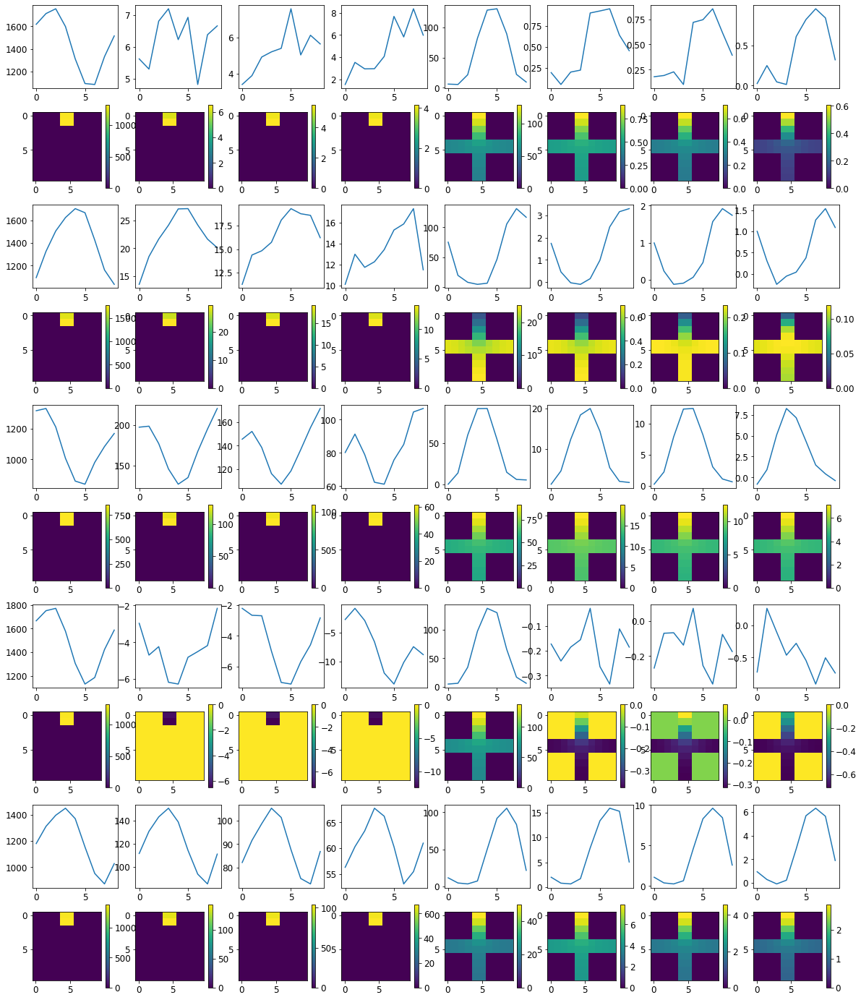

Loss: 


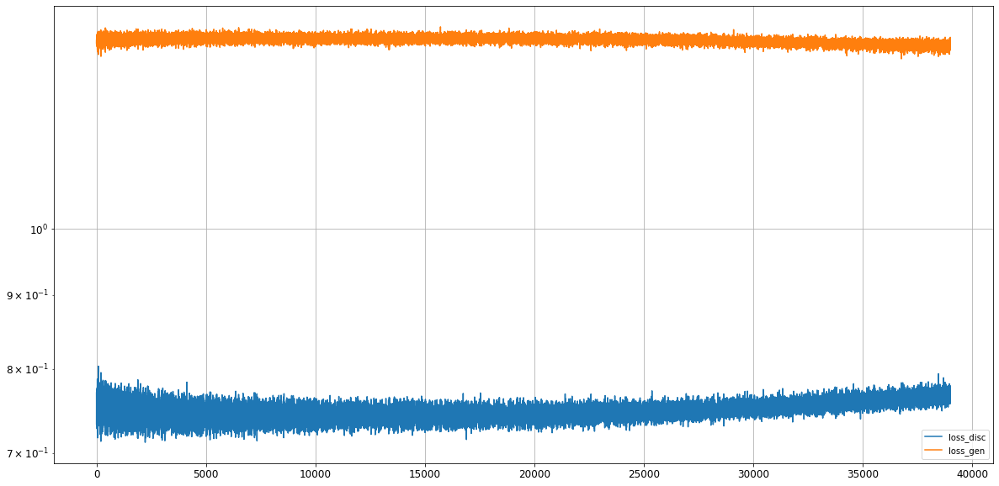

Epoch 39002/50000
discriminator loss: 1.341346 - generator loss: 0.767179 - 1s
Epoch 39003/50000
discriminator loss: 1.328024 - generator loss: 0.782085 - 1s
Epoch 39004/50000
discriminator loss: 1.334077 - generator loss: 0.773785 - 1s
Epoch 39005/50000
discriminator loss: 1.334312 - generator loss: 0.764340 - 1s
Epoch 39006/50000
discriminator loss: 1.327003 - generator loss: 0.767802 - 1s
Epoch 39007/50000
discriminator loss: 1.342032 - generator loss: 0.758917 - 1s
Epoch 39008/50000
discriminator loss: 1.337888 - generator loss: 0.769157 - 1s
Epoch 39009/50000
discriminator loss: 1.328626 - generator loss: 0.771531 - 1s
Epoch 39010/50000
discriminator loss: 1.325763 - generator loss: 0.781619 - 1s
Epoch 39011/50000
discriminator loss: 1.334934 - generator loss: 0.772579 - 1s
Epoch 39012/50000
discriminator loss: 1.341520 - generator loss: 0.768807 - 1s
Epoch 39013/50000
discriminator loss: 1.342167 - generator loss: 0.755599 - 1s
Epoch 39014/50000
discriminator loss: 1.349355 - gen

discriminator loss: 1.338076 - generator loss: 0.761514 - 1s
Epoch 39107/50000
discriminator loss: 1.348953 - generator loss: 0.760916 - 1s
Epoch 39108/50000
discriminator loss: 1.335434 - generator loss: 0.761169 - 1s
Epoch 39109/50000
discriminator loss: 1.332604 - generator loss: 0.768965 - 1s
Epoch 39110/50000
discriminator loss: 1.340938 - generator loss: 0.772269 - 1s
Epoch 39111/50000
discriminator loss: 1.336137 - generator loss: 0.772273 - 1s
Epoch 39112/50000
discriminator loss: 1.328131 - generator loss: 0.772569 - 1s
Epoch 39113/50000
discriminator loss: 1.335530 - generator loss: 0.763059 - 1s
Epoch 39114/50000
discriminator loss: 1.336375 - generator loss: 0.763824 - 1s
Epoch 39115/50000
discriminator loss: 1.339428 - generator loss: 0.757232 - 1s
Epoch 39116/50000
discriminator loss: 1.354183 - generator loss: 0.755612 - 1s
Epoch 39117/50000
discriminator loss: 1.336819 - generator loss: 0.766238 - 1s
Epoch 39118/50000
discriminator loss: 1.339325 - generator loss: 0.770

discriminator loss: 1.343216 - generator loss: 0.761516 - 1s
Epoch 39211/50000
discriminator loss: 1.338146 - generator loss: 0.778583 - 1s
Epoch 39212/50000
discriminator loss: 1.344331 - generator loss: 0.759754 - 1s
Epoch 39213/50000
discriminator loss: 1.332586 - generator loss: 0.762692 - 1s
Epoch 39214/50000
discriminator loss: 1.323801 - generator loss: 0.775754 - 1s
Epoch 39215/50000
discriminator loss: 1.341167 - generator loss: 0.772523 - 1s
Epoch 39216/50000
discriminator loss: 1.339702 - generator loss: 0.761982 - 1s
Epoch 39217/50000
discriminator loss: 1.334196 - generator loss: 0.780585 - 1s
Epoch 39218/50000
discriminator loss: 1.340250 - generator loss: 0.754925 - 1s
Epoch 39219/50000
discriminator loss: 1.327902 - generator loss: 0.779824 - 1s
Epoch 39220/50000
discriminator loss: 1.337267 - generator loss: 0.762437 - 1s
Epoch 39221/50000
discriminator loss: 1.336733 - generator loss: 0.772702 - 1s
Epoch 39222/50000
discriminator loss: 1.326672 - generator loss: 0.780

discriminator loss: 1.344605 - generator loss: 0.766091 - 1s
Epoch 39315/50000
discriminator loss: 1.335373 - generator loss: 0.766509 - 1s
Epoch 39316/50000
discriminator loss: 1.352884 - generator loss: 0.754066 - 1s
Epoch 39317/50000
discriminator loss: 1.342043 - generator loss: 0.773068 - 1s
Epoch 39318/50000
discriminator loss: 1.330634 - generator loss: 0.773697 - 1s
Epoch 39319/50000
discriminator loss: 1.323388 - generator loss: 0.765524 - 1s
Epoch 39320/50000
discriminator loss: 1.335504 - generator loss: 0.768793 - 1s
Epoch 39321/50000
discriminator loss: 1.348166 - generator loss: 0.752954 - 1s
Epoch 39322/50000
discriminator loss: 1.339432 - generator loss: 0.769555 - 1s
Epoch 39323/50000
discriminator loss: 1.346673 - generator loss: 0.761389 - 1s
Epoch 39324/50000
discriminator loss: 1.340865 - generator loss: 0.767291 - 1s
Epoch 39325/50000
discriminator loss: 1.333886 - generator loss: 0.770624 - 1s
Epoch 39326/50000
discriminator loss: 1.321850 - generator loss: 0.776

discriminator loss: 1.325225 - generator loss: 0.774016 - 1s
Epoch 39419/50000
discriminator loss: 1.332160 - generator loss: 0.769912 - 1s
Epoch 39420/50000
discriminator loss: 1.337087 - generator loss: 0.766287 - 1s
Epoch 39421/50000
discriminator loss: 1.339243 - generator loss: 0.763796 - 1s
Epoch 39422/50000
discriminator loss: 1.343590 - generator loss: 0.767837 - 1s
Epoch 39423/50000
discriminator loss: 1.342453 - generator loss: 0.756294 - 1s
Epoch 39424/50000
discriminator loss: 1.353576 - generator loss: 0.755966 - 1s
Epoch 39425/50000
discriminator loss: 1.328923 - generator loss: 0.763177 - 1s
Epoch 39426/50000
discriminator loss: 1.343054 - generator loss: 0.761752 - 1s
Epoch 39427/50000
discriminator loss: 1.328963 - generator loss: 0.776802 - 1s
Epoch 39428/50000
discriminator loss: 1.339283 - generator loss: 0.768728 - 1s
Epoch 39429/50000
discriminator loss: 1.336868 - generator loss: 0.768852 - 1s
Epoch 39430/50000
discriminator loss: 1.335585 - generator loss: 0.764

discriminator loss: 1.336653 - generator loss: 0.763478 - 1s
Epoch 39523/50000
discriminator loss: 1.337622 - generator loss: 0.767304 - 1s
Epoch 39524/50000
discriminator loss: 1.332271 - generator loss: 0.770801 - 1s
Epoch 39525/50000
discriminator loss: 1.333468 - generator loss: 0.780576 - 1s
Epoch 39526/50000
discriminator loss: 1.324524 - generator loss: 0.783052 - 1s
Epoch 39527/50000
discriminator loss: 1.331917 - generator loss: 0.771383 - 1s
Epoch 39528/50000
discriminator loss: 1.343028 - generator loss: 0.758219 - 1s
Epoch 39529/50000
discriminator loss: 1.342812 - generator loss: 0.762472 - 1s
Epoch 39530/50000
discriminator loss: 1.336823 - generator loss: 0.765860 - 1s
Epoch 39531/50000
discriminator loss: 1.343966 - generator loss: 0.767457 - 1s
Epoch 39532/50000
discriminator loss: 1.345251 - generator loss: 0.756903 - 1s
Epoch 39533/50000
discriminator loss: 1.344523 - generator loss: 0.764513 - 1s
Epoch 39534/50000
discriminator loss: 1.329781 - generator loss: 0.781

discriminator loss: 1.333930 - generator loss: 0.767730 - 1s
Epoch 39627/50000
discriminator loss: 1.350409 - generator loss: 0.756842 - 1s
Epoch 39628/50000
discriminator loss: 1.329518 - generator loss: 0.782765 - 1s
Epoch 39629/50000
discriminator loss: 1.339284 - generator loss: 0.768084 - 1s
Epoch 39630/50000
discriminator loss: 1.338070 - generator loss: 0.768508 - 1s
Epoch 39631/50000
discriminator loss: 1.336171 - generator loss: 0.770319 - 1s
Epoch 39632/50000
discriminator loss: 1.342676 - generator loss: 0.762167 - 1s
Epoch 39633/50000
discriminator loss: 1.348258 - generator loss: 0.758016 - 1s
Epoch 39634/50000
discriminator loss: 1.336885 - generator loss: 0.768456 - 1s
Epoch 39635/50000
discriminator loss: 1.335292 - generator loss: 0.770171 - 1s
Epoch 39636/50000
discriminator loss: 1.337552 - generator loss: 0.772224 - 1s
Epoch 39637/50000
discriminator loss: 1.342564 - generator loss: 0.765505 - 1s
Epoch 39638/50000
discriminator loss: 1.344629 - generator loss: 0.763

discriminator loss: 1.342683 - generator loss: 0.770065 - 1s
Epoch 39731/50000
discriminator loss: 1.334451 - generator loss: 0.767017 - 1s
Epoch 39732/50000
discriminator loss: 1.347456 - generator loss: 0.760223 - 1s
Epoch 39733/50000
discriminator loss: 1.344496 - generator loss: 0.763961 - 1s
Epoch 39734/50000
discriminator loss: 1.340078 - generator loss: 0.766937 - 1s
Epoch 39735/50000
discriminator loss: 1.341035 - generator loss: 0.769383 - 1s
Epoch 39736/50000
discriminator loss: 1.342923 - generator loss: 0.762527 - 1s
Epoch 39737/50000
discriminator loss: 1.337214 - generator loss: 0.768585 - 1s
Epoch 39738/50000
discriminator loss: 1.347060 - generator loss: 0.763576 - 1s
Epoch 39739/50000
discriminator loss: 1.345312 - generator loss: 0.758229 - 1s
Epoch 39740/50000
discriminator loss: 1.337130 - generator loss: 0.767018 - 1s
Epoch 39741/50000
discriminator loss: 1.342382 - generator loss: 0.762493 - 1s
Epoch 39742/50000
discriminator loss: 1.340434 - generator loss: 0.768

discriminator loss: 1.330648 - generator loss: 0.764856 - 1s
Epoch 39835/50000
discriminator loss: 1.334188 - generator loss: 0.773074 - 1s
Epoch 39836/50000
discriminator loss: 1.337781 - generator loss: 0.766279 - 1s
Epoch 39837/50000
discriminator loss: 1.335543 - generator loss: 0.771591 - 1s
Epoch 39838/50000
discriminator loss: 1.341754 - generator loss: 0.768393 - 1s
Epoch 39839/50000
discriminator loss: 1.345257 - generator loss: 0.766230 - 1s
Epoch 39840/50000
discriminator loss: 1.332578 - generator loss: 0.763067 - 1s
Epoch 39841/50000
discriminator loss: 1.327271 - generator loss: 0.777891 - 1s
Epoch 39842/50000
discriminator loss: 1.335247 - generator loss: 0.775632 - 1s
Epoch 39843/50000
discriminator loss: 1.333148 - generator loss: 0.765784 - 1s
Epoch 39844/50000
discriminator loss: 1.334364 - generator loss: 0.772550 - 1s
Epoch 39845/50000
discriminator loss: 1.341438 - generator loss: 0.764609 - 1s
Epoch 39846/50000
discriminator loss: 1.348543 - generator loss: 0.764

discriminator loss: 1.340991 - generator loss: 0.765905 - 1s
Epoch 39939/50000
discriminator loss: 1.337446 - generator loss: 0.767428 - 1s
Epoch 39940/50000
discriminator loss: 1.334575 - generator loss: 0.766059 - 1s
Epoch 39941/50000
discriminator loss: 1.344389 - generator loss: 0.762445 - 1s
Epoch 39942/50000
discriminator loss: 1.334794 - generator loss: 0.773850 - 1s
Epoch 39943/50000
discriminator loss: 1.335155 - generator loss: 0.771196 - 1s
Epoch 39944/50000
discriminator loss: 1.330579 - generator loss: 0.775572 - 1s
Epoch 39945/50000
discriminator loss: 1.349198 - generator loss: 0.762634 - 1s
Epoch 39946/50000
discriminator loss: 1.344832 - generator loss: 0.757733 - 1s
Epoch 39947/50000
discriminator loss: 1.340534 - generator loss: 0.766907 - 1s
Epoch 39948/50000
discriminator loss: 1.332173 - generator loss: 0.765929 - 1s
Epoch 39949/50000
discriminator loss: 1.336923 - generator loss: 0.775268 - 1s
Epoch 39950/50000
discriminator loss: 1.332991 - generator loss: 0.776

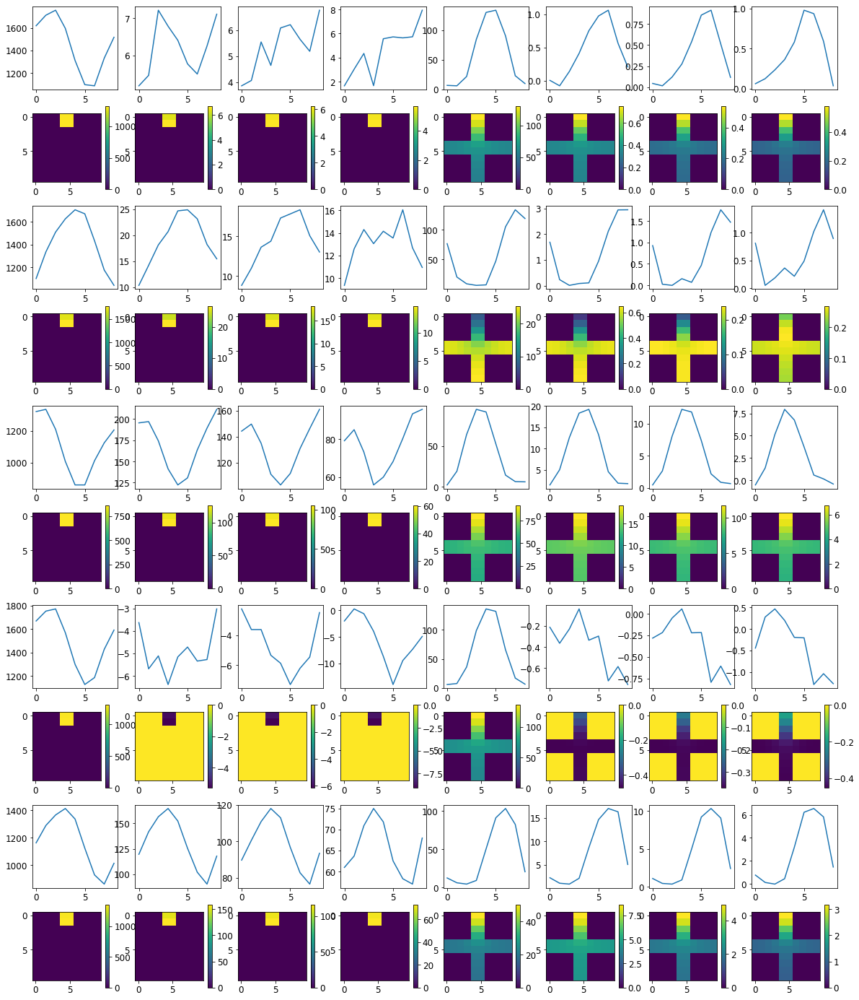

Loss: 


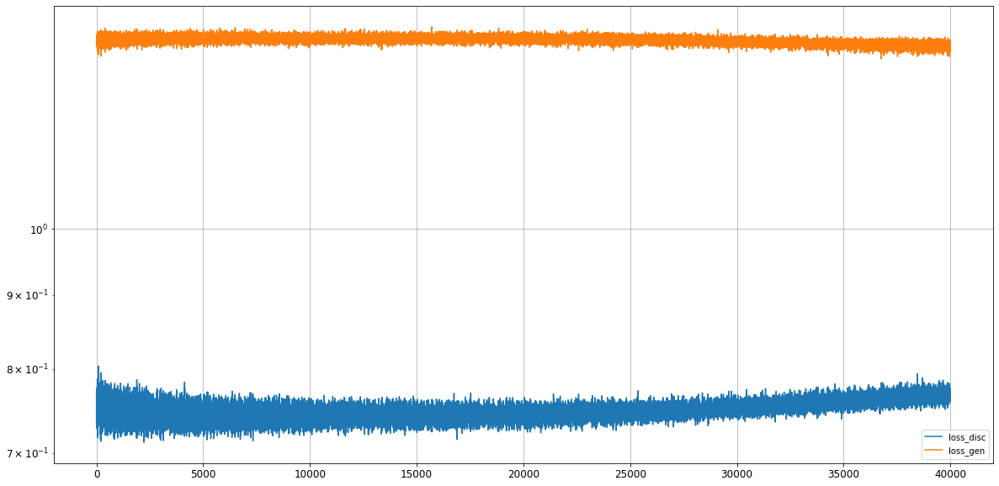

Epoch 40002/50000
discriminator loss: 1.330771 - generator loss: 0.775940 - 1s
Epoch 40003/50000
discriminator loss: 1.333210 - generator loss: 0.767572 - 1s
Epoch 40004/50000
discriminator loss: 1.334183 - generator loss: 0.772753 - 1s
Epoch 40005/50000
discriminator loss: 1.338860 - generator loss: 0.765557 - 1s
Epoch 40006/50000
discriminator loss: 1.341133 - generator loss: 0.764189 - 1s
Epoch 40007/50000
discriminator loss: 1.345965 - generator loss: 0.761923 - 1s
Epoch 40008/50000
discriminator loss: 1.329015 - generator loss: 0.772182 - 1s
Epoch 40009/50000
discriminator loss: 1.337844 - generator loss: 0.770358 - 1s
Epoch 40010/50000
discriminator loss: 1.337523 - generator loss: 0.767881 - 1s
Epoch 40011/50000
discriminator loss: 1.341694 - generator loss: 0.762549 - 1s
Epoch 40012/50000
discriminator loss: 1.333679 - generator loss: 0.767560 - 1s
Epoch 40013/50000
discriminator loss: 1.336187 - generator loss: 0.768382 - 1s
Epoch 40014/50000
discriminator loss: 1.339280 - gen

discriminator loss: 1.343604 - generator loss: 0.765644 - 1s
Epoch 40107/50000
discriminator loss: 1.341020 - generator loss: 0.773516 - 1s
Epoch 40108/50000
discriminator loss: 1.341909 - generator loss: 0.757778 - 1s
Epoch 40109/50000
discriminator loss: 1.342441 - generator loss: 0.762836 - 1s
Epoch 40110/50000
discriminator loss: 1.333721 - generator loss: 0.771567 - 1s
Epoch 40111/50000
discriminator loss: 1.346936 - generator loss: 0.766433 - 1s
Epoch 40112/50000
discriminator loss: 1.342284 - generator loss: 0.769177 - 1s
Epoch 40113/50000
discriminator loss: 1.330018 - generator loss: 0.774373 - 1s
Epoch 40114/50000
discriminator loss: 1.330333 - generator loss: 0.764508 - 1s
Epoch 40115/50000
discriminator loss: 1.333757 - generator loss: 0.770609 - 1s
Epoch 40116/50000
discriminator loss: 1.331976 - generator loss: 0.773128 - 1s
Epoch 40117/50000
discriminator loss: 1.335831 - generator loss: 0.767169 - 1s
Epoch 40118/50000
discriminator loss: 1.336661 - generator loss: 0.761

discriminator loss: 1.340962 - generator loss: 0.768746 - 1s
Epoch 40211/50000
discriminator loss: 1.350719 - generator loss: 0.757079 - 1s
Epoch 40212/50000
discriminator loss: 1.333964 - generator loss: 0.775354 - 1s
Epoch 40213/50000
discriminator loss: 1.331197 - generator loss: 0.770925 - 1s
Epoch 40214/50000
discriminator loss: 1.336761 - generator loss: 0.769904 - 1s
Epoch 40215/50000
discriminator loss: 1.344674 - generator loss: 0.765047 - 1s
Epoch 40216/50000
discriminator loss: 1.339633 - generator loss: 0.766227 - 1s
Epoch 40217/50000
discriminator loss: 1.331956 - generator loss: 0.764917 - 1s
Epoch 40218/50000
discriminator loss: 1.335892 - generator loss: 0.766496 - 1s
Epoch 40219/50000
discriminator loss: 1.335043 - generator loss: 0.774524 - 1s
Epoch 40220/50000
discriminator loss: 1.326486 - generator loss: 0.776217 - 1s
Epoch 40221/50000
discriminator loss: 1.327229 - generator loss: 0.772998 - 1s
Epoch 40222/50000
discriminator loss: 1.334378 - generator loss: 0.770

discriminator loss: 1.337769 - generator loss: 0.771787 - 1s
Epoch 40315/50000
discriminator loss: 1.329510 - generator loss: 0.775957 - 1s
Epoch 40316/50000
discriminator loss: 1.332744 - generator loss: 0.763870 - 1s
Epoch 40317/50000
discriminator loss: 1.322532 - generator loss: 0.777462 - 1s
Epoch 40318/50000
discriminator loss: 1.337779 - generator loss: 0.768836 - 1s
Epoch 40319/50000
discriminator loss: 1.339706 - generator loss: 0.766117 - 1s
Epoch 40320/50000
discriminator loss: 1.336427 - generator loss: 0.767902 - 1s
Epoch 40321/50000
discriminator loss: 1.348932 - generator loss: 0.758202 - 1s
Epoch 40322/50000
discriminator loss: 1.341115 - generator loss: 0.768620 - 1s
Epoch 40323/50000
discriminator loss: 1.349723 - generator loss: 0.763018 - 1s
Epoch 40324/50000
discriminator loss: 1.344744 - generator loss: 0.757949 - 1s
Epoch 40325/50000
discriminator loss: 1.334806 - generator loss: 0.765965 - 1s
Epoch 40326/50000
discriminator loss: 1.338202 - generator loss: 0.775

discriminator loss: 1.333376 - generator loss: 0.772880 - 1s
Epoch 40419/50000
discriminator loss: 1.336433 - generator loss: 0.769555 - 1s
Epoch 40420/50000
discriminator loss: 1.340180 - generator loss: 0.762138 - 1s
Epoch 40421/50000
discriminator loss: 1.346203 - generator loss: 0.765884 - 1s
Epoch 40422/50000
discriminator loss: 1.328624 - generator loss: 0.772909 - 1s
Epoch 40423/50000
discriminator loss: 1.335552 - generator loss: 0.758717 - 1s
Epoch 40424/50000
discriminator loss: 1.334345 - generator loss: 0.774093 - 1s
Epoch 40425/50000
discriminator loss: 1.324828 - generator loss: 0.771751 - 1s
Epoch 40426/50000
discriminator loss: 1.330602 - generator loss: 0.778772 - 1s
Epoch 40427/50000
discriminator loss: 1.344602 - generator loss: 0.767275 - 1s
Epoch 40428/50000
discriminator loss: 1.338909 - generator loss: 0.765306 - 1s
Epoch 40429/50000
discriminator loss: 1.343712 - generator loss: 0.766352 - 1s
Epoch 40430/50000
discriminator loss: 1.338107 - generator loss: 0.771

discriminator loss: 1.344877 - generator loss: 0.763450 - 1s
Epoch 40523/50000
discriminator loss: 1.345679 - generator loss: 0.778079 - 1s
Epoch 40524/50000
discriminator loss: 1.320464 - generator loss: 0.779235 - 1s
Epoch 40525/50000
discriminator loss: 1.332375 - generator loss: 0.767249 - 1s
Epoch 40526/50000
discriminator loss: 1.336338 - generator loss: 0.765502 - 1s
Epoch 40527/50000
discriminator loss: 1.350473 - generator loss: 0.759732 - 1s
Epoch 40528/50000
discriminator loss: 1.344052 - generator loss: 0.767283 - 1s
Epoch 40529/50000
discriminator loss: 1.349987 - generator loss: 0.762029 - 1s
Epoch 40530/50000
discriminator loss: 1.332338 - generator loss: 0.768941 - 1s
Epoch 40531/50000
discriminator loss: 1.348491 - generator loss: 0.766635 - 1s
Epoch 40532/50000
discriminator loss: 1.329605 - generator loss: 0.773476 - 1s
Epoch 40533/50000
discriminator loss: 1.342494 - generator loss: 0.755645 - 1s
Epoch 40534/50000
discriminator loss: 1.340332 - generator loss: 0.765

discriminator loss: 1.339768 - generator loss: 0.767364 - 1s
Epoch 40627/50000
discriminator loss: 1.340292 - generator loss: 0.764951 - 1s
Epoch 40628/50000
discriminator loss: 1.328890 - generator loss: 0.768041 - 1s
Epoch 40629/50000
discriminator loss: 1.347219 - generator loss: 0.757006 - 1s
Epoch 40630/50000
discriminator loss: 1.349042 - generator loss: 0.771575 - 1s
Epoch 40631/50000
discriminator loss: 1.338924 - generator loss: 0.765354 - 1s
Epoch 40632/50000
discriminator loss: 1.347378 - generator loss: 0.757479 - 1s
Epoch 40633/50000
discriminator loss: 1.342829 - generator loss: 0.772732 - 1s
Epoch 40634/50000
discriminator loss: 1.337661 - generator loss: 0.768968 - 1s
Epoch 40635/50000
discriminator loss: 1.338886 - generator loss: 0.766782 - 1s
Epoch 40636/50000
discriminator loss: 1.348147 - generator loss: 0.749260 - 1s
Epoch 40637/50000
discriminator loss: 1.327834 - generator loss: 0.780415 - 1s
Epoch 40638/50000
discriminator loss: 1.325922 - generator loss: 0.773

discriminator loss: 1.337813 - generator loss: 0.766962 - 1s
Epoch 40731/50000
discriminator loss: 1.332213 - generator loss: 0.775029 - 1s
Epoch 40732/50000
discriminator loss: 1.332101 - generator loss: 0.767639 - 1s
Epoch 40733/50000
discriminator loss: 1.339678 - generator loss: 0.763878 - 1s
Epoch 40734/50000
discriminator loss: 1.326778 - generator loss: 0.774856 - 1s
Epoch 40735/50000
discriminator loss: 1.341602 - generator loss: 0.765084 - 1s
Epoch 40736/50000
discriminator loss: 1.340542 - generator loss: 0.769018 - 1s
Epoch 40737/50000
discriminator loss: 1.339835 - generator loss: 0.764892 - 1s
Epoch 40738/50000
discriminator loss: 1.326223 - generator loss: 0.773770 - 1s
Epoch 40739/50000
discriminator loss: 1.330453 - generator loss: 0.776437 - 1s
Epoch 40740/50000
discriminator loss: 1.327740 - generator loss: 0.783251 - 1s
Epoch 40741/50000
discriminator loss: 1.334257 - generator loss: 0.768966 - 1s
Epoch 40742/50000
discriminator loss: 1.329377 - generator loss: 0.769

discriminator loss: 1.333402 - generator loss: 0.773529 - 1s
Epoch 40835/50000
discriminator loss: 1.345458 - generator loss: 0.768181 - 1s
Epoch 40836/50000
discriminator loss: 1.336103 - generator loss: 0.769791 - 1s
Epoch 40837/50000
discriminator loss: 1.326085 - generator loss: 0.775492 - 1s
Epoch 40838/50000
discriminator loss: 1.344219 - generator loss: 0.760622 - 1s
Epoch 40839/50000
discriminator loss: 1.356574 - generator loss: 0.752001 - 1s
Epoch 40840/50000
discriminator loss: 1.335590 - generator loss: 0.772767 - 1s
Epoch 40841/50000
discriminator loss: 1.343387 - generator loss: 0.769010 - 1s
Epoch 40842/50000
discriminator loss: 1.337079 - generator loss: 0.771032 - 1s
Epoch 40843/50000
discriminator loss: 1.331408 - generator loss: 0.767607 - 1s
Epoch 40844/50000
discriminator loss: 1.336069 - generator loss: 0.766604 - 1s
Epoch 40845/50000
discriminator loss: 1.326916 - generator loss: 0.765890 - 1s
Epoch 40846/50000
discriminator loss: 1.343581 - generator loss: 0.766

discriminator loss: 1.345299 - generator loss: 0.761975 - 1s
Epoch 40939/50000
discriminator loss: 1.331426 - generator loss: 0.775079 - 1s
Epoch 40940/50000
discriminator loss: 1.338031 - generator loss: 0.773134 - 1s
Epoch 40941/50000
discriminator loss: 1.338551 - generator loss: 0.772719 - 1s
Epoch 40942/50000
discriminator loss: 1.329975 - generator loss: 0.770203 - 1s
Epoch 40943/50000
discriminator loss: 1.344366 - generator loss: 0.762795 - 1s
Epoch 40944/50000
discriminator loss: 1.342164 - generator loss: 0.754904 - 1s
Epoch 40945/50000
discriminator loss: 1.341232 - generator loss: 0.771890 - 1s
Epoch 40946/50000
discriminator loss: 1.339796 - generator loss: 0.761965 - 1s
Epoch 40947/50000
discriminator loss: 1.338892 - generator loss: 0.770712 - 1s
Epoch 40948/50000
discriminator loss: 1.337517 - generator loss: 0.779120 - 1s
Epoch 40949/50000
discriminator loss: 1.335666 - generator loss: 0.767723 - 1s
Epoch 40950/50000
discriminator loss: 1.337800 - generator loss: 0.764

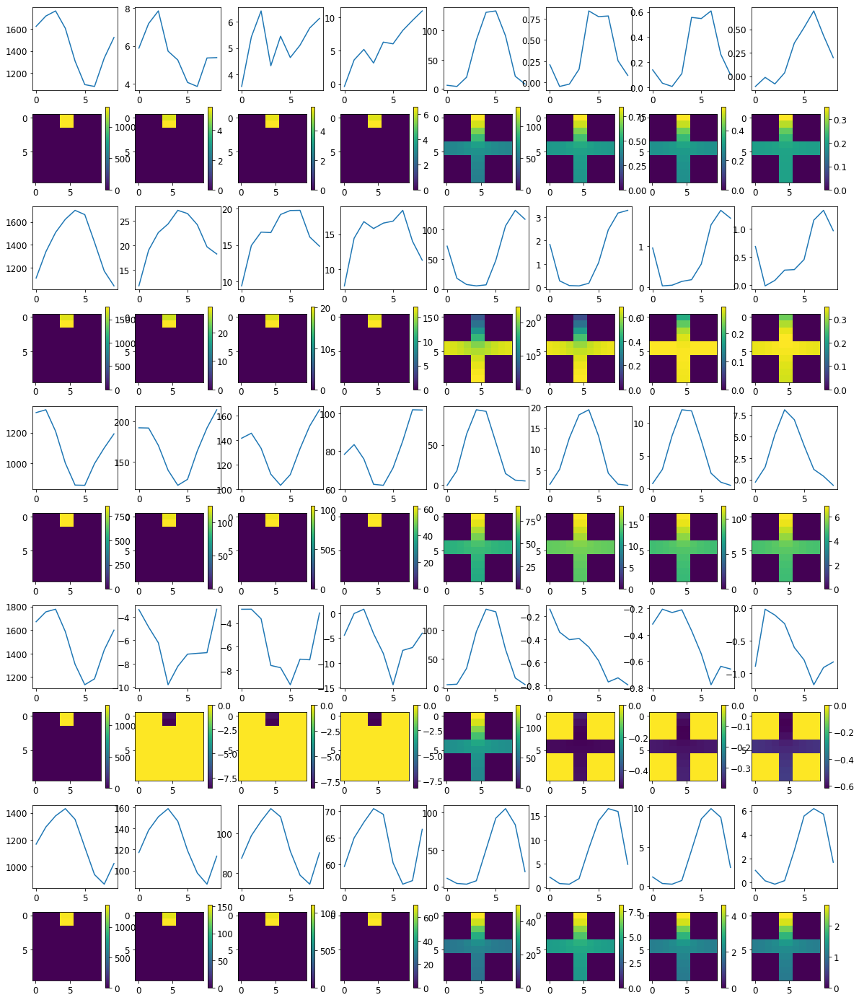

Loss: 


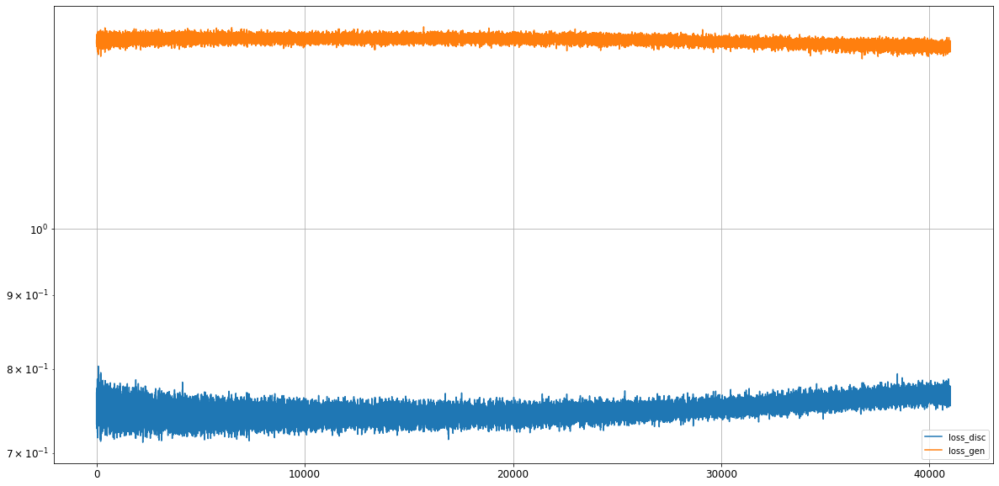

Epoch 41002/50000
discriminator loss: 1.334818 - generator loss: 0.765753 - 1s
Epoch 41003/50000
discriminator loss: 1.341484 - generator loss: 0.773018 - 1s
Epoch 41004/50000
discriminator loss: 1.335579 - generator loss: 0.768297 - 1s
Epoch 41005/50000
discriminator loss: 1.336340 - generator loss: 0.771186 - 1s
Epoch 41006/50000
discriminator loss: 1.327572 - generator loss: 0.779782 - 1s
Epoch 41007/50000
discriminator loss: 1.330499 - generator loss: 0.767550 - 1s
Epoch 41008/50000
discriminator loss: 1.340337 - generator loss: 0.768400 - 1s
Epoch 41009/50000
discriminator loss: 1.333365 - generator loss: 0.768088 - 1s
Epoch 41010/50000
discriminator loss: 1.332996 - generator loss: 0.771316 - 1s
Epoch 41011/50000
discriminator loss: 1.333420 - generator loss: 0.767954 - 1s
Epoch 41012/50000
discriminator loss: 1.333722 - generator loss: 0.782005 - 1s
Epoch 41013/50000
discriminator loss: 1.331042 - generator loss: 0.765271 - 1s
Epoch 41014/50000
discriminator loss: 1.336081 - gen

discriminator loss: 1.338703 - generator loss: 0.775480 - 1s
Epoch 41107/50000
discriminator loss: 1.340949 - generator loss: 0.762153 - 1s
Epoch 41108/50000
discriminator loss: 1.329117 - generator loss: 0.776808 - 1s
Epoch 41109/50000
discriminator loss: 1.332259 - generator loss: 0.767394 - 1s
Epoch 41110/50000
discriminator loss: 1.335726 - generator loss: 0.775717 - 1s
Epoch 41111/50000
discriminator loss: 1.325638 - generator loss: 0.774693 - 1s
Epoch 41112/50000
discriminator loss: 1.330074 - generator loss: 0.781161 - 1s
Epoch 41113/50000
discriminator loss: 1.332981 - generator loss: 0.772390 - 1s
Epoch 41114/50000
discriminator loss: 1.328839 - generator loss: 0.780502 - 1s
Epoch 41115/50000
discriminator loss: 1.328907 - generator loss: 0.768562 - 1s
Epoch 41116/50000
discriminator loss: 1.338207 - generator loss: 0.775110 - 1s
Epoch 41117/50000
discriminator loss: 1.330013 - generator loss: 0.767146 - 1s
Epoch 41118/50000
discriminator loss: 1.336583 - generator loss: 0.768

discriminator loss: 1.335967 - generator loss: 0.767263 - 1s
Epoch 41211/50000
discriminator loss: 1.329999 - generator loss: 0.771002 - 1s
Epoch 41212/50000
discriminator loss: 1.331466 - generator loss: 0.770777 - 1s
Epoch 41213/50000
discriminator loss: 1.340414 - generator loss: 0.771021 - 1s
Epoch 41214/50000
discriminator loss: 1.332592 - generator loss: 0.769109 - 1s
Epoch 41215/50000
discriminator loss: 1.337503 - generator loss: 0.774021 - 1s
Epoch 41216/50000
discriminator loss: 1.341799 - generator loss: 0.766668 - 1s
Epoch 41217/50000
discriminator loss: 1.332333 - generator loss: 0.768647 - 1s
Epoch 41218/50000
discriminator loss: 1.334174 - generator loss: 0.775811 - 1s
Epoch 41219/50000
discriminator loss: 1.337271 - generator loss: 0.764694 - 1s
Epoch 41220/50000
discriminator loss: 1.324329 - generator loss: 0.775993 - 1s
Epoch 41221/50000
discriminator loss: 1.335101 - generator loss: 0.773077 - 1s
Epoch 41222/50000
discriminator loss: 1.343948 - generator loss: 0.764

discriminator loss: 1.351594 - generator loss: 0.761836 - 1s
Epoch 41315/50000
discriminator loss: 1.326252 - generator loss: 0.777708 - 1s
Epoch 41316/50000
discriminator loss: 1.339694 - generator loss: 0.774617 - 1s
Epoch 41317/50000
discriminator loss: 1.344696 - generator loss: 0.757411 - 1s
Epoch 41318/50000
discriminator loss: 1.344280 - generator loss: 0.760086 - 1s
Epoch 41319/50000
discriminator loss: 1.343073 - generator loss: 0.762934 - 1s
Epoch 41320/50000
discriminator loss: 1.334411 - generator loss: 0.766050 - 1s
Epoch 41321/50000
discriminator loss: 1.340532 - generator loss: 0.772011 - 1s
Epoch 41322/50000
discriminator loss: 1.343150 - generator loss: 0.770149 - 1s
Epoch 41323/50000
discriminator loss: 1.349255 - generator loss: 0.772529 - 1s
Epoch 41324/50000
discriminator loss: 1.326065 - generator loss: 0.770578 - 1s
Epoch 41325/50000
discriminator loss: 1.326898 - generator loss: 0.774435 - 1s
Epoch 41326/50000
discriminator loss: 1.335291 - generator loss: 0.769

discriminator loss: 1.335913 - generator loss: 0.772034 - 1s
Epoch 41419/50000
discriminator loss: 1.337294 - generator loss: 0.776588 - 1s
Epoch 41420/50000
discriminator loss: 1.334617 - generator loss: 0.766717 - 1s
Epoch 41421/50000
discriminator loss: 1.335603 - generator loss: 0.777596 - 1s
Epoch 41422/50000
discriminator loss: 1.340247 - generator loss: 0.763428 - 1s
Epoch 41423/50000
discriminator loss: 1.344097 - generator loss: 0.767159 - 1s
Epoch 41424/50000
discriminator loss: 1.343718 - generator loss: 0.757190 - 1s
Epoch 41425/50000
discriminator loss: 1.332370 - generator loss: 0.771241 - 1s
Epoch 41426/50000
discriminator loss: 1.337672 - generator loss: 0.768849 - 1s
Epoch 41427/50000
discriminator loss: 1.337667 - generator loss: 0.773372 - 1s
Epoch 41428/50000
discriminator loss: 1.341429 - generator loss: 0.763347 - 1s
Epoch 41429/50000
discriminator loss: 1.331606 - generator loss: 0.774832 - 1s
Epoch 41430/50000
discriminator loss: 1.333125 - generator loss: 0.769

discriminator loss: 1.337914 - generator loss: 0.770439 - 1s
Epoch 41523/50000
discriminator loss: 1.339318 - generator loss: 0.770827 - 1s
Epoch 41524/50000
discriminator loss: 1.332051 - generator loss: 0.776830 - 1s
Epoch 41525/50000
discriminator loss: 1.330592 - generator loss: 0.772637 - 1s
Epoch 41526/50000
discriminator loss: 1.327386 - generator loss: 0.775642 - 1s
Epoch 41527/50000
discriminator loss: 1.325940 - generator loss: 0.780416 - 1s
Epoch 41528/50000
discriminator loss: 1.332798 - generator loss: 0.766823 - 1s
Epoch 41529/50000
discriminator loss: 1.332228 - generator loss: 0.775808 - 1s
Epoch 41530/50000
discriminator loss: 1.333084 - generator loss: 0.772128 - 1s
Epoch 41531/50000
discriminator loss: 1.335090 - generator loss: 0.772179 - 1s
Epoch 41532/50000
discriminator loss: 1.338336 - generator loss: 0.774974 - 1s
Epoch 41533/50000
discriminator loss: 1.334246 - generator loss: 0.773518 - 1s
Epoch 41534/50000
discriminator loss: 1.342101 - generator loss: 0.773

discriminator loss: 1.330017 - generator loss: 0.773413 - 1s
Epoch 41627/50000
discriminator loss: 1.340740 - generator loss: 0.759714 - 1s
Epoch 41628/50000
discriminator loss: 1.328638 - generator loss: 0.781645 - 1s
Epoch 41629/50000
discriminator loss: 1.338618 - generator loss: 0.767449 - 1s
Epoch 41630/50000
discriminator loss: 1.330712 - generator loss: 0.772223 - 1s
Epoch 41631/50000
discriminator loss: 1.341114 - generator loss: 0.766066 - 1s
Epoch 41632/50000
discriminator loss: 1.338262 - generator loss: 0.768237 - 1s
Epoch 41633/50000
discriminator loss: 1.331755 - generator loss: 0.775985 - 1s
Epoch 41634/50000
discriminator loss: 1.337037 - generator loss: 0.761291 - 1s
Epoch 41635/50000
discriminator loss: 1.332910 - generator loss: 0.779262 - 1s
Epoch 41636/50000
discriminator loss: 1.337808 - generator loss: 0.764030 - 1s
Epoch 41637/50000
discriminator loss: 1.344202 - generator loss: 0.771703 - 1s
Epoch 41638/50000
discriminator loss: 1.344654 - generator loss: 0.766

discriminator loss: 1.333634 - generator loss: 0.769138 - 1s
Epoch 41731/50000
discriminator loss: 1.319868 - generator loss: 0.779517 - 1s
Epoch 41732/50000
discriminator loss: 1.324206 - generator loss: 0.778382 - 1s
Epoch 41733/50000
discriminator loss: 1.327966 - generator loss: 0.779091 - 1s
Epoch 41734/50000
discriminator loss: 1.324180 - generator loss: 0.784112 - 1s
Epoch 41735/50000
discriminator loss: 1.337707 - generator loss: 0.762875 - 1s
Epoch 41736/50000
discriminator loss: 1.327734 - generator loss: 0.777559 - 1s
Epoch 41737/50000
discriminator loss: 1.322047 - generator loss: 0.784627 - 1s
Epoch 41738/50000
discriminator loss: 1.328064 - generator loss: 0.771025 - 1s
Epoch 41739/50000
discriminator loss: 1.325546 - generator loss: 0.776910 - 1s
Epoch 41740/50000
discriminator loss: 1.332100 - generator loss: 0.776589 - 1s
Epoch 41741/50000
discriminator loss: 1.319960 - generator loss: 0.775202 - 1s
Epoch 41742/50000
discriminator loss: 1.335255 - generator loss: 0.771

discriminator loss: 1.337781 - generator loss: 0.766009 - 1s
Epoch 41835/50000
discriminator loss: 1.343252 - generator loss: 0.769119 - 1s
Epoch 41836/50000
discriminator loss: 1.331942 - generator loss: 0.772324 - 1s
Epoch 41837/50000
discriminator loss: 1.336523 - generator loss: 0.779066 - 1s
Epoch 41838/50000
discriminator loss: 1.331123 - generator loss: 0.774205 - 1s
Epoch 41839/50000
discriminator loss: 1.322768 - generator loss: 0.771440 - 1s
Epoch 41840/50000
discriminator loss: 1.333564 - generator loss: 0.776177 - 1s
Epoch 41841/50000
discriminator loss: 1.334176 - generator loss: 0.766159 - 1s
Epoch 41842/50000
discriminator loss: 1.334800 - generator loss: 0.769141 - 1s
Epoch 41843/50000
discriminator loss: 1.333956 - generator loss: 0.768486 - 1s
Epoch 41844/50000
discriminator loss: 1.328938 - generator loss: 0.780708 - 1s
Epoch 41845/50000
discriminator loss: 1.341706 - generator loss: 0.774850 - 1s
Epoch 41846/50000
discriminator loss: 1.333426 - generator loss: 0.774

discriminator loss: 1.335457 - generator loss: 0.776508 - 1s
Epoch 41939/50000
discriminator loss: 1.337714 - generator loss: 0.770536 - 1s
Epoch 41940/50000
discriminator loss: 1.341235 - generator loss: 0.769746 - 1s
Epoch 41941/50000
discriminator loss: 1.338540 - generator loss: 0.770566 - 1s
Epoch 41942/50000
discriminator loss: 1.329863 - generator loss: 0.770217 - 1s
Epoch 41943/50000
discriminator loss: 1.336867 - generator loss: 0.765799 - 1s
Epoch 41944/50000
discriminator loss: 1.339441 - generator loss: 0.773082 - 1s
Epoch 41945/50000
discriminator loss: 1.332199 - generator loss: 0.776092 - 1s
Epoch 41946/50000
discriminator loss: 1.341064 - generator loss: 0.766234 - 1s
Epoch 41947/50000
discriminator loss: 1.337682 - generator loss: 0.767212 - 1s
Epoch 41948/50000
discriminator loss: 1.341361 - generator loss: 0.766266 - 1s
Epoch 41949/50000
discriminator loss: 1.342841 - generator loss: 0.768175 - 1s
Epoch 41950/50000
discriminator loss: 1.337407 - generator loss: 0.769

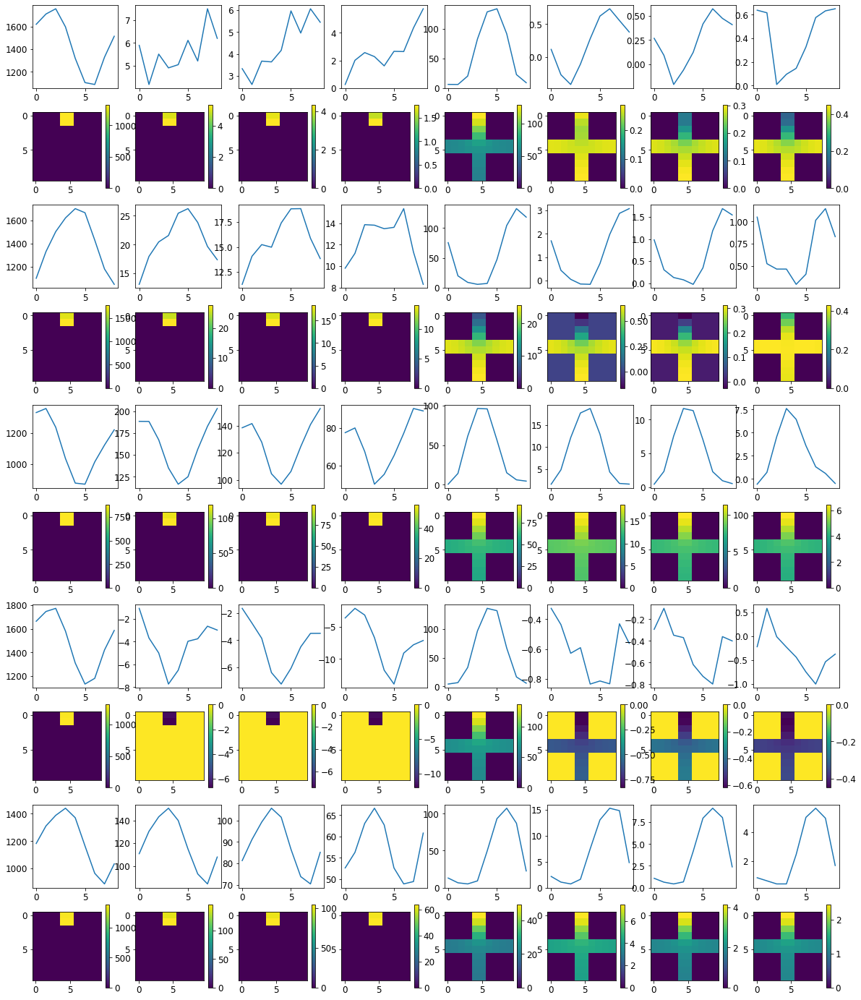

Loss: 


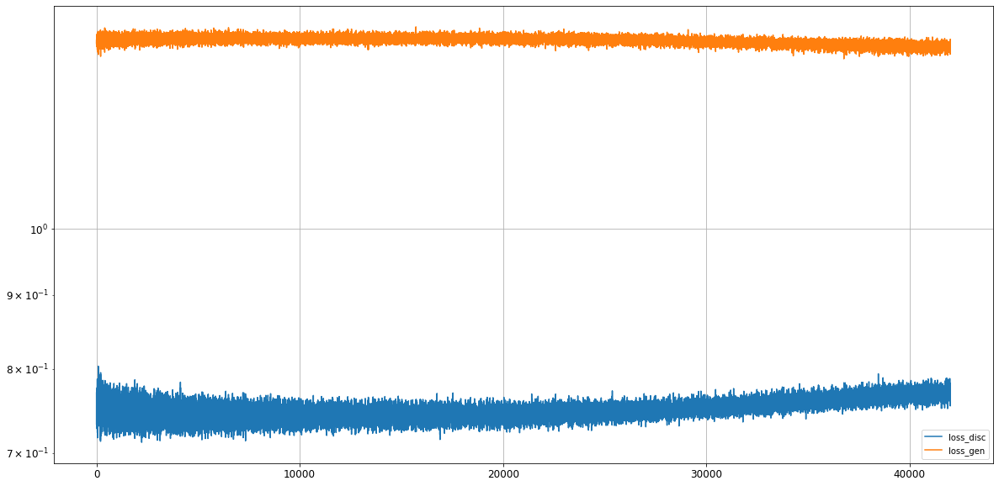

Epoch 42002/50000
discriminator loss: 1.336433 - generator loss: 0.772265 - 1s
Epoch 42003/50000
discriminator loss: 1.337936 - generator loss: 0.760988 - 1s
Epoch 42004/50000
discriminator loss: 1.335459 - generator loss: 0.773528 - 1s
Epoch 42005/50000
discriminator loss: 1.340431 - generator loss: 0.774147 - 1s
Epoch 42006/50000
discriminator loss: 1.335694 - generator loss: 0.765927 - 1s
Epoch 42007/50000
discriminator loss: 1.349831 - generator loss: 0.762852 - 1s
Epoch 42008/50000
discriminator loss: 1.343495 - generator loss: 0.779047 - 1s
Epoch 42009/50000
discriminator loss: 1.345302 - generator loss: 0.760534 - 1s
Epoch 42010/50000
discriminator loss: 1.352812 - generator loss: 0.755182 - 1s
Epoch 42011/50000
discriminator loss: 1.338277 - generator loss: 0.769451 - 1s
Epoch 42012/50000
discriminator loss: 1.349509 - generator loss: 0.767261 - 1s
Epoch 42013/50000
discriminator loss: 1.334606 - generator loss: 0.769599 - 1s
Epoch 42014/50000
discriminator loss: 1.326533 - gen

discriminator loss: 1.337880 - generator loss: 0.772301 - 1s
Epoch 42107/50000
discriminator loss: 1.342486 - generator loss: 0.764110 - 1s
Epoch 42108/50000
discriminator loss: 1.336533 - generator loss: 0.764637 - 1s
Epoch 42109/50000
discriminator loss: 1.351049 - generator loss: 0.758006 - 1s
Epoch 42110/50000
discriminator loss: 1.343044 - generator loss: 0.759841 - 1s
Epoch 42111/50000
discriminator loss: 1.334001 - generator loss: 0.780864 - 1s
Epoch 42112/50000
discriminator loss: 1.331800 - generator loss: 0.777187 - 1s
Epoch 42113/50000
discriminator loss: 1.334765 - generator loss: 0.771719 - 1s
Epoch 42114/50000
discriminator loss: 1.337832 - generator loss: 0.770333 - 1s
Epoch 42115/50000
discriminator loss: 1.337705 - generator loss: 0.763779 - 1s
Epoch 42116/50000
discriminator loss: 1.334015 - generator loss: 0.773894 - 1s
Epoch 42117/50000
discriminator loss: 1.339439 - generator loss: 0.776282 - 1s
Epoch 42118/50000
discriminator loss: 1.341880 - generator loss: 0.759

discriminator loss: 1.340223 - generator loss: 0.774813 - 1s
Epoch 42211/50000
discriminator loss: 1.339399 - generator loss: 0.773146 - 1s
Epoch 42212/50000
discriminator loss: 1.342512 - generator loss: 0.756639 - 1s
Epoch 42213/50000
discriminator loss: 1.340619 - generator loss: 0.772819 - 1s
Epoch 42214/50000
discriminator loss: 1.338986 - generator loss: 0.763864 - 1s
Epoch 42215/50000
discriminator loss: 1.335164 - generator loss: 0.780539 - 1s
Epoch 42216/50000
discriminator loss: 1.321683 - generator loss: 0.777623 - 1s
Epoch 42217/50000
discriminator loss: 1.334369 - generator loss: 0.761850 - 1s
Epoch 42218/50000
discriminator loss: 1.323983 - generator loss: 0.773020 - 1s
Epoch 42219/50000
discriminator loss: 1.349082 - generator loss: 0.766894 - 1s
Epoch 42220/50000
discriminator loss: 1.343817 - generator loss: 0.770897 - 1s
Epoch 42221/50000
discriminator loss: 1.337378 - generator loss: 0.771378 - 1s
Epoch 42222/50000
discriminator loss: 1.336449 - generator loss: 0.765

discriminator loss: 1.339073 - generator loss: 0.771358 - 1s
Epoch 42315/50000
discriminator loss: 1.336609 - generator loss: 0.772552 - 1s
Epoch 42316/50000
discriminator loss: 1.338459 - generator loss: 0.765675 - 1s
Epoch 42317/50000
discriminator loss: 1.335317 - generator loss: 0.768299 - 1s
Epoch 42318/50000
discriminator loss: 1.342465 - generator loss: 0.771291 - 1s
Epoch 42319/50000
discriminator loss: 1.329548 - generator loss: 0.772876 - 1s
Epoch 42320/50000
discriminator loss: 1.332677 - generator loss: 0.777075 - 1s
Epoch 42321/50000
discriminator loss: 1.335767 - generator loss: 0.772399 - 1s
Epoch 42322/50000
discriminator loss: 1.333624 - generator loss: 0.767850 - 1s
Epoch 42323/50000
discriminator loss: 1.334809 - generator loss: 0.767386 - 1s
Epoch 42324/50000
discriminator loss: 1.339906 - generator loss: 0.766555 - 1s
Epoch 42325/50000
discriminator loss: 1.350704 - generator loss: 0.759671 - 1s
Epoch 42326/50000
discriminator loss: 1.325698 - generator loss: 0.779

discriminator loss: 1.335436 - generator loss: 0.772729 - 1s
Epoch 42419/50000
discriminator loss: 1.331175 - generator loss: 0.777453 - 1s
Epoch 42420/50000
discriminator loss: 1.330149 - generator loss: 0.777734 - 1s
Epoch 42421/50000
discriminator loss: 1.328128 - generator loss: 0.774046 - 1s
Epoch 42422/50000
discriminator loss: 1.333998 - generator loss: 0.773865 - 1s
Epoch 42423/50000
discriminator loss: 1.331719 - generator loss: 0.772205 - 1s
Epoch 42424/50000
discriminator loss: 1.330124 - generator loss: 0.778145 - 1s
Epoch 42425/50000
discriminator loss: 1.337962 - generator loss: 0.772017 - 1s
Epoch 42426/50000
discriminator loss: 1.336709 - generator loss: 0.763931 - 1s
Epoch 42427/50000
discriminator loss: 1.341995 - generator loss: 0.762123 - 1s
Epoch 42428/50000
discriminator loss: 1.335862 - generator loss: 0.778156 - 1s
Epoch 42429/50000
discriminator loss: 1.342723 - generator loss: 0.760965 - 1s
Epoch 42430/50000
discriminator loss: 1.338968 - generator loss: 0.776

discriminator loss: 1.341929 - generator loss: 0.767574 - 1s
Epoch 42523/50000
discriminator loss: 1.346514 - generator loss: 0.768119 - 1s
Epoch 42524/50000
discriminator loss: 1.353460 - generator loss: 0.761347 - 1s
Epoch 42525/50000
discriminator loss: 1.342152 - generator loss: 0.763725 - 1s
Epoch 42526/50000
discriminator loss: 1.337461 - generator loss: 0.769938 - 1s
Epoch 42527/50000
discriminator loss: 1.335978 - generator loss: 0.770597 - 1s
Epoch 42528/50000
discriminator loss: 1.338737 - generator loss: 0.769492 - 1s
Epoch 42529/50000
discriminator loss: 1.330865 - generator loss: 0.775338 - 1s
Epoch 42530/50000
discriminator loss: 1.339165 - generator loss: 0.766412 - 1s
Epoch 42531/50000
discriminator loss: 1.329214 - generator loss: 0.769164 - 1s
Epoch 42532/50000
discriminator loss: 1.337062 - generator loss: 0.774480 - 1s
Epoch 42533/50000
discriminator loss: 1.334826 - generator loss: 0.771850 - 1s
Epoch 42534/50000
discriminator loss: 1.331389 - generator loss: 0.782

discriminator loss: 1.333501 - generator loss: 0.775673 - 1s
Epoch 42627/50000
discriminator loss: 1.322916 - generator loss: 0.778302 - 1s
Epoch 42628/50000
discriminator loss: 1.336668 - generator loss: 0.771062 - 1s
Epoch 42629/50000
discriminator loss: 1.331477 - generator loss: 0.771021 - 1s
Epoch 42630/50000
discriminator loss: 1.338567 - generator loss: 0.775660 - 1s
Epoch 42631/50000
discriminator loss: 1.347039 - generator loss: 0.764976 - 1s
Epoch 42632/50000
discriminator loss: 1.331564 - generator loss: 0.770658 - 1s
Epoch 42633/50000
discriminator loss: 1.338612 - generator loss: 0.760405 - 1s
Epoch 42634/50000
discriminator loss: 1.337234 - generator loss: 0.771368 - 1s
Epoch 42635/50000
discriminator loss: 1.337152 - generator loss: 0.766587 - 1s
Epoch 42636/50000
discriminator loss: 1.332831 - generator loss: 0.776381 - 1s
Epoch 42637/50000
discriminator loss: 1.342284 - generator loss: 0.760659 - 1s
Epoch 42638/50000
discriminator loss: 1.339121 - generator loss: 0.771

discriminator loss: 1.330814 - generator loss: 0.772129 - 1s
Epoch 42731/50000
discriminator loss: 1.335849 - generator loss: 0.770171 - 1s
Epoch 42732/50000
discriminator loss: 1.333005 - generator loss: 0.771148 - 1s
Epoch 42733/50000
discriminator loss: 1.329558 - generator loss: 0.776244 - 1s
Epoch 42734/50000
discriminator loss: 1.336169 - generator loss: 0.766375 - 1s
Epoch 42735/50000
discriminator loss: 1.343335 - generator loss: 0.766062 - 1s
Epoch 42736/50000
discriminator loss: 1.341694 - generator loss: 0.770173 - 1s
Epoch 42737/50000
discriminator loss: 1.322811 - generator loss: 0.776248 - 1s
Epoch 42738/50000
discriminator loss: 1.320241 - generator loss: 0.786386 - 1s
Epoch 42739/50000
discriminator loss: 1.338706 - generator loss: 0.774538 - 1s
Epoch 42740/50000
discriminator loss: 1.337104 - generator loss: 0.761532 - 1s
Epoch 42741/50000
discriminator loss: 1.332693 - generator loss: 0.775832 - 1s
Epoch 42742/50000
discriminator loss: 1.327304 - generator loss: 0.776

discriminator loss: 1.332576 - generator loss: 0.777077 - 1s
Epoch 42835/50000
discriminator loss: 1.337683 - generator loss: 0.764453 - 1s
Epoch 42836/50000
discriminator loss: 1.336011 - generator loss: 0.773816 - 1s
Epoch 42837/50000
discriminator loss: 1.338501 - generator loss: 0.760126 - 1s
Epoch 42838/50000
discriminator loss: 1.335972 - generator loss: 0.770392 - 1s
Epoch 42839/50000
discriminator loss: 1.333317 - generator loss: 0.778405 - 1s
Epoch 42840/50000
discriminator loss: 1.335899 - generator loss: 0.766513 - 1s
Epoch 42841/50000
discriminator loss: 1.339193 - generator loss: 0.762700 - 1s
Epoch 42842/50000
discriminator loss: 1.344306 - generator loss: 0.771146 - 1s
Epoch 42843/50000
discriminator loss: 1.342735 - generator loss: 0.769758 - 1s
Epoch 42844/50000
discriminator loss: 1.336135 - generator loss: 0.768726 - 1s
Epoch 42845/50000
discriminator loss: 1.335868 - generator loss: 0.773137 - 1s
Epoch 42846/50000
discriminator loss: 1.325843 - generator loss: 0.770

discriminator loss: 1.327981 - generator loss: 0.780963 - 1s
Epoch 42939/50000
discriminator loss: 1.338542 - generator loss: 0.771286 - 1s
Epoch 42940/50000
discriminator loss: 1.331866 - generator loss: 0.775595 - 1s
Epoch 42941/50000
discriminator loss: 1.339189 - generator loss: 0.762497 - 1s
Epoch 42942/50000
discriminator loss: 1.343311 - generator loss: 0.766237 - 1s
Epoch 42943/50000
discriminator loss: 1.336475 - generator loss: 0.774661 - 1s
Epoch 42944/50000
discriminator loss: 1.348436 - generator loss: 0.770335 - 1s
Epoch 42945/50000
discriminator loss: 1.321175 - generator loss: 0.779344 - 1s
Epoch 42946/50000
discriminator loss: 1.336868 - generator loss: 0.768142 - 1s
Epoch 42947/50000
discriminator loss: 1.333710 - generator loss: 0.766959 - 1s
Epoch 42948/50000
discriminator loss: 1.344682 - generator loss: 0.767680 - 1s
Epoch 42949/50000
discriminator loss: 1.326276 - generator loss: 0.779439 - 1s
Epoch 42950/50000
discriminator loss: 1.329850 - generator loss: 0.778

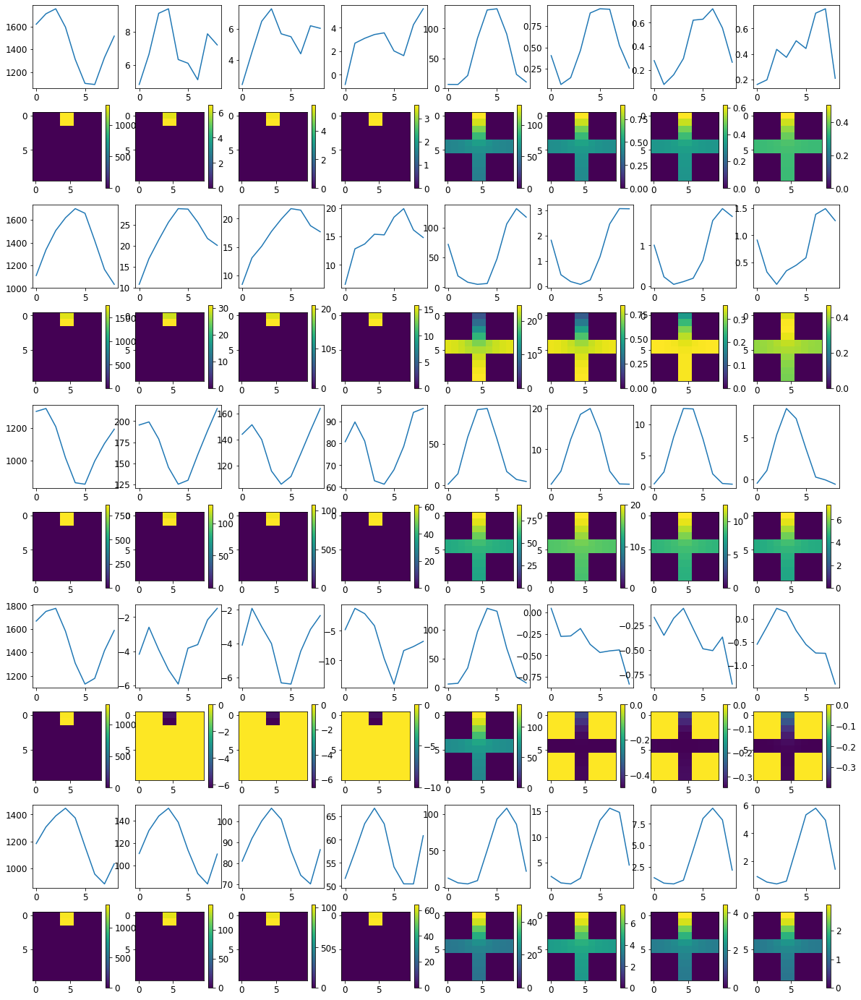

Loss: 


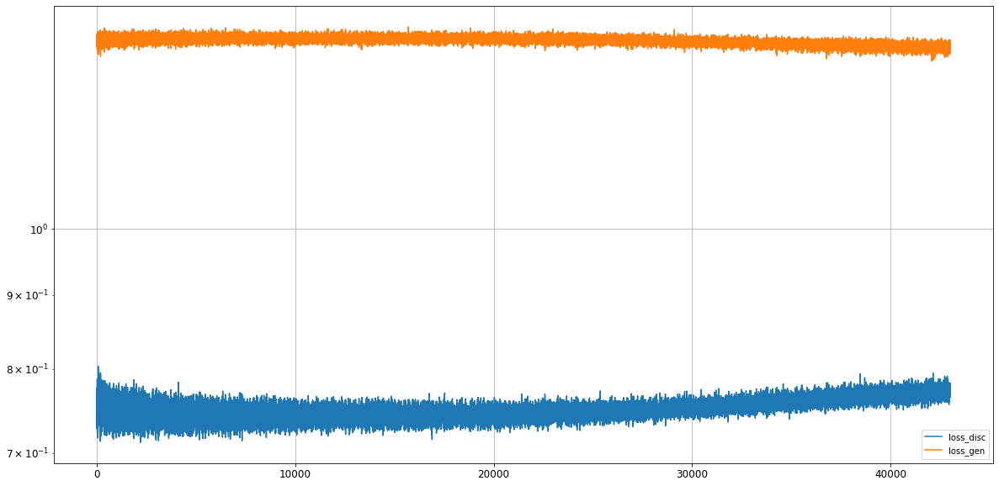

Epoch 43002/50000
discriminator loss: 1.341986 - generator loss: 0.760879 - 1s
Epoch 43003/50000
discriminator loss: 1.328260 - generator loss: 0.776413 - 1s
Epoch 43004/50000
discriminator loss: 1.323372 - generator loss: 0.787168 - 1s
Epoch 43005/50000
discriminator loss: 1.325639 - generator loss: 0.776719 - 1s
Epoch 43006/50000
discriminator loss: 1.322292 - generator loss: 0.780437 - 1s
Epoch 43007/50000
discriminator loss: 1.338415 - generator loss: 0.767181 - 1s
Epoch 43008/50000
discriminator loss: 1.340793 - generator loss: 0.768147 - 1s
Epoch 43009/50000
discriminator loss: 1.331784 - generator loss: 0.780741 - 1s
Epoch 43010/50000
discriminator loss: 1.332268 - generator loss: 0.767593 - 1s
Epoch 43011/50000
discriminator loss: 1.342830 - generator loss: 0.777108 - 1s
Epoch 43012/50000
discriminator loss: 1.339271 - generator loss: 0.765867 - 1s
Epoch 43013/50000
discriminator loss: 1.339112 - generator loss: 0.765279 - 1s
Epoch 43014/50000
discriminator loss: 1.331792 - gen

discriminator loss: 1.335135 - generator loss: 0.777910 - 1s
Epoch 43107/50000
discriminator loss: 1.337951 - generator loss: 0.772355 - 1s
Epoch 43108/50000
discriminator loss: 1.352703 - generator loss: 0.759269 - 1s
Epoch 43109/50000
discriminator loss: 1.327443 - generator loss: 0.779501 - 1s
Epoch 43110/50000
discriminator loss: 1.332577 - generator loss: 0.778682 - 1s
Epoch 43111/50000
discriminator loss: 1.330521 - generator loss: 0.770556 - 1s
Epoch 43112/50000
discriminator loss: 1.340842 - generator loss: 0.759785 - 1s
Epoch 43113/50000
discriminator loss: 1.334791 - generator loss: 0.774693 - 1s
Epoch 43114/50000
discriminator loss: 1.331317 - generator loss: 0.769534 - 1s
Epoch 43115/50000
discriminator loss: 1.343136 - generator loss: 0.763530 - 1s
Epoch 43116/50000
discriminator loss: 1.336657 - generator loss: 0.781056 - 1s
Epoch 43117/50000
discriminator loss: 1.326388 - generator loss: 0.784547 - 1s
Epoch 43118/50000
discriminator loss: 1.327840 - generator loss: 0.772

discriminator loss: 1.350515 - generator loss: 0.762236 - 1s
Epoch 43211/50000
discriminator loss: 1.337472 - generator loss: 0.765484 - 1s
Epoch 43212/50000
discriminator loss: 1.351271 - generator loss: 0.760198 - 1s
Epoch 43213/50000
discriminator loss: 1.334742 - generator loss: 0.770479 - 1s
Epoch 43214/50000
discriminator loss: 1.344828 - generator loss: 0.764399 - 1s
Epoch 43215/50000
discriminator loss: 1.332234 - generator loss: 0.781698 - 1s
Epoch 43216/50000
discriminator loss: 1.334643 - generator loss: 0.773077 - 1s
Epoch 43217/50000
discriminator loss: 1.328654 - generator loss: 0.778835 - 1s
Epoch 43218/50000
discriminator loss: 1.328997 - generator loss: 0.776814 - 1s
Epoch 43219/50000
discriminator loss: 1.331282 - generator loss: 0.776856 - 1s
Epoch 43220/50000
discriminator loss: 1.318836 - generator loss: 0.781795 - 1s
Epoch 43221/50000
discriminator loss: 1.340628 - generator loss: 0.765684 - 1s
Epoch 43222/50000
discriminator loss: 1.322442 - generator loss: 0.780

discriminator loss: 1.338817 - generator loss: 0.770969 - 1s
Epoch 43315/50000
discriminator loss: 1.350260 - generator loss: 0.764002 - 1s
Epoch 43316/50000
discriminator loss: 1.335463 - generator loss: 0.768790 - 1s
Epoch 43317/50000
discriminator loss: 1.342213 - generator loss: 0.762553 - 1s
Epoch 43318/50000
discriminator loss: 1.340834 - generator loss: 0.763410 - 1s
Epoch 43319/50000
discriminator loss: 1.338348 - generator loss: 0.771952 - 1s
Epoch 43320/50000
discriminator loss: 1.341357 - generator loss: 0.768308 - 1s
Epoch 43321/50000
discriminator loss: 1.347629 - generator loss: 0.763106 - 1s
Epoch 43322/50000
discriminator loss: 1.340749 - generator loss: 0.771850 - 1s
Epoch 43323/50000
discriminator loss: 1.338624 - generator loss: 0.769100 - 1s
Epoch 43324/50000
discriminator loss: 1.332802 - generator loss: 0.776204 - 1s
Epoch 43325/50000
discriminator loss: 1.339906 - generator loss: 0.769350 - 1s
Epoch 43326/50000
discriminator loss: 1.333871 - generator loss: 0.771

discriminator loss: 1.338732 - generator loss: 0.770425 - 1s
Epoch 43419/50000
discriminator loss: 1.335741 - generator loss: 0.764823 - 1s
Epoch 43420/50000
discriminator loss: 1.327498 - generator loss: 0.773780 - 1s
Epoch 43421/50000
discriminator loss: 1.344103 - generator loss: 0.766340 - 1s
Epoch 43422/50000
discriminator loss: 1.334602 - generator loss: 0.769113 - 1s
Epoch 43423/50000
discriminator loss: 1.330913 - generator loss: 0.770295 - 1s
Epoch 43424/50000
discriminator loss: 1.336875 - generator loss: 0.766859 - 1s
Epoch 43425/50000
discriminator loss: 1.341798 - generator loss: 0.775757 - 1s
Epoch 43426/50000
discriminator loss: 1.344971 - generator loss: 0.764541 - 1s
Epoch 43427/50000
discriminator loss: 1.341547 - generator loss: 0.772189 - 1s
Epoch 43428/50000
discriminator loss: 1.332668 - generator loss: 0.777379 - 1s
Epoch 43429/50000
discriminator loss: 1.331222 - generator loss: 0.770911 - 1s
Epoch 43430/50000
discriminator loss: 1.349007 - generator loss: 0.764

discriminator loss: 1.337488 - generator loss: 0.772569 - 1s
Epoch 43523/50000
discriminator loss: 1.323250 - generator loss: 0.783896 - 1s
Epoch 43524/50000
discriminator loss: 1.327423 - generator loss: 0.769736 - 1s
Epoch 43525/50000
discriminator loss: 1.337499 - generator loss: 0.765591 - 1s
Epoch 43526/50000
discriminator loss: 1.335809 - generator loss: 0.771855 - 1s
Epoch 43527/50000
discriminator loss: 1.340982 - generator loss: 0.764268 - 1s
Epoch 43528/50000
discriminator loss: 1.339852 - generator loss: 0.770955 - 1s
Epoch 43529/50000
discriminator loss: 1.331594 - generator loss: 0.783231 - 1s
Epoch 43530/50000
discriminator loss: 1.322379 - generator loss: 0.781724 - 1s
Epoch 43531/50000
discriminator loss: 1.318220 - generator loss: 0.784700 - 1s
Epoch 43532/50000
discriminator loss: 1.339581 - generator loss: 0.763378 - 1s
Epoch 43533/50000
discriminator loss: 1.332526 - generator loss: 0.771978 - 1s
Epoch 43534/50000
discriminator loss: 1.342292 - generator loss: 0.766

discriminator loss: 1.342493 - generator loss: 0.760626 - 1s
Epoch 43627/50000
discriminator loss: 1.328128 - generator loss: 0.776389 - 1s
Epoch 43628/50000
discriminator loss: 1.320505 - generator loss: 0.782494 - 1s
Epoch 43629/50000
discriminator loss: 1.337818 - generator loss: 0.769722 - 1s
Epoch 43630/50000
discriminator loss: 1.336857 - generator loss: 0.772896 - 1s
Epoch 43631/50000
discriminator loss: 1.322719 - generator loss: 0.786558 - 1s
Epoch 43632/50000
discriminator loss: 1.335632 - generator loss: 0.768520 - 1s
Epoch 43633/50000
discriminator loss: 1.336520 - generator loss: 0.773578 - 1s
Epoch 43634/50000
discriminator loss: 1.331271 - generator loss: 0.768034 - 1s
Epoch 43635/50000
discriminator loss: 1.350690 - generator loss: 0.754660 - 1s
Epoch 43636/50000
discriminator loss: 1.338417 - generator loss: 0.767766 - 1s
Epoch 43637/50000
discriminator loss: 1.347172 - generator loss: 0.761804 - 1s
Epoch 43638/50000
discriminator loss: 1.327107 - generator loss: 0.782

discriminator loss: 1.336138 - generator loss: 0.772454 - 1s
Epoch 43731/50000
discriminator loss: 1.342960 - generator loss: 0.767383 - 1s
Epoch 43732/50000
discriminator loss: 1.341982 - generator loss: 0.772619 - 1s
Epoch 43733/50000
discriminator loss: 1.344766 - generator loss: 0.763274 - 1s
Epoch 43734/50000
discriminator loss: 1.331070 - generator loss: 0.772094 - 1s
Epoch 43735/50000
discriminator loss: 1.330812 - generator loss: 0.771514 - 1s
Epoch 43736/50000
discriminator loss: 1.317775 - generator loss: 0.777367 - 1s
Epoch 43737/50000
discriminator loss: 1.320700 - generator loss: 0.783140 - 1s
Epoch 43738/50000
discriminator loss: 1.342329 - generator loss: 0.771949 - 1s
Epoch 43739/50000
discriminator loss: 1.340610 - generator loss: 0.773230 - 1s
Epoch 43740/50000
discriminator loss: 1.336237 - generator loss: 0.768312 - 1s
Epoch 43741/50000
discriminator loss: 1.328632 - generator loss: 0.768537 - 1s
Epoch 43742/50000
discriminator loss: 1.345970 - generator loss: 0.768

discriminator loss: 1.330366 - generator loss: 0.775083 - 1s
Epoch 43835/50000
discriminator loss: 1.338329 - generator loss: 0.775590 - 1s
Epoch 43836/50000
discriminator loss: 1.339690 - generator loss: 0.776828 - 1s
Epoch 43837/50000
discriminator loss: 1.335416 - generator loss: 0.765852 - 1s
Epoch 43838/50000
discriminator loss: 1.338335 - generator loss: 0.764364 - 1s
Epoch 43839/50000
discriminator loss: 1.337376 - generator loss: 0.767693 - 1s
Epoch 43840/50000
discriminator loss: 1.332805 - generator loss: 0.772643 - 1s
Epoch 43841/50000
discriminator loss: 1.333097 - generator loss: 0.777700 - 1s
Epoch 43842/50000
discriminator loss: 1.331002 - generator loss: 0.771739 - 1s
Epoch 43843/50000
discriminator loss: 1.332485 - generator loss: 0.773525 - 1s
Epoch 43844/50000
discriminator loss: 1.345911 - generator loss: 0.767092 - 1s
Epoch 43845/50000
discriminator loss: 1.340186 - generator loss: 0.769434 - 1s
Epoch 43846/50000
discriminator loss: 1.336439 - generator loss: 0.778

discriminator loss: 1.343622 - generator loss: 0.762494 - 1s
Epoch 43939/50000
discriminator loss: 1.332364 - generator loss: 0.780579 - 1s
Epoch 43940/50000
discriminator loss: 1.329172 - generator loss: 0.780393 - 1s
Epoch 43941/50000
discriminator loss: 1.326800 - generator loss: 0.781940 - 1s
Epoch 43942/50000
discriminator loss: 1.329945 - generator loss: 0.777251 - 1s
Epoch 43943/50000
discriminator loss: 1.345371 - generator loss: 0.757270 - 1s
Epoch 43944/50000
discriminator loss: 1.328403 - generator loss: 0.783023 - 1s
Epoch 43945/50000
discriminator loss: 1.335239 - generator loss: 0.772295 - 1s
Epoch 43946/50000
discriminator loss: 1.347044 - generator loss: 0.758974 - 1s
Epoch 43947/50000
discriminator loss: 1.336388 - generator loss: 0.773438 - 1s
Epoch 43948/50000
discriminator loss: 1.341533 - generator loss: 0.773093 - 1s
Epoch 43949/50000
discriminator loss: 1.338429 - generator loss: 0.780630 - 1s
Epoch 43950/50000
discriminator loss: 1.336505 - generator loss: 0.773

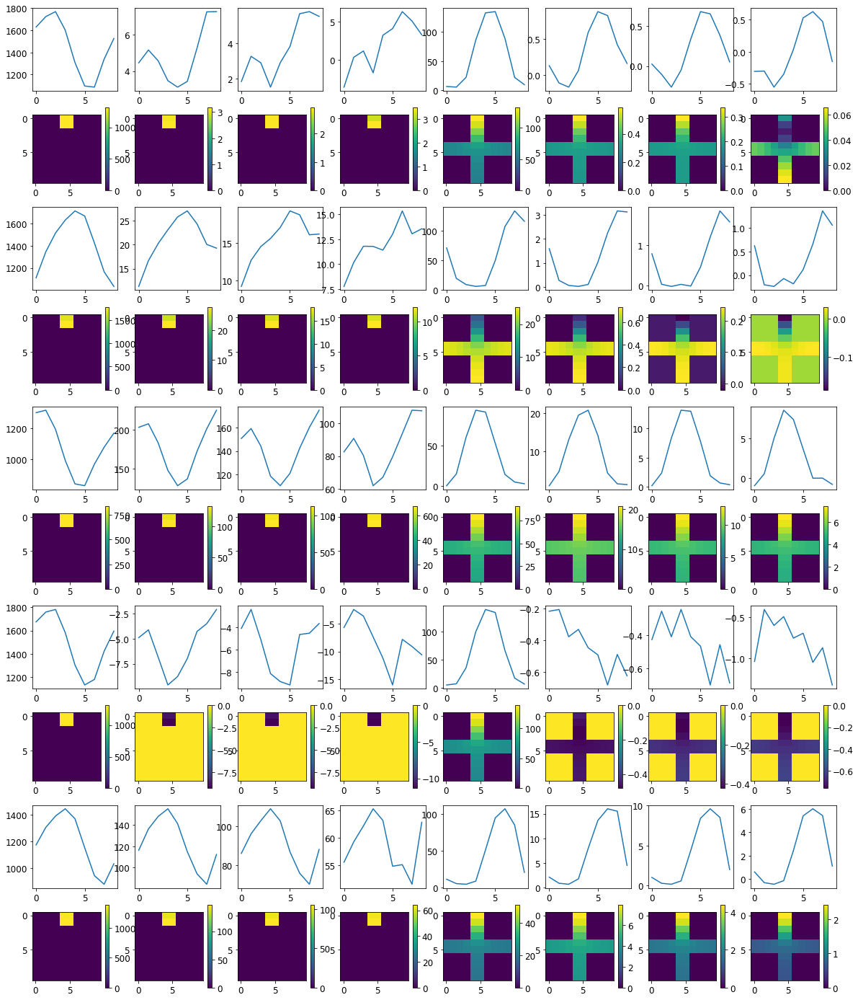

Loss: 


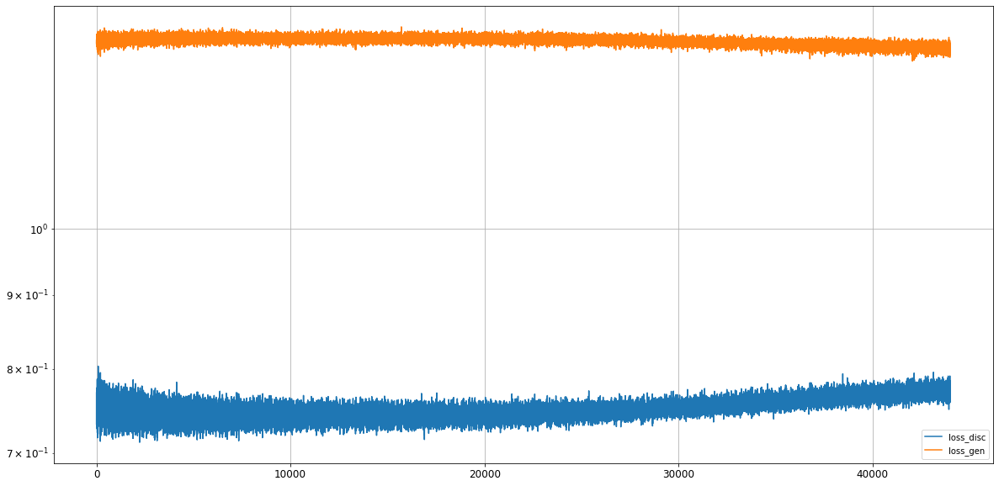

Epoch 44002/50000
discriminator loss: 1.335791 - generator loss: 0.767005 - 1s
Epoch 44003/50000
discriminator loss: 1.335681 - generator loss: 0.768425 - 1s
Epoch 44004/50000
discriminator loss: 1.337075 - generator loss: 0.773378 - 1s
Epoch 44005/50000
discriminator loss: 1.330985 - generator loss: 0.777860 - 1s
Epoch 44006/50000
discriminator loss: 1.332338 - generator loss: 0.770306 - 1s
Epoch 44007/50000
discriminator loss: 1.334523 - generator loss: 0.773732 - 1s
Epoch 44008/50000
discriminator loss: 1.331353 - generator loss: 0.774229 - 1s
Epoch 44009/50000
discriminator loss: 1.344673 - generator loss: 0.768887 - 1s
Epoch 44010/50000
discriminator loss: 1.345413 - generator loss: 0.770187 - 1s
Epoch 44011/50000
discriminator loss: 1.338719 - generator loss: 0.777795 - 1s
Epoch 44012/50000
discriminator loss: 1.331284 - generator loss: 0.767308 - 1s
Epoch 44013/50000
discriminator loss: 1.335351 - generator loss: 0.773608 - 1s
Epoch 44014/50000
discriminator loss: 1.339053 - gen

discriminator loss: 1.332957 - generator loss: 0.783374 - 1s
Epoch 44107/50000
discriminator loss: 1.332530 - generator loss: 0.772982 - 1s
Epoch 44108/50000
discriminator loss: 1.323207 - generator loss: 0.778417 - 1s
Epoch 44109/50000
discriminator loss: 1.334875 - generator loss: 0.772719 - 1s
Epoch 44110/50000
discriminator loss: 1.328863 - generator loss: 0.781392 - 1s
Epoch 44111/50000
discriminator loss: 1.333335 - generator loss: 0.779116 - 1s
Epoch 44112/50000
discriminator loss: 1.335140 - generator loss: 0.769982 - 1s
Epoch 44113/50000
discriminator loss: 1.335145 - generator loss: 0.777912 - 1s
Epoch 44114/50000
discriminator loss: 1.333331 - generator loss: 0.778018 - 1s
Epoch 44115/50000
discriminator loss: 1.323998 - generator loss: 0.786577 - 1s
Epoch 44116/50000
discriminator loss: 1.349566 - generator loss: 0.753810 - 1s
Epoch 44117/50000
discriminator loss: 1.333741 - generator loss: 0.764776 - 1s
Epoch 44118/50000
discriminator loss: 1.339057 - generator loss: 0.777

discriminator loss: 1.330054 - generator loss: 0.774375 - 1s
Epoch 44211/50000
discriminator loss: 1.331270 - generator loss: 0.776472 - 1s
Epoch 44212/50000
discriminator loss: 1.323361 - generator loss: 0.780288 - 1s
Epoch 44213/50000
discriminator loss: 1.331099 - generator loss: 0.768378 - 1s
Epoch 44214/50000
discriminator loss: 1.312654 - generator loss: 0.784898 - 1s
Epoch 44215/50000
discriminator loss: 1.316073 - generator loss: 0.785620 - 1s
Epoch 44216/50000
discriminator loss: 1.334557 - generator loss: 0.773286 - 1s
Epoch 44217/50000
discriminator loss: 1.333529 - generator loss: 0.772657 - 1s
Epoch 44218/50000
discriminator loss: 1.325498 - generator loss: 0.780267 - 1s
Epoch 44219/50000
discriminator loss: 1.338689 - generator loss: 0.768840 - 1s
Epoch 44220/50000
discriminator loss: 1.330463 - generator loss: 0.773467 - 1s
Epoch 44221/50000
discriminator loss: 1.329985 - generator loss: 0.779227 - 1s
Epoch 44222/50000
discriminator loss: 1.336128 - generator loss: 0.775

discriminator loss: 1.325159 - generator loss: 0.788078 - 1s
Epoch 44315/50000
discriminator loss: 1.332672 - generator loss: 0.778189 - 1s
Epoch 44316/50000
discriminator loss: 1.336419 - generator loss: 0.766519 - 1s
Epoch 44317/50000
discriminator loss: 1.327536 - generator loss: 0.778602 - 1s
Epoch 44318/50000
discriminator loss: 1.332656 - generator loss: 0.774065 - 1s
Epoch 44319/50000
discriminator loss: 1.349882 - generator loss: 0.761282 - 1s
Epoch 44320/50000
discriminator loss: 1.336439 - generator loss: 0.771292 - 1s
Epoch 44321/50000
discriminator loss: 1.340889 - generator loss: 0.763580 - 1s
Epoch 44322/50000
discriminator loss: 1.346507 - generator loss: 0.768971 - 1s
Epoch 44323/50000
discriminator loss: 1.347318 - generator loss: 0.767337 - 1s
Epoch 44324/50000
discriminator loss: 1.330694 - generator loss: 0.776657 - 1s
Epoch 44325/50000
discriminator loss: 1.318075 - generator loss: 0.780898 - 1s
Epoch 44326/50000
discriminator loss: 1.334262 - generator loss: 0.770

discriminator loss: 1.327826 - generator loss: 0.769573 - 1s
Epoch 44419/50000
discriminator loss: 1.340185 - generator loss: 0.769286 - 1s
Epoch 44420/50000
discriminator loss: 1.333263 - generator loss: 0.769625 - 1s
Epoch 44421/50000
discriminator loss: 1.343679 - generator loss: 0.773893 - 1s
Epoch 44422/50000
discriminator loss: 1.336992 - generator loss: 0.774912 - 1s
Epoch 44423/50000
discriminator loss: 1.332188 - generator loss: 0.772476 - 1s
Epoch 44424/50000
discriminator loss: 1.337078 - generator loss: 0.771074 - 1s
Epoch 44425/50000
discriminator loss: 1.331317 - generator loss: 0.775446 - 1s
Epoch 44426/50000
discriminator loss: 1.329810 - generator loss: 0.768386 - 1s
Epoch 44427/50000
discriminator loss: 1.344244 - generator loss: 0.772015 - 1s
Epoch 44428/50000
discriminator loss: 1.350380 - generator loss: 0.767415 - 1s
Epoch 44429/50000
discriminator loss: 1.342601 - generator loss: 0.772301 - 1s
Epoch 44430/50000
discriminator loss: 1.328122 - generator loss: 0.775

discriminator loss: 1.327404 - generator loss: 0.785089 - 1s
Epoch 44523/50000
discriminator loss: 1.337583 - generator loss: 0.770648 - 1s
Epoch 44524/50000
discriminator loss: 1.344026 - generator loss: 0.773157 - 1s
Epoch 44525/50000
discriminator loss: 1.327648 - generator loss: 0.775154 - 1s
Epoch 44526/50000
discriminator loss: 1.337830 - generator loss: 0.770190 - 1s
Epoch 44527/50000
discriminator loss: 1.334387 - generator loss: 0.773932 - 1s
Epoch 44528/50000
discriminator loss: 1.333065 - generator loss: 0.781970 - 1s
Epoch 44529/50000
discriminator loss: 1.346935 - generator loss: 0.765614 - 1s
Epoch 44530/50000
discriminator loss: 1.340929 - generator loss: 0.767167 - 1s
Epoch 44531/50000
discriminator loss: 1.339501 - generator loss: 0.767560 - 1s
Epoch 44532/50000
discriminator loss: 1.334774 - generator loss: 0.769859 - 1s
Epoch 44533/50000
discriminator loss: 1.334516 - generator loss: 0.767763 - 1s
Epoch 44534/50000
discriminator loss: 1.334421 - generator loss: 0.781

discriminator loss: 1.348121 - generator loss: 0.760264 - 1s
Epoch 44627/50000
discriminator loss: 1.328561 - generator loss: 0.777108 - 1s
Epoch 44628/50000
discriminator loss: 1.340411 - generator loss: 0.770890 - 1s
Epoch 44629/50000
discriminator loss: 1.330075 - generator loss: 0.781622 - 1s
Epoch 44630/50000
discriminator loss: 1.340858 - generator loss: 0.766661 - 1s
Epoch 44631/50000
discriminator loss: 1.335192 - generator loss: 0.773960 - 1s
Epoch 44632/50000
discriminator loss: 1.327025 - generator loss: 0.776402 - 1s
Epoch 44633/50000
discriminator loss: 1.337739 - generator loss: 0.761251 - 1s
Epoch 44634/50000
discriminator loss: 1.334812 - generator loss: 0.778282 - 1s
Epoch 44635/50000
discriminator loss: 1.333284 - generator loss: 0.772905 - 1s
Epoch 44636/50000
discriminator loss: 1.326115 - generator loss: 0.782437 - 1s
Epoch 44637/50000
discriminator loss: 1.341322 - generator loss: 0.776140 - 1s
Epoch 44638/50000
discriminator loss: 1.335904 - generator loss: 0.770

discriminator loss: 1.338128 - generator loss: 0.769489 - 1s
Epoch 44731/50000
discriminator loss: 1.331242 - generator loss: 0.778807 - 1s
Epoch 44732/50000
discriminator loss: 1.335077 - generator loss: 0.773885 - 1s
Epoch 44733/50000
discriminator loss: 1.337673 - generator loss: 0.760989 - 1s
Epoch 44734/50000
discriminator loss: 1.327866 - generator loss: 0.783914 - 1s
Epoch 44735/50000
discriminator loss: 1.336892 - generator loss: 0.768426 - 1s
Epoch 44736/50000
discriminator loss: 1.337602 - generator loss: 0.772052 - 1s
Epoch 44737/50000
discriminator loss: 1.344639 - generator loss: 0.771986 - 1s
Epoch 44738/50000
discriminator loss: 1.338170 - generator loss: 0.764764 - 1s
Epoch 44739/50000
discriminator loss: 1.334976 - generator loss: 0.778909 - 1s
Epoch 44740/50000
discriminator loss: 1.335723 - generator loss: 0.773784 - 1s
Epoch 44741/50000
discriminator loss: 1.311371 - generator loss: 0.784361 - 1s
Epoch 44742/50000
discriminator loss: 1.331926 - generator loss: 0.776

discriminator loss: 1.330863 - generator loss: 0.769605 - 1s
Epoch 44835/50000
discriminator loss: 1.328184 - generator loss: 0.776643 - 1s
Epoch 44836/50000
discriminator loss: 1.333179 - generator loss: 0.775523 - 1s
Epoch 44837/50000
discriminator loss: 1.337398 - generator loss: 0.769235 - 1s
Epoch 44838/50000
discriminator loss: 1.335356 - generator loss: 0.776744 - 1s
Epoch 44839/50000
discriminator loss: 1.338948 - generator loss: 0.767341 - 1s
Epoch 44840/50000
discriminator loss: 1.333313 - generator loss: 0.772222 - 1s
Epoch 44841/50000
discriminator loss: 1.335923 - generator loss: 0.779249 - 1s
Epoch 44842/50000
discriminator loss: 1.339361 - generator loss: 0.769696 - 1s
Epoch 44843/50000
discriminator loss: 1.344131 - generator loss: 0.764696 - 1s
Epoch 44844/50000
discriminator loss: 1.347773 - generator loss: 0.763998 - 1s
Epoch 44845/50000
discriminator loss: 1.343529 - generator loss: 0.760717 - 1s
Epoch 44846/50000
discriminator loss: 1.331011 - generator loss: 0.777

discriminator loss: 1.348167 - generator loss: 0.764494 - 1s
Epoch 44939/50000
discriminator loss: 1.339135 - generator loss: 0.770361 - 1s
Epoch 44940/50000
discriminator loss: 1.342605 - generator loss: 0.763697 - 1s
Epoch 44941/50000
discriminator loss: 1.332614 - generator loss: 0.782385 - 1s
Epoch 44942/50000
discriminator loss: 1.341375 - generator loss: 0.760908 - 1s
Epoch 44943/50000
discriminator loss: 1.335955 - generator loss: 0.779038 - 1s
Epoch 44944/50000
discriminator loss: 1.334123 - generator loss: 0.771219 - 1s
Epoch 44945/50000
discriminator loss: 1.344509 - generator loss: 0.761398 - 1s
Epoch 44946/50000
discriminator loss: 1.326783 - generator loss: 0.777938 - 1s
Epoch 44947/50000
discriminator loss: 1.334483 - generator loss: 0.777998 - 1s
Epoch 44948/50000
discriminator loss: 1.332085 - generator loss: 0.776101 - 1s
Epoch 44949/50000
discriminator loss: 1.326313 - generator loss: 0.778470 - 1s
Epoch 44950/50000
discriminator loss: 1.342509 - generator loss: 0.766

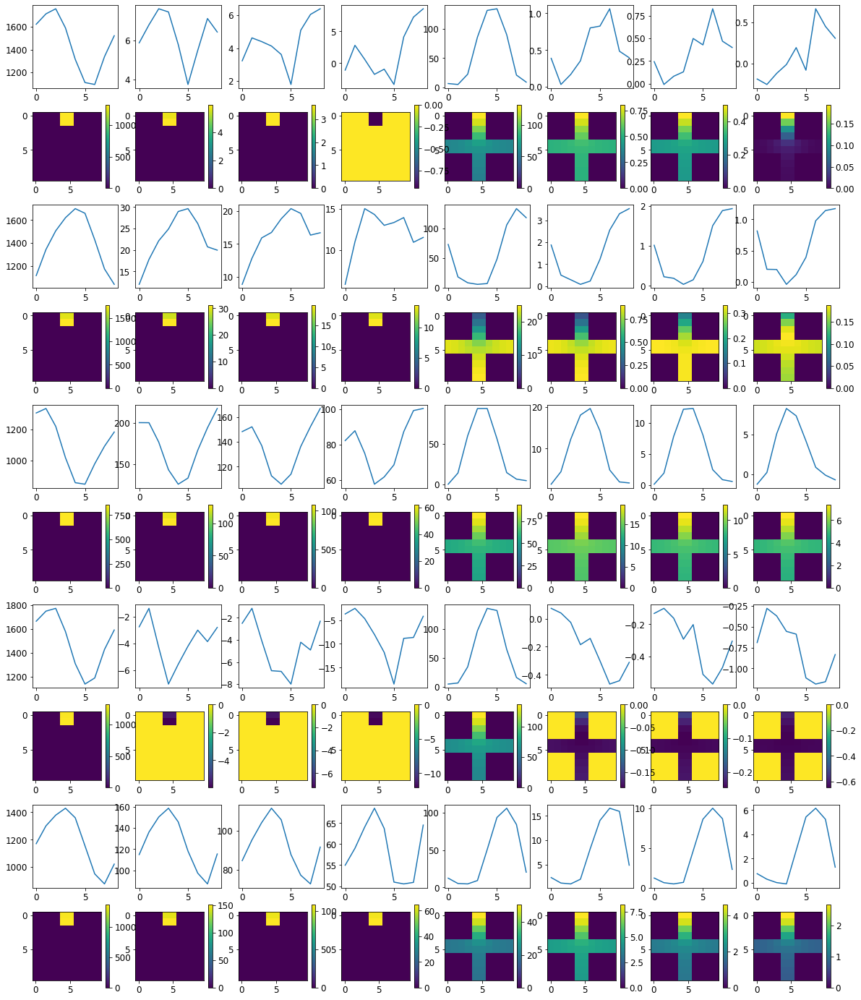

Loss: 


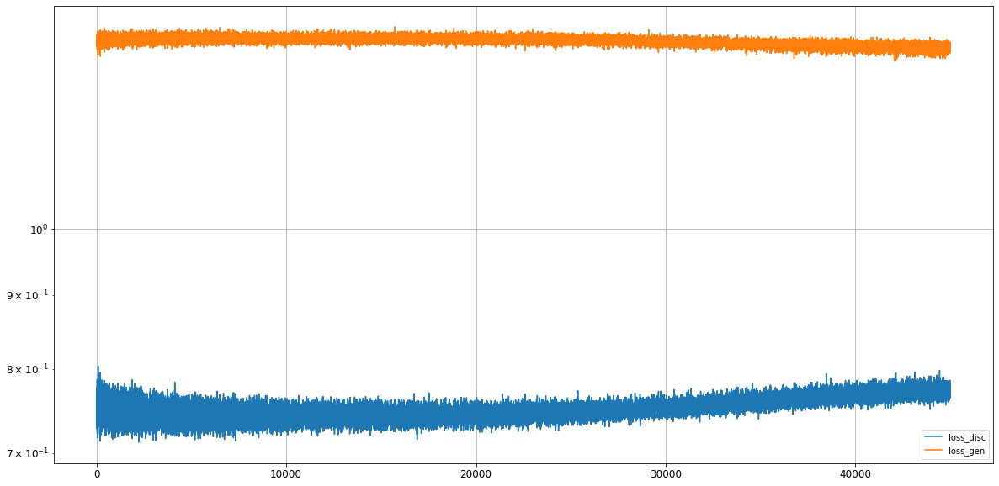

Epoch 45002/50000
discriminator loss: 1.332147 - generator loss: 0.773048 - 1s
Epoch 45003/50000
discriminator loss: 1.324156 - generator loss: 0.785816 - 1s
Epoch 45004/50000
discriminator loss: 1.338339 - generator loss: 0.772417 - 1s
Epoch 45005/50000
discriminator loss: 1.342777 - generator loss: 0.765797 - 1s
Epoch 45006/50000
discriminator loss: 1.333426 - generator loss: 0.776052 - 1s
Epoch 45007/50000
discriminator loss: 1.323462 - generator loss: 0.783494 - 1s
Epoch 45008/50000
discriminator loss: 1.314987 - generator loss: 0.786564 - 1s
Epoch 45009/50000
discriminator loss: 1.348488 - generator loss: 0.768267 - 1s
Epoch 45010/50000
discriminator loss: 1.341792 - generator loss: 0.774353 - 1s
Epoch 45011/50000
discriminator loss: 1.327194 - generator loss: 0.770002 - 1s
Epoch 45012/50000
discriminator loss: 1.328156 - generator loss: 0.779337 - 1s
Epoch 45013/50000
discriminator loss: 1.339970 - generator loss: 0.763900 - 1s
Epoch 45014/50000
discriminator loss: 1.332658 - gen

discriminator loss: 1.334280 - generator loss: 0.767279 - 1s
Epoch 45107/50000
discriminator loss: 1.338883 - generator loss: 0.769664 - 1s
Epoch 45108/50000
discriminator loss: 1.334940 - generator loss: 0.779747 - 1s
Epoch 45109/50000
discriminator loss: 1.340853 - generator loss: 0.780639 - 1s
Epoch 45110/50000
discriminator loss: 1.330449 - generator loss: 0.781492 - 1s
Epoch 45111/50000
discriminator loss: 1.330964 - generator loss: 0.769888 - 1s
Epoch 45112/50000
discriminator loss: 1.334092 - generator loss: 0.771101 - 1s
Epoch 45113/50000
discriminator loss: 1.324308 - generator loss: 0.782491 - 1s
Epoch 45114/50000
discriminator loss: 1.337407 - generator loss: 0.772690 - 1s
Epoch 45115/50000
discriminator loss: 1.328520 - generator loss: 0.774426 - 1s
Epoch 45116/50000
discriminator loss: 1.342103 - generator loss: 0.767843 - 1s
Epoch 45117/50000
discriminator loss: 1.321440 - generator loss: 0.786332 - 1s
Epoch 45118/50000
discriminator loss: 1.321612 - generator loss: 0.781

discriminator loss: 1.340189 - generator loss: 0.779792 - 1s
Epoch 45211/50000
discriminator loss: 1.334639 - generator loss: 0.772398 - 1s
Epoch 45212/50000
discriminator loss: 1.329136 - generator loss: 0.792616 - 1s
Epoch 45213/50000
discriminator loss: 1.329052 - generator loss: 0.774383 - 1s
Epoch 45214/50000
discriminator loss: 1.335661 - generator loss: 0.773433 - 1s
Epoch 45215/50000
discriminator loss: 1.332140 - generator loss: 0.774401 - 1s
Epoch 45216/50000
discriminator loss: 1.351625 - generator loss: 0.762530 - 1s
Epoch 45217/50000
discriminator loss: 1.336337 - generator loss: 0.782693 - 1s
Epoch 45218/50000
discriminator loss: 1.329004 - generator loss: 0.778731 - 1s
Epoch 45219/50000
discriminator loss: 1.346860 - generator loss: 0.760634 - 1s
Epoch 45220/50000
discriminator loss: 1.330486 - generator loss: 0.781761 - 1s
Epoch 45221/50000
discriminator loss: 1.338473 - generator loss: 0.768523 - 1s
Epoch 45222/50000
discriminator loss: 1.324711 - generator loss: 0.784

discriminator loss: 1.322395 - generator loss: 0.779390 - 1s
Epoch 45315/50000
discriminator loss: 1.335318 - generator loss: 0.765773 - 1s
Epoch 45316/50000
discriminator loss: 1.338840 - generator loss: 0.772593 - 1s
Epoch 45317/50000
discriminator loss: 1.341550 - generator loss: 0.767649 - 1s
Epoch 45318/50000
discriminator loss: 1.338368 - generator loss: 0.772372 - 1s
Epoch 45319/50000
discriminator loss: 1.329252 - generator loss: 0.787270 - 1s
Epoch 45320/50000
discriminator loss: 1.321173 - generator loss: 0.784250 - 1s
Epoch 45321/50000
discriminator loss: 1.331956 - generator loss: 0.777187 - 1s
Epoch 45322/50000
discriminator loss: 1.326187 - generator loss: 0.775043 - 1s
Epoch 45323/50000
discriminator loss: 1.333165 - generator loss: 0.767492 - 1s
Epoch 45324/50000
discriminator loss: 1.322791 - generator loss: 0.785077 - 1s
Epoch 45325/50000
discriminator loss: 1.330147 - generator loss: 0.772165 - 1s
Epoch 45326/50000
discriminator loss: 1.336241 - generator loss: 0.767

discriminator loss: 1.329142 - generator loss: 0.781267 - 1s
Epoch 45419/50000
discriminator loss: 1.332372 - generator loss: 0.772853 - 1s
Epoch 45420/50000
discriminator loss: 1.325225 - generator loss: 0.780574 - 1s
Epoch 45421/50000
discriminator loss: 1.332478 - generator loss: 0.783975 - 1s
Epoch 45422/50000
discriminator loss: 1.339924 - generator loss: 0.763964 - 1s
Epoch 45423/50000
discriminator loss: 1.337280 - generator loss: 0.771374 - 1s
Epoch 45424/50000
discriminator loss: 1.338118 - generator loss: 0.767159 - 1s
Epoch 45425/50000
discriminator loss: 1.321751 - generator loss: 0.780464 - 1s
Epoch 45426/50000
discriminator loss: 1.333479 - generator loss: 0.784306 - 1s
Epoch 45427/50000
discriminator loss: 1.330864 - generator loss: 0.779828 - 1s
Epoch 45428/50000
discriminator loss: 1.326276 - generator loss: 0.777064 - 1s
Epoch 45429/50000
discriminator loss: 1.324973 - generator loss: 0.769687 - 1s
Epoch 45430/50000
discriminator loss: 1.341867 - generator loss: 0.770

discriminator loss: 1.337735 - generator loss: 0.772186 - 1s
Epoch 45523/50000
discriminator loss: 1.337216 - generator loss: 0.773032 - 1s
Epoch 45524/50000
discriminator loss: 1.333379 - generator loss: 0.762751 - 1s
Epoch 45525/50000
discriminator loss: 1.329623 - generator loss: 0.770291 - 1s
Epoch 45526/50000
discriminator loss: 1.331385 - generator loss: 0.778771 - 1s
Epoch 45527/50000
discriminator loss: 1.331631 - generator loss: 0.777590 - 1s
Epoch 45528/50000
discriminator loss: 1.324360 - generator loss: 0.783742 - 1s
Epoch 45529/50000
discriminator loss: 1.341672 - generator loss: 0.767122 - 1s
Epoch 45530/50000
discriminator loss: 1.331778 - generator loss: 0.778460 - 1s
Epoch 45531/50000
discriminator loss: 1.338501 - generator loss: 0.776758 - 1s
Epoch 45532/50000
discriminator loss: 1.334508 - generator loss: 0.772336 - 1s
Epoch 45533/50000
discriminator loss: 1.326051 - generator loss: 0.776086 - 1s
Epoch 45534/50000
discriminator loss: 1.343513 - generator loss: 0.768

discriminator loss: 1.332573 - generator loss: 0.774772 - 1s
Epoch 45627/50000
discriminator loss: 1.337270 - generator loss: 0.770805 - 1s
Epoch 45628/50000
discriminator loss: 1.333162 - generator loss: 0.768883 - 1s
Epoch 45629/50000
discriminator loss: 1.336787 - generator loss: 0.779551 - 1s
Epoch 45630/50000
discriminator loss: 1.334438 - generator loss: 0.775960 - 1s
Epoch 45631/50000
discriminator loss: 1.337979 - generator loss: 0.772317 - 1s
Epoch 45632/50000
discriminator loss: 1.333016 - generator loss: 0.770610 - 1s
Epoch 45633/50000
discriminator loss: 1.341217 - generator loss: 0.765755 - 1s
Epoch 45634/50000
discriminator loss: 1.341775 - generator loss: 0.767033 - 1s
Epoch 45635/50000
discriminator loss: 1.340992 - generator loss: 0.771037 - 1s
Epoch 45636/50000
discriminator loss: 1.341257 - generator loss: 0.767350 - 1s
Epoch 45637/50000
discriminator loss: 1.326495 - generator loss: 0.780416 - 1s
Epoch 45638/50000
discriminator loss: 1.334875 - generator loss: 0.778

discriminator loss: 1.336269 - generator loss: 0.770990 - 1s
Epoch 45731/50000
discriminator loss: 1.325266 - generator loss: 0.779134 - 1s
Epoch 45732/50000
discriminator loss: 1.339885 - generator loss: 0.767299 - 1s
Epoch 45733/50000
discriminator loss: 1.323972 - generator loss: 0.775536 - 1s
Epoch 45734/50000
discriminator loss: 1.328564 - generator loss: 0.775813 - 1s
Epoch 45735/50000
discriminator loss: 1.328457 - generator loss: 0.775236 - 1s
Epoch 45736/50000
discriminator loss: 1.336871 - generator loss: 0.772096 - 1s
Epoch 45737/50000
discriminator loss: 1.339844 - generator loss: 0.776712 - 1s
Epoch 45738/50000
discriminator loss: 1.337409 - generator loss: 0.766954 - 1s
Epoch 45739/50000
discriminator loss: 1.344566 - generator loss: 0.765118 - 1s
Epoch 45740/50000
discriminator loss: 1.331596 - generator loss: 0.776222 - 1s
Epoch 45741/50000
discriminator loss: 1.343462 - generator loss: 0.773029 - 1s
Epoch 45742/50000
discriminator loss: 1.334156 - generator loss: 0.776

discriminator loss: 1.331895 - generator loss: 0.774666 - 1s
Epoch 45835/50000
discriminator loss: 1.337435 - generator loss: 0.782173 - 1s
Epoch 45836/50000
discriminator loss: 1.325186 - generator loss: 0.776447 - 1s
Epoch 45837/50000
discriminator loss: 1.323270 - generator loss: 0.783083 - 1s
Epoch 45838/50000
discriminator loss: 1.316230 - generator loss: 0.790187 - 1s
Epoch 45839/50000
discriminator loss: 1.336315 - generator loss: 0.772683 - 1s
Epoch 45840/50000
discriminator loss: 1.330968 - generator loss: 0.777683 - 1s
Epoch 45841/50000
discriminator loss: 1.345029 - generator loss: 0.763687 - 1s
Epoch 45842/50000
discriminator loss: 1.339494 - generator loss: 0.775006 - 1s
Epoch 45843/50000
discriminator loss: 1.322254 - generator loss: 0.780552 - 1s
Epoch 45844/50000
discriminator loss: 1.337907 - generator loss: 0.773041 - 1s
Epoch 45845/50000
discriminator loss: 1.327104 - generator loss: 0.775352 - 1s
Epoch 45846/50000
discriminator loss: 1.340403 - generator loss: 0.779

discriminator loss: 1.337896 - generator loss: 0.770163 - 1s
Epoch 45939/50000
discriminator loss: 1.339493 - generator loss: 0.773286 - 1s
Epoch 45940/50000
discriminator loss: 1.330263 - generator loss: 0.776752 - 1s
Epoch 45941/50000
discriminator loss: 1.331531 - generator loss: 0.778189 - 1s
Epoch 45942/50000
discriminator loss: 1.334341 - generator loss: 0.776174 - 1s
Epoch 45943/50000
discriminator loss: 1.339121 - generator loss: 0.767854 - 1s
Epoch 45944/50000
discriminator loss: 1.321280 - generator loss: 0.785530 - 1s
Epoch 45945/50000
discriminator loss: 1.339143 - generator loss: 0.763051 - 1s
Epoch 45946/50000
discriminator loss: 1.340032 - generator loss: 0.771607 - 1s
Epoch 45947/50000
discriminator loss: 1.331281 - generator loss: 0.775109 - 1s
Epoch 45948/50000
discriminator loss: 1.352030 - generator loss: 0.760704 - 1s
Epoch 45949/50000
discriminator loss: 1.343733 - generator loss: 0.769199 - 1s
Epoch 45950/50000
discriminator loss: 1.342884 - generator loss: 0.777

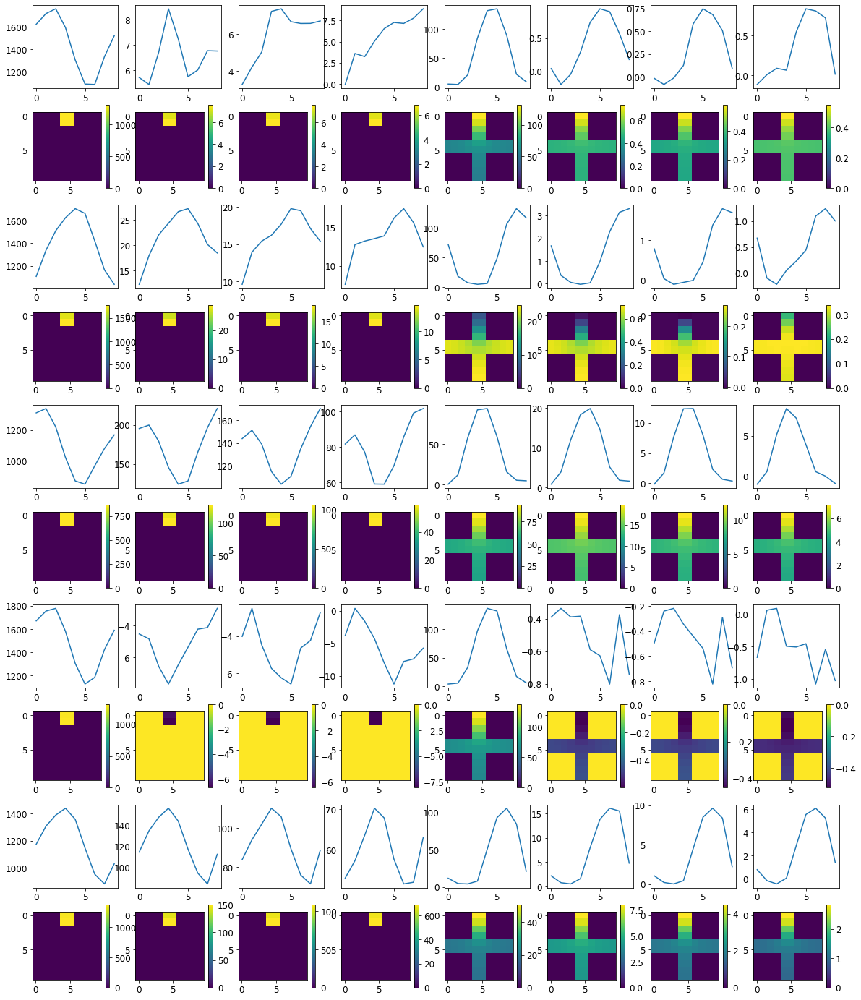

Loss: 


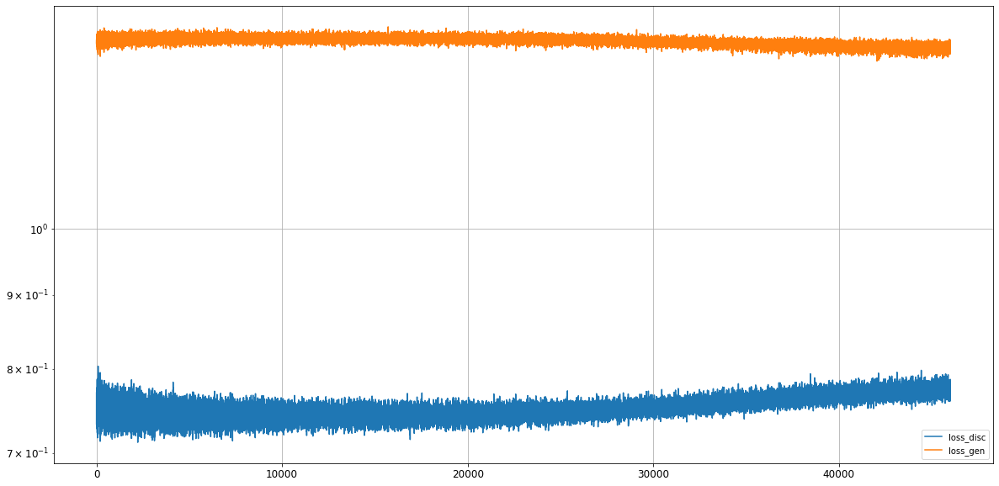

Epoch 46002/50000
discriminator loss: 1.298443 - generator loss: 0.789793 - 1s
Epoch 46003/50000
discriminator loss: 1.322232 - generator loss: 0.786484 - 1s
Epoch 46004/50000
discriminator loss: 1.328303 - generator loss: 0.782060 - 1s
Epoch 46005/50000
discriminator loss: 1.341226 - generator loss: 0.767222 - 1s
Epoch 46006/50000
discriminator loss: 1.328860 - generator loss: 0.776763 - 1s
Epoch 46007/50000
discriminator loss: 1.338739 - generator loss: 0.774187 - 1s
Epoch 46008/50000
discriminator loss: 1.337535 - generator loss: 0.771057 - 1s
Epoch 46009/50000
discriminator loss: 1.330097 - generator loss: 0.774362 - 1s
Epoch 46010/50000
discriminator loss: 1.336645 - generator loss: 0.765685 - 1s
Epoch 46011/50000
discriminator loss: 1.332919 - generator loss: 0.768861 - 1s
Epoch 46012/50000
discriminator loss: 1.334594 - generator loss: 0.773579 - 1s
Epoch 46013/50000
discriminator loss: 1.337249 - generator loss: 0.772780 - 1s
Epoch 46014/50000
discriminator loss: 1.342193 - gen

discriminator loss: 1.343259 - generator loss: 0.770907 - 1s
Epoch 46107/50000
discriminator loss: 1.331829 - generator loss: 0.775516 - 1s
Epoch 46108/50000
discriminator loss: 1.344312 - generator loss: 0.764790 - 1s
Epoch 46109/50000
discriminator loss: 1.321097 - generator loss: 0.786454 - 1s
Epoch 46110/50000
discriminator loss: 1.337004 - generator loss: 0.764131 - 1s
Epoch 46111/50000
discriminator loss: 1.338562 - generator loss: 0.774218 - 1s
Epoch 46112/50000
discriminator loss: 1.340552 - generator loss: 0.764631 - 1s
Epoch 46113/50000
discriminator loss: 1.341088 - generator loss: 0.779762 - 1s
Epoch 46114/50000
discriminator loss: 1.333182 - generator loss: 0.777935 - 1s
Epoch 46115/50000
discriminator loss: 1.333113 - generator loss: 0.772339 - 1s
Epoch 46116/50000
discriminator loss: 1.336800 - generator loss: 0.764351 - 1s
Epoch 46117/50000
discriminator loss: 1.342221 - generator loss: 0.768512 - 1s
Epoch 46118/50000
discriminator loss: 1.336938 - generator loss: 0.773

discriminator loss: 1.341506 - generator loss: 0.770387 - 1s
Epoch 46211/50000
discriminator loss: 1.334927 - generator loss: 0.774863 - 1s
Epoch 46212/50000
discriminator loss: 1.336814 - generator loss: 0.771517 - 1s
Epoch 46213/50000
discriminator loss: 1.331765 - generator loss: 0.779168 - 1s
Epoch 46214/50000
discriminator loss: 1.340439 - generator loss: 0.770152 - 1s
Epoch 46215/50000
discriminator loss: 1.339112 - generator loss: 0.765294 - 1s
Epoch 46216/50000
discriminator loss: 1.337185 - generator loss: 0.768798 - 1s
Epoch 46217/50000
discriminator loss: 1.336100 - generator loss: 0.772690 - 1s
Epoch 46218/50000
discriminator loss: 1.342089 - generator loss: 0.767279 - 1s
Epoch 46219/50000
discriminator loss: 1.331376 - generator loss: 0.775297 - 1s
Epoch 46220/50000
discriminator loss: 1.342206 - generator loss: 0.772565 - 1s
Epoch 46221/50000
discriminator loss: 1.334229 - generator loss: 0.777793 - 1s
Epoch 46222/50000
discriminator loss: 1.342035 - generator loss: 0.767

discriminator loss: 1.341025 - generator loss: 0.773054 - 1s
Epoch 46315/50000
discriminator loss: 1.339463 - generator loss: 0.767811 - 1s
Epoch 46316/50000
discriminator loss: 1.334380 - generator loss: 0.777044 - 1s
Epoch 46317/50000
discriminator loss: 1.340833 - generator loss: 0.774919 - 1s
Epoch 46318/50000
discriminator loss: 1.343541 - generator loss: 0.765926 - 1s
Epoch 46319/50000
discriminator loss: 1.338935 - generator loss: 0.777507 - 1s
Epoch 46320/50000
discriminator loss: 1.319001 - generator loss: 0.780848 - 1s
Epoch 46321/50000
discriminator loss: 1.337261 - generator loss: 0.768178 - 1s
Epoch 46322/50000
discriminator loss: 1.337201 - generator loss: 0.772498 - 1s
Epoch 46323/50000
discriminator loss: 1.337322 - generator loss: 0.773477 - 1s
Epoch 46324/50000
discriminator loss: 1.338461 - generator loss: 0.764287 - 1s
Epoch 46325/50000
discriminator loss: 1.335026 - generator loss: 0.776542 - 1s
Epoch 46326/50000
discriminator loss: 1.345370 - generator loss: 0.767

discriminator loss: 1.341878 - generator loss: 0.766499 - 1s
Epoch 46419/50000
discriminator loss: 1.334075 - generator loss: 0.779987 - 1s
Epoch 46420/50000
discriminator loss: 1.346836 - generator loss: 0.770850 - 1s
Epoch 46421/50000
discriminator loss: 1.327120 - generator loss: 0.771667 - 1s
Epoch 46422/50000
discriminator loss: 1.336011 - generator loss: 0.770898 - 1s
Epoch 46423/50000
discriminator loss: 1.342791 - generator loss: 0.772576 - 1s
Epoch 46424/50000
discriminator loss: 1.327968 - generator loss: 0.784674 - 1s
Epoch 46425/50000
discriminator loss: 1.334104 - generator loss: 0.777243 - 1s
Epoch 46426/50000
discriminator loss: 1.325014 - generator loss: 0.781049 - 1s
Epoch 46427/50000
discriminator loss: 1.340615 - generator loss: 0.769623 - 1s
Epoch 46428/50000
discriminator loss: 1.341752 - generator loss: 0.771608 - 1s
Epoch 46429/50000
discriminator loss: 1.334325 - generator loss: 0.772355 - 1s
Epoch 46430/50000
discriminator loss: 1.327579 - generator loss: 0.785

discriminator loss: 1.335744 - generator loss: 0.771989 - 1s
Epoch 46523/50000
discriminator loss: 1.340330 - generator loss: 0.776777 - 1s
Epoch 46524/50000
discriminator loss: 1.338776 - generator loss: 0.773647 - 1s
Epoch 46525/50000
discriminator loss: 1.337935 - generator loss: 0.766207 - 1s
Epoch 46526/50000
discriminator loss: 1.331218 - generator loss: 0.782312 - 1s
Epoch 46527/50000
discriminator loss: 1.343888 - generator loss: 0.769436 - 1s
Epoch 46528/50000
discriminator loss: 1.339043 - generator loss: 0.771861 - 1s
Epoch 46529/50000
discriminator loss: 1.333788 - generator loss: 0.779083 - 1s
Epoch 46530/50000
discriminator loss: 1.340403 - generator loss: 0.764213 - 1s
Epoch 46531/50000
discriminator loss: 1.337611 - generator loss: 0.777469 - 1s
Epoch 46532/50000
discriminator loss: 1.348108 - generator loss: 0.765744 - 1s
Epoch 46533/50000
discriminator loss: 1.346356 - generator loss: 0.762731 - 1s
Epoch 46534/50000
discriminator loss: 1.338894 - generator loss: 0.768

discriminator loss: 1.332429 - generator loss: 0.776337 - 1s
Epoch 46627/50000
discriminator loss: 1.333230 - generator loss: 0.772596 - 1s
Epoch 46628/50000
discriminator loss: 1.338215 - generator loss: 0.774739 - 1s
Epoch 46629/50000
discriminator loss: 1.325483 - generator loss: 0.788259 - 1s
Epoch 46630/50000
discriminator loss: 1.321647 - generator loss: 0.777815 - 1s
Epoch 46631/50000
discriminator loss: 1.334260 - generator loss: 0.774401 - 1s
Epoch 46632/50000
discriminator loss: 1.332803 - generator loss: 0.775086 - 1s
Epoch 46633/50000
discriminator loss: 1.340542 - generator loss: 0.773786 - 1s
Epoch 46634/50000
discriminator loss: 1.329725 - generator loss: 0.784579 - 1s
Epoch 46635/50000
discriminator loss: 1.334283 - generator loss: 0.775981 - 1s
Epoch 46636/50000
discriminator loss: 1.342612 - generator loss: 0.765198 - 1s
Epoch 46637/50000
discriminator loss: 1.340157 - generator loss: 0.781878 - 1s
Epoch 46638/50000
discriminator loss: 1.335908 - generator loss: 0.770

discriminator loss: 1.337868 - generator loss: 0.772629 - 1s
Epoch 46731/50000
discriminator loss: 1.341471 - generator loss: 0.769976 - 1s
Epoch 46732/50000
discriminator loss: 1.318663 - generator loss: 0.788303 - 1s
Epoch 46733/50000
discriminator loss: 1.326172 - generator loss: 0.775472 - 1s
Epoch 46734/50000
discriminator loss: 1.332455 - generator loss: 0.778314 - 1s
Epoch 46735/50000
discriminator loss: 1.323431 - generator loss: 0.777682 - 1s
Epoch 46736/50000
discriminator loss: 1.342163 - generator loss: 0.779667 - 1s
Epoch 46737/50000
discriminator loss: 1.338366 - generator loss: 0.774670 - 1s
Epoch 46738/50000
discriminator loss: 1.339638 - generator loss: 0.762754 - 1s
Epoch 46739/50000
discriminator loss: 1.338193 - generator loss: 0.778616 - 1s
Epoch 46740/50000
discriminator loss: 1.337260 - generator loss: 0.768142 - 1s
Epoch 46741/50000
discriminator loss: 1.339376 - generator loss: 0.777386 - 1s
Epoch 46742/50000
discriminator loss: 1.337057 - generator loss: 0.770

discriminator loss: 1.337785 - generator loss: 0.772676 - 1s
Epoch 46835/50000
discriminator loss: 1.331192 - generator loss: 0.776706 - 1s
Epoch 46836/50000
discriminator loss: 1.335168 - generator loss: 0.770647 - 1s
Epoch 46837/50000
discriminator loss: 1.338991 - generator loss: 0.771320 - 1s
Epoch 46838/50000
discriminator loss: 1.330930 - generator loss: 0.779580 - 1s
Epoch 46839/50000
discriminator loss: 1.333601 - generator loss: 0.776049 - 1s
Epoch 46840/50000
discriminator loss: 1.336331 - generator loss: 0.766524 - 1s
Epoch 46841/50000
discriminator loss: 1.336099 - generator loss: 0.775758 - 1s
Epoch 46842/50000
discriminator loss: 1.333701 - generator loss: 0.772277 - 1s
Epoch 46843/50000
discriminator loss: 1.336100 - generator loss: 0.772244 - 1s
Epoch 46844/50000
discriminator loss: 1.340203 - generator loss: 0.766410 - 1s
Epoch 46845/50000
discriminator loss: 1.326871 - generator loss: 0.781129 - 1s
Epoch 46846/50000
discriminator loss: 1.336151 - generator loss: 0.773

discriminator loss: 1.318999 - generator loss: 0.779417 - 1s
Epoch 46939/50000
discriminator loss: 1.338179 - generator loss: 0.776498 - 1s
Epoch 46940/50000
discriminator loss: 1.330235 - generator loss: 0.786711 - 1s
Epoch 46941/50000
discriminator loss: 1.346393 - generator loss: 0.769047 - 1s
Epoch 46942/50000
discriminator loss: 1.337632 - generator loss: 0.777450 - 1s
Epoch 46943/50000
discriminator loss: 1.336654 - generator loss: 0.763583 - 1s
Epoch 46944/50000
discriminator loss: 1.339125 - generator loss: 0.779688 - 1s
Epoch 46945/50000
discriminator loss: 1.325129 - generator loss: 0.779776 - 1s
Epoch 46946/50000
discriminator loss: 1.333885 - generator loss: 0.774872 - 1s
Epoch 46947/50000
discriminator loss: 1.336662 - generator loss: 0.777058 - 1s
Epoch 46948/50000
discriminator loss: 1.329176 - generator loss: 0.770584 - 1s
Epoch 46949/50000
discriminator loss: 1.336678 - generator loss: 0.781533 - 1s
Epoch 46950/50000
discriminator loss: 1.334296 - generator loss: 0.774

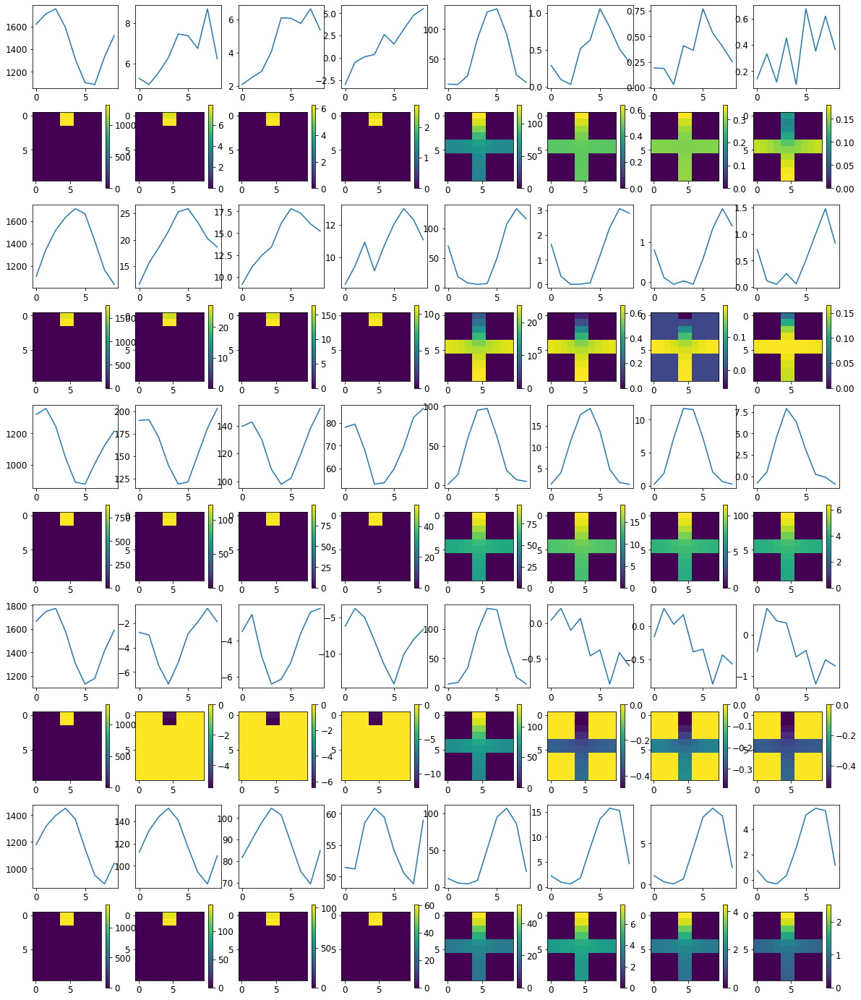

Loss: 


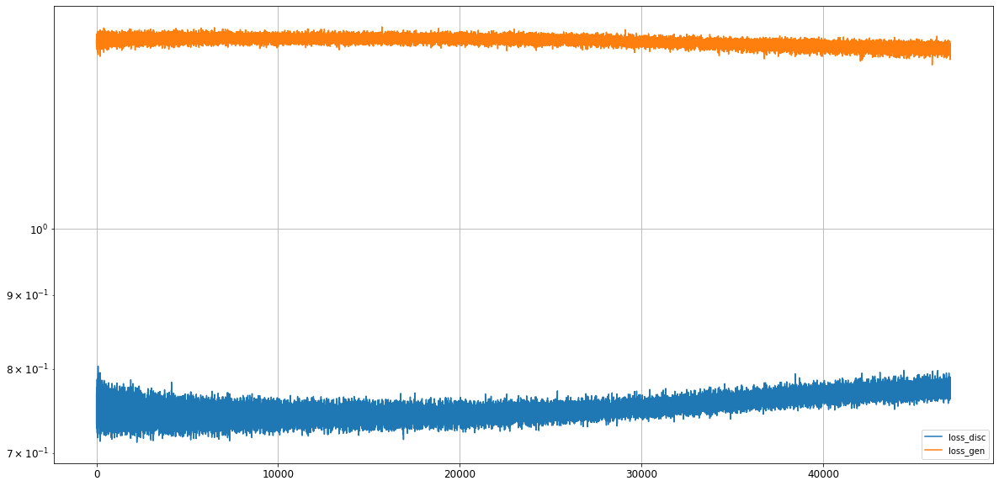

Epoch 47002/50000
discriminator loss: 1.337532 - generator loss: 0.769584 - 1s
Epoch 47003/50000
discriminator loss: 1.336799 - generator loss: 0.773778 - 1s
Epoch 47004/50000
discriminator loss: 1.334851 - generator loss: 0.777915 - 1s
Epoch 47005/50000
discriminator loss: 1.343418 - generator loss: 0.764060 - 1s
Epoch 47006/50000
discriminator loss: 1.336295 - generator loss: 0.776972 - 1s
Epoch 47007/50000
discriminator loss: 1.336692 - generator loss: 0.777190 - 1s
Epoch 47008/50000
discriminator loss: 1.330410 - generator loss: 0.772413 - 1s
Epoch 47009/50000
discriminator loss: 1.330233 - generator loss: 0.790633 - 1s
Epoch 47010/50000
discriminator loss: 1.334808 - generator loss: 0.769726 - 1s
Epoch 47011/50000
discriminator loss: 1.330116 - generator loss: 0.778756 - 1s
Epoch 47012/50000
discriminator loss: 1.337329 - generator loss: 0.770655 - 1s
Epoch 47013/50000
discriminator loss: 1.345441 - generator loss: 0.771721 - 1s
Epoch 47014/50000
discriminator loss: 1.333682 - gen

discriminator loss: 1.332371 - generator loss: 0.783156 - 1s
Epoch 47107/50000
discriminator loss: 1.338065 - generator loss: 0.772623 - 1s
Epoch 47108/50000
discriminator loss: 1.331258 - generator loss: 0.769556 - 1s
Epoch 47109/50000
discriminator loss: 1.344423 - generator loss: 0.766079 - 1s
Epoch 47110/50000
discriminator loss: 1.345288 - generator loss: 0.771520 - 1s
Epoch 47111/50000
discriminator loss: 1.322444 - generator loss: 0.789684 - 1s
Epoch 47112/50000
discriminator loss: 1.329599 - generator loss: 0.771229 - 1s
Epoch 47113/50000
discriminator loss: 1.330980 - generator loss: 0.769625 - 1s
Epoch 47114/50000
discriminator loss: 1.346794 - generator loss: 0.772514 - 1s
Epoch 47115/50000
discriminator loss: 1.333239 - generator loss: 0.781463 - 1s
Epoch 47116/50000
discriminator loss: 1.334800 - generator loss: 0.770238 - 1s
Epoch 47117/50000
discriminator loss: 1.326933 - generator loss: 0.779396 - 1s
Epoch 47118/50000
discriminator loss: 1.326251 - generator loss: 0.780

discriminator loss: 1.330541 - generator loss: 0.774634 - 1s
Epoch 47211/50000
discriminator loss: 1.331003 - generator loss: 0.777482 - 1s
Epoch 47212/50000
discriminator loss: 1.333041 - generator loss: 0.777077 - 1s
Epoch 47213/50000
discriminator loss: 1.349378 - generator loss: 0.759638 - 1s
Epoch 47214/50000
discriminator loss: 1.329764 - generator loss: 0.783319 - 1s
Epoch 47215/50000
discriminator loss: 1.331796 - generator loss: 0.766427 - 1s
Epoch 47216/50000
discriminator loss: 1.341247 - generator loss: 0.770346 - 1s
Epoch 47217/50000
discriminator loss: 1.334212 - generator loss: 0.777019 - 1s
Epoch 47218/50000
discriminator loss: 1.342977 - generator loss: 0.772269 - 1s
Epoch 47219/50000
discriminator loss: 1.333372 - generator loss: 0.776903 - 1s
Epoch 47220/50000
discriminator loss: 1.336525 - generator loss: 0.766796 - 1s
Epoch 47221/50000
discriminator loss: 1.338522 - generator loss: 0.772515 - 1s
Epoch 47222/50000
discriminator loss: 1.331654 - generator loss: 0.784

discriminator loss: 1.338433 - generator loss: 0.775741 - 1s
Epoch 47315/50000
discriminator loss: 1.342079 - generator loss: 0.771099 - 1s
Epoch 47316/50000
discriminator loss: 1.340022 - generator loss: 0.762559 - 1s
Epoch 47317/50000
discriminator loss: 1.335255 - generator loss: 0.779815 - 1s
Epoch 47318/50000
discriminator loss: 1.323632 - generator loss: 0.780797 - 1s
Epoch 47319/50000
discriminator loss: 1.327011 - generator loss: 0.775661 - 1s
Epoch 47320/50000
discriminator loss: 1.333257 - generator loss: 0.777352 - 1s
Epoch 47321/50000
discriminator loss: 1.339916 - generator loss: 0.771176 - 1s
Epoch 47322/50000
discriminator loss: 1.335286 - generator loss: 0.781583 - 1s
Epoch 47323/50000
discriminator loss: 1.339982 - generator loss: 0.773855 - 1s
Epoch 47324/50000
discriminator loss: 1.332292 - generator loss: 0.773824 - 1s
Epoch 47325/50000
discriminator loss: 1.333703 - generator loss: 0.772997 - 1s
Epoch 47326/50000
discriminator loss: 1.333538 - generator loss: 0.769

discriminator loss: 1.326019 - generator loss: 0.779826 - 1s
Epoch 47419/50000
discriminator loss: 1.334100 - generator loss: 0.772227 - 1s
Epoch 47420/50000
discriminator loss: 1.337281 - generator loss: 0.767227 - 1s
Epoch 47421/50000
discriminator loss: 1.342583 - generator loss: 0.767873 - 1s
Epoch 47422/50000
discriminator loss: 1.342433 - generator loss: 0.767253 - 1s
Epoch 47423/50000
discriminator loss: 1.340991 - generator loss: 0.780862 - 1s
Epoch 47424/50000
discriminator loss: 1.333129 - generator loss: 0.776286 - 1s
Epoch 47425/50000
discriminator loss: 1.332597 - generator loss: 0.777224 - 1s
Epoch 47426/50000
discriminator loss: 1.341010 - generator loss: 0.776100 - 1s
Epoch 47427/50000
discriminator loss: 1.336031 - generator loss: 0.778386 - 1s
Epoch 47428/50000
discriminator loss: 1.335467 - generator loss: 0.762697 - 1s
Epoch 47429/50000
discriminator loss: 1.334285 - generator loss: 0.771870 - 1s
Epoch 47430/50000
discriminator loss: 1.342234 - generator loss: 0.767

discriminator loss: 1.339713 - generator loss: 0.769923 - 1s
Epoch 47523/50000
discriminator loss: 1.341418 - generator loss: 0.769902 - 1s
Epoch 47524/50000
discriminator loss: 1.337418 - generator loss: 0.778081 - 1s
Epoch 47525/50000
discriminator loss: 1.333417 - generator loss: 0.772136 - 1s
Epoch 47526/50000
discriminator loss: 1.332273 - generator loss: 0.782475 - 1s
Epoch 47527/50000
discriminator loss: 1.334895 - generator loss: 0.769529 - 1s
Epoch 47528/50000
discriminator loss: 1.324113 - generator loss: 0.778200 - 1s
Epoch 47529/50000
discriminator loss: 1.334042 - generator loss: 0.774113 - 1s
Epoch 47530/50000
discriminator loss: 1.331434 - generator loss: 0.776515 - 1s
Epoch 47531/50000
discriminator loss: 1.328041 - generator loss: 0.775396 - 1s
Epoch 47532/50000
discriminator loss: 1.349134 - generator loss: 0.766484 - 1s
Epoch 47533/50000
discriminator loss: 1.330940 - generator loss: 0.779106 - 1s
Epoch 47534/50000
discriminator loss: 1.339836 - generator loss: 0.771

discriminator loss: 1.329987 - generator loss: 0.780114 - 1s
Epoch 47627/50000
discriminator loss: 1.335356 - generator loss: 0.778664 - 1s
Epoch 47628/50000
discriminator loss: 1.323986 - generator loss: 0.778640 - 1s
Epoch 47629/50000
discriminator loss: 1.339520 - generator loss: 0.771782 - 1s
Epoch 47630/50000
discriminator loss: 1.331012 - generator loss: 0.773493 - 1s
Epoch 47631/50000
discriminator loss: 1.333132 - generator loss: 0.783092 - 1s
Epoch 47632/50000
discriminator loss: 1.340306 - generator loss: 0.765294 - 1s
Epoch 47633/50000
discriminator loss: 1.340703 - generator loss: 0.775522 - 1s
Epoch 47634/50000
discriminator loss: 1.324876 - generator loss: 0.793442 - 1s
Epoch 47635/50000
discriminator loss: 1.333519 - generator loss: 0.765649 - 1s
Epoch 47636/50000
discriminator loss: 1.331825 - generator loss: 0.778408 - 1s
Epoch 47637/50000
discriminator loss: 1.332801 - generator loss: 0.788955 - 1s
Epoch 47638/50000
discriminator loss: 1.320692 - generator loss: 0.782

discriminator loss: 1.312969 - generator loss: 0.791134 - 1s
Epoch 47731/50000
discriminator loss: 1.336617 - generator loss: 0.771145 - 1s
Epoch 47732/50000
discriminator loss: 1.331880 - generator loss: 0.781251 - 1s
Epoch 47733/50000
discriminator loss: 1.345258 - generator loss: 0.762802 - 1s
Epoch 47734/50000
discriminator loss: 1.337204 - generator loss: 0.777814 - 1s
Epoch 47735/50000
discriminator loss: 1.335381 - generator loss: 0.770420 - 1s
Epoch 47736/50000
discriminator loss: 1.330770 - generator loss: 0.779466 - 1s
Epoch 47737/50000
discriminator loss: 1.329064 - generator loss: 0.784331 - 1s
Epoch 47738/50000
discriminator loss: 1.336252 - generator loss: 0.774854 - 1s
Epoch 47739/50000
discriminator loss: 1.334369 - generator loss: 0.778773 - 1s
Epoch 47740/50000
discriminator loss: 1.337331 - generator loss: 0.773207 - 1s
Epoch 47741/50000
discriminator loss: 1.326639 - generator loss: 0.782243 - 1s
Epoch 47742/50000
discriminator loss: 1.336355 - generator loss: 0.768

discriminator loss: 1.332612 - generator loss: 0.770730 - 1s
Epoch 47835/50000
discriminator loss: 1.342229 - generator loss: 0.768800 - 1s
Epoch 47836/50000
discriminator loss: 1.337005 - generator loss: 0.771782 - 1s
Epoch 47837/50000
discriminator loss: 1.331175 - generator loss: 0.771694 - 1s
Epoch 47838/50000
discriminator loss: 1.341204 - generator loss: 0.770899 - 1s
Epoch 47839/50000
discriminator loss: 1.334101 - generator loss: 0.773324 - 1s
Epoch 47840/50000
discriminator loss: 1.340088 - generator loss: 0.789806 - 1s
Epoch 47841/50000
discriminator loss: 1.332055 - generator loss: 0.779588 - 1s
Epoch 47842/50000
discriminator loss: 1.342795 - generator loss: 0.768416 - 1s
Epoch 47843/50000
discriminator loss: 1.339462 - generator loss: 0.774947 - 1s
Epoch 47844/50000
discriminator loss: 1.324891 - generator loss: 0.771548 - 1s
Epoch 47845/50000
discriminator loss: 1.337253 - generator loss: 0.778637 - 1s
Epoch 47846/50000
discriminator loss: 1.324950 - generator loss: 0.777

discriminator loss: 1.334592 - generator loss: 0.775781 - 1s
Epoch 47939/50000
discriminator loss: 1.339775 - generator loss: 0.768997 - 1s
Epoch 47940/50000
discriminator loss: 1.332463 - generator loss: 0.775886 - 1s
Epoch 47941/50000
discriminator loss: 1.332601 - generator loss: 0.782314 - 1s
Epoch 47942/50000
discriminator loss: 1.346432 - generator loss: 0.763271 - 1s
Epoch 47943/50000
discriminator loss: 1.335793 - generator loss: 0.767759 - 1s
Epoch 47944/50000
discriminator loss: 1.343560 - generator loss: 0.771694 - 1s
Epoch 47945/50000
discriminator loss: 1.341243 - generator loss: 0.780204 - 1s
Epoch 47946/50000
discriminator loss: 1.339311 - generator loss: 0.779026 - 1s
Epoch 47947/50000
discriminator loss: 1.334710 - generator loss: 0.765317 - 1s
Epoch 47948/50000
discriminator loss: 1.328644 - generator loss: 0.779983 - 1s
Epoch 47949/50000
discriminator loss: 1.339239 - generator loss: 0.768219 - 1s
Epoch 47950/50000
discriminator loss: 1.336304 - generator loss: 0.785

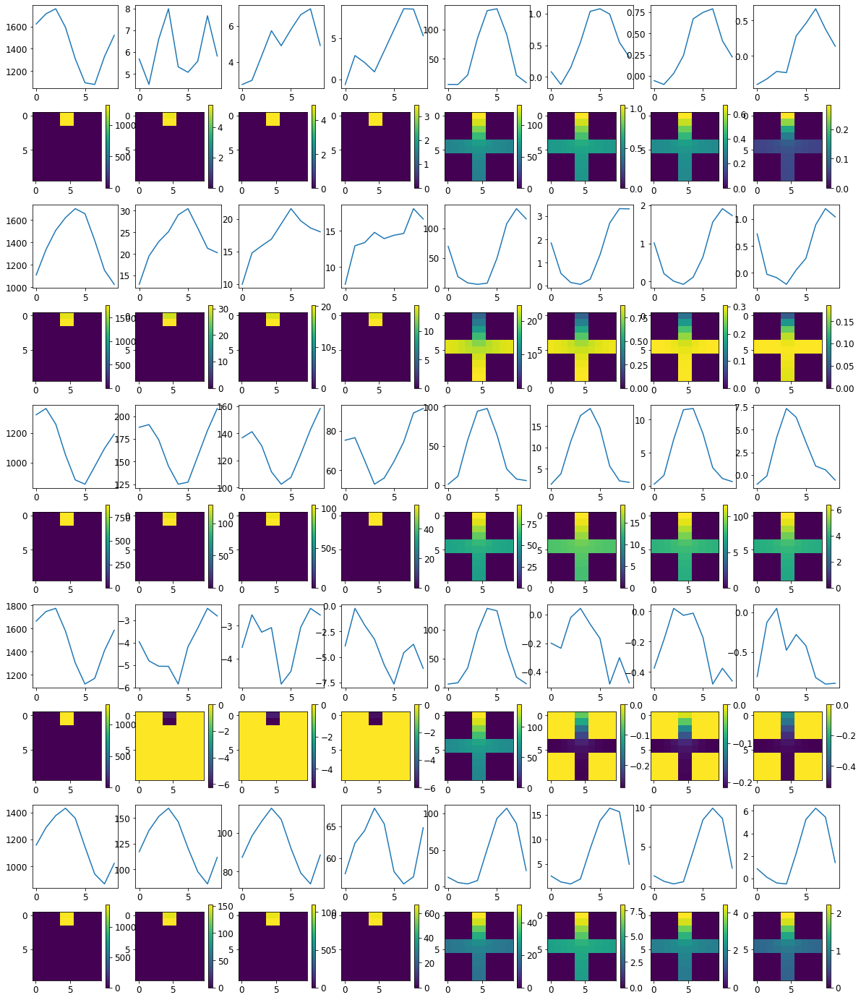

Loss: 


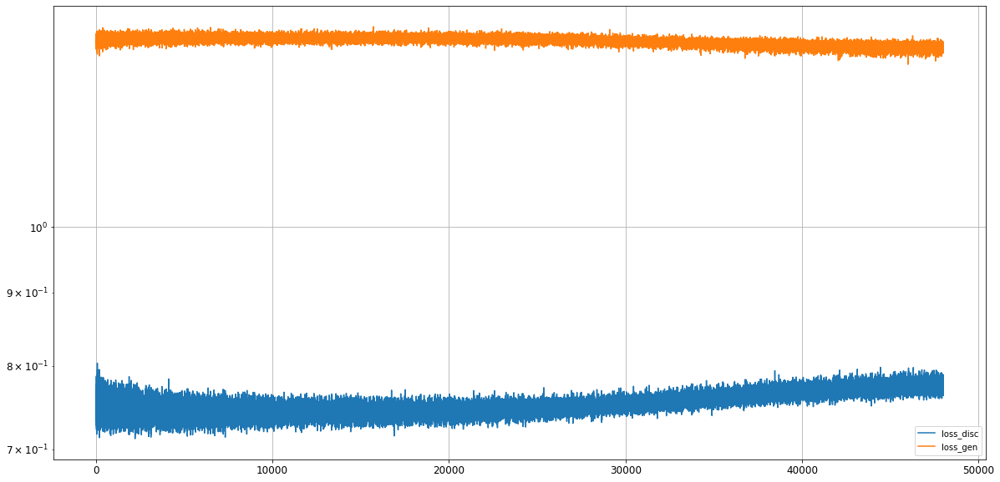

Epoch 48002/50000
discriminator loss: 1.336301 - generator loss: 0.783147 - 1s
Epoch 48003/50000
discriminator loss: 1.337166 - generator loss: 0.776194 - 1s
Epoch 48004/50000
discriminator loss: 1.342148 - generator loss: 0.767852 - 1s
Epoch 48005/50000
discriminator loss: 1.337524 - generator loss: 0.775380 - 1s
Epoch 48006/50000
discriminator loss: 1.316580 - generator loss: 0.785584 - 1s
Epoch 48007/50000
discriminator loss: 1.335137 - generator loss: 0.774201 - 1s
Epoch 48008/50000
discriminator loss: 1.319018 - generator loss: 0.791683 - 1s
Epoch 48009/50000
discriminator loss: 1.332941 - generator loss: 0.769000 - 1s
Epoch 48010/50000
discriminator loss: 1.348286 - generator loss: 0.772290 - 1s
Epoch 48011/50000
discriminator loss: 1.335038 - generator loss: 0.781984 - 1s
Epoch 48012/50000
discriminator loss: 1.330553 - generator loss: 0.778446 - 1s
Epoch 48013/50000
discriminator loss: 1.330777 - generator loss: 0.779863 - 1s
Epoch 48014/50000
discriminator loss: 1.331946 - gen

discriminator loss: 1.336227 - generator loss: 0.770488 - 1s
Epoch 48107/50000
discriminator loss: 1.334621 - generator loss: 0.775446 - 1s
Epoch 48108/50000
discriminator loss: 1.334727 - generator loss: 0.787317 - 1s
Epoch 48109/50000
discriminator loss: 1.328653 - generator loss: 0.775517 - 1s
Epoch 48110/50000
discriminator loss: 1.328560 - generator loss: 0.782796 - 1s
Epoch 48111/50000
discriminator loss: 1.332793 - generator loss: 0.780802 - 1s
Epoch 48112/50000
discriminator loss: 1.334871 - generator loss: 0.764759 - 1s
Epoch 48113/50000
discriminator loss: 1.333544 - generator loss: 0.778412 - 1s
Epoch 48114/50000
discriminator loss: 1.341557 - generator loss: 0.770897 - 1s
Epoch 48115/50000
discriminator loss: 1.340382 - generator loss: 0.776008 - 1s
Epoch 48116/50000
discriminator loss: 1.328831 - generator loss: 0.770658 - 1s
Epoch 48117/50000
discriminator loss: 1.349593 - generator loss: 0.772392 - 1s
Epoch 48118/50000
discriminator loss: 1.322542 - generator loss: 0.790

discriminator loss: 1.334632 - generator loss: 0.783222 - 1s
Epoch 48211/50000
discriminator loss: 1.345254 - generator loss: 0.766510 - 1s
Epoch 48212/50000
discriminator loss: 1.325558 - generator loss: 0.780935 - 1s
Epoch 48213/50000
discriminator loss: 1.331442 - generator loss: 0.778286 - 1s
Epoch 48214/50000
discriminator loss: 1.338931 - generator loss: 0.767858 - 1s
Epoch 48215/50000
discriminator loss: 1.336134 - generator loss: 0.775253 - 1s
Epoch 48216/50000
discriminator loss: 1.341234 - generator loss: 0.776377 - 1s
Epoch 48217/50000
discriminator loss: 1.330559 - generator loss: 0.780483 - 1s
Epoch 48218/50000
discriminator loss: 1.325240 - generator loss: 0.782332 - 1s
Epoch 48219/50000
discriminator loss: 1.338909 - generator loss: 0.768256 - 1s
Epoch 48220/50000
discriminator loss: 1.326060 - generator loss: 0.785300 - 1s
Epoch 48221/50000
discriminator loss: 1.333766 - generator loss: 0.777651 - 1s
Epoch 48222/50000
discriminator loss: 1.341609 - generator loss: 0.761

discriminator loss: 1.329522 - generator loss: 0.778374 - 1s
Epoch 48315/50000
discriminator loss: 1.319503 - generator loss: 0.786360 - 1s
Epoch 48316/50000
discriminator loss: 1.325682 - generator loss: 0.776279 - 1s
Epoch 48317/50000
discriminator loss: 1.340616 - generator loss: 0.772304 - 1s
Epoch 48318/50000
discriminator loss: 1.350204 - generator loss: 0.772540 - 1s
Epoch 48319/50000
discriminator loss: 1.345054 - generator loss: 0.765577 - 1s
Epoch 48320/50000
discriminator loss: 1.335527 - generator loss: 0.776376 - 1s
Epoch 48321/50000
discriminator loss: 1.336601 - generator loss: 0.773373 - 1s
Epoch 48322/50000
discriminator loss: 1.333066 - generator loss: 0.775308 - 1s
Epoch 48323/50000
discriminator loss: 1.333081 - generator loss: 0.769905 - 1s
Epoch 48324/50000
discriminator loss: 1.338729 - generator loss: 0.778442 - 1s
Epoch 48325/50000
discriminator loss: 1.329633 - generator loss: 0.778365 - 1s
Epoch 48326/50000
discriminator loss: 1.335163 - generator loss: 0.775

discriminator loss: 1.341947 - generator loss: 0.775893 - 1s
Epoch 48419/50000
discriminator loss: 1.336141 - generator loss: 0.771950 - 1s
Epoch 48420/50000
discriminator loss: 1.325992 - generator loss: 0.784223 - 1s
Epoch 48421/50000
discriminator loss: 1.332564 - generator loss: 0.776869 - 1s
Epoch 48422/50000
discriminator loss: 1.322422 - generator loss: 0.781510 - 1s
Epoch 48423/50000
discriminator loss: 1.323332 - generator loss: 0.779710 - 1s
Epoch 48424/50000
discriminator loss: 1.338980 - generator loss: 0.773239 - 1s
Epoch 48425/50000
discriminator loss: 1.347580 - generator loss: 0.764488 - 1s
Epoch 48426/50000
discriminator loss: 1.334494 - generator loss: 0.779102 - 1s
Epoch 48427/50000
discriminator loss: 1.326067 - generator loss: 0.782107 - 1s
Epoch 48428/50000
discriminator loss: 1.341897 - generator loss: 0.766969 - 1s
Epoch 48429/50000
discriminator loss: 1.339602 - generator loss: 0.772812 - 1s
Epoch 48430/50000
discriminator loss: 1.328388 - generator loss: 0.786

discriminator loss: 1.334671 - generator loss: 0.773446 - 1s
Epoch 48523/50000
discriminator loss: 1.332388 - generator loss: 0.774178 - 1s
Epoch 48524/50000
discriminator loss: 1.325138 - generator loss: 0.771281 - 1s
Epoch 48525/50000
discriminator loss: 1.341451 - generator loss: 0.776696 - 1s
Epoch 48526/50000
discriminator loss: 1.350088 - generator loss: 0.764984 - 1s
Epoch 48527/50000
discriminator loss: 1.335312 - generator loss: 0.779731 - 1s
Epoch 48528/50000
discriminator loss: 1.318518 - generator loss: 0.787954 - 1s
Epoch 48529/50000
discriminator loss: 1.327005 - generator loss: 0.784705 - 1s
Epoch 48530/50000
discriminator loss: 1.332583 - generator loss: 0.772674 - 1s
Epoch 48531/50000
discriminator loss: 1.329951 - generator loss: 0.778810 - 1s
Epoch 48532/50000
discriminator loss: 1.327875 - generator loss: 0.777969 - 1s
Epoch 48533/50000
discriminator loss: 1.334738 - generator loss: 0.786247 - 1s
Epoch 48534/50000
discriminator loss: 1.340905 - generator loss: 0.762

discriminator loss: 1.326248 - generator loss: 0.778412 - 1s
Epoch 48627/50000
discriminator loss: 1.327462 - generator loss: 0.778716 - 1s
Epoch 48628/50000
discriminator loss: 1.341316 - generator loss: 0.768809 - 1s
Epoch 48629/50000
discriminator loss: 1.334966 - generator loss: 0.772727 - 1s
Epoch 48630/50000
discriminator loss: 1.333792 - generator loss: 0.777831 - 1s
Epoch 48631/50000
discriminator loss: 1.336971 - generator loss: 0.775276 - 1s
Epoch 48632/50000
discriminator loss: 1.326601 - generator loss: 0.773314 - 1s
Epoch 48633/50000
discriminator loss: 1.344445 - generator loss: 0.765246 - 1s
Epoch 48634/50000
discriminator loss: 1.334075 - generator loss: 0.778738 - 1s
Epoch 48635/50000
discriminator loss: 1.333924 - generator loss: 0.768657 - 1s
Epoch 48636/50000
discriminator loss: 1.342800 - generator loss: 0.772398 - 1s
Epoch 48637/50000
discriminator loss: 1.321888 - generator loss: 0.781624 - 1s
Epoch 48638/50000
discriminator loss: 1.338149 - generator loss: 0.784

discriminator loss: 1.323173 - generator loss: 0.781449 - 1s
Epoch 48731/50000
discriminator loss: 1.328228 - generator loss: 0.776090 - 1s
Epoch 48732/50000
discriminator loss: 1.332605 - generator loss: 0.785146 - 1s
Epoch 48733/50000
discriminator loss: 1.323777 - generator loss: 0.782819 - 1s
Epoch 48734/50000
discriminator loss: 1.319011 - generator loss: 0.793849 - 1s
Epoch 48735/50000
discriminator loss: 1.313504 - generator loss: 0.786448 - 1s
Epoch 48736/50000
discriminator loss: 1.344128 - generator loss: 0.765971 - 1s
Epoch 48737/50000
discriminator loss: 1.332425 - generator loss: 0.768729 - 1s
Epoch 48738/50000
discriminator loss: 1.328653 - generator loss: 0.779639 - 1s
Epoch 48739/50000
discriminator loss: 1.321744 - generator loss: 0.788846 - 1s
Epoch 48740/50000
discriminator loss: 1.351214 - generator loss: 0.768134 - 1s
Epoch 48741/50000
discriminator loss: 1.322686 - generator loss: 0.776720 - 1s
Epoch 48742/50000
discriminator loss: 1.332658 - generator loss: 0.784

discriminator loss: 1.333606 - generator loss: 0.781773 - 1s
Epoch 48835/50000
discriminator loss: 1.345097 - generator loss: 0.768736 - 1s
Epoch 48836/50000
discriminator loss: 1.340416 - generator loss: 0.775127 - 1s
Epoch 48837/50000
discriminator loss: 1.325751 - generator loss: 0.793023 - 1s
Epoch 48838/50000
discriminator loss: 1.319079 - generator loss: 0.785171 - 1s
Epoch 48839/50000
discriminator loss: 1.340514 - generator loss: 0.760344 - 1s
Epoch 48840/50000
discriminator loss: 1.340389 - generator loss: 0.777165 - 1s
Epoch 48841/50000
discriminator loss: 1.324944 - generator loss: 0.779122 - 1s
Epoch 48842/50000
discriminator loss: 1.338921 - generator loss: 0.770412 - 1s
Epoch 48843/50000
discriminator loss: 1.316047 - generator loss: 0.794370 - 1s
Epoch 48844/50000
discriminator loss: 1.328925 - generator loss: 0.770444 - 1s
Epoch 48845/50000
discriminator loss: 1.346886 - generator loss: 0.771807 - 1s
Epoch 48846/50000
discriminator loss: 1.348338 - generator loss: 0.765

discriminator loss: 1.333250 - generator loss: 0.766786 - 1s
Epoch 48939/50000
discriminator loss: 1.331792 - generator loss: 0.785536 - 1s
Epoch 48940/50000
discriminator loss: 1.332910 - generator loss: 0.779806 - 1s
Epoch 48941/50000
discriminator loss: 1.327936 - generator loss: 0.785901 - 1s
Epoch 48942/50000
discriminator loss: 1.333440 - generator loss: 0.771558 - 1s
Epoch 48943/50000
discriminator loss: 1.329843 - generator loss: 0.770544 - 1s
Epoch 48944/50000
discriminator loss: 1.337961 - generator loss: 0.766005 - 1s
Epoch 48945/50000
discriminator loss: 1.332811 - generator loss: 0.779182 - 1s
Epoch 48946/50000
discriminator loss: 1.321890 - generator loss: 0.791634 - 1s
Epoch 48947/50000
discriminator loss: 1.334690 - generator loss: 0.776299 - 1s
Epoch 48948/50000
discriminator loss: 1.335665 - generator loss: 0.777559 - 1s
Epoch 48949/50000
discriminator loss: 1.341936 - generator loss: 0.770038 - 1s
Epoch 48950/50000
discriminator loss: 1.341150 - generator loss: 0.776

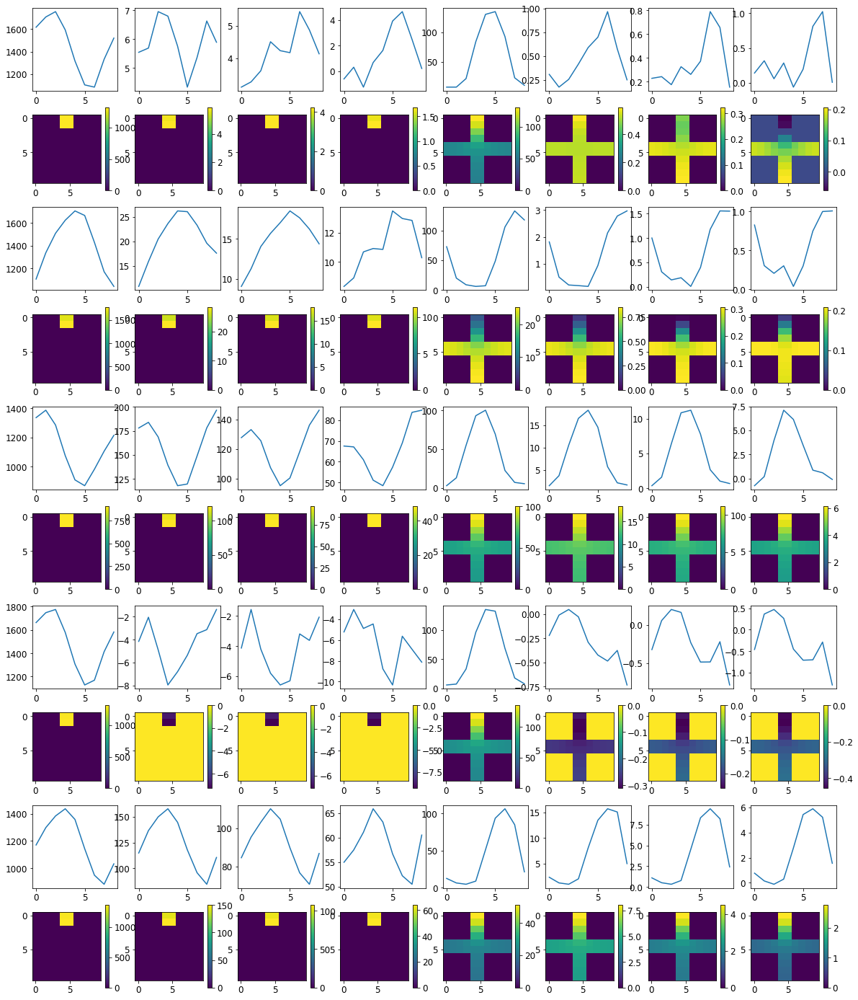

Loss: 


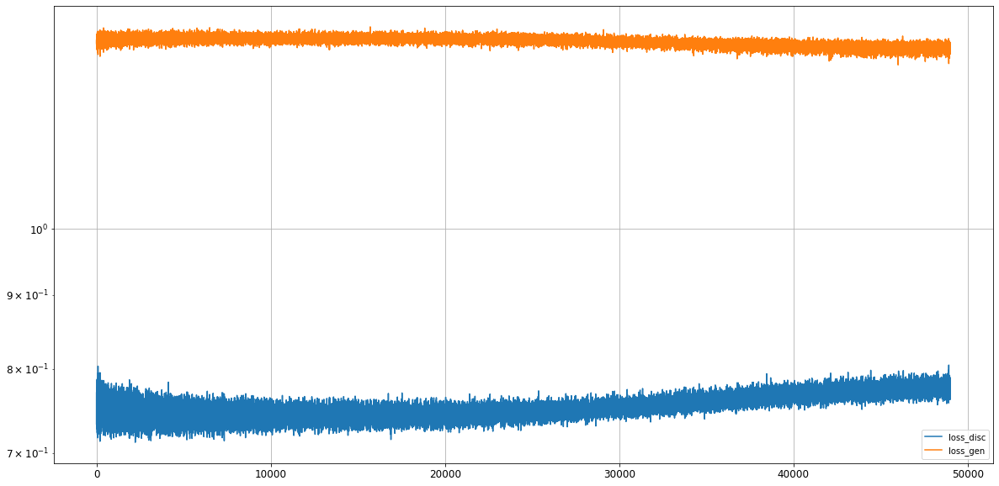

Epoch 49002/50000
discriminator loss: 1.341243 - generator loss: 0.768962 - 1s
Epoch 49003/50000
discriminator loss: 1.337758 - generator loss: 0.771191 - 1s
Epoch 49004/50000
discriminator loss: 1.335878 - generator loss: 0.777518 - 1s
Epoch 49005/50000
discriminator loss: 1.343263 - generator loss: 0.761864 - 1s
Epoch 49006/50000
discriminator loss: 1.346608 - generator loss: 0.763336 - 1s
Epoch 49007/50000
discriminator loss: 1.331921 - generator loss: 0.779044 - 1s
Epoch 49008/50000
discriminator loss: 1.340066 - generator loss: 0.774089 - 1s
Epoch 49009/50000
discriminator loss: 1.330619 - generator loss: 0.783554 - 1s
Epoch 49010/50000
discriminator loss: 1.319076 - generator loss: 0.781008 - 1s
Epoch 49011/50000
discriminator loss: 1.348557 - generator loss: 0.768901 - 1s
Epoch 49012/50000
discriminator loss: 1.338976 - generator loss: 0.775115 - 1s
Epoch 49013/50000
discriminator loss: 1.332388 - generator loss: 0.773316 - 1s
Epoch 49014/50000
discriminator loss: 1.338449 - gen

discriminator loss: 1.324154 - generator loss: 0.776070 - 1s
Epoch 49107/50000
discriminator loss: 1.333020 - generator loss: 0.782595 - 1s
Epoch 49108/50000
discriminator loss: 1.336695 - generator loss: 0.784510 - 1s
Epoch 49109/50000
discriminator loss: 1.328210 - generator loss: 0.781015 - 1s
Epoch 49110/50000
discriminator loss: 1.334686 - generator loss: 0.775763 - 1s
Epoch 49111/50000
discriminator loss: 1.340353 - generator loss: 0.776045 - 1s
Epoch 49112/50000
discriminator loss: 1.326097 - generator loss: 0.781531 - 1s
Epoch 49113/50000
discriminator loss: 1.332672 - generator loss: 0.770139 - 1s
Epoch 49114/50000
discriminator loss: 1.336081 - generator loss: 0.770159 - 1s
Epoch 49115/50000
discriminator loss: 1.336001 - generator loss: 0.783102 - 1s
Epoch 49116/50000
discriminator loss: 1.334443 - generator loss: 0.776848 - 1s
Epoch 49117/50000
discriminator loss: 1.330522 - generator loss: 0.782143 - 1s
Epoch 49118/50000
discriminator loss: 1.330004 - generator loss: 0.785

discriminator loss: 1.327708 - generator loss: 0.782904 - 1s
Epoch 49211/50000
discriminator loss: 1.333487 - generator loss: 0.772314 - 1s
Epoch 49212/50000
discriminator loss: 1.329793 - generator loss: 0.780211 - 1s
Epoch 49213/50000
discriminator loss: 1.331247 - generator loss: 0.775060 - 1s
Epoch 49214/50000
discriminator loss: 1.332329 - generator loss: 0.782045 - 1s
Epoch 49215/50000
discriminator loss: 1.333520 - generator loss: 0.779752 - 1s
Epoch 49216/50000
discriminator loss: 1.329728 - generator loss: 0.783294 - 1s
Epoch 49217/50000
discriminator loss: 1.339291 - generator loss: 0.764660 - 1s
Epoch 49218/50000
discriminator loss: 1.336403 - generator loss: 0.783472 - 1s
Epoch 49219/50000
discriminator loss: 1.331817 - generator loss: 0.778759 - 1s
Epoch 49220/50000
discriminator loss: 1.345614 - generator loss: 0.764556 - 1s
Epoch 49221/50000
discriminator loss: 1.327024 - generator loss: 0.781401 - 1s
Epoch 49222/50000
discriminator loss: 1.342366 - generator loss: 0.769

discriminator loss: 1.340870 - generator loss: 0.765519 - 1s
Epoch 49315/50000
discriminator loss: 1.342980 - generator loss: 0.774105 - 1s
Epoch 49316/50000
discriminator loss: 1.328132 - generator loss: 0.775580 - 1s
Epoch 49317/50000
discriminator loss: 1.331316 - generator loss: 0.771285 - 1s
Epoch 49318/50000
discriminator loss: 1.332937 - generator loss: 0.775569 - 1s
Epoch 49319/50000
discriminator loss: 1.327928 - generator loss: 0.781660 - 1s
Epoch 49320/50000
discriminator loss: 1.332961 - generator loss: 0.777922 - 1s
Epoch 49321/50000
discriminator loss: 1.329199 - generator loss: 0.781969 - 1s
Epoch 49322/50000
discriminator loss: 1.337767 - generator loss: 0.768530 - 1s
Epoch 49323/50000
discriminator loss: 1.340908 - generator loss: 0.772633 - 1s
Epoch 49324/50000
discriminator loss: 1.337037 - generator loss: 0.771615 - 1s
Epoch 49325/50000
discriminator loss: 1.340506 - generator loss: 0.774779 - 1s
Epoch 49326/50000
discriminator loss: 1.330165 - generator loss: 0.776

discriminator loss: 1.337144 - generator loss: 0.774429 - 1s
Epoch 49419/50000
discriminator loss: 1.325044 - generator loss: 0.781296 - 1s
Epoch 49420/50000
discriminator loss: 1.330859 - generator loss: 0.780291 - 1s
Epoch 49421/50000
discriminator loss: 1.337836 - generator loss: 0.779214 - 1s
Epoch 49422/50000
discriminator loss: 1.342852 - generator loss: 0.764403 - 1s
Epoch 49423/50000
discriminator loss: 1.329016 - generator loss: 0.790012 - 1s
Epoch 49424/50000
discriminator loss: 1.344682 - generator loss: 0.764399 - 1s
Epoch 49425/50000
discriminator loss: 1.329043 - generator loss: 0.787667 - 1s
Epoch 49426/50000
discriminator loss: 1.319502 - generator loss: 0.787861 - 1s
Epoch 49427/50000
discriminator loss: 1.336627 - generator loss: 0.764830 - 1s
Epoch 49428/50000
discriminator loss: 1.324314 - generator loss: 0.775683 - 1s
Epoch 49429/50000
discriminator loss: 1.334872 - generator loss: 0.779633 - 1s
Epoch 49430/50000
discriminator loss: 1.327225 - generator loss: 0.786

discriminator loss: 1.330267 - generator loss: 0.777952 - 1s
Epoch 49523/50000
discriminator loss: 1.334182 - generator loss: 0.778865 - 1s
Epoch 49524/50000
discriminator loss: 1.331288 - generator loss: 0.779544 - 1s
Epoch 49525/50000
discriminator loss: 1.333424 - generator loss: 0.778880 - 1s
Epoch 49526/50000
discriminator loss: 1.325836 - generator loss: 0.780166 - 1s
Epoch 49527/50000
discriminator loss: 1.333024 - generator loss: 0.780483 - 1s
Epoch 49528/50000
discriminator loss: 1.329415 - generator loss: 0.780012 - 1s
Epoch 49529/50000
discriminator loss: 1.316987 - generator loss: 0.794205 - 1s
Epoch 49530/50000
discriminator loss: 1.332086 - generator loss: 0.774489 - 1s
Epoch 49531/50000
discriminator loss: 1.337638 - generator loss: 0.771152 - 1s
Epoch 49532/50000
discriminator loss: 1.328647 - generator loss: 0.787595 - 1s
Epoch 49533/50000
discriminator loss: 1.329337 - generator loss: 0.777398 - 1s
Epoch 49534/50000
discriminator loss: 1.334075 - generator loss: 0.782

discriminator loss: 1.342361 - generator loss: 0.763916 - 1s
Epoch 49627/50000
discriminator loss: 1.325091 - generator loss: 0.783603 - 1s
Epoch 49628/50000
discriminator loss: 1.337160 - generator loss: 0.774772 - 1s
Epoch 49629/50000
discriminator loss: 1.335584 - generator loss: 0.773454 - 1s
Epoch 49630/50000
discriminator loss: 1.333618 - generator loss: 0.768672 - 1s
Epoch 49631/50000
discriminator loss: 1.330613 - generator loss: 0.773841 - 1s
Epoch 49632/50000
discriminator loss: 1.340075 - generator loss: 0.773882 - 1s
Epoch 49633/50000
discriminator loss: 1.328022 - generator loss: 0.783655 - 1s
Epoch 49634/50000
discriminator loss: 1.336498 - generator loss: 0.768230 - 1s
Epoch 49635/50000
discriminator loss: 1.346966 - generator loss: 0.768192 - 1s
Epoch 49636/50000
discriminator loss: 1.331045 - generator loss: 0.772456 - 1s
Epoch 49637/50000
discriminator loss: 1.328410 - generator loss: 0.779552 - 1s
Epoch 49638/50000
discriminator loss: 1.336593 - generator loss: 0.780

discriminator loss: 1.340183 - generator loss: 0.769140 - 1s
Epoch 49731/50000
discriminator loss: 1.339990 - generator loss: 0.772811 - 1s
Epoch 49732/50000
discriminator loss: 1.340353 - generator loss: 0.768543 - 1s
Epoch 49733/50000
discriminator loss: 1.332929 - generator loss: 0.787342 - 1s
Epoch 49734/50000
discriminator loss: 1.335424 - generator loss: 0.774461 - 1s
Epoch 49735/50000
discriminator loss: 1.346727 - generator loss: 0.770390 - 1s
Epoch 49736/50000
discriminator loss: 1.337255 - generator loss: 0.773097 - 1s
Epoch 49737/50000
discriminator loss: 1.348354 - generator loss: 0.774225 - 1s
Epoch 49738/50000
discriminator loss: 1.347784 - generator loss: 0.764469 - 1s
Epoch 49739/50000
discriminator loss: 1.339387 - generator loss: 0.771780 - 1s
Epoch 49740/50000
discriminator loss: 1.326523 - generator loss: 0.779316 - 1s
Epoch 49741/50000
discriminator loss: 1.334532 - generator loss: 0.767781 - 1s
Epoch 49742/50000
discriminator loss: 1.339699 - generator loss: 0.774

discriminator loss: 1.334204 - generator loss: 0.775189 - 1s
Epoch 49835/50000
discriminator loss: 1.316882 - generator loss: 0.798330 - 1s
Epoch 49836/50000
discriminator loss: 1.329630 - generator loss: 0.771019 - 1s
Epoch 49837/50000
discriminator loss: 1.341527 - generator loss: 0.769877 - 1s
Epoch 49838/50000
discriminator loss: 1.338049 - generator loss: 0.780124 - 1s
Epoch 49839/50000
discriminator loss: 1.330515 - generator loss: 0.777483 - 1s
Epoch 49840/50000
discriminator loss: 1.314882 - generator loss: 0.792170 - 1s
Epoch 49841/50000
discriminator loss: 1.323487 - generator loss: 0.778074 - 1s
Epoch 49842/50000
discriminator loss: 1.322229 - generator loss: 0.783527 - 1s
Epoch 49843/50000
discriminator loss: 1.339581 - generator loss: 0.768145 - 1s
Epoch 49844/50000
discriminator loss: 1.333753 - generator loss: 0.780013 - 1s
Epoch 49845/50000
discriminator loss: 1.327067 - generator loss: 0.778972 - 1s
Epoch 49846/50000
discriminator loss: 1.345226 - generator loss: 0.760

discriminator loss: 1.331641 - generator loss: 0.783661 - 1s
Epoch 49939/50000
discriminator loss: 1.340812 - generator loss: 0.762665 - 1s
Epoch 49940/50000
discriminator loss: 1.334340 - generator loss: 0.777099 - 1s
Epoch 49941/50000
discriminator loss: 1.340757 - generator loss: 0.768665 - 1s
Epoch 49942/50000
discriminator loss: 1.336417 - generator loss: 0.780882 - 1s
Epoch 49943/50000
discriminator loss: 1.340233 - generator loss: 0.769948 - 1s
Epoch 49944/50000
discriminator loss: 1.332896 - generator loss: 0.771643 - 1s
Epoch 49945/50000
discriminator loss: 1.331055 - generator loss: 0.774239 - 1s
Epoch 49946/50000
discriminator loss: 1.337236 - generator loss: 0.765044 - 1s
Epoch 49947/50000
discriminator loss: 1.332896 - generator loss: 0.775377 - 1s
Epoch 49948/50000
discriminator loss: 1.328667 - generator loss: 0.787413 - 1s
Epoch 49949/50000
discriminator loss: 1.328284 - generator loss: 0.775490 - 1s
Epoch 49950/50000
discriminator loss: 1.334362 - generator loss: 0.782

In [54]:
# Continuing the training after epoch 5000 

hist = train(train_dataset, epochs=50000)

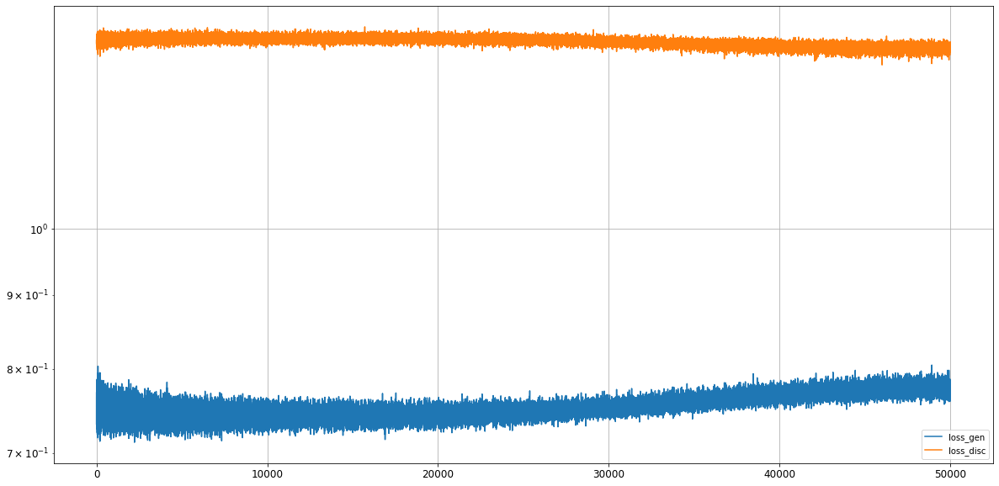

In [56]:
# Losses from epoch 5000 to 50000

fig, ax = plt.subplots(1,1, figsize=[20,10])
ax.plot(hist)
ax.legend(['loss_gen', 'loss_disc'])
ax.set_yscale('log')
ax.grid()

In [108]:
#from tensorflow.keras.models import load_model
import joblib
joblib.dump(scaler, "scaler-tfex.pkl")
gan.save("gan-tfex.h5")

#scaler = joblib.load("scaler.pkl") 
#gan = load_model('gan.h5')

In [93]:
np.random.seed(10)
tf.random.set_seed(10)

noise = tf.random.normal(shape=[1, latent_space])
X_generated = scaler.inverse_transform((gan.layers[0].predict(noise).reshape(ntimes,15)+1)/2)
X_generated = pca_compress.inverse_transform(X_generated)
X_generated[X_generated<0.0] = 0.0

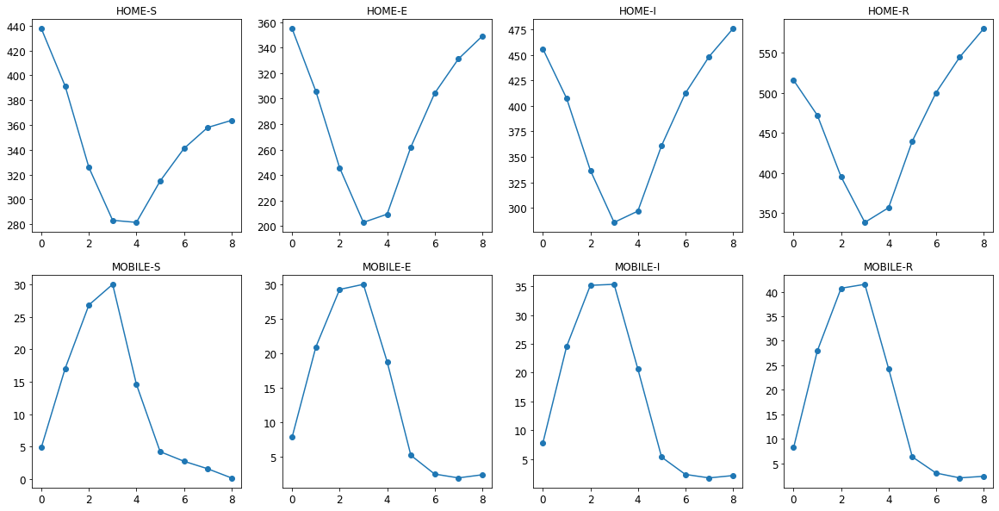

In [102]:
fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    ax.flatten()[i].plot(X_generated[:,i*nl*nc+4], '-o')
    ax.flatten()[i].set_title(group)

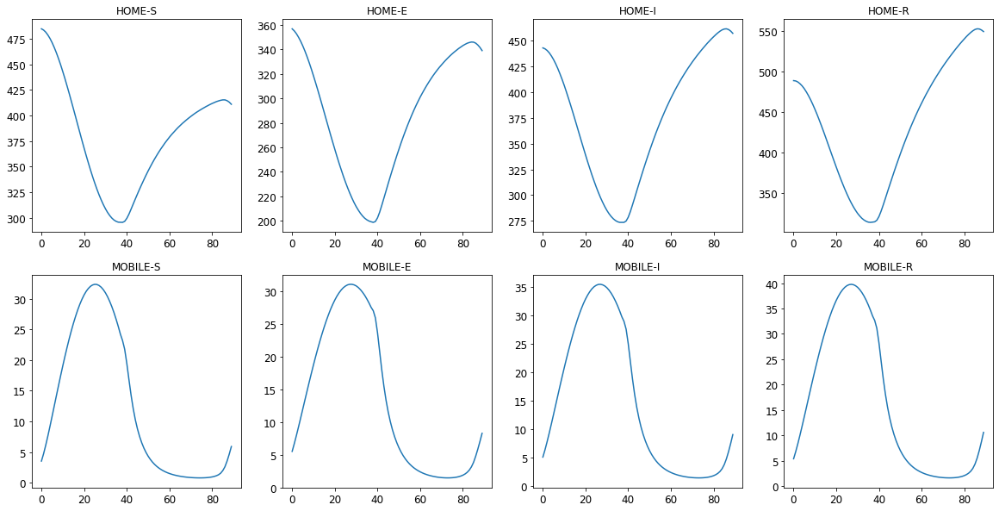

In [101]:
fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    ax.flatten()[i].plot(X_train_1D[2930:3020,i*nl*nc+4])
    ax.flatten()[i].set_title(group)

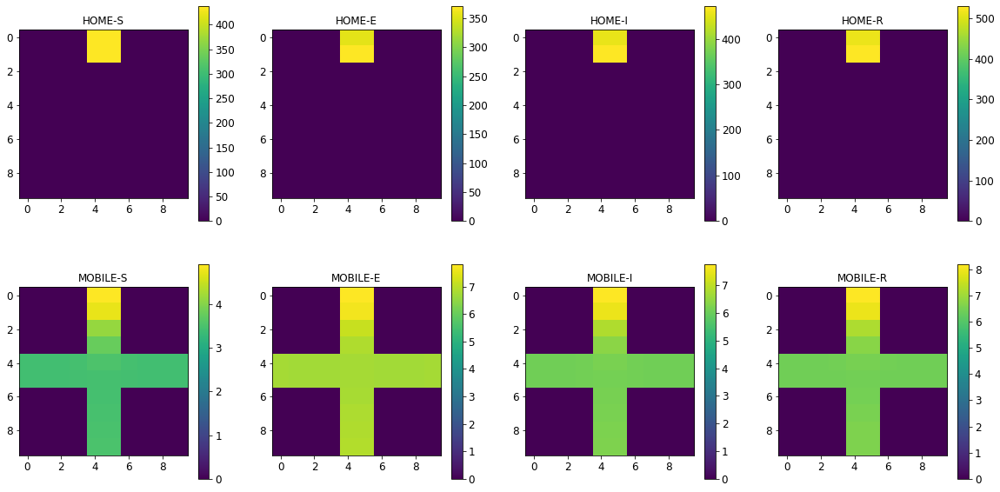

In [77]:
fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    im = ax.flatten()[i].imshow(X_generated.reshape(ntimes,len(groups),nl,nc)[0,i,:,:])
    fig.colorbar(im, ax=ax.flatten()[i])
    ax.flatten()[i].set_title(group)

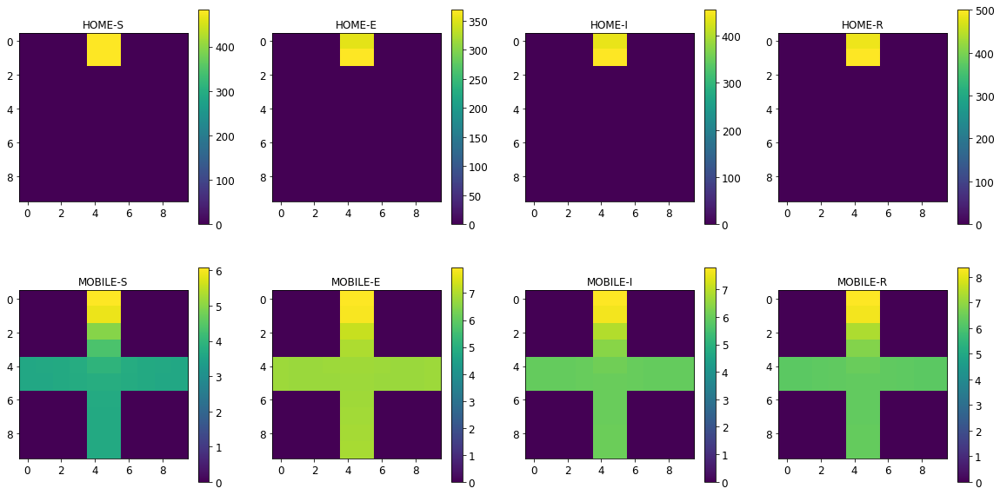

In [107]:
fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    im = ax.flatten()[i].imshow(X_train_1D.reshape(len(times),len(groups),nl,nc)[2932,i,:,:])
    fig.colorbar(im, ax=ax.flatten()[i])
    ax.flatten()[i].set_title(group)

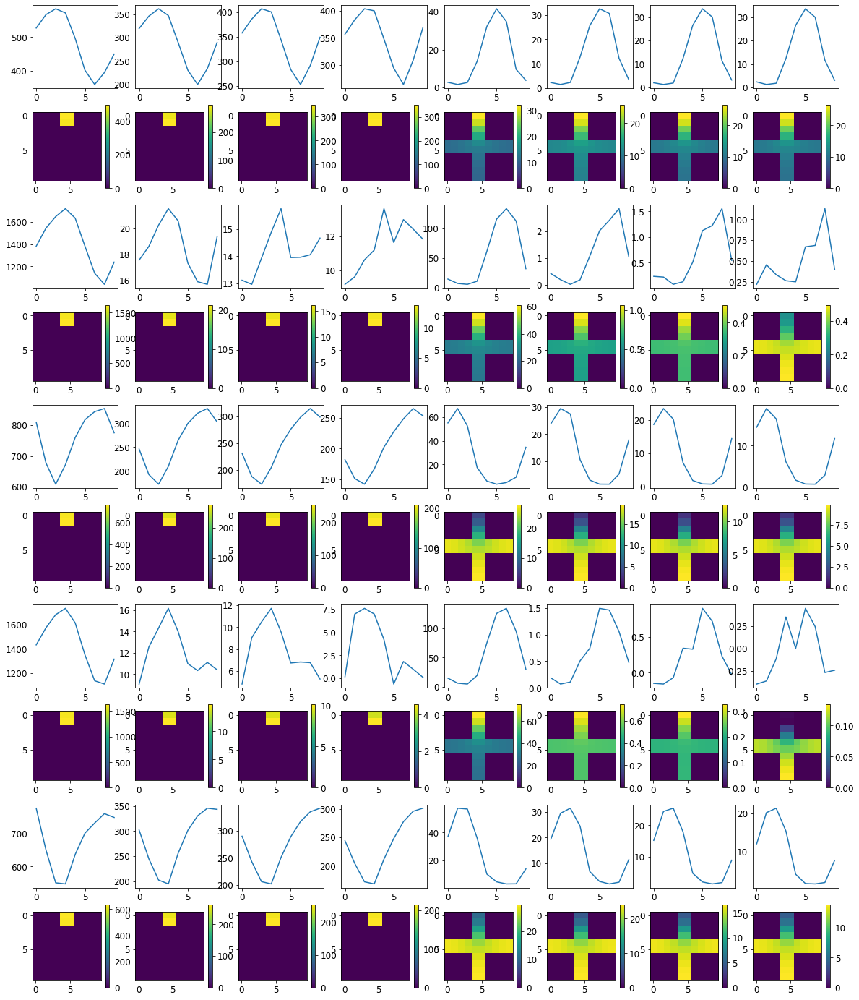

In [89]:
#np.random.seed(0)
#tf.random.set_seed(0)

npredict = 5
noise = tf.random.normal(shape=[npredict, latent_space])
X_generated = scaler.inverse_transform((gan.layers[0].predict(noise).reshape(npredict*ntimes,15)+1)/2)
X_generated = pca_compress.inverse_transform(X_generated)
X_generated = X_generated.reshape(npredict, ntimes, len(groups)*nl*nc)
fig, ax = plt.subplots(npredict*2,len(groups), figsize=[20,npredict*5])
for j in range(npredict):
    for i, group in enumerate(groups):
        for k in range(0,10,10): 
            ax.flatten()[i+2*j*len(groups)].plot(X_generated[j][:,i*nl*nc+4+10*k], '-')
    for i, group in enumerate(groups):
        im = ax.flatten()[i+(2*j+1)*len(groups)].imshow(X_generated[j].reshape(ntimes,len(groups),nl,nc)[4,i,:,:])
        fig.colorbar(im, ax=ax.flatten()[i+(2*j+1)*len(groups)])
